
focused.csv.gz and focused.T.csv.gz are rounded to 1000.


In [ ]:
hkle='HERVK113'

['HERVK113', 'SVA_A', 'SVA_B', 'SVA_C', 'SVA_D', 'SVA_E', 'SVA_F']

In [1]:
import numpy as np
np.__version__

'1.19.5'

In [2]:
import pandas as pd
pd.__version__

'1.1.5'

In [3]:
import matplotlib
matplotlib.__version__

'3.3.4'

In [4]:
import matplotlib.pyplot as plt

In [5]:
# Adjust plot size
#options(repr.plot.width=16, repr.plot.height=6)

# For some reason, if this is in the same cell as the import command, it doesn't work.
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [6]:
import scipy
scipy.__version__

'1.5.4'

In [7]:
from scipy import stats

In [8]:
import seaborn as sns
sns.__version__

'0.11.1'

In [9]:
from datetime import datetime

In [10]:
default_max_columns=pd.get_option('display.max_columns')

In [11]:
default_max_rows=pd.get_option('display.max_rows')

In [12]:
default_precision=pd.get_option('display.precision')

In [13]:
pd.set_option('display.precision', 2)

In [14]:
#default_threshold=np.get_printoptions()['threshold']

In [15]:
#np.set_printoptions(threshold=10000000)

# Read Metadata 1

In [16]:
mt1=pd.read_csv("TCGA/metadata.cart.TCGA.GBM-LGG.WGS.bam.2020-07-17.csv",header=None,
 names=['submitter','days_to_death','gender','disease_type','center_name'])

In [17]:
mt1.shape

(127, 5)

In [18]:
mt1.rename(columns={"submitter": "subject"},inplace=True)
mt1.rename(columns={"gender": "gender1"},inplace=True)

In [19]:
mt1.head()

,subject,days_to_death,gender1,disease_type,center_name
0,02-2483,NaN,male,Glioblastoma Multiforme,Broad Institute of MIT and Harvard
1,02-2485,NaN,male,Glioblastoma Multiforme,Broad Institute of MIT and Harvard
2,06-0125,1448.0,female,Glioblastoma Multiforme,Broad Institute of MIT and Harvard
3,06-0152,375.0,male,Glioblastoma Multiforme,Broad Institute of MIT and Harvard
4,06-0157,97.0,female,Glioblastoma Multiforme,Broad Institute of MIT and Harvard


In [20]:
list(mt1)

['subject', 'days_to_death', 'gender1', 'disease_type', 'center_name']

# Read Metadata 2

In [21]:
mt2=pd.read_csv("TCGA/TCGA.Glioma.metadata.tsv",sep="\t")

In [22]:
mt2.shape

(1114, 18)

In [23]:
mt2.head()

,case_submitter_id,project_id,primary_diagnosis,race,ethnicity,gender,RE_names,IDH,x1p19q,TERT,IDH_1p19q_status,WHO_groups,Triple_group,Tissue_sample_location,MGMT,Age,Survival_months,Vital_status
0,TCGA-02-0001,TCGA-GBM,Glioblastoma,white,not hispanic or latino,female,NaN,WT,non-codel,NaN,IDH-WT:1p19q-non-codel,glioblastoma:IDH-WT:1p19q-non-codel,IDH-WT:1p19q-non-codel:TERT-NA,MD Anderson Cancer Center,Unmethylated,44.0,11.76,1.0
1,TCGA-02-0003,TCGA-GBM,Glioblastoma,white,not hispanic or latino,male,NaN,WT,non-codel,NaN,IDH-WT:1p19q-non-codel,glioblastoma:IDH-WT:1p19q-non-codel,IDH-WT:1p19q-non-codel:TERT-NA,MD Anderson Cancer Center,Unmethylated,50.0,4.73,1.0
2,TCGA-02-0004,TCGA-GBM,Glioblastoma,white,not hispanic or latino,male,NaN,WT,NaN,NaN,IDH-WT:1p19q-NA,NaN,IDH-WT:1p19q-NA:TERT-NA,MD Anderson Cancer Center,NaN,59.0,11.33,1.0
3,TCGA-02-0006,TCGA-GBM,Glioblastoma,white,not hispanic or latino,female,NaN,WT,non-codel,NaN,IDH-WT:1p19q-non-codel,glioblastoma:IDH-WT:1p19q-non-codel,IDH-WT:1p19q-non-codel:TERT-NA,MD Anderson Cancer Center,Unmethylated,56.0,18.33,1.0
4,TCGA-02-0007,TCGA-GBM,Glioblastoma,white,not hispanic or latino,female,NaN,WT,non-codel,NaN,IDH-WT:1p19q-non-codel,glioblastoma:IDH-WT:1p19q-non-codel,IDH-WT:1p19q-non-codel:TERT-NA,MD Anderson Cancer Center,Unmethylated,40.0,23.16,1.0


In [24]:
list(mt2)

['case_submitter_id',
 'project_id',
 'primary_diagnosis',
 'race',
 'ethnicity',
 'gender',
 'RE_names',
 'IDH',
 'x1p19q',
 'TERT',
 'IDH_1p19q_status',
 'WHO_groups',
 'Triple_group',
 'Tissue_sample_location',
 'MGMT',
 'Age',
 'Survival_months',
 'Vital_status']

In [25]:
mt2['subject']=mt2['case_submitter_id'].astype(str).str[5:12]

In [26]:
mt2[['subject','case_submitter_id']].head()

,subject,case_submitter_id
0,02-0001,TCGA-02-0001
1,02-0003,TCGA-02-0003
2,02-0004,TCGA-02-0004
3,02-0006,TCGA-02-0006
4,02-0007,TCGA-02-0007


In [27]:
mt2.drop('case_submitter_id',axis='columns',inplace=True)
mt2.rename(columns={"gender": "gender2"},inplace=True)

In [28]:
list(mt2)

['project_id',
 'primary_diagnosis',
 'race',
 'ethnicity',
 'gender2',
 'RE_names',
 'IDH',
 'x1p19q',
 'TERT',
 'IDH_1p19q_status',
 'WHO_groups',
 'Triple_group',
 'Tissue_sample_location',
 'MGMT',
 'Age',
 'Survival_months',
 'Vital_status',
 'subject']

# Merge Metadata

In [29]:
#meta=mt2.merge(mt1,left_on='subject2',right_on='subject1',suffixes=["_mt2","_mt1"],how='inner')
meta=mt2.merge(mt1,on='subject',suffixes=["_mt2","_mt1"],how='inner')

In [30]:
del mt1
del mt2

In [31]:
meta.head()

,project_id,primary_diagnosis,race,ethnicity,gender2,RE_names,IDH,x1p19q,TERT,IDH_1p19q_status,...,Tissue_sample_location,MGMT,Age,Survival_months,Vital_status,subject,days_to_death,gender1,disease_type,center_name
0,TCGA-GBM,Glioblastoma,asian,not hispanic or latino,male,02-2483-01A-01R-1849-01+1,Mutant,non-codel,WT,IDH-Mutant:1p19q-non-codel,...,MD Anderson Cancer Center,Methylated,43.0,15.31,0.0,02-2483,NaN,male,Glioblastoma Multiforme,Broad Institute of MIT and Harvard
1,TCGA-GBM,Glioblastoma,black or african american,not hispanic or latino,male,02-2485-01A-01R-1849-01+1,WT,non-codel,Mutant,IDH-WT:1p19q-non-codel,...,MD Anderson Cancer Center,Unmethylated,53.0,15.44,0.0,02-2485,NaN,male,Glioblastoma Multiforme,Broad Institute of MIT and Harvard
2,TCGA-GBM,Glioblastoma,white,not hispanic or latino,female,06-0125-01A-01R-1849-01+1,WT,non-codel,Mutant,IDH-WT:1p19q-non-codel,...,Henry Ford Hospital,Methylated,63.0,47.57,1.0,06-0125,1448.0,female,Glioblastoma Multiforme,Broad Institute of MIT and Harvard
3,TCGA-GBM,Glioblastoma,white,not hispanic or latino,male,NaN,WT,non-codel,NaN,IDH-WT:1p19q-non-codel,...,Henry Ford Hospital,NaN,68.0,12.32,1.0,06-0152,375.0,male,Glioblastoma Multiforme,Broad Institute of MIT and Harvard
4,TCGA-GBM,Glioblastoma,white,not hispanic or latino,female,06-0157-01A-01R-1849-01+1,WT,non-codel,Mutant,IDH-WT:1p19q-non-codel,...,Henry Ford Hospital,NaN,63.0,3.19,1.0,06-0157,97.0,female,Glioblastoma Multiforme,Broad Institute of MIT and Harvard


In [32]:
meta.drop(meta[(meta['subject']=='CS-6186') & (meta['center_name']=='Harvard Medical School')].index,inplace=True)

In [33]:
meta.drop(meta[(meta['subject']=='DU-5872') & (meta['center_name']=='Harvard Medical School')].index,inplace=True)

In [34]:
meta.columns

Index(['project_id', 'primary_diagnosis', 'race', 'ethnicity', 'gender2',
       'RE_names', 'IDH', 'x1p19q', 'TERT', 'IDH_1p19q_status', 'WHO_groups',
       'Triple_group', 'Tissue_sample_location', 'MGMT', 'Age',
       'Survival_months', 'Vital_status', 'subject', 'days_to_death',
       'gender1', 'disease_type', 'center_name'],
      dtype='object')

In [35]:
meta['primary_diagnosis'].value_counts()

Glioblastoma                     35
Oligodendroglioma, NOS           33
Astrocytoma, anaplastic          24
Mixed glioma                     16
Astrocytoma, NOS                  9
Oligodendroglioma, anaplastic     8
Name: primary_diagnosis, dtype: int64

In [36]:
meta['TERT'].value_counts()

Mutant    68
WT        54
Name: TERT, dtype: int64

In [37]:
meta['IDH'].value_counts()

Mutant    74
WT        50
Name: IDH, dtype: int64

In [38]:
meta['x1p19q'].value_counts()

non-codel    102
codel         23
Name: x1p19q, dtype: int64

In [39]:
meta['disease_type'].value_counts()

Brain Lower Grade Glioma    90
Glioblastoma Multiforme     35
Name: disease_type, dtype: int64

## We need a multi-level index to merge with df later so adding an empty index level

In [40]:
meta.columns=[meta.columns,[''] * len(meta.columns)]

In [41]:
#meta.columns.names=['chromosome','position']

In [42]:
meta.columns

MultiIndex([(            'project_id', ''),
            (     'primary_diagnosis', ''),
            (                  'race', ''),
            (             'ethnicity', ''),
            (               'gender2', ''),
            (              'RE_names', ''),
            (                   'IDH', ''),
            (                'x1p19q', ''),
            (                  'TERT', ''),
            (      'IDH_1p19q_status', ''),
            (            'WHO_groups', ''),
            (          'Triple_group', ''),
            ('Tissue_sample_location', ''),
            (                  'MGMT', ''),
            (                   'Age', ''),
            (       'Survival_months', ''),
            (          'Vital_status', ''),
            (               'subject', ''),
            (         'days_to_death', ''),
            (               'gender1', ''),
            (          'disease_type', ''),
            (           'center_name', '')],
           )

# Read raw data and cleanup

In [43]:
#df=pd.read_csv("focused.csv.gz",header=[0,1,2,3],index_col=[0,1])
#df.columns.names=['sample','pup','hkle','q']
#df=df.T
df=pd.read_csv("focused.T.csv.gz",header=[0,1],index_col=[0,1,2,3])

df.reset_index(inplace=True)
df.head()


chromosome       sample     pup      hkle mapq    chr1                  \
position                                       1048000 1190000 1308000   
0           02-2483-01A  paired  HERVK113  Q20       0       0       0   
1           02-2483-01A  paired     SVA_A  Q20       0       0       0   
2           02-2483-01A  paired     SVA_B  Q20       0       0       0   
3           02-2483-01A  paired     SVA_C  Q20       0       0       0   
4           02-2483-01A  paired     SVA_D  Q20       0       0       0   

chromosome                          ...     chrY                             \
position   1409000 1410000 1580000  ... 19535000 19536000 19699000 19700000   
0                4       1       4  ...        0        0        2        0   
1                0       0       0  ...        0        0        0        0   
2                0       0       0  ...        0        0        0        0   
3                0       0       0  ...        0        0        0        0   
4                0       0       0  ...        0        0        0        0   

chromosome                                                        
position   20552000 20553000 20976000 21047000 21217000 21639000  
0                 0        0        0        0        0        0  
1                 0        0        0        0        0        0  
2                 0        0        0        0        0        0  
3                 0        0        0        0        0        0  
4                 0        0        0        0        0        0  

[5 rows x 17413 columns]

In [44]:
df['subject']=df['sample'].str[0:7]
df['subject']

0       02-2483
1       02-2483
2       02-2483
3       02-2483
4       02-2483
         ...   
1913    TQ-A8XE
1914    TQ-A8XE
1915    TQ-A8XE
1916    TQ-A8XE
1917    TQ-A8XE
Name: subject, Length: 1918, dtype: object

In [45]:
df.columns

MultiIndex([( 'sample',         ''),
            (    'pup',         ''),
            (   'hkle',         ''),
            (   'mapq',         ''),
            (   'chr1',  '1048000'),
            (   'chr1',  '1190000'),
            (   'chr1',  '1308000'),
            (   'chr1',  '1409000'),
            (   'chr1',  '1410000'),
            (   'chr1',  '1580000'),
            ...
            (   'chrY', '19536000'),
            (   'chrY', '19699000'),
            (   'chrY', '19700000'),
            (   'chrY', '20552000'),
            (   'chrY', '20553000'),
            (   'chrY', '20976000'),
            (   'chrY', '21047000'),
            (   'chrY', '21217000'),
            (   'chrY', '21639000'),
            ('subject',         '')],
           names=['chromosome', 'position'], length=17414)

In [46]:
df.head()

chromosome       sample     pup      hkle mapq    chr1                  \
position                                       1048000 1190000 1308000   
0           02-2483-01A  paired  HERVK113  Q20       0       0       0   
1           02-2483-01A  paired     SVA_A  Q20       0       0       0   
2           02-2483-01A  paired     SVA_B  Q20       0       0       0   
3           02-2483-01A  paired     SVA_C  Q20       0       0       0   
4           02-2483-01A  paired     SVA_D  Q20       0       0       0   

chromosome                          ...     chrY                             \
position   1409000 1410000 1580000  ... 19536000 19699000 19700000 20552000   
0                4       1       4  ...        0        2        0        0   
1                0       0       0  ...        0        0        0        0   
2                0       0       0  ...        0        0        0        0   
3                0       0       0  ...        0        0        0        0   
4                0       0       0  ...        0        0        0        0   

chromosome                                               subject  
position   20553000 20976000 21047000 21217000 21639000           
0                 0        0        0        0        0  02-2483  
1                 0        0        0        0        0  02-2483  
2                 0        0        0        0        0  02-2483  
3                 0        0        0        0        0  02-2483  
4                 0        0        0        0        0  02-2483  

[5 rows x 17414 columns]

In [47]:
df.set_index(['subject','sample','pup','hkle','mapq'],inplace=True)

In [48]:
df.head()

chromosome                                  chr1                          \
position                                 1048000 1190000 1308000 1409000   
subject sample      pup    hkle     mapq                                   
02-2483 02-2483-01A paired HERVK113 Q20        0       0       0       4   
                           SVA_A    Q20        0       0       0       0   
                           SVA_B    Q20        0       0       0       0   
                           SVA_C    Q20        0       0       0       0   
                           SVA_D    Q20        0       0       0       0   

chromosome                                                                \
position                                 1410000 1580000 1581000 2211000   
subject sample      pup    hkle     mapq                                   
02-2483 02-2483-01A paired HERVK113 Q20        1       4       0       0   
                           SVA_A    Q20        0       0       0       0   
                           SVA_B    Q20        0       0       0       0   
                           SVA_C    Q20        0       0       0       0   
                           SVA_D    Q20        0       0       0       0   

chromosome                                                ...     chrY  \
position                                 2513000 2581000  ... 19535000   
subject sample      pup    hkle     mapq                  ...            
02-2483 02-2483-01A paired HERVK113 Q20        0       0  ...        0   
                           SVA_A    Q20        0       0  ...        0   
                           SVA_B    Q20        0       0  ...        0   
                           SVA_C    Q20        0       0  ...        0   
                           SVA_D    Q20        0       0  ...        0   

chromosome                                                                    \
position                                 19536000 19699000 19700000 20552000   
subject sample      pup    hkle     mapq                                       
02-2483 02-2483-01A paired HERVK113 Q20         0        2        0        0   
                           SVA_A    Q20         0        0        0        0   
                           SVA_B    Q20         0        0        0        0   
                           SVA_C    Q20         0        0        0        0   
                           SVA_D    Q20         0        0        0        0   

chromosome                                                                    \
position                                 20553000 20976000 21047000 21217000   
subject sample      pup    hkle     mapq                                       
02-2483 02-2483-01A paired HERVK113 Q20         0        0        0        0   
                           SVA_A    Q20         0        0        0        0   
                           SVA_B    Q20         0        0        0        0   
                           SVA_C    Q20         0        0        0        0   
                           SVA_D    Q20         0        0        0        0   

chromosome                                         
position                                 21639000  
subject sample      pup    hkle     mapq           
02-2483 02-2483-01A paired HERVK113 Q20         0  
                           SVA_A    Q20         0  
                           SVA_B    Q20         0  
                           SVA_C    Q20         0  
                           SVA_D    Q20         0  

[5 rows x 17409 columns]

In [49]:
df.shape

(1918, 17409)

## Remove "pup" and "q" as they are useless in this dataset.

In [50]:
df=df.droplevel('pup',axis='index').droplevel('mapq',axis='index')

In [51]:
df.head()

chromosome                      chr1                                          \
position                     1048000 1190000 1308000 1409000 1410000 1580000   
subject sample      hkle                                                       
02-2483 02-2483-01A HERVK113       0       0       0       4       1       4   
                    SVA_A          0       0       0       0       0       0   
                    SVA_B          0       0       0       0       0       0   
                    SVA_C          0       0       0       0       0       0   
                    SVA_D          0       0       0       0       0       0   

chromosome                                                    ...     chrY  \
position                     1581000 2211000 2513000 2581000  ... 19535000   
subject sample      hkle                                      ...            
02-2483 02-2483-01A HERVK113       0       0       0       0  ...        0   
                    SVA_A          0       0       0       0  ...        0   
                    SVA_B          0       0       0       0  ...        0   
                    SVA_C          0       0       0       0  ...        0   
                    SVA_D          0       0       0       0  ...        0   

chromosome                                                                 \
position                     19536000 19699000 19700000 20552000 20553000   
subject sample      hkle                                                    
02-2483 02-2483-01A HERVK113        0        2        0        0        0   
                    SVA_A           0        0        0        0        0   
                    SVA_B           0        0        0        0        0   
                    SVA_C           0        0        0        0        0   
                    SVA_D           0        0        0        0        0   

chromosome                                                        
position                     20976000 21047000 21217000 21639000  
subject sample      hkle                                          
02-2483 02-2483-01A HERVK113        0        0        0        0  
                    SVA_A           0        0        0        0  
                    SVA_B           0        0        0        0  
                    SVA_C           0        0        0        0  
                    SVA_D           0        0        0        0  

[5 rows x 17409 columns]

In [52]:
df.shape

(1918, 17409)

## Drop recurrent tumor (-02?)

In [53]:
df.loc[df.index.get_level_values('sample').str.contains("-02.$")].index

MultiIndex([('06-0125', '06-0125-02A', 'HERVK113'),
            ('06-0125', '06-0125-02A',    'SVA_A'),
            ('06-0125', '06-0125-02A',    'SVA_B'),
            ('06-0125', '06-0125-02A',    'SVA_C'),
            ('06-0125', '06-0125-02A',    'SVA_D'),
            ('06-0125', '06-0125-02A',    'SVA_E'),
            ('06-0125', '06-0125-02A',    'SVA_F'),
            ('06-0152', '06-0152-02A', 'HERVK113'),
            ('06-0152', '06-0152-02A',    'SVA_A'),
            ('06-0152', '06-0152-02A',    'SVA_B'),
            ...
            ('TQ-A7RV', 'TQ-A7RV-02A',    'SVA_D'),
            ('TQ-A7RV', 'TQ-A7RV-02A',    'SVA_E'),
            ('TQ-A7RV', 'TQ-A7RV-02A',    'SVA_F'),
            ('TQ-A8XE', 'TQ-A8XE-02A', 'HERVK113'),
            ('TQ-A8XE', 'TQ-A8XE-02A',    'SVA_A'),
            ('TQ-A8XE', 'TQ-A8XE-02A',    'SVA_B'),
            ('TQ-A8XE', 'TQ-A8XE-02A',    'SVA_C'),
            ('TQ-A8XE', 'TQ-A8XE-02A',    'SVA_D'),
            ('TQ-A8XE', 'TQ-A8XE-02A',    'SVA_E

In [54]:
df.drop(df.loc[df.index.get_level_values('sample').str.contains("-02.$")].index,axis='index',inplace=True)

In [55]:
df.loc[df.index.get_level_values('sample').str.contains("-02.$")].index

MultiIndex([], names=['subject', 'sample', 'hkle'])

## Drop solid normal (-11?) (I've seen a couple)

In [56]:
df.loc[df.index.get_level_values('sample').str.contains("-11.$")].index

MultiIndex([('FG-5963', 'FG-5963-11A', 'HERVK113'),
            ('FG-5963', 'FG-5963-11A',    'SVA_A'),
            ('FG-5963', 'FG-5963-11A',    'SVA_B'),
            ('FG-5963', 'FG-5963-11A',    'SVA_C'),
            ('FG-5963', 'FG-5963-11A',    'SVA_D'),
            ('FG-5963', 'FG-5963-11A',    'SVA_E'),
            ('FG-5963', 'FG-5963-11A',    'SVA_F')],
           names=['subject', 'sample', 'hkle'])

In [57]:
df.drop(df.loc[df.index.get_level_values('sample').str.contains("-11.$")].index,axis='index',inplace=True)

In [58]:
df.loc[df.index.get_level_values('sample').str.contains("-11.$")].index

MultiIndex([], names=['subject', 'sample', 'hkle'])

## Drop solitary tumor / normal ( not sure how to do this programmatically )

* FG-5963-01A
* CS-5390-10A

In [59]:
df.loc[df.index.get_level_values('sample') == 'FG-5963-01A'].index

MultiIndex([('FG-5963', 'FG-5963-01A', 'HERVK113'),
            ('FG-5963', 'FG-5963-01A',    'SVA_A'),
            ('FG-5963', 'FG-5963-01A',    'SVA_B'),
            ('FG-5963', 'FG-5963-01A',    'SVA_C'),
            ('FG-5963', 'FG-5963-01A',    'SVA_D'),
            ('FG-5963', 'FG-5963-01A',    'SVA_E'),
            ('FG-5963', 'FG-5963-01A',    'SVA_F')],
           names=['subject', 'sample', 'hkle'])

In [60]:
df.drop(df.loc[df.index.get_level_values('sample') == 'FG-5963-01A'].index,axis='index',inplace=True)

In [61]:
df.loc[df.index.get_level_values('sample') == 'FG-5963-01A'].index

MultiIndex([], names=['subject', 'sample', 'hkle'])

In [62]:
df.loc[df.index.get_level_values('sample') == "CS-5390-10A"].index

MultiIndex([('CS-5390', 'CS-5390-10A', 'HERVK113'),
            ('CS-5390', 'CS-5390-10A',    'SVA_A'),
            ('CS-5390', 'CS-5390-10A',    'SVA_B'),
            ('CS-5390', 'CS-5390-10A',    'SVA_C'),
            ('CS-5390', 'CS-5390-10A',    'SVA_D'),
            ('CS-5390', 'CS-5390-10A',    'SVA_E'),
            ('CS-5390', 'CS-5390-10A',    'SVA_F')],
           names=['subject', 'sample', 'hkle'])

In [63]:
df.drop(df.loc[df.index.get_level_values('sample') == "CS-5390-10A"].index,axis='index',inplace=True)

In [64]:
df.loc[df.index.get_level_values('sample') == "CS-5390-10A"].index

MultiIndex([], names=['subject', 'sample', 'hkle'])

# Match earlier HERVK113 notebook counts
* CS-5390-10A - 553
* FG-5963-01A - 68
* CS-6186-01A - 1100
* CS-6186-10A - 950
* DU-5872-01A - 1108
* DU-5872-10A - 776
* 02-2483-01A - 568
* 02-2483-10A - 557
* 02-2485-01A - 587
* 02-2485-10A - 498
* 06-0125-01A - 734

In [65]:
df[df[df.columns]>0].count(axis='columns')['CS-6186','CS-6186-01A']

hkle
HERVK113    1100
SVA_A       2224
SVA_B       2141
SVA_C       2174
SVA_D       2200
SVA_E       2159
SVA_F       1784
dtype: int64

In [66]:
df[df[df.columns]>0].count(axis='columns')['CS-6186','CS-6186-10A']

hkle
HERVK113     950
SVA_A       1962
SVA_B       1839
SVA_C       1845
SVA_D       1868
SVA_E       1827
SVA_F       1512
dtype: int64

In [67]:
df[df[df.columns]>0].count(axis='columns')['DU-5872','DU-5872-01A']

hkle
HERVK113    1108
SVA_A       2744
SVA_B       2640
SVA_C       2625
SVA_D       2644
SVA_E       2614
SVA_F       2285
dtype: int64

In [68]:
df[df[df.columns]>0].count(axis='columns')['DU-5872','DU-5872-10A']

hkle
HERVK113     776
SVA_A       2008
SVA_B       1904
SVA_C       1908
SVA_D       1926
SVA_E       1884
SVA_F       1547
dtype: int64

## Keep only Broad and drop Harvard Medical School

### Harvard's samples were really low coverage?

In [69]:
meta[meta['center_name'] == 'Broad Institute of MIT and Harvard']['subject'].unique()


array(['02-2483', '02-2485', '06-0125', '06-0152', '06-0157', '06-0171',
       '06-0190', '06-0210', '06-0211', '06-0214', '06-0221', '06-0686',
       '06-0744', '06-0745', '06-2557', '06-2570', '06-5411', '06-5415',
       '14-1034', '14-1402', '14-1823', '14-2554', '15-1444', '19-1389',
       '19-2620', '19-2624', '19-2629', '19-5960', '26-5132', '26-5135',
       '27-1831', '27-2523', '27-2528', '32-1970', '41-5651', 'CS-5390',
       'CS-5395', 'CS-6186', 'CS-6665', 'CS-6668', 'CS-6669', 'DB-5278',
       'DH-A669', 'DU-5870', 'DU-5872', 'DU-5874', 'DU-6397', 'DU-6401',
       'DU-6404', 'DU-6407', 'DU-7009', 'DU-7013', 'DU-7301', 'DU-7304',
       'E1-5318', 'E1-5319', 'EZ-7264', 'FG-5964', 'FG-5965', 'FG-7643',
       'FG-8182', 'FG-A4MT', 'HT-7602', 'HT-7689', 'HT-7695', 'HT-8104',
       'HT-A5R7', 'HT-A61B', 'HW-7486', 'HW-7487', 'IK-7675', 'TM-A7CF',
       'TQ-A7RK', 'TQ-A7RV', 'TQ-A8XE'], dtype=object)

In [70]:
df.index.get_level_values('subject')


Index(['02-2483', '02-2483', '02-2483', '02-2483', '02-2483', '02-2483',
       '02-2483', '02-2483', '02-2483', '02-2483',
       ...
       'TQ-A8XE', 'TQ-A8XE', 'TQ-A8XE', 'TQ-A8XE', 'TQ-A8XE', 'TQ-A8XE',
       'TQ-A8XE', 'TQ-A8XE', 'TQ-A8XE', 'TQ-A8XE'],
      dtype='object', name='subject', length=1708)

In [71]:
df.index.get_level_values('subject').isin(
    meta[meta['center_name'] == 'Broad Institute of MIT and Harvard']['subject'].unique())


array([ True,  True,  True, ...,  True,  True,  True])

In [72]:
df=df[df.index.get_level_values('subject').isin(
    meta[meta['center_name'] == 'Broad Institute of MIT and Harvard']['subject'].unique())]
df.head()


chromosome                      chr1                                          \
position                     1048000 1190000 1308000 1409000 1410000 1580000   
subject sample      hkle                                                       
02-2483 02-2483-01A HERVK113       0       0       0       4       1       4   
                    SVA_A          0       0       0       0       0       0   
                    SVA_B          0       0       0       0       0       0   
                    SVA_C          0       0       0       0       0       0   
                    SVA_D          0       0       0       0       0       0   

chromosome                                                    ...     chrY  \
position                     1581000 2211000 2513000 2581000  ... 19535000   
subject sample      hkle                                      ...            
02-2483 02-2483-01A HERVK113       0       0       0       0  ...        0   
                    SVA_A          0       0       0       0  ...        0   
                    SVA_B          0       0       0       0  ...        0   
                    SVA_C          0       0       0       0  ...        0   
                    SVA_D          0       0       0       0  ...        0   

chromosome                                                                 \
position                     19536000 19699000 19700000 20552000 20553000   
subject sample      hkle                                                    
02-2483 02-2483-01A HERVK113        0        2        0        0        0   
                    SVA_A           0        0        0        0        0   
                    SVA_B           0        0        0        0        0   
                    SVA_C           0        0        0        0        0   
                    SVA_D           0        0        0        0        0   

chromosome                                                        
position                     20976000 21047000 21217000 21639000  
subject sample      hkle                                          
02-2483 02-2483-01A HERVK113        0        0        0        0  
                    SVA_A           0        0        0        0  
                    SVA_B           0        0        0        0  
                    SVA_C           0        0        0        0  
                    SVA_D           0        0        0        0  

[5 rows x 17409 columns]

In [73]:
df.shape

(1022, 17409)

## New technique. Separate the tumor and normal counts.
### Remove the sample column
### DO NOT RESHAPE

In [74]:
n=df.copy()    # NORMAL
t=df.copy()    # TUMOR

In [75]:
n.drop(n.loc[n.index.get_level_values('sample').str.contains("-01.$")].index,axis='index',inplace=True)
t.drop(t.loc[t.index.get_level_values('sample').str.contains("-10.$")].index,axis='index',inplace=True)

In [76]:
n=n.droplevel('sample',axis='index')
t=t.droplevel('sample',axis='index')

In [77]:
n.head()

chromosome          chr1                                                  \
position         1048000 1190000 1308000 1409000 1410000 1580000 1581000   
subject hkle                                                               
02-2483 HERVK113       0       0       0       2       3       3       0   
        SVA_A          0       0       0       0       0       0       0   
        SVA_B          0       0       0       0       0       0       0   
        SVA_C          0       0       0       0       0       0       0   
        SVA_D          0       0       0       0       0       0       0   

chromosome                                ...     chrY                    \
position         2211000 2513000 2581000  ... 19535000 19536000 19699000   
subject hkle                              ...                              
02-2483 HERVK113       0       0       0  ...        0        0        1   
        SVA_A          0       0       0  ...        0        0        0   
        SVA_B          0       0       0  ...        0        0        0   
        SVA_C          0       0       0  ...        0        0        0   
        SVA_D          0       0       0  ...        0        0        0   

chromosome                                                              \
position         19700000 20552000 20553000 20976000 21047000 21217000   
subject hkle                                                             
02-2483 HERVK113        1        0        0        0        0        0   
        SVA_A           0        0        0        0        0        0   
        SVA_B           0        0        0        0        0        0   
        SVA_C           0        0        0        0        0        0   
        SVA_D           0        0        0        0        0        0   

chromosome                 
position         21639000  
subject hkle               
02-2483 HERVK113        0  
        SVA_A           0  
        SVA_B           0  
        SVA_C           0  
        SVA_D           0  

[5 rows x 17409 columns]

In [78]:
t.head()

chromosome          chr1                                                  \
position         1048000 1190000 1308000 1409000 1410000 1580000 1581000   
subject hkle                                                               
02-2483 HERVK113       0       0       0       4       1       4       0   
        SVA_A          0       0       0       0       0       0       0   
        SVA_B          0       0       0       0       0       0       0   
        SVA_C          0       0       0       0       0       0       0   
        SVA_D          0       0       0       0       0       0       0   

chromosome                                ...     chrY                    \
position         2211000 2513000 2581000  ... 19535000 19536000 19699000   
subject hkle                              ...                              
02-2483 HERVK113       0       0       0  ...        0        0        2   
        SVA_A          0       0       0  ...        0        0        0   
        SVA_B          0       0       0  ...        0        0        0   
        SVA_C          0       0       0  ...        0        0        0   
        SVA_D          0       0       0  ...        0        0        0   

chromosome                                                              \
position         19700000 20552000 20553000 20976000 21047000 21217000   
subject hkle                                                             
02-2483 HERVK113        0        0        0        0        0        0   
        SVA_A           0        0        0        0        0        0   
        SVA_B           0        0        0        0        0        0   
        SVA_C           0        0        0        0        0        0   
        SVA_D           0        0        0        0        0        0   

chromosome                 
position         21639000  
subject hkle               
02-2483 HERVK113        0  
        SVA_A           0  
        SVA_B           0  
        SVA_C           0  
        SVA_D           0  

[5 rows x 17409 columns]

In [79]:
n_index=n.index
t_index=t.index

### Compare the indexes. An empty array shows that the indexes are the same. Yay.

In [80]:
n_index[n_index != t_index]

MultiIndex([], names=['subject', 'hkle'])

In [81]:
compdf=(((n>0)^(t>0))&(t>0)).replace([False,True],[0,1]) - (((n>0)^(t>0))&(n>0)).replace([False,True],[0,1])

In [82]:
compdf

chromosome          chr1                                                  \
position         1048000 1190000 1308000 1409000 1410000 1580000 1581000   
subject hkle                                                               
02-2483 HERVK113       0       0       0       0       0       0       0   
        SVA_A          0       0       0       0       0       0       0   
        SVA_B          0       0       0       0       0       0       0   
        SVA_C          0       0       0       0       0       0       0   
        SVA_D          0       0       0       0       0       0       0   
...                  ...     ...     ...     ...     ...     ...     ...   
TQ-A8XE SVA_B          0       0       0       0       0       0       1   
        SVA_C          0       0       0       0       0       0       0   
        SVA_D          0       0       0       0       0       0       0   
        SVA_E          0       0       0       0       0       0       0   
        SVA_F          0       0       0       0       0       0       0   

chromosome                                ...     chrY                    \
position         2211000 2513000 2581000  ... 19535000 19536000 19699000   
subject hkle                              ...                              
02-2483 HERVK113       0       0       0  ...        0        0        0   
        SVA_A          0       0       0  ...        0        0        0   
        SVA_B          0       0       0  ...        0        0        0   
        SVA_C          0       0       0  ...        0        0        0   
        SVA_D          0       0       0  ...        0        0        0   
...                  ...     ...     ...  ...      ...      ...      ...   
TQ-A8XE SVA_B          0       0       0  ...        0        0        0   
        SVA_C          0       0       0  ...        0        0        0   
        SVA_D          0       0       0  ...        0        0        0   
        SVA_E          0       0       0  ...        0        0        0   
        SVA_F          0       0       0  ...        0        0        0   

chromosome                                                              \
position         19700000 20552000 20553000 20976000 21047000 21217000   
subject hkle                                                             
02-2483 HERVK113       -1        0        0        0        0        0   
        SVA_A           0        0        0        0        0        0   
        SVA_B           0        0        0        0        0        0   
        SVA_C           0        0        0        0        0        0   
        SVA_D           0        0        0        0        0        0   
...                   ...      ...      ...      ...      ...      ...   
TQ-A8XE SVA_B           0        0        0        0        0        0   
        SVA_C           0        0        0        0        0        0   
        SVA_D           0        0        0        0        0        0   
        SVA_E           0        0        0        0        0        0   
        SVA_F           0        0        0        0        0        0   

chromosome                 
position         21639000  
subject hkle               
02-2483 HERVK113        0  
        SVA_A           0  
        SVA_B           0  
        SVA_C           0  
        SVA_D           0  
...                   ...  
TQ-A8XE SVA_B           0  
        SVA_C           0  
        SVA_D           0  
        SVA_E           0  
        SVA_F           0  

[511 rows x 17409 columns]

This is cleaner, faster and more pythonic than what follows for compdf.


## Search for the presence of HKLE insertions with positions unique to tumor or normal

### Copy raw dataframe, remove sample level and clear out the values

compdf2=df.copy()
compdf2.drop(compdf2.loc[compdf2.index.get_level_values('sample').str.contains("-10.$")].index,axis='index',inplace=True)
compdf2=compdf2.droplevel('sample',axis='index')
compdf2.loc[:,:] = 0
compdf2.head(10)

## Ok. This is some dark magic I think. Gotta be a better, cleaner way to do this.

* Loop over the subjects and hkles. (Loops aren't really pythony.)
* Do an "XOR-AND" for the first (tumor 01) and second (normal 10) samples.
* This returns a Boolean mask
* Change it to 0/1
* Subtract the tumor array from the normal array and assign it to the subject/hkle

### This will create a dataframe of positions representing "tumor - normal" so with values of only

* -1 : normal only
*  0 : both or neither
* +1 : tumor only


for subject in df.index.get_level_values('subject').unique():
    for hkle in df.index.get_level_values('hkle').unique():
        tm=(((  df.loc[subject,:,hkle].iloc[0]>0)^(
                df.loc[subject,:,hkle].iloc[1]>0))&(
                df.loc[subject,:,hkle].iloc[0]>0))
        tm.replace([False,True],[0,1],inplace=True)
        nm=(((  df.loc[subject,:,hkle].iloc[0]>0)^(
                df.loc[subject,:,hkle].iloc[1]>0))&(
                df.loc[subject,:,hkle].iloc[1]>0))
        nm.replace([False,True],[0,1],inplace=True)
        compdf2.loc[subject,hkle]=tm.values-nm.values

compdf.equals(compdf2)

In [83]:
compdf.head()

chromosome          chr1                                                  \
position         1048000 1190000 1308000 1409000 1410000 1580000 1581000   
subject hkle                                                               
02-2483 HERVK113       0       0       0       0       0       0       0   
        SVA_A          0       0       0       0       0       0       0   
        SVA_B          0       0       0       0       0       0       0   
        SVA_C          0       0       0       0       0       0       0   
        SVA_D          0       0       0       0       0       0       0   

chromosome                                ...     chrY                    \
position         2211000 2513000 2581000  ... 19535000 19536000 19699000   
subject hkle                              ...                              
02-2483 HERVK113       0       0       0  ...        0        0        0   
        SVA_A          0       0       0  ...        0        0        0   
        SVA_B          0       0       0  ...        0        0        0   
        SVA_C          0       0       0  ...        0        0        0   
        SVA_D          0       0       0  ...        0        0        0   

chromosome                                                              \
position         19700000 20552000 20553000 20976000 21047000 21217000   
subject hkle                                                             
02-2483 HERVK113       -1        0        0        0        0        0   
        SVA_A           0        0        0        0        0        0   
        SVA_B           0        0        0        0        0        0   
        SVA_C           0        0        0        0        0        0   
        SVA_D           0        0        0        0        0        0   

chromosome                 
position         21639000  
subject hkle               
02-2483 HERVK113        0  
        SVA_A           0  
        SVA_B           0  
        SVA_C           0  
        SVA_D           0  

[5 rows x 17409 columns]

In [84]:
compdf.shape

(511, 17409)

### Keep only positions with any sample with something other than 0

### We lose over 3000 positions

In [85]:
compdf=compdf.loc[:, (compdf != 0).any(axis=0)]

In [86]:
compdf.shape

(511, 14280)

In [87]:
compdf

chromosome          chr1                                                  \
position         1308000 1409000 1410000 1580000 1581000 2211000 2513000   
subject hkle                                                               
02-2483 HERVK113       0       0       0       0       0       0       0   
        SVA_A          0       0       0       0       0       0       0   
        SVA_B          0       0       0       0       0       0       0   
        SVA_C          0       0       0       0       0       0       0   
        SVA_D          0       0       0       0       0       0       0   
...                  ...     ...     ...     ...     ...     ...     ...   
TQ-A8XE SVA_B          0       0       0       0       1       0       0   
        SVA_C          0       0       0       0       0       0       0   
        SVA_D          0       0       0       0       0       0       0   
        SVA_E          0       0       0       0       0       0       0   
        SVA_F          0       0       0       0       0       0       0   

chromosome                                ...     chrY                    \
position         2581000 3129000 3315000  ... 17181000 19536000 19699000   
subject hkle                              ...                              
02-2483 HERVK113       0       0       0  ...        0        0        0   
        SVA_A          0       0       0  ...        0        0        0   
        SVA_B          0       0       0  ...        0        0        0   
        SVA_C          0       0       0  ...        0        0        0   
        SVA_D          0       0       0  ...        0        0        0   
...                  ...     ...     ...  ...      ...      ...      ...   
TQ-A8XE SVA_B          0       0       0  ...        0        0        0   
        SVA_C          0       0       0  ...        0        0        0   
        SVA_D          0       0       0  ...        0        0        0   
        SVA_E          0       0       0  ...        0        0        0   
        SVA_F          0       0       0  ...        0        0        0   

chromosome                                                              \
position         19700000 20552000 20553000 20976000 21047000 21217000   
subject hkle                                                             
02-2483 HERVK113       -1        0        0        0        0        0   
        SVA_A           0        0        0        0        0        0   
        SVA_B           0        0        0        0        0        0   
        SVA_C           0        0        0        0        0        0   
        SVA_D           0        0        0        0        0        0   
...                   ...      ...      ...      ...      ...      ...   
TQ-A8XE SVA_B           0        0        0        0        0        0   
        SVA_C           0        0        0        0        0        0   
        SVA_D           0        0        0        0        0        0   
        SVA_E           0        0        0        0        0        0   
        SVA_F           0        0        0        0        0        0   

chromosome                 
position         21639000  
subject hkle               
02-2483 HERVK113        0  
        SVA_A           0  
        SVA_B           0  
        SVA_C           0  
        SVA_D           0  
...                   ...  
TQ-A8XE SVA_B           0  
        SVA_C           0  
        SVA_D           0  
        SVA_E           0  
        SVA_F           0  

[511 rows x 14280 columns]

### Get the chromosome columns for analysis after merging with the metadata

In [88]:
chromosome_columns=compdf.columns[compdf.columns.get_level_values('chromosome').str.contains("^chr")]
chromosome_columns

MultiIndex([('chr1',  '1308000'),
            ('chr1',  '1409000'),
            ('chr1',  '1410000'),
            ('chr1',  '1580000'),
            ('chr1',  '1581000'),
            ('chr1',  '2211000'),
            ('chr1',  '2513000'),
            ('chr1',  '2581000'),
            ('chr1',  '3129000'),
            ('chr1',  '3315000'),
            ...
            ('chrY', '17181000'),
            ('chrY', '19536000'),
            ('chrY', '19699000'),
            ('chrY', '19700000'),
            ('chrY', '20552000'),
            ('chrY', '20553000'),
            ('chrY', '20976000'),
            ('chrY', '21047000'),
            ('chrY', '21217000'),
            ('chrY', '21639000')],
           names=['chromosome', 'position'], length=14280)

### Merge with the metadata for later grouping

In [89]:
compdf.reset_index(inplace=True)
compdf=compdf.merge(meta,on='subject')
compdf.set_index(['subject','hkle'],inplace=True)
compdf.head()

/Users/jakewendt/Library/Python/3.6/lib/python/site-packages/pandas/core/generic.py:3889: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  obj = obj._drop_axis(labels, axis, level=level, errors=errors)


chromosome          chr1                                                  \
position         1308000 1409000 1410000 1580000 1581000 2211000 2513000   
subject hkle                                                               
02-2483 HERVK113       0       0       0       0       0       0       0   
        SVA_A          0       0       0       0       0       0       0   
        SVA_B          0       0       0       0       0       0       0   
        SVA_C          0       0       0       0       0       0       0   
        SVA_D          0       0       0       0       0       0       0   

chromosome                                ...  \
position         2581000 3129000 3315000  ...   
subject hkle                              ...   
02-2483 HERVK113       0       0       0  ...   
        SVA_A          0       0       0  ...   
        SVA_B          0       0       0  ...   
        SVA_C          0       0       0  ...   
        SVA_D          0       0       0  ...   

chromosome                              Triple_group  \
position                                               
subject hkle                                           
02-2483 HERVK113  IDH-Mutant:1p19q-non-codel:TERT-WT   
        SVA_A     IDH-Mutant:1p19q-non-codel:TERT-WT   
        SVA_B     IDH-Mutant:1p19q-non-codel:TERT-WT   
        SVA_C     IDH-Mutant:1p19q-non-codel:TERT-WT   
        SVA_D     IDH-Mutant:1p19q-non-codel:TERT-WT   

chromosome           Tissue_sample_location        MGMT   Age Survival_months  \
position                                                                        
subject hkle                                                                    
02-2483 HERVK113  MD Anderson Cancer Center  Methylated  43.0           15.31   
        SVA_A     MD Anderson Cancer Center  Methylated  43.0           15.31   
        SVA_B     MD Anderson Cancer Center  Methylated  43.0           15.31   
        SVA_C     MD Anderson Cancer Center  Methylated  43.0           15.31   
        SVA_D     MD Anderson Cancer Center  Methylated  43.0           15.31   

chromosome       Vital_status days_to_death gender1             disease_type  \
position                                                                       
subject hkle                                                                   
02-2483 HERVK113          0.0           NaN    male  Glioblastoma Multiforme   
        SVA_A             0.0           NaN    male  Glioblastoma Multiforme   
        SVA_B             0.0           NaN    male  Glioblastoma Multiforme   
        SVA_C             0.0           NaN    male  Glioblastoma Multiforme   
        SVA_D             0.0           NaN    male  Glioblastoma Multiforme   

chromosome                               center_name  
position                                              
subject hkle                                          
02-2483 HERVK113  Broad Institute of MIT and Harvard  
        SVA_A     Broad Institute of MIT and Harvard  
        SVA_B     Broad Institute of MIT and Harvard  
        SVA_C     Broad Institute of MIT and Harvard  
        SVA_D     Broad Institute of MIT and Harvard  

[5 rows x 14301 columns]

### More dark magic here. 

* Select all subjects and HERVK113 on the y-axis and all the chromosome columns on the x-axis.
* We will count all the incidence of each of the previously computed "tumor-normal" values
* Then we will transpose and sort descending by "-1". This will put the highest occurence of normal at the top.


In [90]:
datetime.now().strftime("%Y%m%d %H:%M:%S")

'20210524 07:43:21'

In [91]:
compdf.loc[pd.IndexSlice[:,'HERVK113'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[-1],ascending=False).head(10)


,,-1,0,1
chromosome,position,,,
chr10,121929000,21.0,34.0,18.0
chr20,29440000,21.0,36.0,16.0
chr21,17932000,20.0,30.0,23.0
chr18,50404000,20.0,27.0,26.0
chr19,51924000,20.0,37.0,16.0
chr5,120194000,20.0,31.0,22.0
chr9,17446000,19.0,35.0,19.0
chr2,208257000,19.0,35.0,19.0
chr3,118539000,19.0,34.0,20.0


In [92]:
compdf.loc[pd.IndexSlice[:,'SVA_A'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[-1],ascending=False).head(10)


,,-1,0,1
chromosome,position,,,
chr13,45484000,23.0,36.0,14.0
chr15,80648000,22.0,35.0,16.0
chr10,34977000,22.0,29.0,22.0
chr17,66269000,21.0,37.0,15.0
chr14,31559000,21.0,36.0,16.0
chr3,196944000,21.0,39.0,13.0
chr2,64041000,21.0,35.0,17.0
chr1,181955000,21.0,34.0,18.0
chr8,117428000,20.0,33.0,20.0


In [93]:
compdf.loc[pd.IndexSlice[:,'SVA_B'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[-1],ascending=False).head(10)


,,-1,0,1
chromosome,position,,,
chr18,70570000,25.0,31.0,17.0
chr22,11550000,23.0,33.0,17.0
chr10,75751000,23.0,39.0,11.0
chr5,171148000,23.0,31.0,19.0
chr10,32232000,23.0,40.0,10.0
chr18,54342000,22.0,36.0,15.0
chr21,28563000,22.0,40.0,11.0
chr10,92673000,22.0,39.0,12.0
chr18,39511000,21.0,35.0,17.0


In [94]:
compdf.loc[pd.IndexSlice[:,'SVA_C'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[-1],ascending=False).head(10)


,,-1,0,1
chromosome,position,,,
chr18,70570000,25.0,30.0,18.0
chr10,75751000,23.0,37.0,13.0
chr13,21449000,22.0,31.0,20.0
chr21,28563000,22.0,40.0,11.0
chr4,6978000,22.0,36.0,15.0
chr6,18227000,22.0,31.0,20.0
chr8,128824000,21.0,29.0,23.0
chr18,39511000,21.0,35.0,17.0
chr9,38325000,21.0,36.0,16.0


In [95]:
compdf.loc[pd.IndexSlice[:,'SVA_D'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[-1],ascending=False).head(10)


,,-1,0,1
chromosome,position,,,
chr18,70570000,25.0,31.0,17.0
chr10,75751000,23.0,37.0,13.0
chr4,6978000,22.0,36.0,15.0
chr21,28563000,22.0,40.0,11.0
chr13,21449000,22.0,31.0,20.0
chr6,18227000,22.0,31.0,20.0
chr8,128824000,21.0,29.0,23.0
chr18,39511000,21.0,35.0,17.0
chr9,38325000,21.0,36.0,16.0


In [96]:
compdf.loc[pd.IndexSlice[:,'SVA_E'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[-1],ascending=False).head(10)


,,-1,0,1
chromosome,position,,,
chr18,70570000,25.0,30.0,18.0
chr10,118894000,24.0,35.0,14.0
chr6,18227000,22.0,31.0,20.0
chr4,6978000,22.0,36.0,15.0
chr13,21449000,22.0,31.0,20.0
chr10,75751000,22.0,39.0,12.0
chr21,28563000,22.0,40.0,11.0
chr2,155658000,21.0,33.0,19.0
chr13,32715000,21.0,35.0,17.0


In [97]:
compdf.loc[pd.IndexSlice[:,'SVA_F'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[-1],ascending=False).head(10)


,,-1,0,1
chromosome,position,,,
chr1,32803000,23.0,34.0,16.0
chr18,70570000,23.0,33.0,17.0
chr19,38856000,22.0,41.0,10.0
chr14_GL000194v1_random,189000,22.0,42.0,9.0
chr10,75751000,22.0,45.0,6.0
chr3,118717000,21.0,43.0,9.0
chr6,69434000,21.0,36.0,16.0
chr19,45649000,21.0,38.0,14.0
chr2,36181000,21.0,28.0,24.0


In [98]:
datetime.now().strftime("%Y%m%d %H:%M:%S")

'20210524 07:45:02'

### We see that the unique normal positions aren't really that unique.

### If we do the same, but sort by tumor ...

In [99]:
datetime.now().strftime("%Y%m%d %H:%M:%S")

'20210524 07:45:02'

In [100]:
compdf.loc[pd.IndexSlice[:,'HERVK113'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[1],ascending=False).head(10)


-1     0     1
chromosome position                   
chr19      37629000   10.0  34.0  29.0
           27814000   10.0  34.0  29.0
chrX       113990000  13.0  31.0  29.0
chr19      23078000   16.0  29.0  28.0
chr1       160914000  11.0  34.0  28.0
chr9       111876000  15.0  31.0  27.0
chr20      7957000     8.0  38.0  27.0
chr7       99432000    6.0  40.0  27.0
chr19      52420000   10.0  36.0  27.0
           57557000   14.0  32.0  27.0

In [101]:
compdf.loc[pd.IndexSlice[:,'SVA_A'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[1],ascending=False).head(10)


-1     0     1
chromosome position                   
chr7       6976000     8.0  34.0  31.0
           92544000    5.0  37.0  31.0
chr2       34132000    7.0  36.0  30.0
chr19      6513000     7.0  37.0  29.0
chrX       40863000   14.0  30.0  29.0
chr19      20953000    9.0  35.0  29.0
chr22      42972000   14.0  31.0  28.0
chr1       180710000  12.0  33.0  28.0
chr6       30221000   12.0  33.0  28.0
chr19      23160000   11.0  34.0  28.0

In [102]:
compdf.loc[pd.IndexSlice[:,'SVA_B'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[1],ascending=False).head(10)


,,-1,0,1
chromosome,position,,,
chr7,91886000,10.0,30.0,33.0
chr6,30221000,8.0,34.0,31.0
chr7,77510000,11.0,31.0,31.0
chr2,27558000,7.0,36.0,30.0
chr11,95481000,9.0,34.0,30.0
chr5,59464000,12.0,31.0,30.0
chr7,54675000,6.0,37.0,30.0
chr8,128824000,18.0,25.0,30.0
chr3,113047000,6.0,38.0,29.0


In [103]:
compdf.loc[pd.IndexSlice[:,'SVA_C'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[1],ascending=False).head(10)


,,-1,0,1
chromosome,position,,,
chr19,6513000,4.0,36.0,33.0
chr7,91886000,10.0,30.0,33.0
chr8,127317000,11.0,31.0,31.0
chr2,27558000,7.0,36.0,30.0
chr11,95481000,8.0,36.0,29.0
chr14,23107000,10.0,34.0,29.0
chr6,30221000,11.0,33.0,29.0
chr12,110173000,9.0,35.0,29.0
chr2,98989000,8.0,36.0,29.0


In [104]:
compdf.loc[pd.IndexSlice[:,'SVA_D'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[1],ascending=False).head(10)


,,-1,0,1
chromosome,position,,,
chr19,6513000,4.0,36.0,33.0
chr7,91886000,11.0,29.0,33.0
chr8,127317000,11.0,31.0,31.0
chr2,27558000,7.0,36.0,30.0
chr11,95481000,9.0,35.0,29.0
chr6,30221000,11.0,33.0,29.0
chr18,7203000,11.0,33.0,29.0
chr14,23107000,10.0,34.0,29.0
chr12,110173000,9.0,35.0,29.0


In [105]:
compdf.loc[pd.IndexSlice[:,'SVA_E'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[1],ascending=False).head(10)


,,-1,0,1
chromosome,position,,,
chr19,6513000,4.0,36.0,33.0
chr7,91886000,11.0,30.0,32.0
chr8,127317000,11.0,31.0,31.0
chr11,95481000,10.0,32.0,31.0
chr12,110173000,11.0,32.0,30.0
chr2,27558000,7.0,37.0,29.0
chr6,30221000,11.0,33.0,29.0
chr18,7203000,11.0,33.0,29.0
chr14,23107000,10.0,34.0,29.0


In [106]:
compdf.loc[pd.IndexSlice[:,'SVA_F'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[1],ascending=False).head(10)


-1     0     1
chromosome position                   
chr19      6513000     7.0  32.0  34.0
chr7       91886000   11.0  29.0  33.0
chr17      35194000    8.0  35.0  30.0
chr7       16789000   10.0  33.0  30.0
chr22      42972000   16.0  27.0  30.0
chr2       33760000    8.0  35.0  30.0
chr12      110173000  10.0  34.0  29.0
           6474000    10.0  34.0  29.0
chr11      95481000    9.0  35.0  29.0
chr20      31428000    6.0  38.0  29.0

In [107]:
datetime.now().strftime("%Y%m%d %H:%M:%S")

'20210524 07:46:38'

### These values seem to be a bit more lopsided.

### Further analysis forthcoming.

compdf.loc[pd.IndexSlice[:,'HERVK113'],chromosome_columns].apply(
    pd.Series.value_counts, axis=0).T.sort_values(by=[1],ascending=False).head(10)


Index(['project_id', 'primary_diagnosis', 'race', 'ethnicity', 'gender2',
       'RE_names', 'IDH', 'x1p19q', 'TERT', 'IDH_1p19q_status', 'WHO_groups',
       'Triple_group', 'Tissue_sample_location', 'MGMT', 'Age',
       'Survival_months', 'Vital_status', 'subject', 'days_to_death',
       'gender1', 'disease_type', 'center_name'],

In [122]:
def ttests_boxplots_and_heatmaps(localdf,columns,group_column,box_p=0.05,heat_p=0.15):
    select_p_values=[]
    groups=localdf[group_column].unique().tolist()
    for col in columns:
        if ( col not in localdf.columns ):
            continue
        for group in groups:
            others = groups.copy()
            others.remove(group)
            for other in others:
                t,p = stats.ttest_ind(
                    localdf[localdf[group_column]==group][col],
                    localdf[localdf[group_column]==other][col])
                #if(p<0.1):
                #    print(col,group,other,t,p)
                if p < heat_p:
                    select_p_values.append([abs(t),p,col])

    pdf = pd.DataFrame(select_p_values, columns=['t','p','col'])                        
    pdf=pdf.drop_duplicates().sort_values('p')

    for index, row in pdf.iterrows():
        if row['p'] < box_p:
            print(" p : "+str(row['p'])+"  ( t : "+str(row['t'])+" ) :  "+str(row['col']))
            
            localdf.boxplot(column=row['col'],by=[group_column])
            plt.title(str(row['col']))
            plt.xticks(rotation=75,ha='right')
            plt.show()                            


#    selected=['subject','sample','Lab kit','trimmer','diag','idh']
    selected=['subject',group_column]
    selected=np.append(selected,pdf['col'])
    selected=np.unique(selected)
    print(selected)
    
    #['Lab kit' 'NR_029609.1' 'trimmer' 'diag' 'idh' 'sample' 'subject']
    if len(selected) > 3: #7:
#        for trimmer in 'bbduk2','cutadapt2':
#            for labkit in dfn['Lab kit'].unique():
        tmp=localdf[selected].copy()
#        tmp=tmp[(tmp['trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
#        tmp=tmp.drop('trimmer',axis='columns')
#        tmp=tmp.drop('Lab kit',axis='columns')
#        tmp.set_index(['subject','sample','diag','idh'],inplace=True)
        tmp.set_index(['subject',group_column],inplace=True)

        #tmp-=tmp.min() # This may almost always be 0 now.
#        tmp/=tmp.max() # given that there should be no NAs now, coule let clustermap do this
        # ...
        #standard_scale int or None, optional
        #Either 0 (rows) or 1 (columns).
        #Whether or not to standardize that dimension, meaning for each row or column,
        #subtract the minimum and divide each by its maximum.
        # how would that deal with 0s or empty cells

        tmp=tmp.fillna(0) # Somehow, some scaled values become NaN so keep this

        tmp.reset_index(inplace=True)

        #tmp1=tmp.sort_values(['diag']).T
#        tmp=tmp.sort_values(['idh','diag'])
        tmp=tmp.sort_values([group_column])
        #print(tmp.head())
#        tmp.drop(['subject'],inplace=True,axis='columns')
#        tmp.set_index(['sample','idh'],inplace=True)
        tmp.set_index(['subject'],inplace=True)

        diagnoses=tmp.pop(group_column)
        #lut = dict(zip(diagnoses.unique(), "rgbcmykb"))
        #col_colors = diagnoses.map(lut)
        #print(col_colors)
        #print(tmp.columns)

        tmp=tmp.T

        #print('pal')
        network_pal = sns.cubehelix_palette(len(diagnoses.unique()),
                            light=.9, dark=.1, reverse=True,
                            start=1, rot=-2)
        #print(network_pal)
        network_pal
        #print('lut')
        network_lut = dict(zip(diagnoses.unique(), network_pal))
        #print(network_lut)
        #print('labels')
        # Convert the palette to vectors that will be drawn on the side of the matrix
        network_labels = diagnoses
        #print(network_labels)
        network_colors = pd.Series(network_labels, index=tmp.columns).map(network_lut)                
        #print('colors')
        #print(network_colors)

#        print(tmp)

        g=sns.clustermap(tmp,col_cluster=False,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
        g.fig.suptitle("Clustermap 1 : " + group_column)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

        # Draw the legend bar for the classes                 
        for label in network_labels.unique():
            g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                    label=label, linewidth=0)
        g.ax_col_dendrogram.legend(loc="center", ncol=4)

        # Adjust the postion of the main colorbar for the heatmap
        #g.cax.set_position([.97, .2, .03, .45])
        g.cax.set_position([0, .15, .005, .6])
        plt.show()

        g=sns.clustermap(tmp,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
        g.fig.suptitle("Clustermap 2 : " + group_column)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

        # Draw the legend bar for the classes                 
        for label in network_labels.unique():
            g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                    label=label, linewidth=0)
        g.ax_col_dendrogram.legend(loc="center", ncol=4)

        # Adjust the postion of the main colorbar for the heatmap
        # [dist from left,dist from bottom?,width?,height?]
        g.cax.set_position([0, .15, .005, .6])
        plt.show()  
    else:
        print("Not enough data to produce cluster maps")
        

In [109]:
datetime.now().strftime("%Y%m%d %H:%M:%S")

'20210524 07:46:38'

### Flatten the multi-level column names

In [110]:
compdf.columns= [' '.join(col).strip() for col in compdf.columns.values]
compdf.head()

chr1 1308000  chr1 1409000  chr1 1410000  chr1 1580000  \
subject hkle                                                               
02-2483 HERVK113             0             0             0             0   
        SVA_A                0             0             0             0   
        SVA_B                0             0             0             0   
        SVA_C                0             0             0             0   
        SVA_D                0             0             0             0   

                  chr1 1581000  chr1 2211000  chr1 2513000  chr1 2581000  \
subject hkle                                                               
02-2483 HERVK113             0             0             0             0   
        SVA_A                0             0             0             0   
        SVA_B                0             0             0             0   
        SVA_C                0             0             0             0   
        SVA_D                0             0             0             0   

                  chr1 3129000  chr1 3315000  ...  \
subject hkle                                  ...   
02-2483 HERVK113             0             0  ...   
        SVA_A                0             0  ...   
        SVA_B                0             0  ...   
        SVA_C                0             0  ...   
        SVA_D                0             0  ...   

                                        Triple_group  \
subject hkle                                           
02-2483 HERVK113  IDH-Mutant:1p19q-non-codel:TERT-WT   
        SVA_A     IDH-Mutant:1p19q-non-codel:TERT-WT   
        SVA_B     IDH-Mutant:1p19q-non-codel:TERT-WT   
        SVA_C     IDH-Mutant:1p19q-non-codel:TERT-WT   
        SVA_D     IDH-Mutant:1p19q-non-codel:TERT-WT   

                     Tissue_sample_location        MGMT   Age  \
subject hkle                                                    
02-2483 HERVK113  MD Anderson Cancer Center  Methylated  43.0   
        SVA_A     MD Anderson Cancer Center  Methylated  43.0   
        SVA_B     MD Anderson Cancer Center  Methylated  43.0   
        SVA_C     MD Anderson Cancer Center  Methylated  43.0   
        SVA_D     MD Anderson Cancer Center  Methylated  43.0   

                  Survival_months  Vital_status  days_to_death  gender1  \
subject hkle                                                              
02-2483 HERVK113            15.31           0.0            NaN     male   
        SVA_A               15.31           0.0            NaN     male   
        SVA_B               15.31           0.0            NaN     male   
        SVA_C               15.31           0.0            NaN     male   
        SVA_D               15.31           0.0            NaN     male   

                             disease_type                         center_name  
subject hkle                                                                   
02-2483 HERVK113  Glioblastoma Multiforme  Broad Institute of MIT and Harvard  
        SVA_A     Glioblastoma Multiforme  Broad Institute of MIT and Harvard  
        SVA_B     Glioblastoma Multiforme  Broad Institute of MIT and Harvard  
        SVA_C     Glioblastoma Multiforme  Broad Institute of MIT and Harvard  
        SVA_D     Glioblastoma Multiforme  Broad Institute of MIT and Harvard  

[5 rows x 14301 columns]

### Reset Index

In [111]:
compdf.reset_index(inplace=True)
compdf.head()

,subject,hkle,chr1 1308000,chr1 1409000,chr1 1410000,chr1 1580000,chr1 1581000,chr1 2211000,chr1 2513000,chr1 2581000,...,Triple_group,Tissue_sample_location,MGMT,Age,Survival_months,Vital_status,days_to_death,gender1,disease_type,center_name
0,02-2483,HERVK113,0,0,0,0,0,0,0,0,...,IDH-Mutant:1p19q-non-codel:TERT-WT,MD Anderson Cancer Center,Methylated,43.0,15.31,0.0,NaN,male,Glioblastoma Multiforme,Broad Institute of MIT and Harvard
1,02-2483,SVA_A,0,0,0,0,0,0,0,0,...,IDH-Mutant:1p19q-non-codel:TERT-WT,MD Anderson Cancer Center,Methylated,43.0,15.31,0.0,NaN,male,Glioblastoma Multiforme,Broad Institute of MIT and Harvard
2,02-2483,SVA_B,0,0,0,0,0,0,0,0,...,IDH-Mutant:1p19q-non-codel:TERT-WT,MD Anderson Cancer Center,Methylated,43.0,15.31,0.0,NaN,male,Glioblastoma Multiforme,Broad Institute of MIT and Harvard
3,02-2483,SVA_C,0,0,0,0,0,0,0,0,...,IDH-Mutant:1p19q-non-codel:TERT-WT,MD Anderson Cancer Center,Methylated,43.0,15.31,0.0,NaN,male,Glioblastoma Multiforme,Broad Institute of MIT and Harvard
4,02-2483,SVA_D,0,0,0,0,0,0,0,0,...,IDH-Mutant:1p19q-non-codel:TERT-WT,MD Anderson Cancer Center,Methylated,43.0,15.31,0.0,NaN,male,Glioblastoma Multiforme,Broad Institute of MIT and Harvard


In [112]:
#chromosome6_columns=compdf.columns[compdf.columns.get_level_values('chromosome').str.contains("^chr6")]
chromosome6_columns=compdf.columns[compdf.columns.str.contains("^chr6 ")]

In [113]:
#ttests_boxplots_and_heatmaps(compdf[compdf['hkle']=='HERVK113'],
#    chromosome6_columns,'primary_diagnosis',box_p=0.0000001,heat_p=0.1)

In [114]:
datetime.now().strftime("%Y%m%d %H:%M:%S")

'20210524 07:46:38'

chr1
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr1 152455000


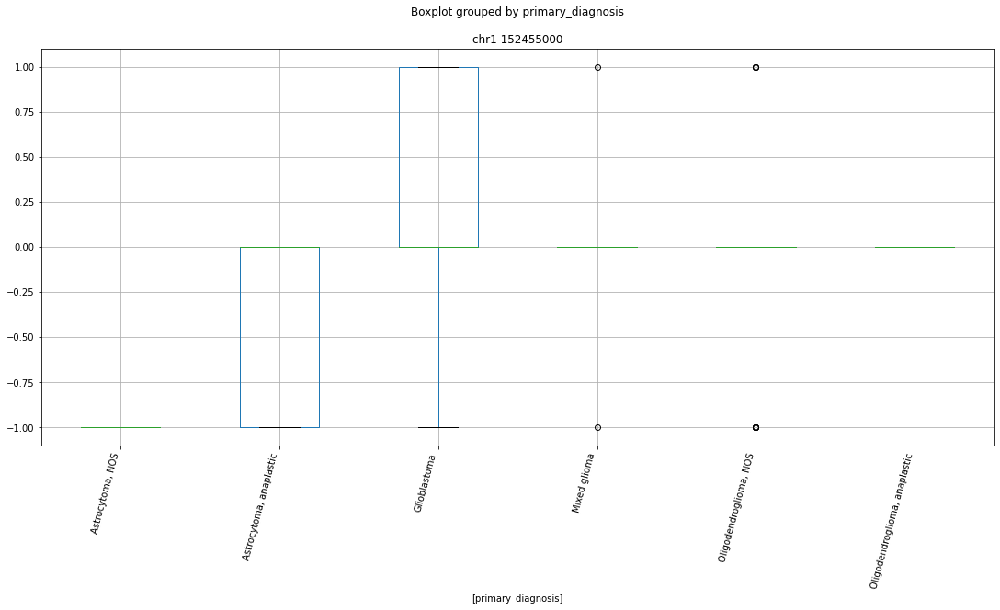

 p : 0.0  ( t : inf ) :  chr1 45248000


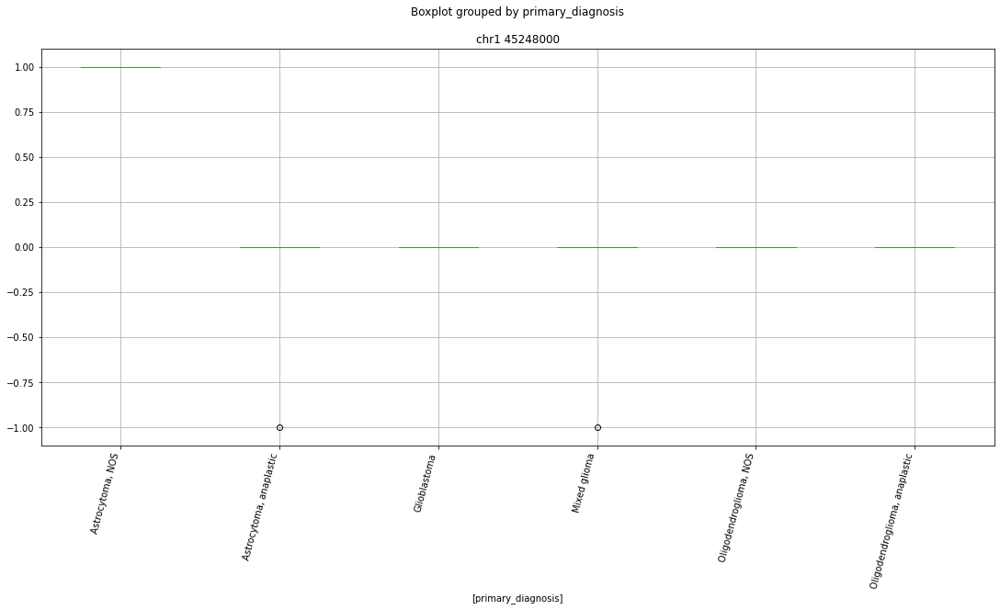

 p : 0.0  ( t : inf ) :  chr1 11249000


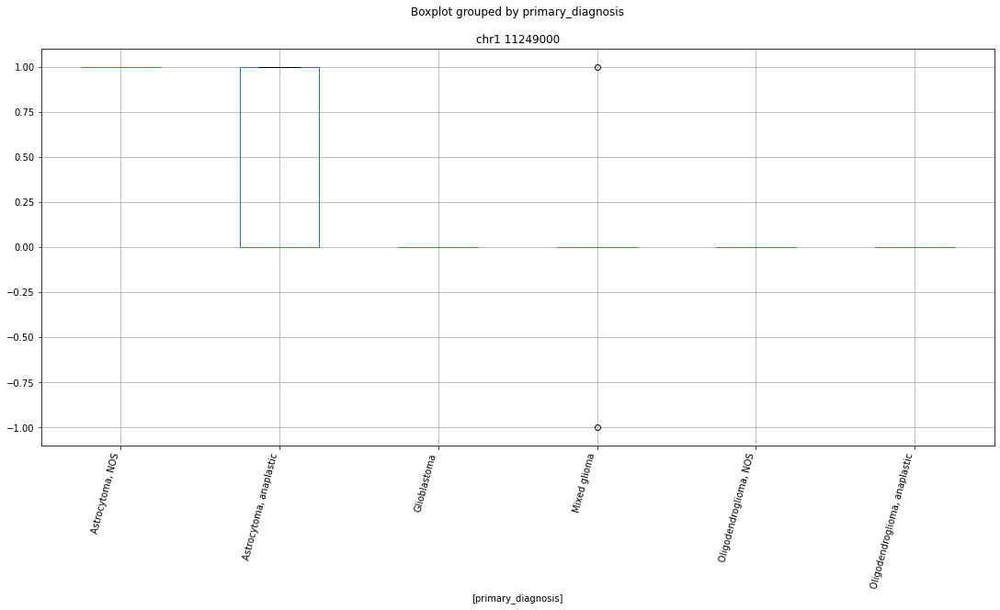

 p : 0.0  ( t : inf ) :  chr1 75383000


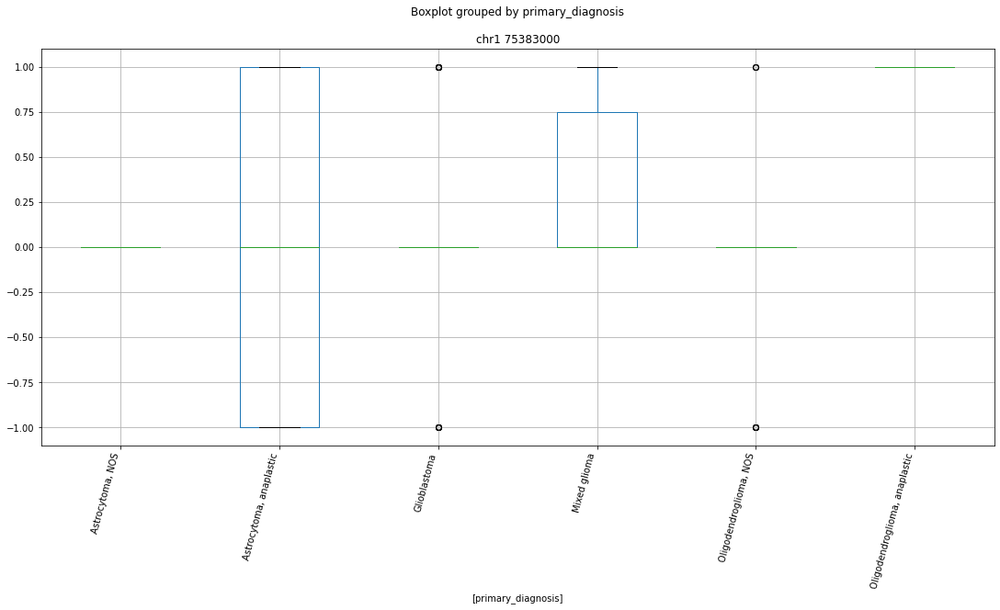

 p : 0.0  ( t : inf ) :  chr1 229931000


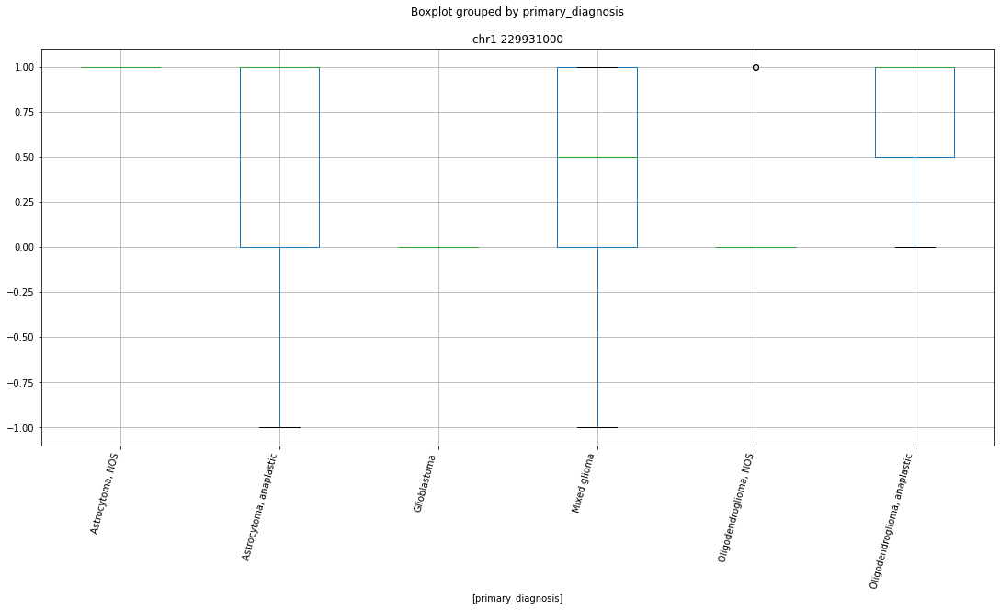

 p : 0.0  ( t : inf ) :  chr1 6304000


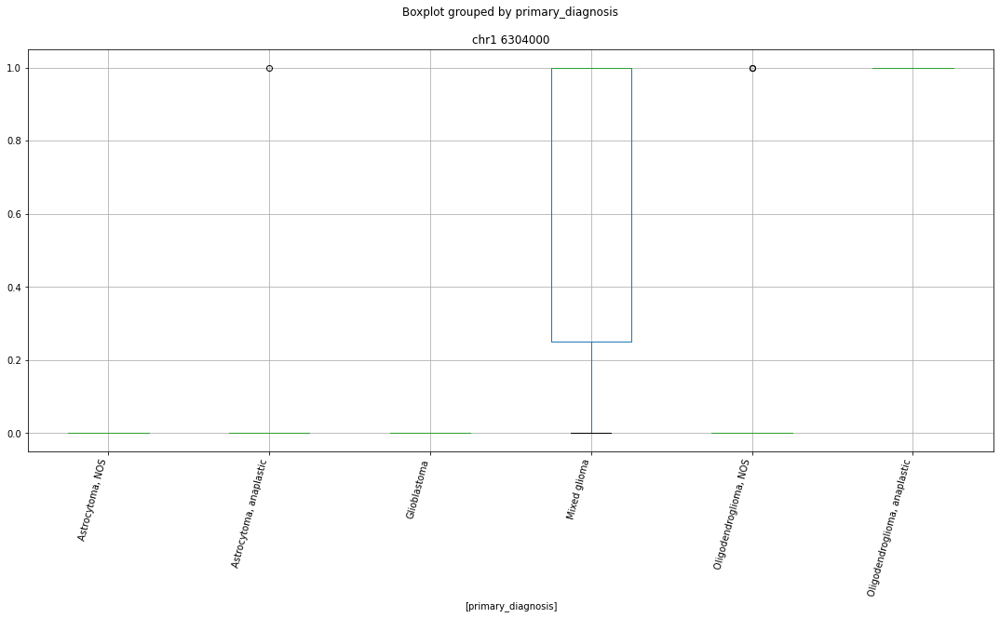

 p : 0.0  ( t : inf ) :  chr1 104134000


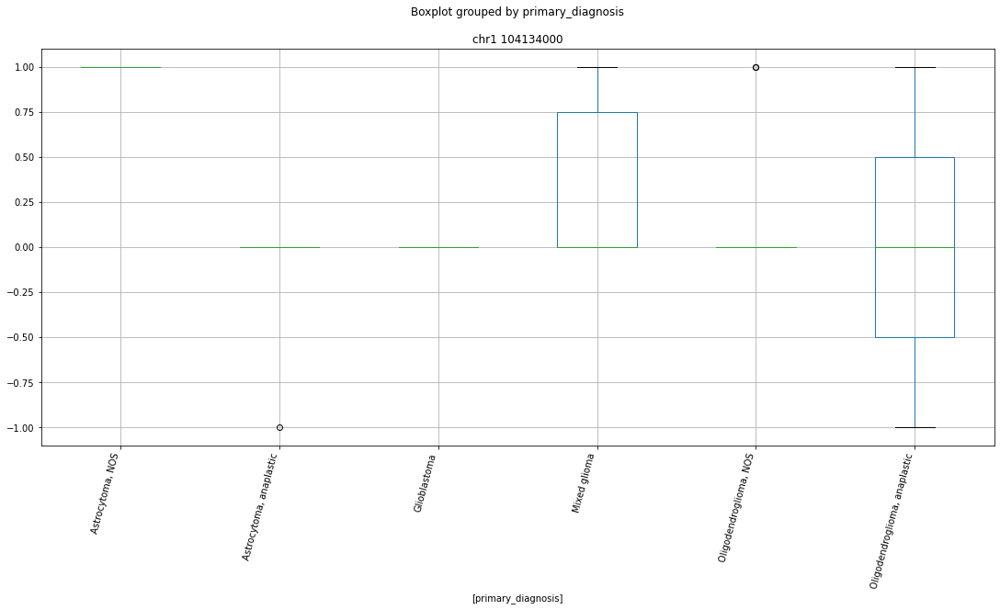

 p : 0.0  ( t : inf ) :  chr1 161411000


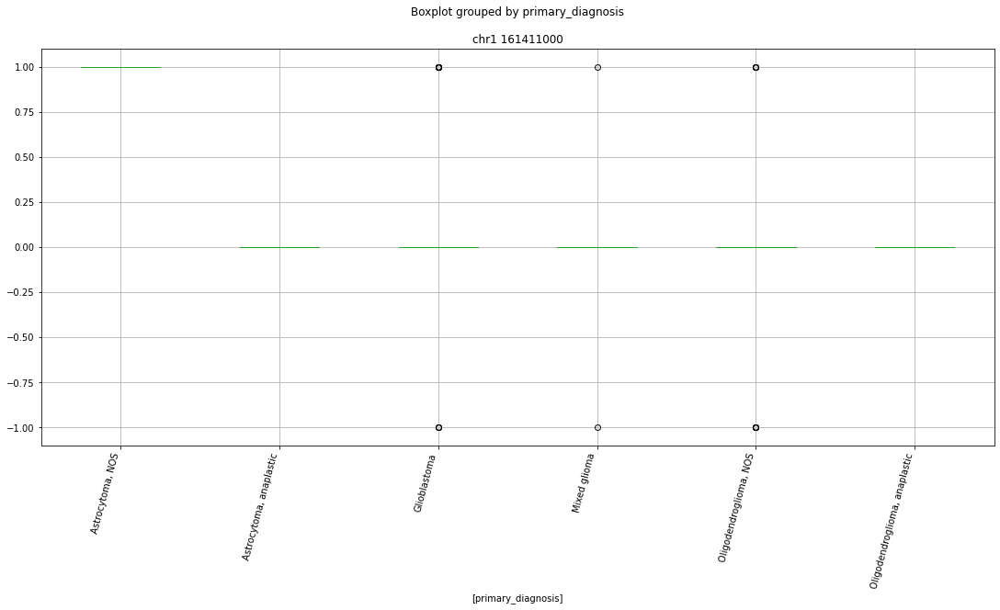

 p : 0.0  ( t : inf ) :  chr1 245775000


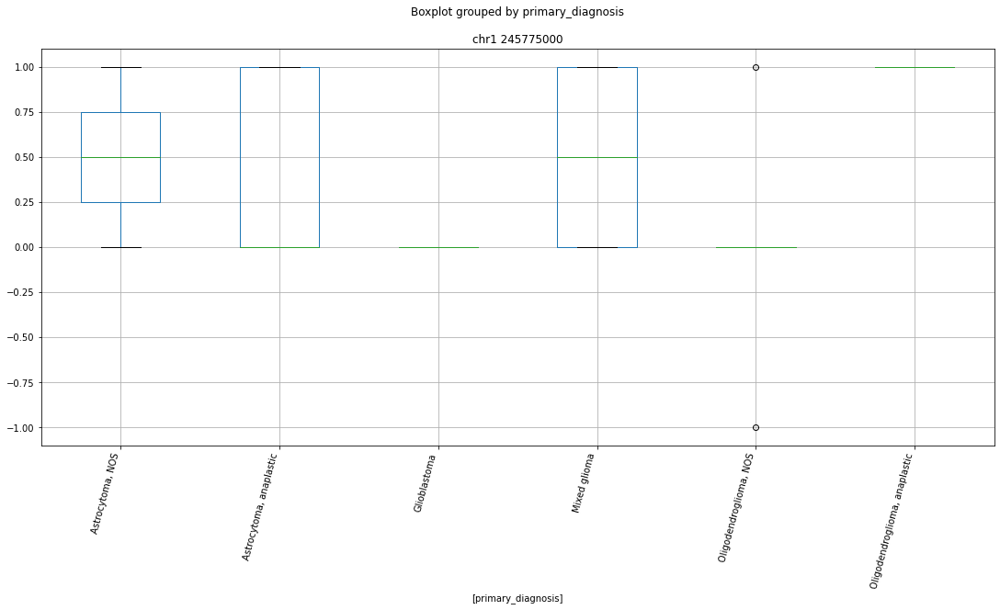

 p : 0.0  ( t : inf ) :  chr1 156328000


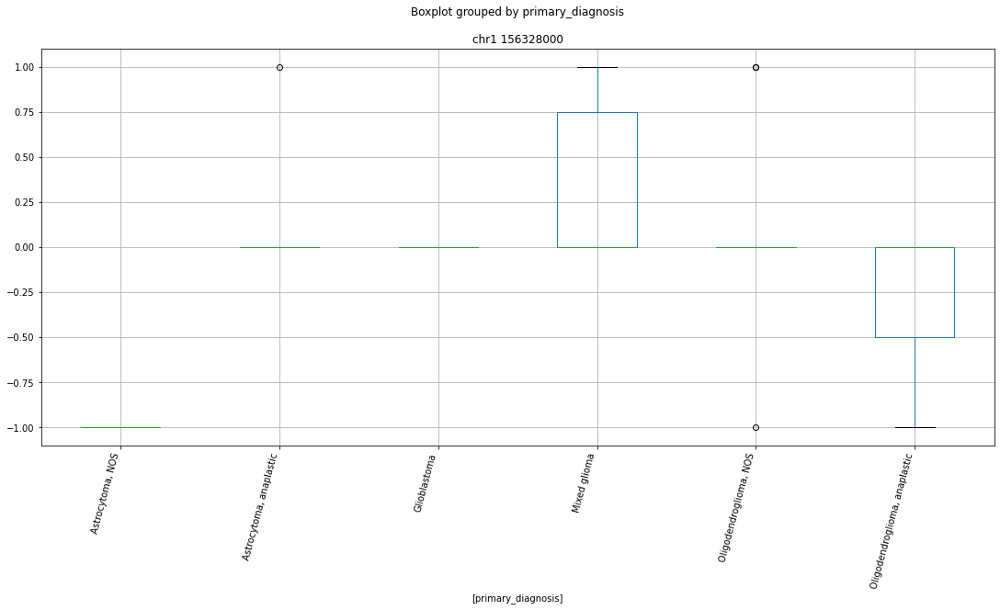

 p : 0.0  ( t : inf ) :  chr1 152471000


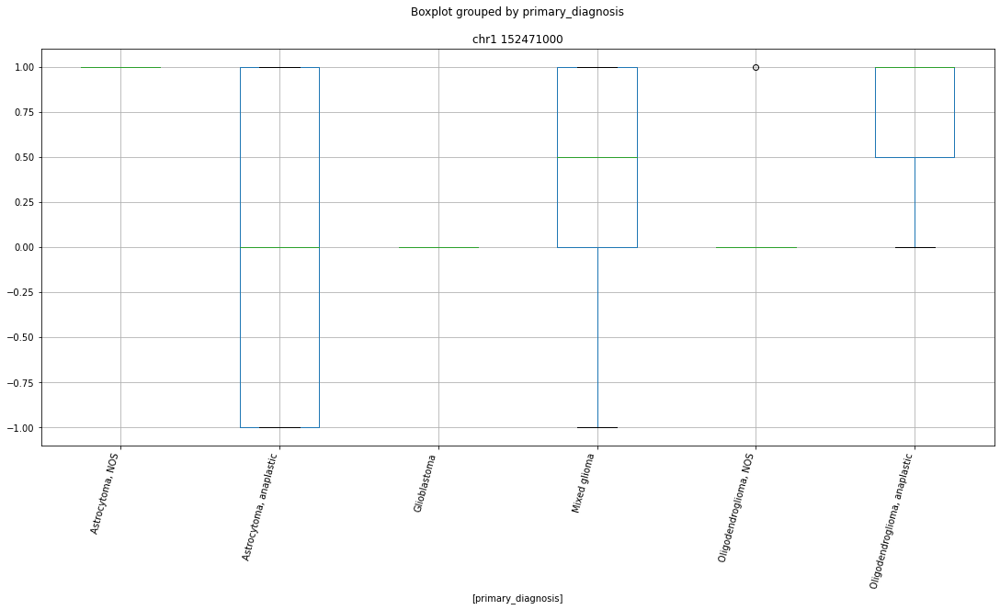

 p : 0.0  ( t : inf ) :  chr1 5573000


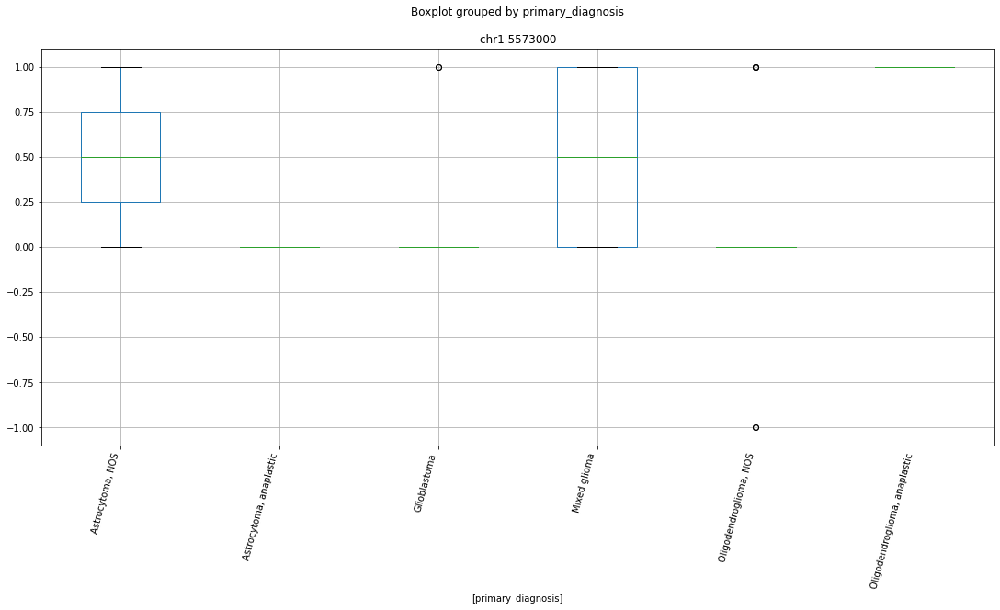

 p : 1.2735213637763784e-13  ( t : 11.358945418727963 ) :  chr1 30346000


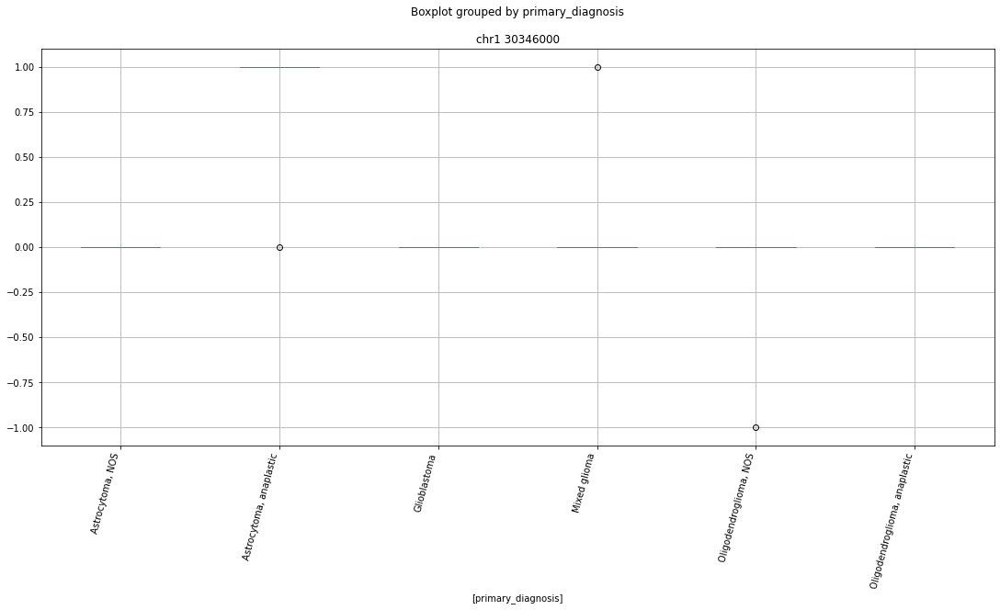

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr1 6304000


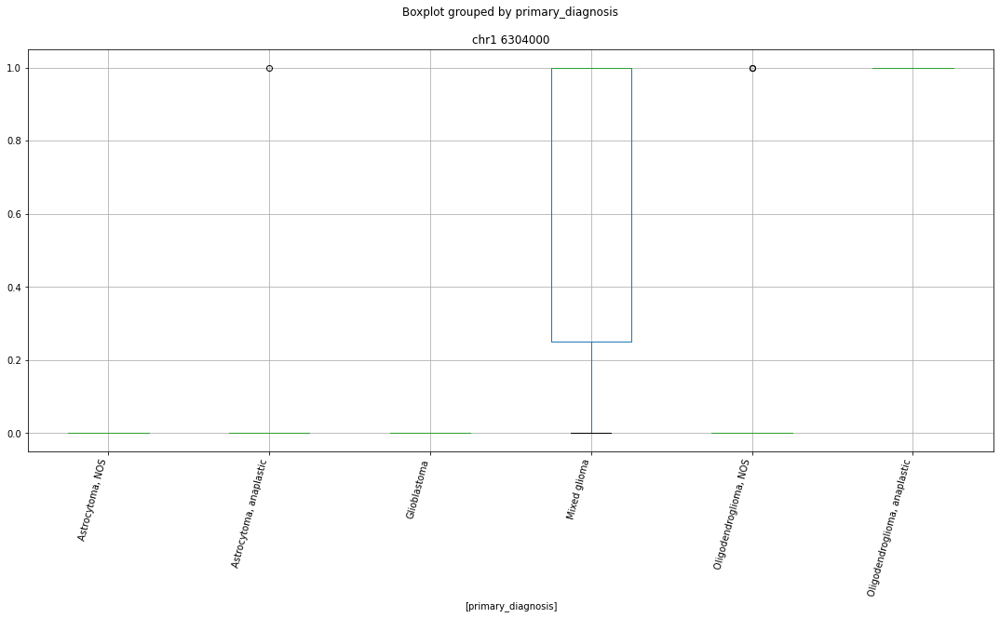

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr1 37897000


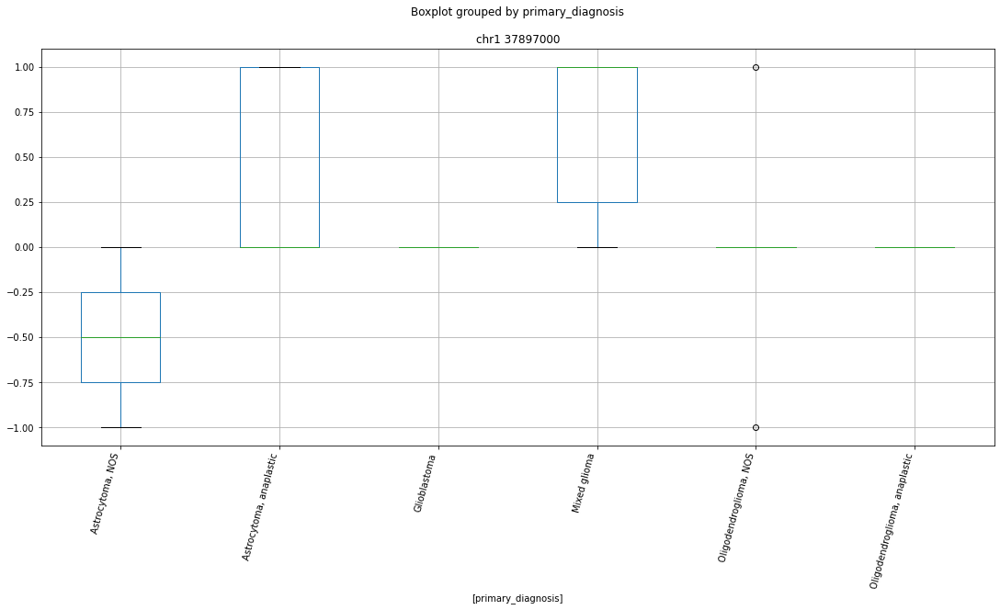

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr1 111529000


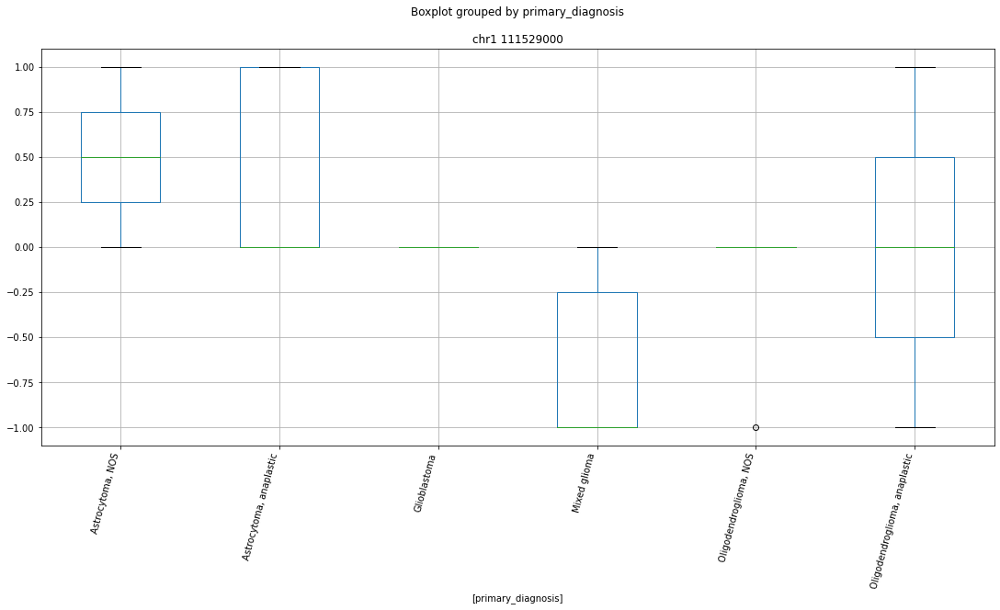

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr1 46321000


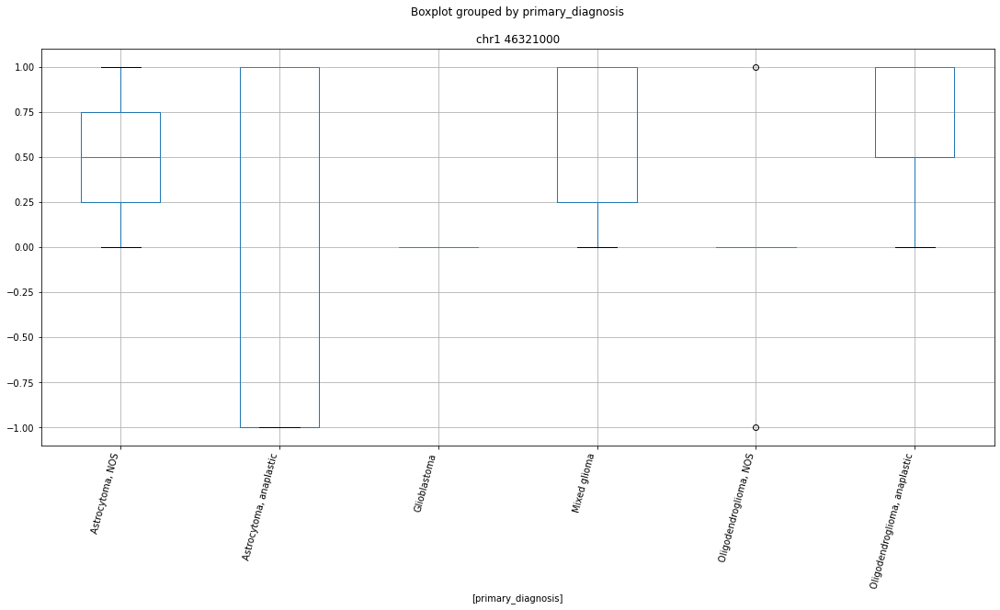

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 86899000


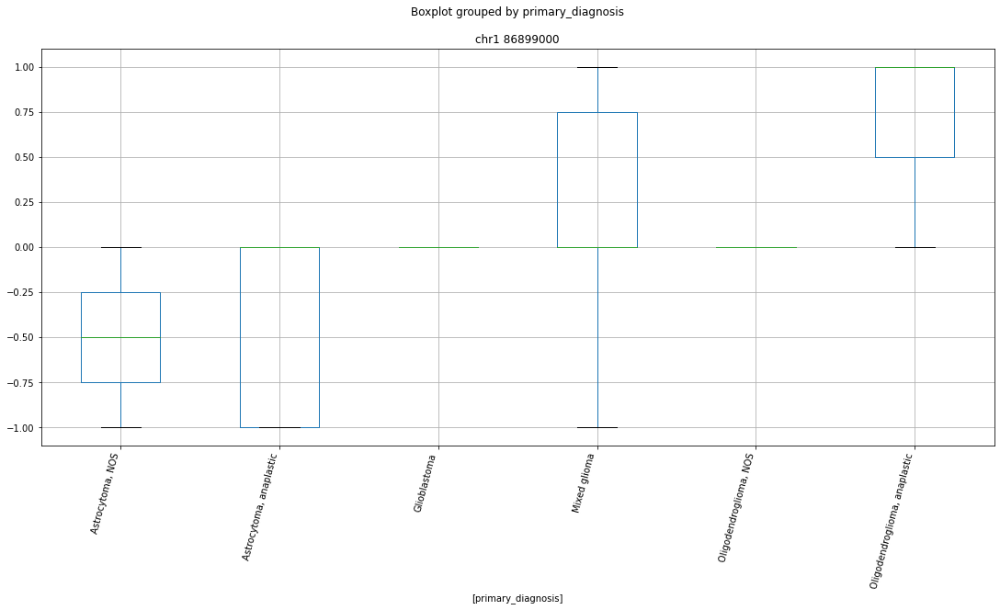

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 25604000


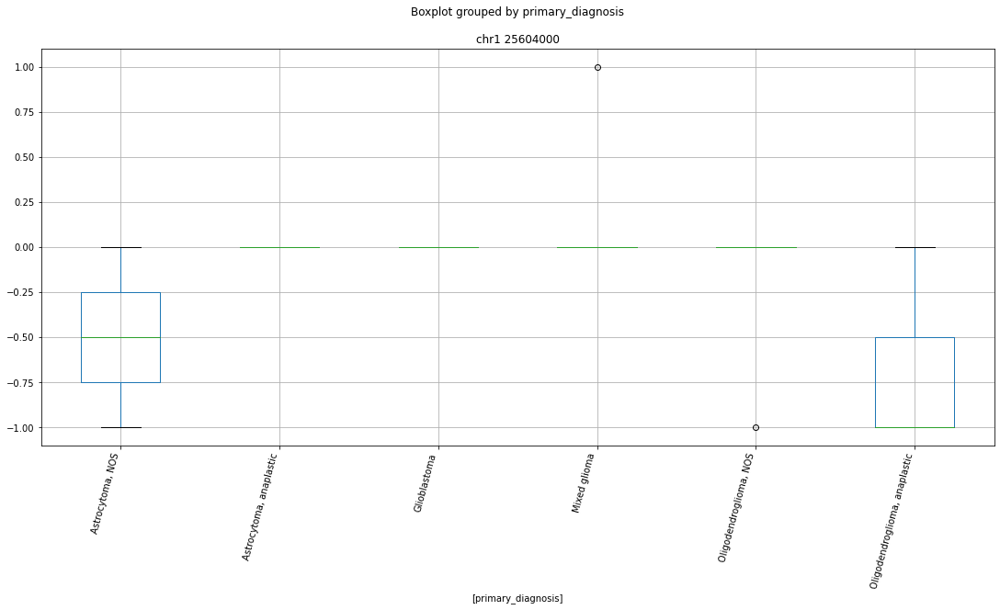

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 147241000


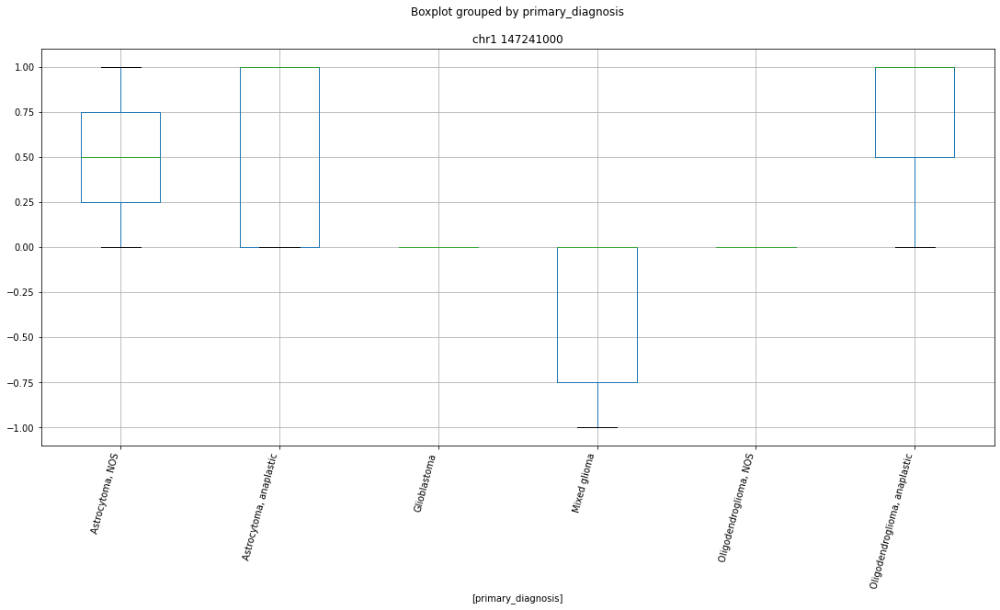

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 108535000


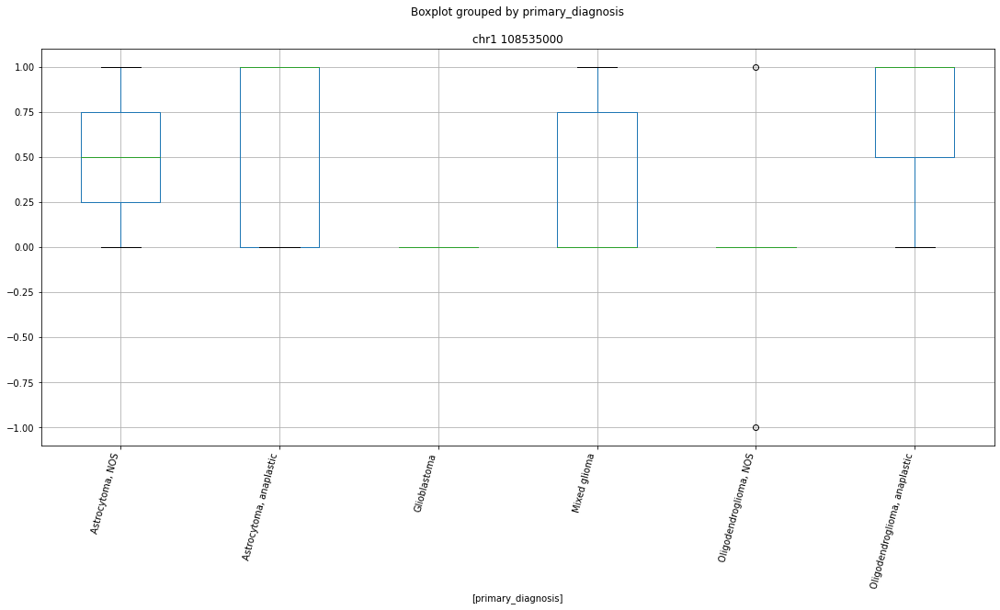

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 199904000


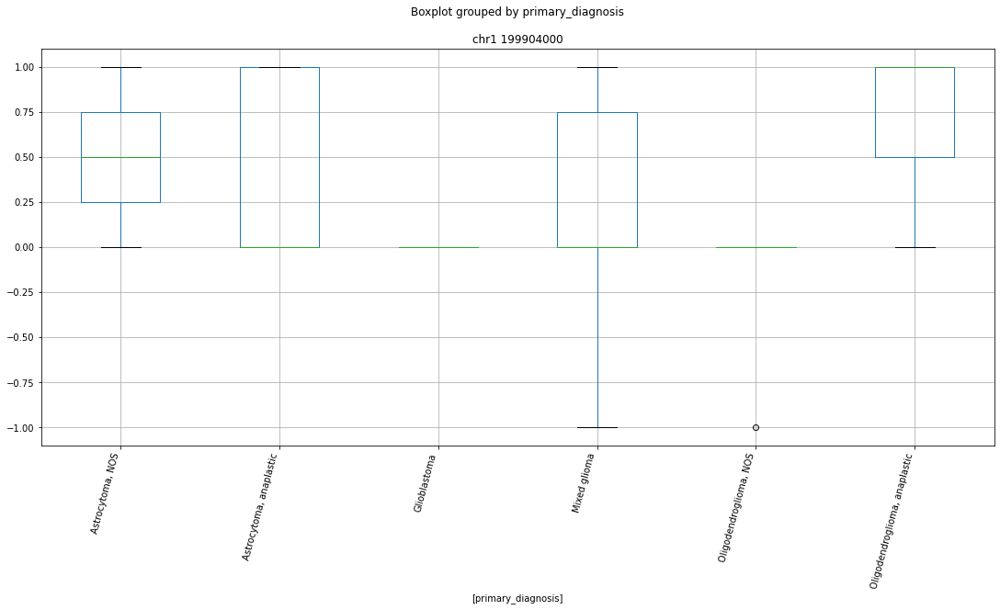

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 229931000


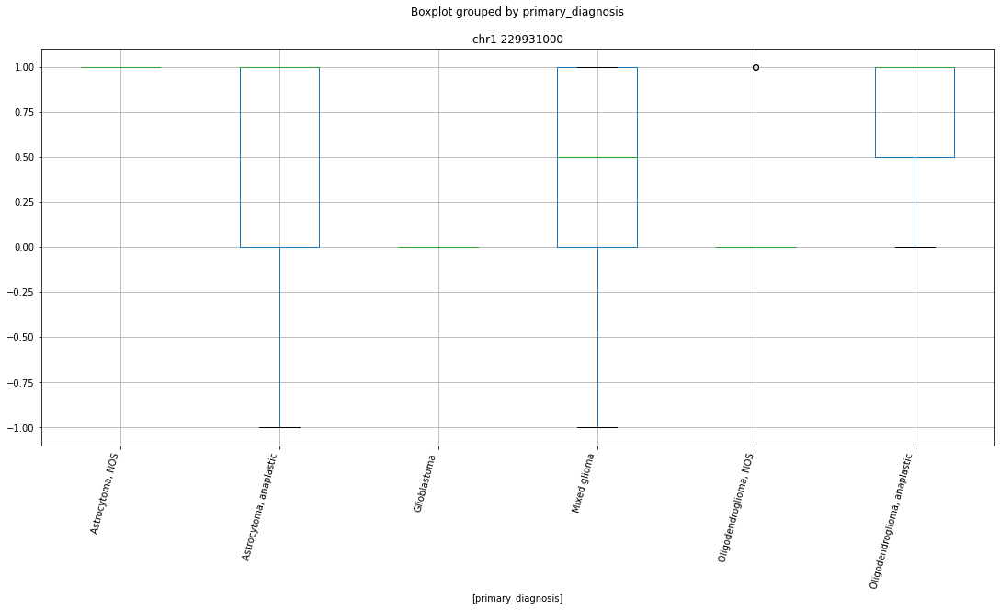

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 152471000


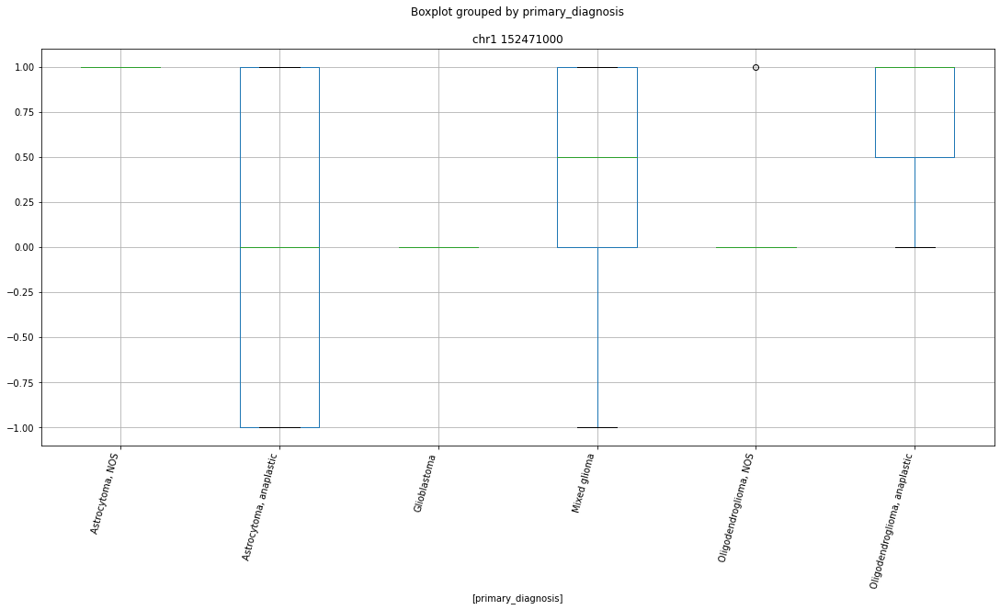

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 232332000


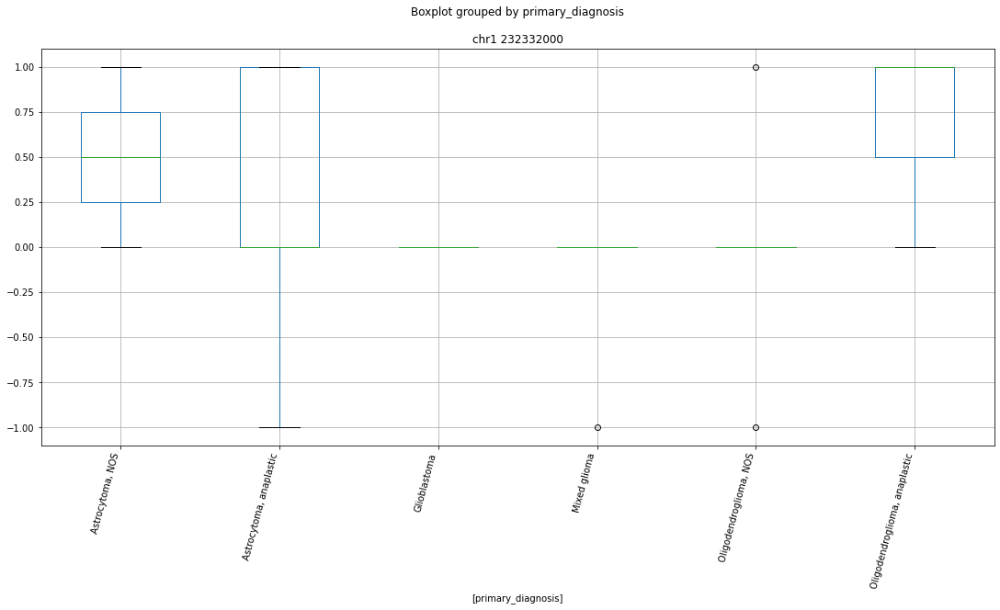

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 224101000


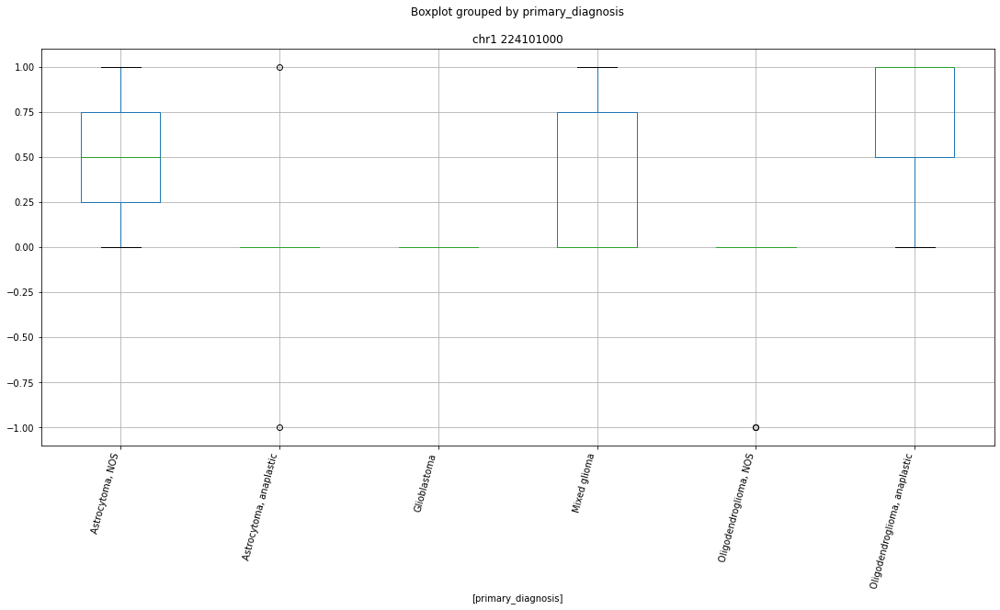

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 234267000


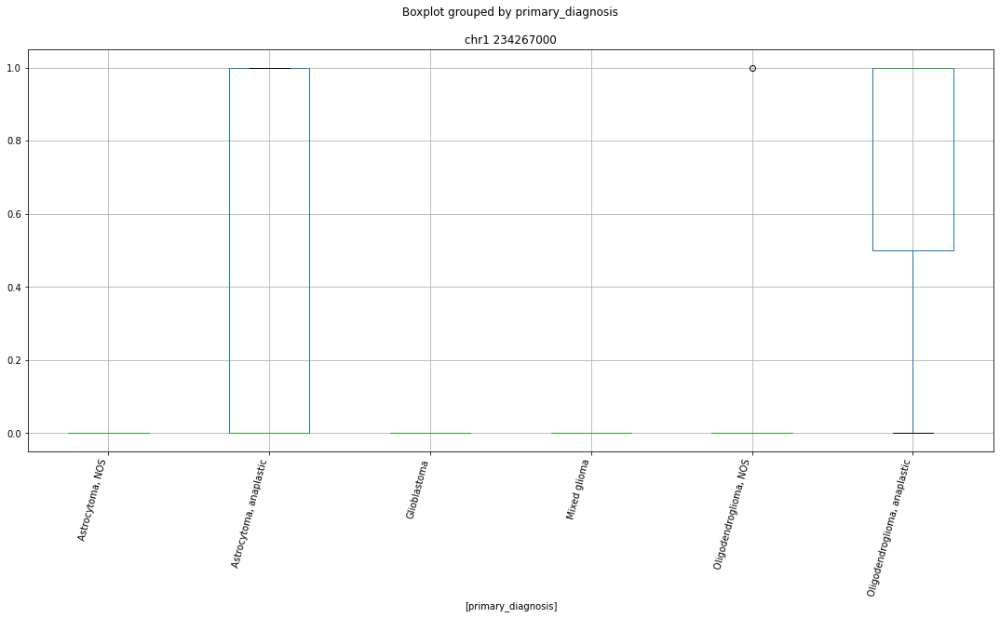

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 168837000


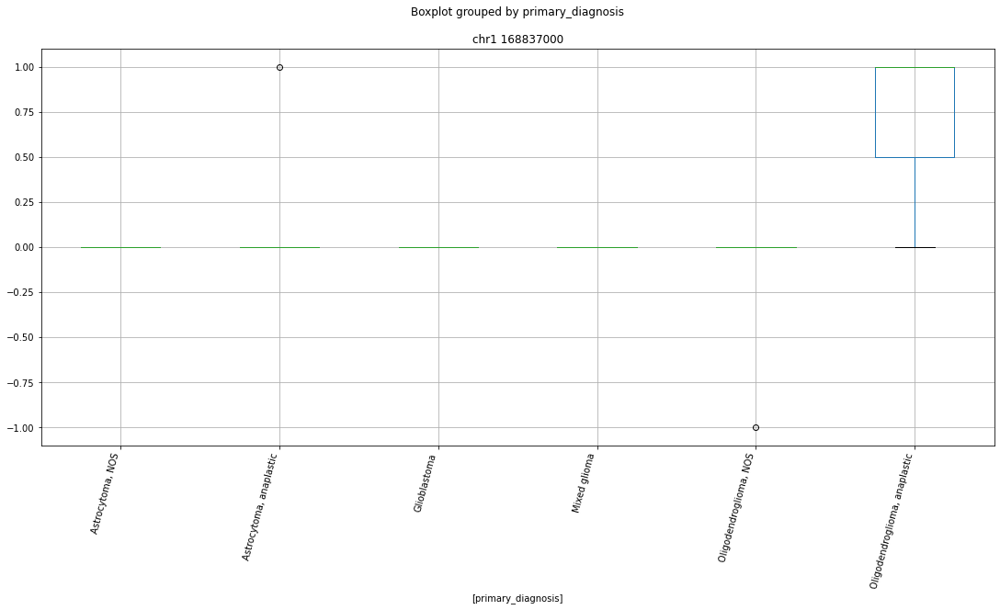

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 154287000


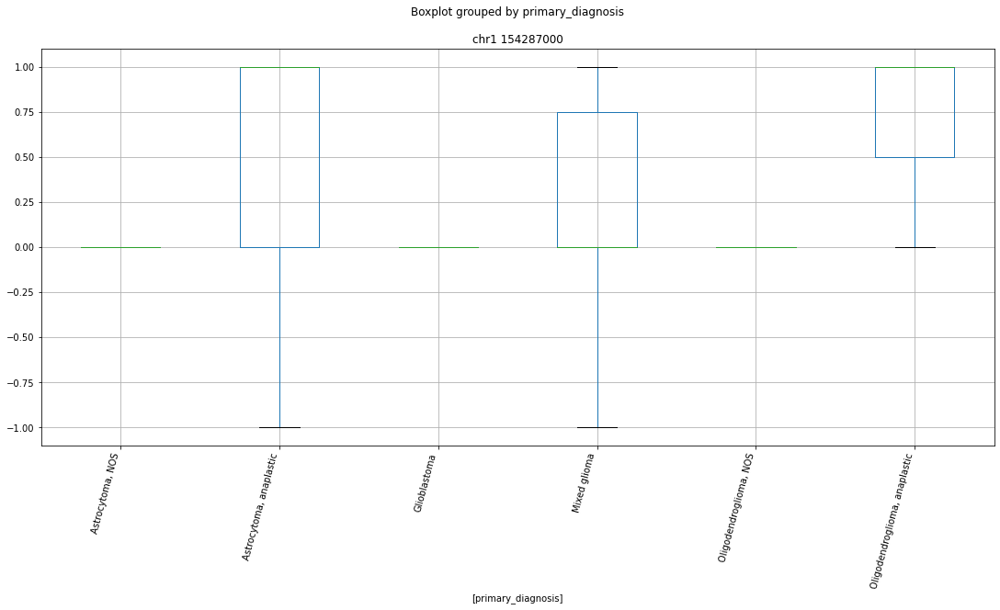

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 31177000


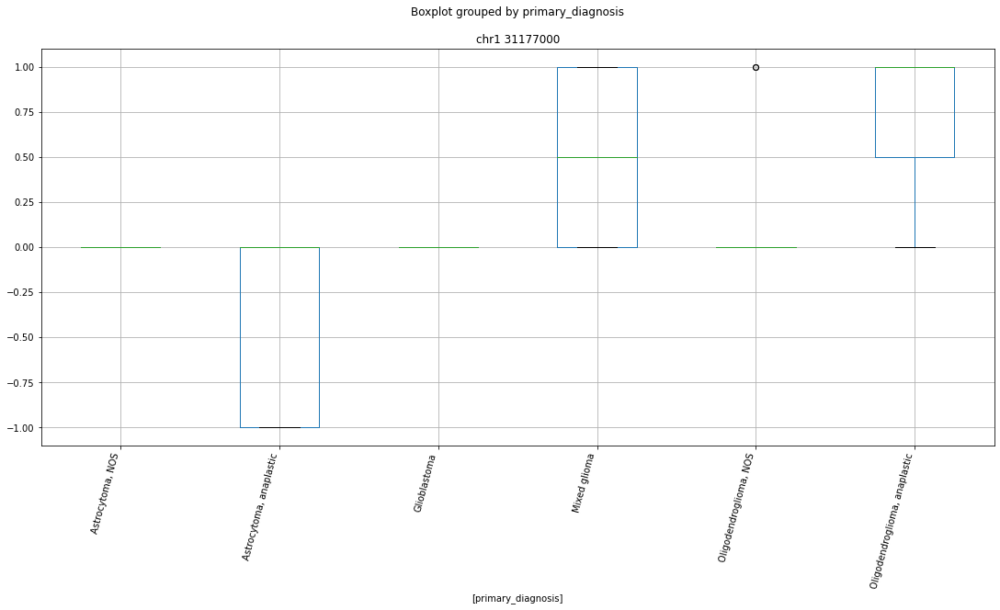

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 48174000


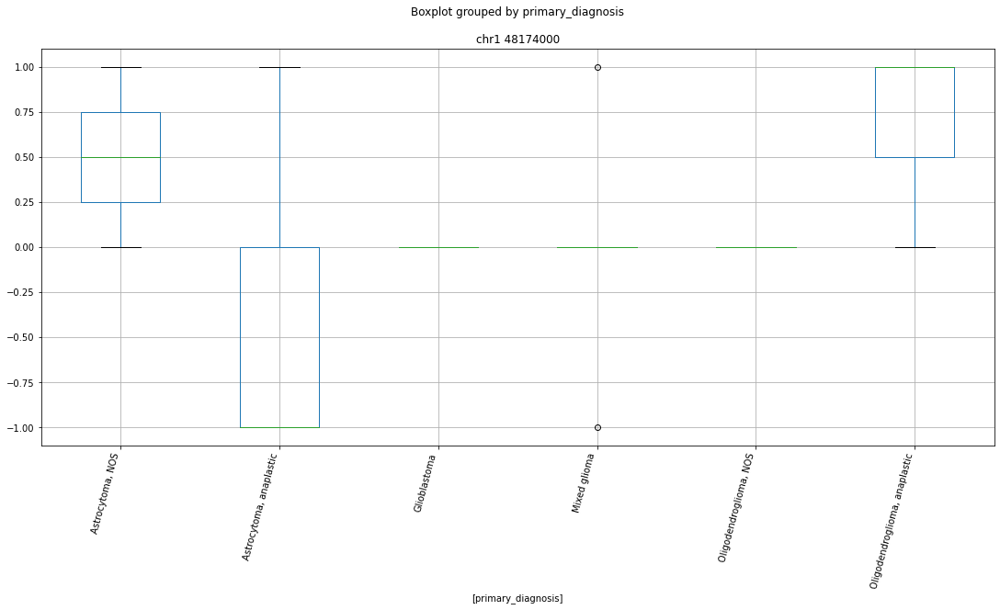

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 160936000


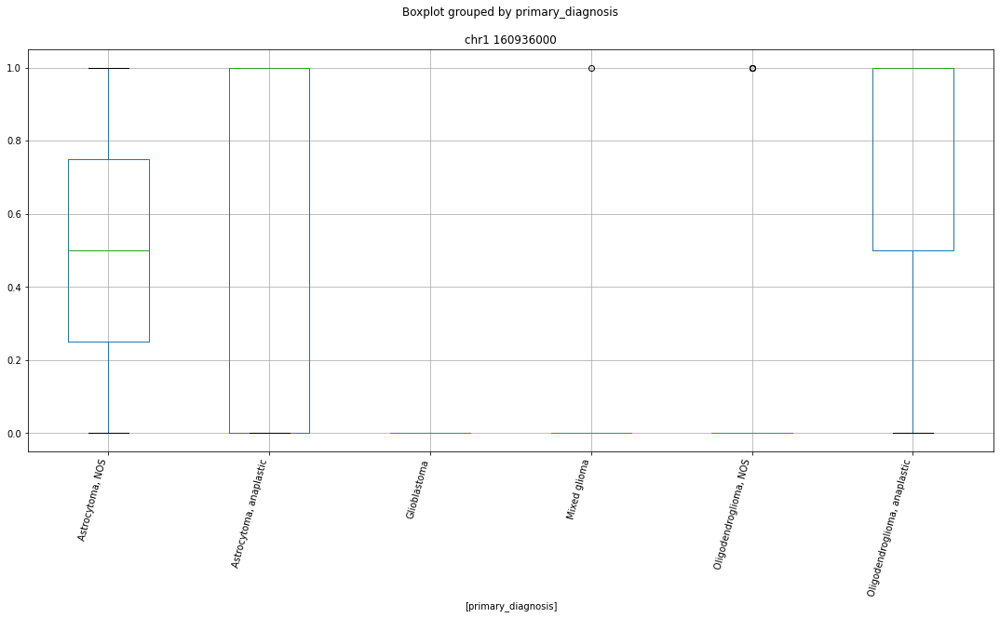

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 247220000


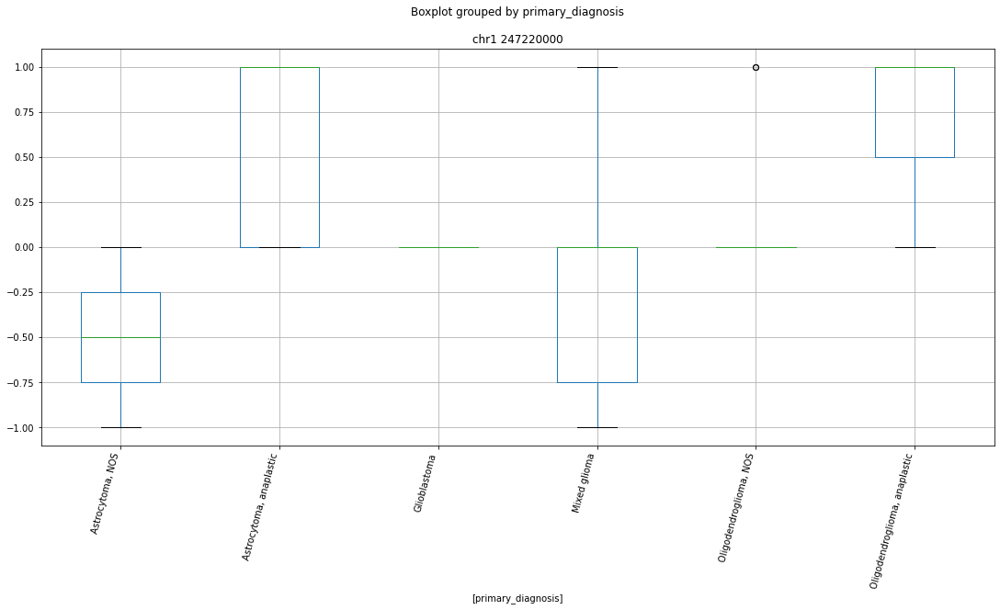

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 46321000


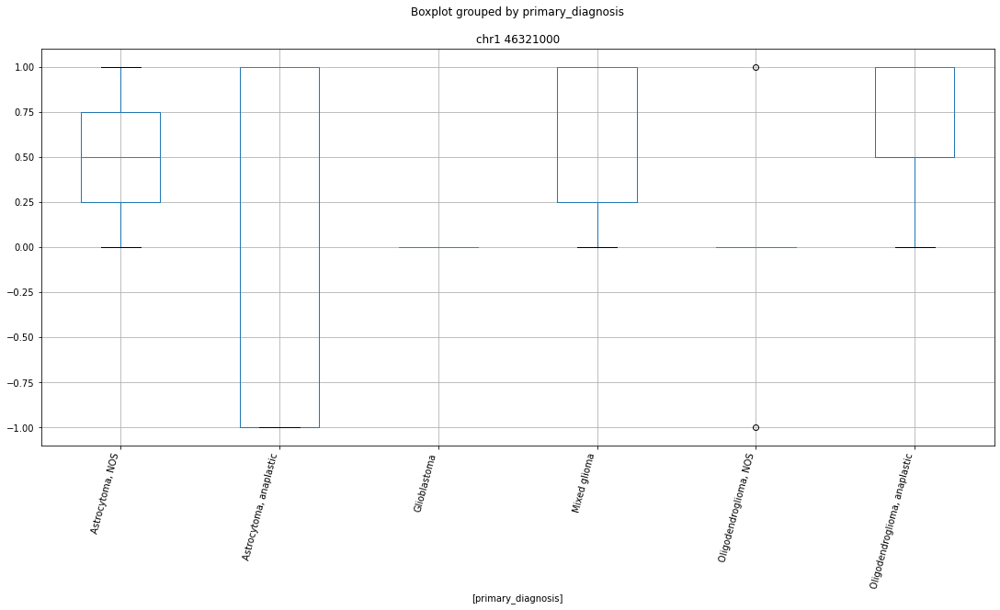

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 76111000


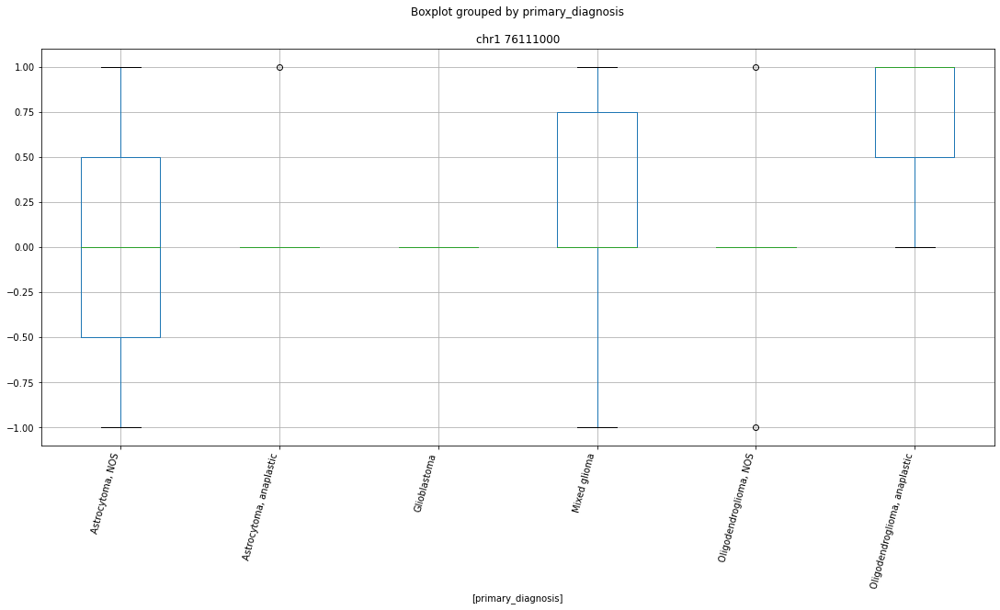

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr1 143703000


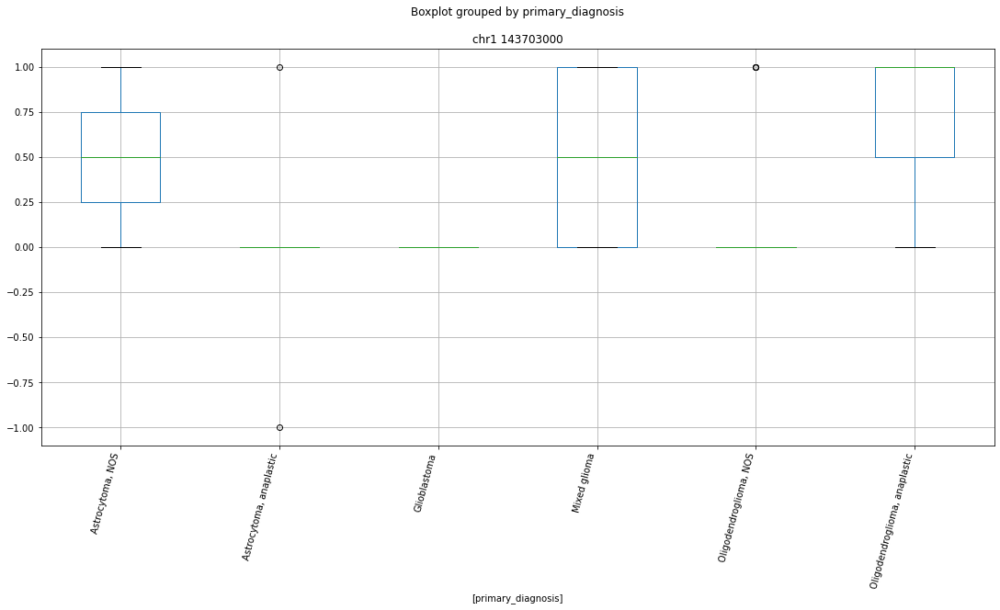

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr1 147241000


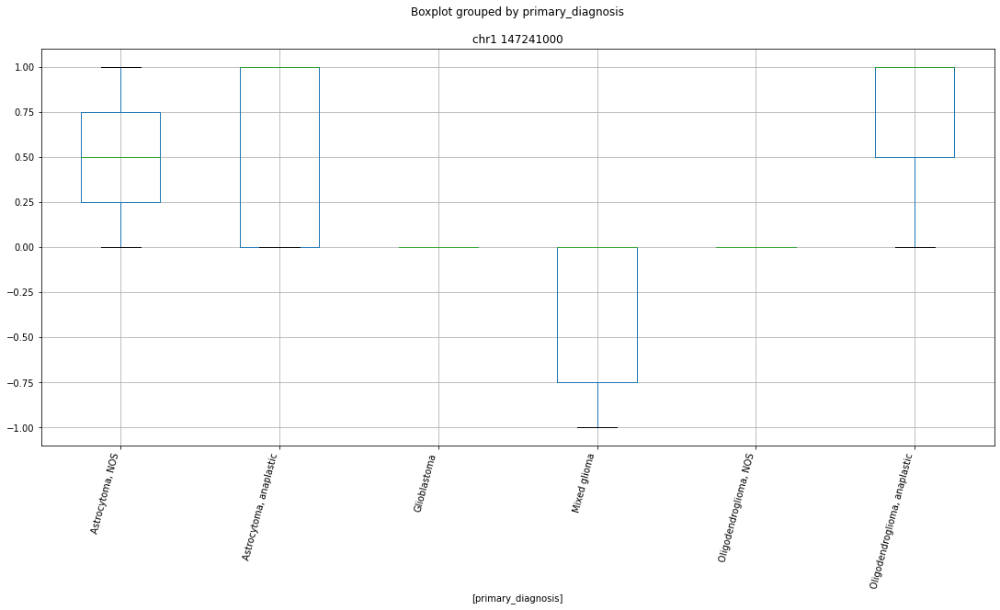

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr1 160936000


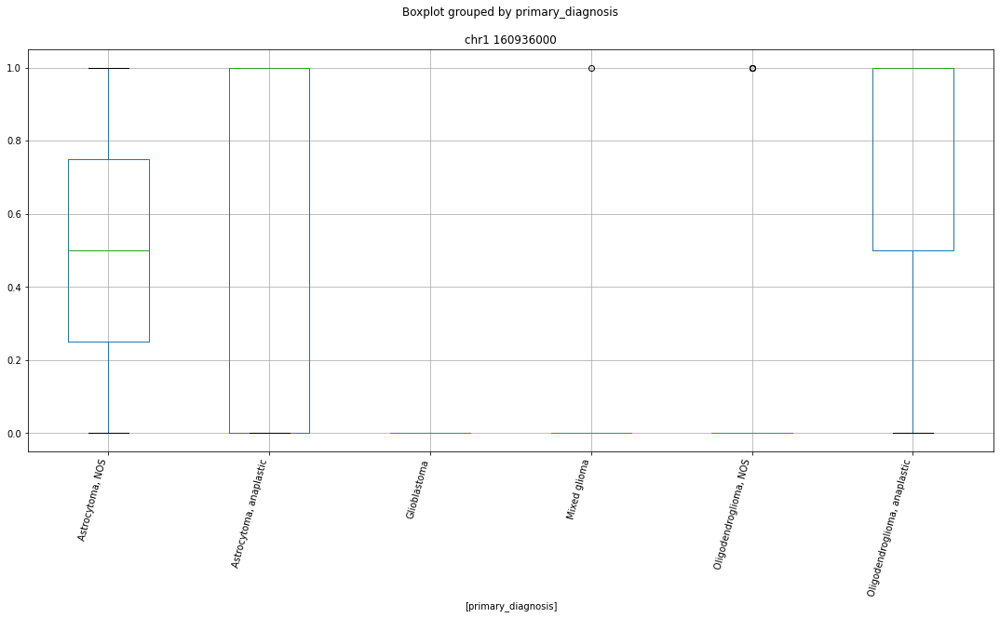

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr1 111360000


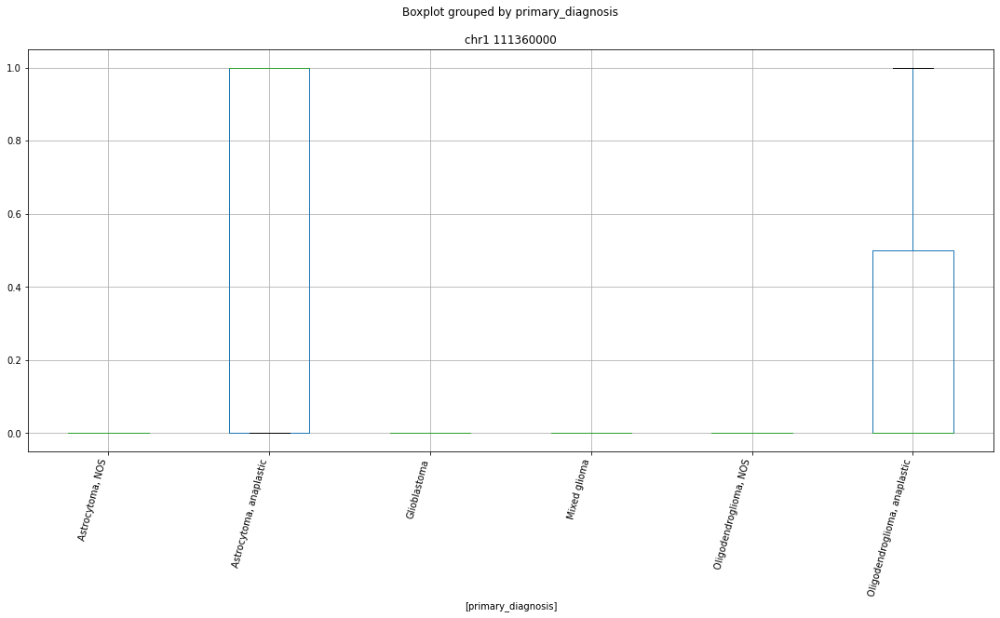

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr1 108535000


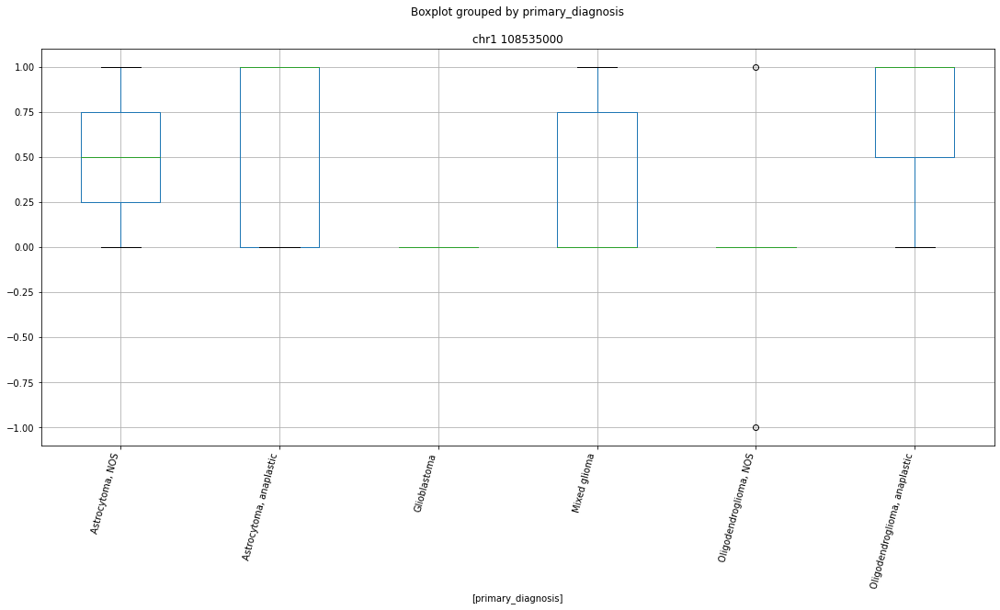

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr1 247220000


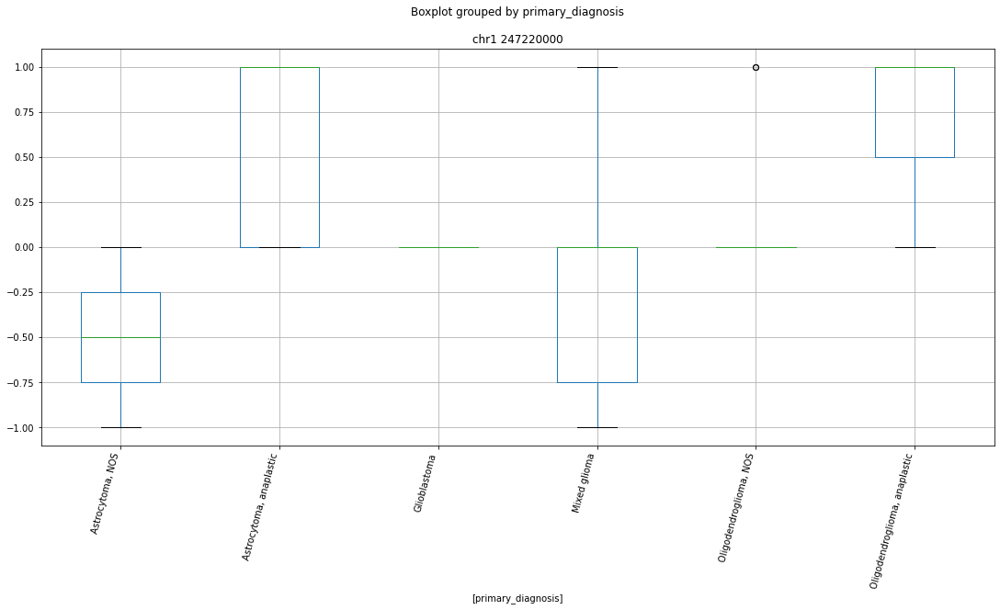

 p : 8.335862026711791e-08  ( t : 6.738353315566451 ) :  chr1 5573000


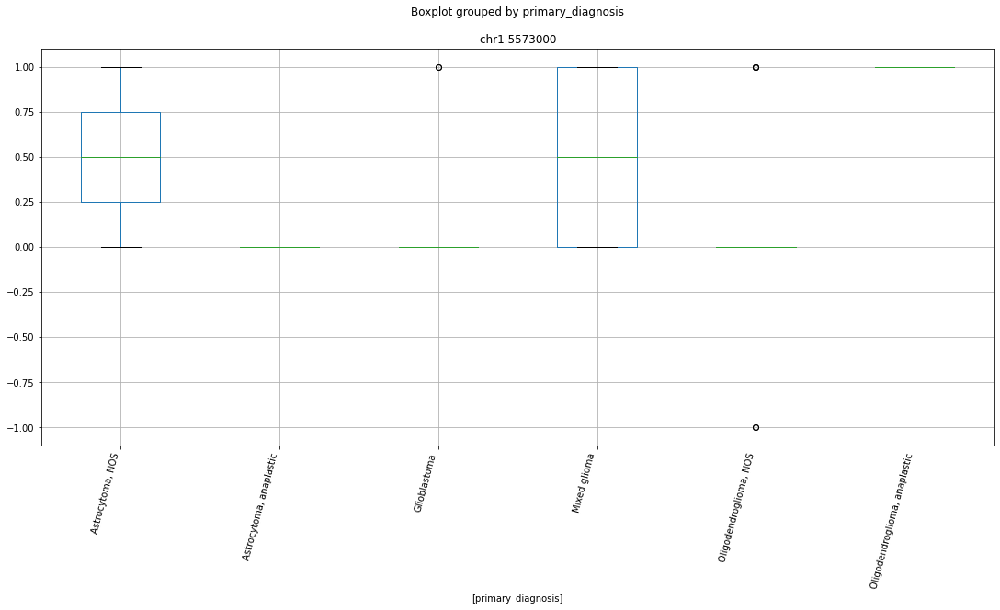

['chr1 10029000' 'chr1 104134000' 'chr1 104135000' 'chr1 108159000'
 'chr1 108535000' 'chr1 109053000' 'chr1 109177000' 'chr1 111233000'
 'chr1 111259000' 'chr1 111359000' 'chr1 111360000' 'chr1 111529000'
 'chr1 111800000' 'chr1 11249000' 'chr1 112816000' 'chr1 114059000'
 'chr1 114790000' 'chr1 120424000' 'chr1 13114000' 'chr1 13216000'
 'chr1 13329000' 'chr1 13362000' 'chr1 13704000' 'chr1 143639000'
 'chr1 143703000' 'chr1 144451000' 'chr1 145415000' 'chr1 145764000'
 'chr1 145766000' 'chr1 145932000' 'chr1 145933000' 'chr1 147107000'
 'chr1 147233000' 'chr1 147241000' 'chr1 147733000' 'chr1 148138000'
 'chr1 149093000' 'chr1 150632000' 'chr1 150635000' 'chr1 150710000'
 'chr1 151601000' 'chr1 152256000' 'chr1 152455000' 'chr1 152471000'
 'chr1 152797000' 'chr1 153583000' 'chr1 154287000' 'chr1 155599000'
 'chr1 156182000' 'chr1 156328000' 'chr1 160652000' 'chr1 160936000'
 'chr1 160947000' 'chr1 161315000' 'chr1 161411000' 'chr1 161413000'
 'chr1 161423000' 'chr1 161434000' 'chr1 

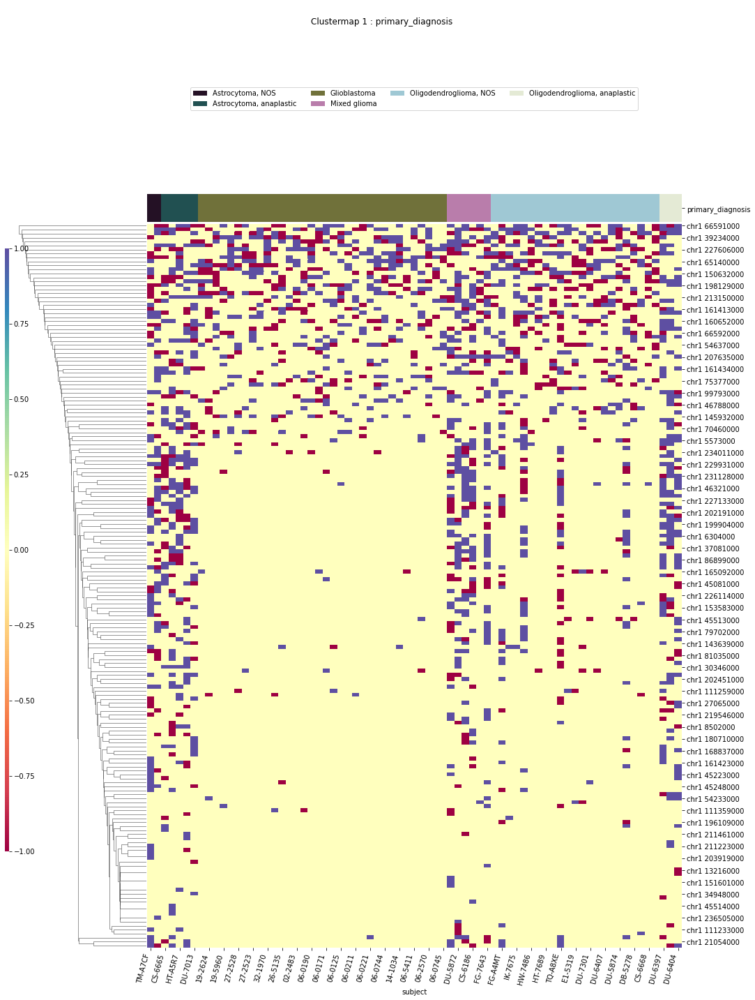

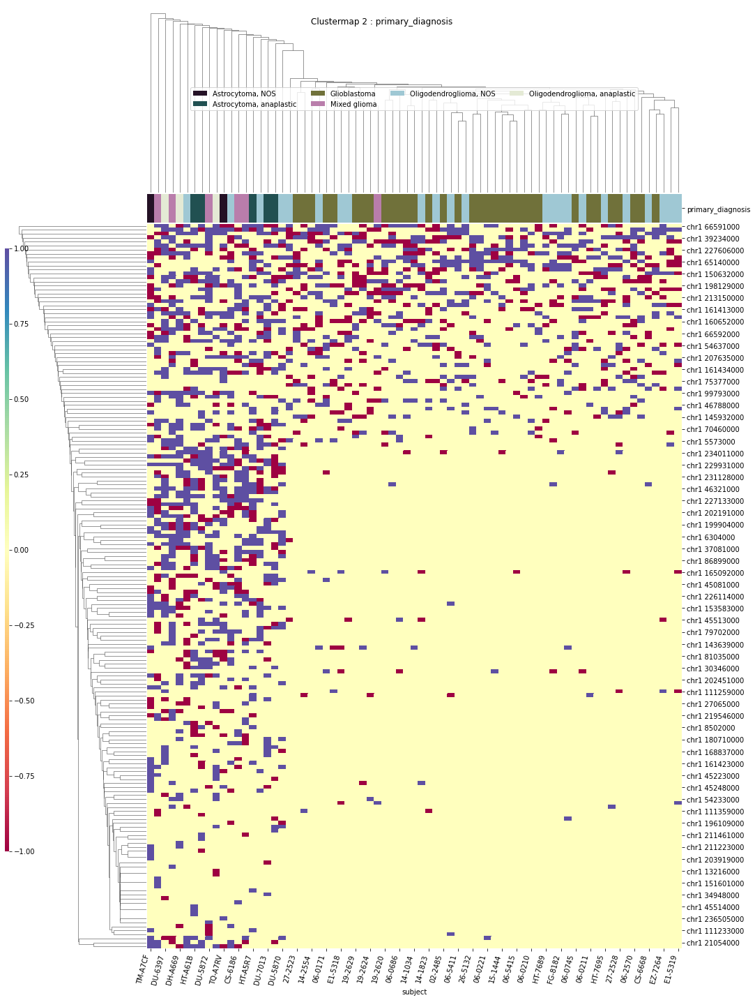

IDH
['IDH' 'chr1 104135000' 'chr1 11249000' 'chr1 1410000' 'chr1 143703000'
 'chr1 144451000' 'chr1 145932000' 'chr1 147106000' 'chr1 147240000'
 'chr1 152256000' 'chr1 152455000' 'chr1 156182000' 'chr1 1580000'
 'chr1 161017000' 'chr1 161315000' 'chr1 161423000' 'chr1 224339000'
 'chr1 237127000' 'chr1 246083000' 'chr1 25604000' 'chr1 33063000'
 'chr1 39870000' 'chr1 45513000' 'chr1 52007000' 'chr1 64416000'
 'chr1 66592000' 'chr1 75383000' 'chr1 93276000' 'subject']


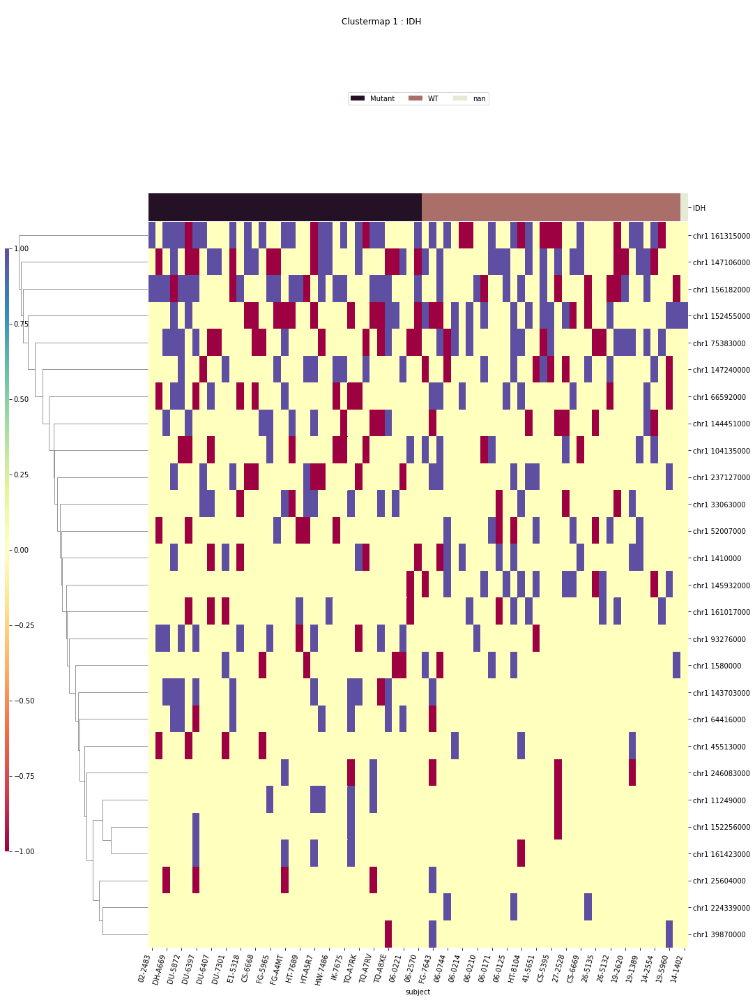

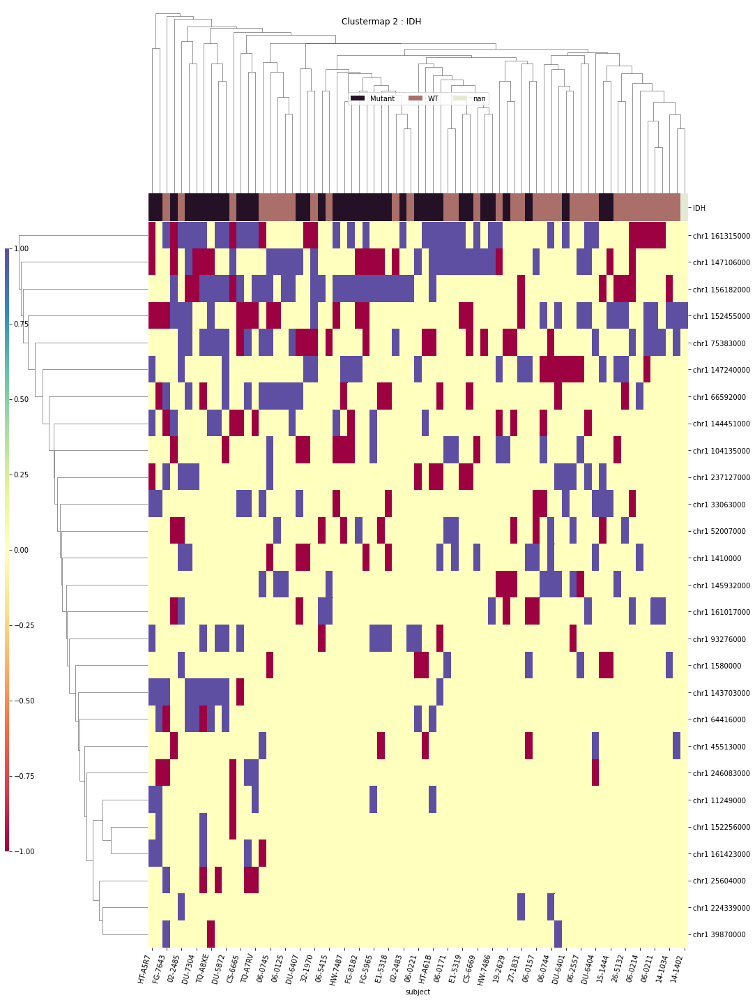

x1p19q
['chr1 104135000' 'chr1 10427000' 'chr1 109767000' 'chr1 114058000'
 'chr1 114059000' 'chr1 144451000' 'chr1 145764000' 'chr1 150728000'
 'chr1 15135000' 'chr1 15136000' 'chr1 152797000' 'chr1 156180000'
 'chr1 161016000' 'chr1 180710000' 'chr1 20703000' 'chr1 212320000'
 'chr1 225966000' 'chr1 227276000' 'chr1 234267000' 'chr1 235309000'
 'chr1 248906000' 'chr1 27854000' 'chr1 29360000' 'chr1 37559000'
 'chr1 37897000' 'chr1 40572000' 'chr1 45513000' 'chr1 45528000'
 'chr1 52007000' 'chr1 54561000' 'chr1 54637000' 'chr1 65140000'
 'chr1 66424000' 'chr1 66592000' 'chr1 70461000' 'chr1 89066000'
 'chr1 89067000' 'chr1 93276000' 'subject' 'x1p19q']


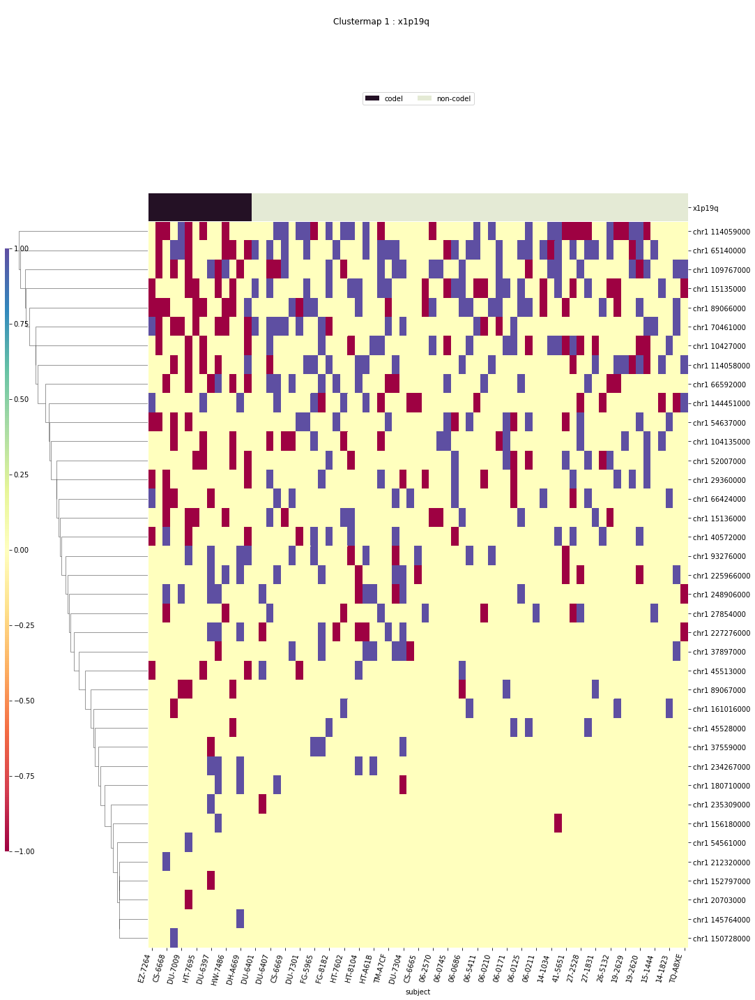

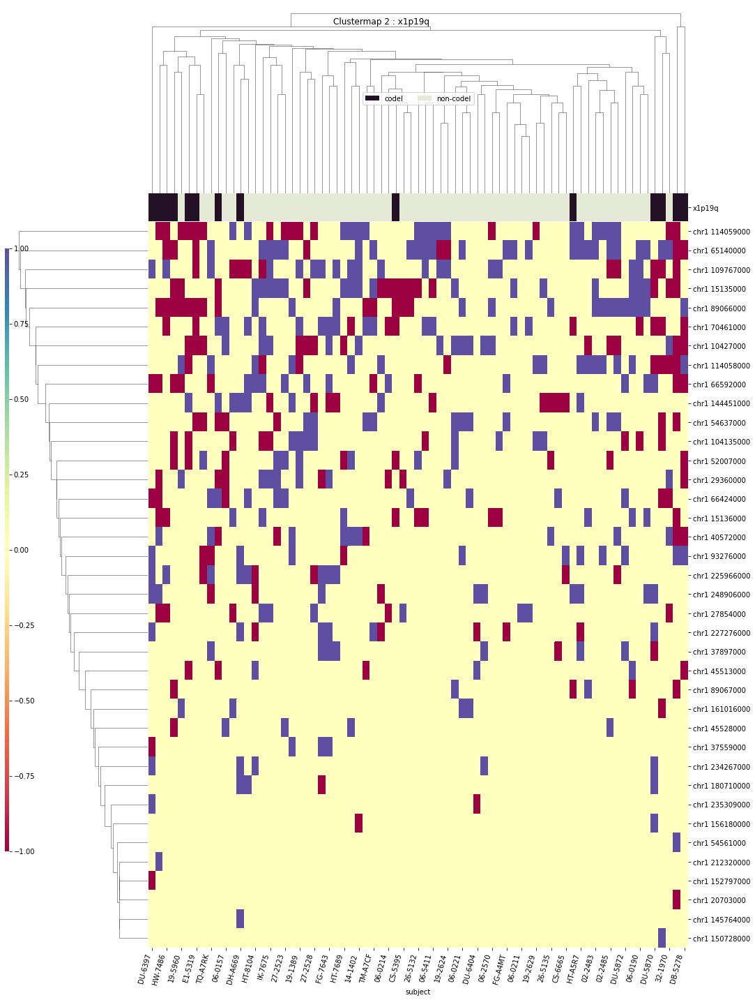

TERT
['TERT' 'chr1 109177000' 'chr1 11249000' 'chr1 114058000' 'chr1 120424000'
 'chr1 145415000' 'chr1 147106000' 'chr1 148138000' 'chr1 15135000'
 'chr1 152455000' 'chr1 156182000' 'chr1 160936000' 'chr1 160946000'
 'chr1 161017000' 'chr1 161315000' 'chr1 161423000' 'chr1 180710000'
 'chr1 209142000' 'chr1 227606000' 'chr1 227710000' 'chr1 23504000'
 'chr1 237127000' 'chr1 237669000' 'chr1 25587000' 'chr1 33063000'
 'chr1 45223000' 'chr1 46320000' 'chr1 54637000' 'chr1 64416000'
 'chr1 65139000' 'chr1 73129000' 'chr1 75377000' 'chr1 8912000'
 'chr1 99836000' 'subject']


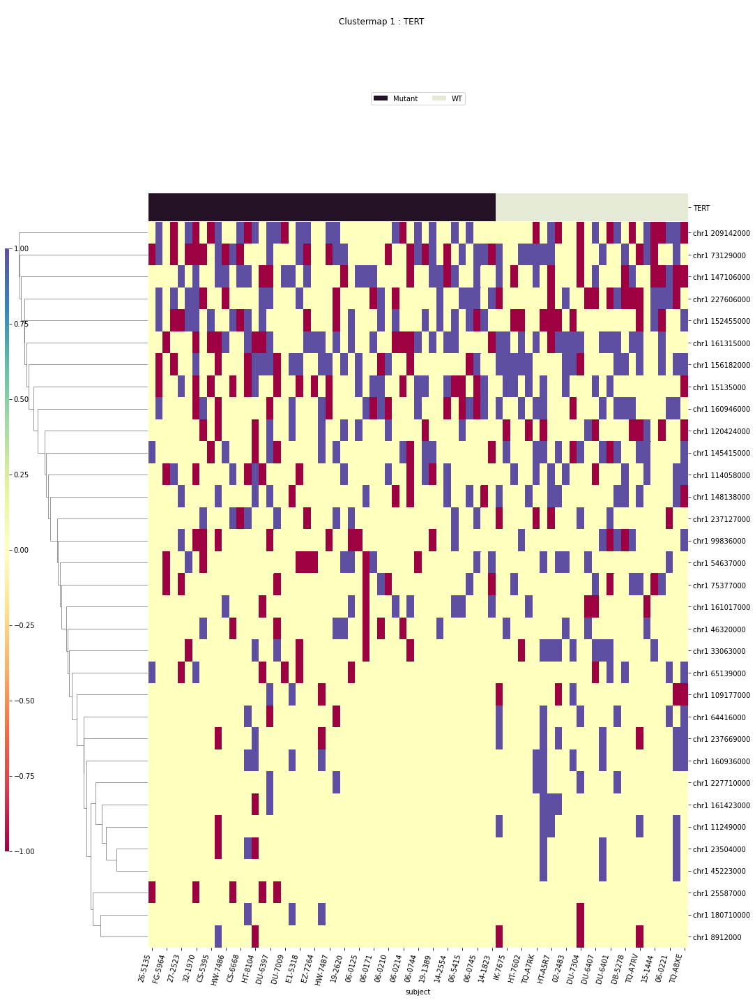

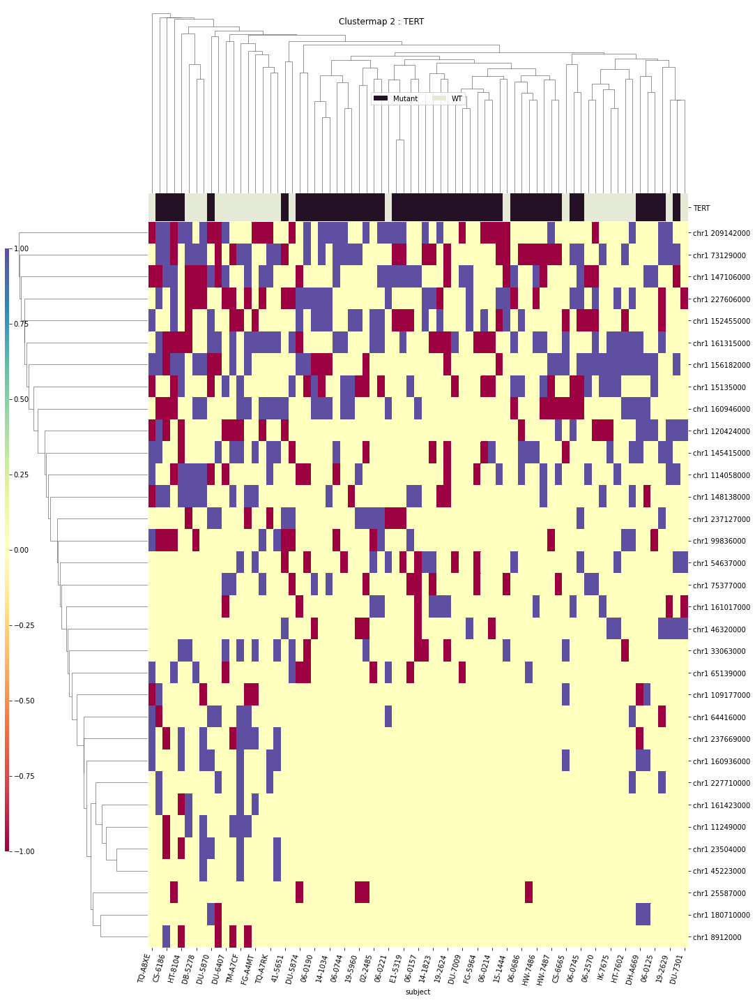

disease_type
['chr1 104135000' 'chr1 108535000' 'chr1 111360000' 'chr1 112816000'
 'chr1 143703000' 'chr1 144451000' 'chr1 148138000' 'chr1 150632000'
 'chr1 152455000' 'chr1 152471000' 'chr1 156182000' 'chr1 160652000'
 'chr1 160936000' 'chr1 161434000' 'chr1 198129000' 'chr1 207635000'
 'chr1 224339000' 'chr1 225966000' 'chr1 227606000' 'chr1 227710000'
 'chr1 229931000' 'chr1 234011000' 'chr1 234267000' 'chr1 24031000'
 'chr1 245775000' 'chr1 247015000' 'chr1 33063000' 'chr1 46321000'
 'chr1 52007000' 'chr1 6304000' 'chr1 79702000' 'chr1 89066000'
 'chr1 99793000' 'disease_type' 'subject']


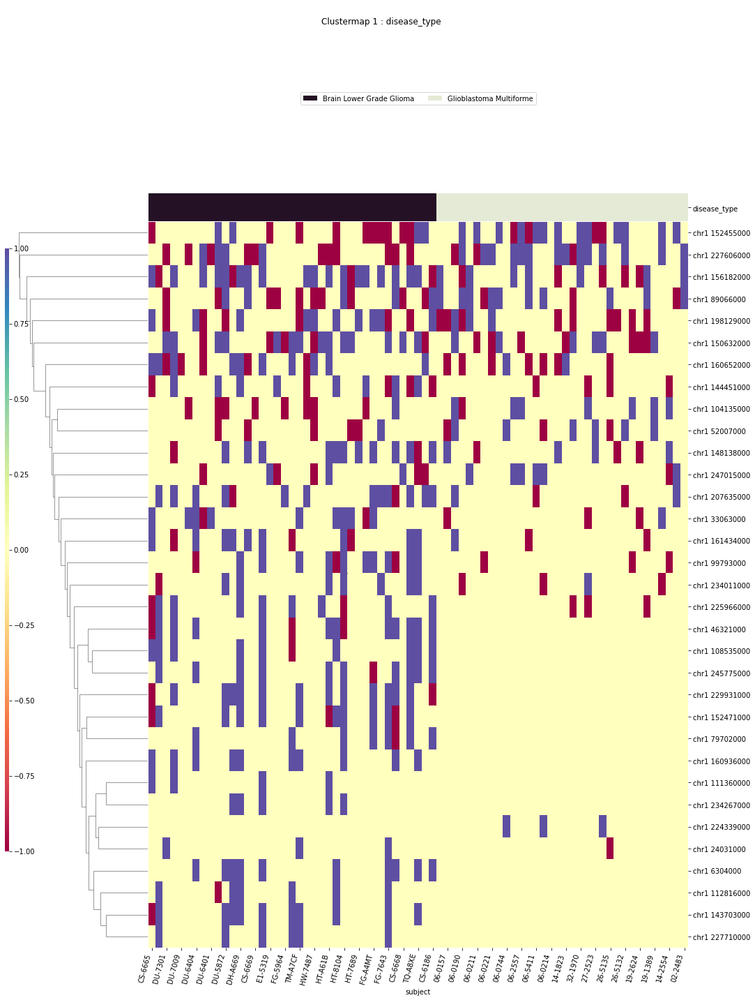

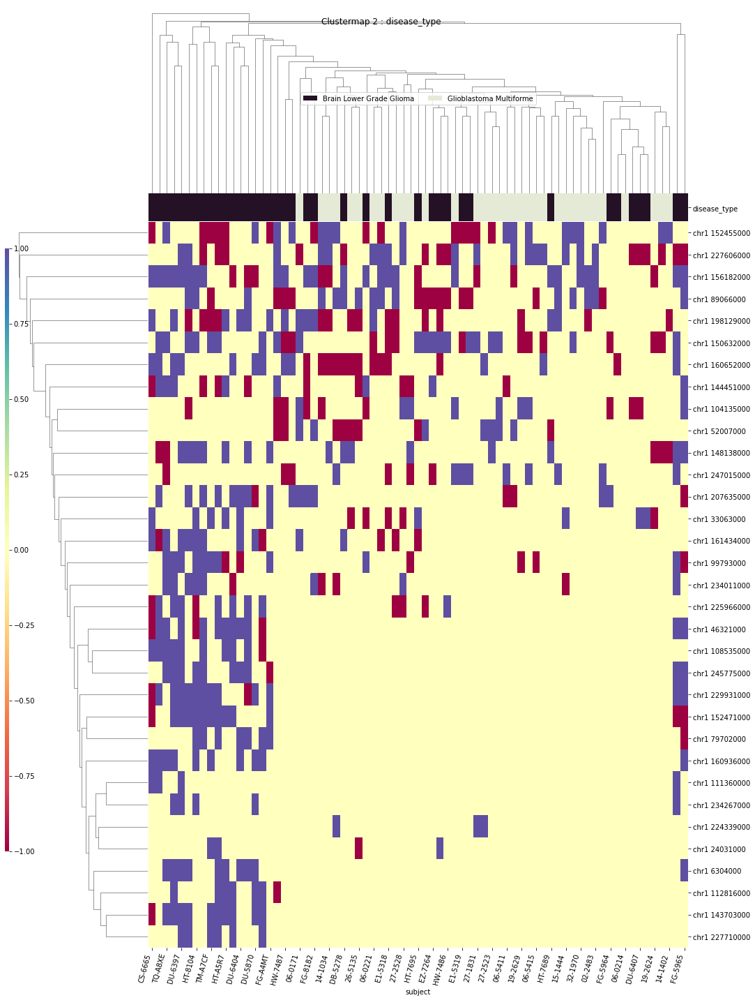

chr10
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr10 78075000


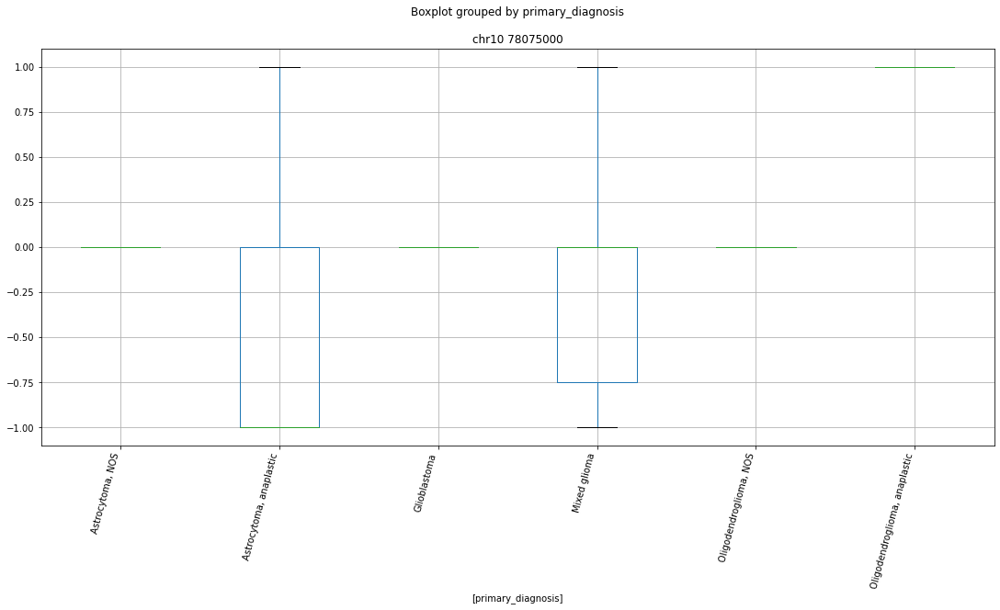

 p : 0.0  ( t : inf ) :  chr10 101033000


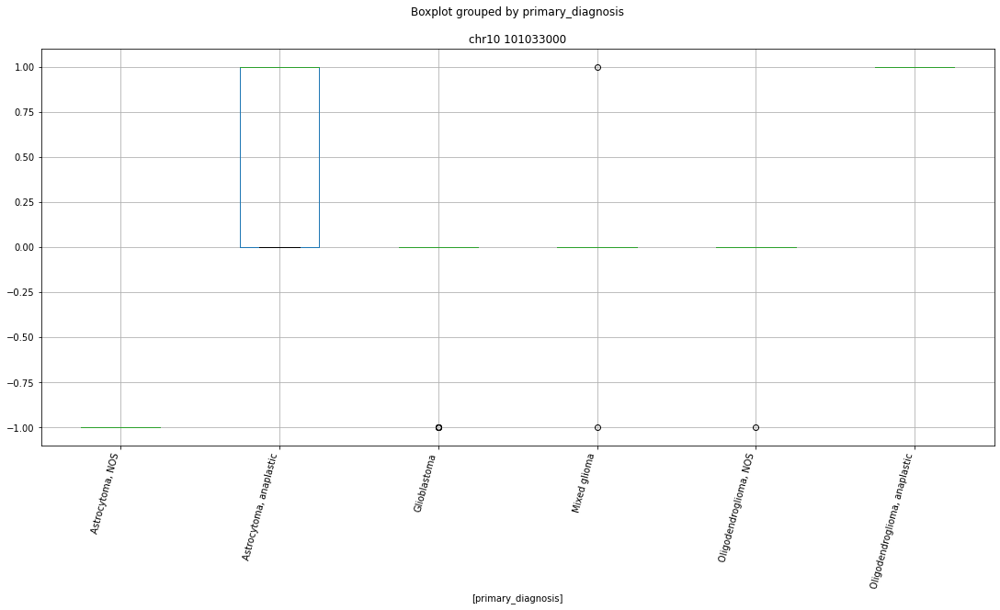

 p : 1.9864071913231304e-11  ( t : 9.677223188944682 ) :  chr10 86032000


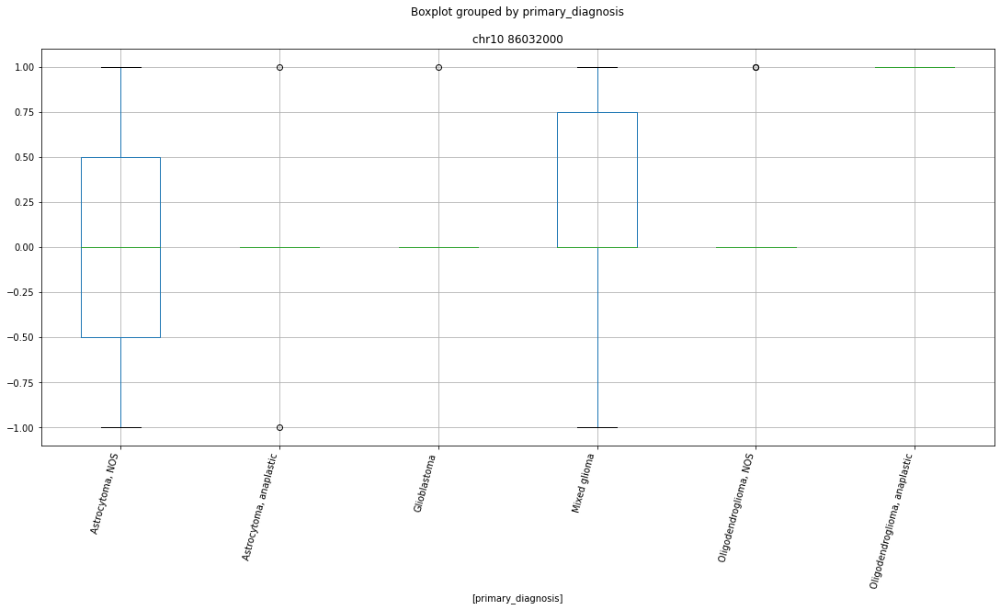

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr10 42138000


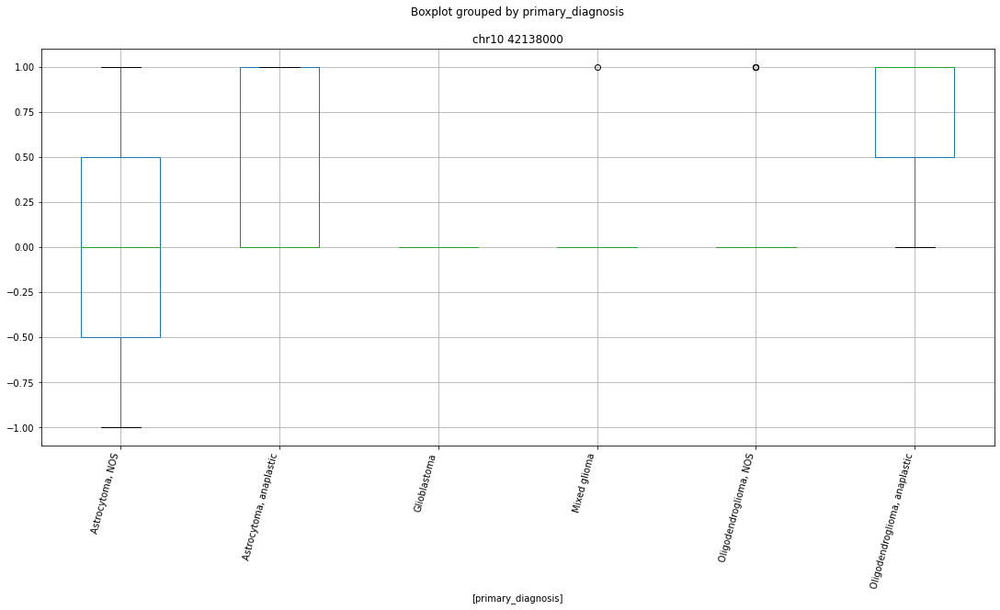

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr10 87081000


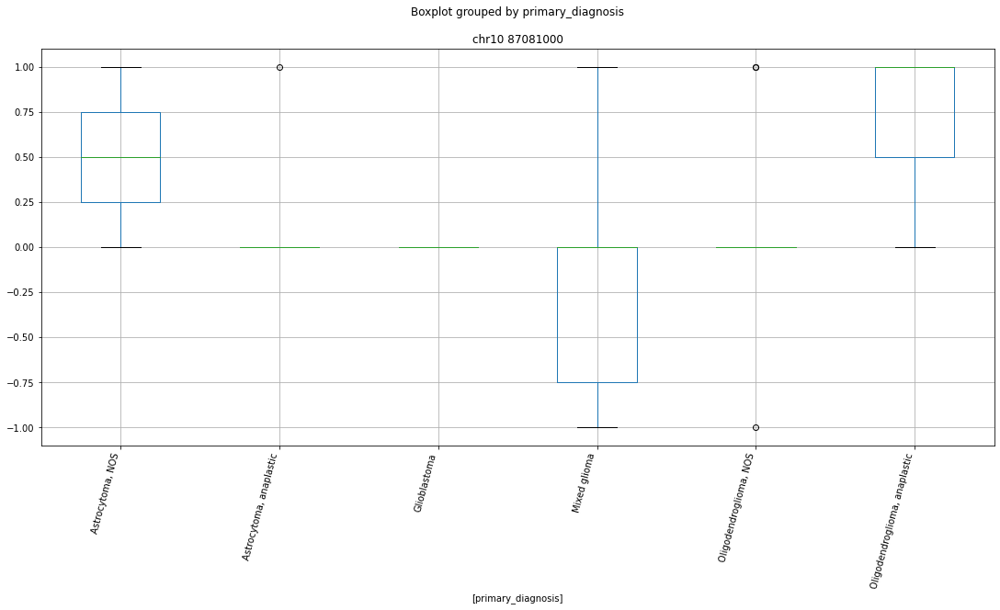

 p : 1.0281248528555288e-08  ( t : 8.514898502242788 ) :  chr10 101033000


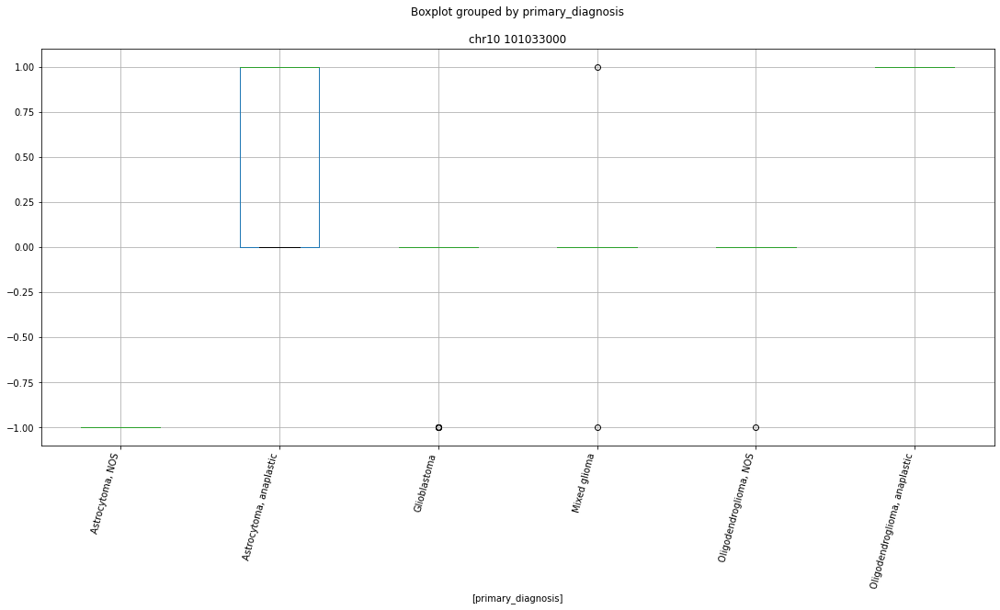

['chr10 100278000' 'chr10 101033000' 'chr10 102454000' 'chr10 102455000'
 'chr10 103130000' 'chr10 103607000' 'chr10 107801000' 'chr10 110766000'
 'chr10 114787000' 'chr10 119260000' 'chr10 119722000' 'chr10 119794000'
 'chr10 121930000' 'chr10 122203000' 'chr10 12226000' 'chr10 12518000'
 'chr10 125940000' 'chr10 133414000' 'chr10 133541000' 'chr10 133542000'
 'chr10 133611000' 'chr10 18425000' 'chr10 19510000' 'chr10 26893000'
 'chr10 27296000' 'chr10 2806000' 'chr10 29427000' 'chr10 29697000'
 'chr10 3061000' 'chr10 34976000' 'chr10 37494000' 'chr10 41713000'
 'chr10 41714000' 'chr10 42138000' 'chr10 45330000' 'chr10 45392000'
 'chr10 47396000' 'chr10 4903000' 'chr10 58688000' 'chr10 59697000'
 'chr10 67692000' 'chr10 6833000' 'chr10 69992000' 'chr10 70407000'
 'chr10 70631000' 'chr10 71869000' 'chr10 71875000' 'chr10 73715000'
 'chr10 75332000' 'chr10 75750000' 'chr10 78075000' 'chr10 80535000'
 'chr10 80806000' 'chr10 83520000' 'chr10 86032000' 'chr10 87081000'
 'chr10 8869000' 'c

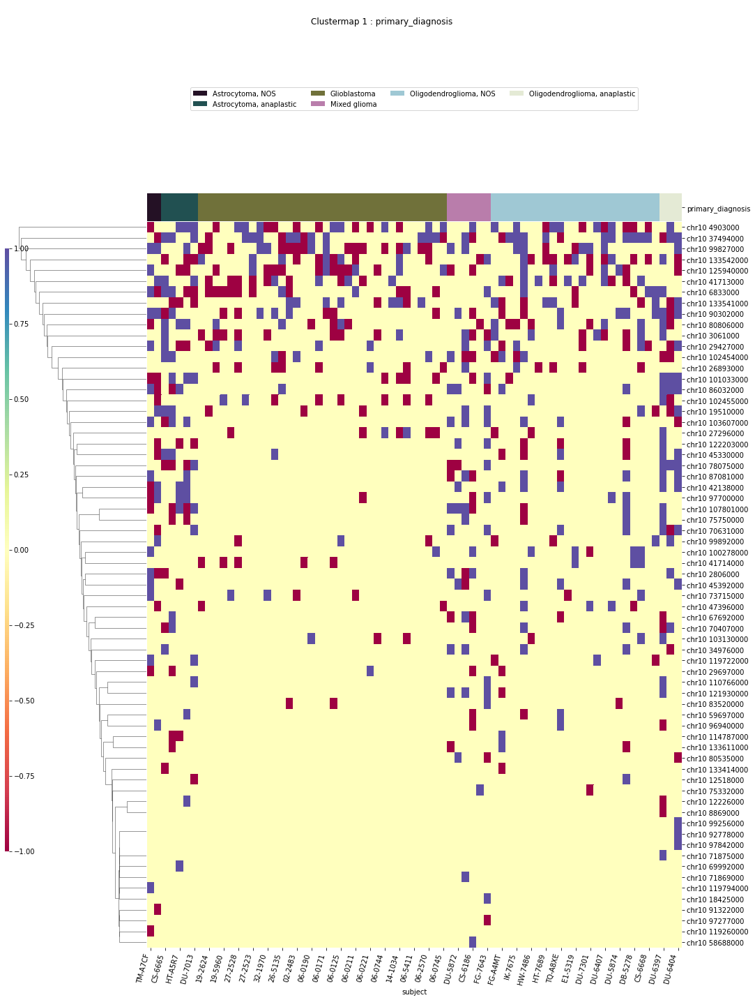

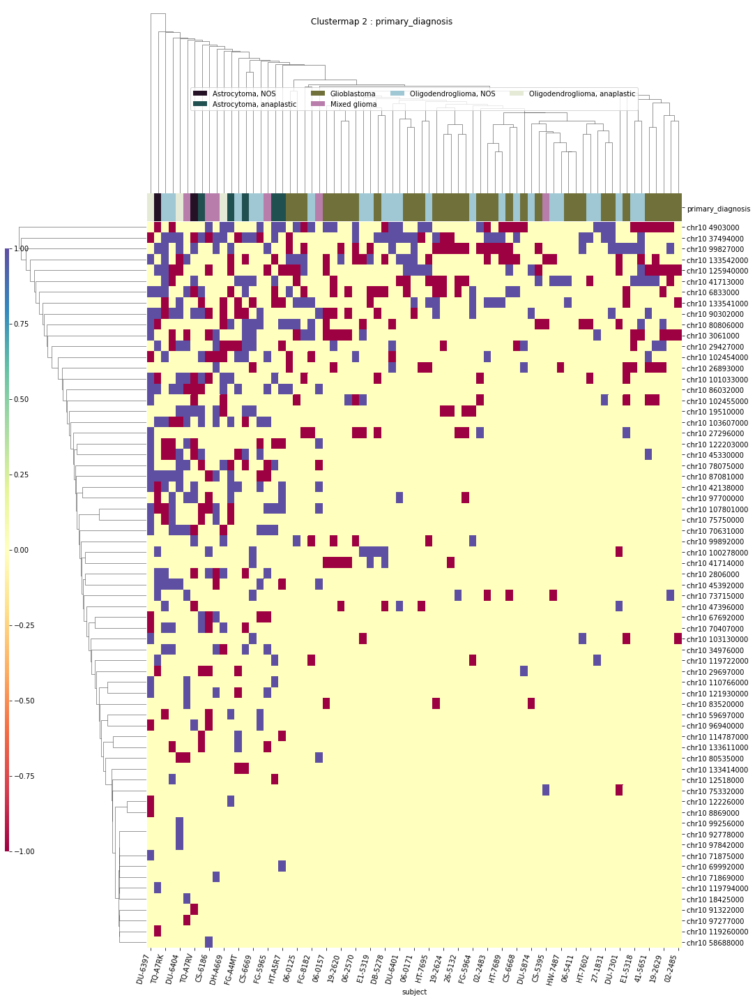

IDH
['IDH' 'chr10 102392000' 'chr10 19509000' 'chr10 26893000' 'chr10 3061000'
 'chr10 41714000' 'chr10 6164000' 'chr10 6833000' 'chr10 80535000'
 'chr10 90302000' 'subject']


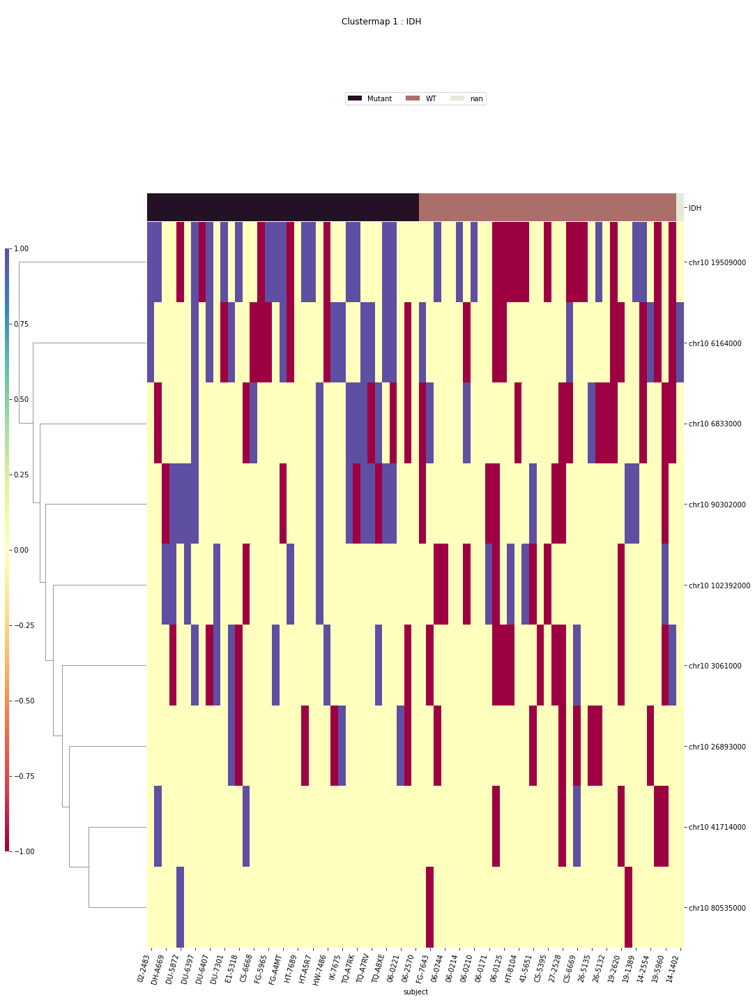

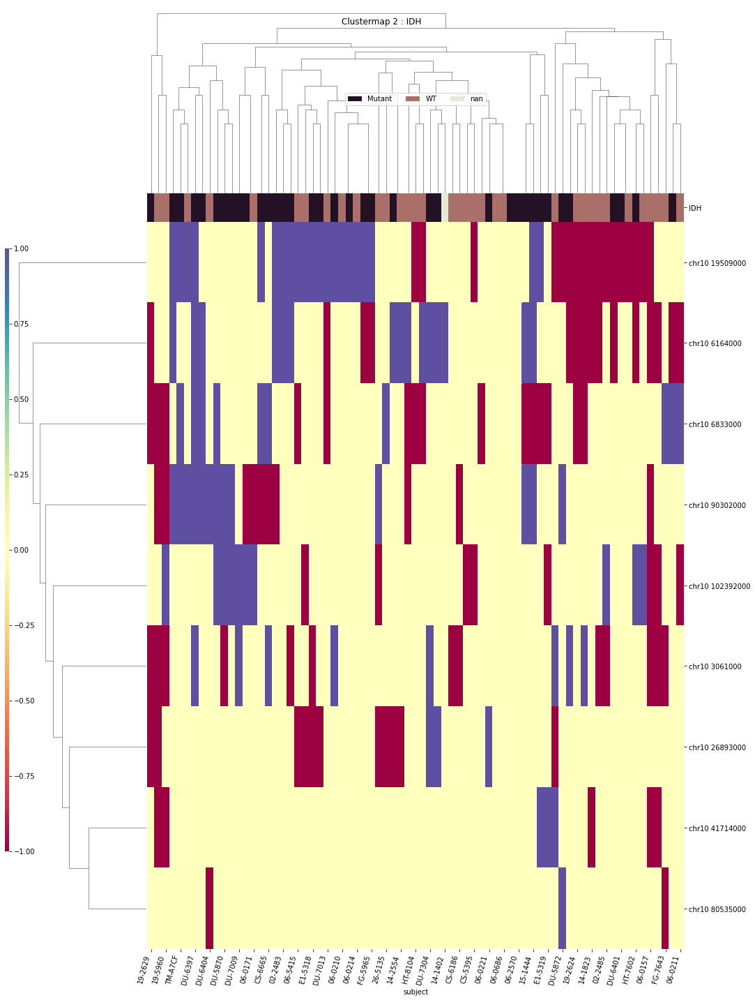

x1p19q
['chr10 100278000' 'chr10 102391000' 'chr10 1157000' 'chr10 12226000'
 'chr10 12518000' 'chr10 19510000' 'chr10 21430000' 'chr10 29427000'
 'chr10 37493000' 'chr10 41714000' 'chr10 43338000' 'chr10 71875000'
 'chr10 75750000' 'chr10 8869000' 'subject' 'x1p19q']


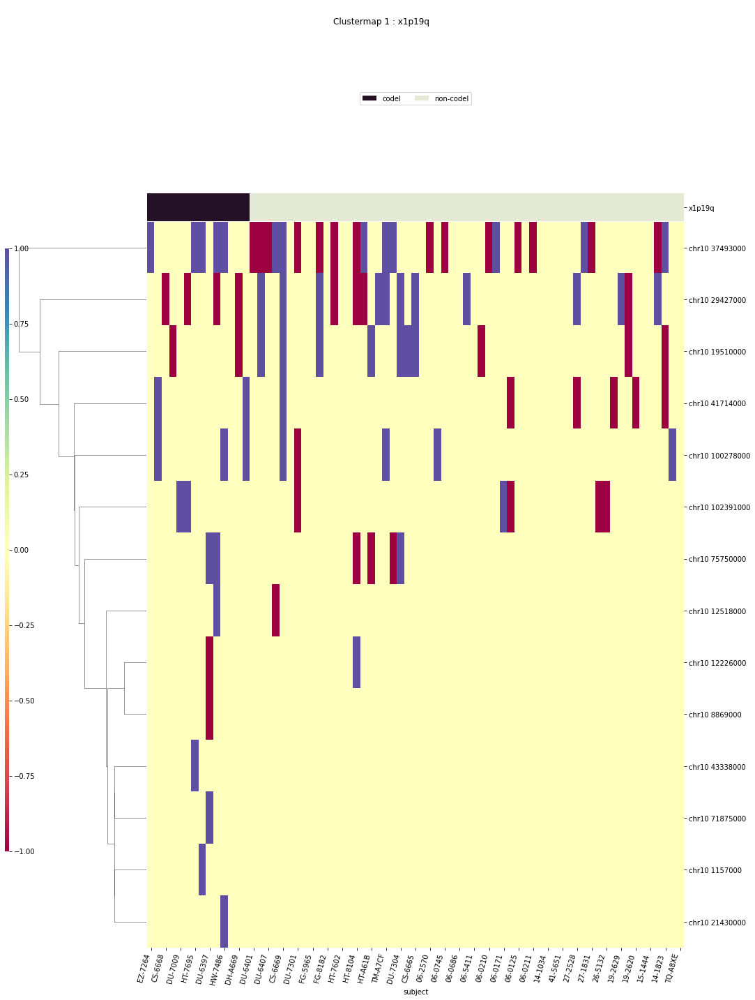

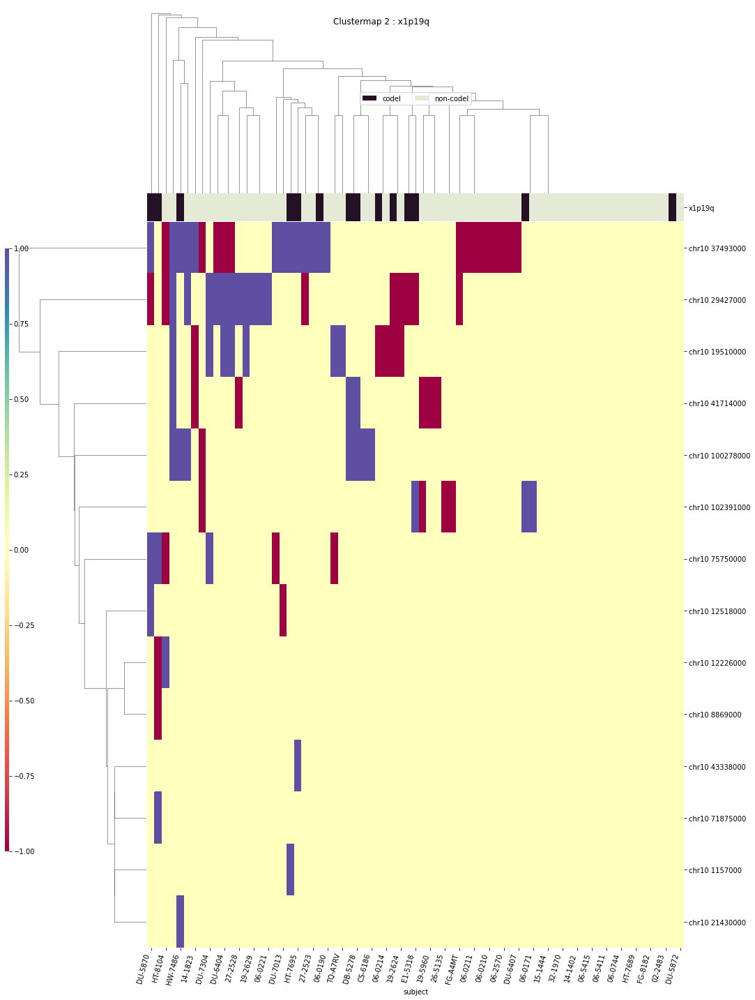

TERT
['TERT' 'chr10 102454000' 'chr10 133414000' 'chr10 19509000'
 'chr10 19510000' 'chr10 26893000' 'chr10 29427000' 'chr10 3061000'
 'chr10 34976000' 'chr10 37494000' 'chr10 41714000' 'chr10 42138000'
 'chr10 78075000' 'chr10 96940000' 'chr10 97416000' 'chr10 99827000'
 'subject']


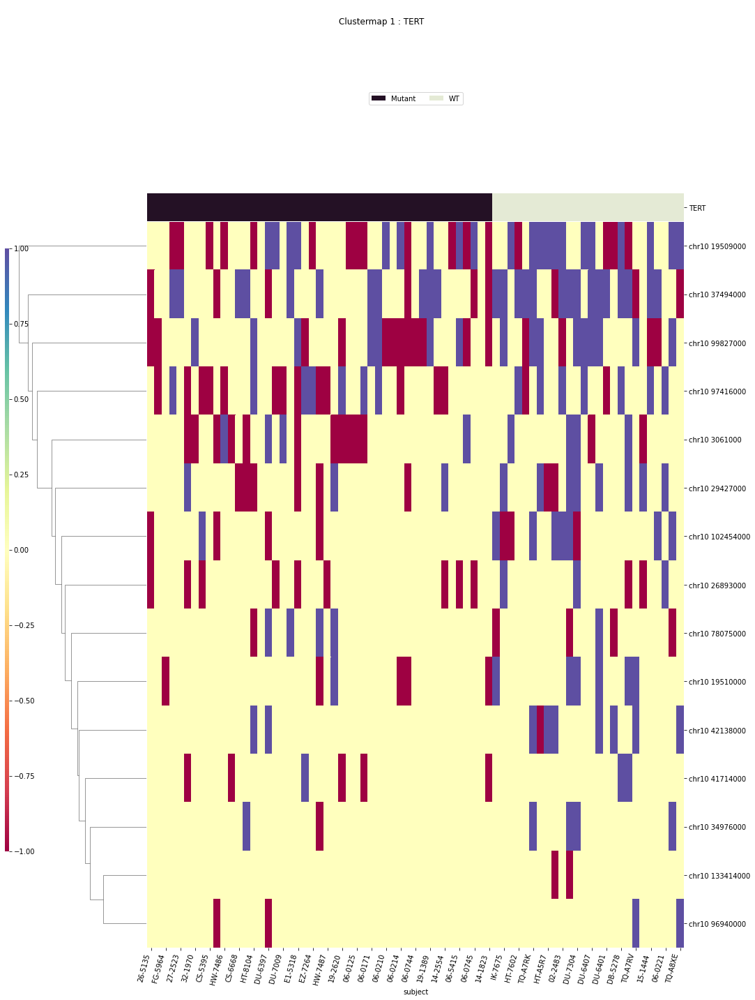

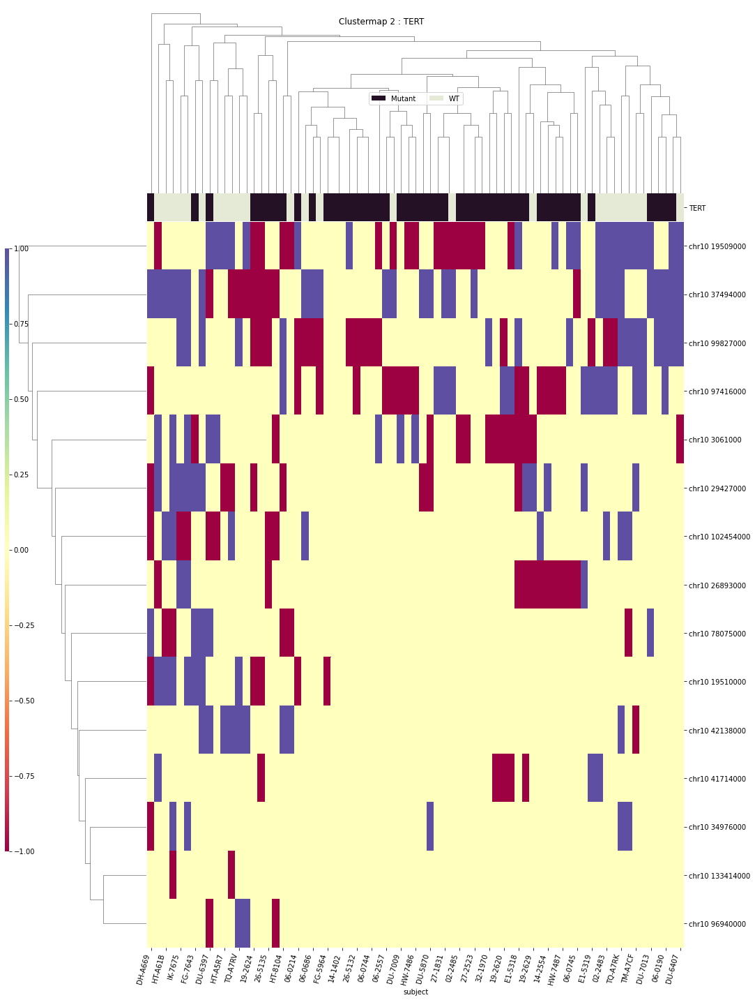

disease_type
['chr10 101033000' 'chr10 133541000' 'chr10 19510000' 'chr10 29697000'
 'chr10 3061000' 'chr10 41713000' 'chr10 41714000' 'chr10 42138000'
 'chr10 6833000' 'chr10 99827000' 'disease_type' 'subject']


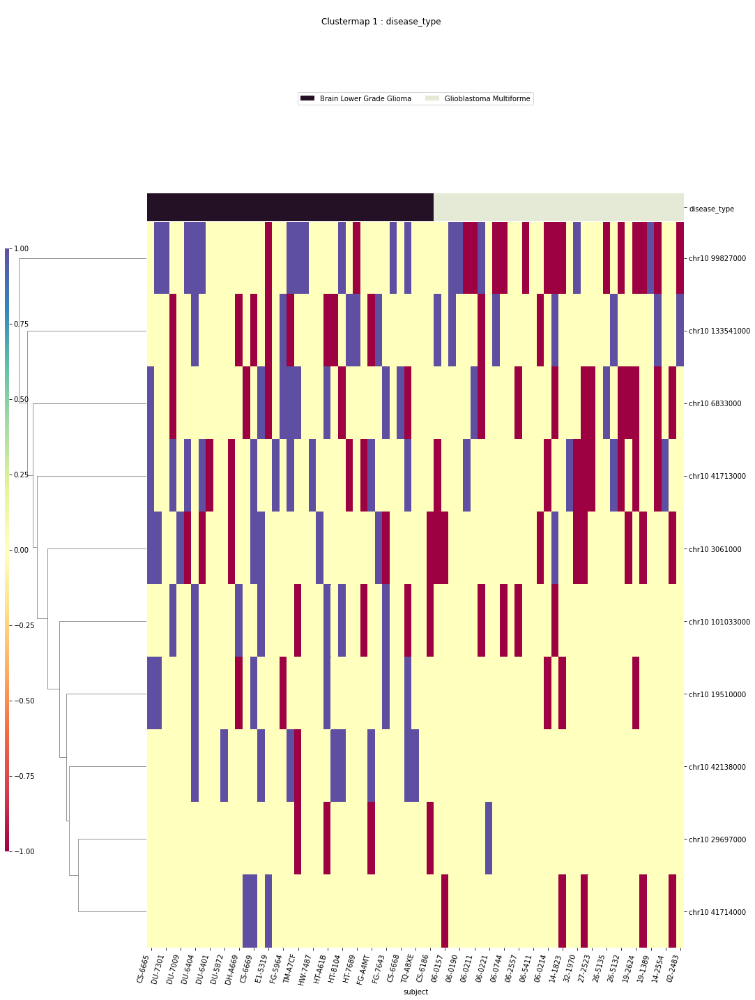

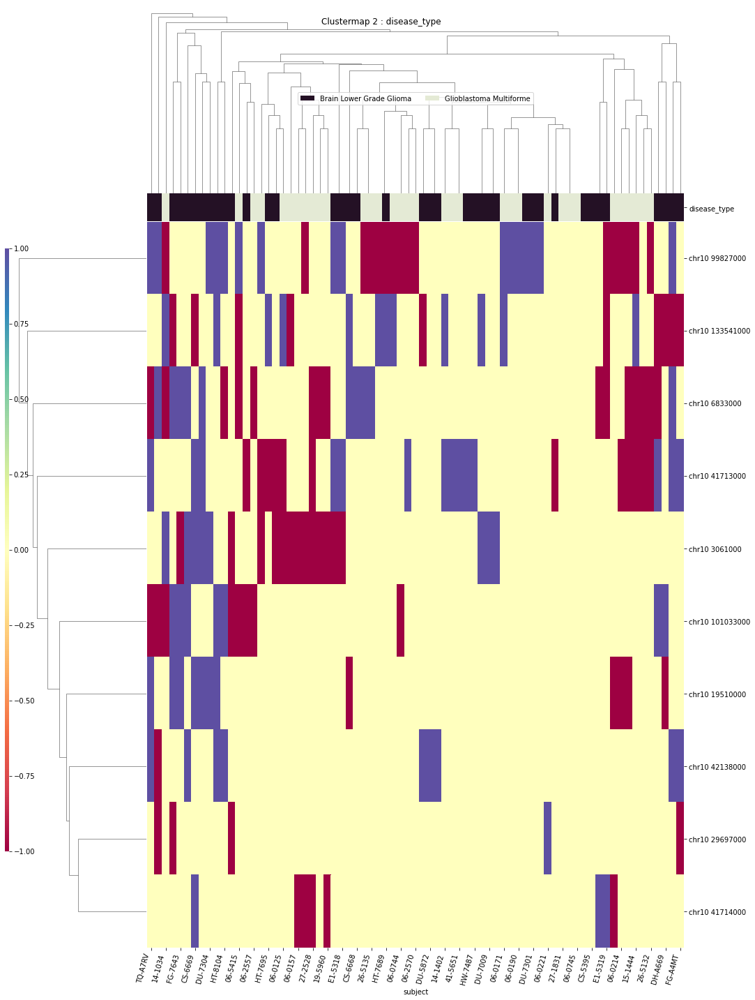

chr11
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr11 18900000


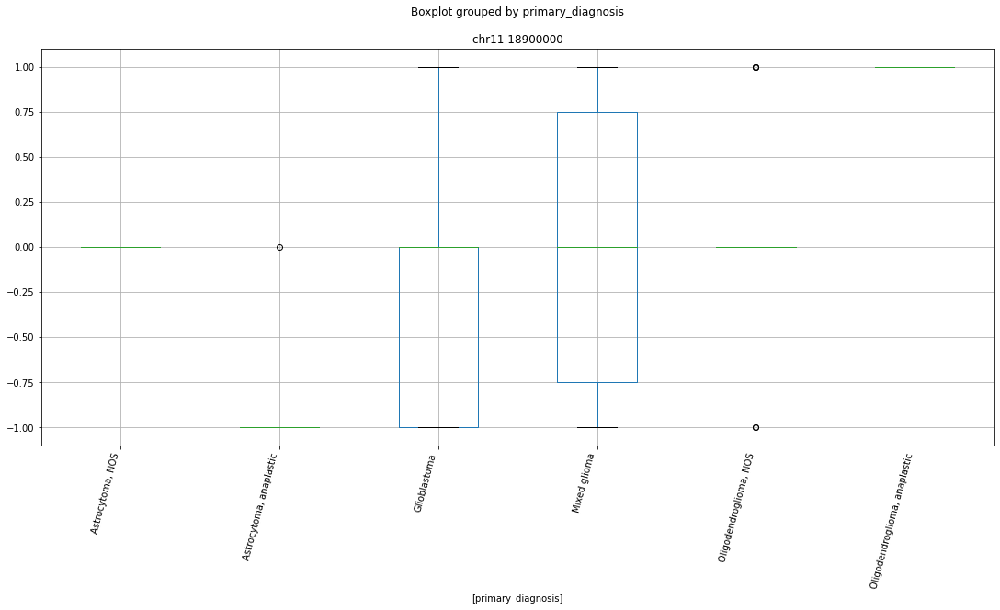

 p : 0.0  ( t : inf ) :  chr11 65452000


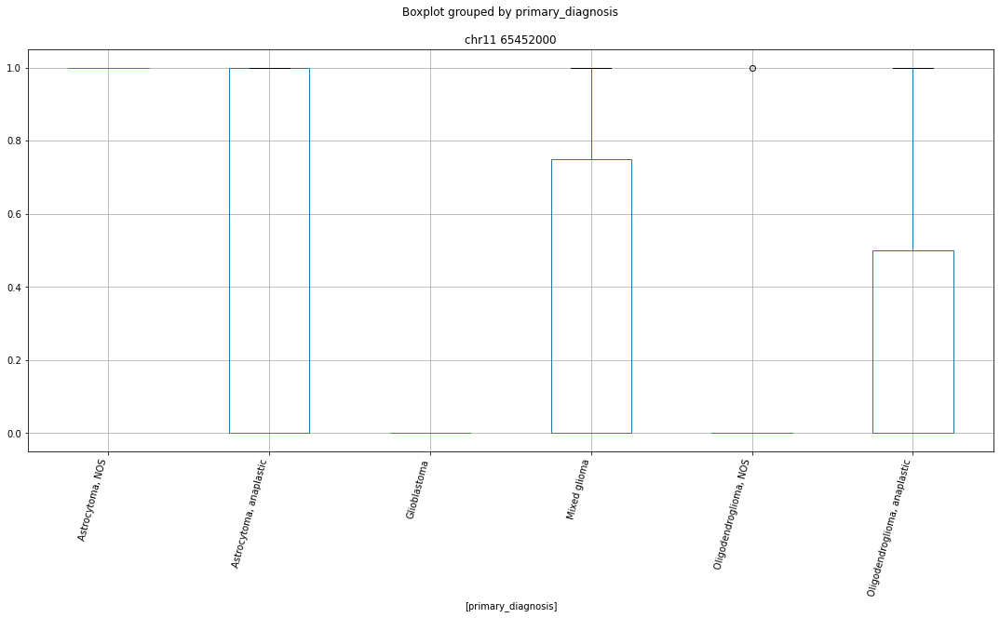

 p : 0.0  ( t : inf ) :  chr11 67867000


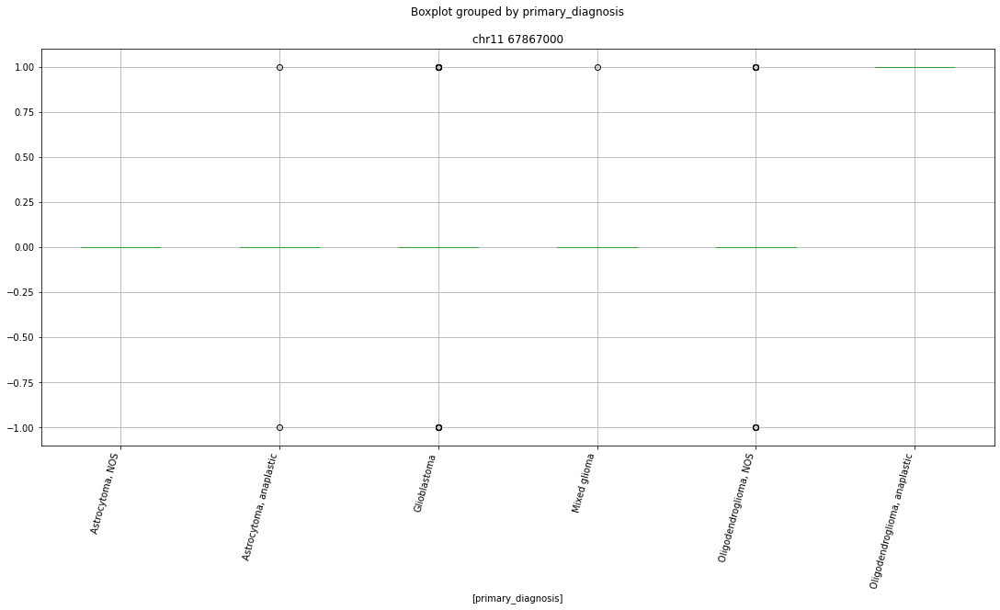

 p : 0.0  ( t : inf ) :  chr11 65522000


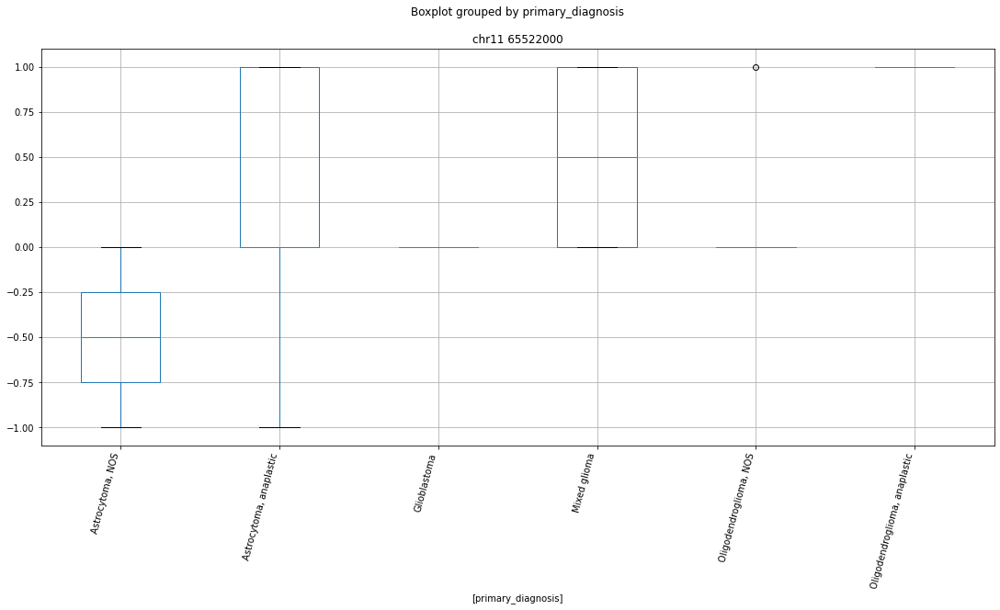

 p : 1.2735213637763784e-13  ( t : 11.358945418727963 ) :  chr11 59700000


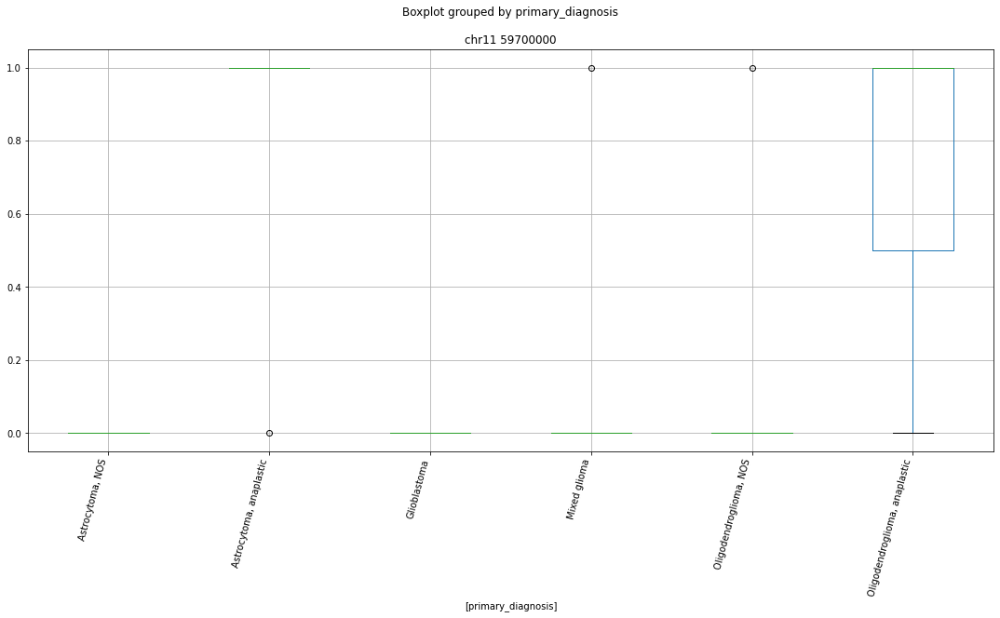

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr11 74353000


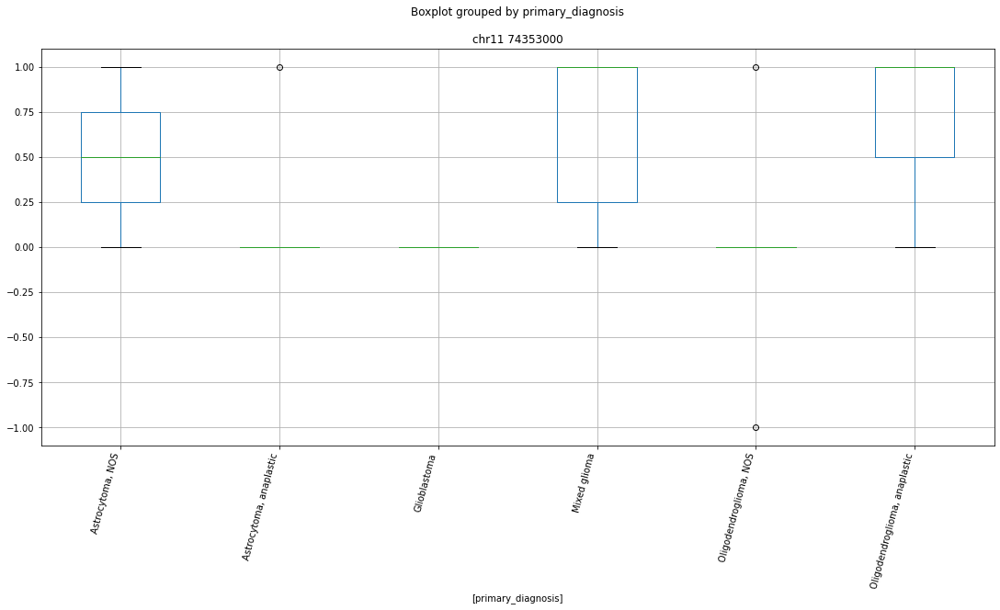

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr11 8523000


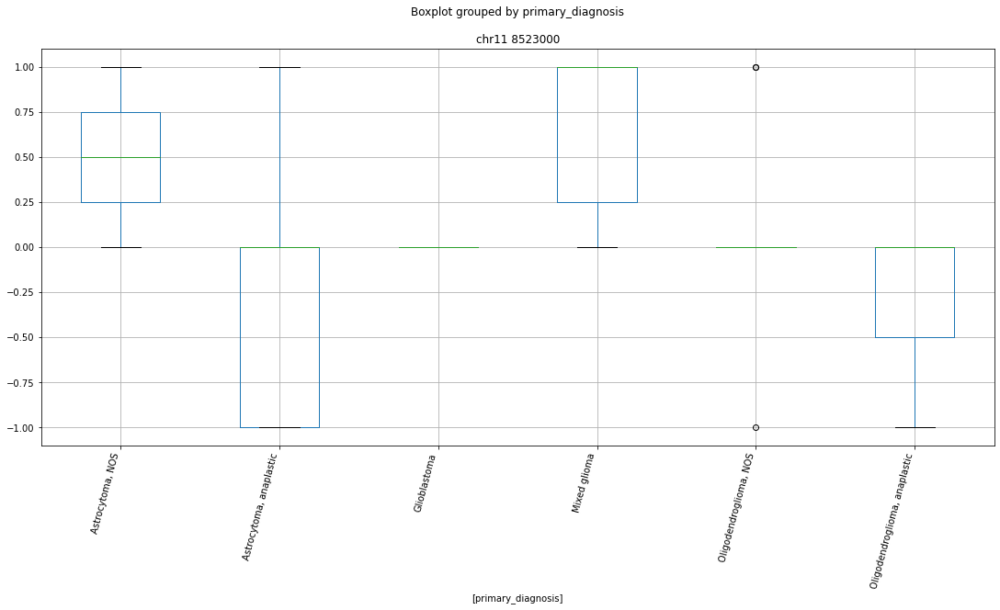

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr11 74353000


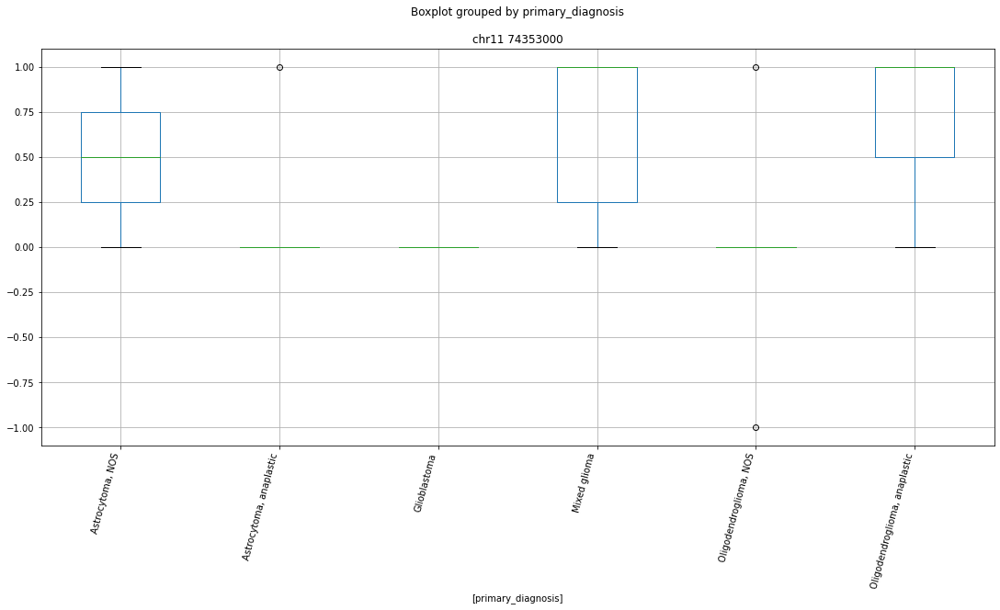

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr11 91064000


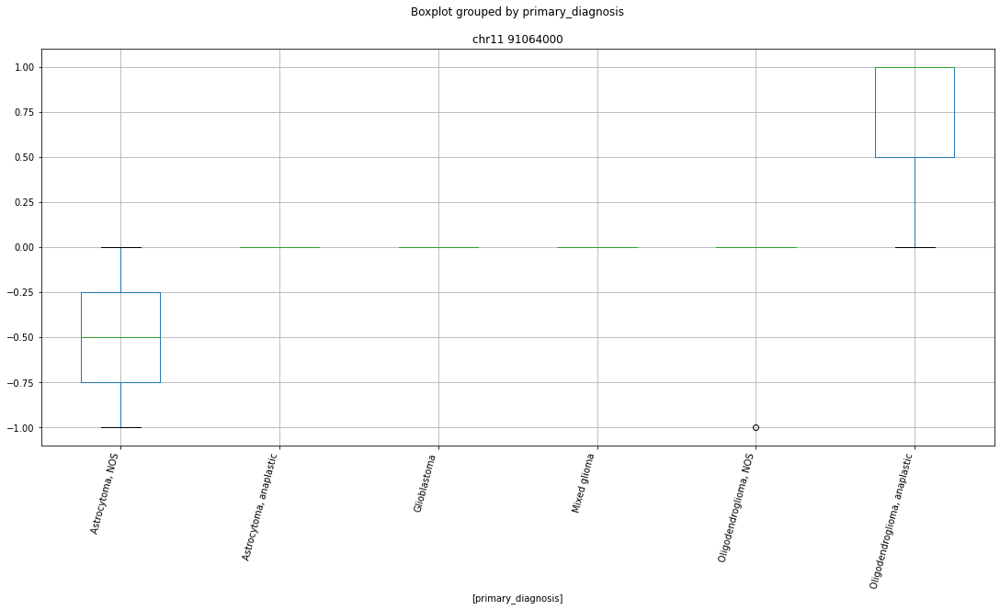

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr11 62326000


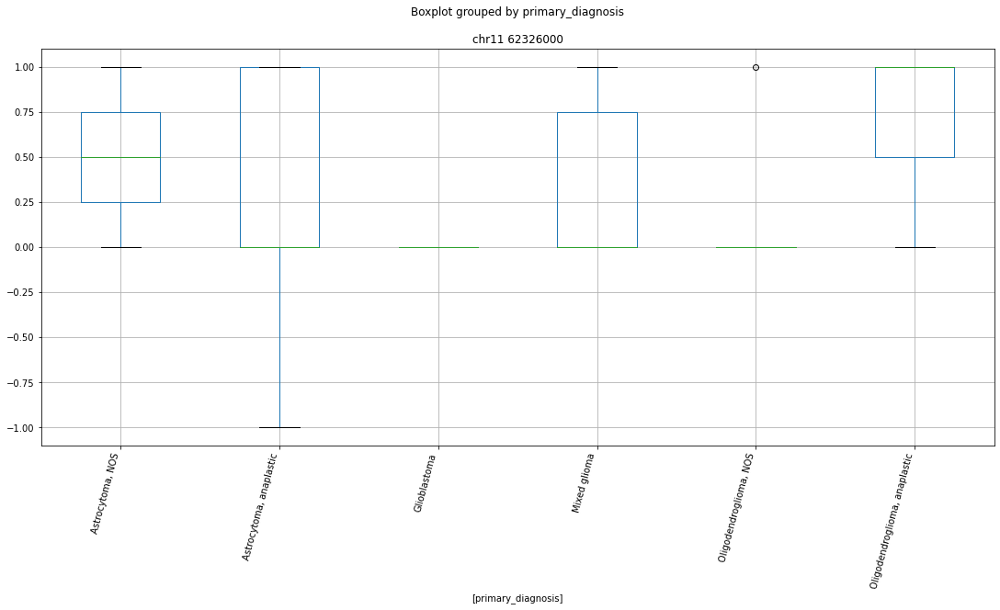

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr11 59700000


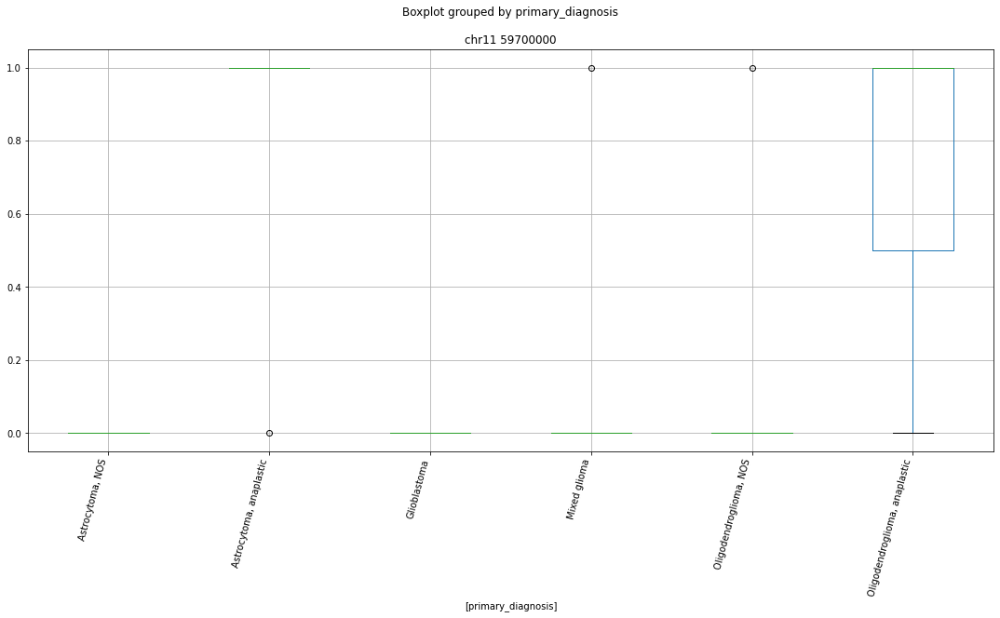

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr11 119059000


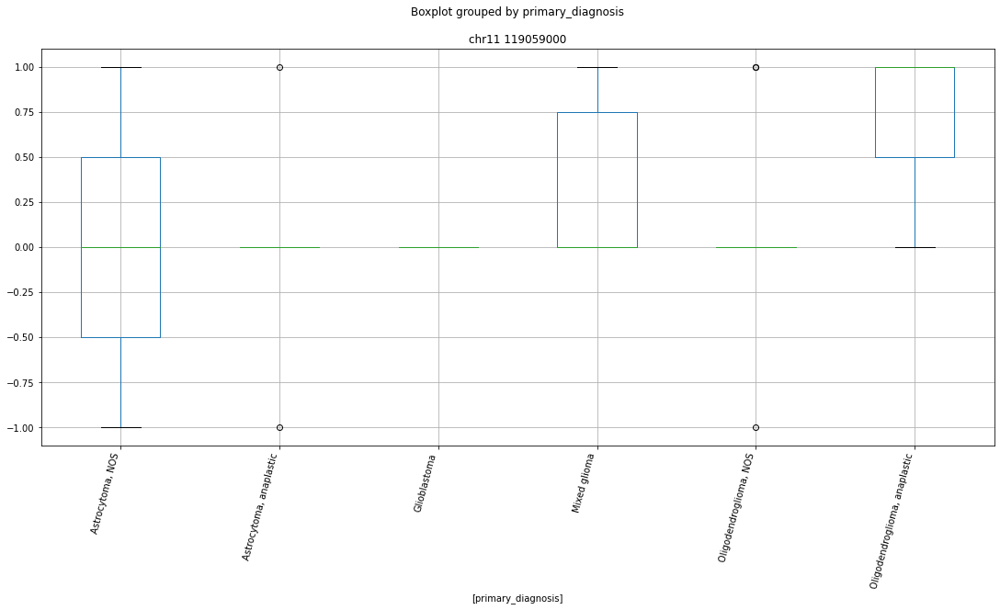

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr11 67477000


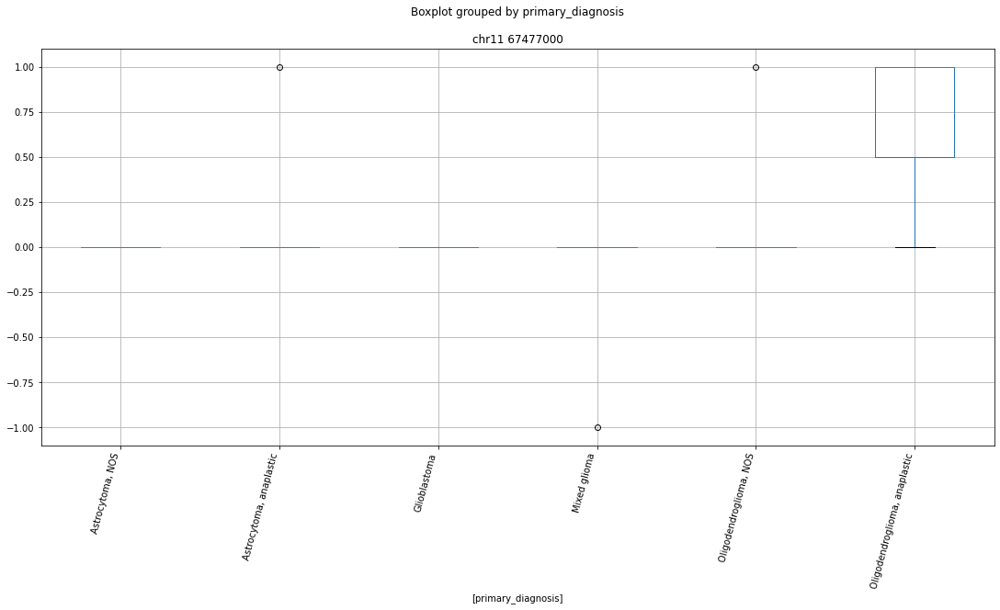

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr11 83133000


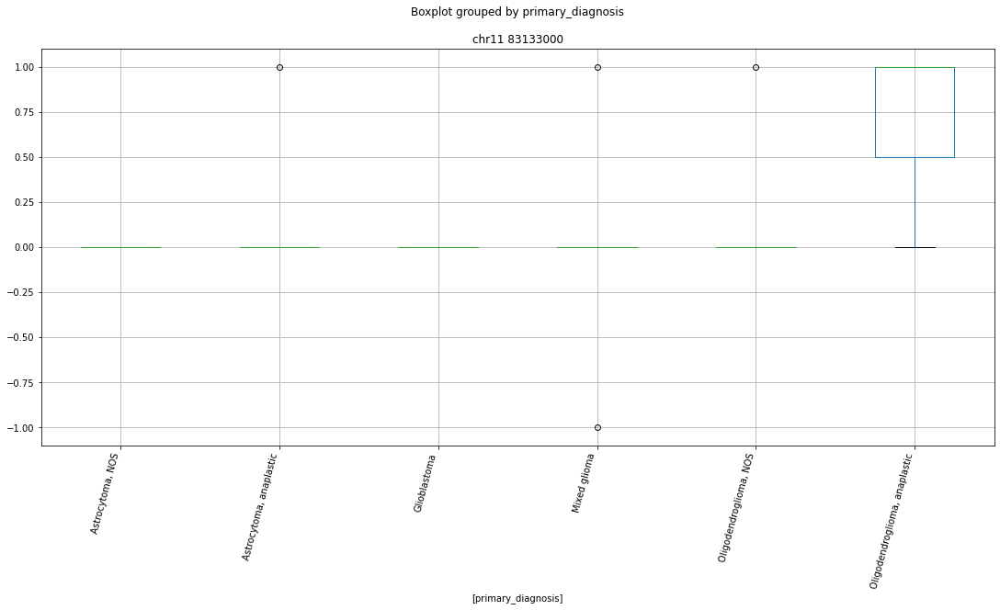

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr11 71167000


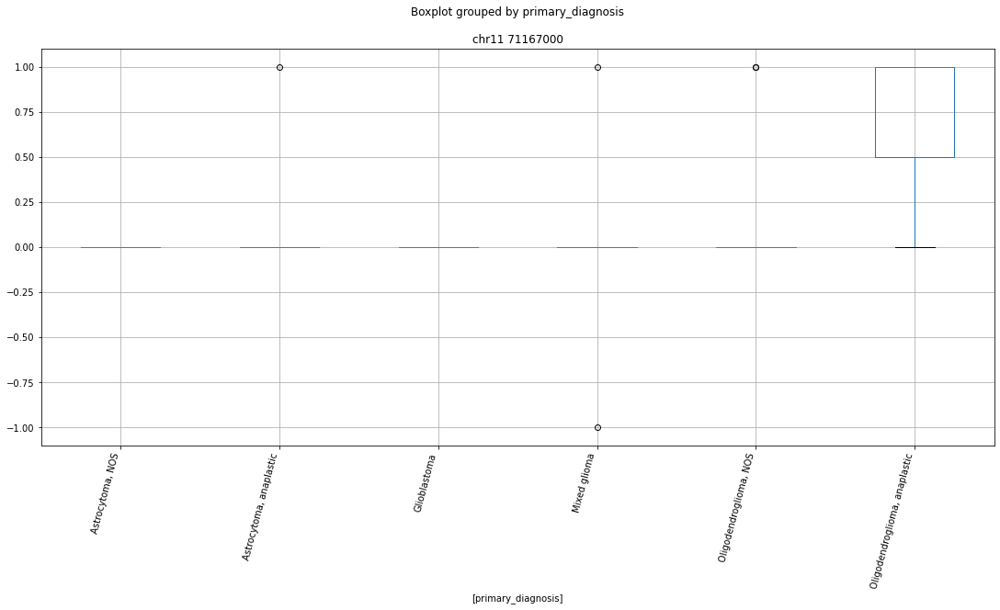

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr11 8979000


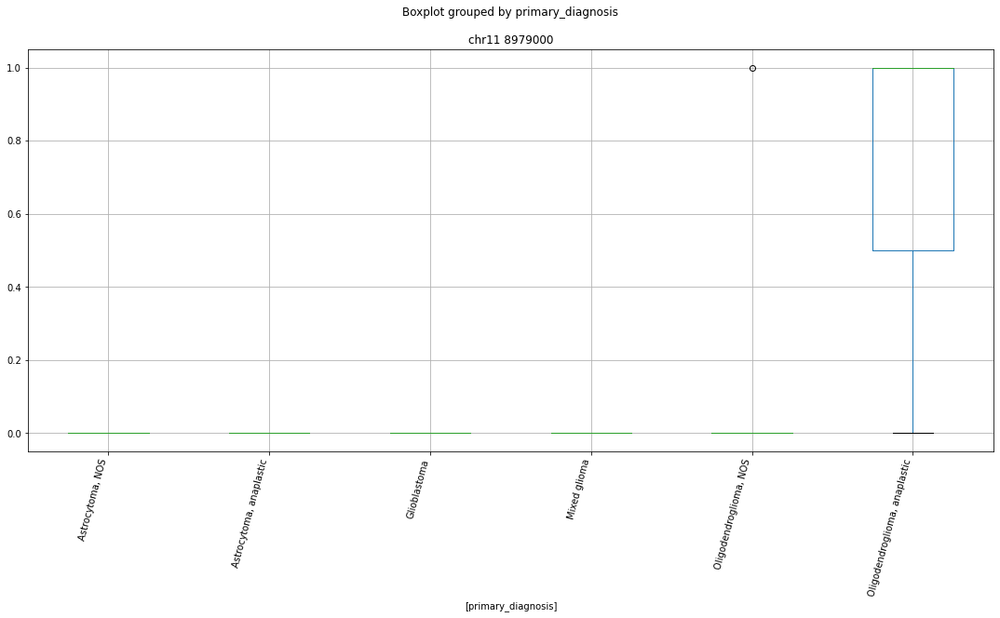

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr11 73896000


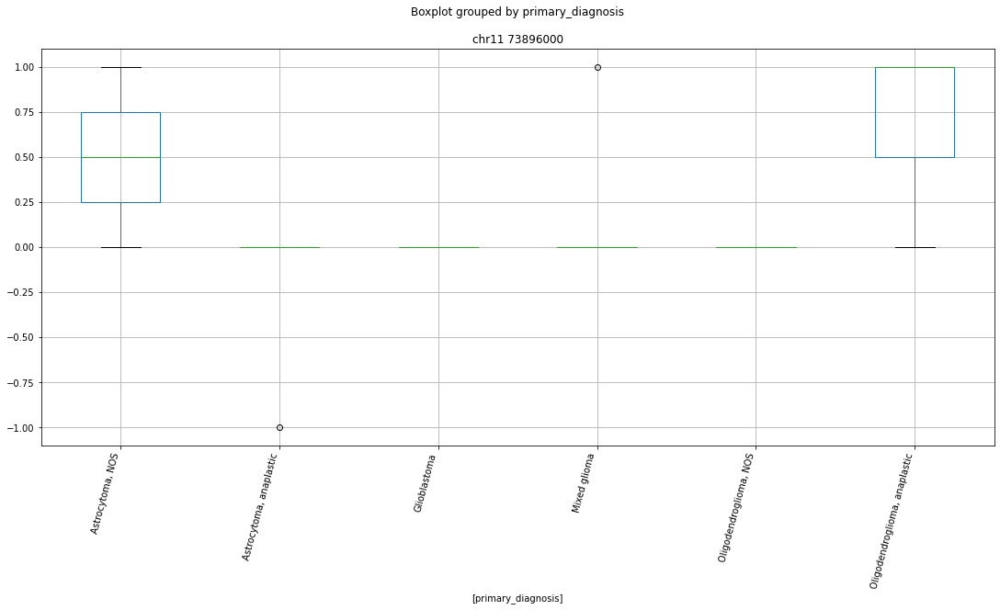

 p : 4.8673695437126455e-08  ( t : 7.805323627055891 ) :  chr11 65522000


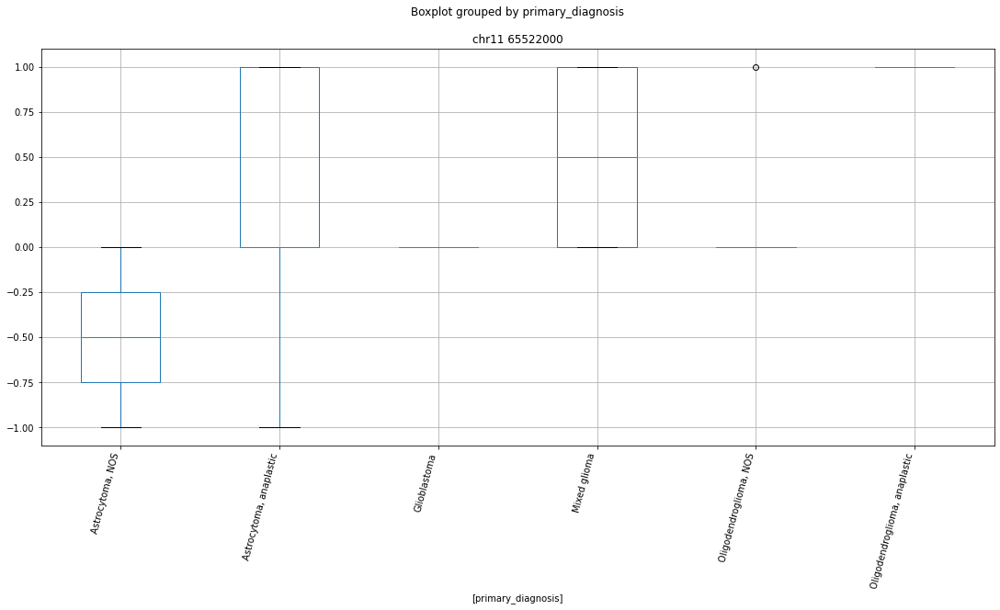

['chr11 101695000' 'chr11 102732000' 'chr11 105264000' 'chr11 107913000'
 'chr11 110319000' 'chr11 117251000' 'chr11 118330000' 'chr11 118730000'
 'chr11 119059000' 'chr11 123280000' 'chr11 130044000' 'chr11 16907000'
 'chr11 17050000' 'chr11 18900000' 'chr11 18901000' 'chr11 19859000'
 'chr11 202000' 'chr11 20549000' 'chr11 23092000' 'chr11 24446000'
 'chr11 24447000' 'chr11 24931000' 'chr11 25541000' 'chr11 33049000'
 'chr11 3397000' 'chr11 36145000' 'chr11 44664000' 'chr11 46897000'
 'chr11 47037000' 'chr11 55431000' 'chr11 56058000' 'chr11 56618000'
 'chr11 59585000' 'chr11 59645000' 'chr11 59682000' 'chr11 59700000'
 'chr11 60200000' 'chr11 60623000' 'chr11 60714000' 'chr11 62216000'
 'chr11 62326000' 'chr11 62327000' 'chr11 62356000' 'chr11 62858000'
 'chr11 63530000' 'chr11 64702000' 'chr11 65452000' 'chr11 65522000'
 'chr11 67477000' 'chr11 67603000' 'chr11 67739000' 'chr11 67757000'
 'chr11 67758000' 'chr11 67867000' 'chr11 67868000' 'chr11 68475000'
 'chr11 68861000' 'chr11 7

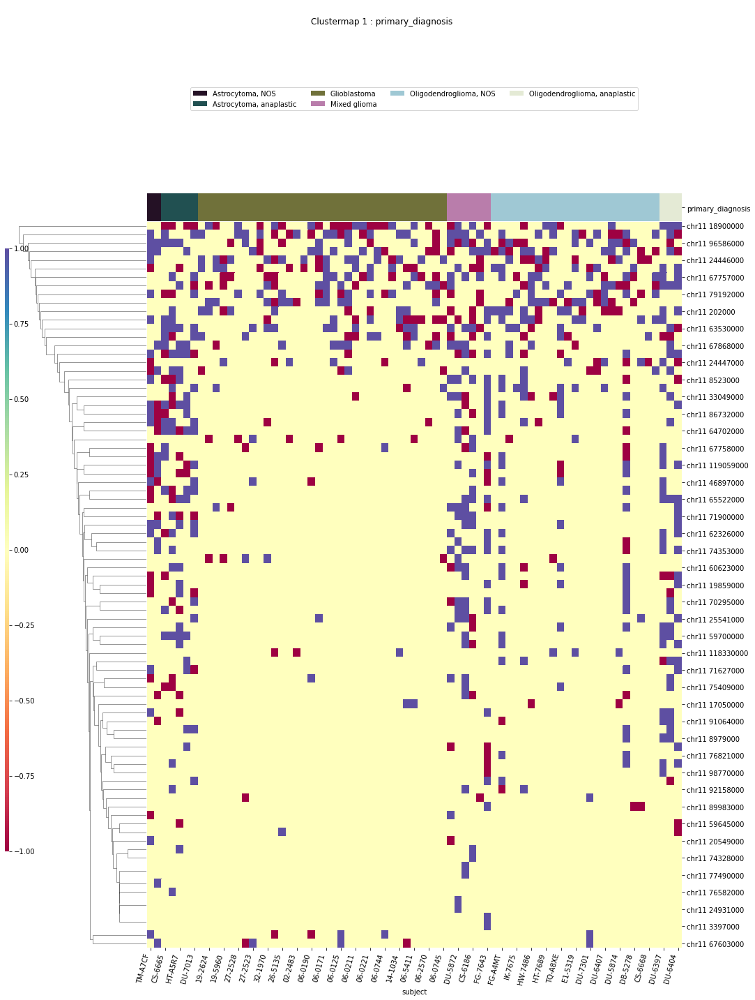

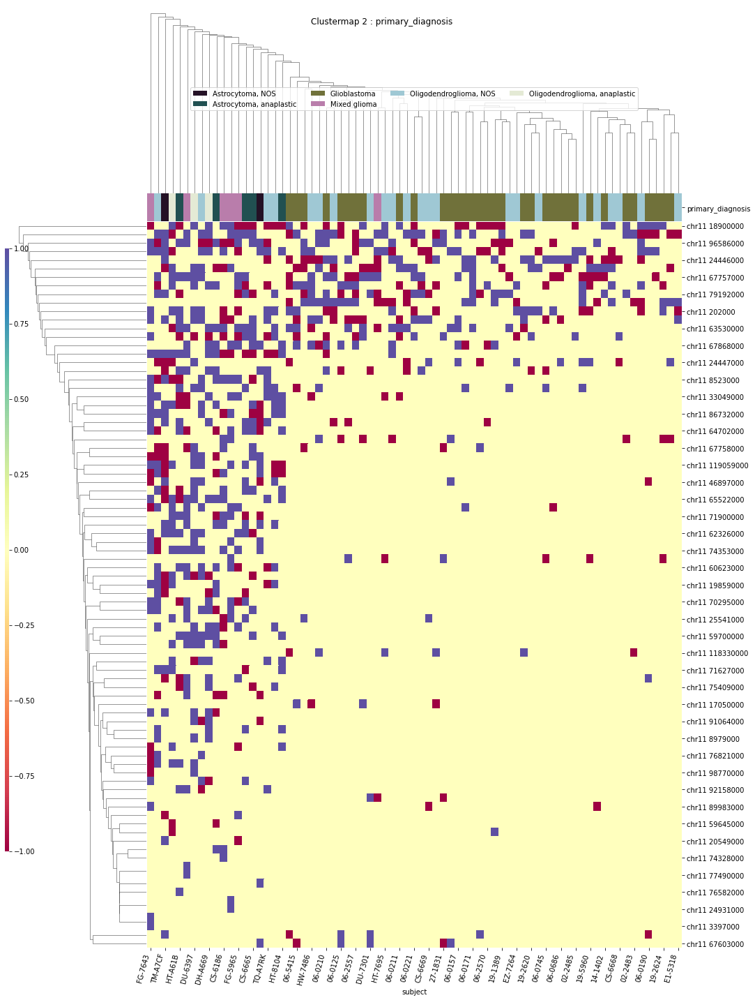

IDH
['IDH' 'chr11 105264000' 'chr11 118721000' 'chr11 17050000'
 'chr11 33050000' 'chr11 44664000' 'chr11 56058000' 'chr11 56618000'
 'chr11 59700000' 'chr11 71167000' 'chr11 71600000' 'chr11 76821000'
 'chr11 8979000' 'subject']


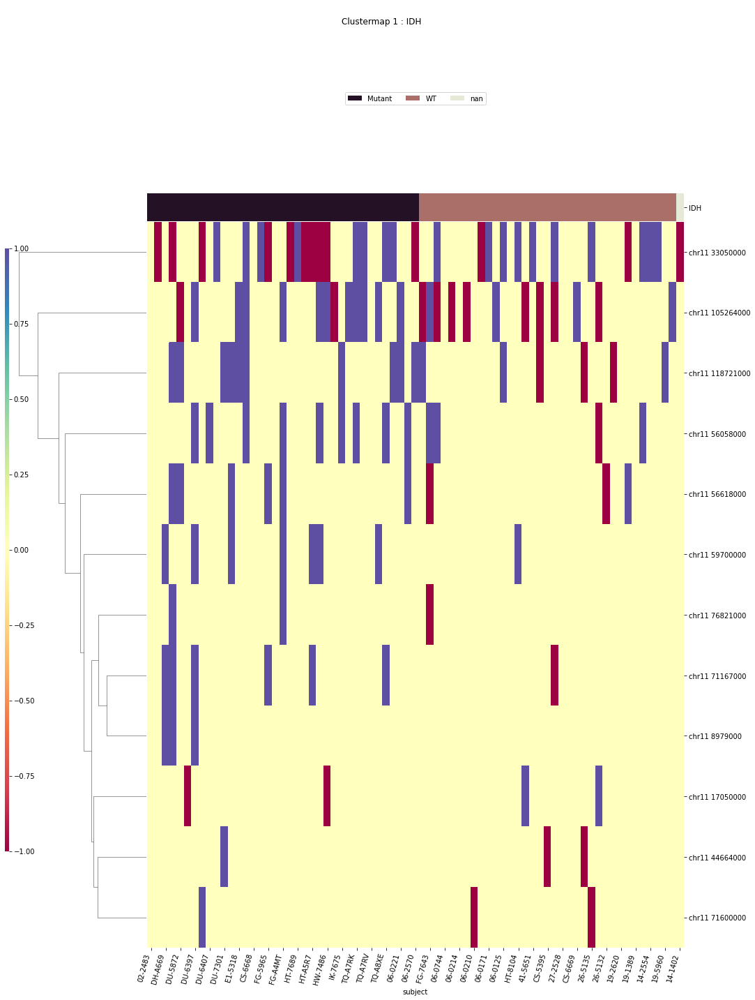

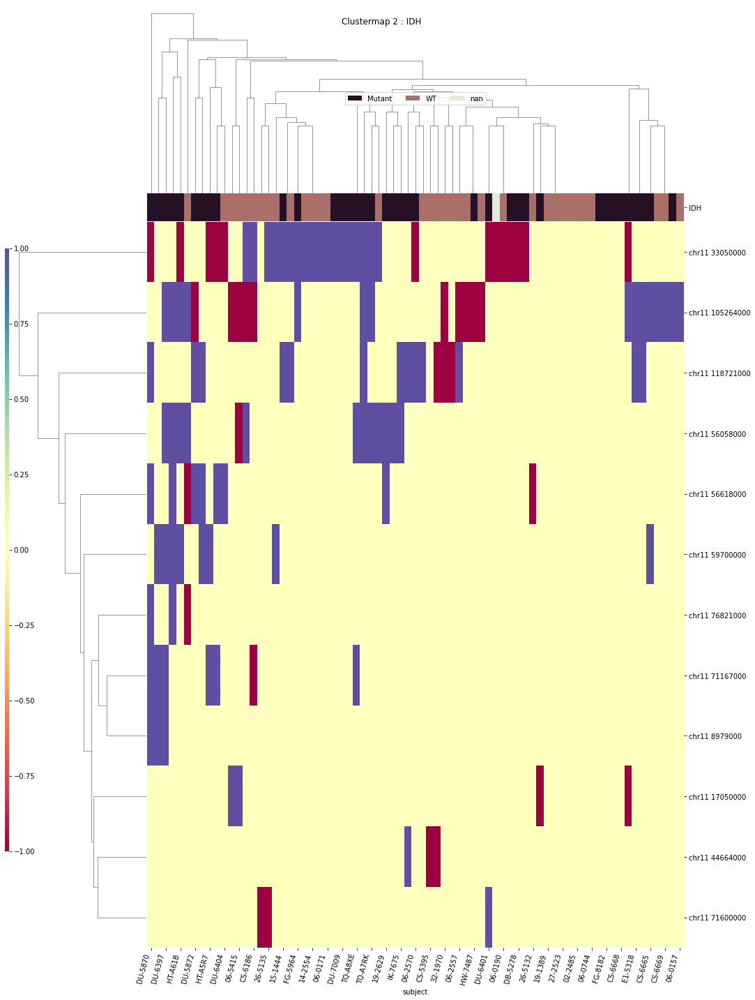

x1p19q
['chr11 118330000' 'chr11 17050000' 'chr11 2961000' 'chr11 41305000'
 'chr11 60451000' 'chr11 65239000' 'chr11 68475000' 'chr11 71167000'
 'chr11 86880000' 'chr11 8979000' 'chr11 91064000' 'chr11 9319000'
 'chr11 98770000' 'subject' 'x1p19q']


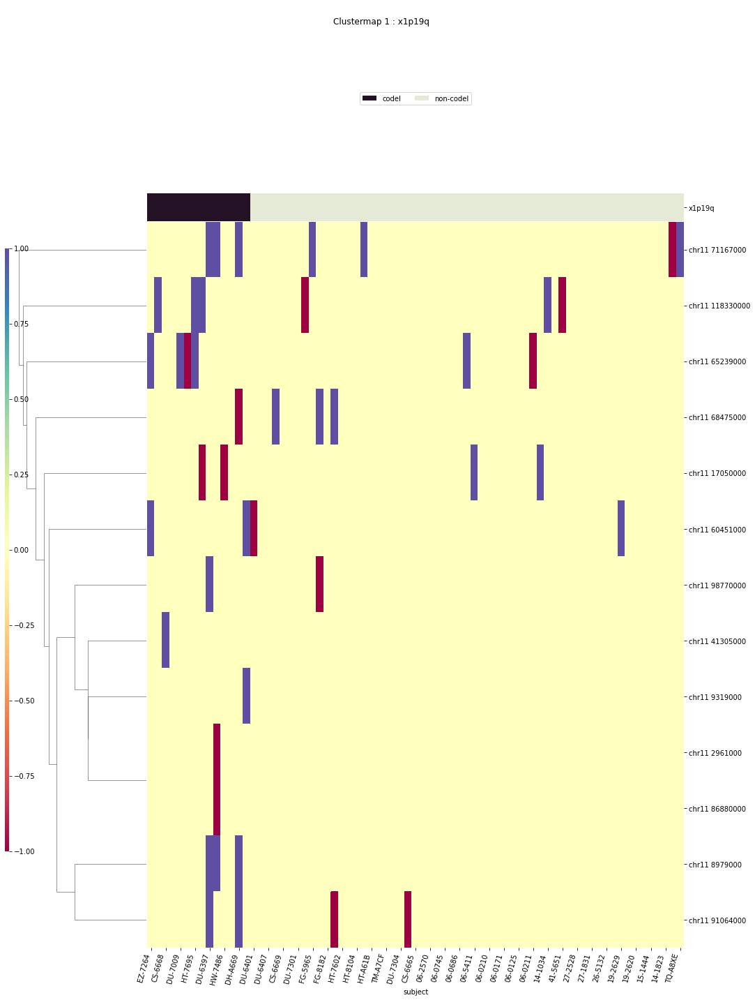

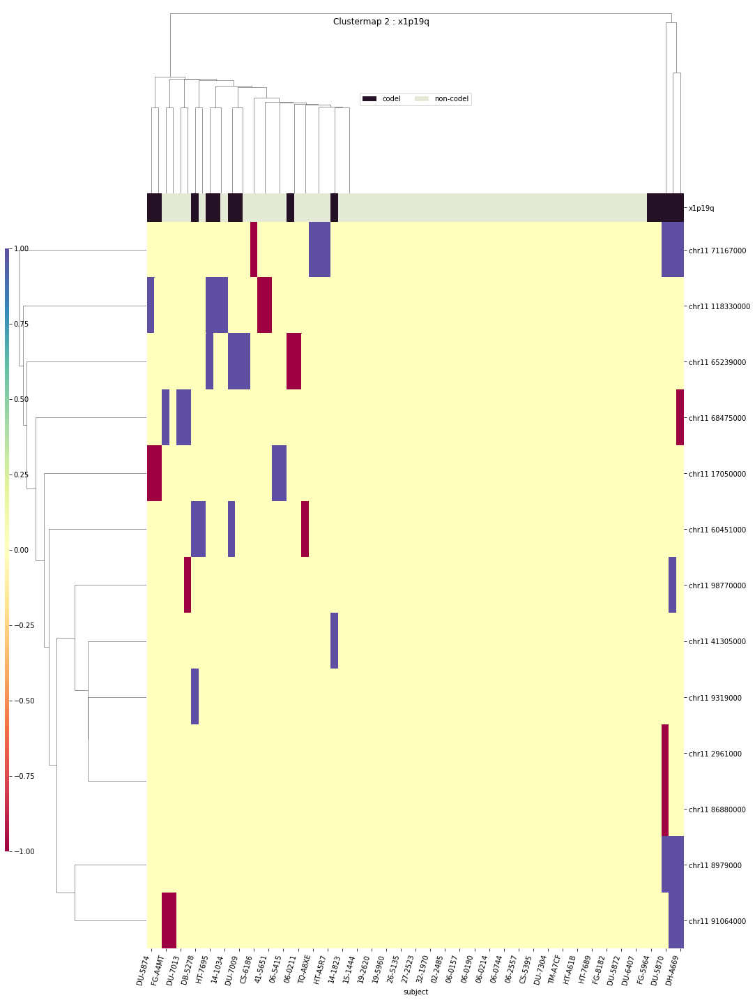

TERT
['TERT' 'chr11 105264000' 'chr11 107913000' 'chr11 118721000'
 'chr11 25541000' 'chr11 33050000' 'chr11 56058000' 'chr11 56618000'
 'chr11 59645000' 'chr11 59700000' 'chr11 65452000' 'chr11 74353000'
 'chr11 83133000' 'chr11 89983000' 'chr11 91064000' 'subject']


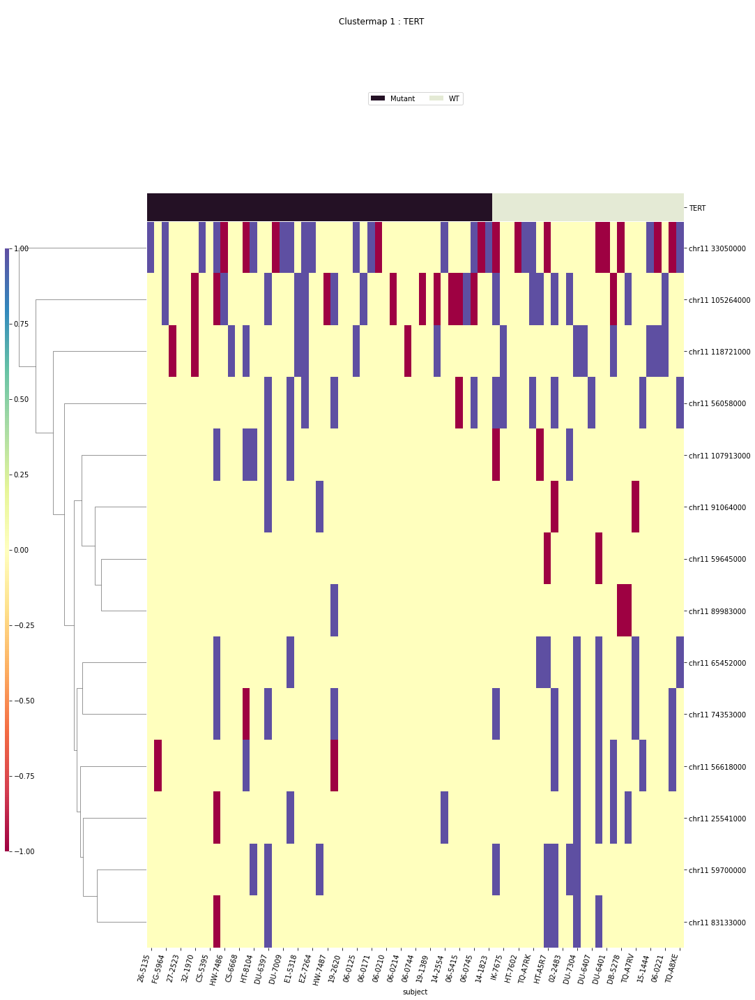

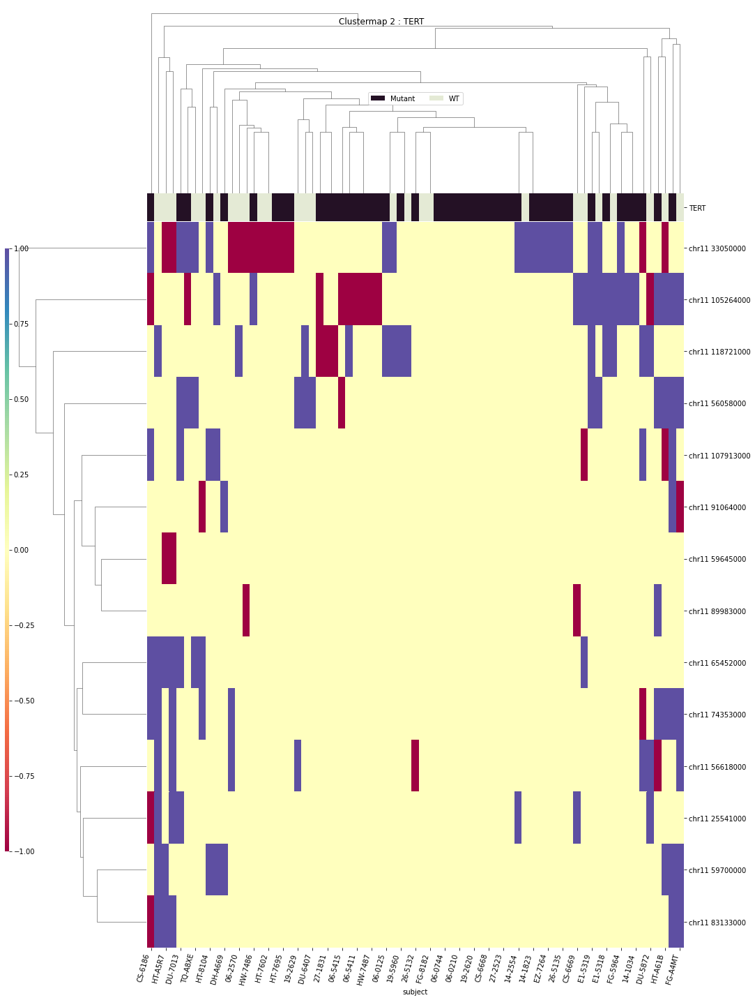

disease_type
['chr11 10392000' 'chr11 105264000' 'chr11 16907000' 'chr11 17050000'
 'chr11 23092000' 'chr11 24446000' 'chr11 56058000' 'chr11 59700000'
 'chr11 60714000' 'chr11 62326000' 'chr11 65452000' 'chr11 65522000'
 'chr11 67757000' 'chr11 71167000' 'chr11 71600000' 'chr11 74353000'
 'chr11 76712000' 'chr11 78880000' 'disease_type' 'subject']


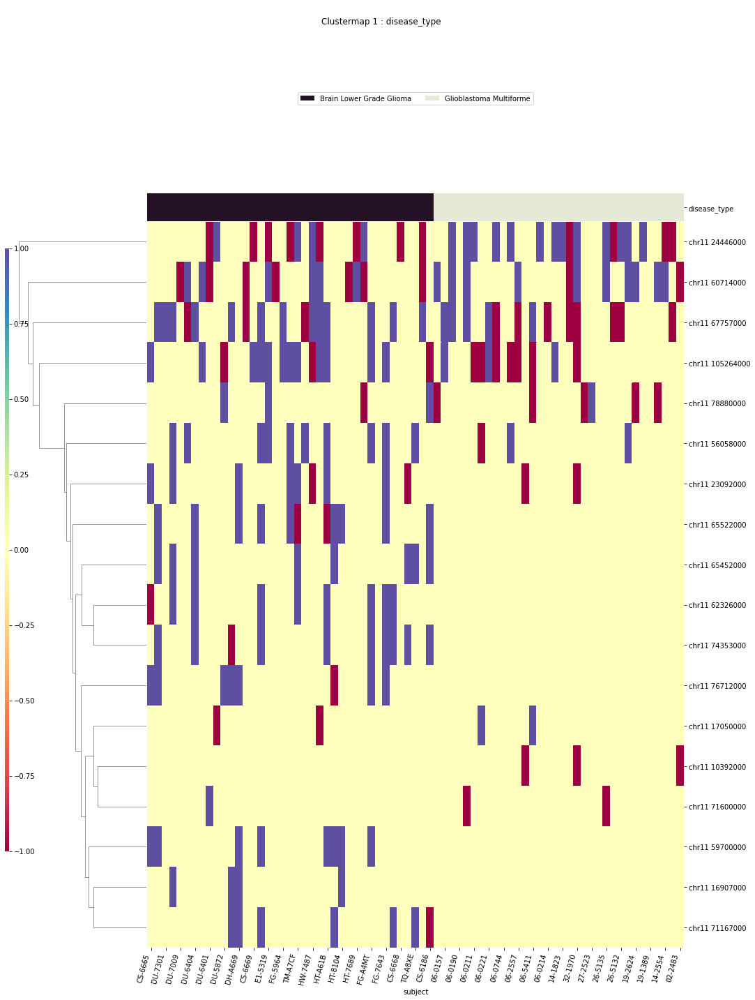

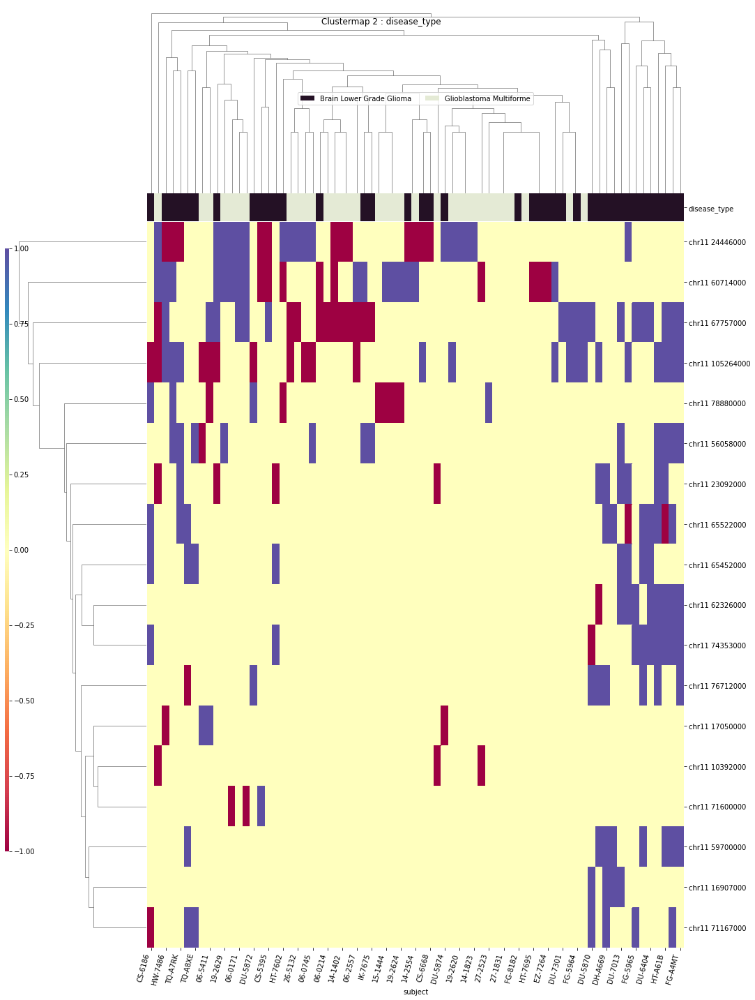

chr12
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr12 53122000


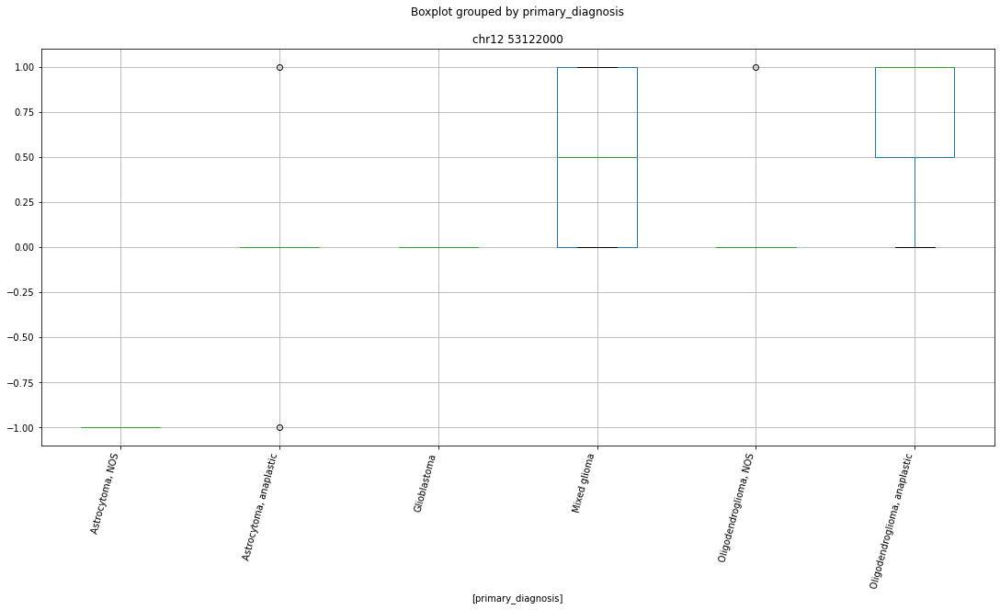

 p : 0.0  ( t : inf ) :  chr12 37739000


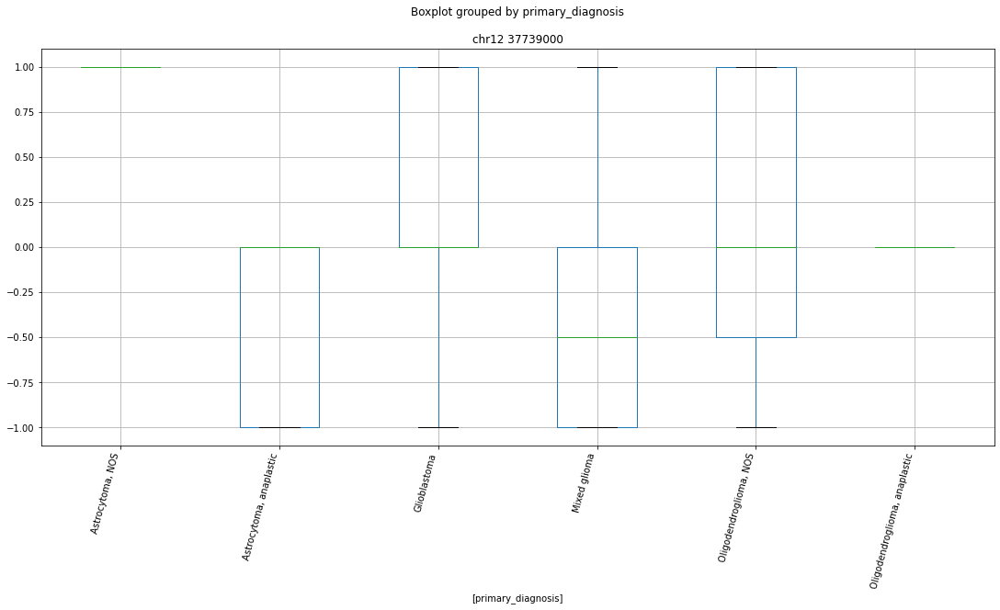

 p : 0.0  ( t : inf ) :  chr12 8184000


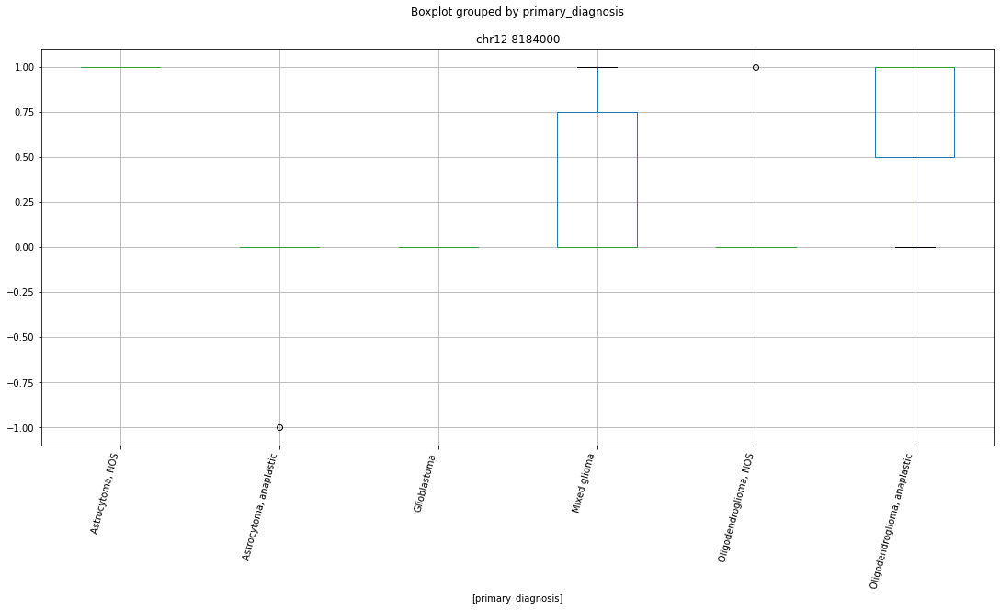

 p : 0.0  ( t : inf ) :  chr12 126958000


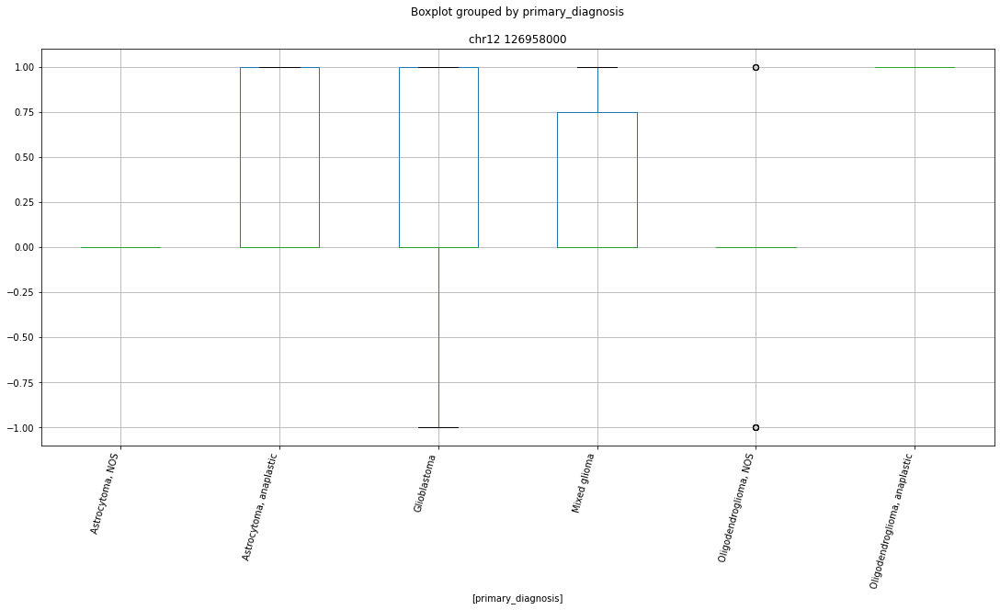

 p : 0.0  ( t : inf ) :  chr12 19340000


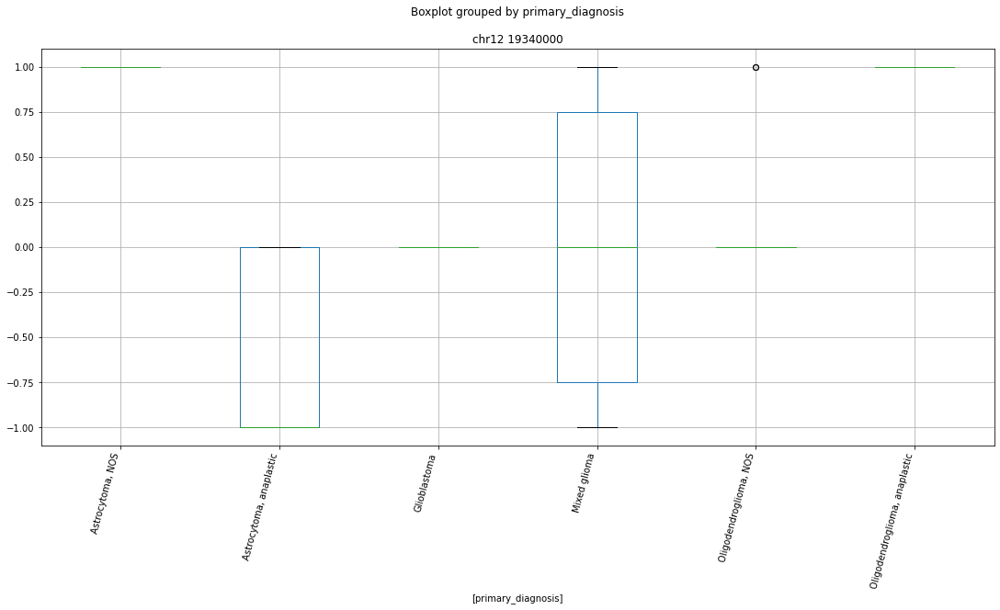

 p : 2.948014870353662e-15  ( t : 12.708265027138834 ) :  chr12 68484000


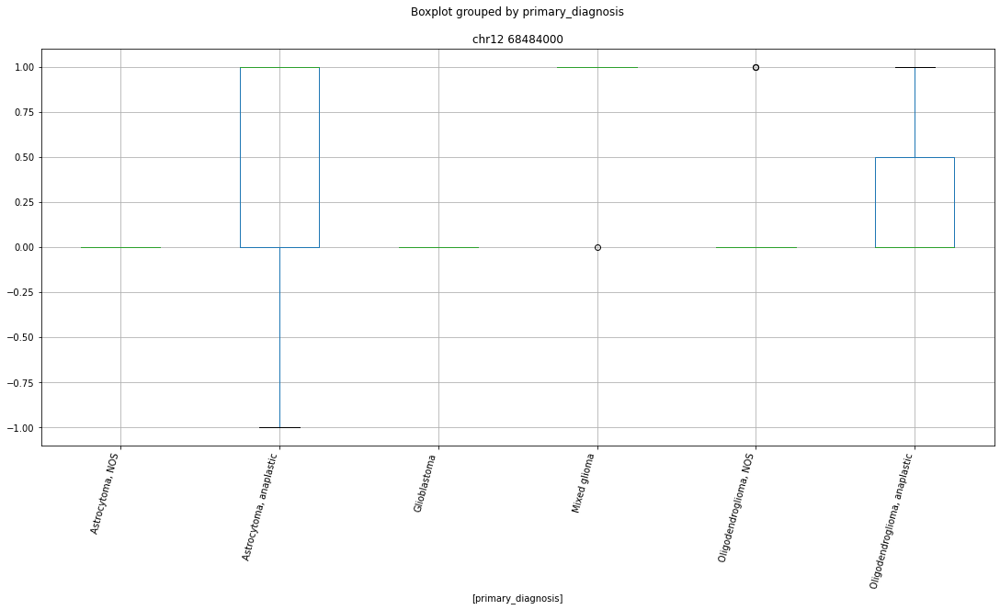

 p : 1.2735213637763693e-13  ( t : 11.358945418727965 ) :  chr12 89867000


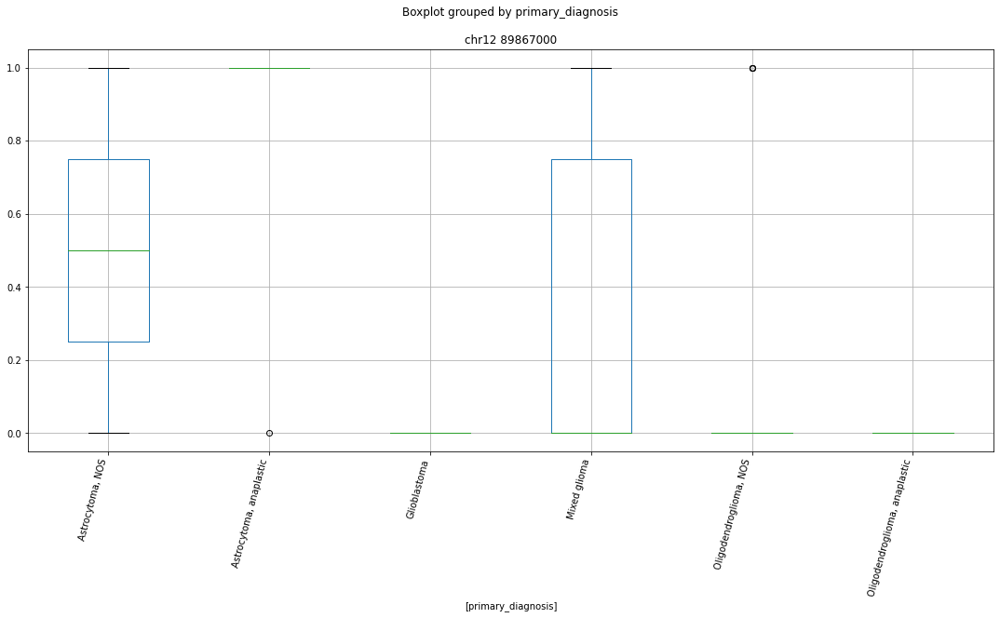

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr12 8184000


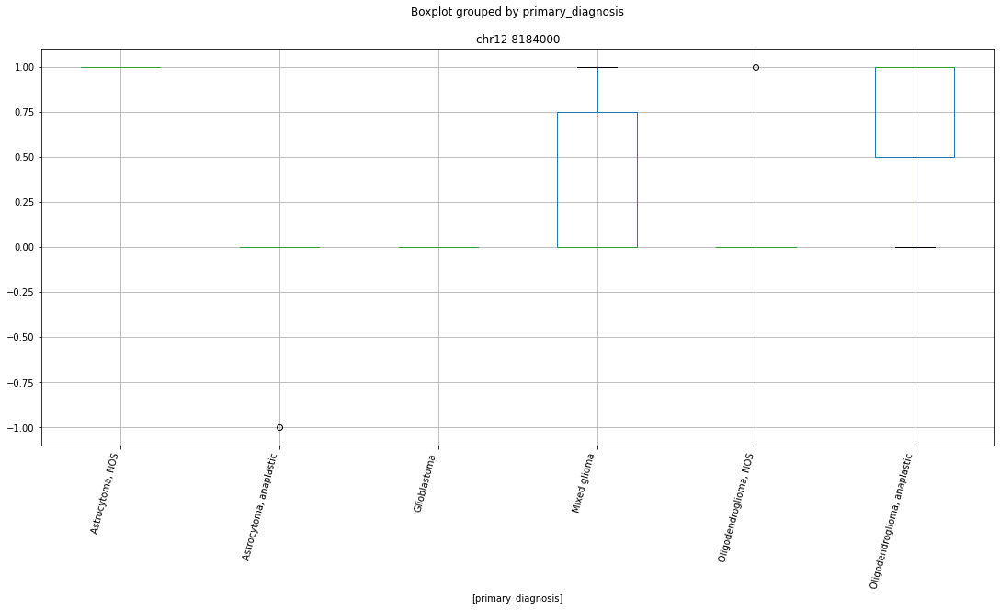

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr12 56788000


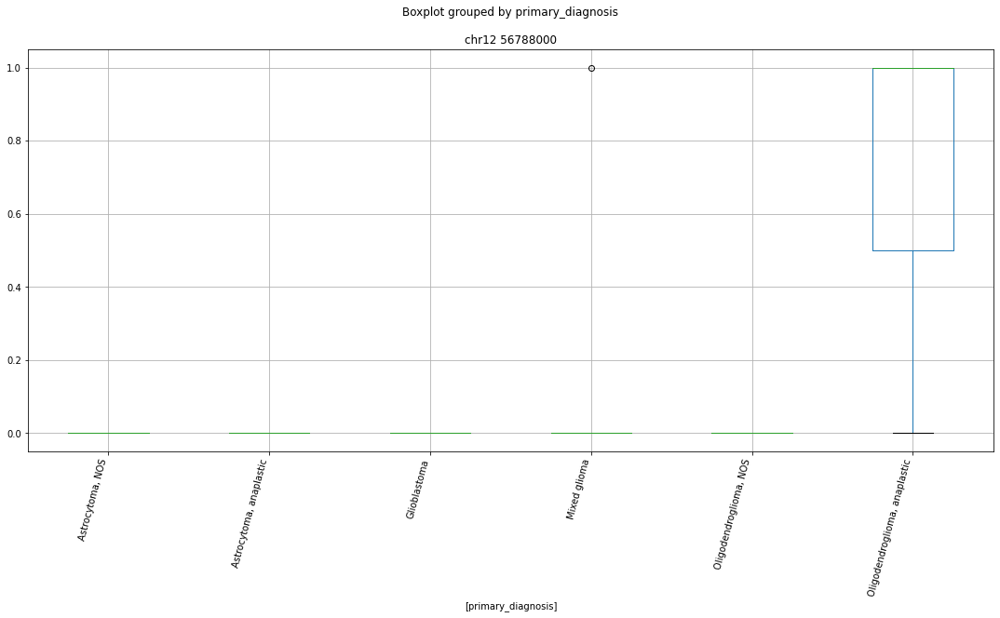

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr12 8635000


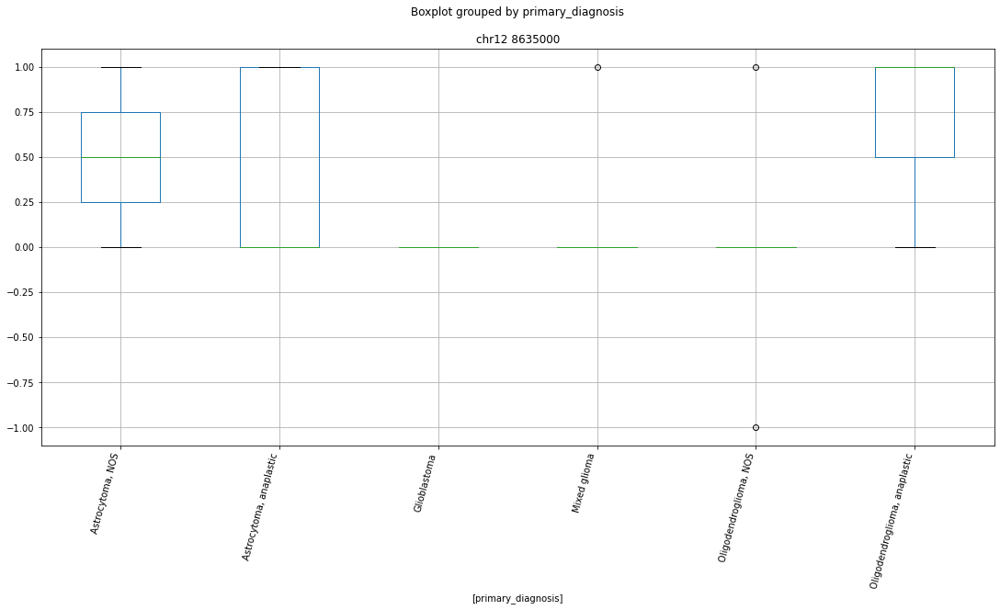

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr12 53122000


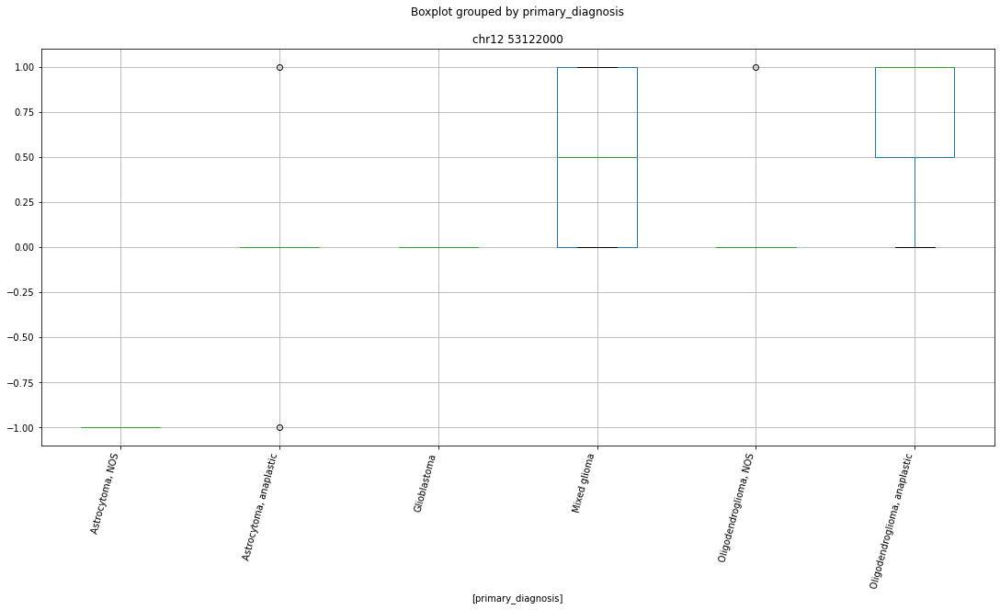

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr12 7589000


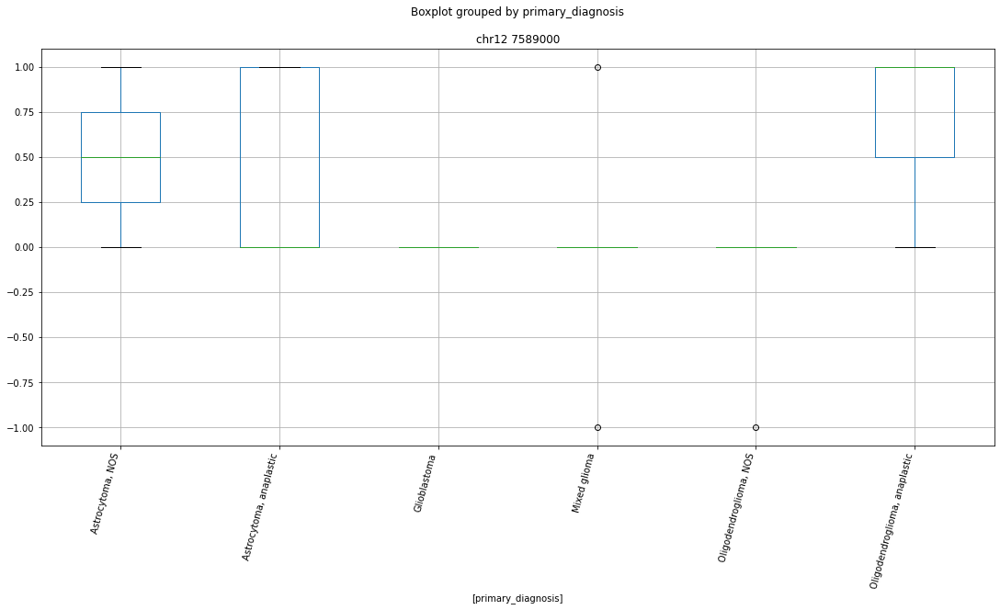

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr12 80307000


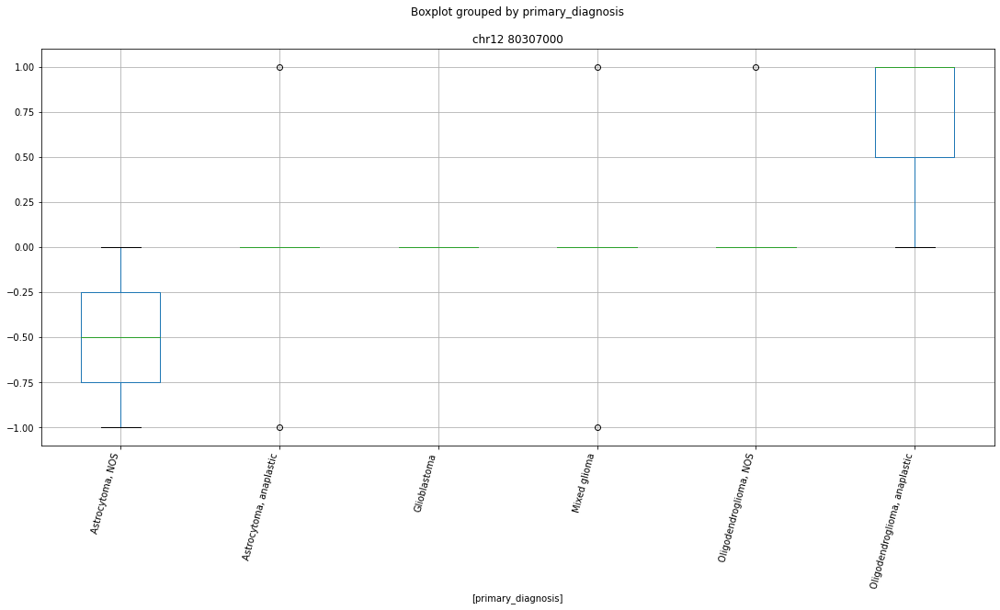

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr12 49436000


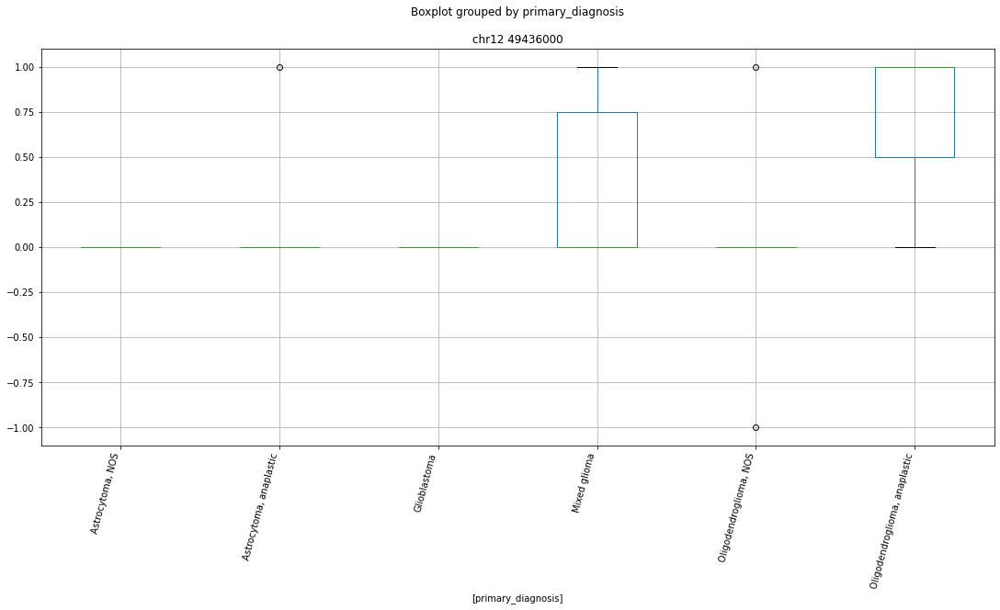

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr12 49283000


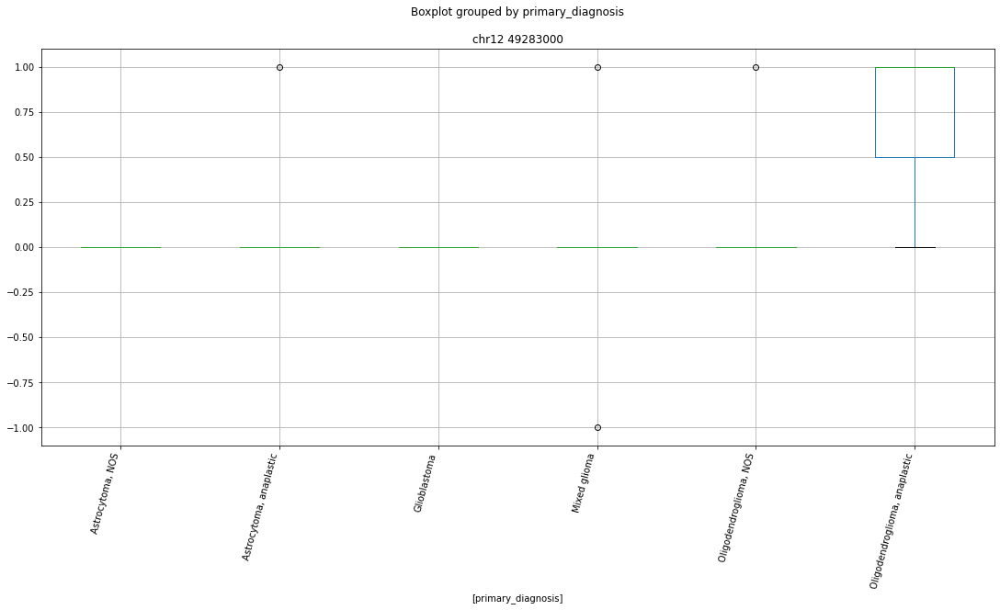

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr12 48725000


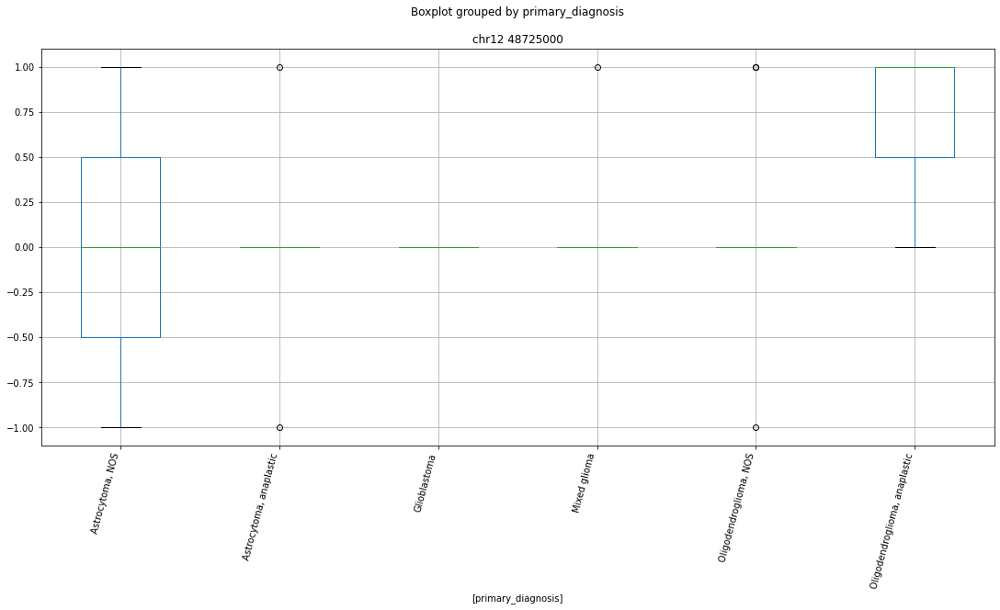

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr12 49861000


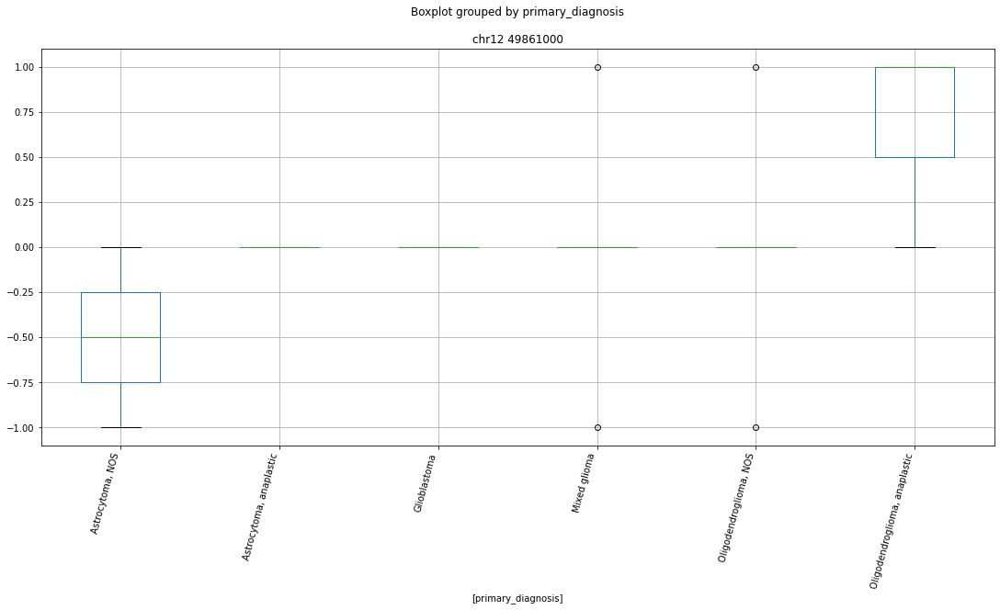

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr12 19340000


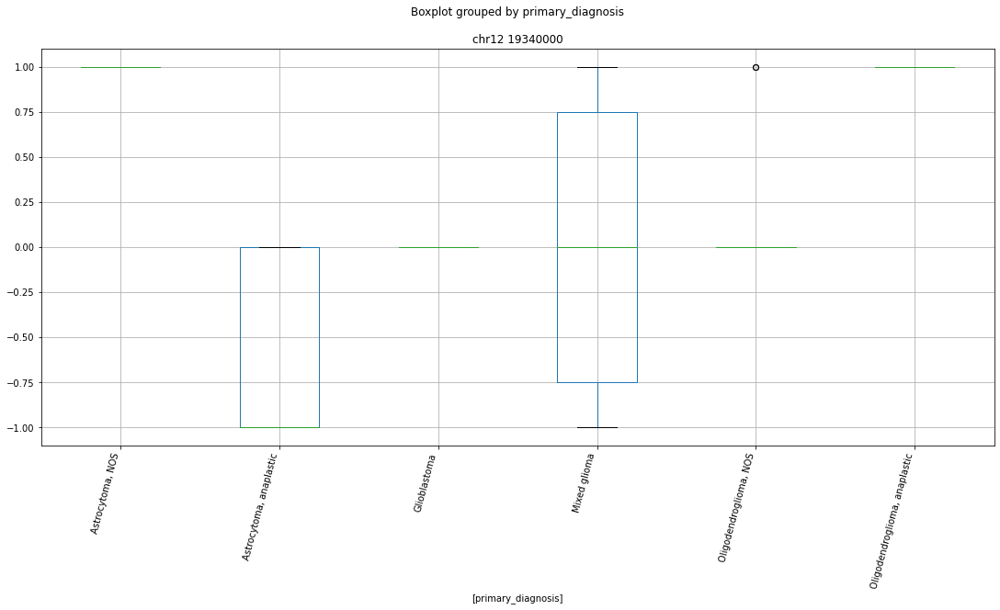

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr12 131926000


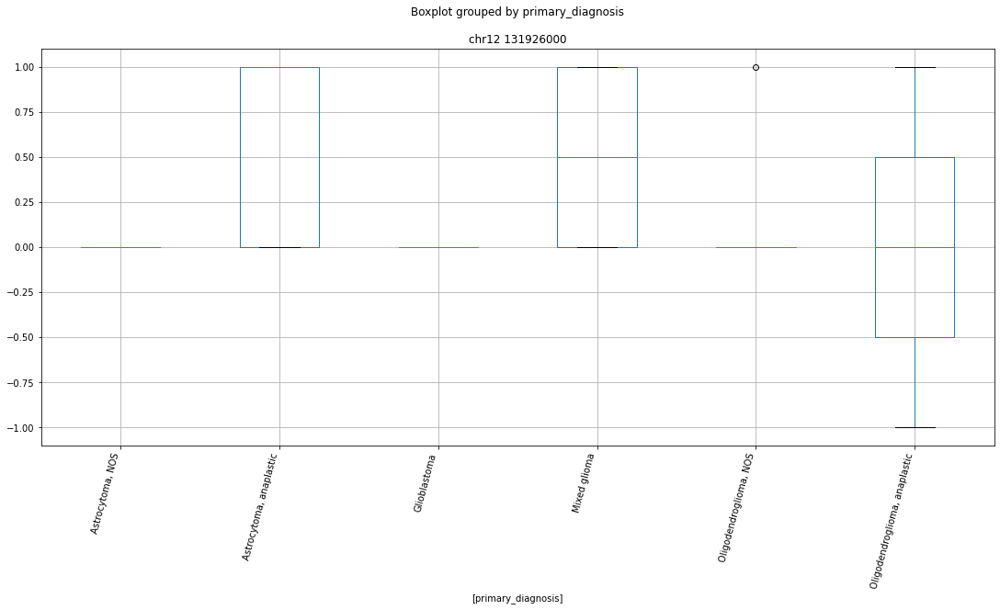

['chr12 103644000' 'chr12 10395000' 'chr12 10572000' 'chr12 105873000'
 'chr12 107826000' 'chr12 108656000' 'chr12 110173000' 'chr12 110570000'
 'chr12 114484000' 'chr12 117731000' 'chr12 118105000' 'chr12 118106000'
 'chr12 1201000' 'chr12 121634000' 'chr12 122358000' 'chr12 122708000'
 'chr12 122751000' 'chr12 123372000' 'chr12 123492000' 'chr12 123493000'
 'chr12 123581000' 'chr12 12413000' 'chr12 125053000' 'chr12 12566000'
 'chr12 126958000' 'chr12 130996000' 'chr12 131926000' 'chr12 14355000'
 'chr12 1818000' 'chr12 19340000' 'chr12 24673000' 'chr12 31180000'
 'chr12 32562000' 'chr12 34180000' 'chr12 34619000' 'chr12 37738000'
 'chr12 37739000' 'chr12 4721000' 'chr12 48500000' 'chr12 48725000'
 'chr12 48842000' 'chr12 48915000' 'chr12 49283000' 'chr12 49436000'
 'chr12 49861000' 'chr12 51455000' 'chr12 52410000' 'chr12 53122000'
 'chr12 54487000' 'chr12 55334000' 'chr12 55478000' 'chr12 56788000'
 'chr12 56823000' 'chr12 57190000' 'chr12 58327000' 'chr12 58544000'
 'chr12 6609400

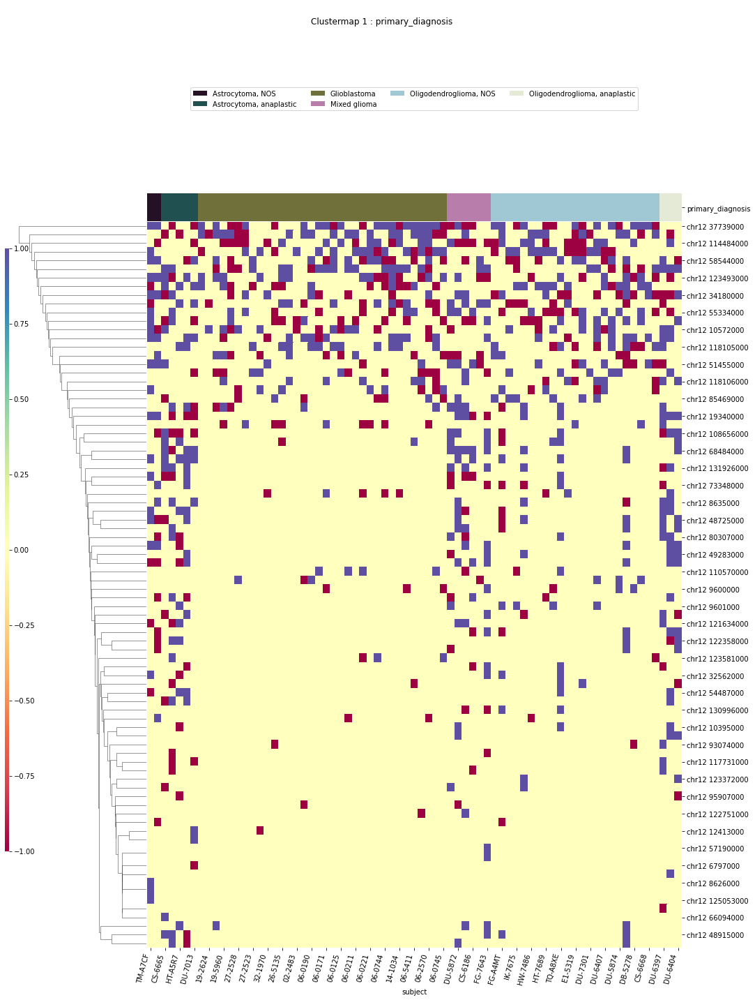

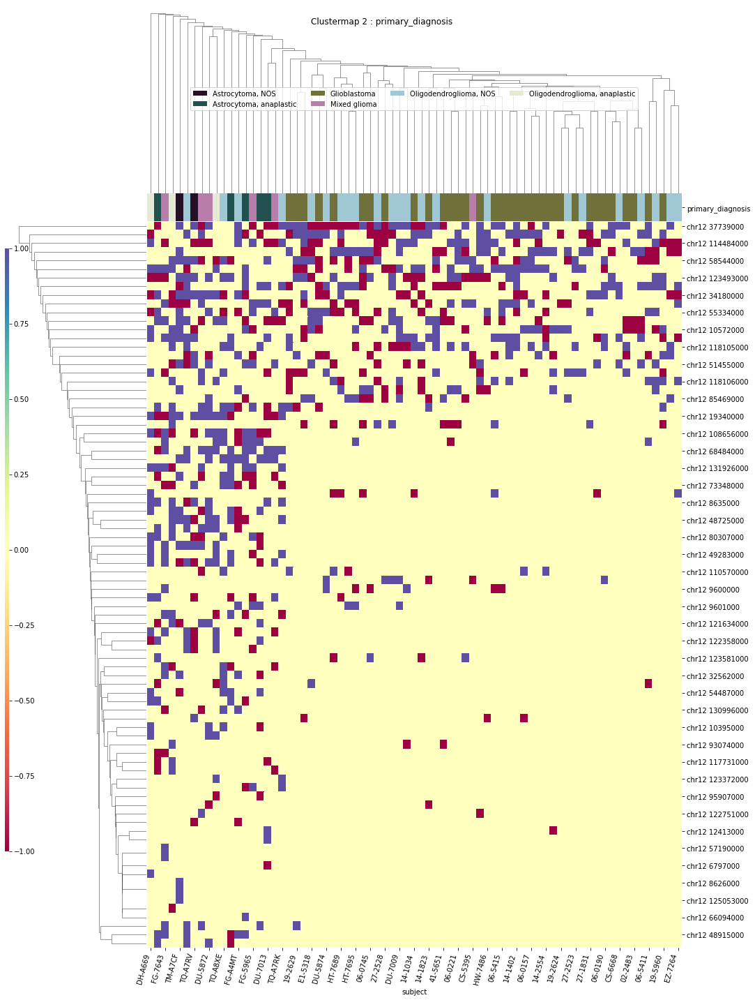

IDH
['IDH' 'chr12 107826000' 'chr12 110570000' 'chr12 19340000'
 'chr12 37738000' 'chr12 56783000' 'chr12 58336000' 'chr12 85469000'
 'chr12 9601000' 'chr12 96158000' 'subject']


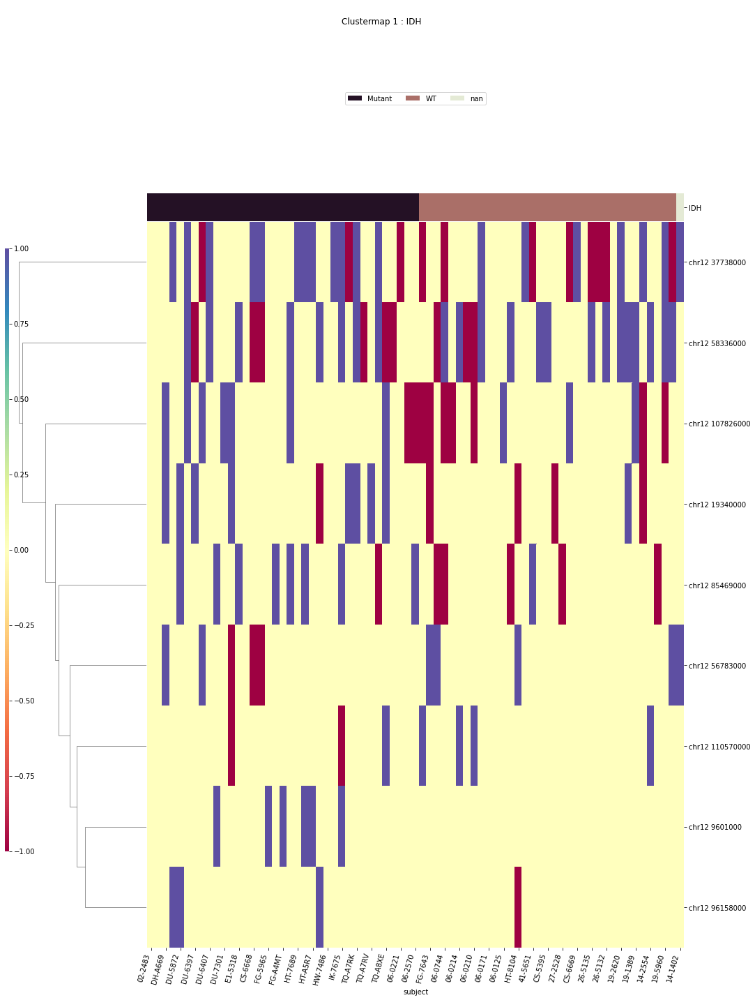

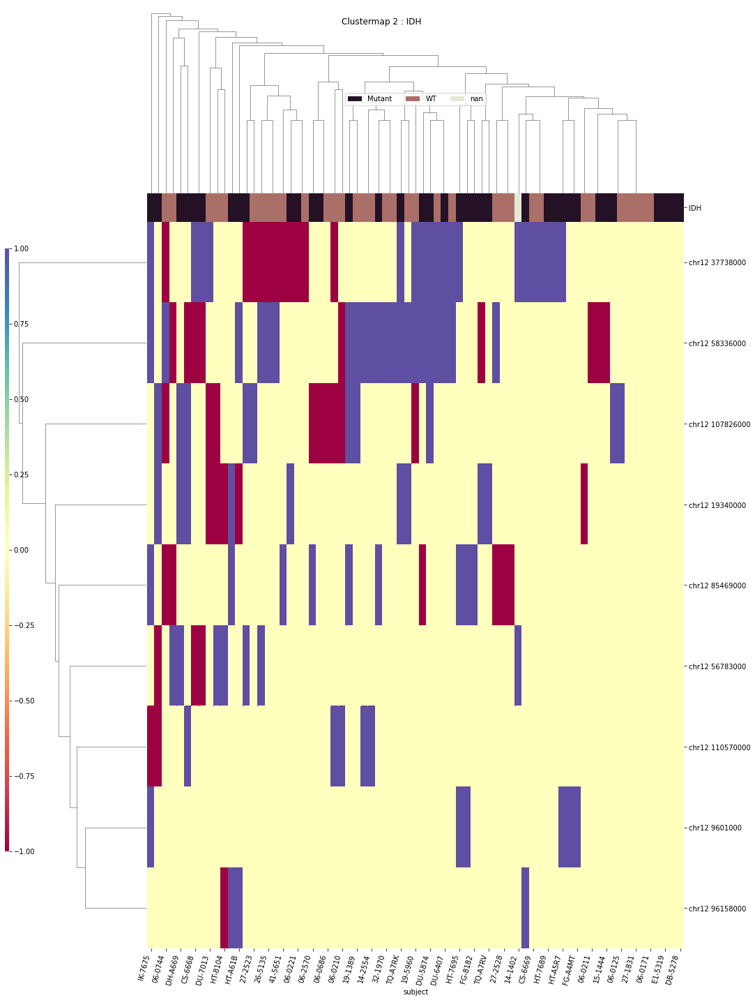

x1p19q
['chr12 104323000' 'chr12 105873000' 'chr12 117731000' 'chr12 118105000'
 'chr12 122708000' 'chr12 123493000' 'chr12 124101000' 'chr12 14355000'
 'chr12 24673000' 'chr12 34180000' 'chr12 37738000' 'chr12 49861000'
 'chr12 51455000' 'chr12 58336000' 'chr12 8461000' 'chr12 93075000'
 'chr12 95948000' 'subject' 'x1p19q']


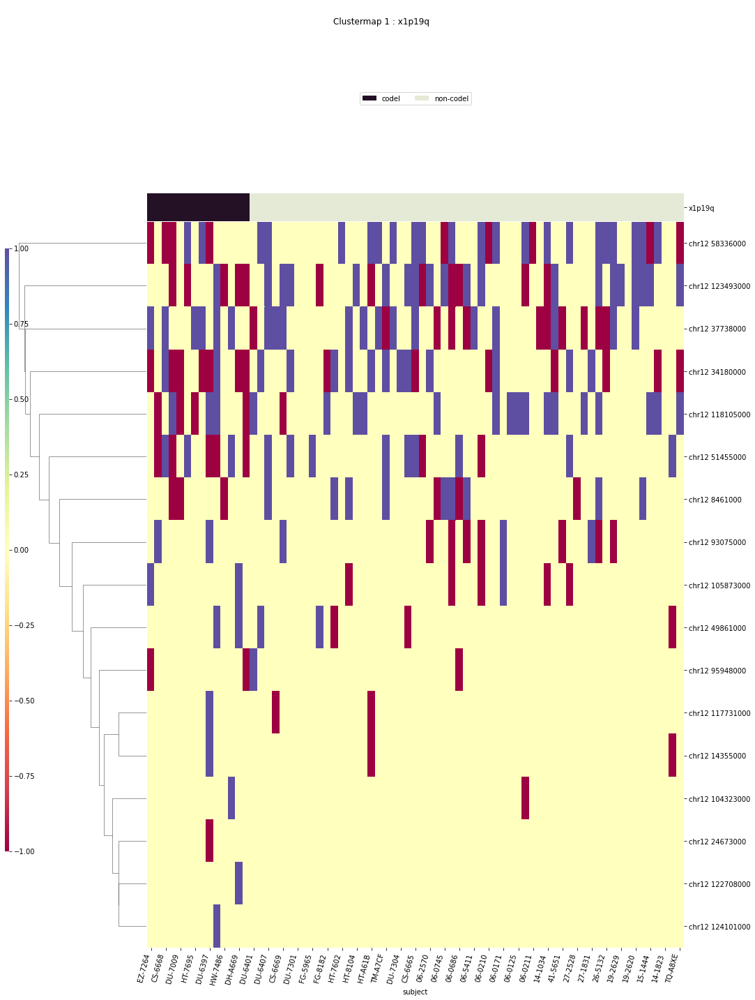

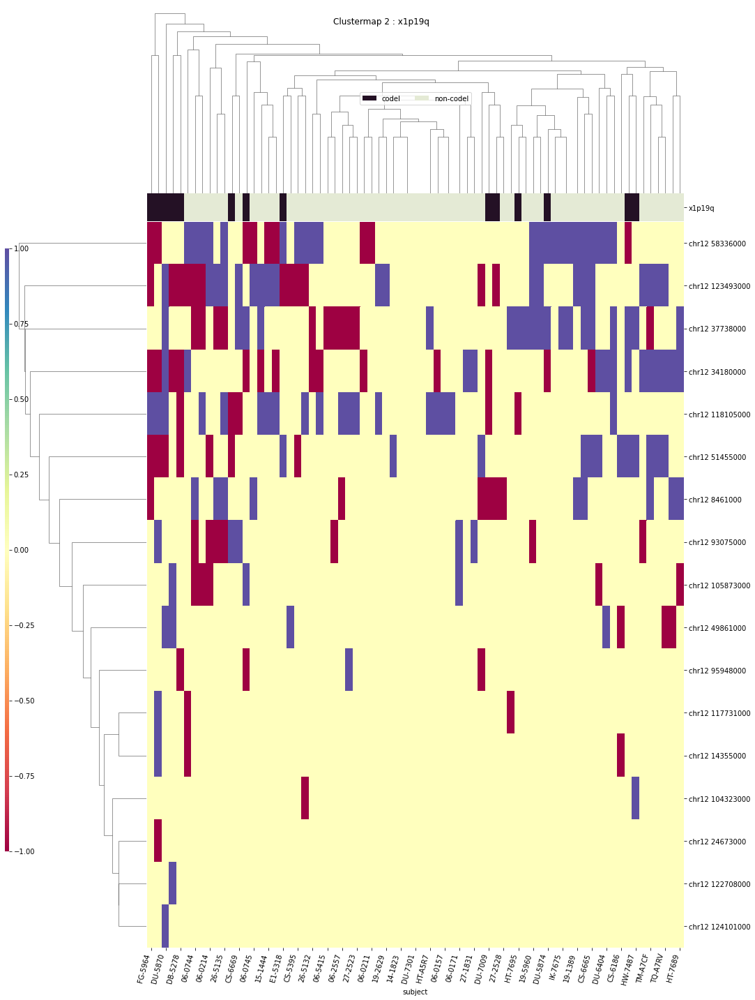

TERT
['TERT' 'chr12 123372000' 'chr12 123493000' 'chr12 126958000'
 'chr12 131926000' 'chr12 19340000' 'chr12 34180000' 'chr12 34619000'
 'chr12 48500000' 'chr12 48842000' 'chr12 8461000' 'chr12 89867000'
 'chr12 95907000' 'chr12 9601000' 'subject']


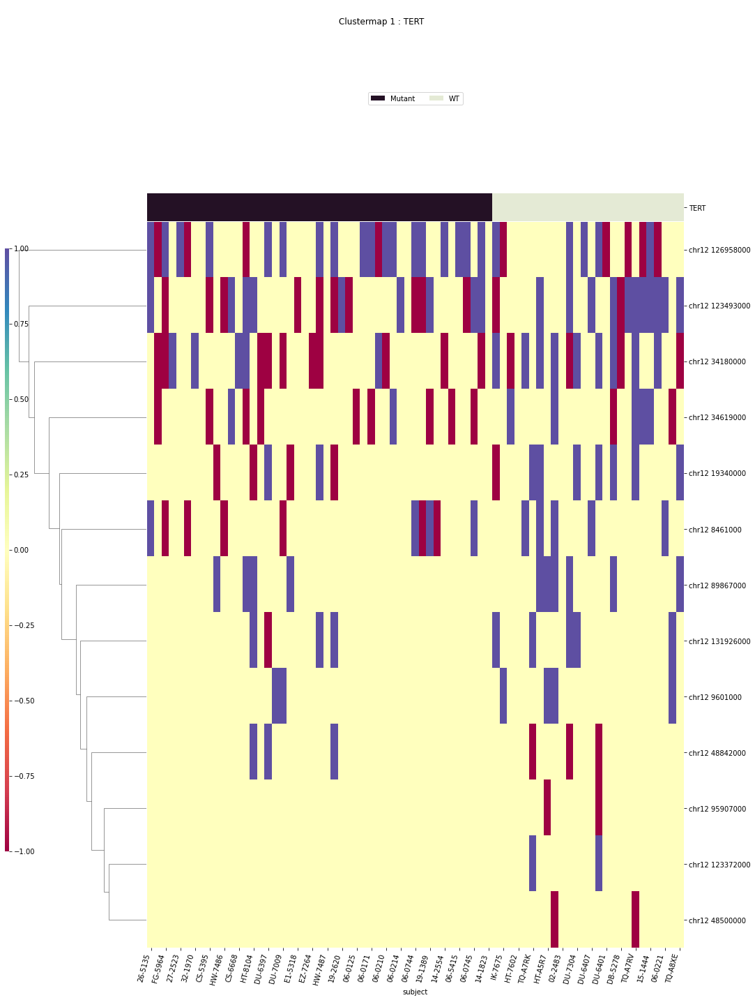

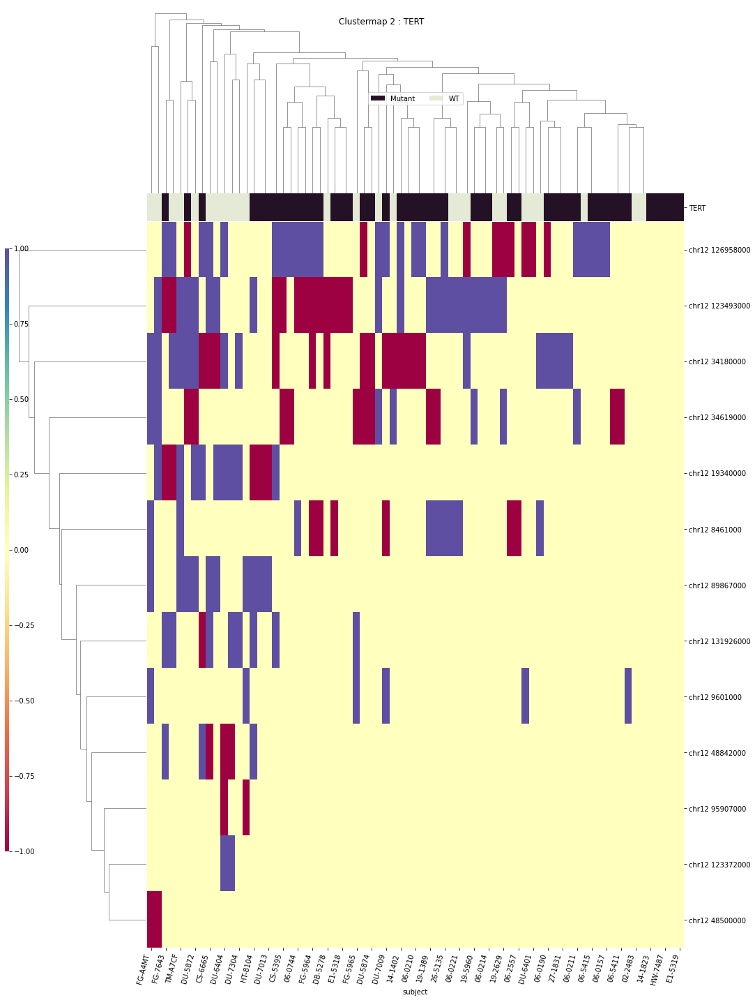

disease_type
['chr12 107826000' 'chr12 110570000' 'chr12 118105000' 'chr12 12566000'
 'chr12 131926000' 'chr12 37738000' 'chr12 49436000' 'chr12 68484000'
 'chr12 73008000' 'chr12 8184000' 'chr12 85469000' 'chr12 8635000'
 'chr12 89867000' 'chr12 93075000' 'chr12 9600000' 'chr12 9601000'
 'disease_type' 'subject']


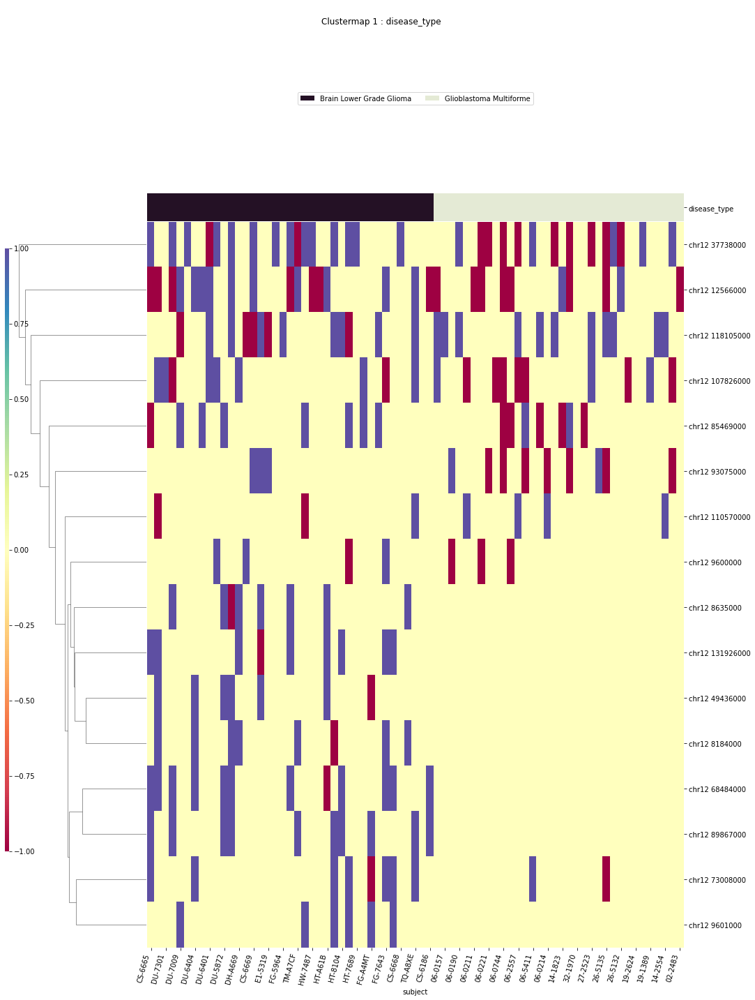

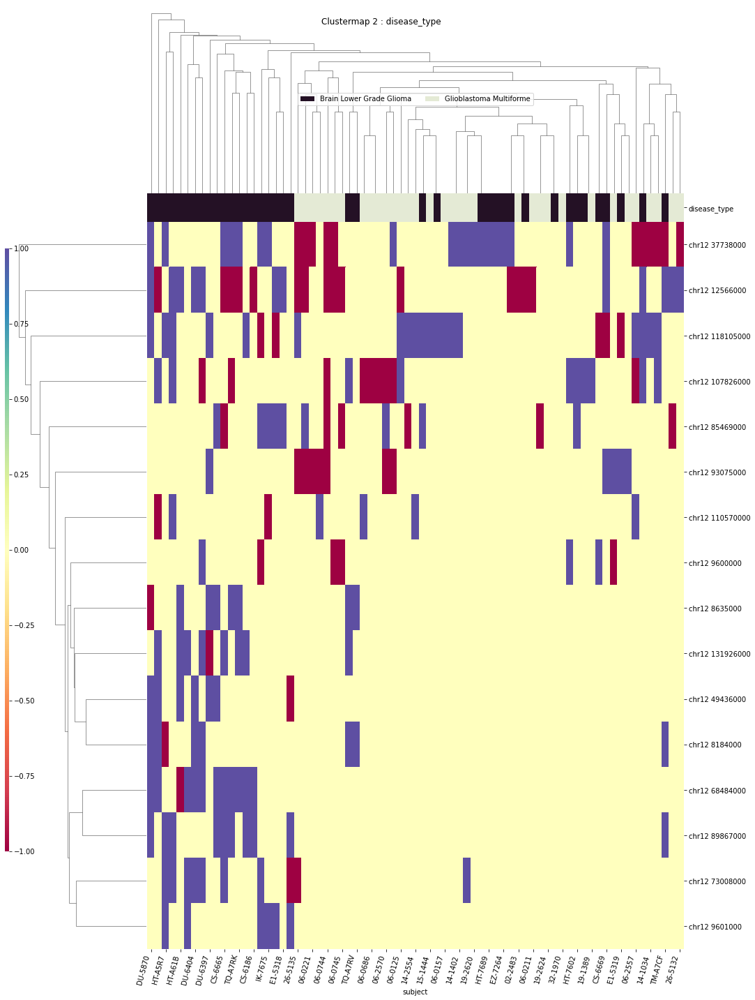

chr13
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr13 113867000


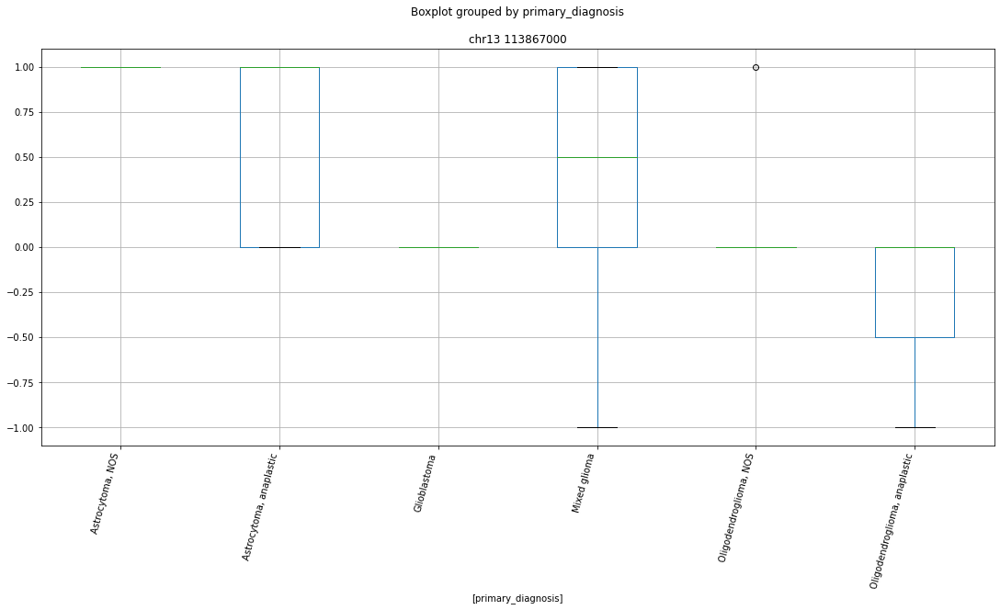

 p : 0.0  ( t : inf ) :  chr13 24956000


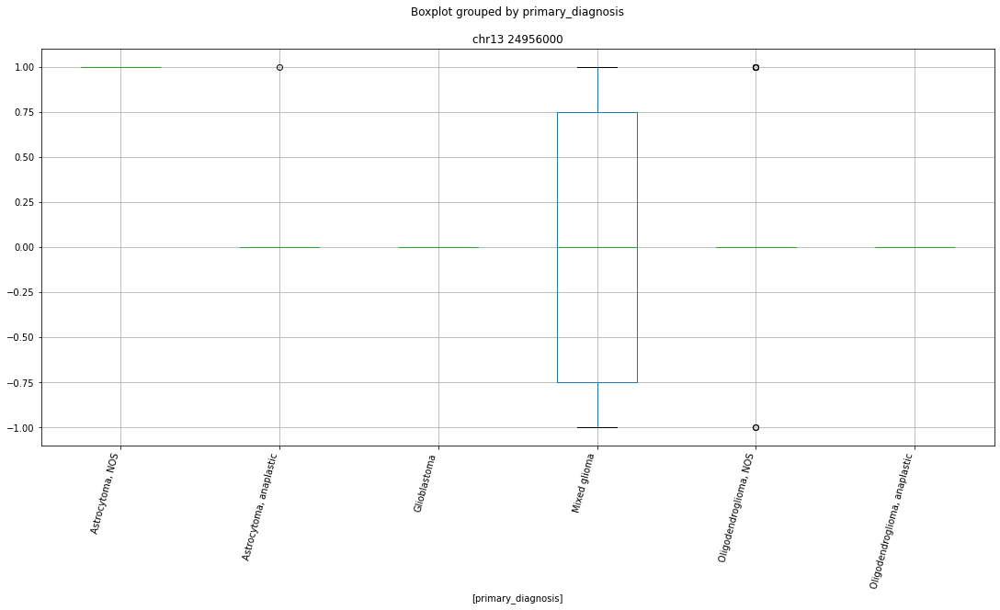

 p : 8.92060821762298e-10  ( t : 8.373639896594856 ) :  chr13 114181000


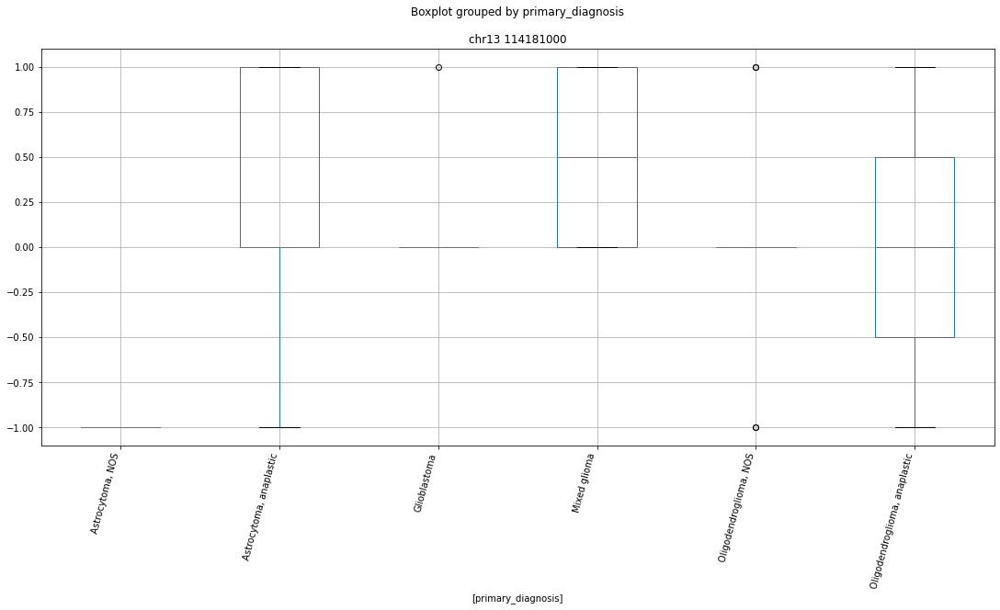

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr13 26724000


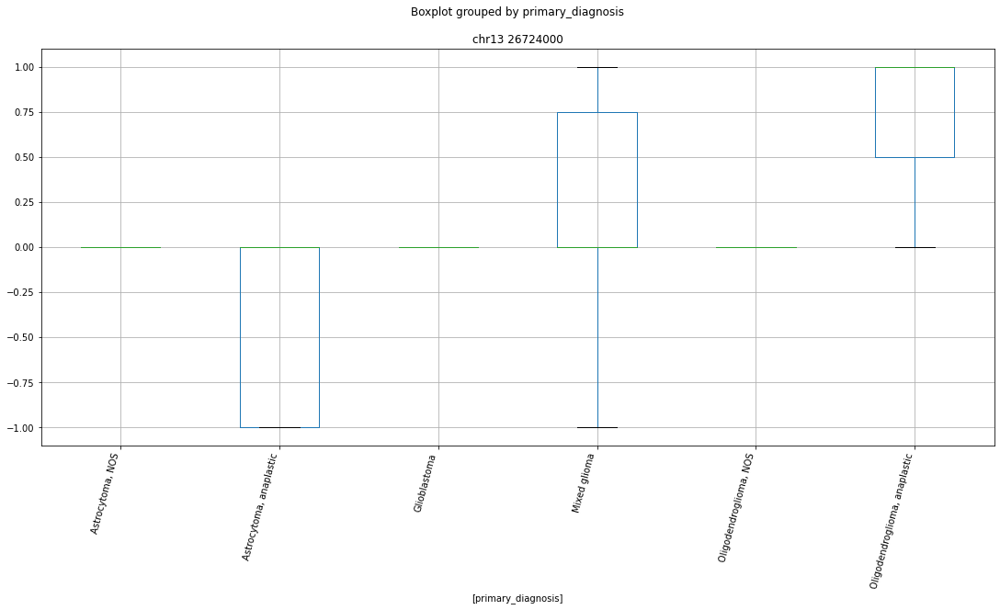

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr13 23972000


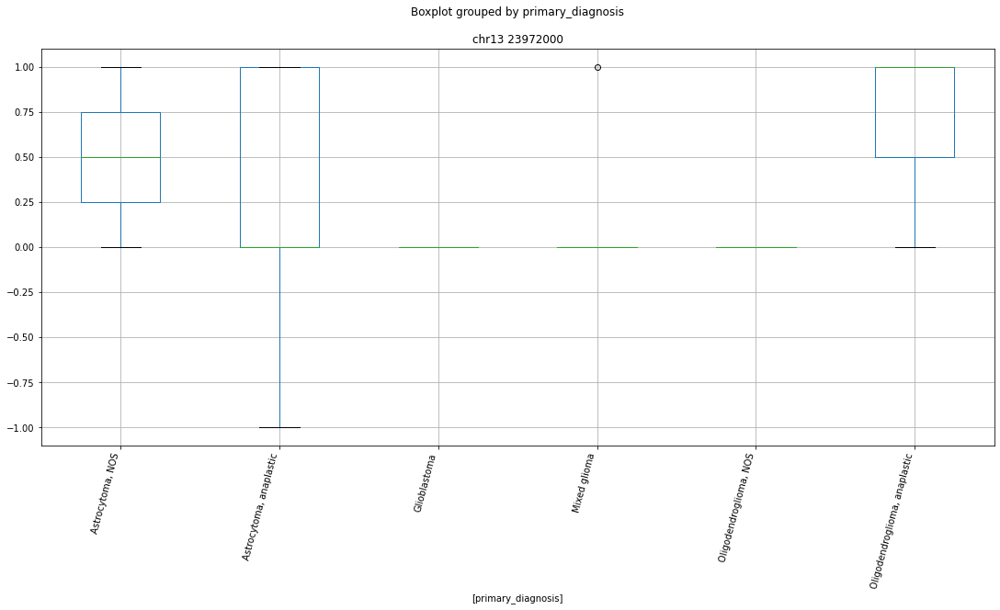

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr13 34181000


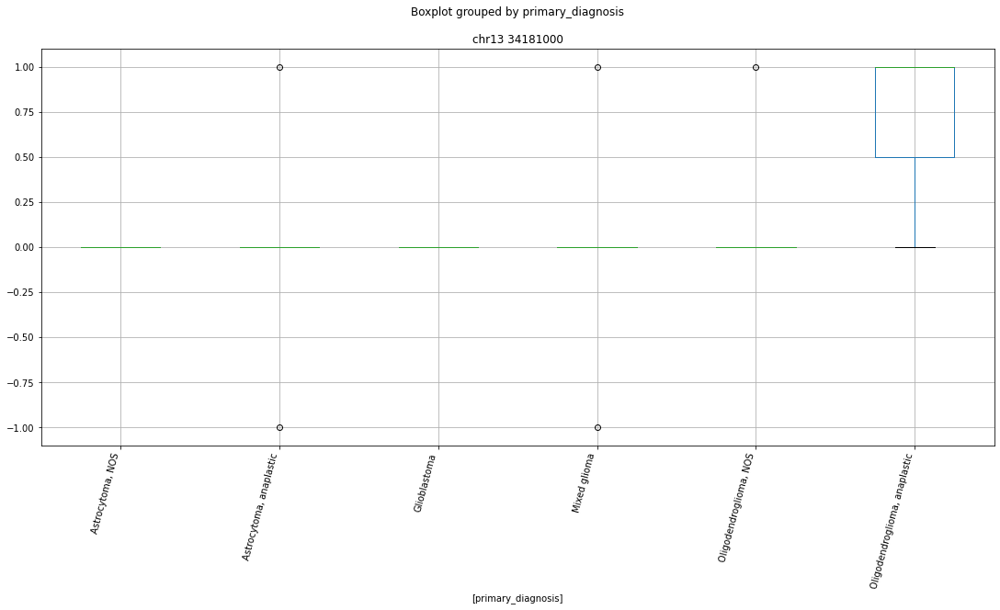

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr13 30839000


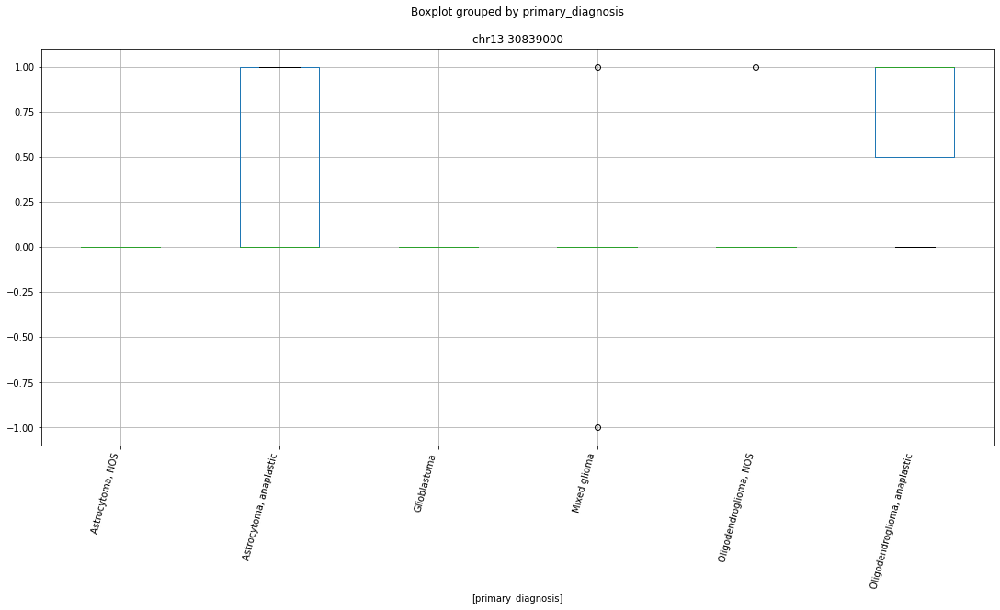

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr13 99242000


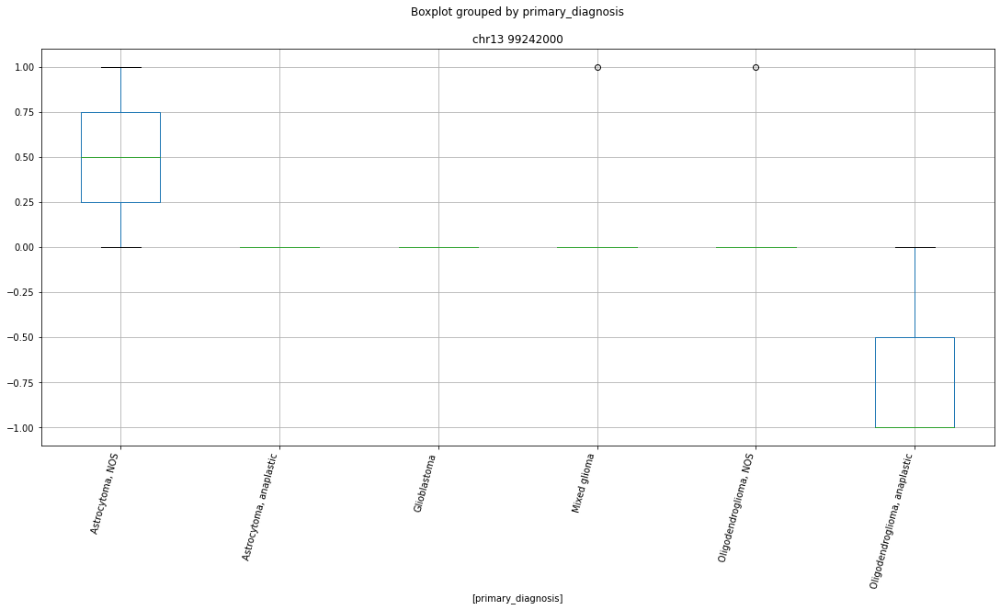

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr13 113867000


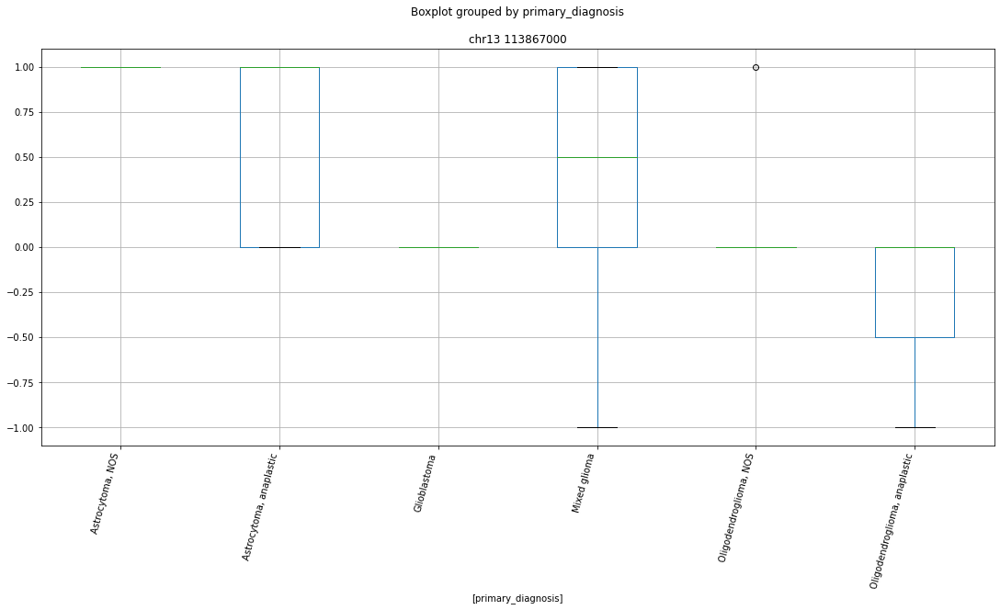

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr13 110838000


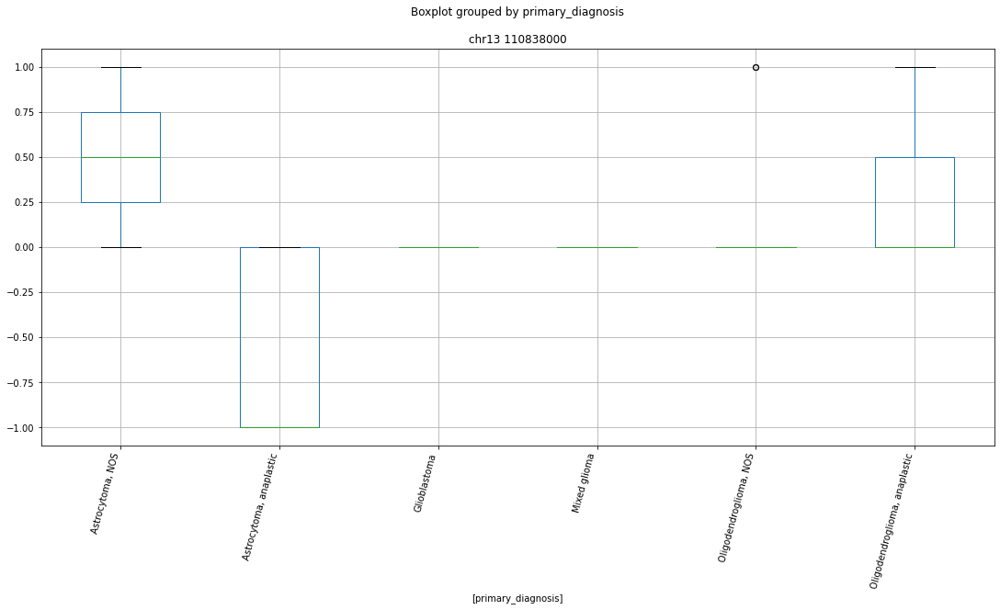

['chr13 109118000' 'chr13 110606000' 'chr13 110838000' 'chr13 113867000'
 'chr13 114181000' 'chr13 18251000' 'chr13 18719000' 'chr13 18720000'
 'chr13 19601000' 'chr13 22813000' 'chr13 22814000' 'chr13 23972000'
 'chr13 24591000' 'chr13 24592000' 'chr13 24956000' 'chr13 24957000'
 'chr13 25479000' 'chr13 26724000' 'chr13 26806000' 'chr13 30839000'
 'chr13 32717000' 'chr13 34181000' 'chr13 34541000' 'chr13 40901000'
 'chr13 42710000' 'chr13 42711000' 'chr13 43415000' 'chr13 44037000'
 'chr13 44682000' 'chr13 49379000' 'chr13 49504000' 'chr13 52614000'
 'chr13 54267000' 'chr13 69614000' 'chr13 78647000' 'chr13 95269000'
 'chr13 95690000' 'chr13 98765000' 'chr13 99242000' 'primary_diagnosis'
 'subject']


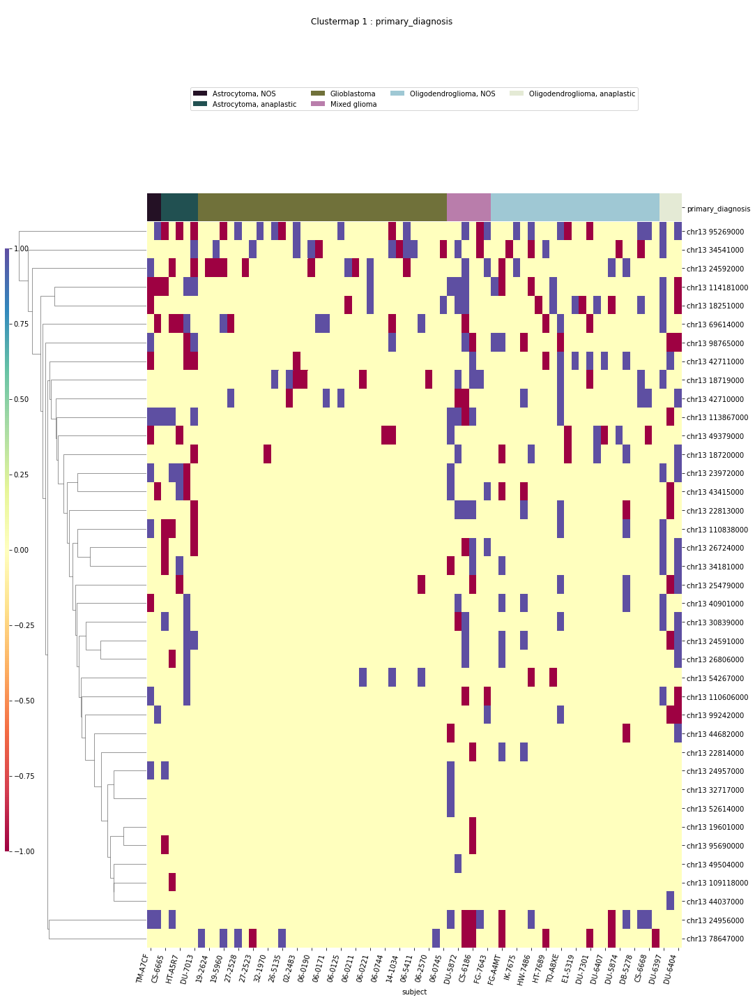

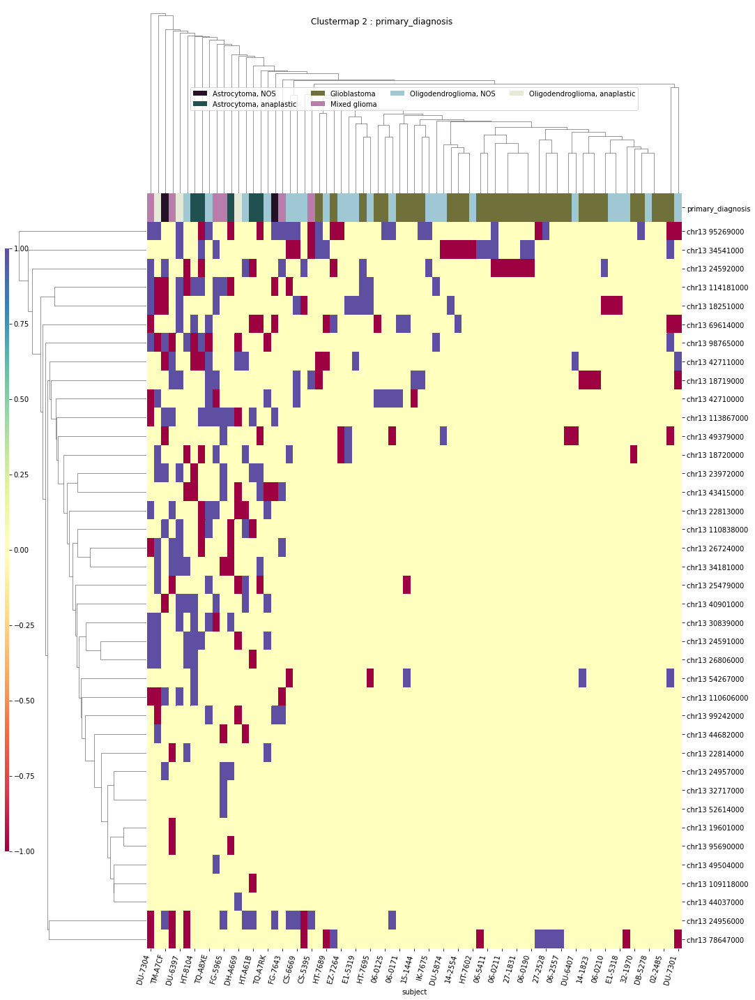

IDH
['IDH' 'chr13 22814000' 'chr13 23972000' 'chr13 24592000' 'chr13 24957000'
 'chr13 44682000' 'chr13 54267000' 'chr13 69614000' 'chr13 78647000'
 'subject']


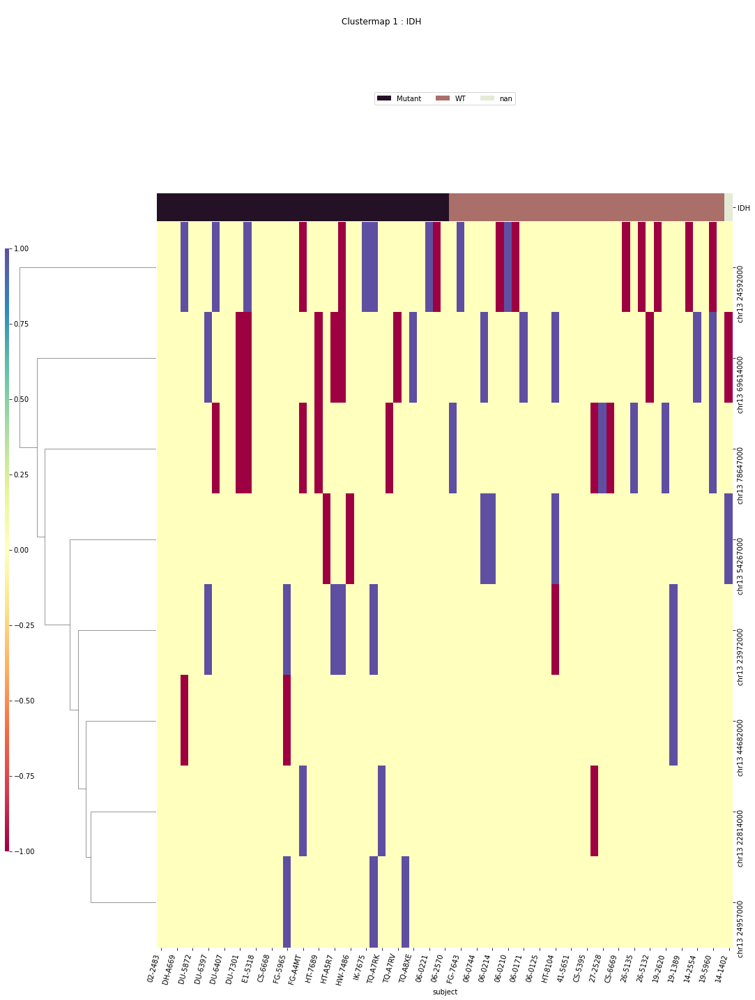

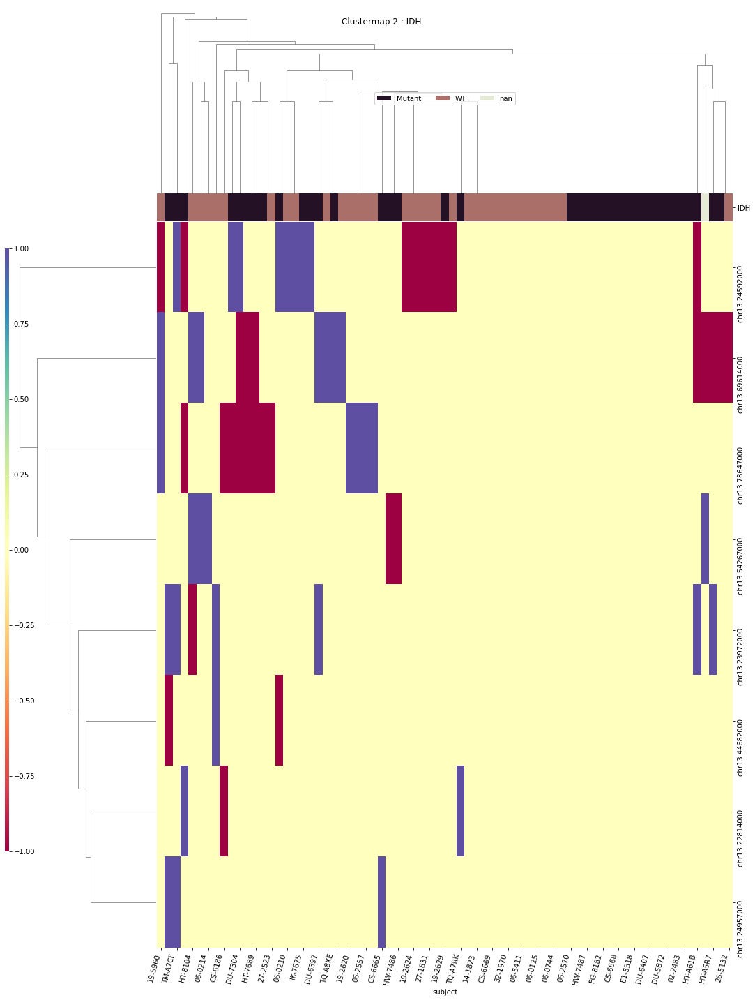

x1p19q
['chr13 110838000' 'chr13 113867000' 'chr13 22813000' 'chr13 24591000'
 'chr13 32000000' 'chr13 42711000' 'chr13 44037000' 'chr13 49593000'
 'chr13 54267000' 'subject' 'x1p19q']


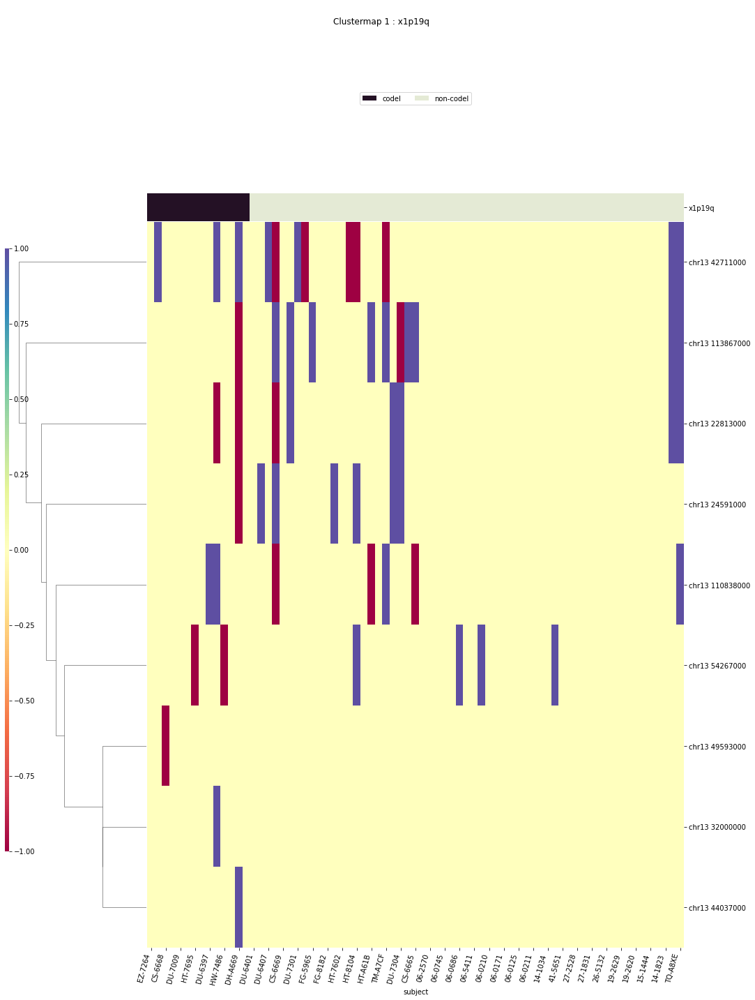

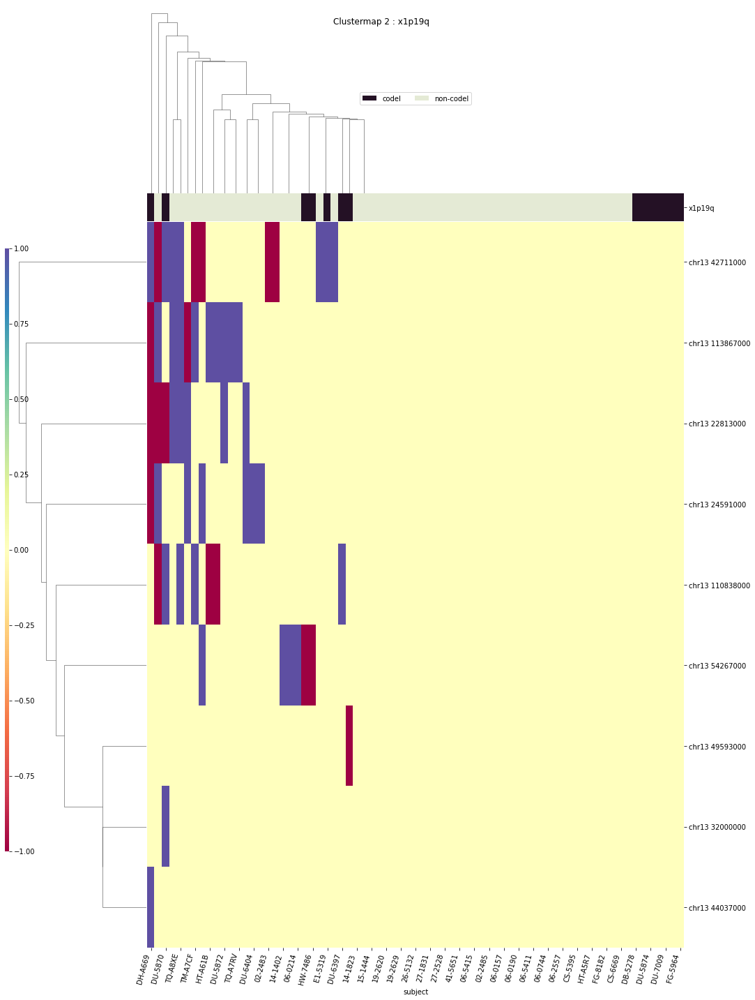

TERT
['TERT' 'chr13 113867000' 'chr13 22813000' 'chr13 22814000'
 'chr13 23972000' 'chr13 24591000' 'chr13 24957000' 'chr13 69614000'
 'chr13 78647000' 'subject']


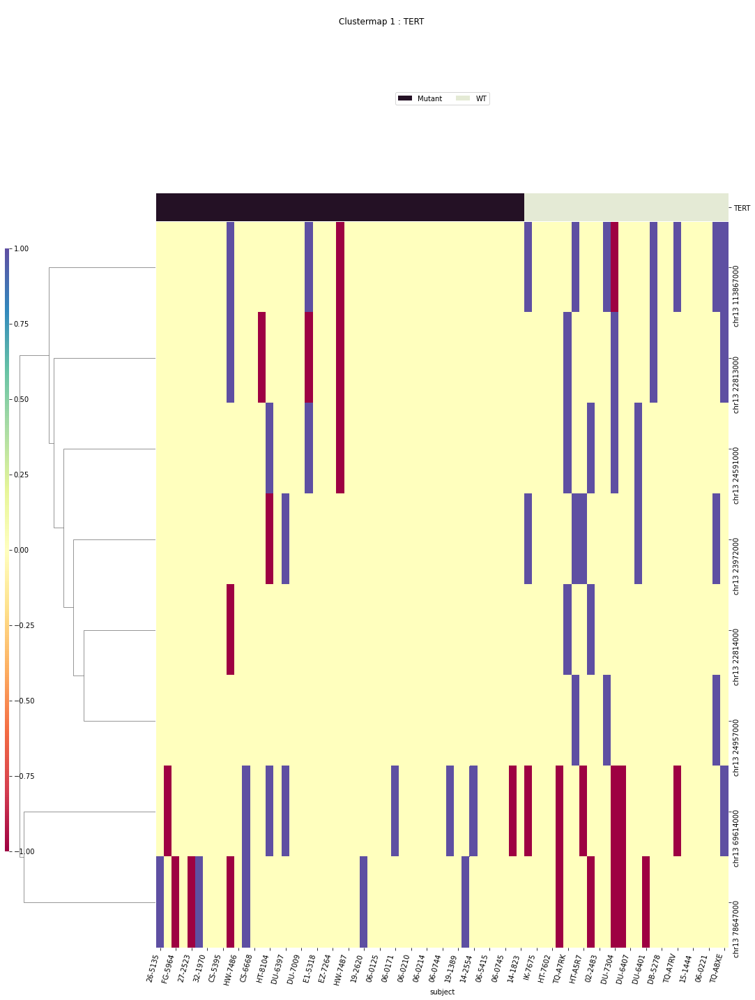

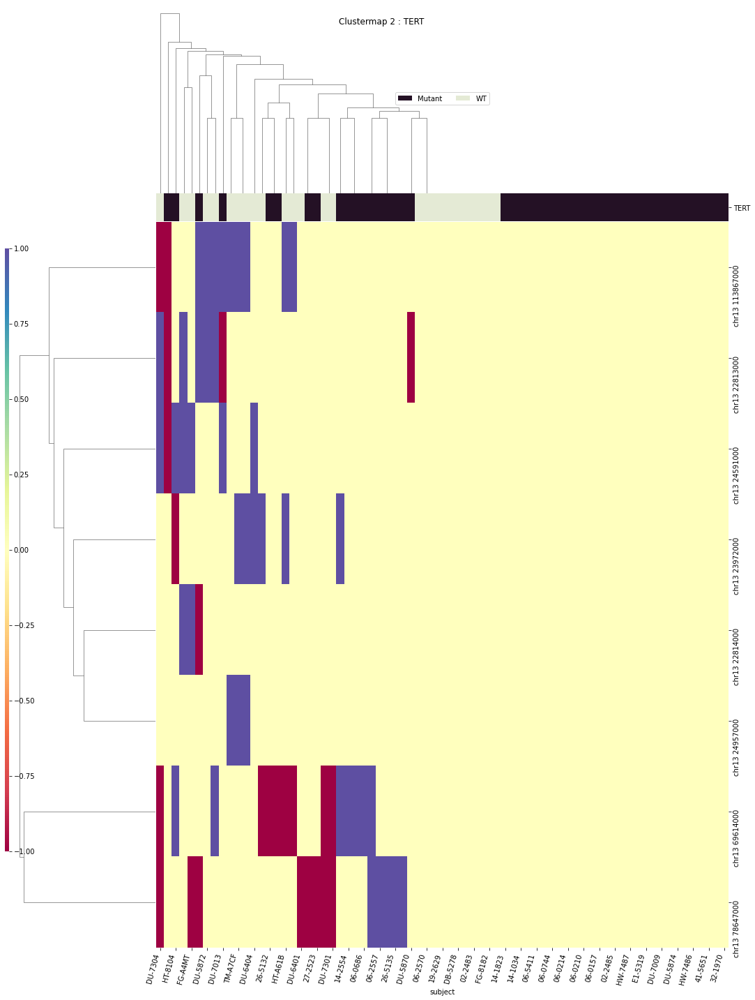

disease_type
['chr13 113867000' 'chr13 18719000' 'chr13 23972000' 'chr13 24591000'
 'chr13 24592000' 'chr13 30839000' 'chr13 40901000' 'chr13 54267000'
 'chr13 78647000' 'disease_type' 'subject']


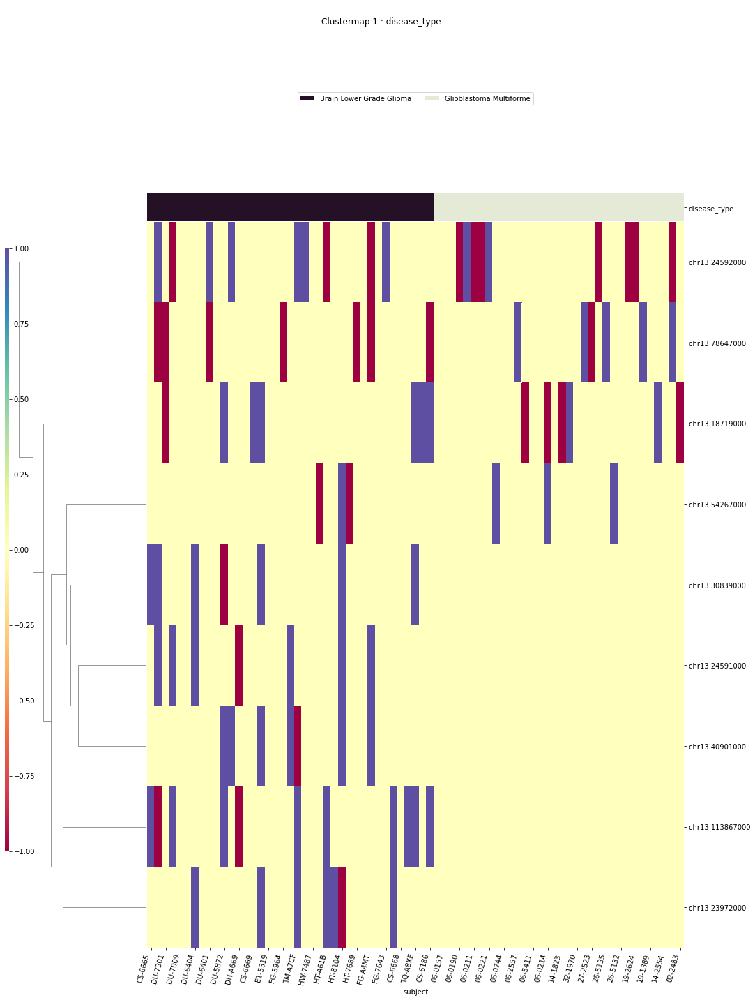

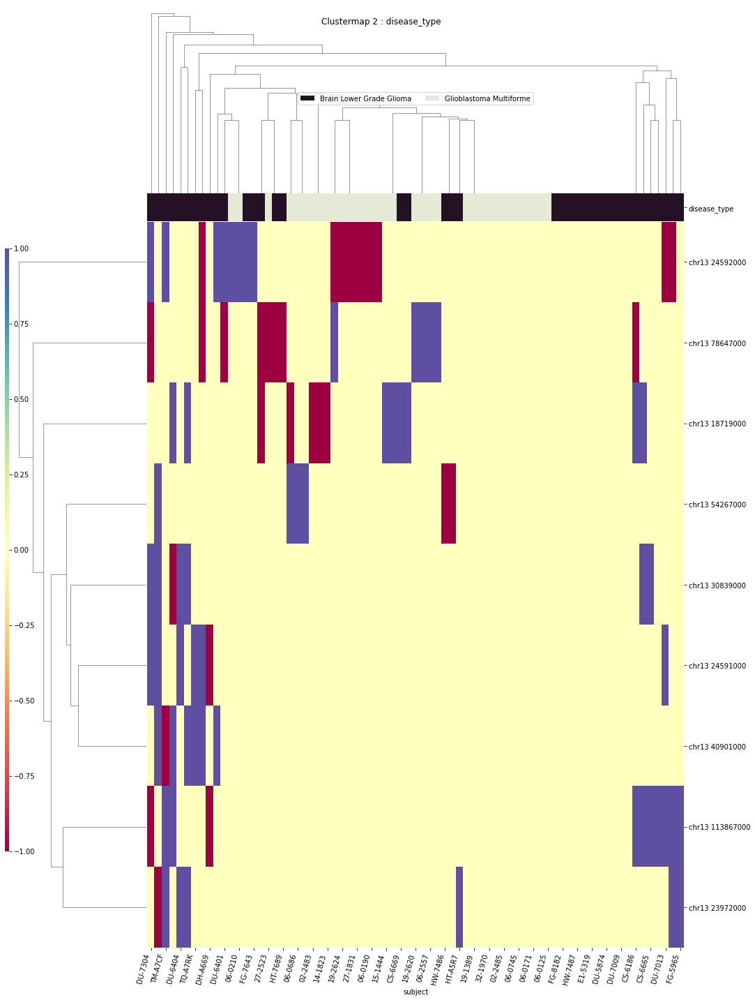

chr14
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr14 45213000


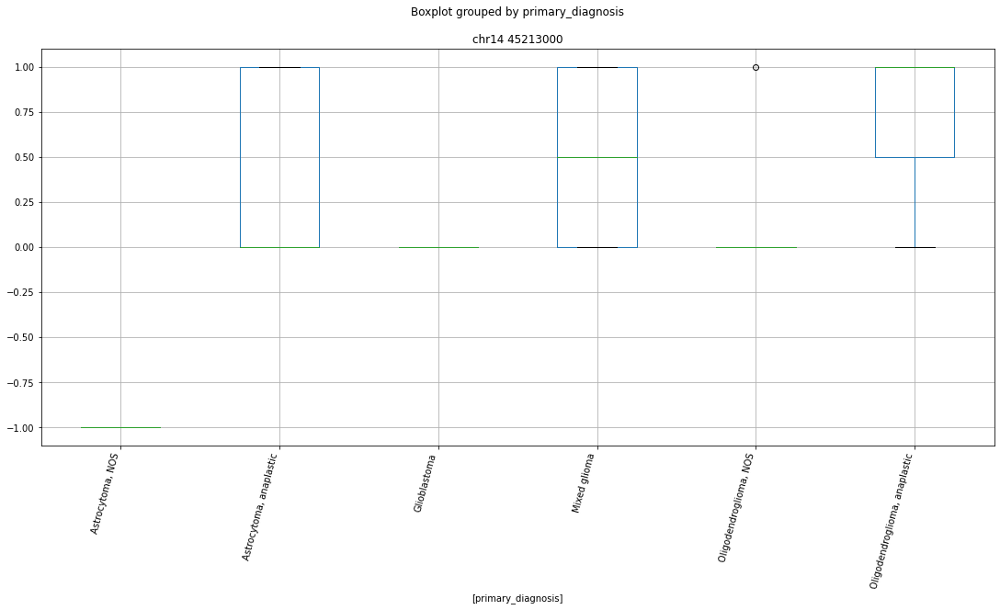

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr14 41673000


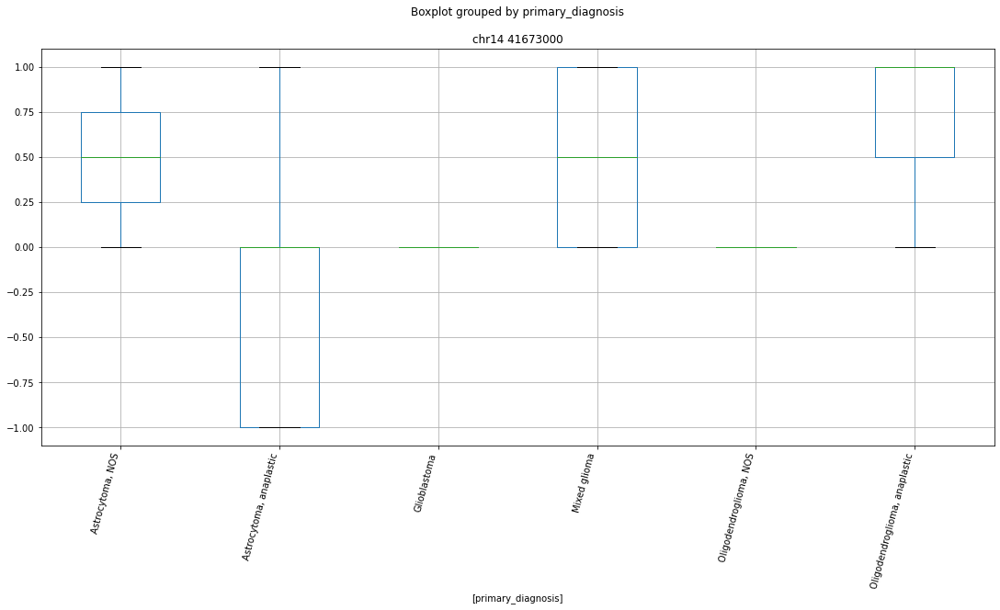

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr14 25792000


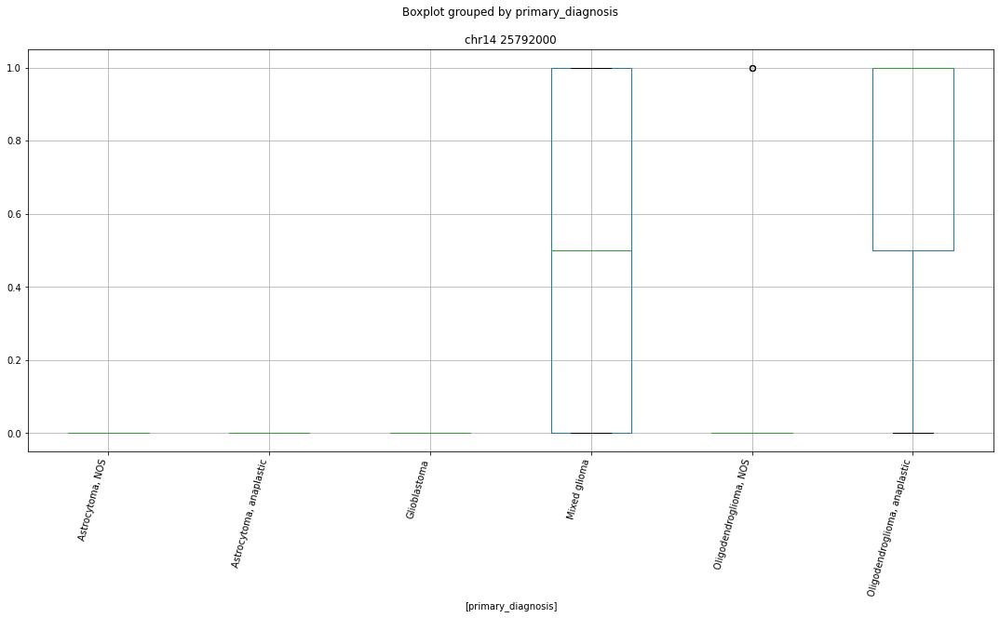

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr14 45213000


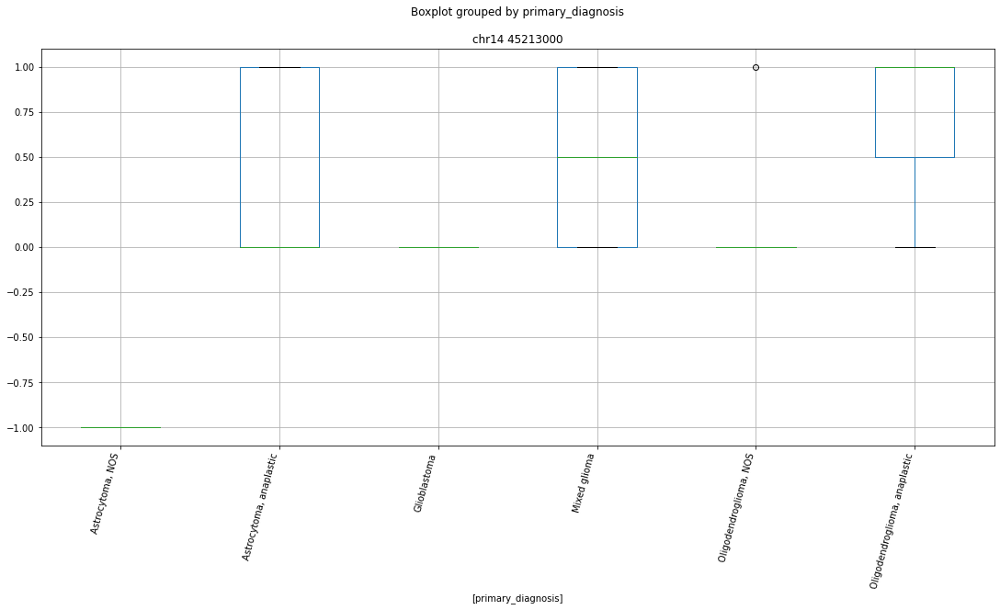

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr14 20507000


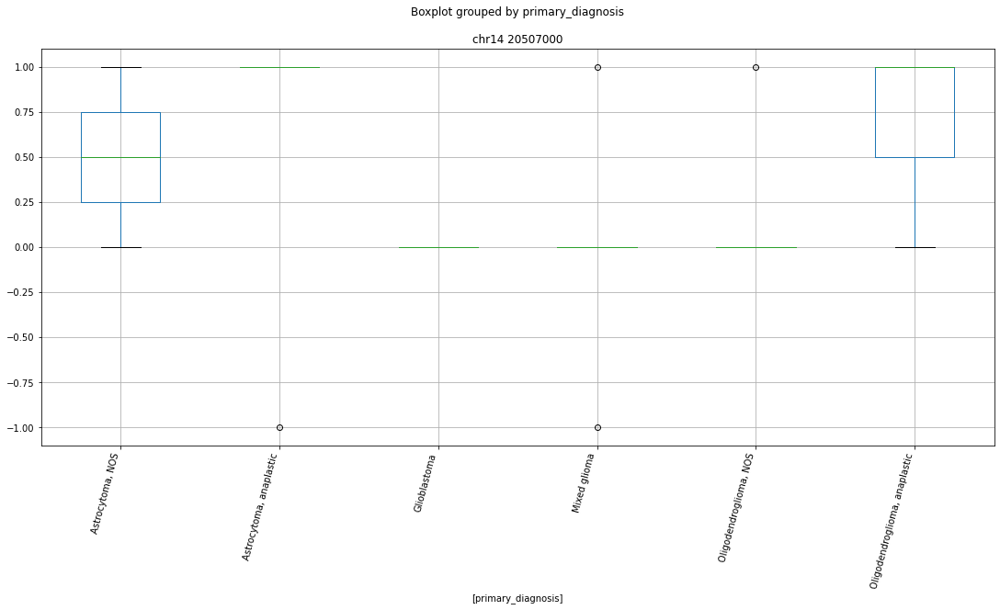

['chr14 100181000' 'chr14 100311000' 'chr14 102676000' 'chr14 103524000'
 'chr14 103525000' 'chr14 105079000' 'chr14 105274000' 'chr14 105555000'
 'chr14 105676000' 'chr14 20084000' 'chr14 20085000' 'chr14 20241000'
 'chr14 20507000' 'chr14 21189000' 'chr14 22638000' 'chr14 23898000'
 'chr14 23972000' 'chr14 24009000' 'chr14 25792000' 'chr14 33984000'
 'chr14 34079000' 'chr14 35152000' 'chr14 35976000' 'chr14 39285000'
 'chr14 41673000' 'chr14 45213000' 'chr14 45214000' 'chr14 45394000'
 'chr14 48598000' 'chr14 49821000' 'chr14 57334000' 'chr14 59058000'
 'chr14 63523000' 'chr14 64894000' 'chr14 64979000' 'chr14 73183000'
 'chr14 77416000' 'chr14 77636000' 'chr14 77747000' 'chr14 77795000'
 'chr14 77993000' 'chr14 80287000' 'chr14 84099000' 'chr14 87020000'
 'chr14 88024000' 'chr14 89388000' 'chr14 92819000' 'chr14 94627000'
 'chr14 94658000' 'primary_diagnosis' 'subject']


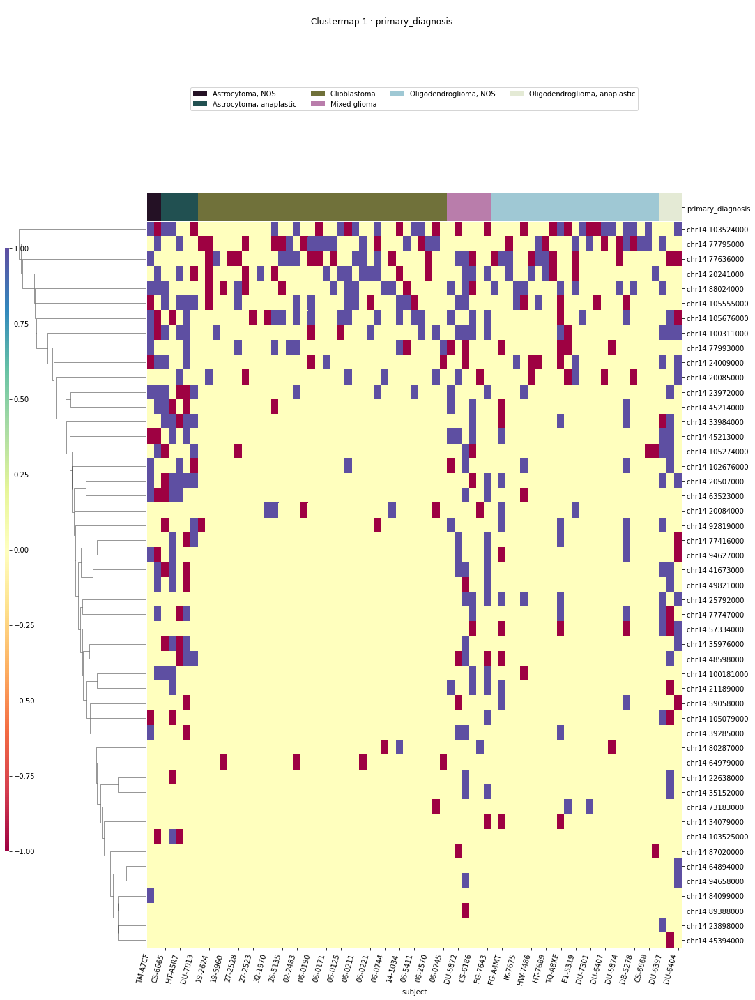

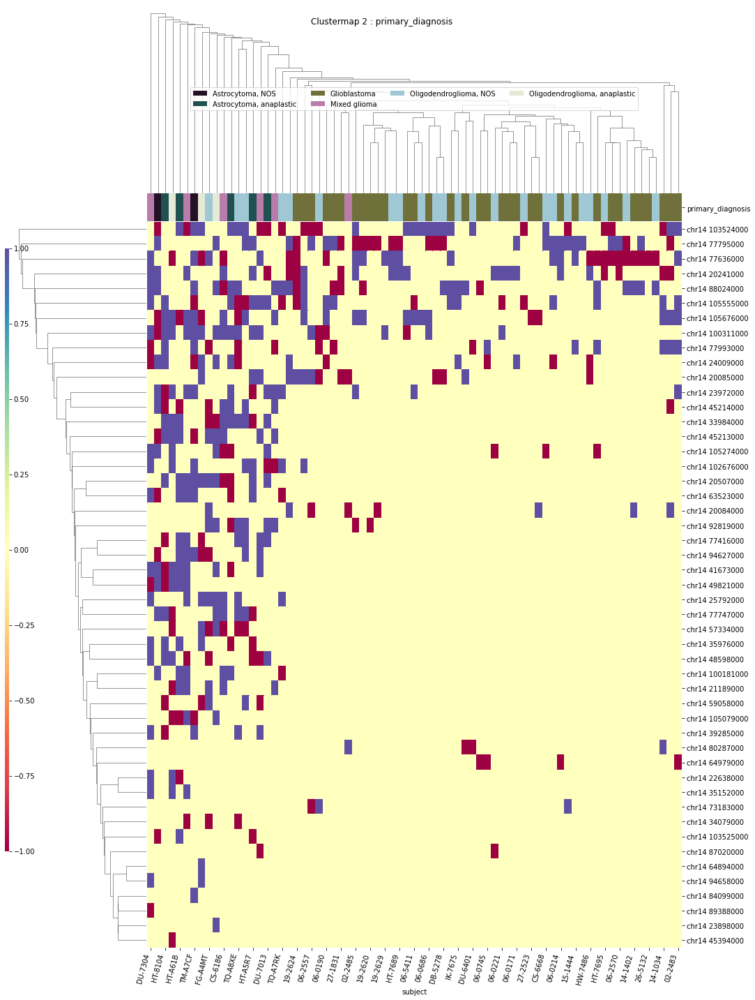

IDH
['IDH' 'chr14 105111000' 'chr14 106447000' 'chr14 23981000'
 'chr14 39285000' 'chr14 73183000' 'chr14 76750000' 'chr14 76822000'
 'chr14 77993000' 'chr14 88024000' 'subject']


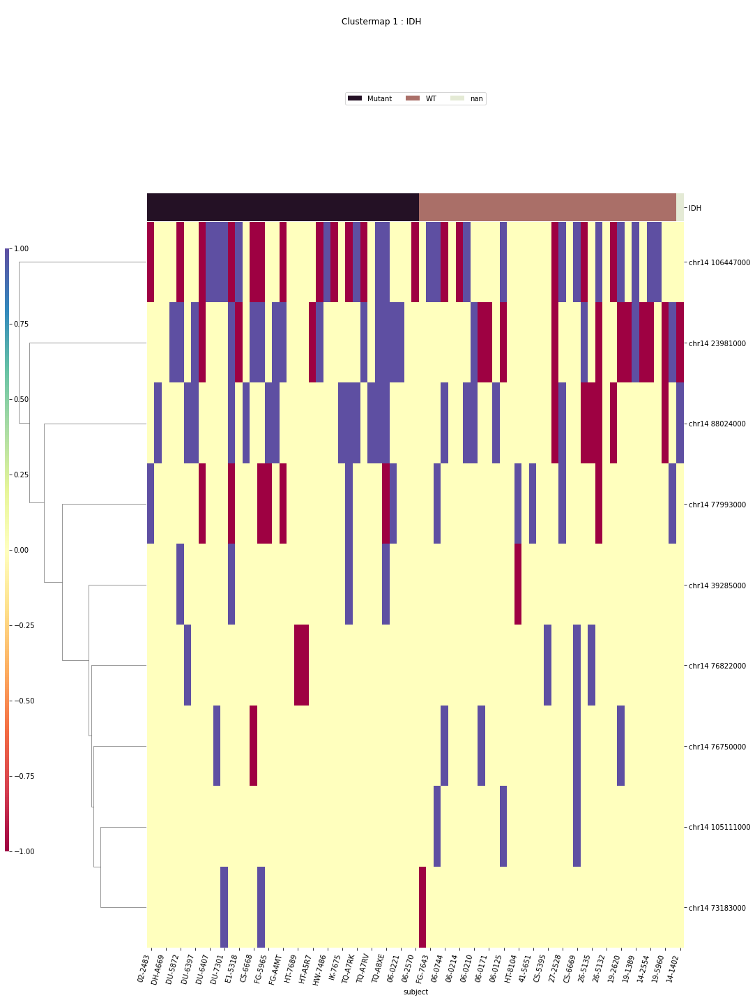

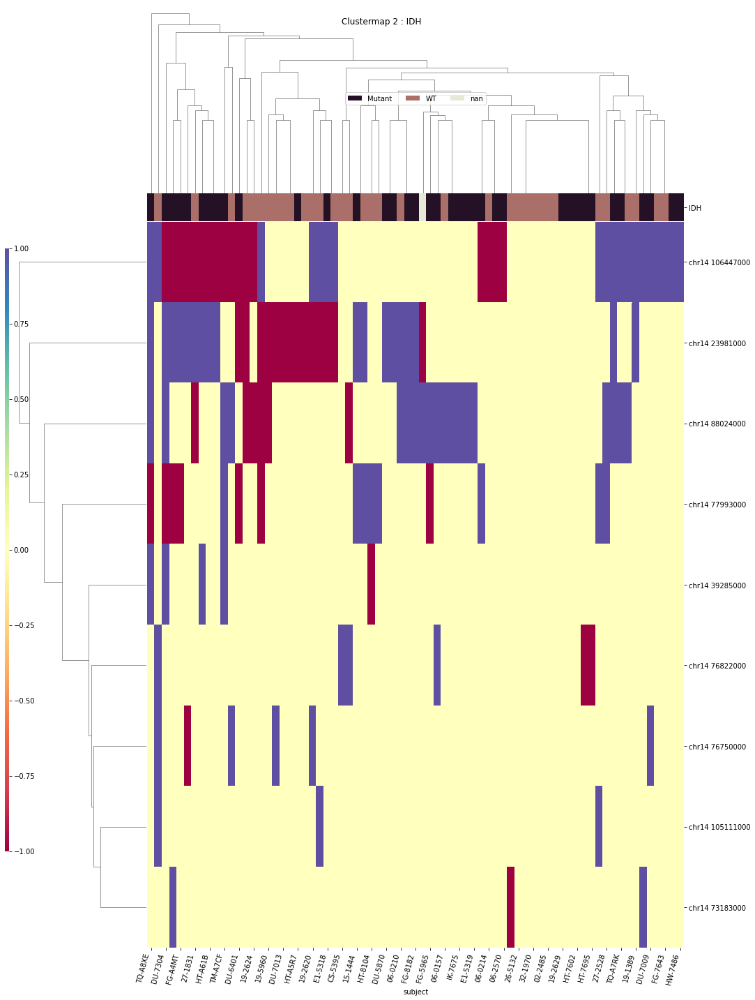

x1p19q
['chr14 21189000' 'chr14 23898000' 'chr14 45394000' 'chr14 77636000'
 'subject' 'x1p19q']


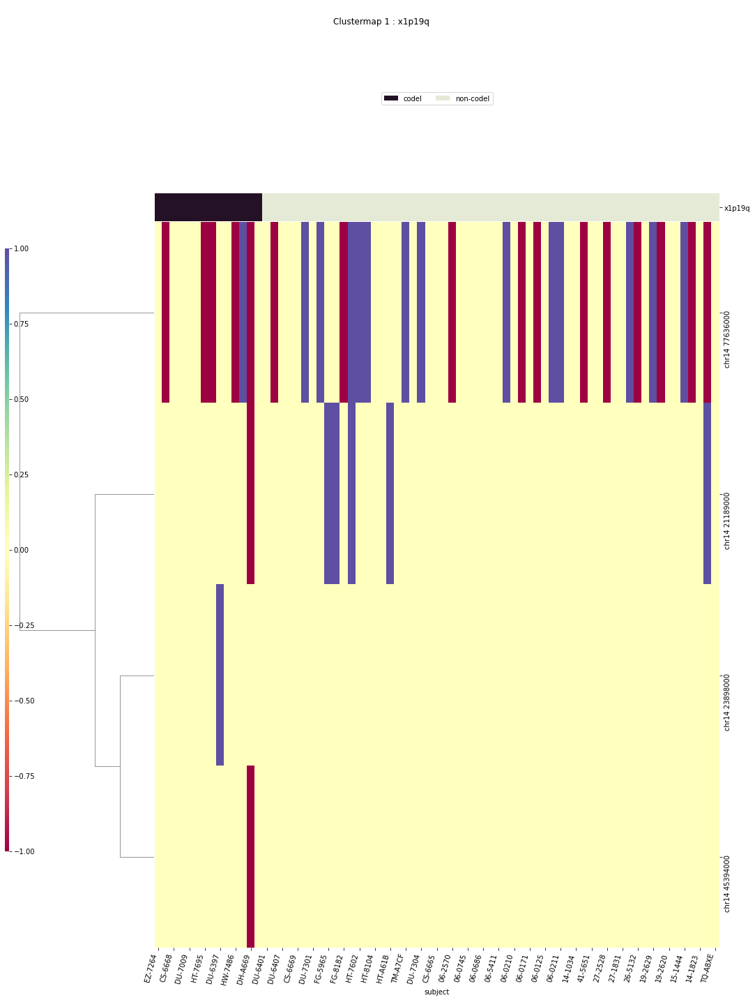

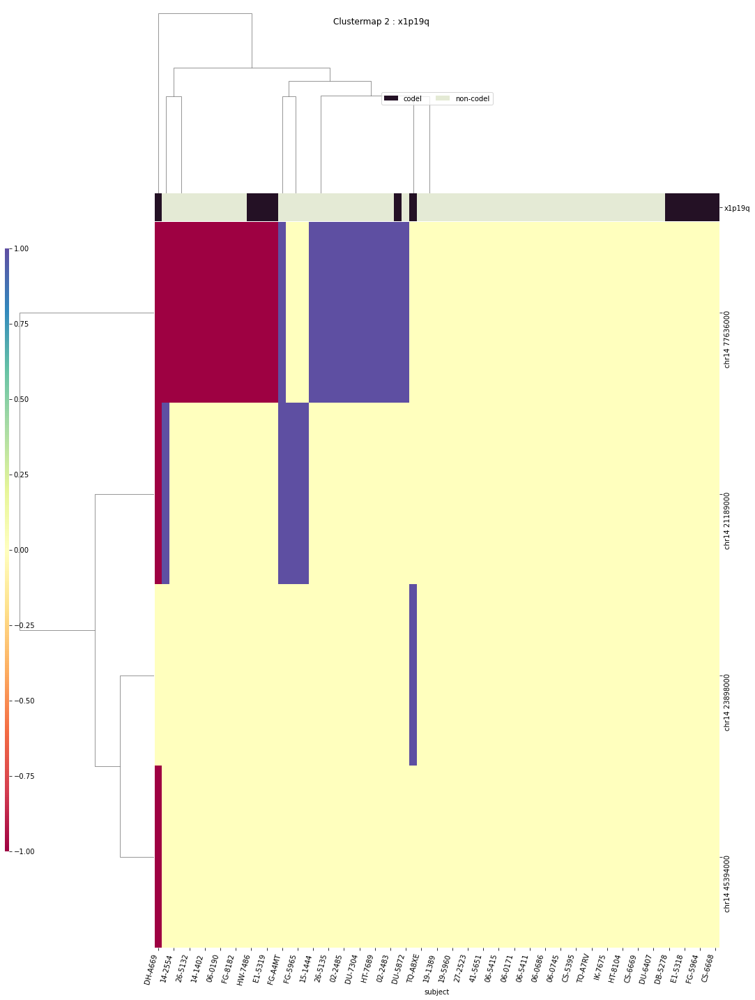

TERT
['TERT' 'chr14 100311000' 'chr14 105676000' 'chr14 23981000'
 'chr14 25792000' 'chr14 39285000' 'chr14 77636000' 'chr14 88024000'
 'chr14 94658000' 'subject']


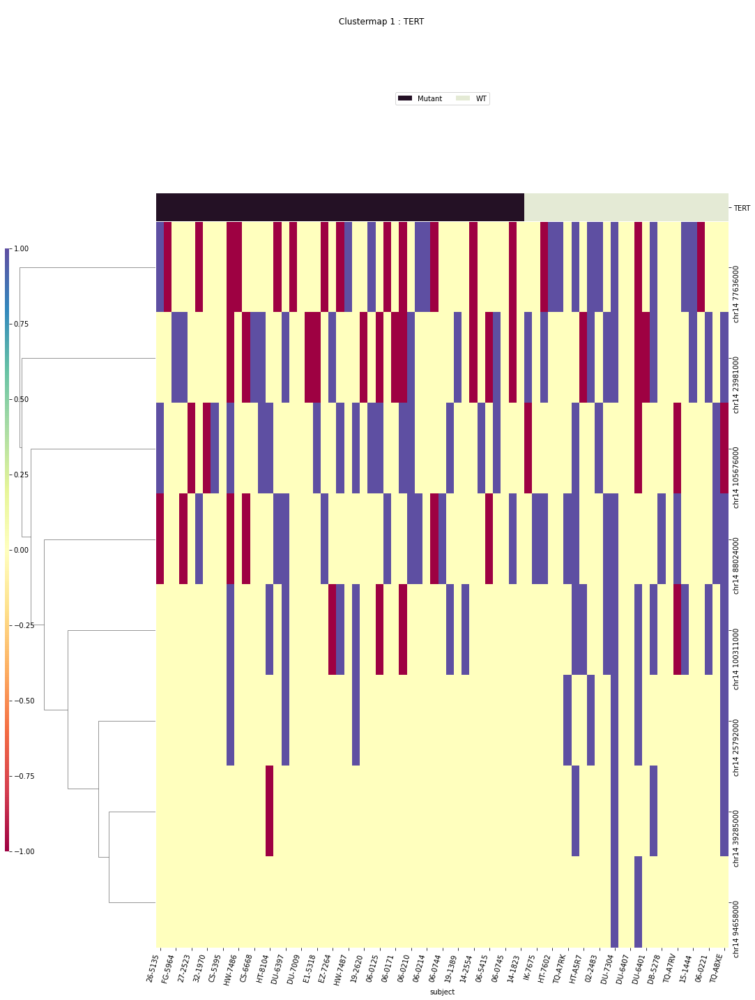

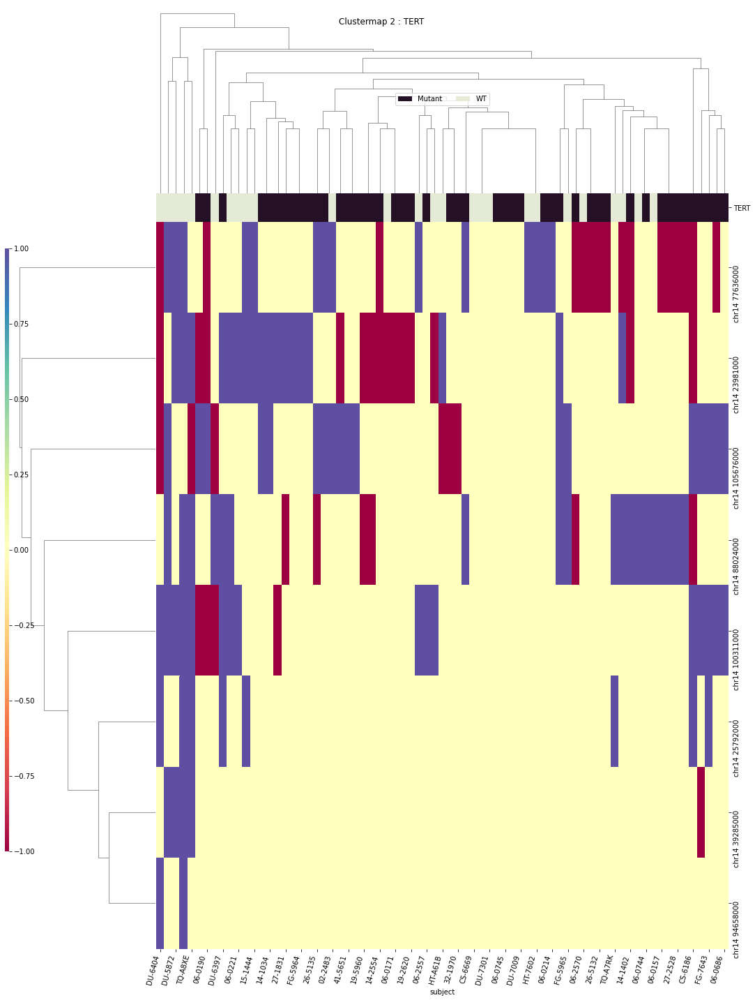

disease_type
['chr14 100311000' 'chr14 20507000' 'chr14 25792000' 'chr14 45213000'
 'chr14 64979000' 'chr14 73183000' 'chr14 77993000' 'chr14 88024000'
 'chr14 92819000' 'disease_type' 'subject']


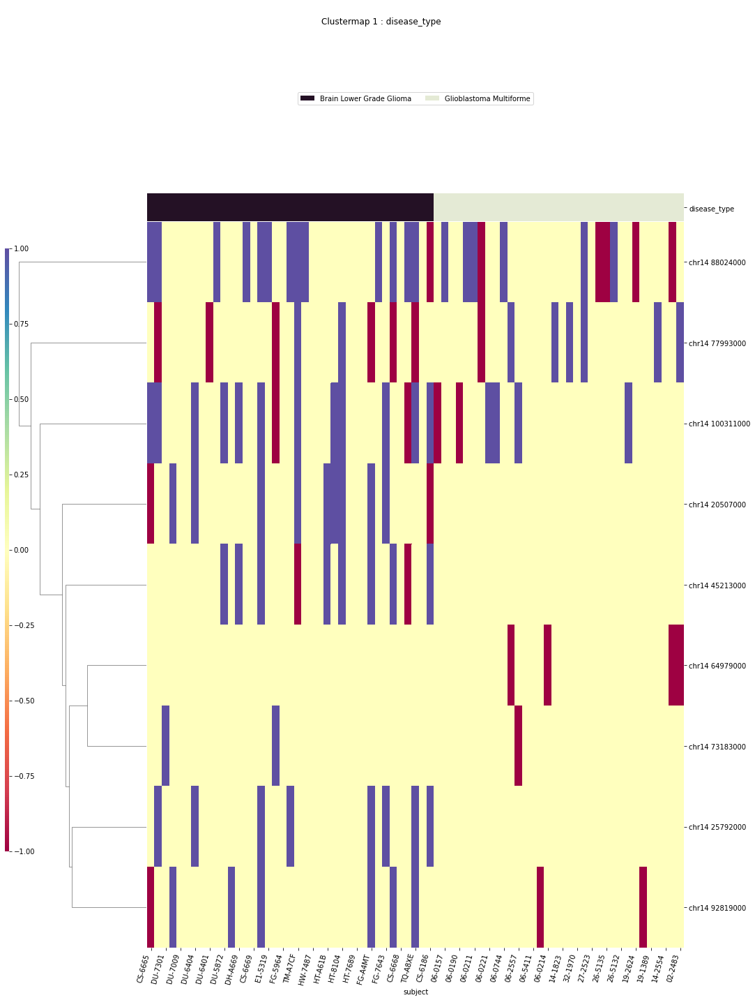

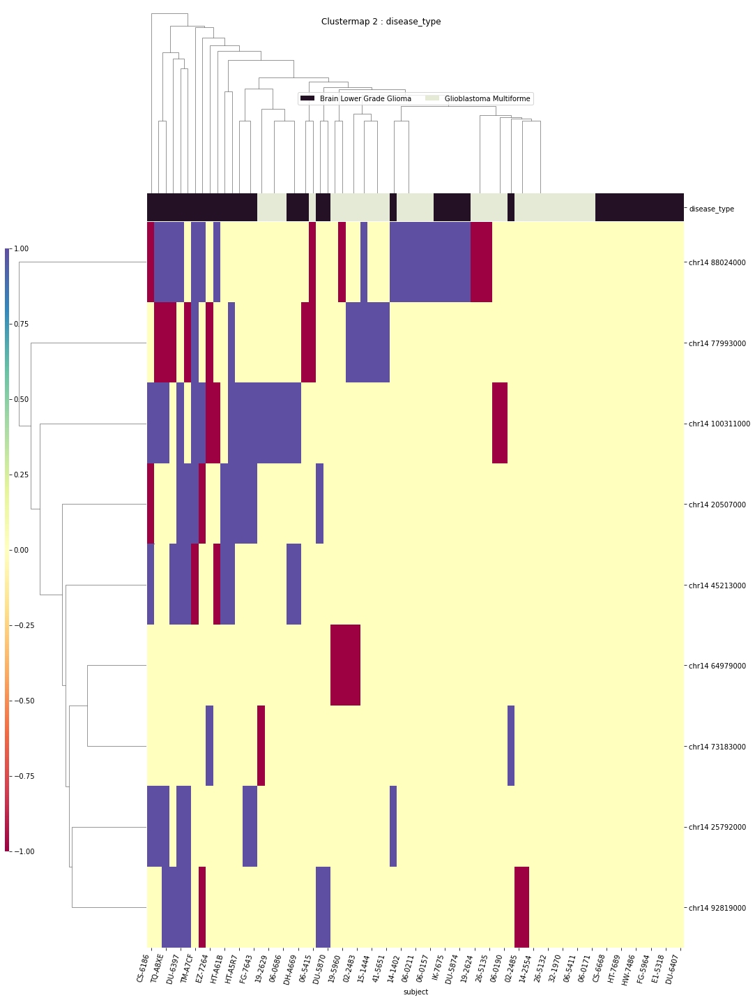

chr14_GL000009v2_random
HERVK113
primary_diagnosis
['chr14_GL000009v2_random 200000' 'primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chr14_GL000194v1_random
HERVK113
primary_diagnosis
['primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chr14_KI270723v1_random
HERVK113
primary_diagnosis
['primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce c

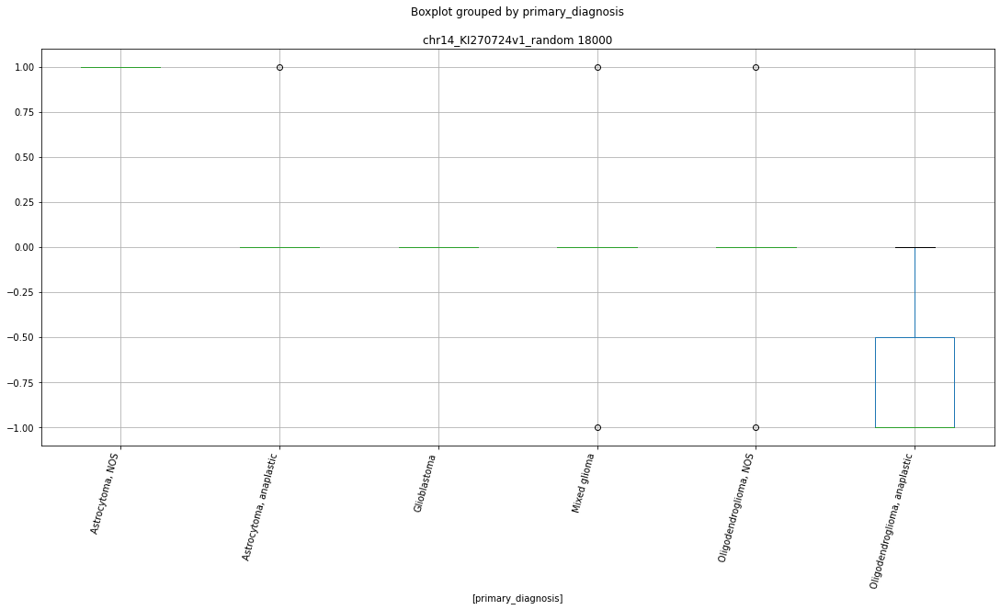

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr14_KI270724v1_random 18000


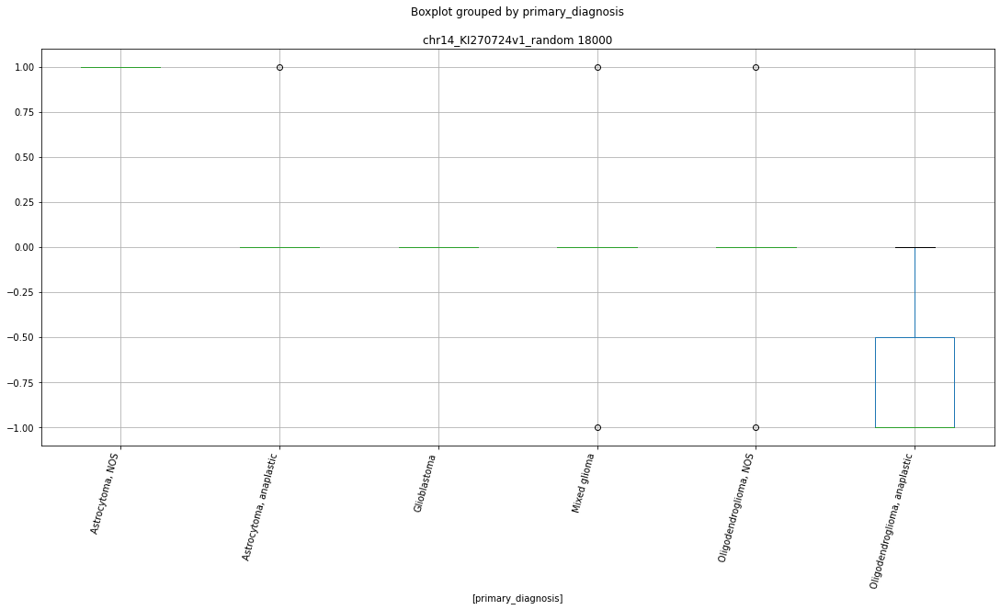

['chr14_KI270724v1_random 18000' 'chr14_KI270724v1_random 19000'
 'primary_diagnosis' 'subject']


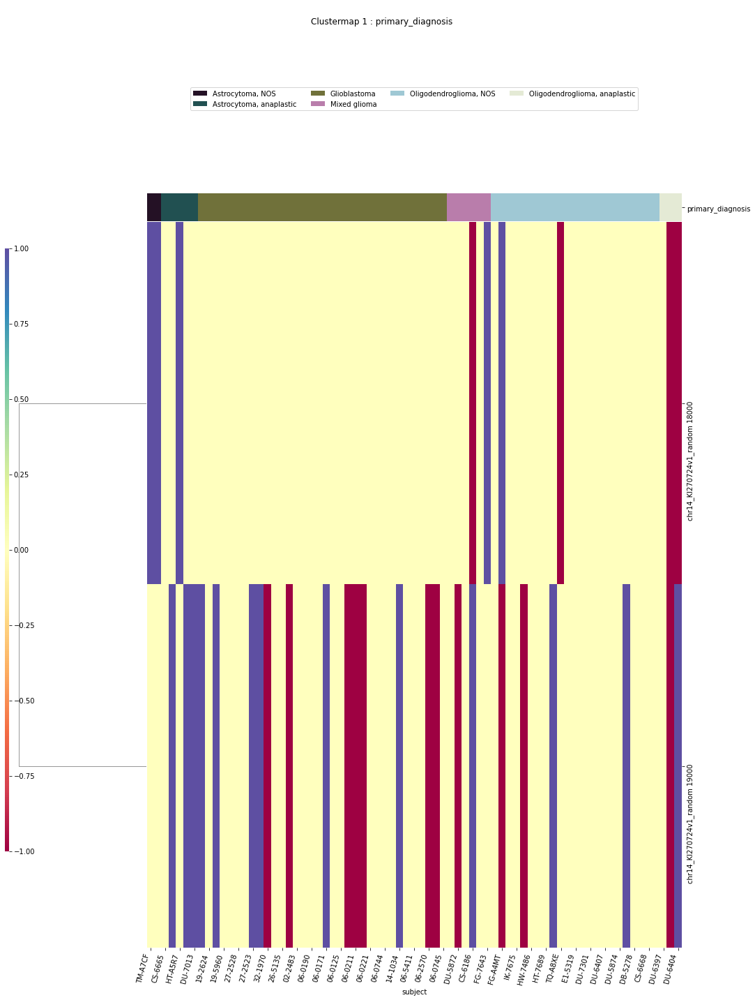

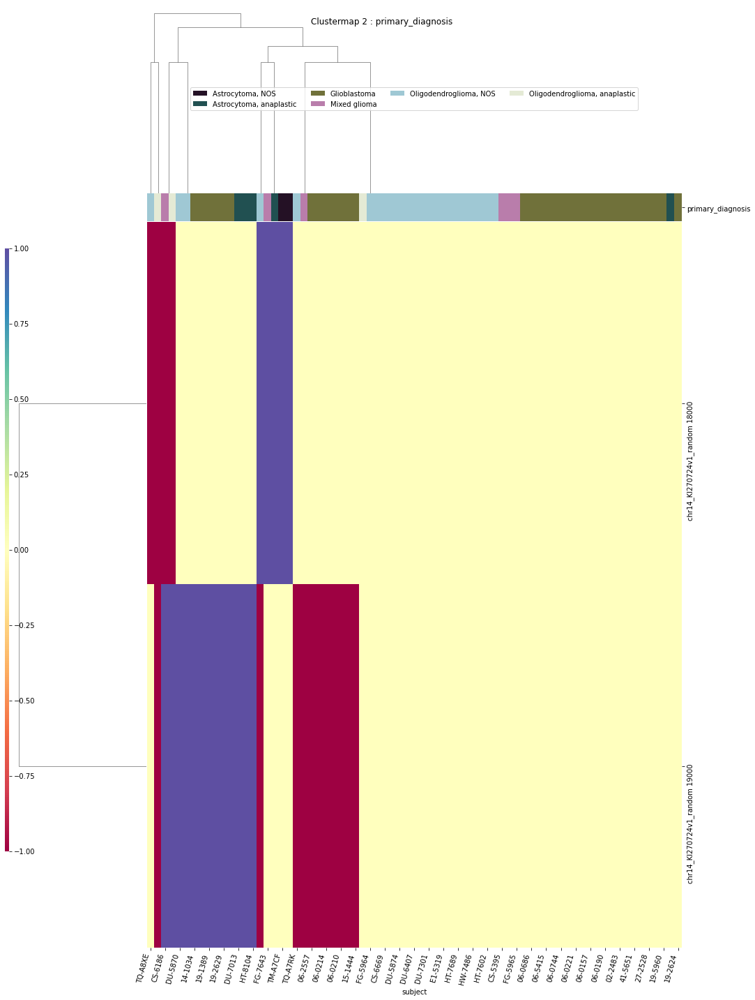

IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chr15
HERVK113
primary_diagnosis
 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr15 80647000


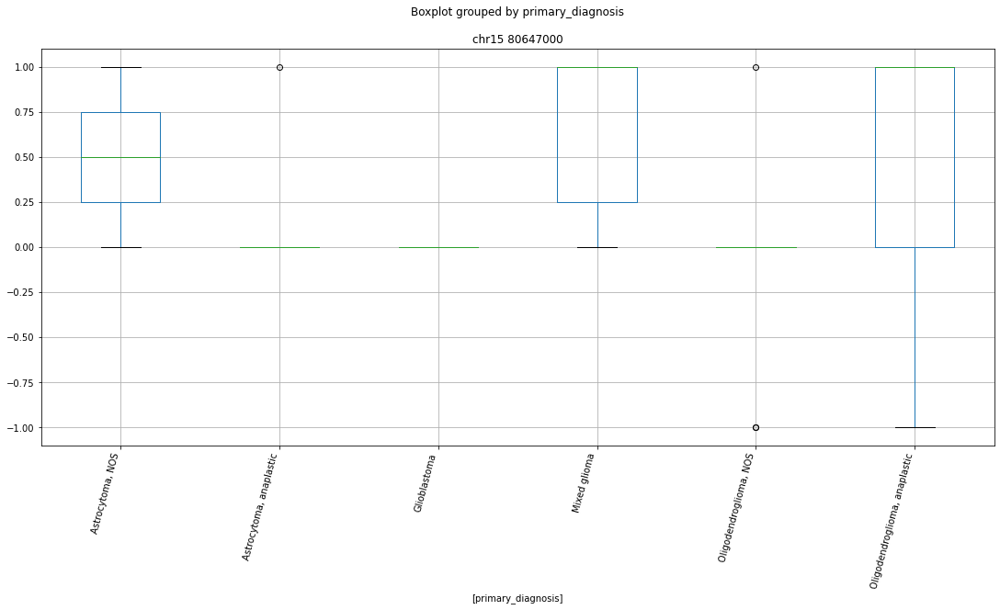

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr15 89296000


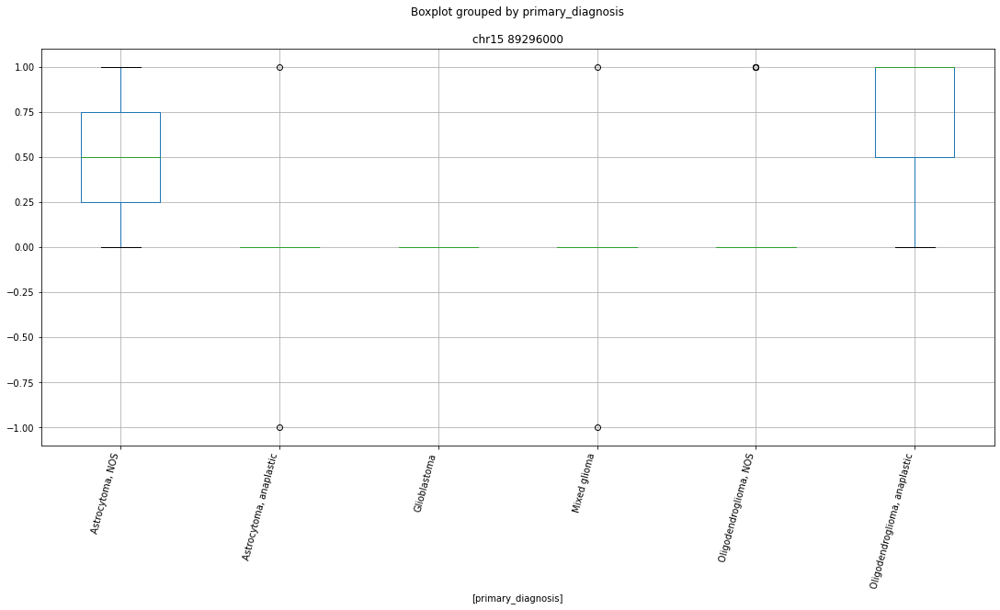

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr15 74729000


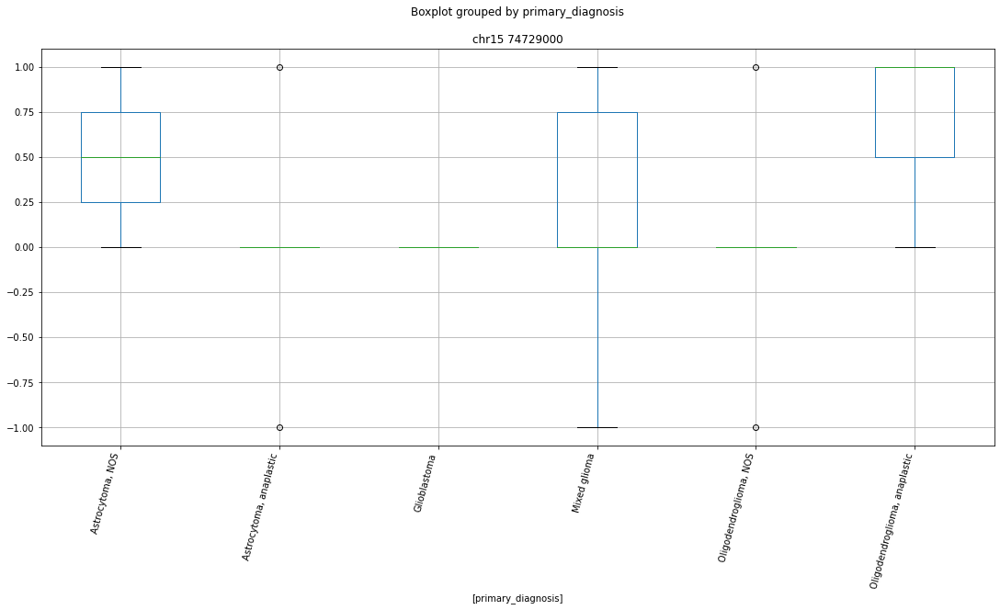

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr15 89978000


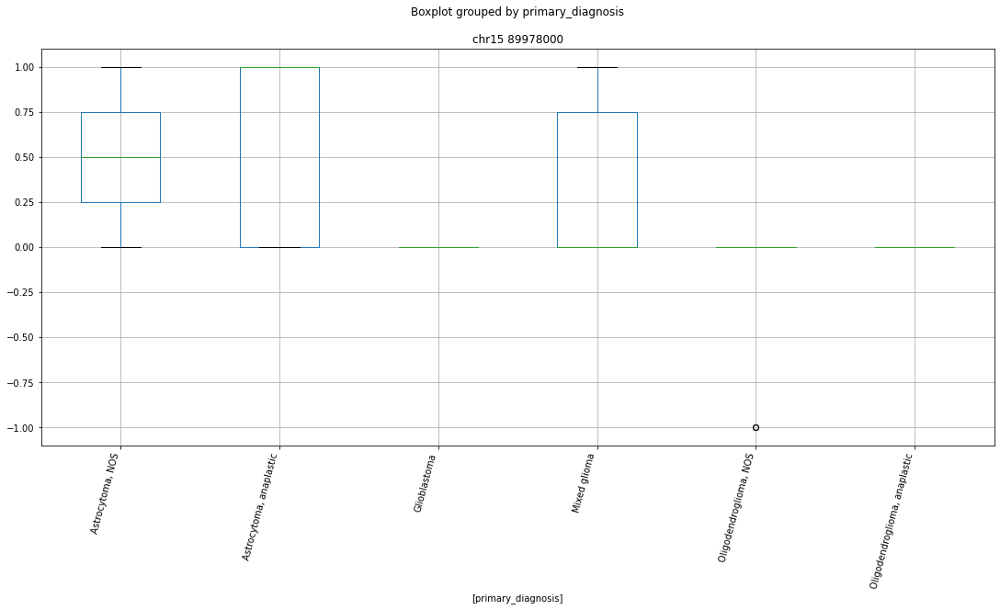

['chr15 100773000' 'chr15 27003000' 'chr15 28184000' 'chr15 34947000'
 'chr15 40643000' 'chr15 44229000' 'chr15 47133000' 'chr15 50158000'
 'chr15 51294000' 'chr15 56111000' 'chr15 58833000' 'chr15 58834000'
 'chr15 65226000' 'chr15 65227000' 'chr15 65734000' 'chr15 68859000'
 'chr15 74729000' 'chr15 74888000' 'chr15 75323000' 'chr15 75870000'
 'chr15 78222000' 'chr15 80647000' 'chr15 84673000' 'chr15 85730000'
 'chr15 89296000' 'chr15 89978000' 'chr15 90346000' 'chr15 92767000'
 'primary_diagnosis' 'subject']


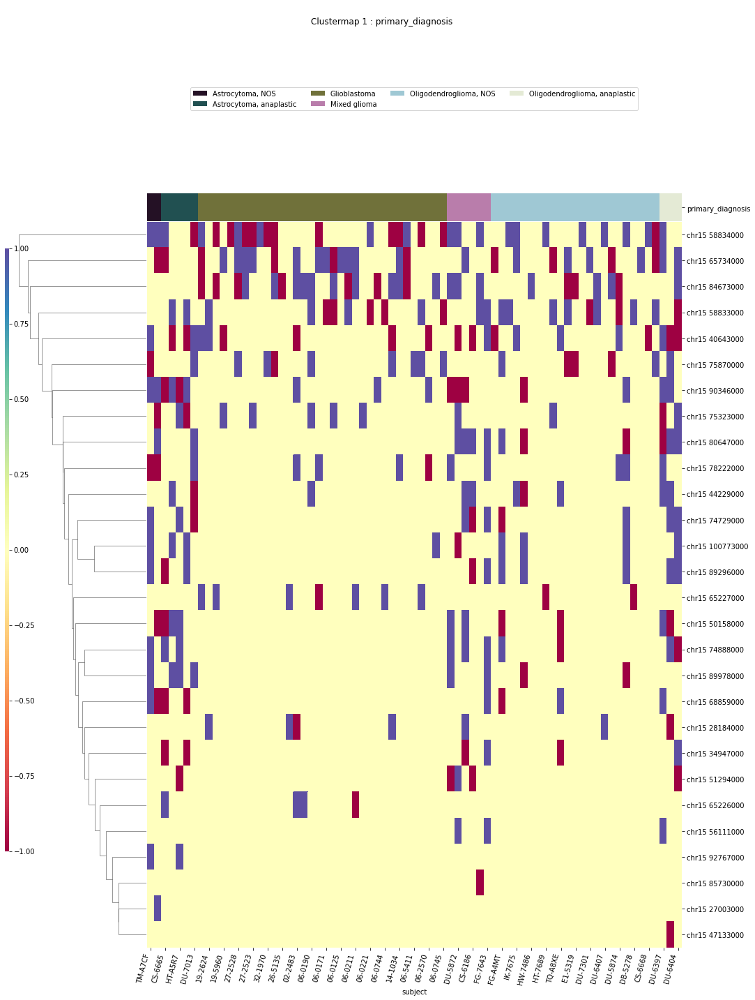

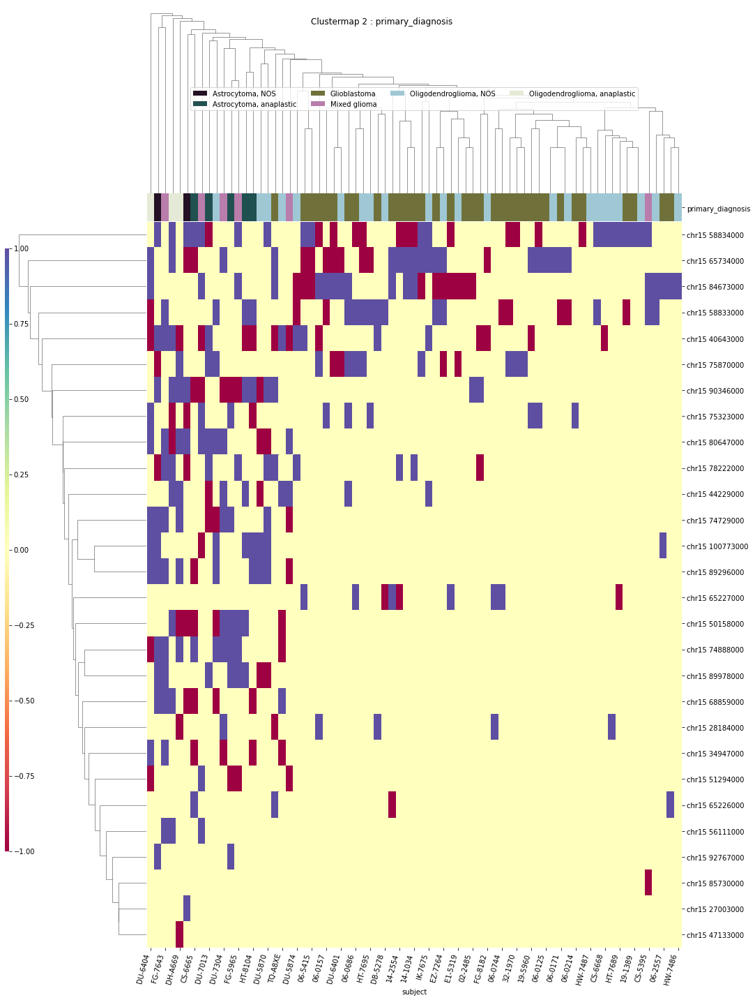

IDH
['IDH' 'chr15 58834000' 'chr15 74888000' 'chr15 75870000' 'subject']


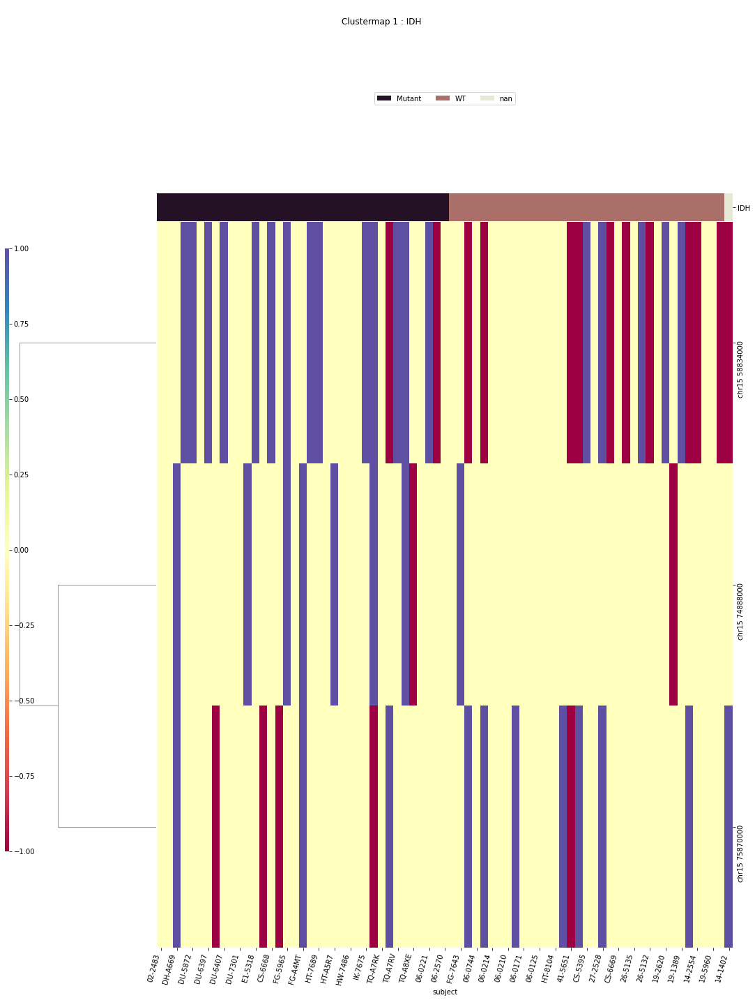

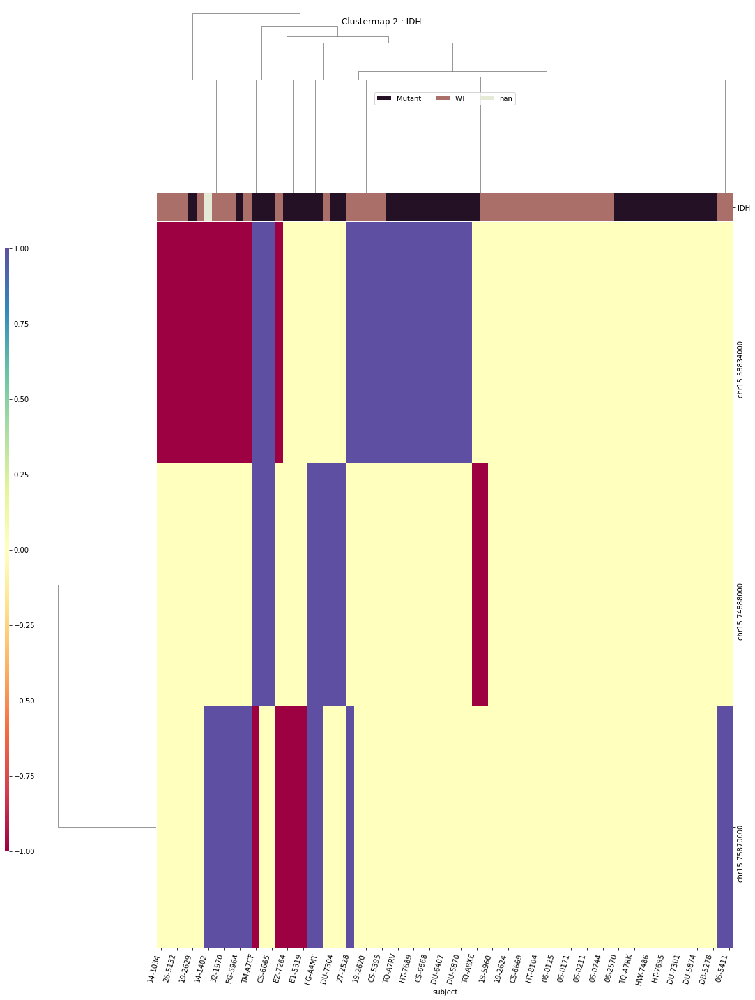

x1p19q
['chr15 47133000' 'chr15 88540000' 'chr15 96833000' 'subject' 'x1p19q']


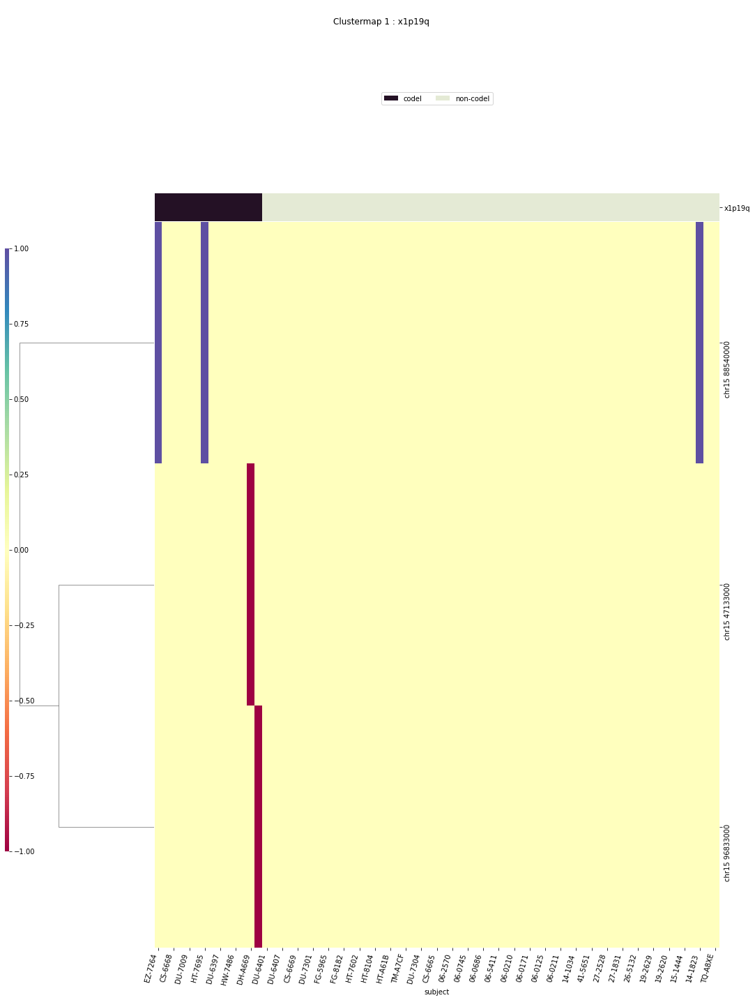

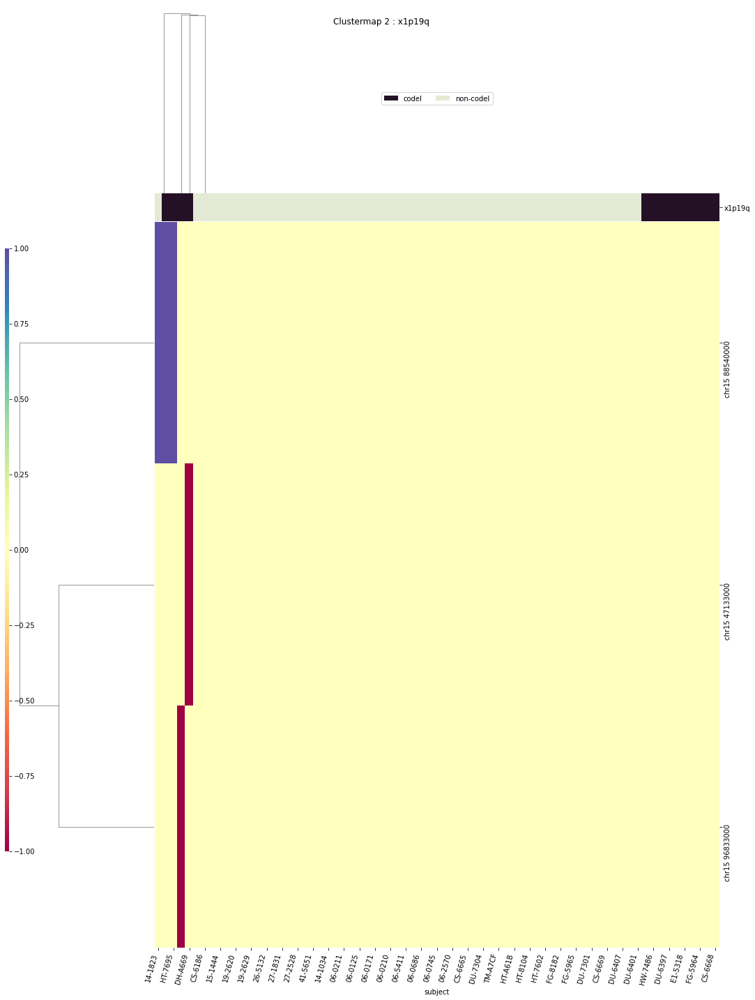

TERT
['TERT' 'chr15 58834000' 'chr15 65733000' 'chr15 75870000'
 'chr15 78222000' 'chr15 92767000' 'subject']


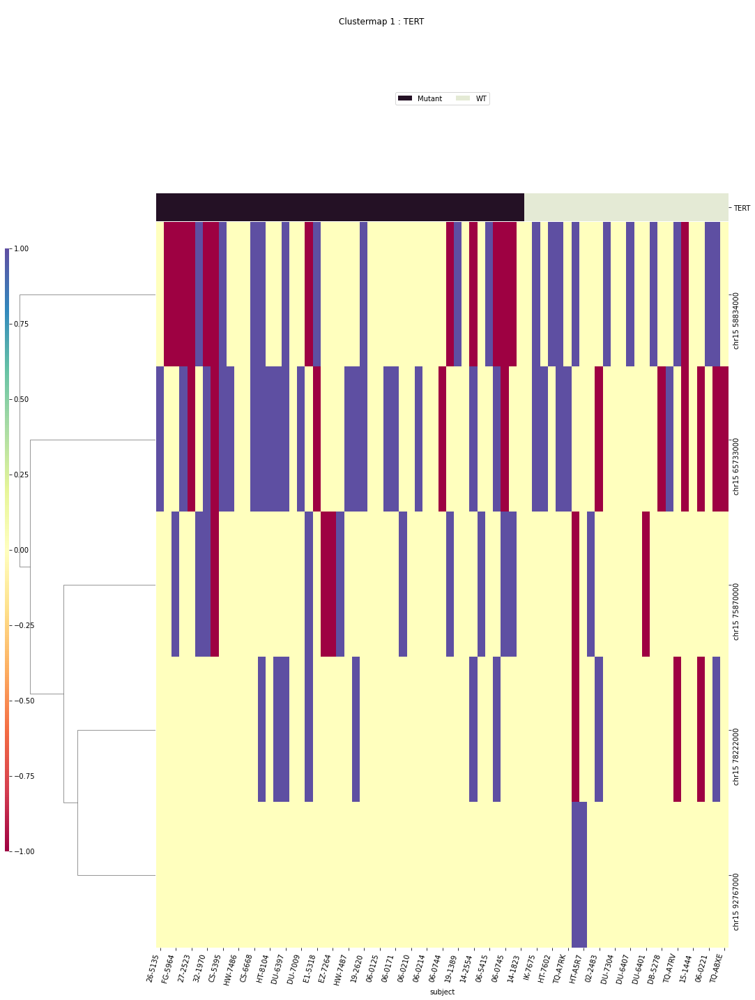

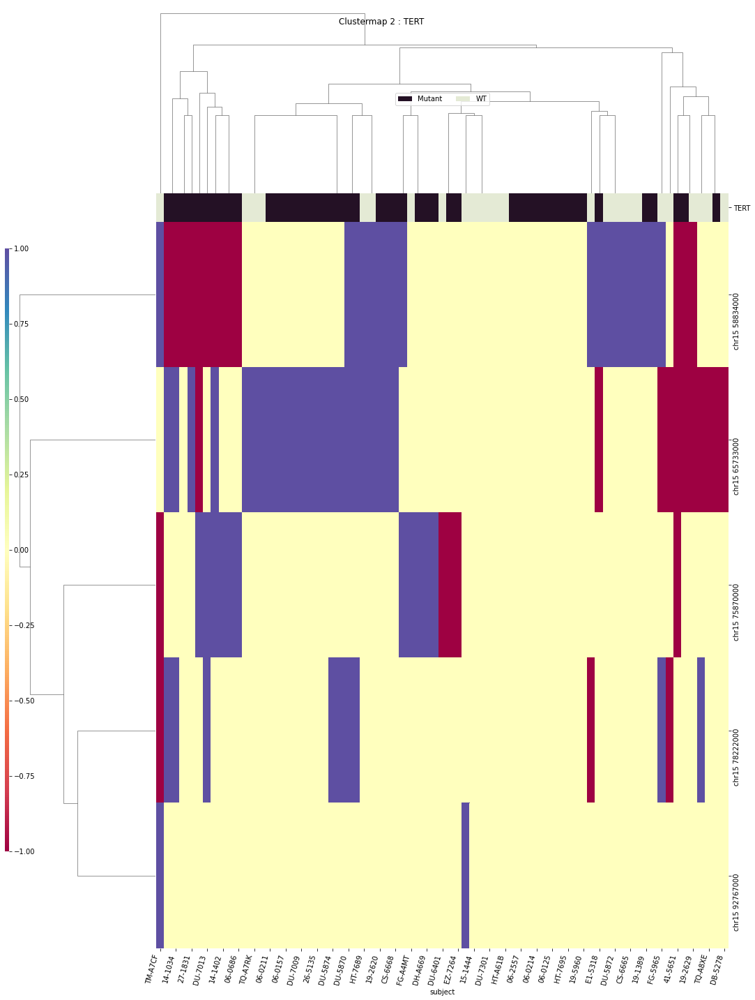

disease_type
['chr15 58833000' 'chr15 58834000' 'chr15 65227000' 'chr15 74888000'
 'chr15 89296000' 'disease_type' 'subject']


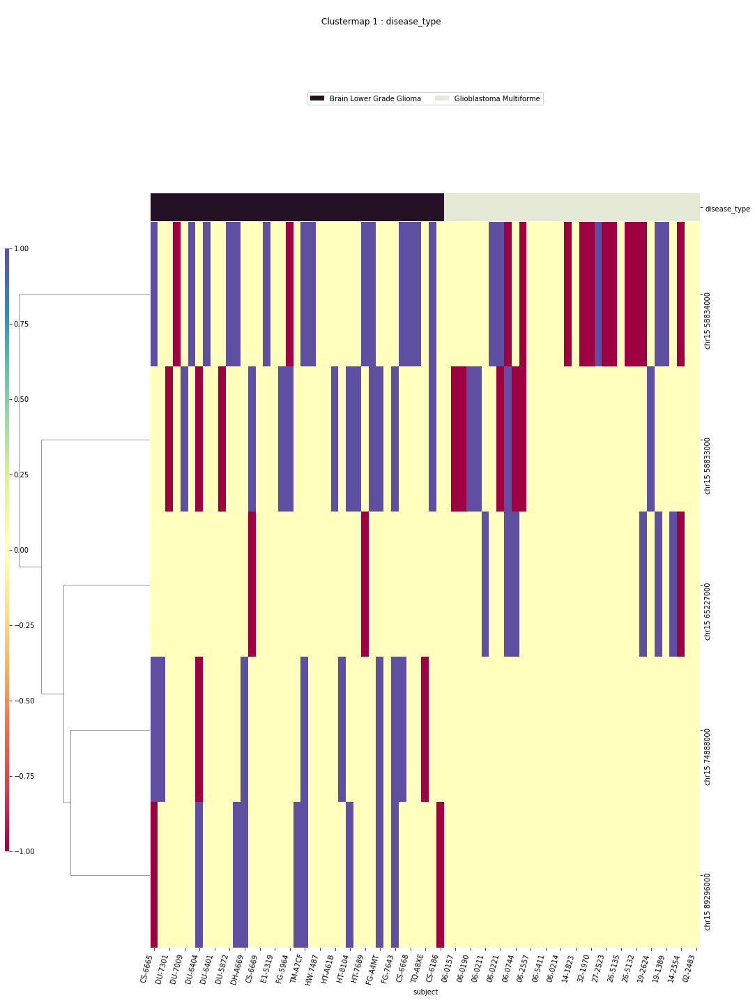

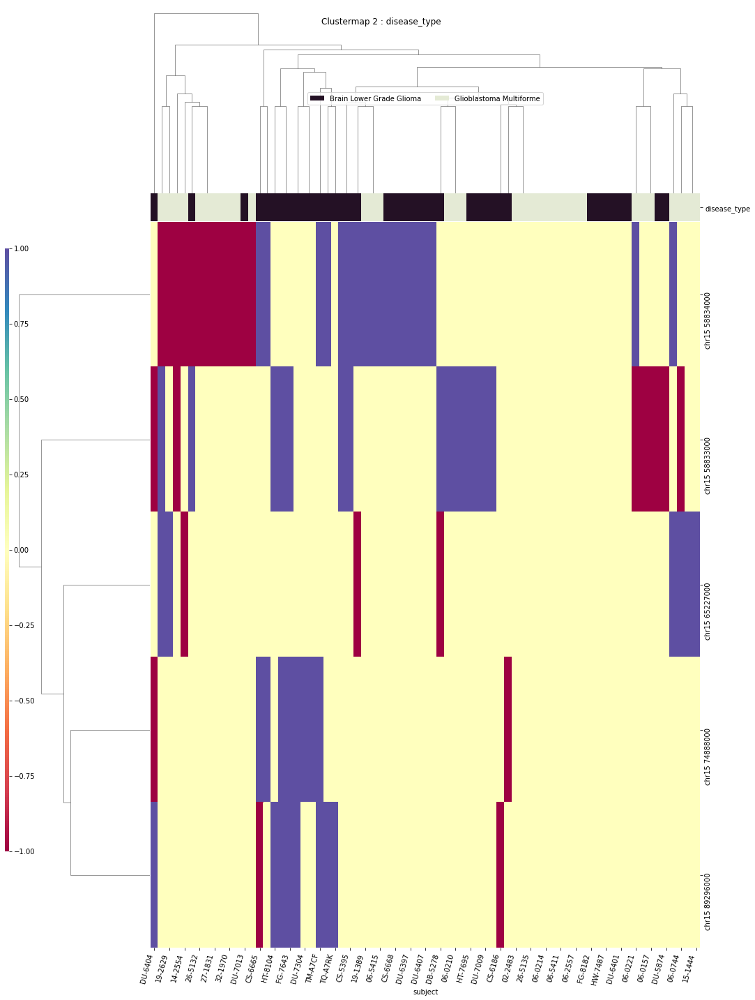

chr16
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr16 2399000


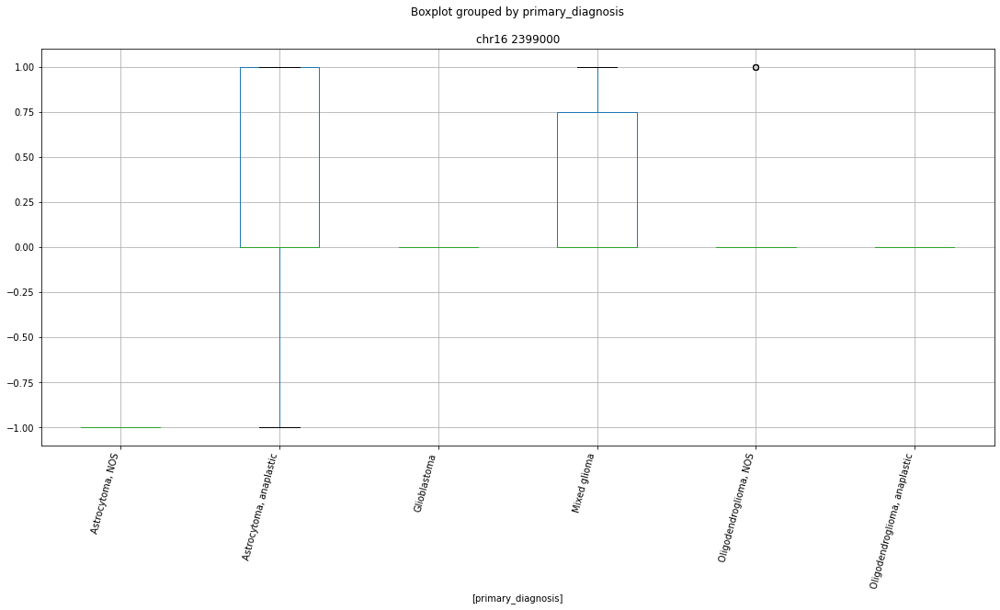

 p : 0.0  ( t : inf ) :  chr16 35204000


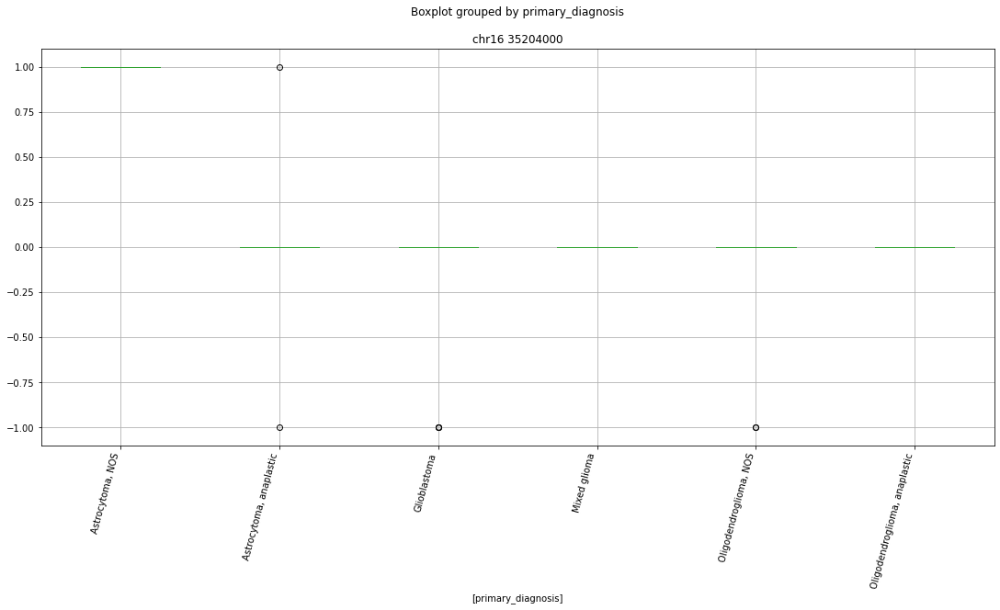

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr16 66955000


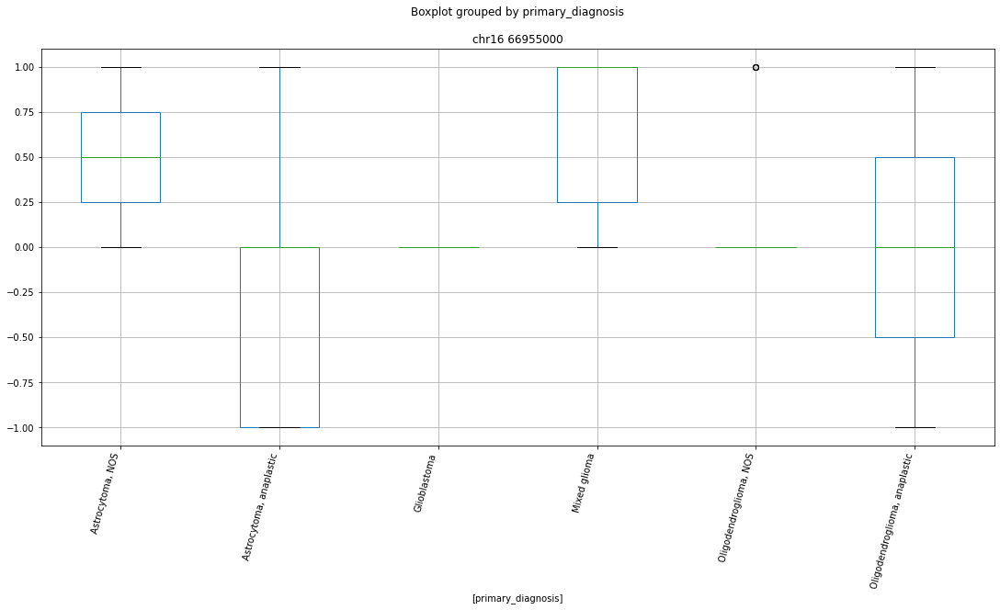

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr16 53698000


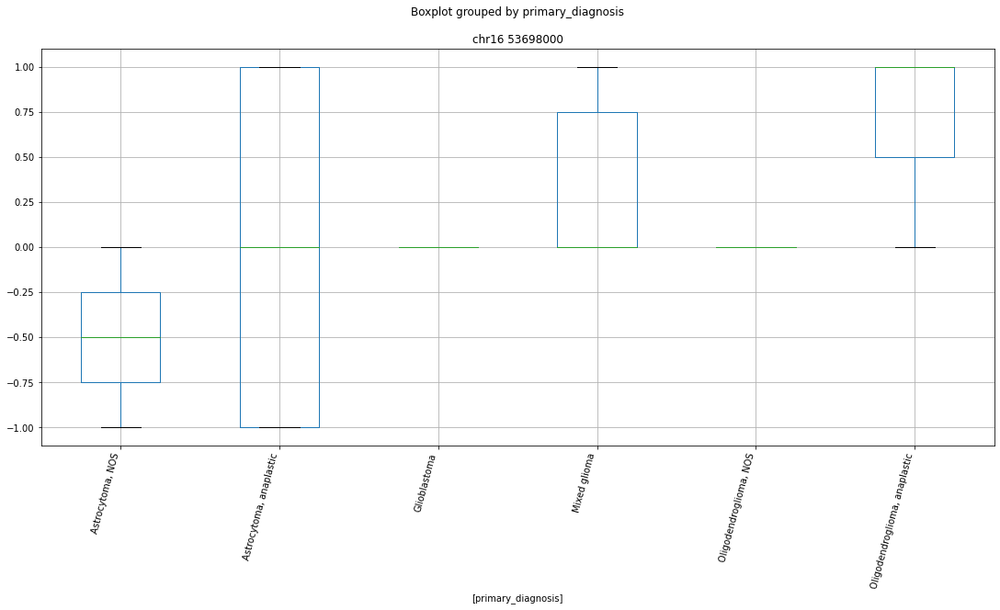

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr16 58395000


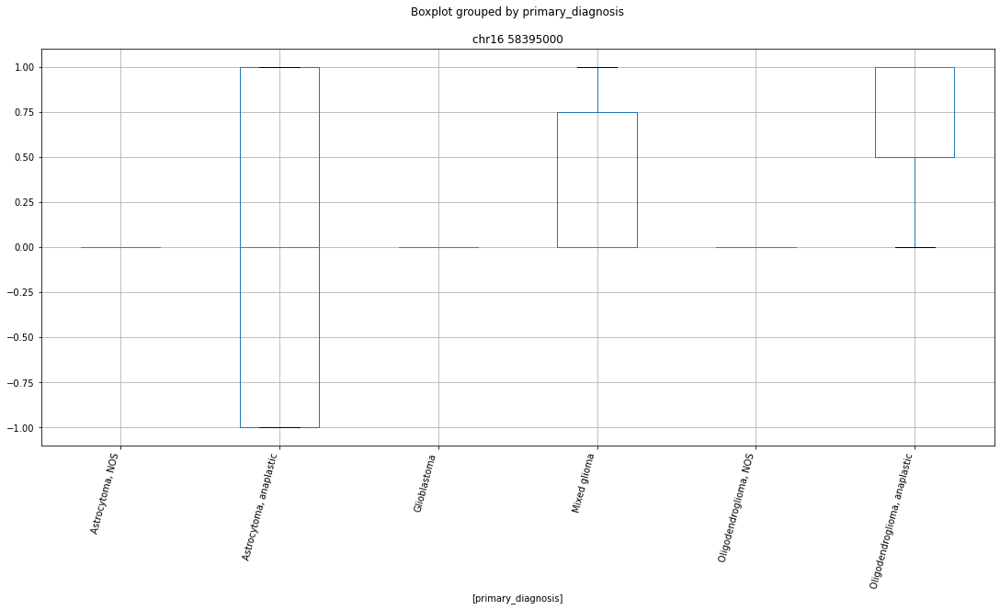

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr16 2801000


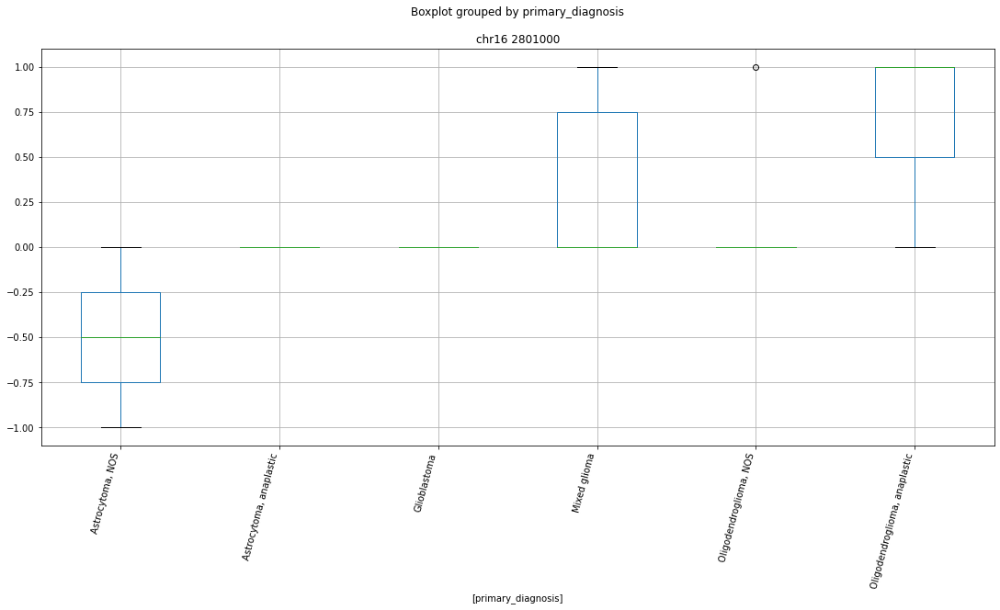

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr16 8115000


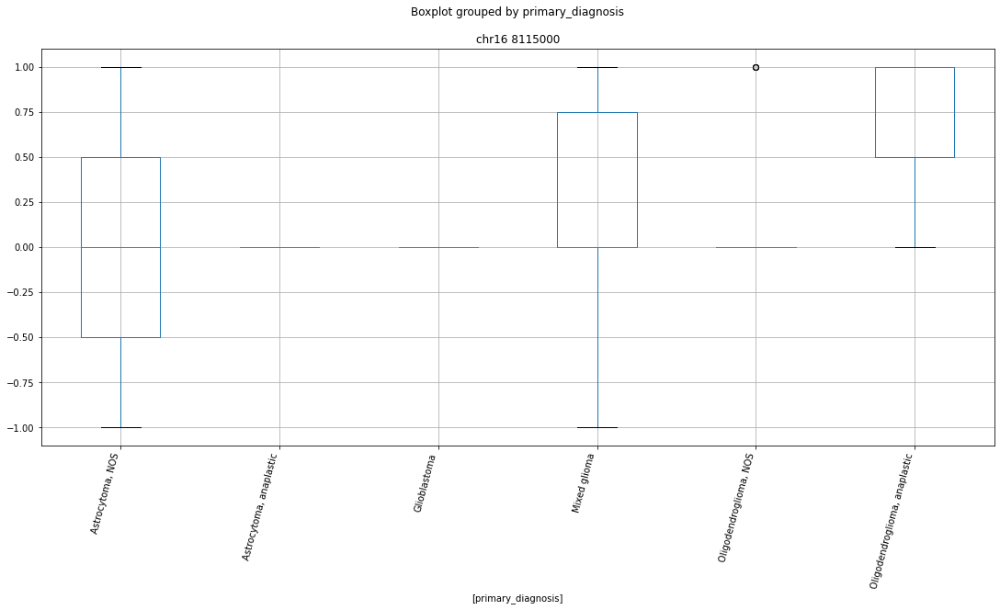

['chr16 10829000' 'chr16 11335000' 'chr16 14637000' 'chr16 21221000'
 'chr16 21222000' 'chr16 2219000' 'chr16 2399000' 'chr16 2801000'
 'chr16 28737000' 'chr16 2927000' 'chr16 31232000' 'chr16 31369000'
 'chr16 31836000' 'chr16 3271000' 'chr16 34245000' 'chr16 35154000'
 'chr16 35204000' 'chr16 35629000' 'chr16 35955000' 'chr16 35956000'
 'chr16 387000' 'chr16 4774000' 'chr16 47864000' 'chr16 48158000'
 'chr16 5202000' 'chr16 53698000' 'chr16 57200000' 'chr16 58395000'
 'chr16 66955000' 'chr16 69280000' 'chr16 70052000' 'chr16 70224000'
 'chr16 72497000' 'chr16 74799000' 'chr16 75816000' 'chr16 8115000'
 'chr16 83879000' 'primary_diagnosis' 'subject']


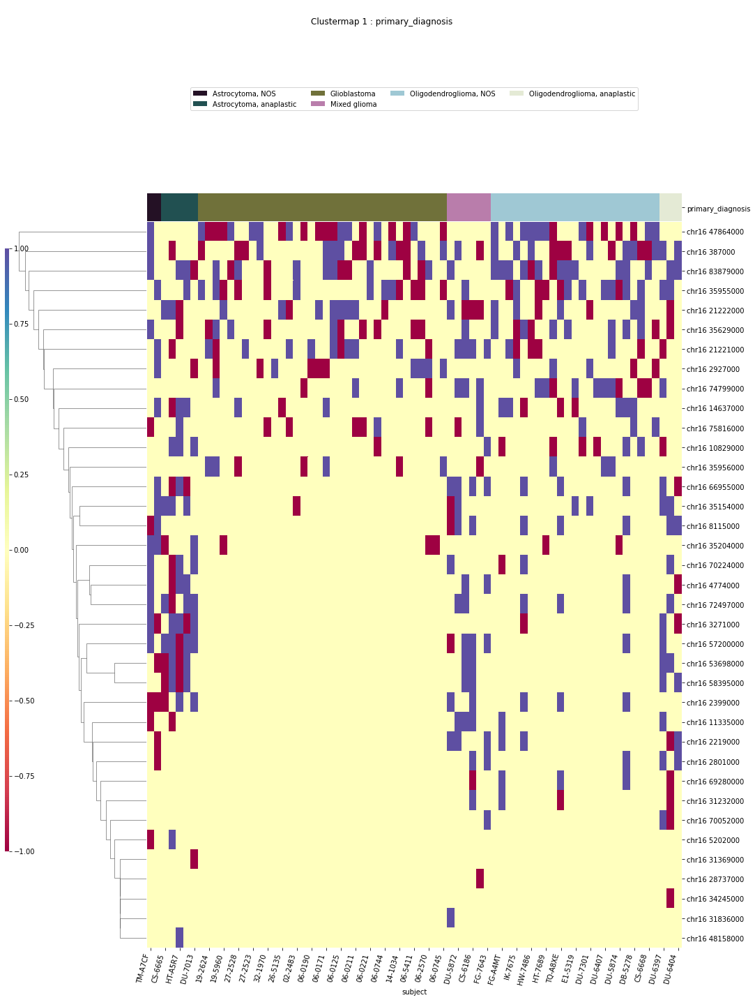

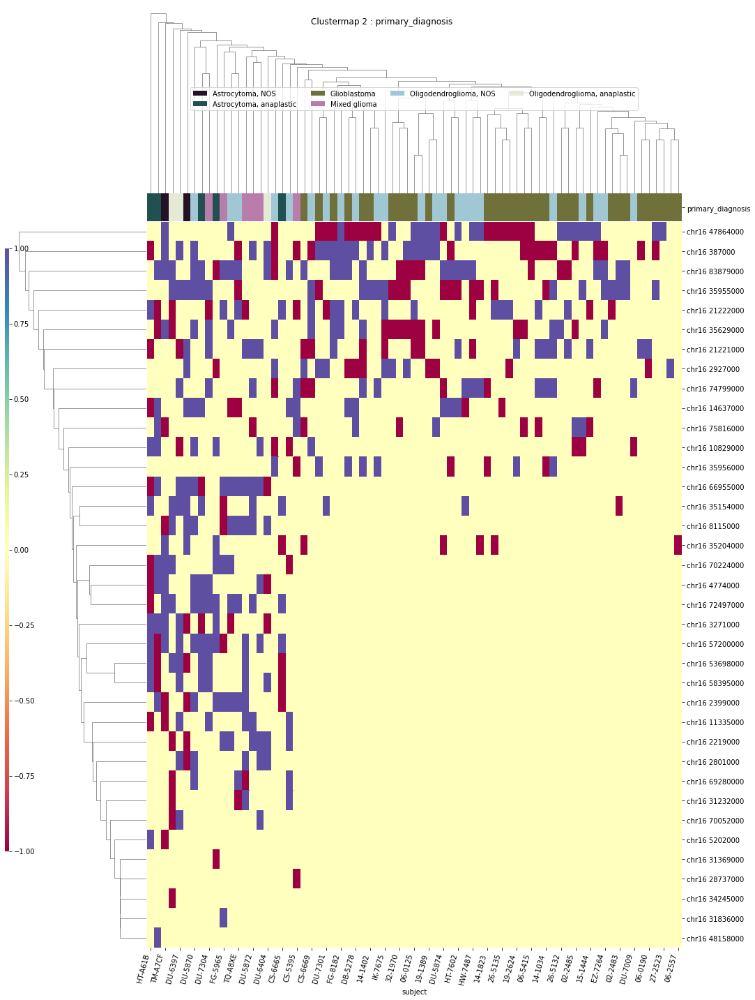

IDH
['IDH' 'chr16 21221000' 'chr16 2928000' 'chr16 35955000' 'chr16 66955000'
 'chr16 74800000' 'chr16 83879000' 'chr16 89806000' 'subject']


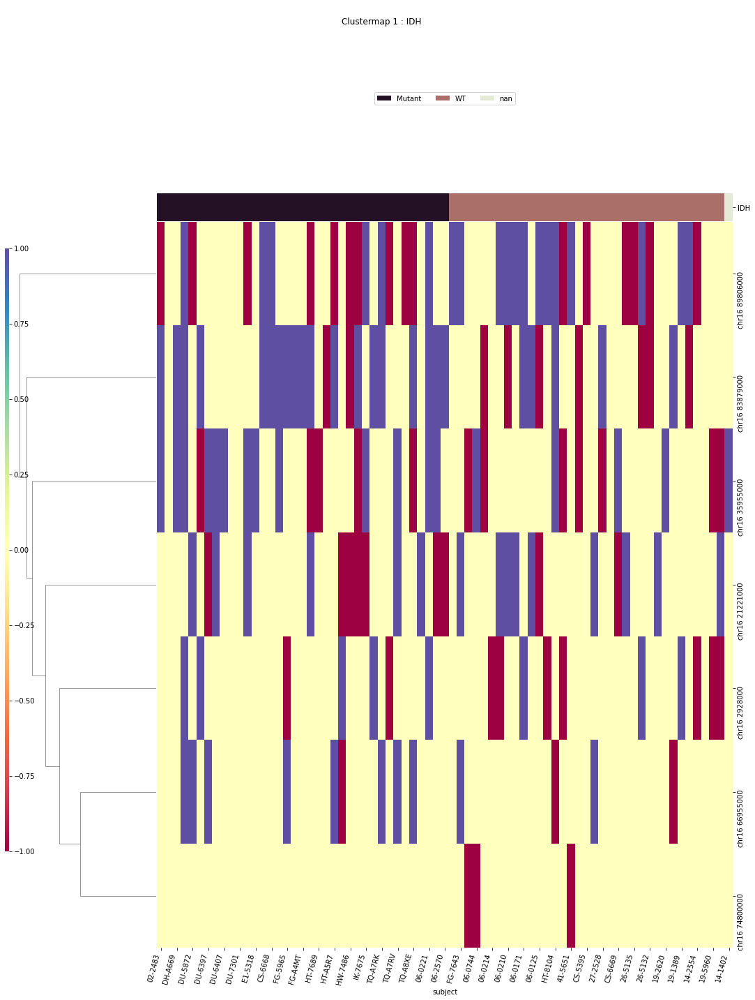

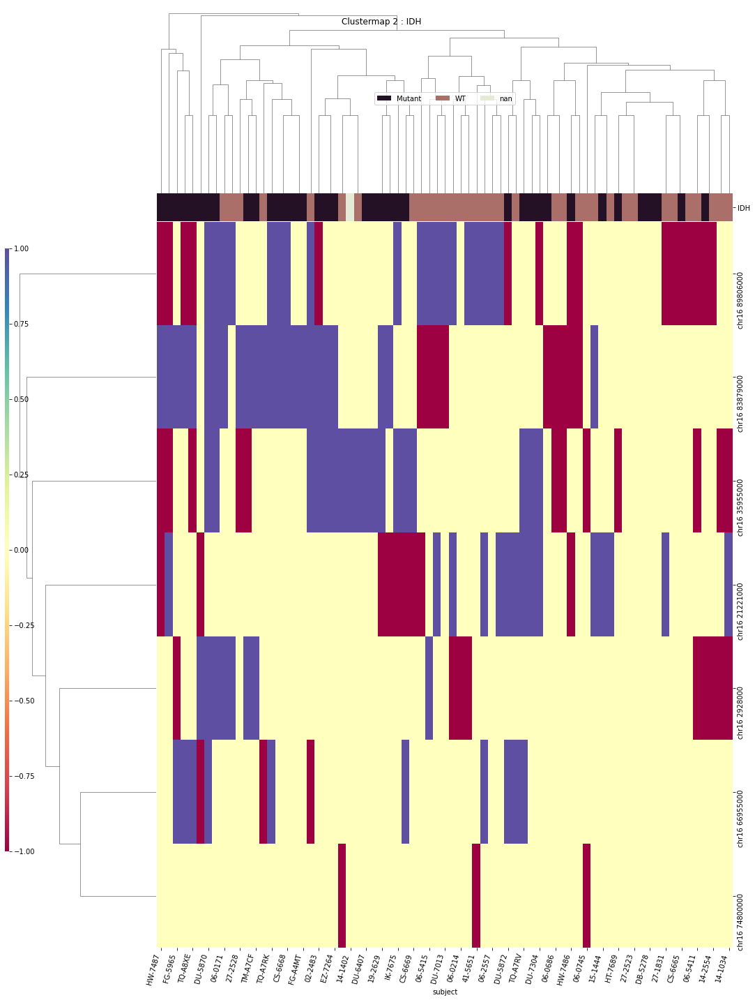

x1p19q
['chr16 10829000' 'chr16 21221000' 'chr16 23599000' 'chr16 28417000'
 'chr16 34245000' 'chr16 34412000' 'chr16 34999000' 'chr16 56739000'
 'chr16 5755000' 'chr16 75816000' 'subject' 'x1p19q']


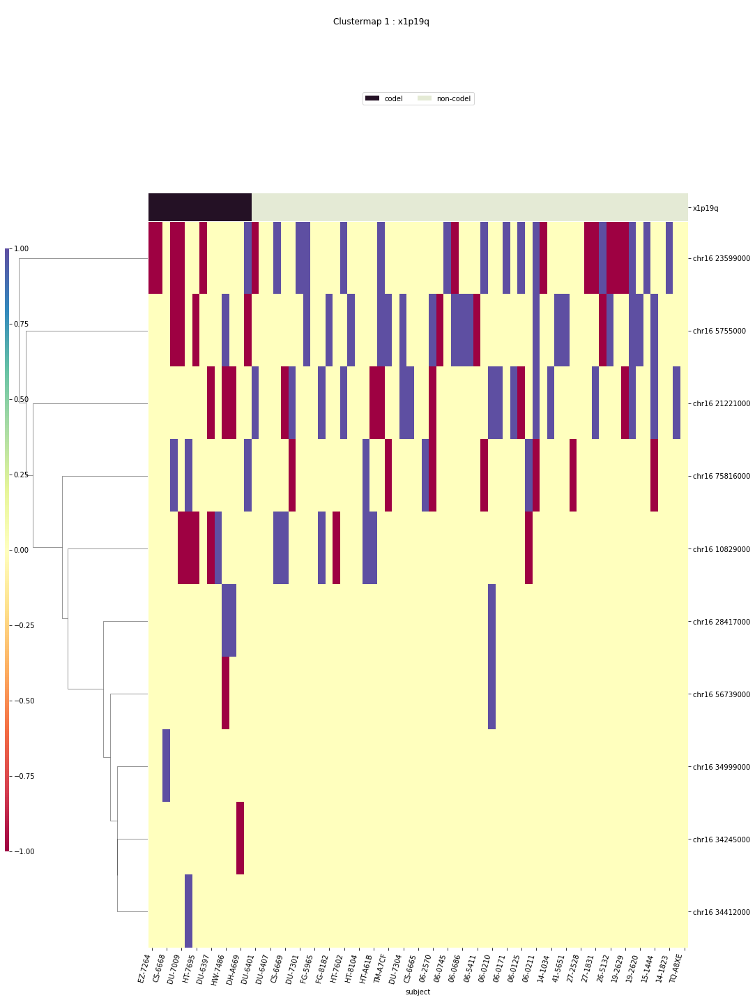

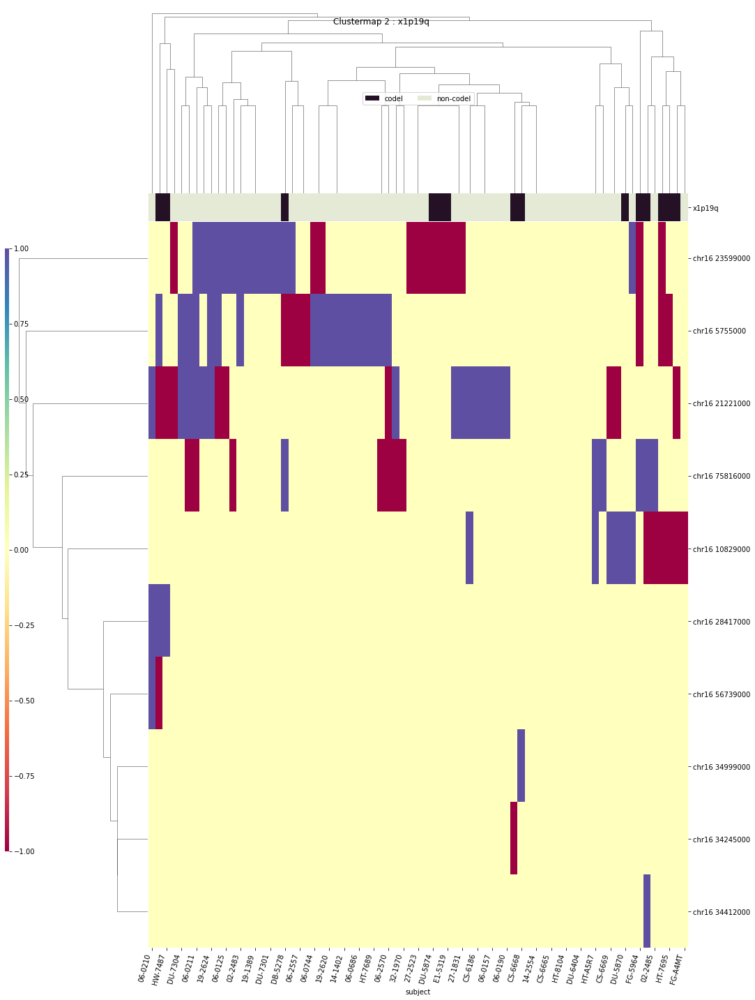

TERT
['TERT' 'chr16 2219000' 'chr16 28697000' 'chr16 35629000' 'chr16 5755000'
 'chr16 83879000' 'chr16 89806000' 'subject']


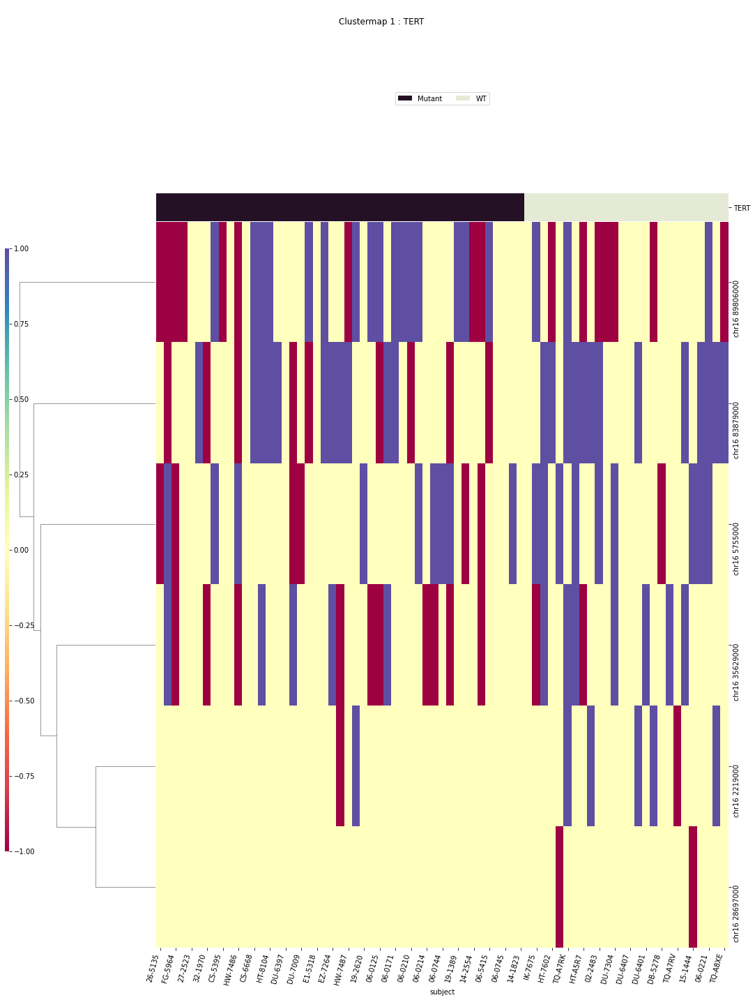

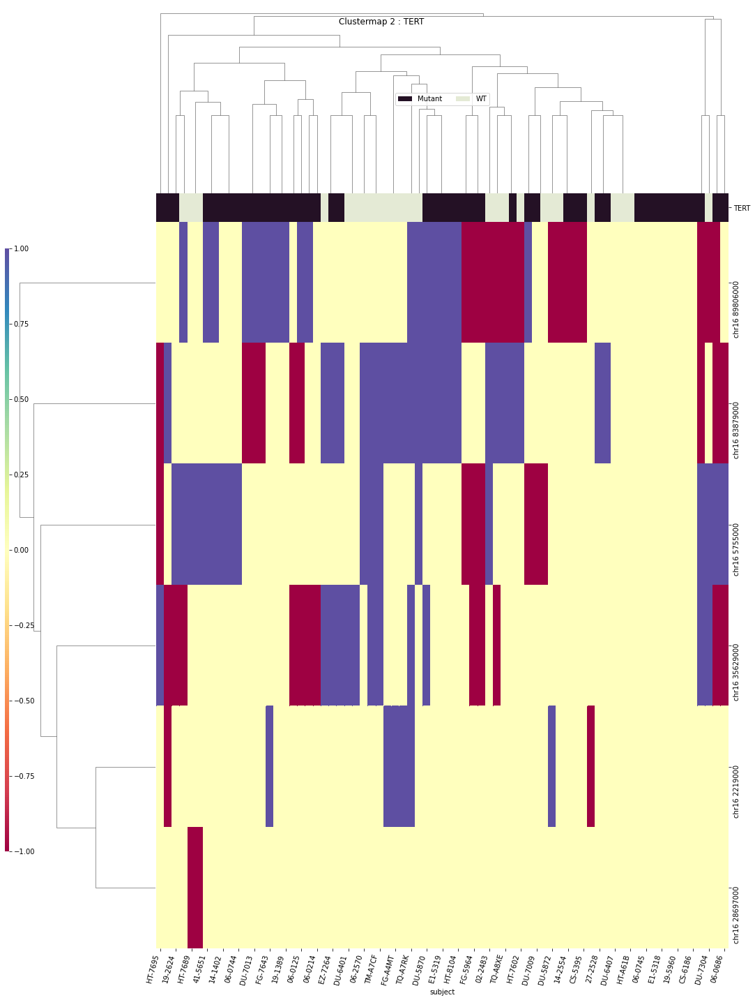

disease_type
['chr16 35154000' 'chr16 57200000' 'chr16 66955000' 'chr16 72497000'
 'chr16 74800000' 'chr16 75816000' 'chr16 8115000' 'chr16 83879000'
 'disease_type' 'subject']


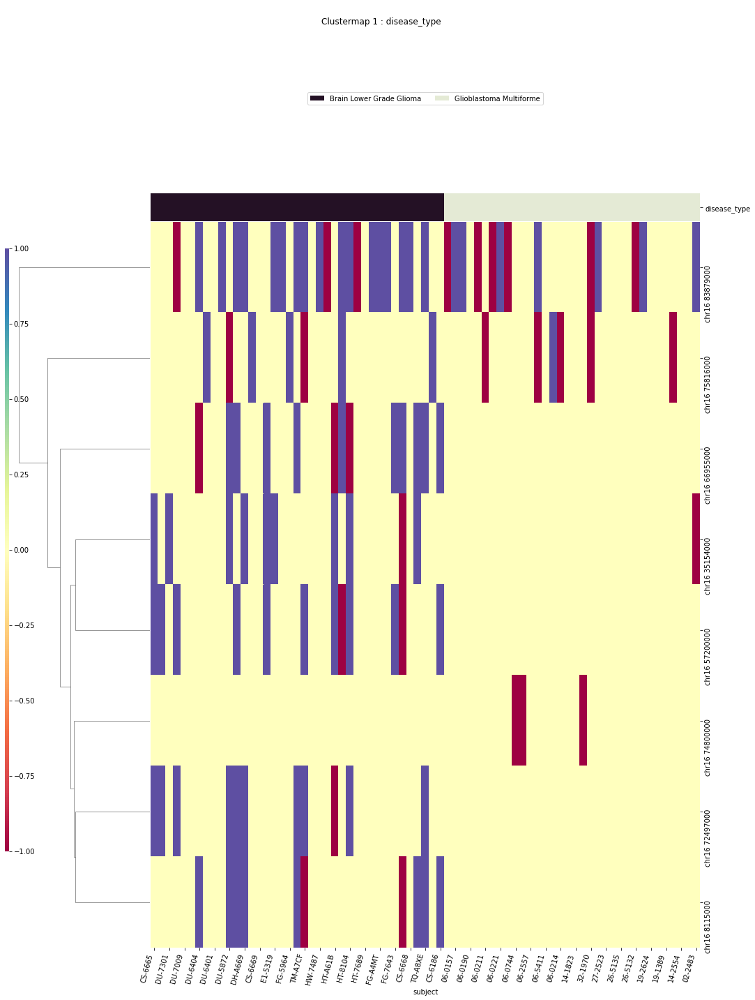

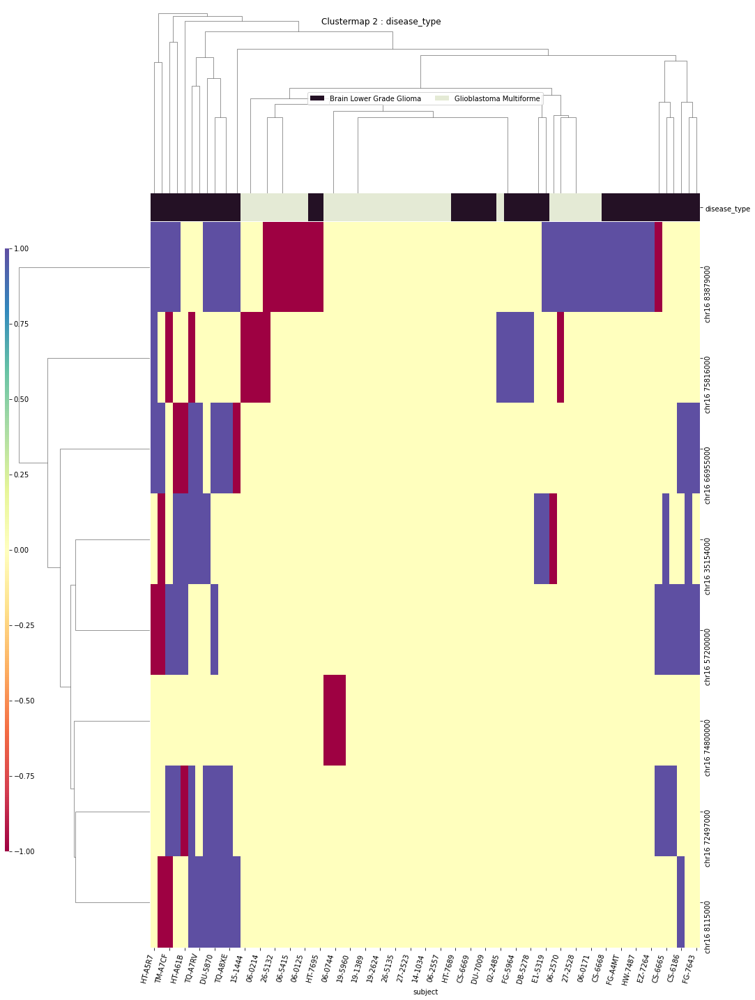

chr16_KI270728v1_random
HERVK113
primary_diagnosis
['chr16_KI270728v1_random 1769000' 'primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'chr16_KI270728v1_random 1769000' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chr17
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr17 80537000


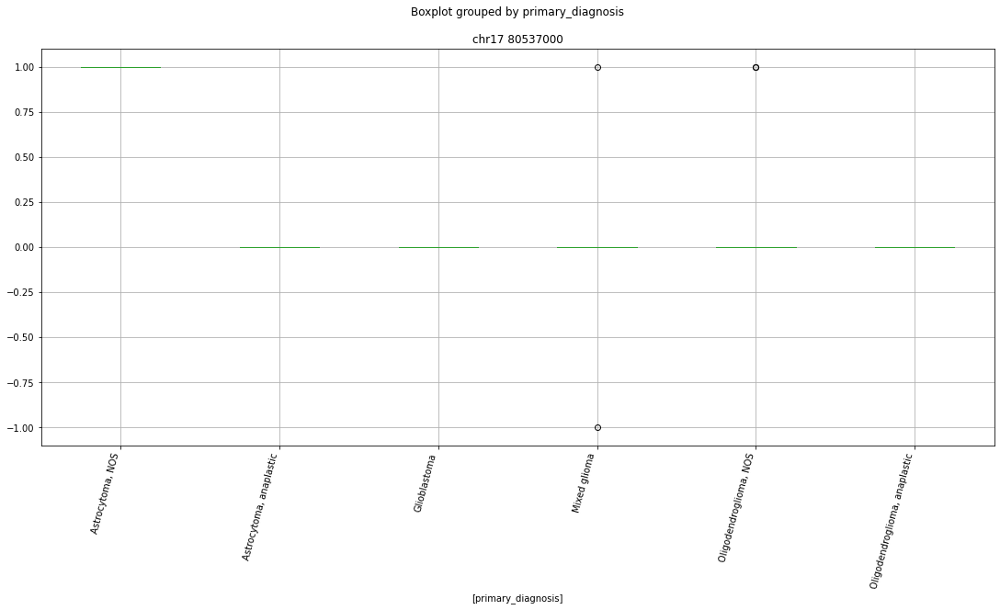

 p : 0.0  ( t : inf ) :  chr17 7088000


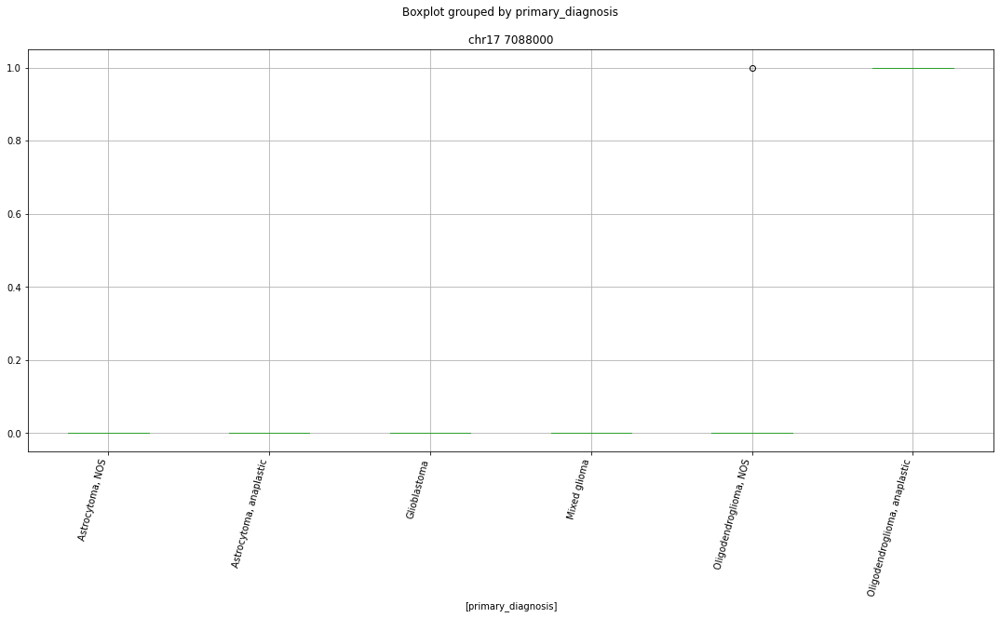

 p : 0.0  ( t : inf ) :  chr17 4578000


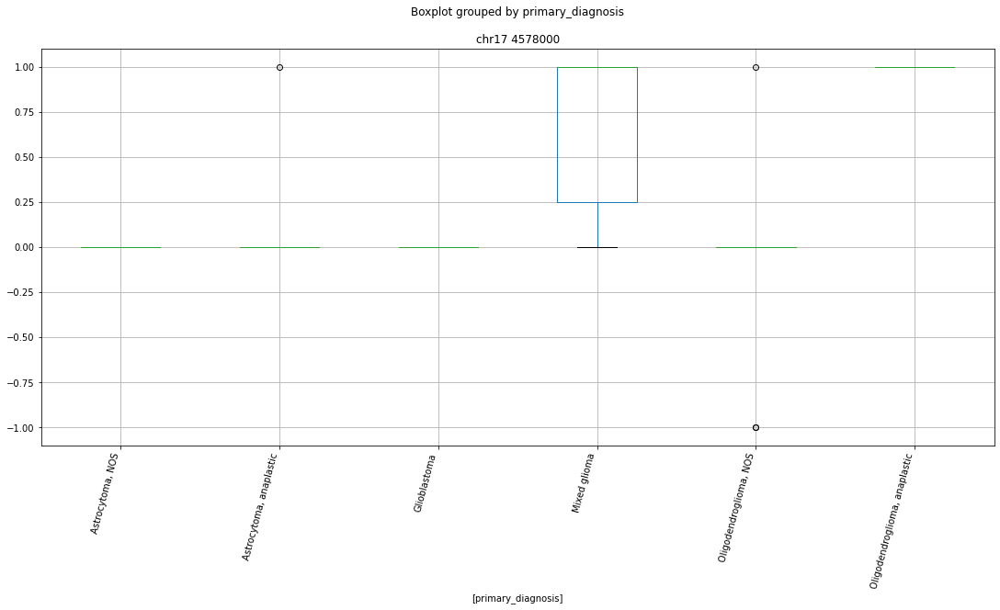

 p : 0.0  ( t : inf ) :  chr17 81618000


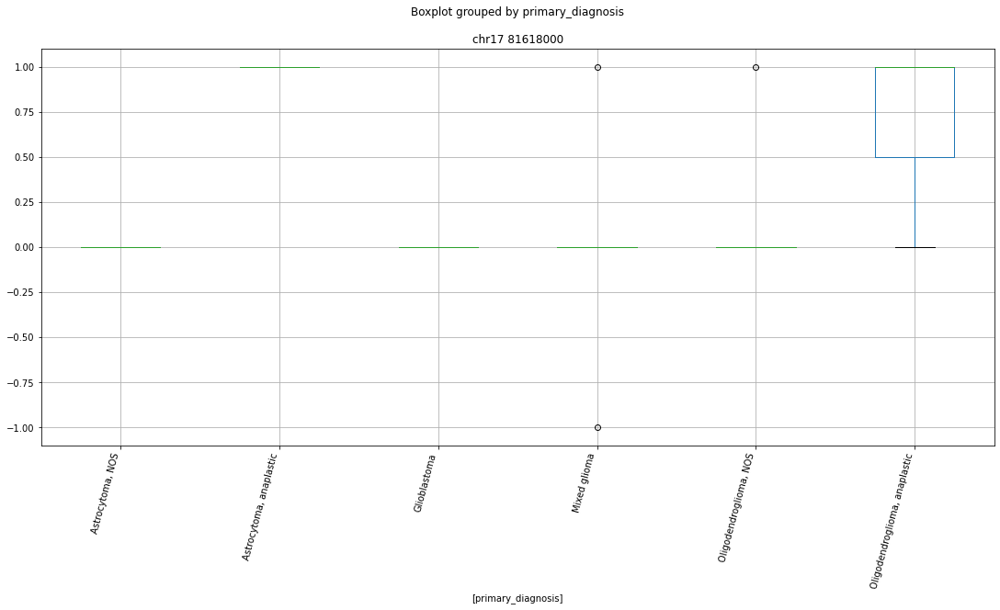

 p : 0.0  ( t : inf ) :  chr17 5143000


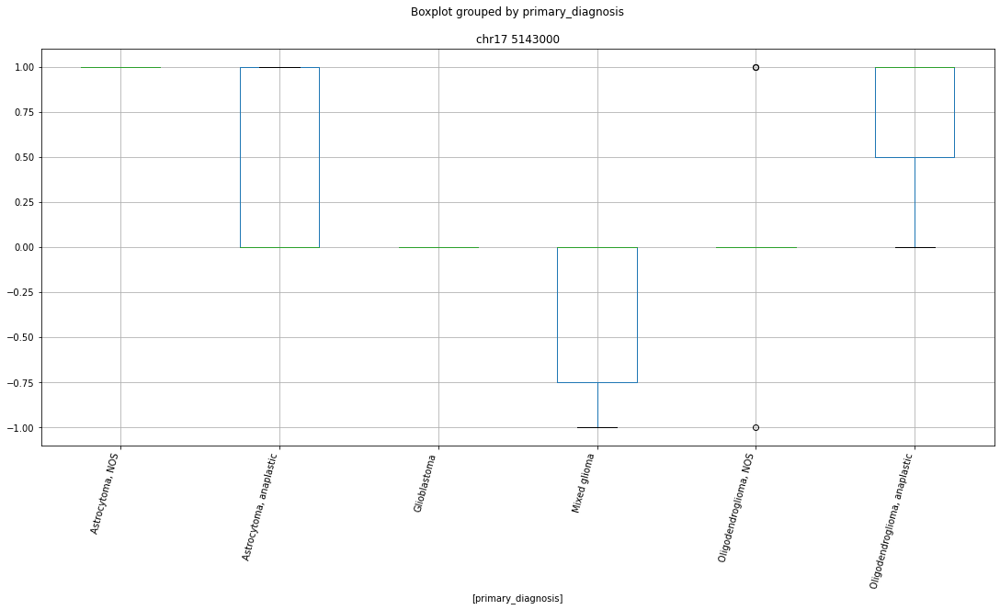

 p : 0.0  ( t : inf ) :  chr17 3465000


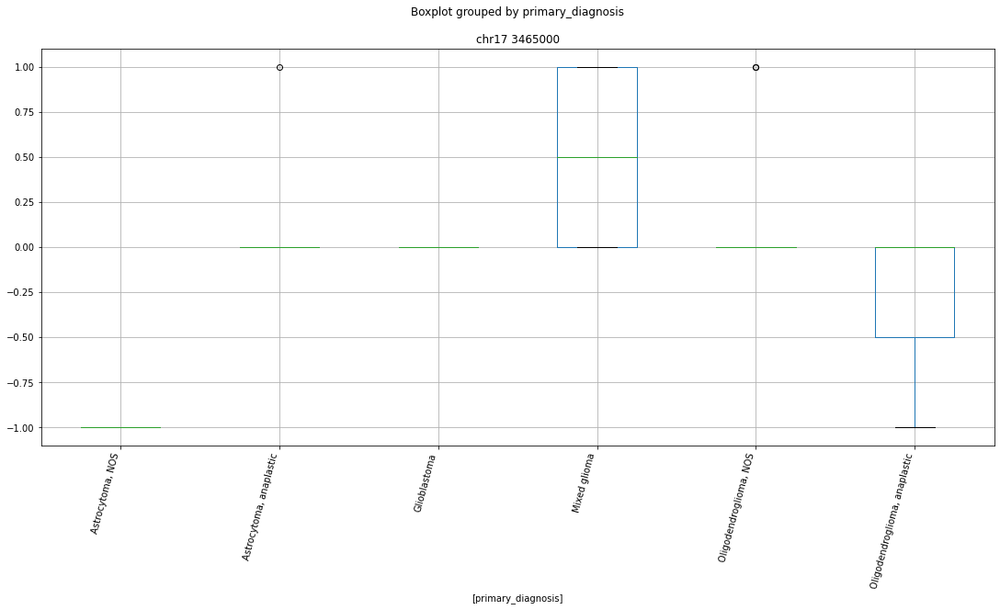

 p : 1.2735213637763693e-13  ( t : 11.358945418727965 ) :  chr17 19519000


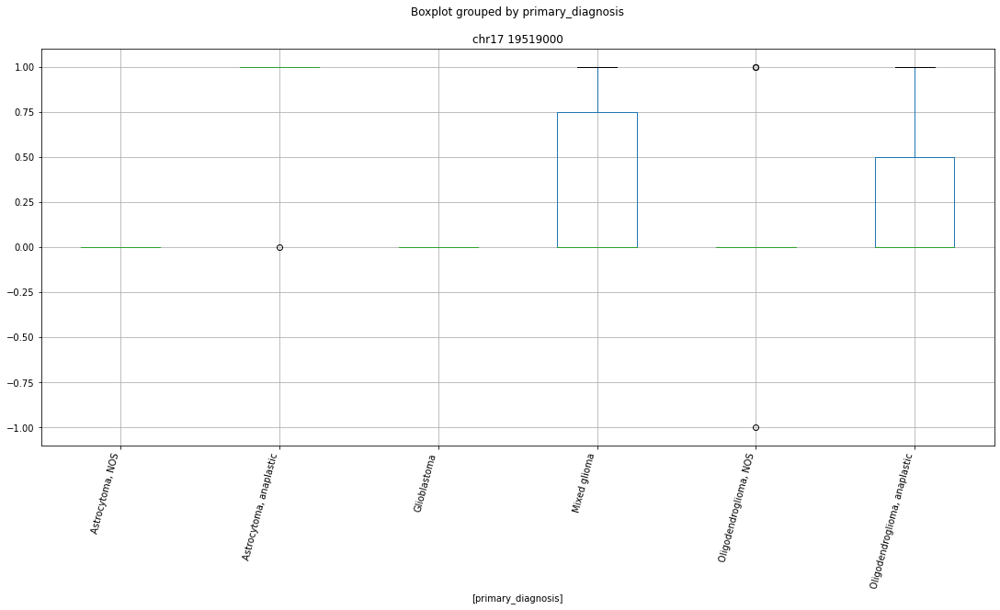

 p : 1.6993364715758493e-10  ( t : 10.106574946185138 ) :  chr17 81618000


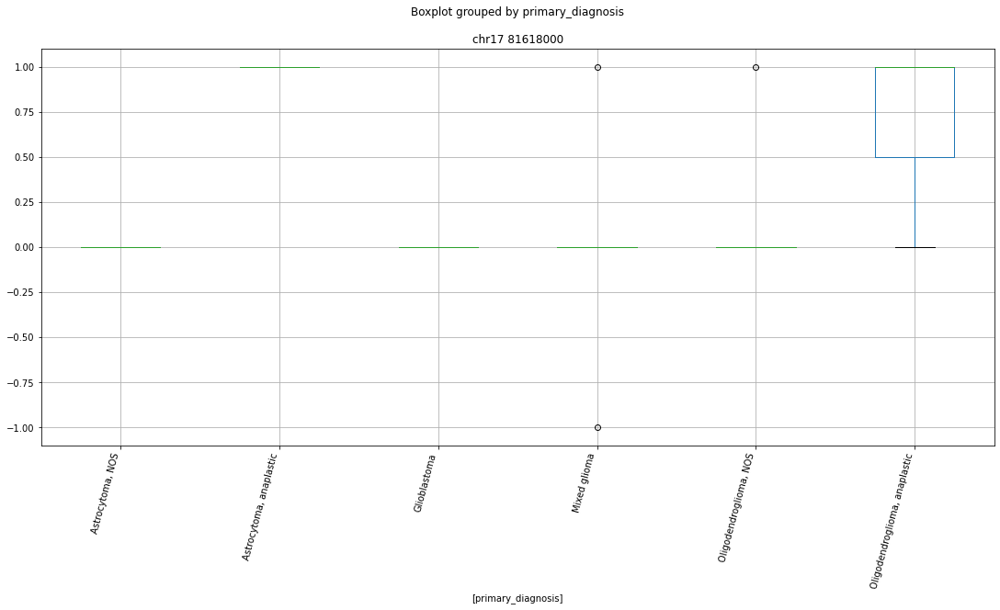

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr17 4578000


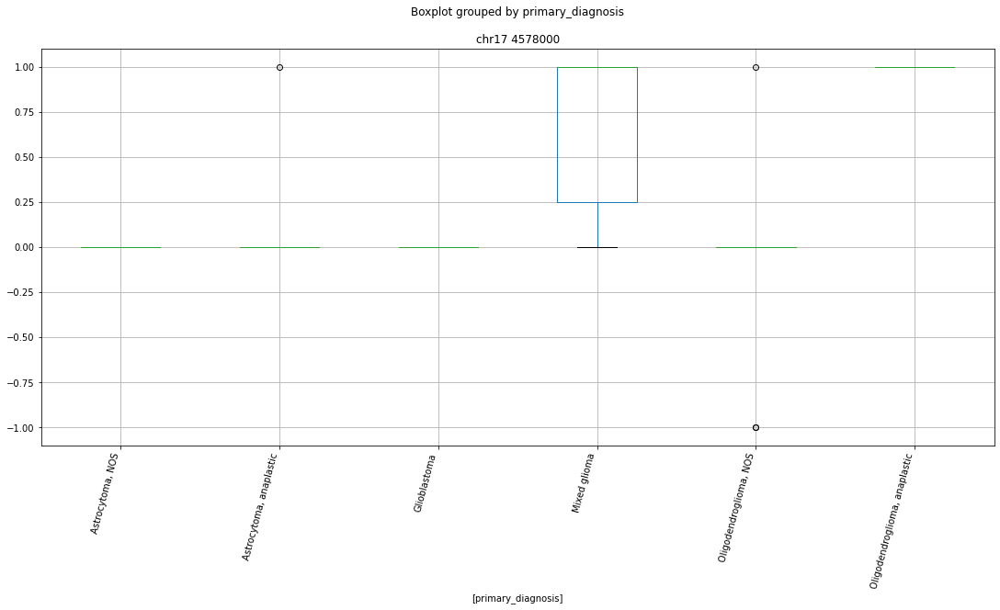

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr17 5143000


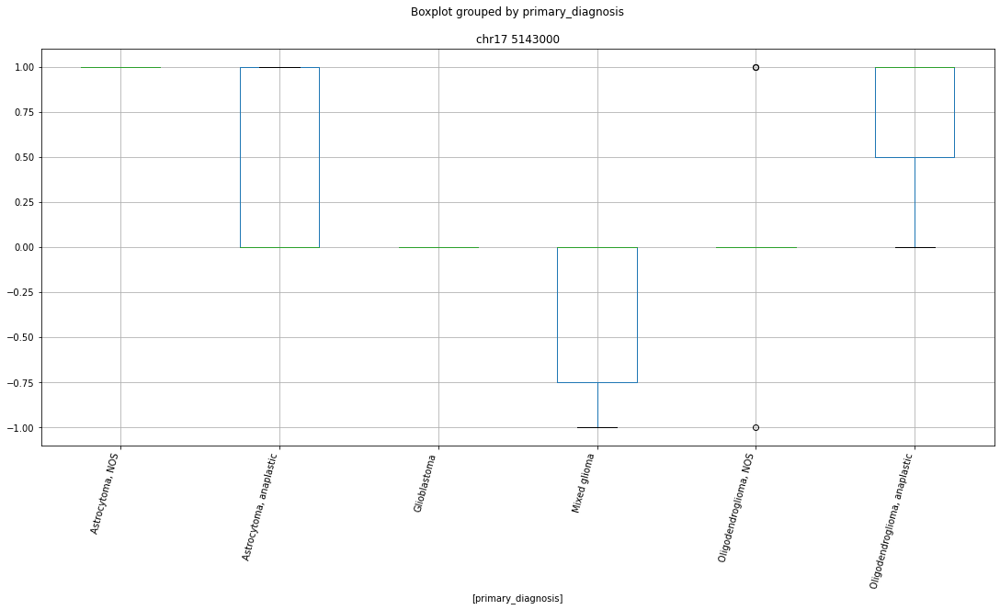

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr17 62073000


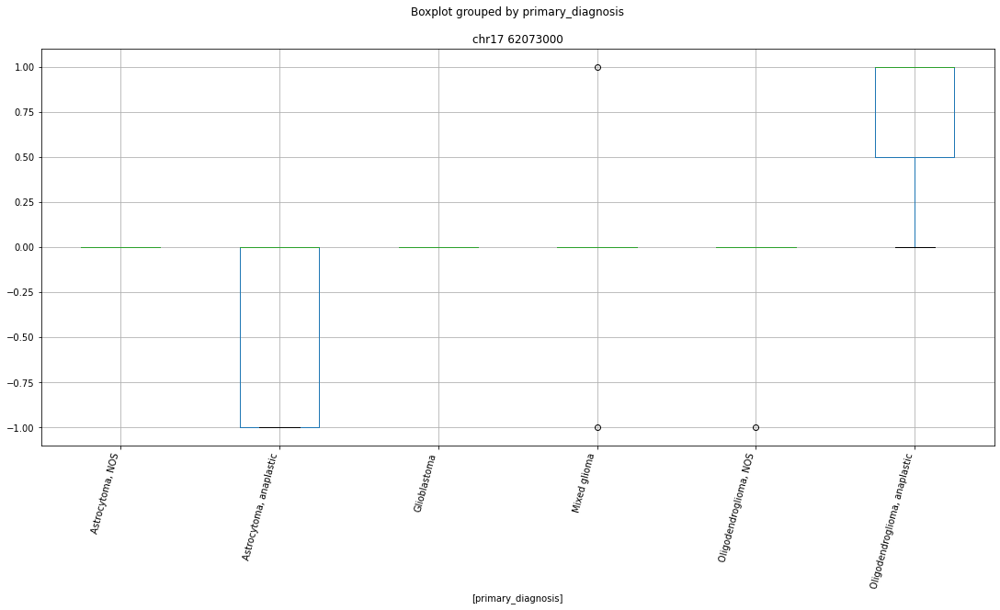

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr17 16095000


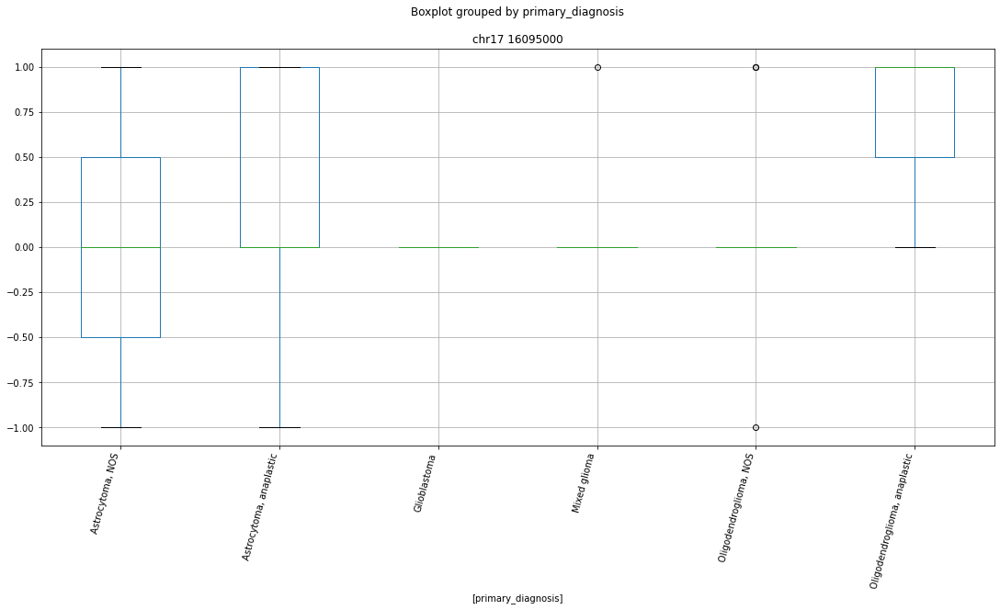

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr17 16311000


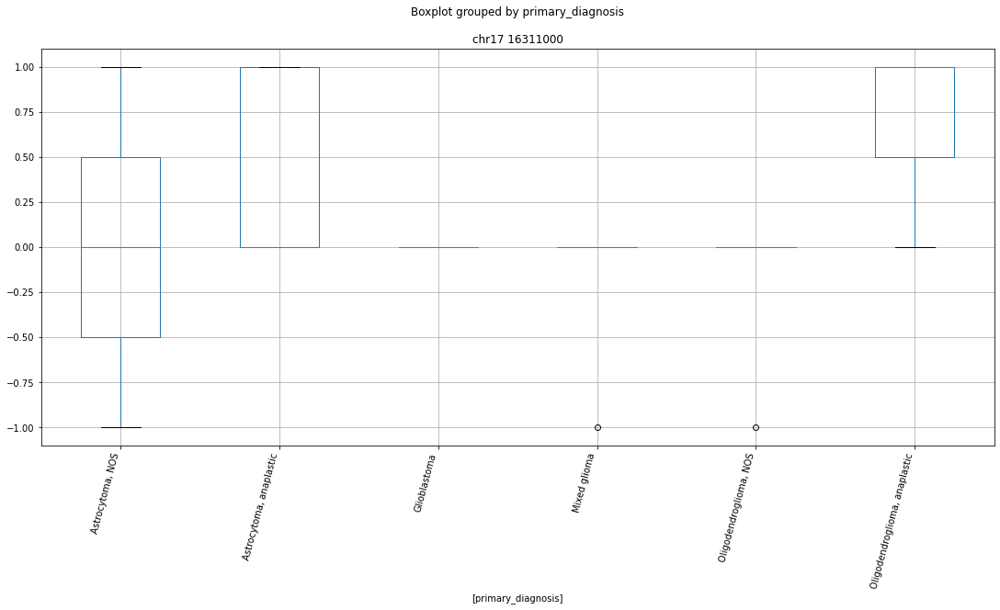

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr17 81618000


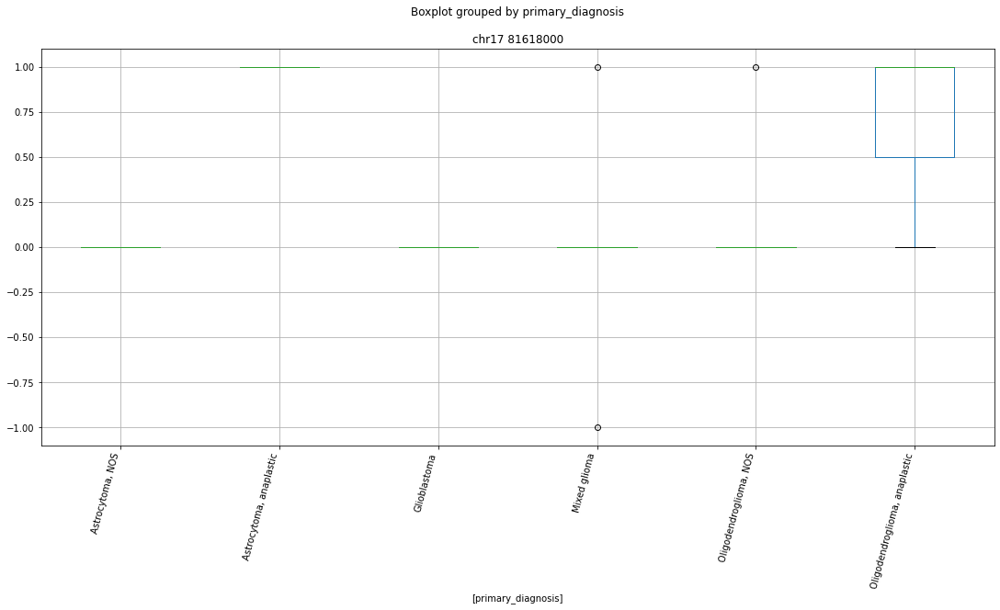

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr17 3564000


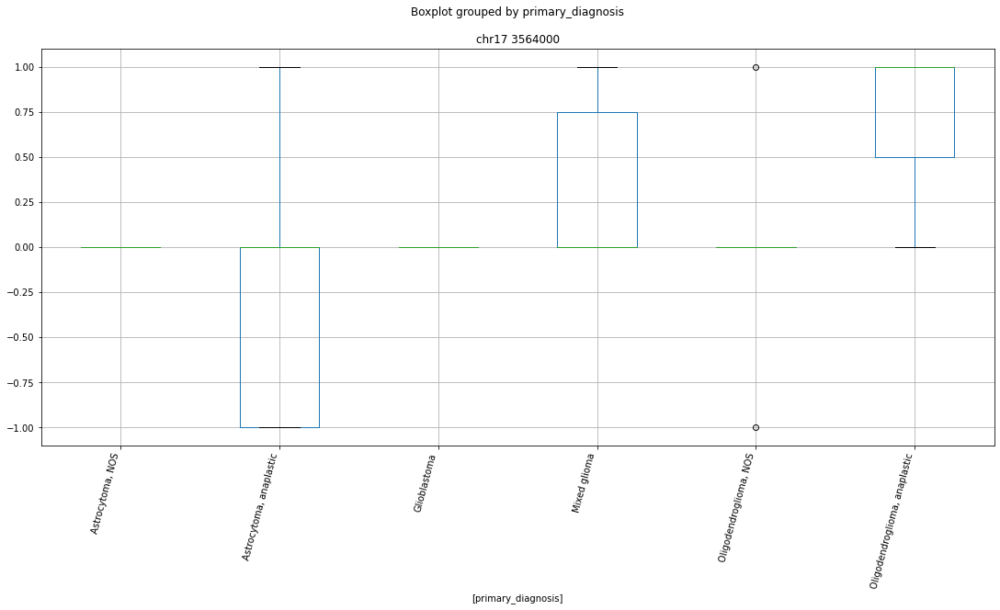

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr17 15867000


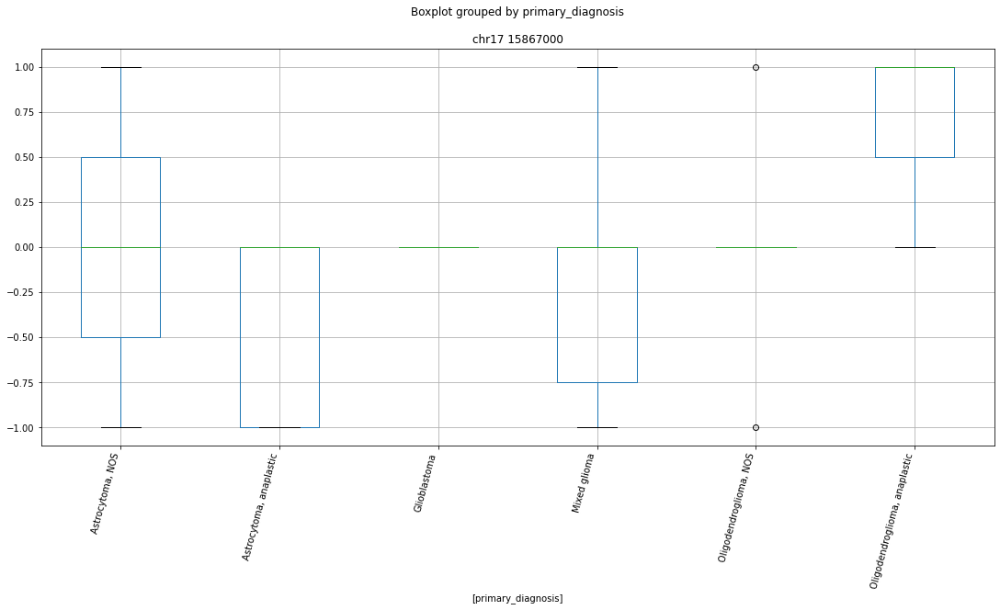

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr17 3112000


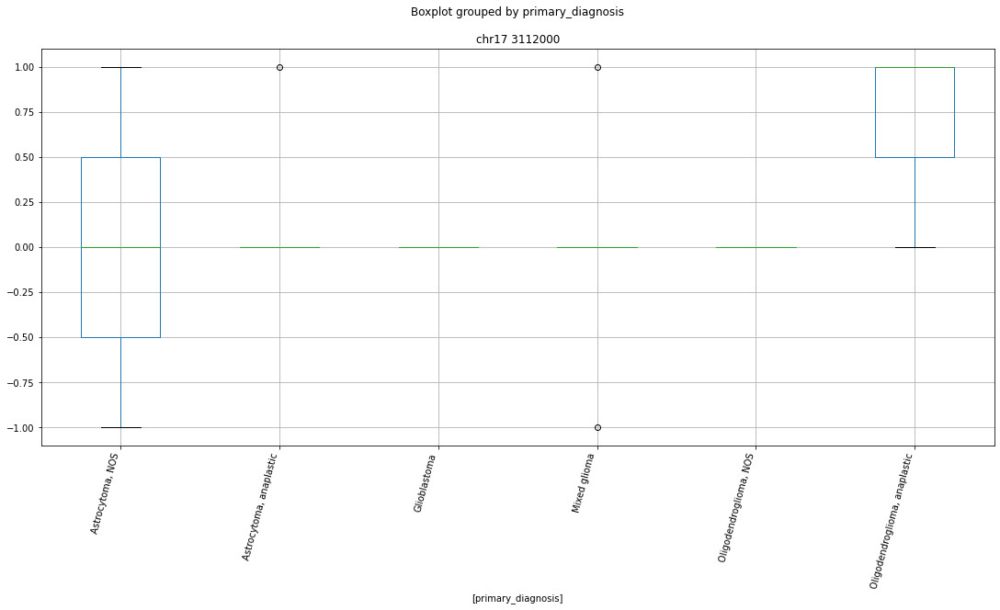

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr17 2507000


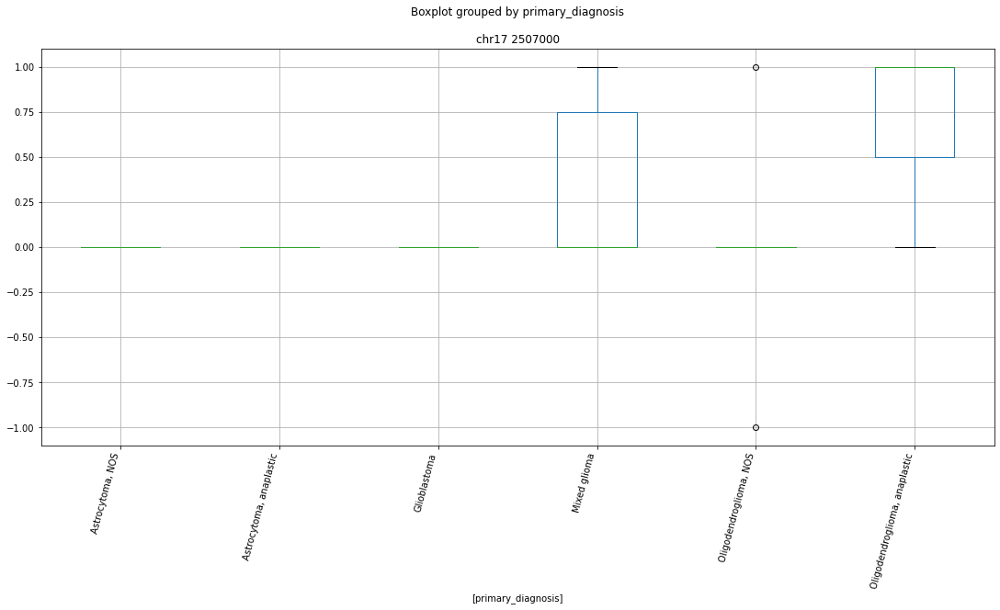

 p : 4.867369543712655e-08  ( t : 7.80532362705589 ) :  chr17 7088000


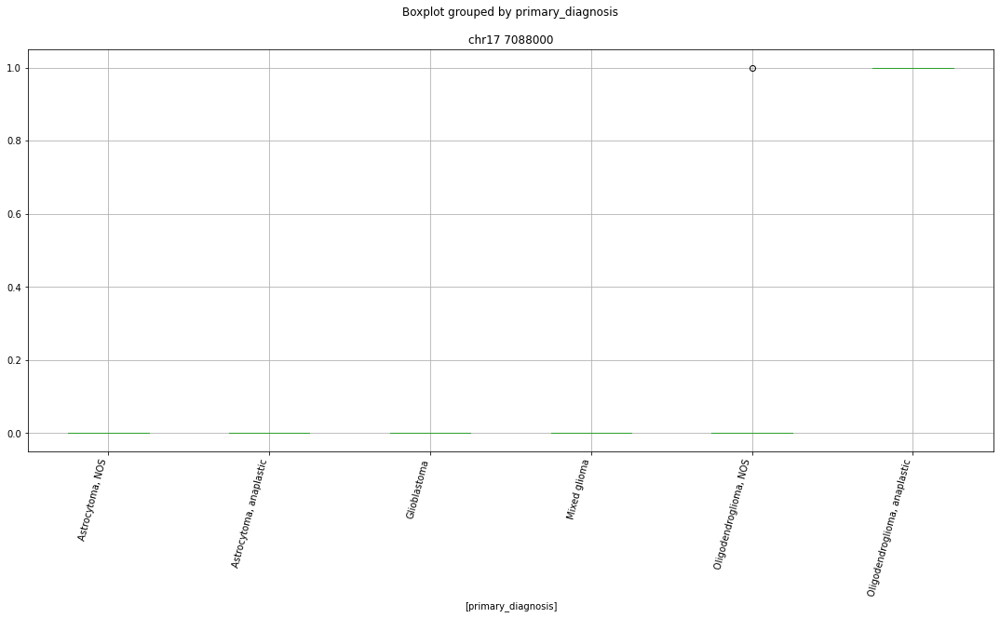

['chr17 1403000' 'chr17 15867000' 'chr17 15979000' 'chr17 16095000'
 'chr17 16311000' 'chr17 16401000' 'chr17 1689000' 'chr17 17611000'
 'chr17 17912000' 'chr17 18298000' 'chr17 18338000' 'chr17 19476000'
 'chr17 19504000' 'chr17 19519000' 'chr17 20506000' 'chr17 20557000'
 'chr17 20685000' 'chr17 21590000' 'chr17 2507000' 'chr17 27212000'
 'chr17 28603000' 'chr17 30523000' 'chr17 30564000' 'chr17 30594000'
 'chr17 30700000' 'chr17 30701000' 'chr17 30736000' 'chr17 3112000'
 'chr17 32921000' 'chr17 3465000' 'chr17 34907000' 'chr17 3564000'
 'chr17 36140000' 'chr17 3854000' 'chr17 38930000' 'chr17 41876000'
 'chr17 42449000' 'chr17 42973000' 'chr17 43355000' 'chr17 44181000'
 'chr17 44525000' 'chr17 4578000' 'chr17 46252000' 'chr17 46317000'
 'chr17 49150000' 'chr17 5143000' 'chr17 54201000' 'chr17 57846000'
 'chr17 58073000' 'chr17 58143000' 'chr17 59290000' 'chr17 59500000'
 'chr17 60552000' 'chr17 62021000' 'chr17 62073000' 'chr17 6226000'
 'chr17 64930000' 'chr17 65818000' 'chr17 70

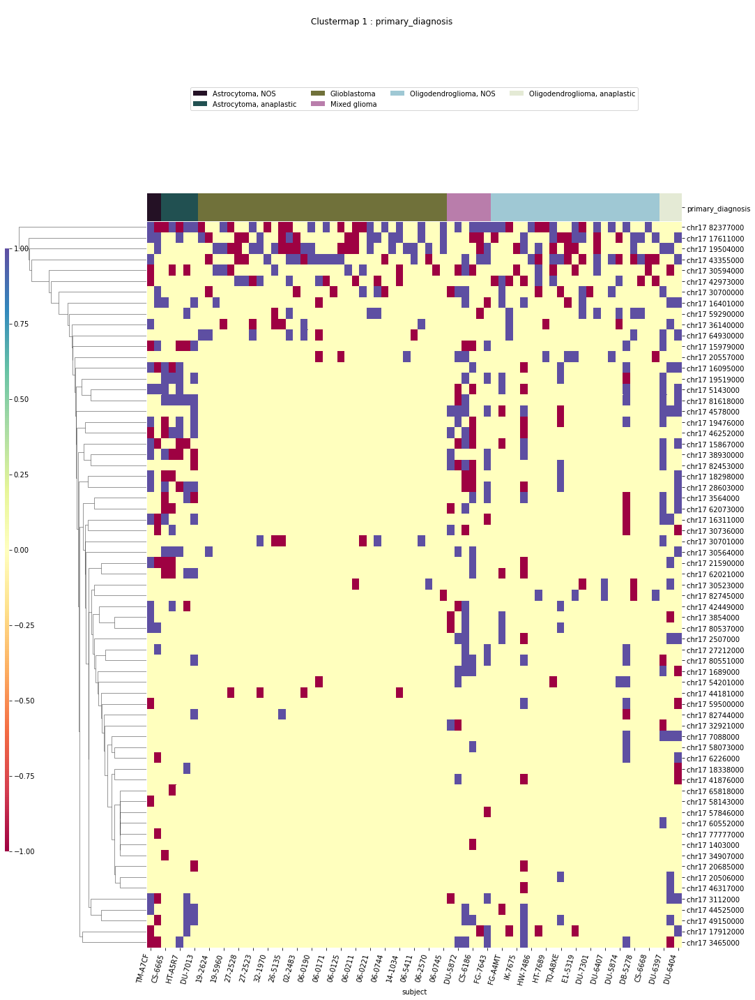

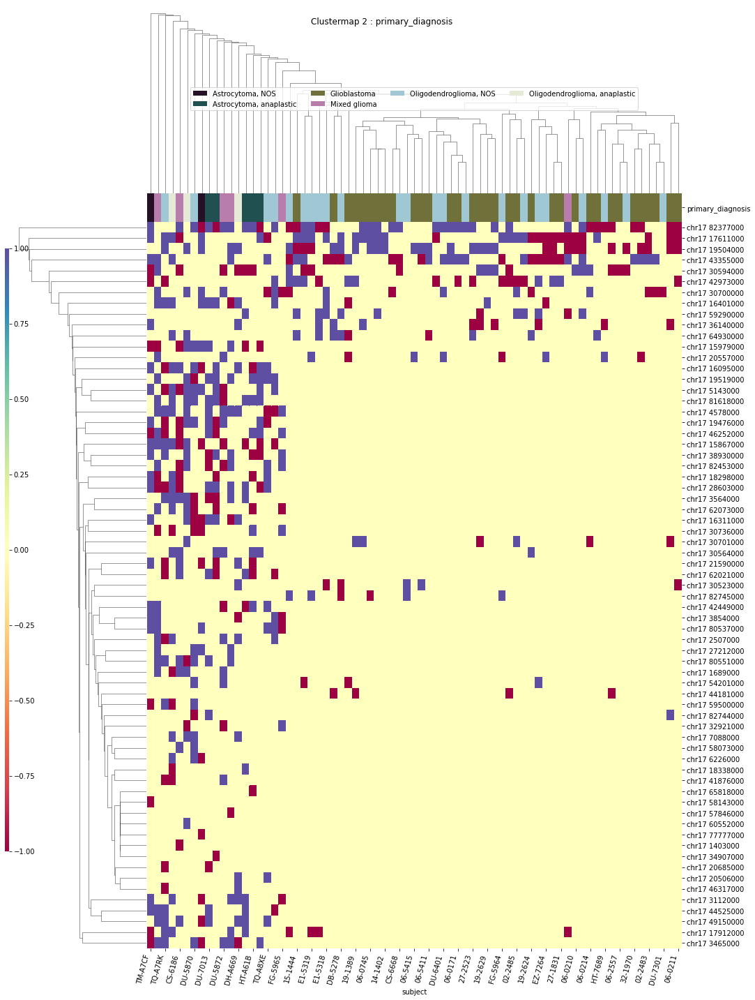

IDH
['IDH' 'chr17 16401000' 'chr17 17912000' 'chr17 20557000' 'chr17 20985000'
 'chr17 37566000' 'chr17 44181000' 'chr17 59290000' 'chr17 62021000'
 'chr17 82744000' 'subject']


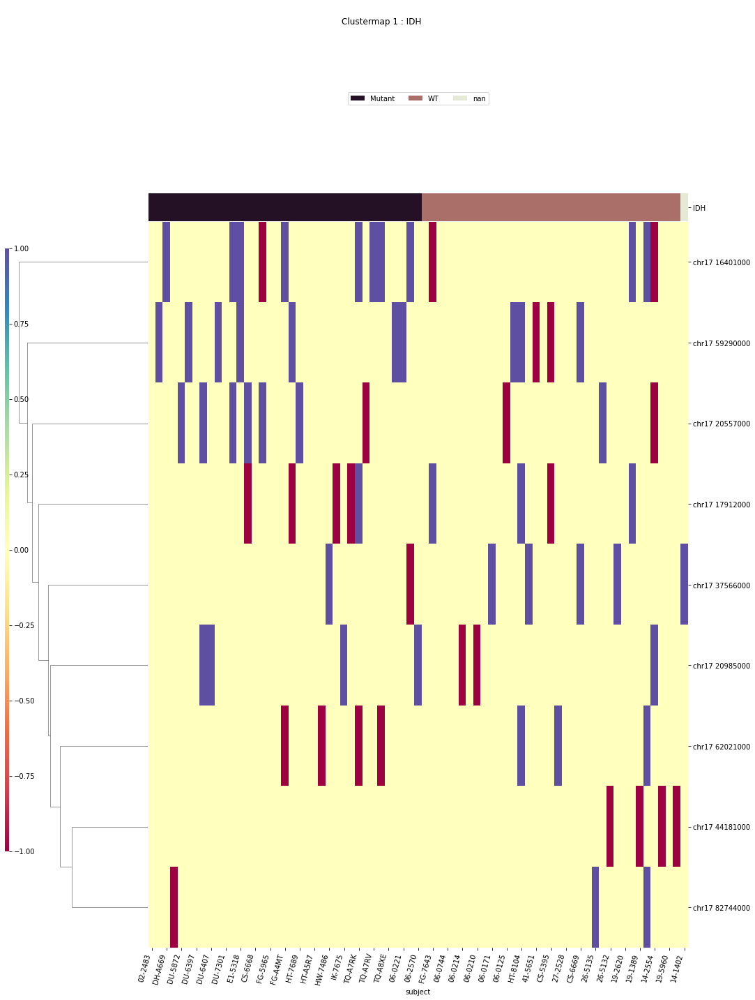

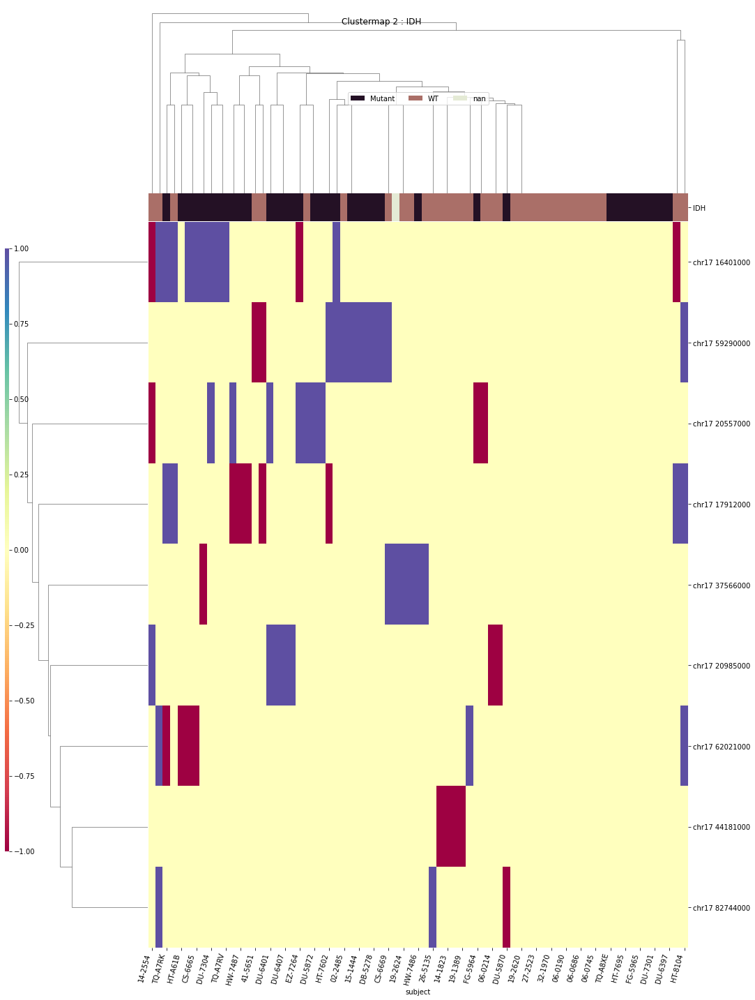

x1p19q
['chr17 17442000' 'chr17 27034000' 'chr17 30793000' 'chr17 36141000'
 'chr17 43355000' 'chr17 46317000' 'chr17 59290000' 'chr17 60552000'
 'chr17 7088000' 'chr17 82744000' 'chr17 82745000' 'subject' 'x1p19q']


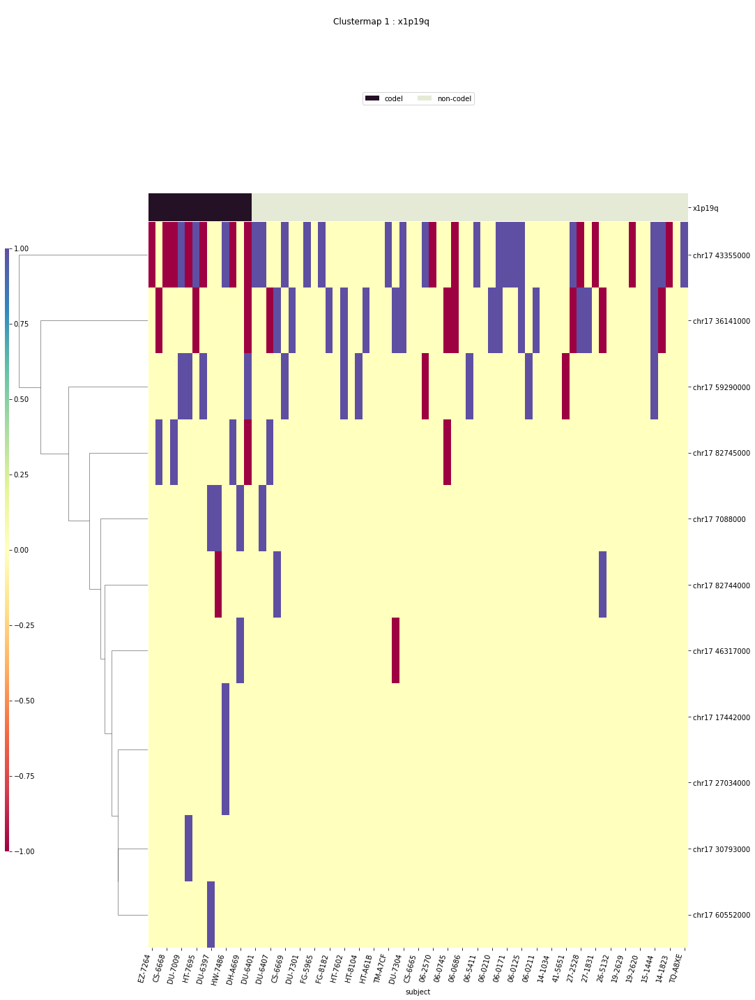

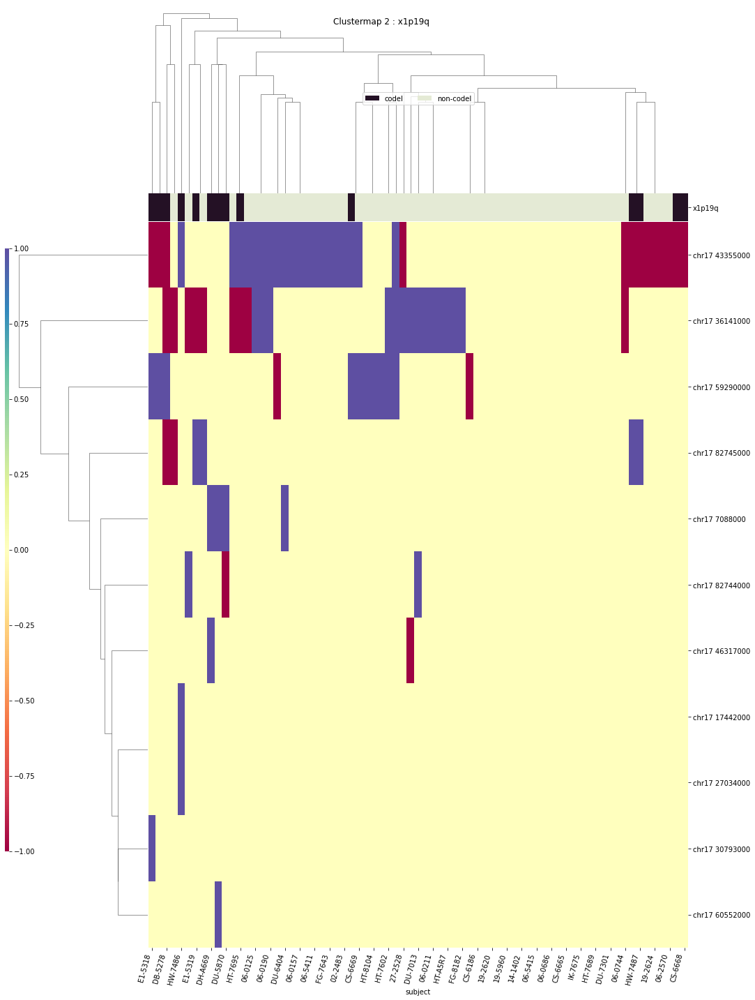

TERT
['TERT' 'chr17 16401000' 'chr17 19519000' 'chr17 20557000'
 'chr17 20985000' 'chr17 21590000' 'chr17 30564000' 'chr17 42449000'
 'chr17 49126000' 'chr17 62021000' 'chr17 80537000' 'subject']


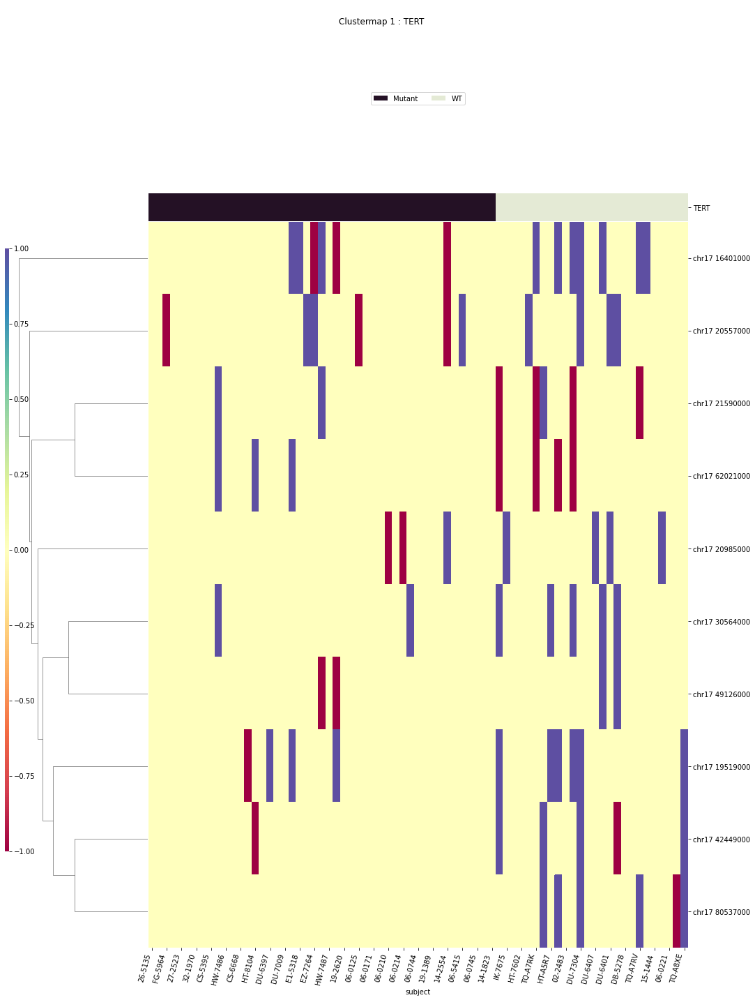

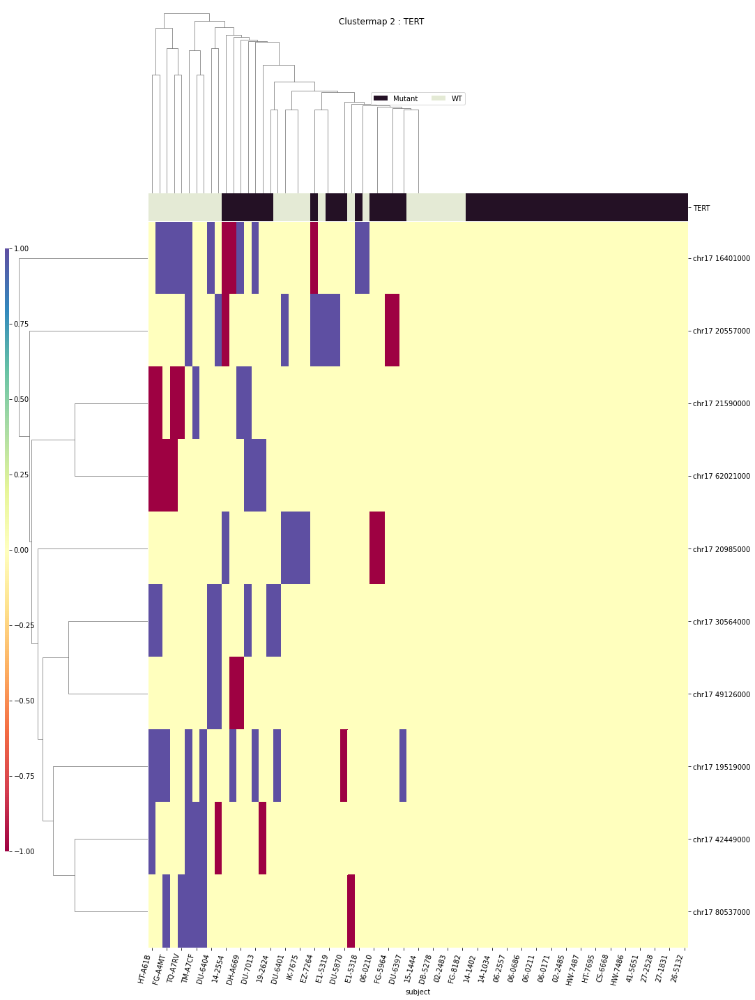

disease_type
['chr17 16401000' 'chr17 19519000' 'chr17 20557000' 'chr17 27212000'
 'chr17 30564000' 'chr17 30594000' 'chr17 44181000' 'chr17 4578000'
 'chr17 49150000' 'chr17 7088000' 'chr17 80551000' 'chr17 81618000'
 'disease_type' 'subject']


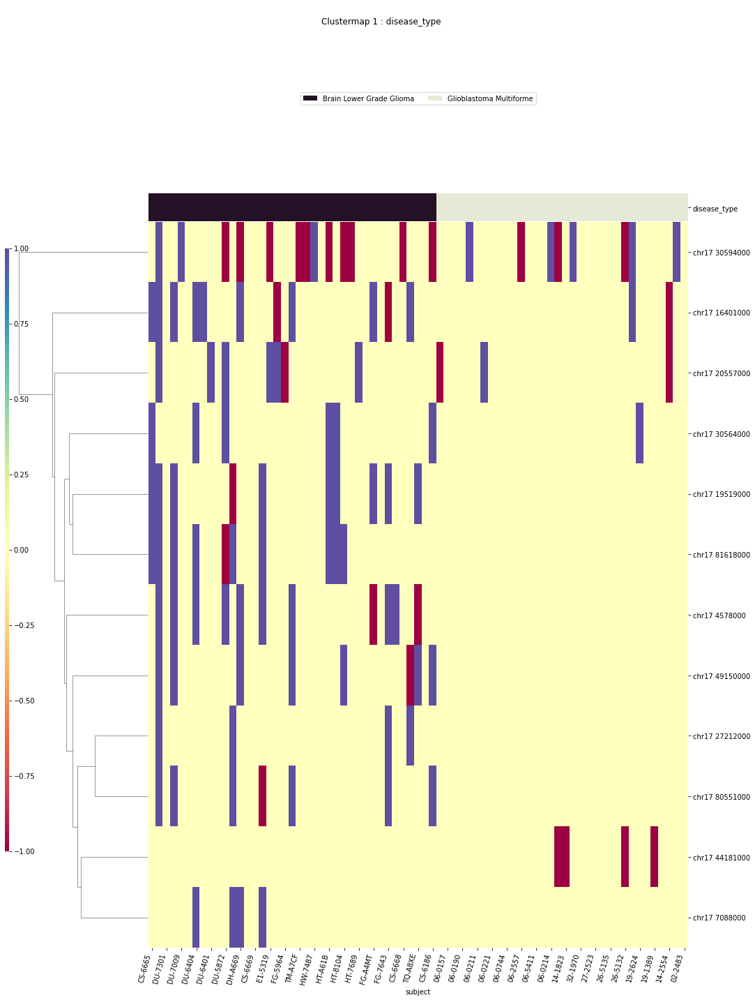

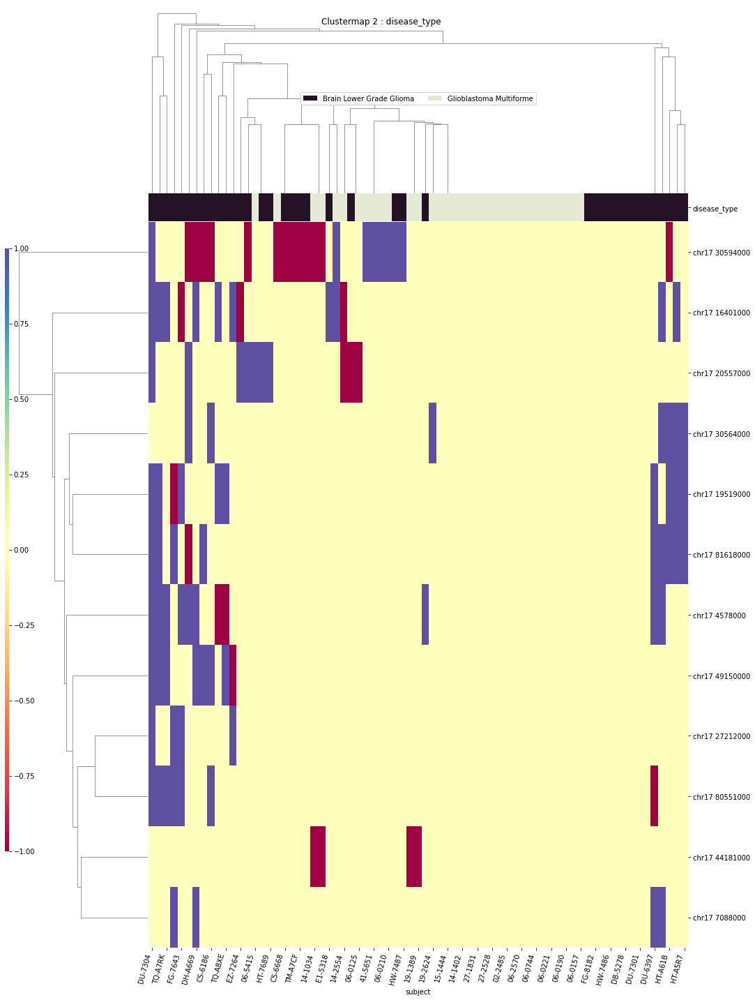

chr18
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr18 31961000


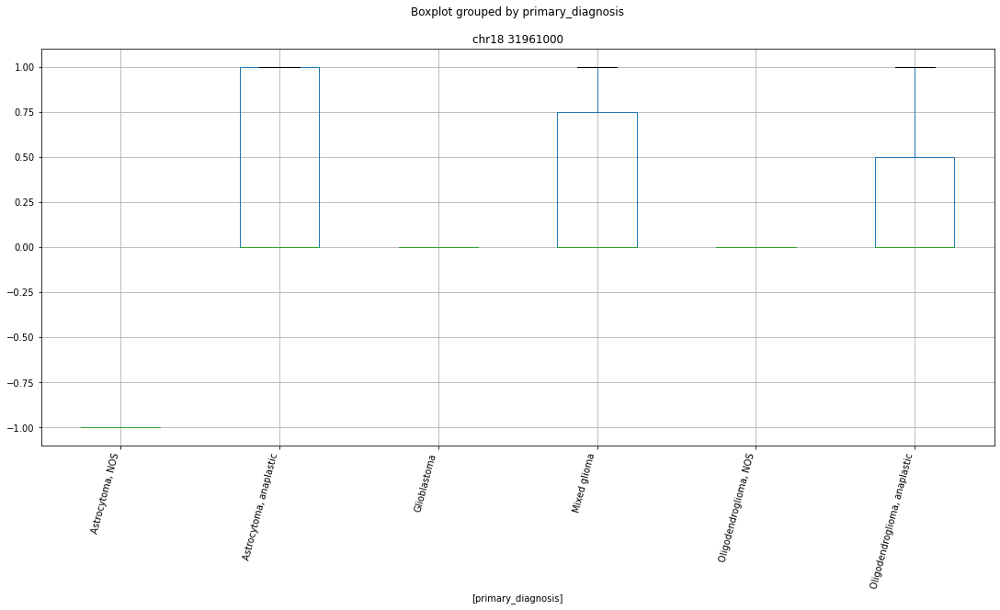

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr18 512000


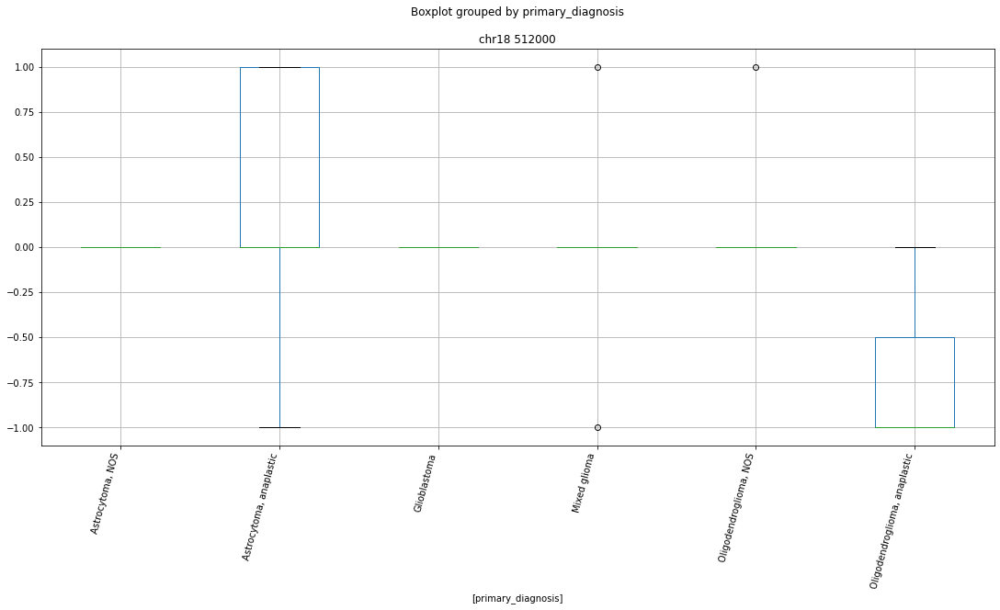

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr18 68105000


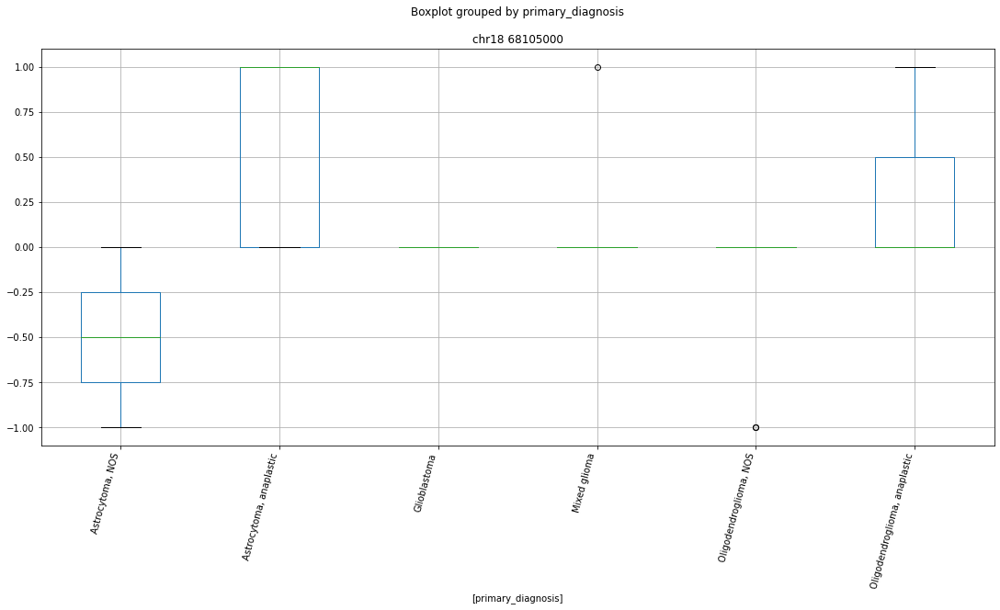

['chr18 11614000' 'chr18 11960000' 'chr18 12874000' 'chr18 13098000'
 'chr18 14010000' 'chr18 14382000' 'chr18 2000000' 'chr18 2001000'
 'chr18 21592000' 'chr18 26928000' 'chr18 31810000' 'chr18 31811000'
 'chr18 31961000' 'chr18 41184000' 'chr18 46088000' 'chr18 49079000'
 'chr18 4918000' 'chr18 50404000' 'chr18 50609000' 'chr18 512000'
 'chr18 57632000' 'chr18 63450000' 'chr18 67076000' 'chr18 67077000'
 'chr18 68105000' 'chr18 68106000' 'chr18 70480000' 'chr18 76001000'
 'chr18 76646000' 'chr18 77028000' 'chr18 91000' 'primary_diagnosis'
 'subject']


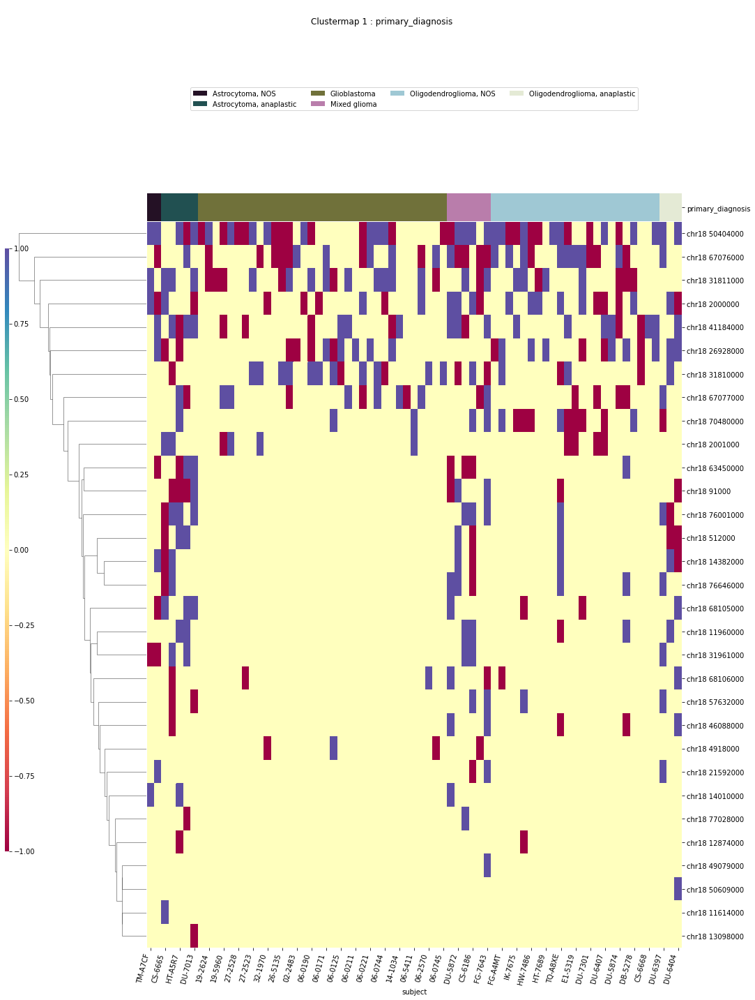

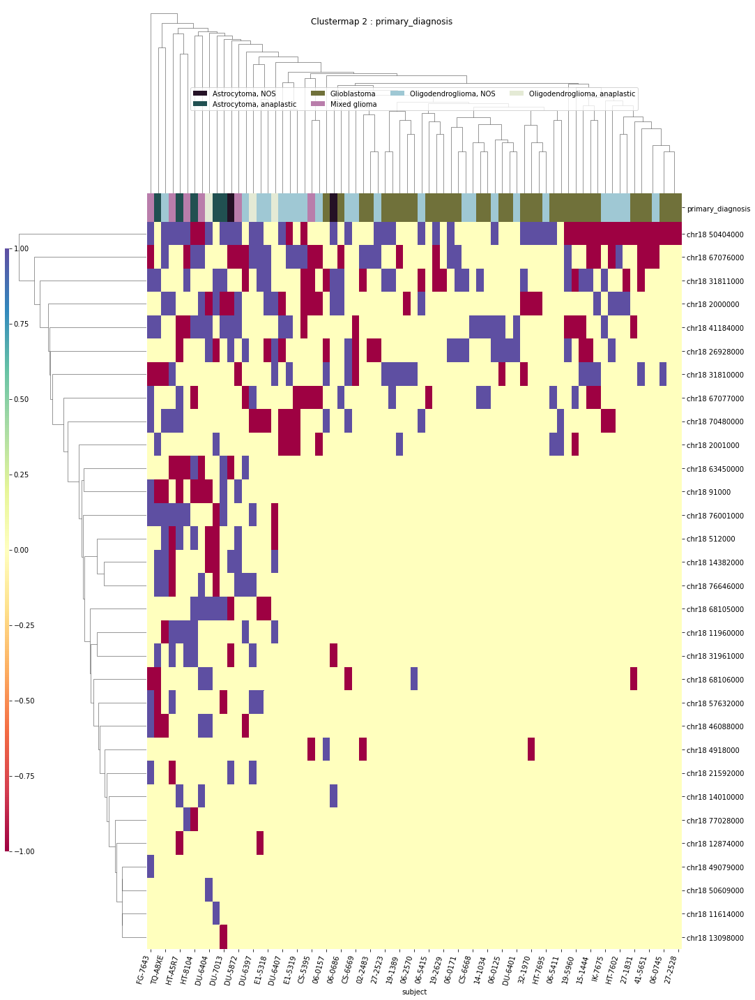

IDH
['IDH' 'chr18 14010000' 'chr18 14382000' 'chr18 2000000' 'chr18 70480000'
 'chr18 76646000' 'subject']


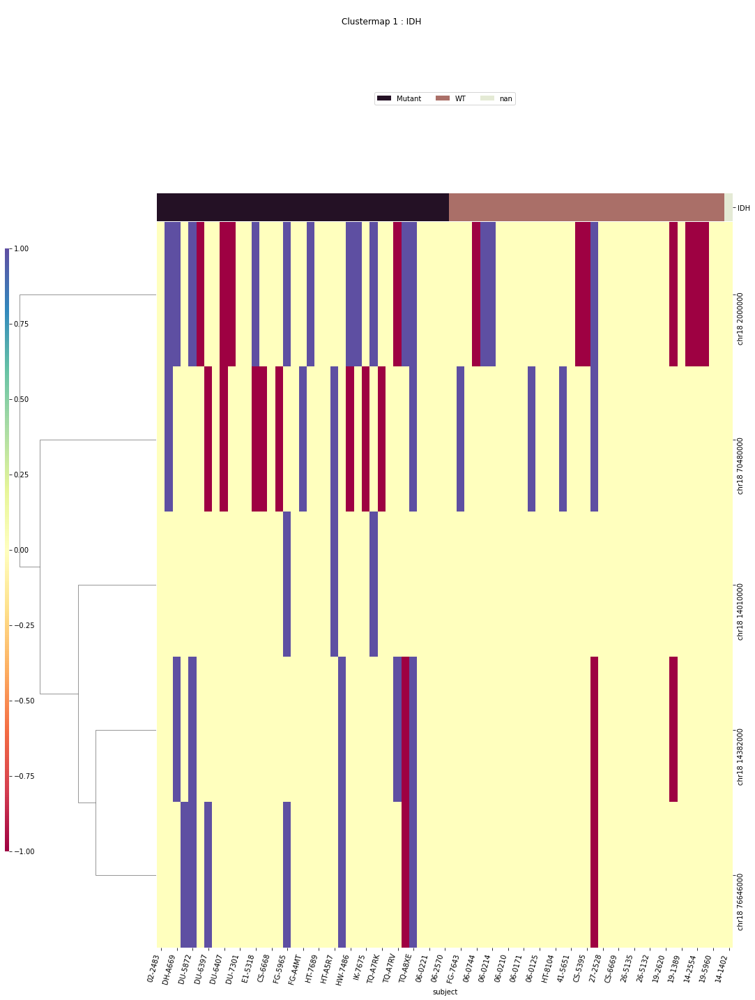

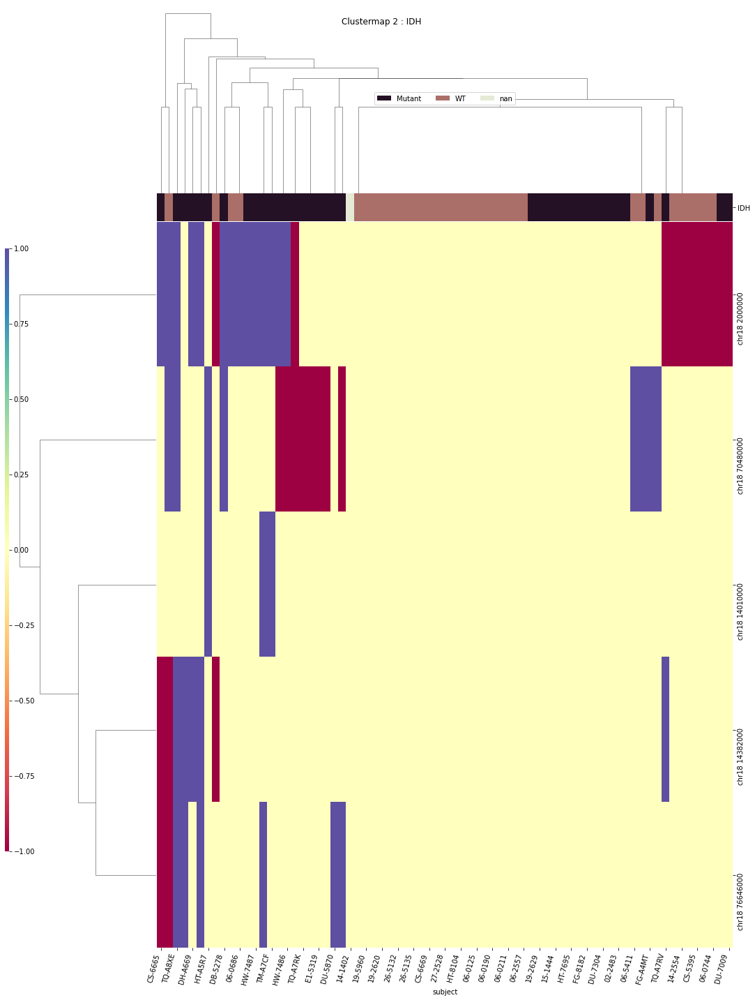

x1p19q
['chr18 2001000' 'chr18 26202000' 'chr18 31811000' 'chr18 67077000'
 'chr18 70480000' 'subject' 'x1p19q']


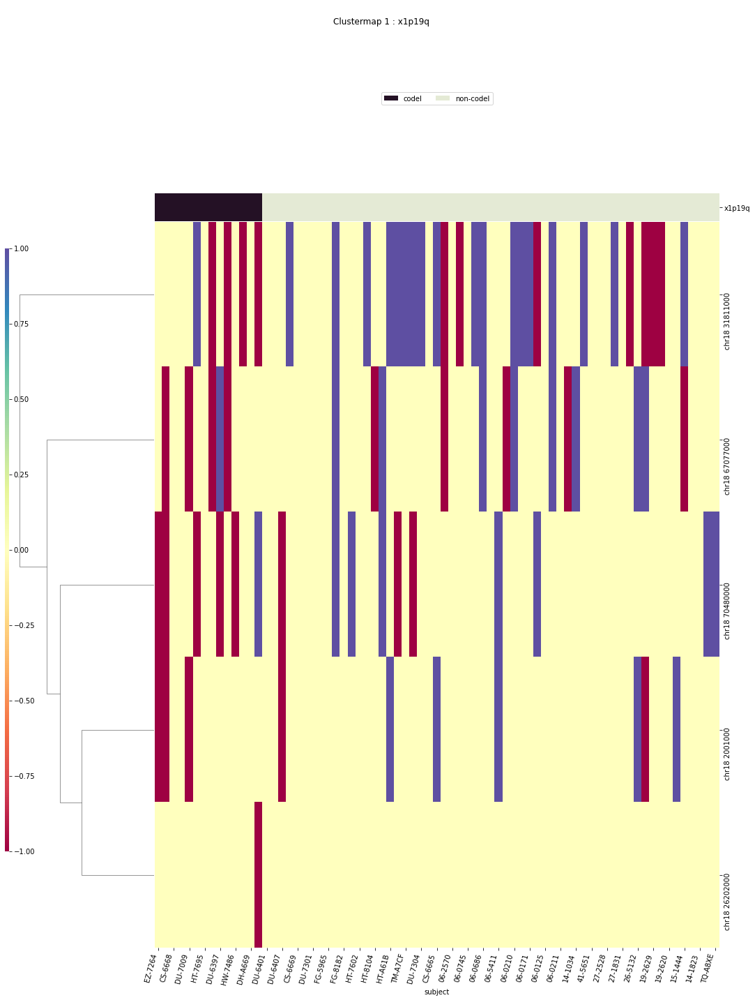

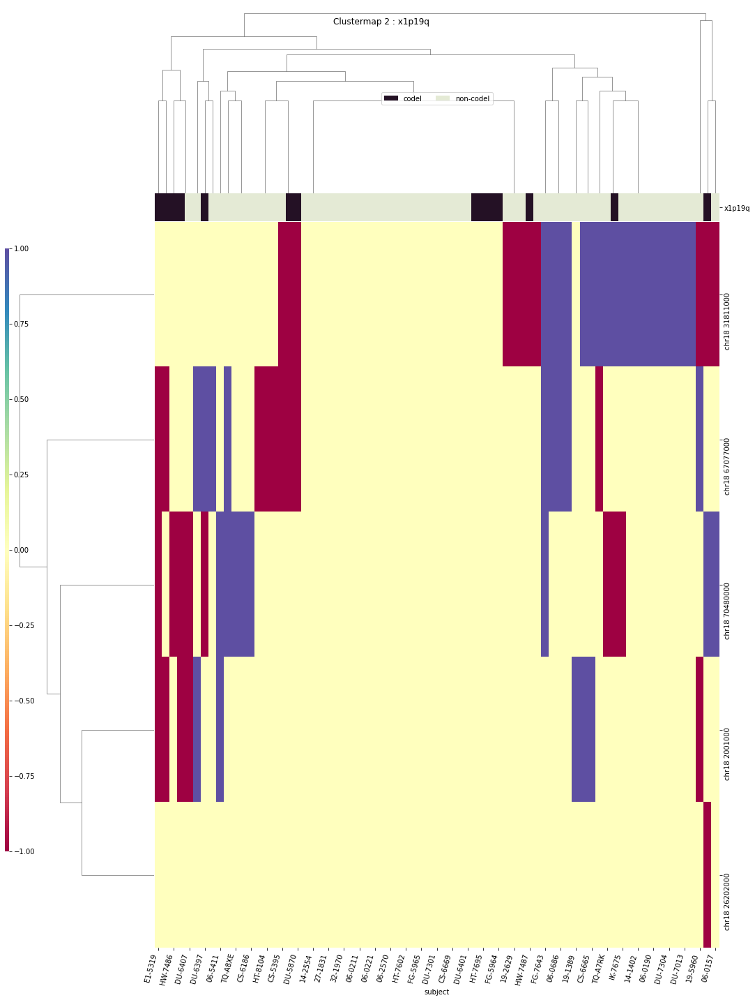

TERT
['TERT' 'chr18 12874000' 'chr18 14010000' 'chr18 31810000'
 'chr18 50404000' 'chr18 63450000' 'chr18 91000' 'subject']


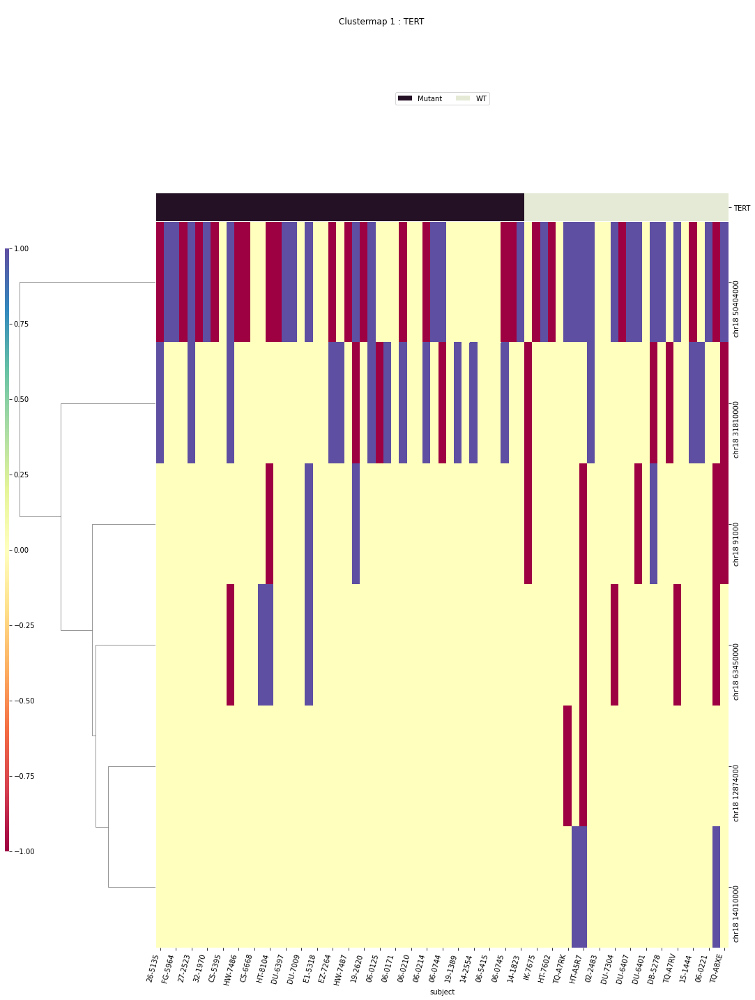

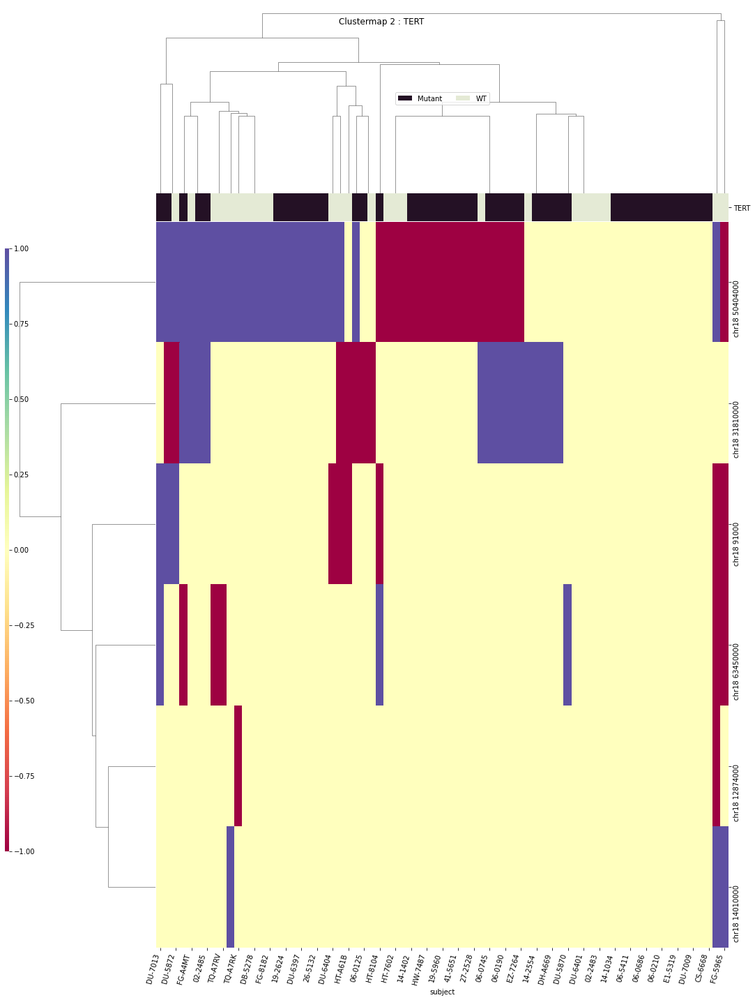

disease_type
['chr18 11960000' 'chr18 31810000' 'chr18 41184000' 'chr18 50404000'
 'chr18 50405000' 'chr18 76001000' 'disease_type' 'subject']


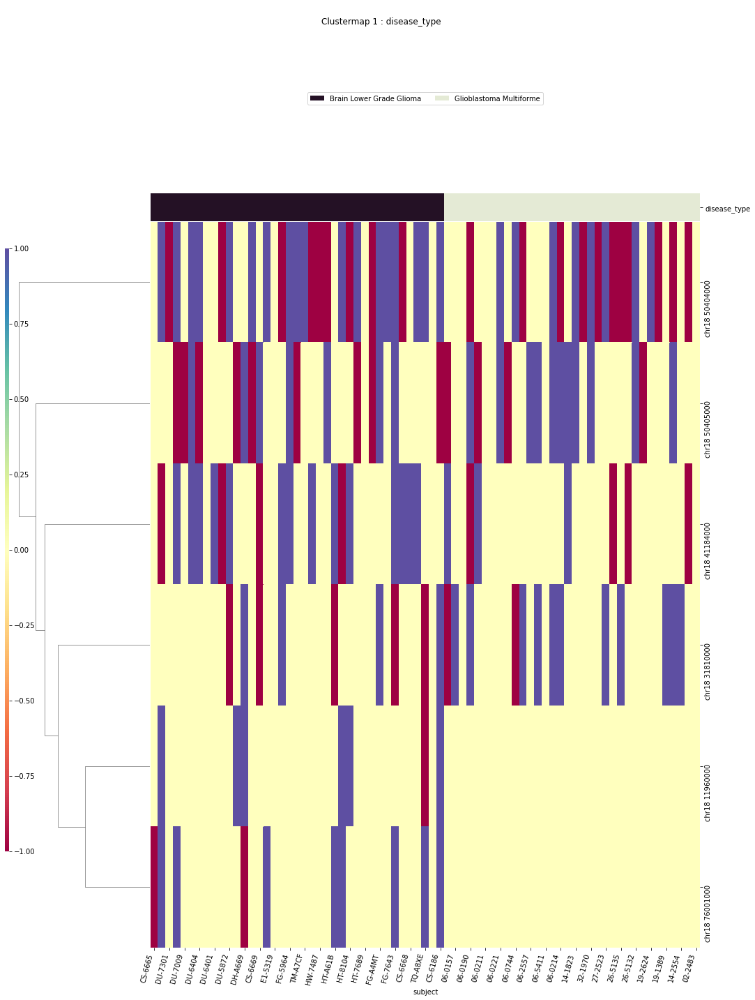

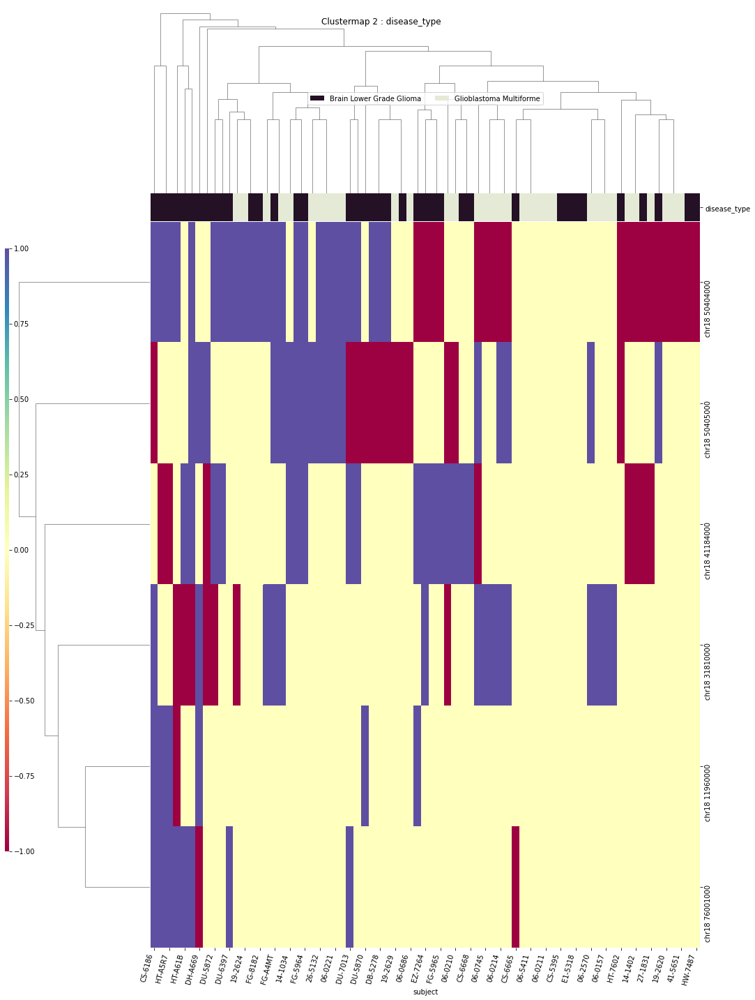

chr19
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr19 23173000


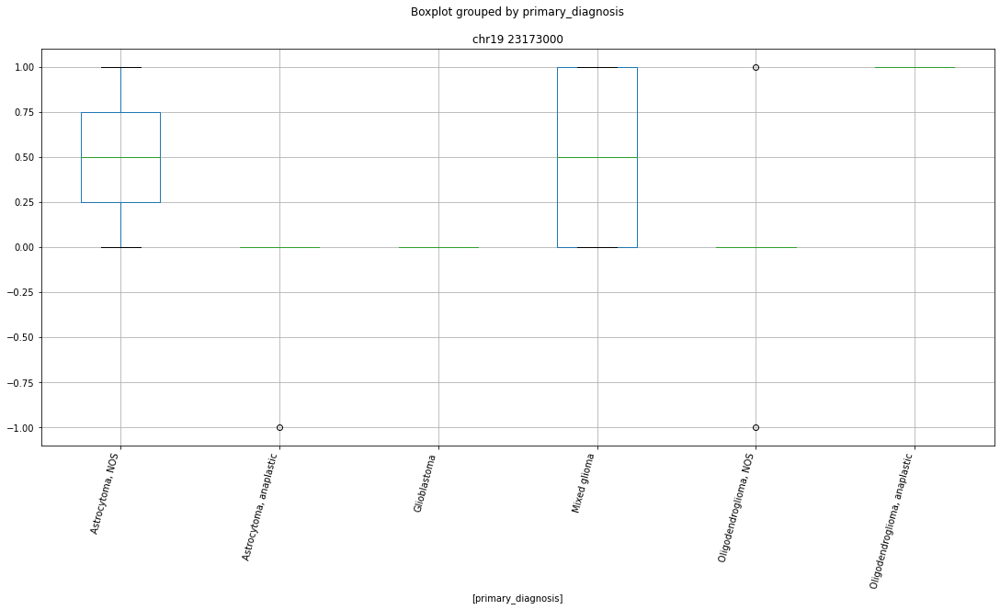

 p : 0.0  ( t : inf ) :  chr19 52750000


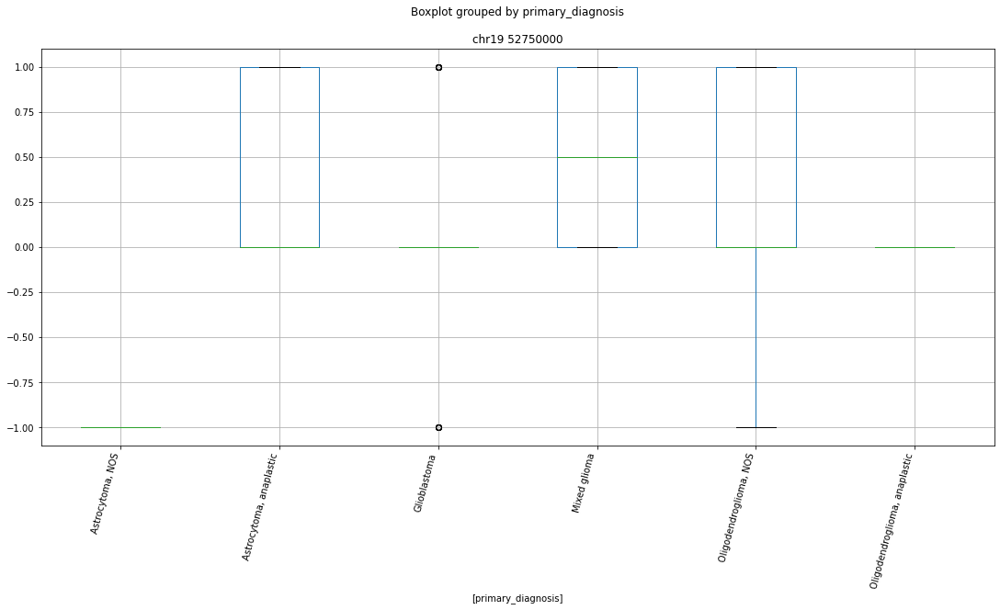

 p : 0.0  ( t : inf ) :  chr19 22284000


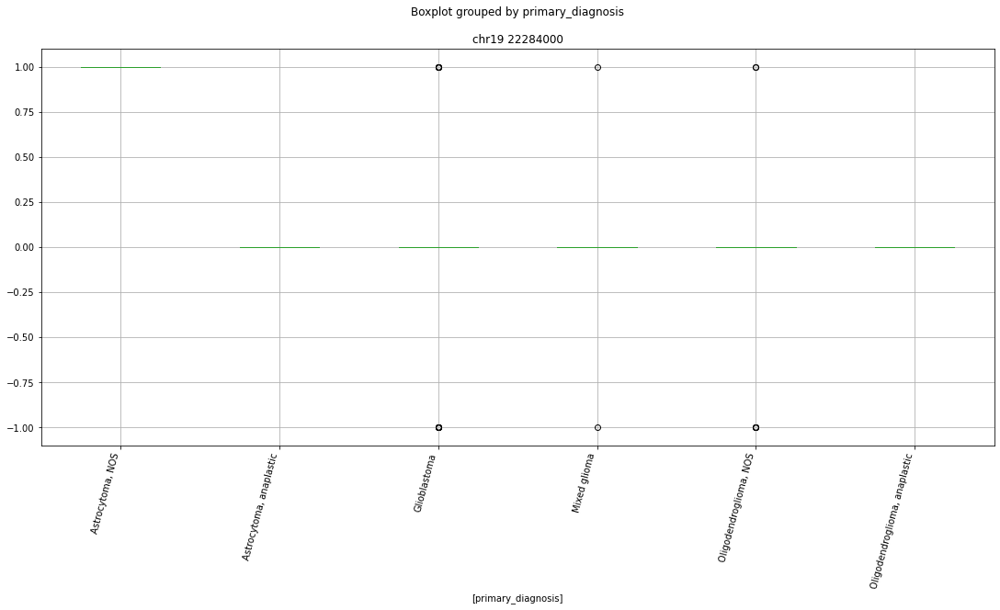

 p : 0.0  ( t : inf ) :  chr19 19961000


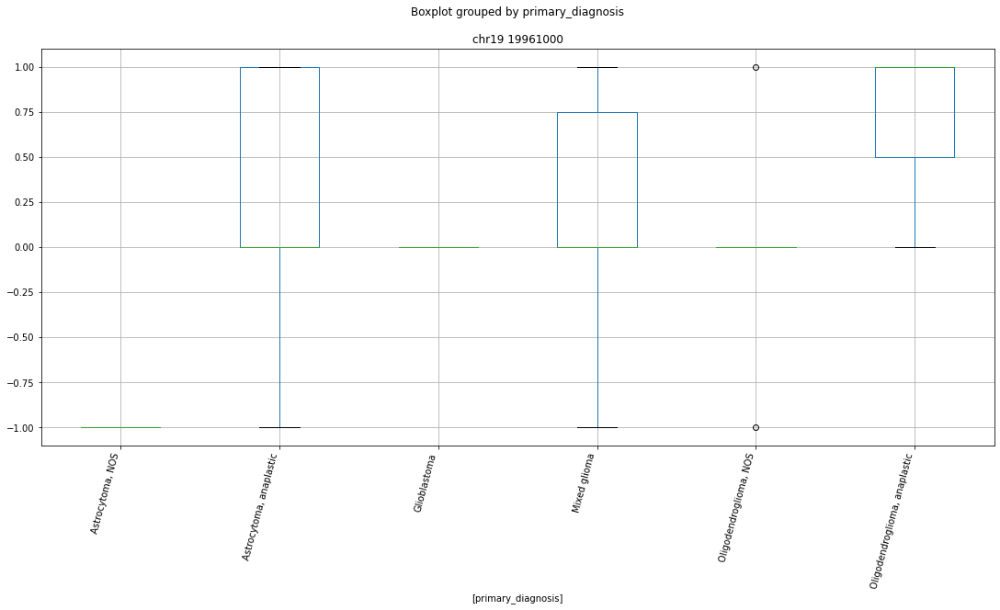

 p : 0.0  ( t : inf ) :  chr19 44054000


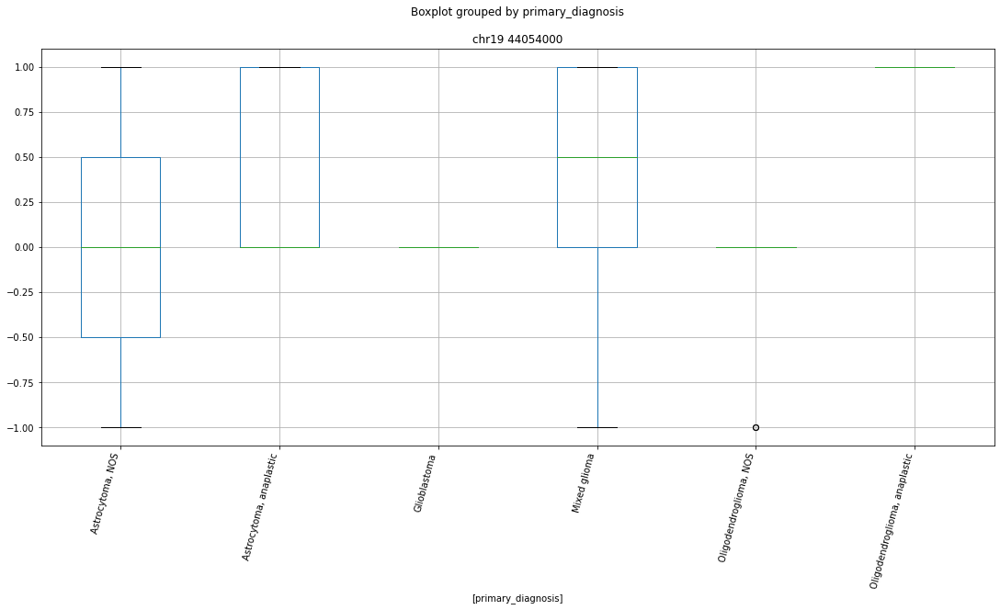

 p : 0.0  ( t : inf ) :  chr19 20286000


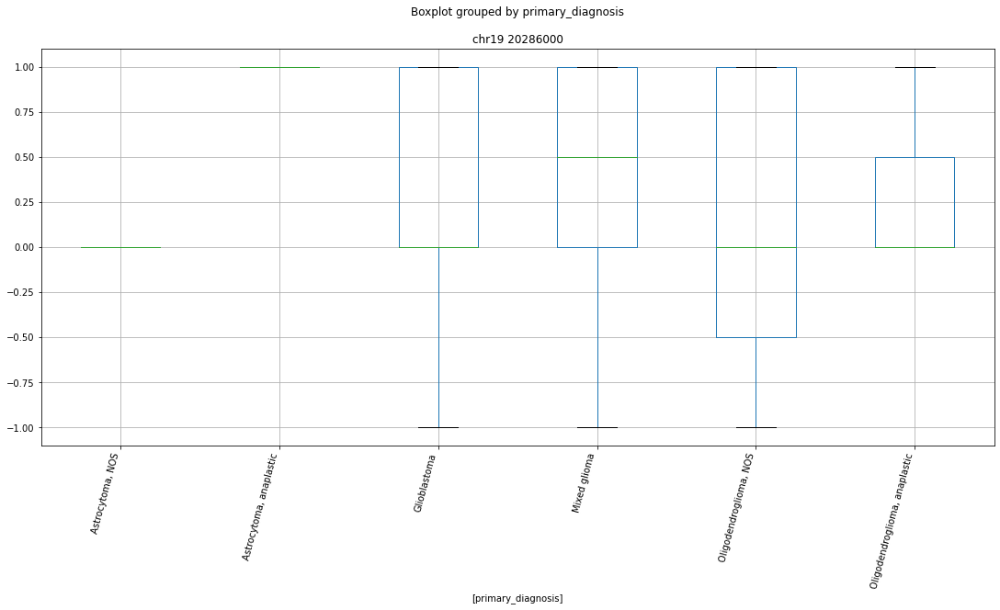

 p : 0.0  ( t : inf ) :  chr19 37502000


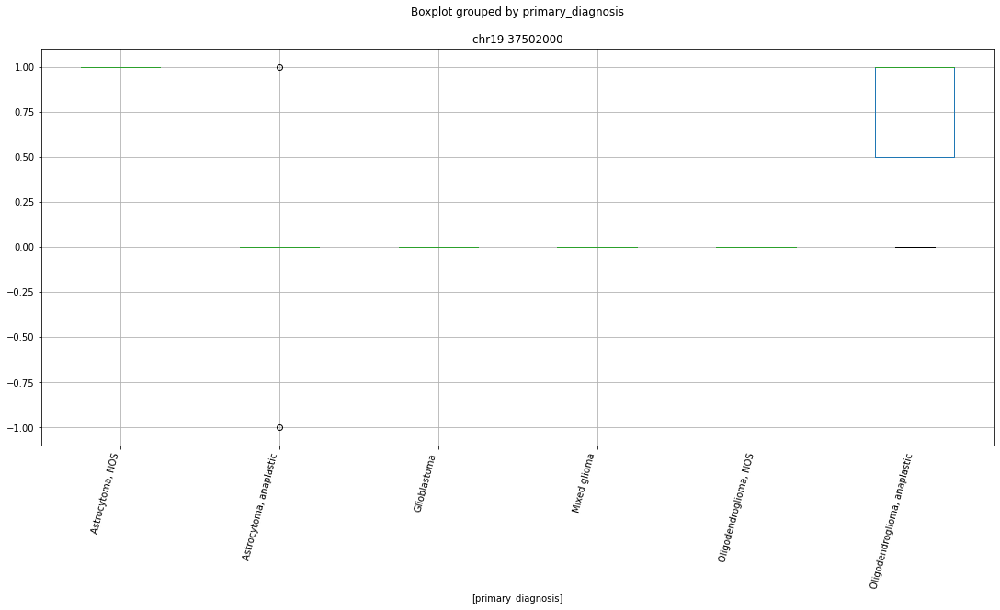

 p : 0.0  ( t : inf ) :  chr19 57824000


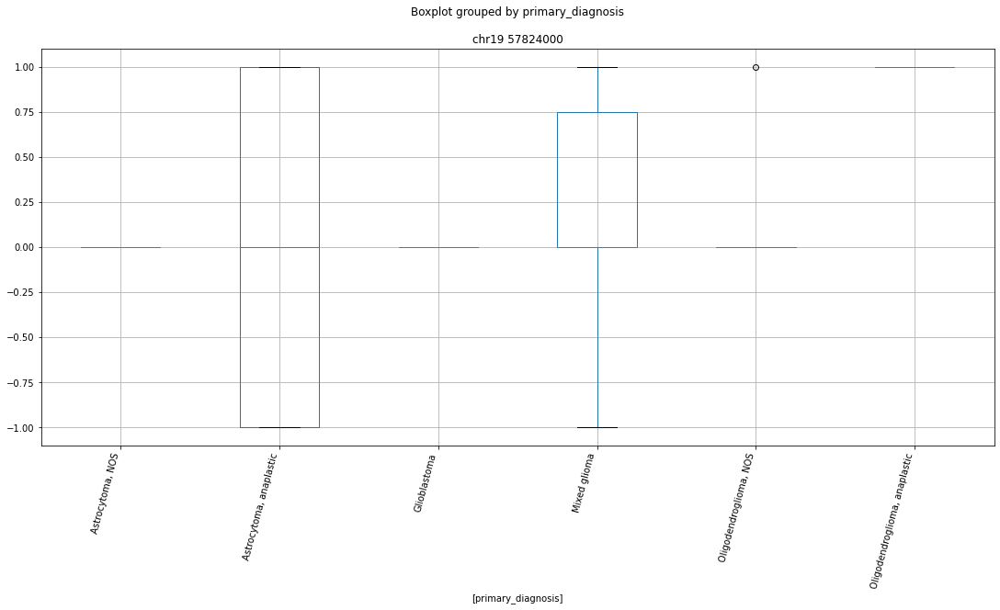

 p : 0.0  ( t : inf ) :  chr19 23077000


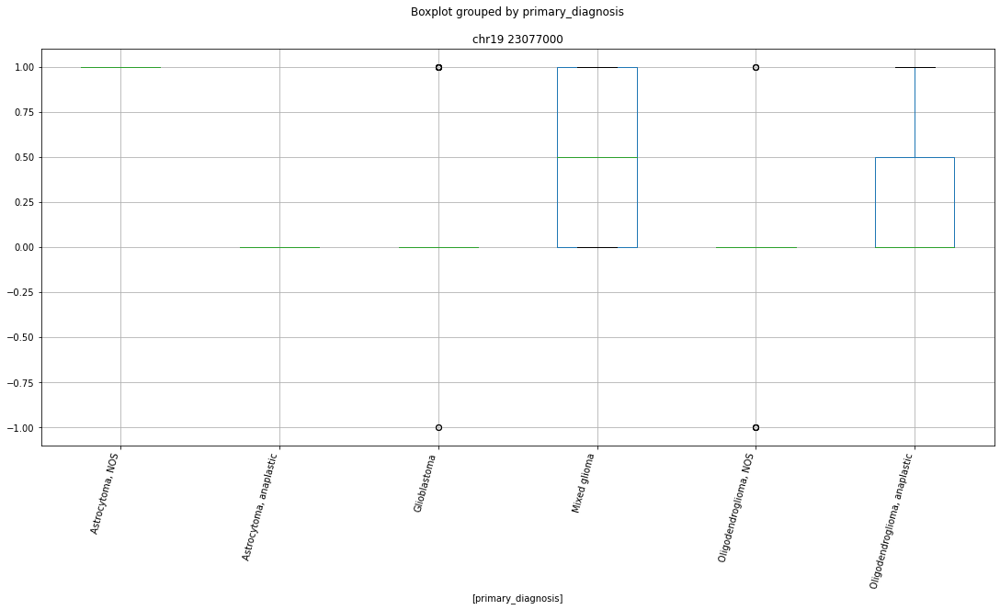

 p : 0.0  ( t : inf ) :  chr19 20152000


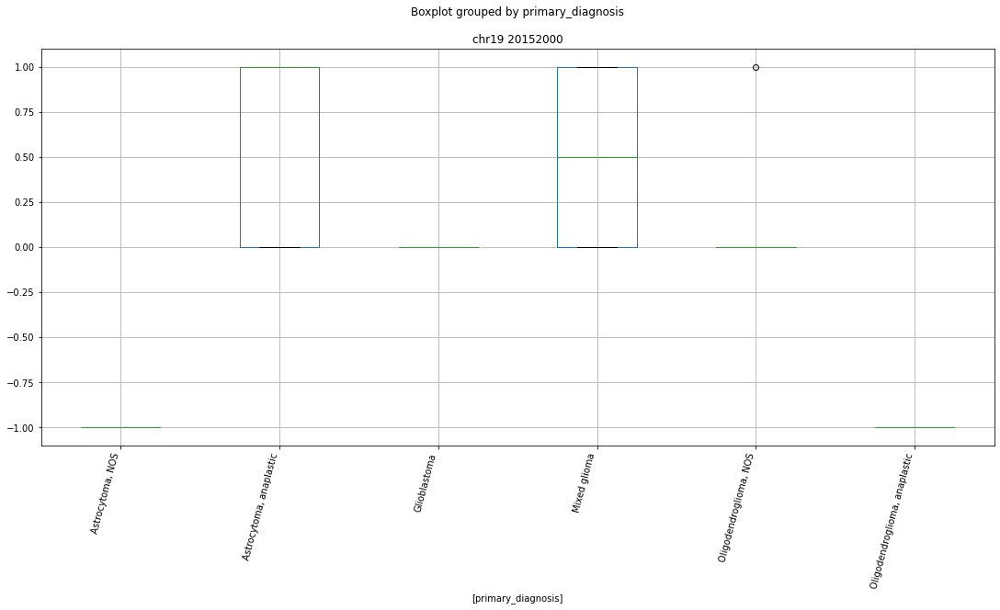

 p : 0.0  ( t : inf ) :  chr19 44639000


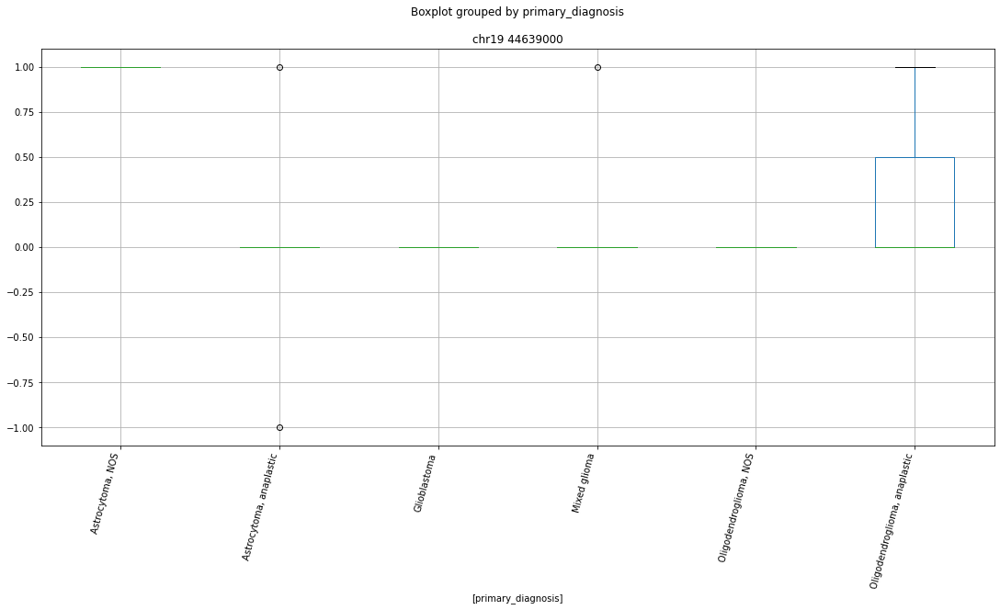

 p : 0.0  ( t : inf ) :  chr19 23936000


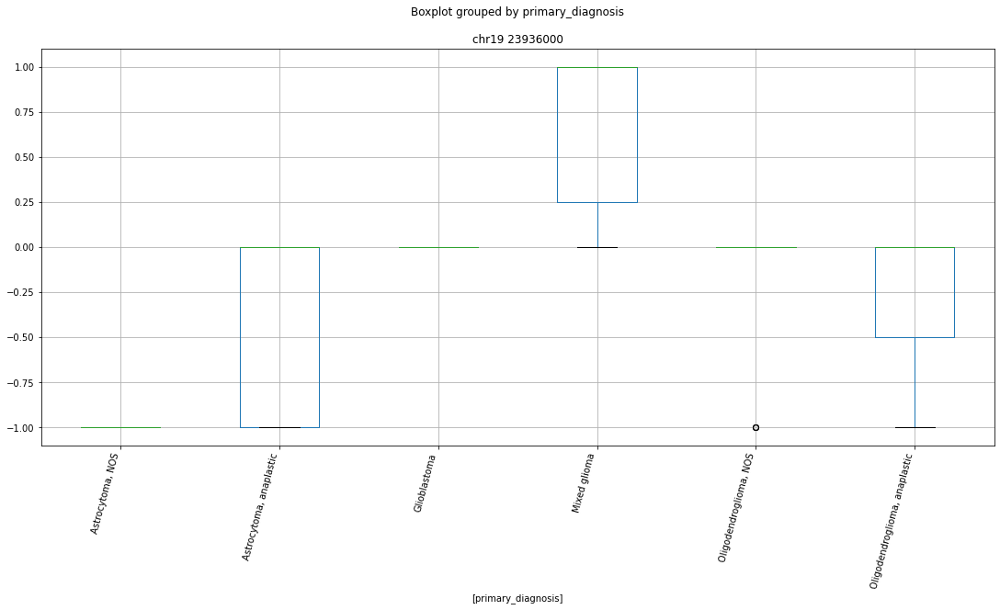

 p : 1.2735213637763784e-13  ( t : 11.358945418727963 ) :  chr19 21486000


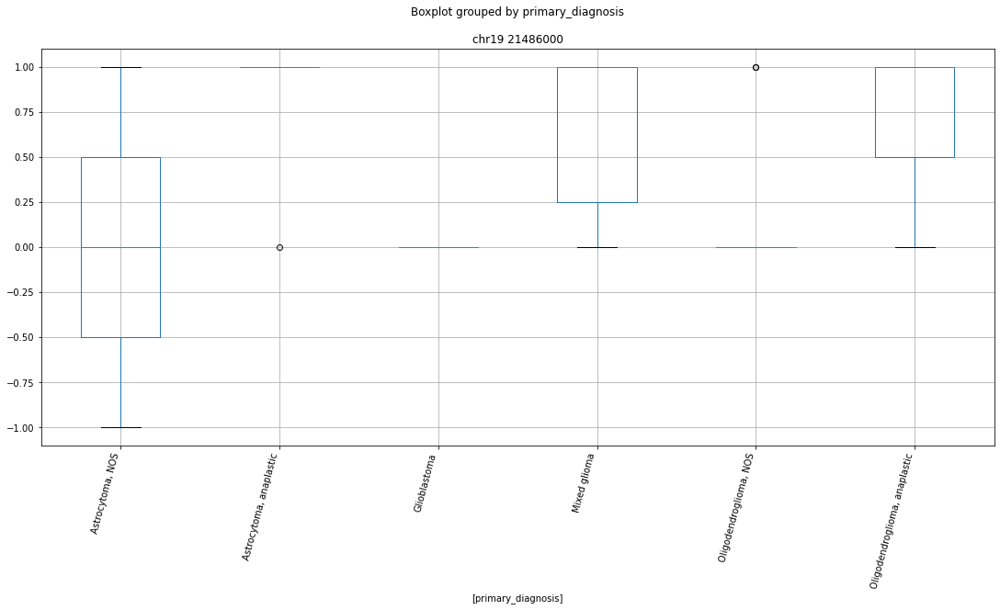

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr19 23936000


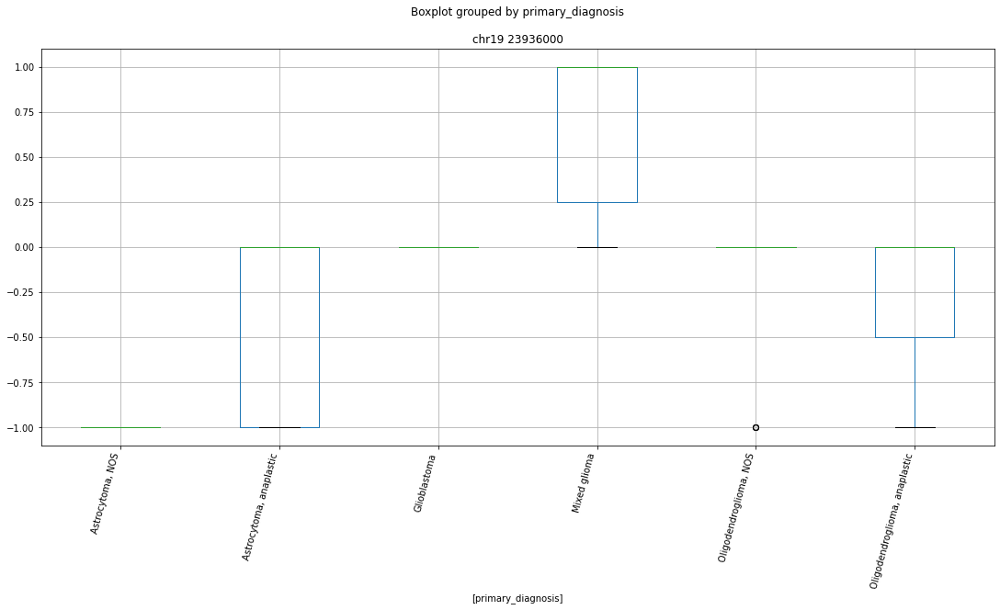

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr19 21486000


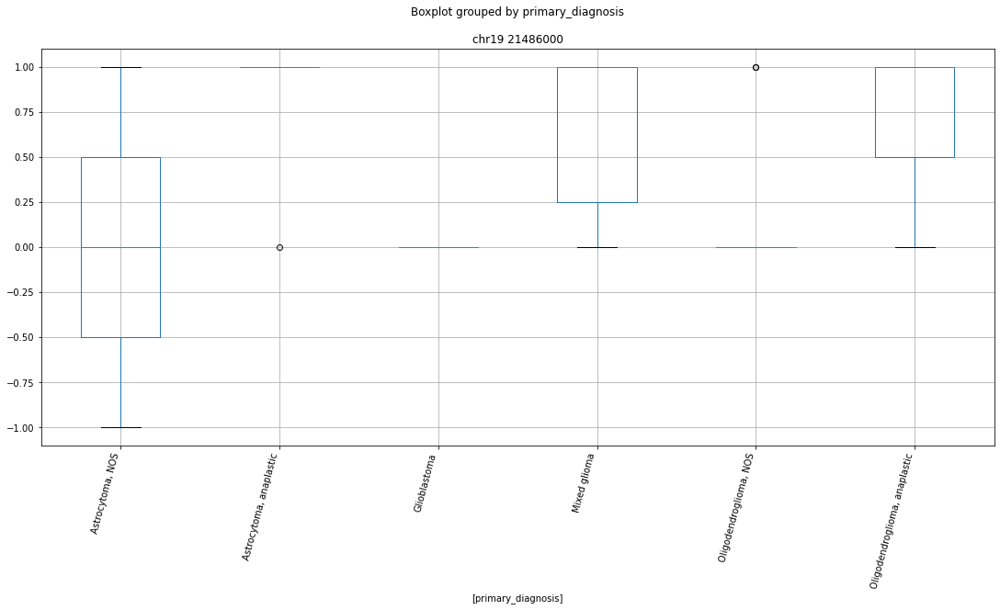

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr19 21486000


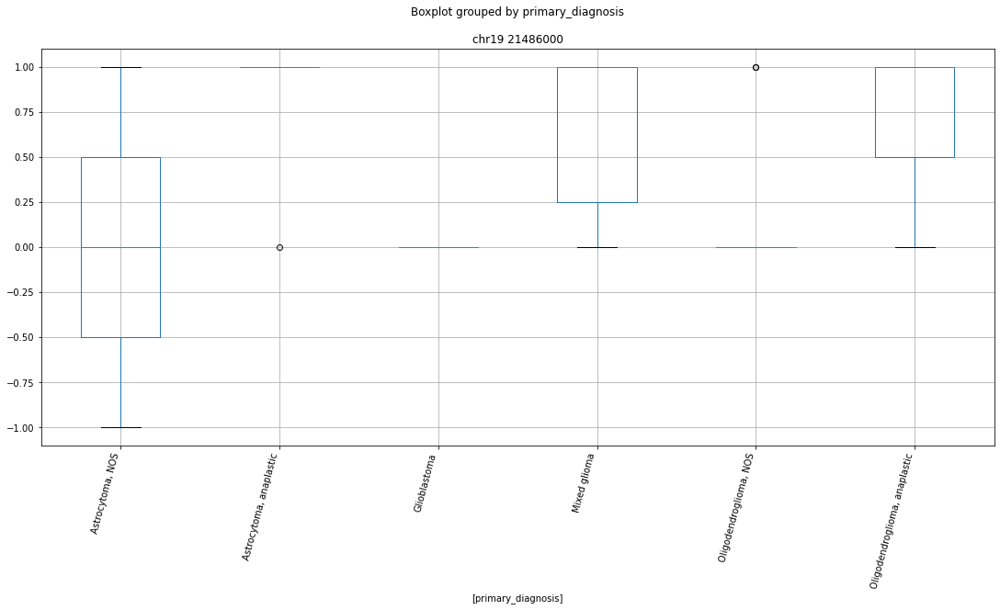

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr19 54214000


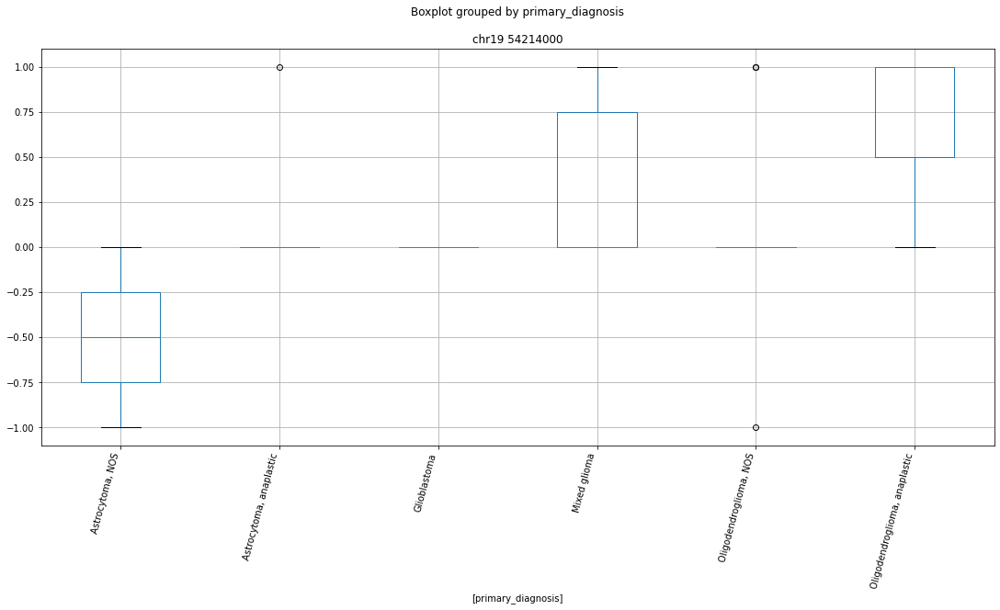

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr19 27678000


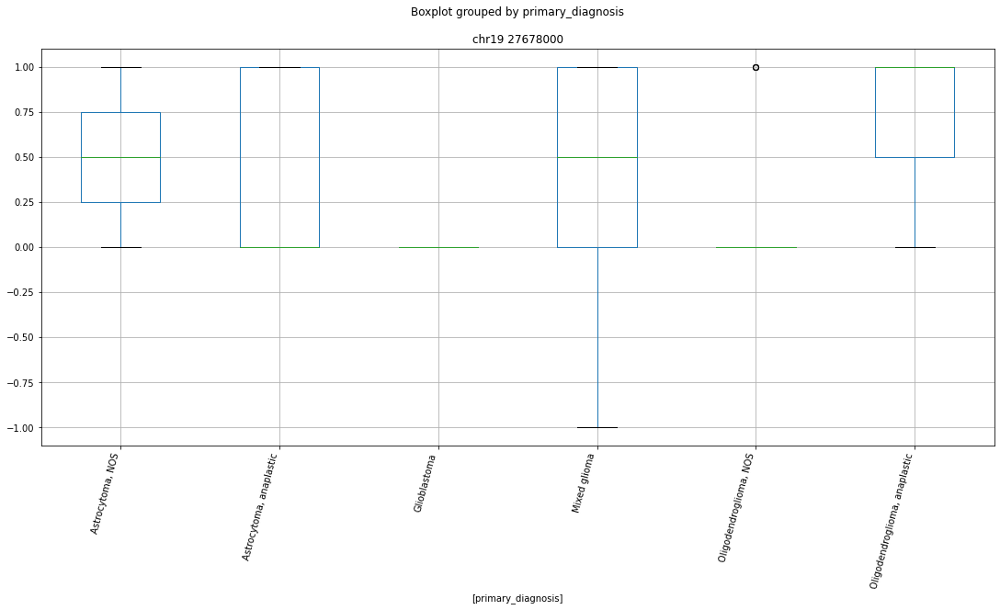

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr19 57556000


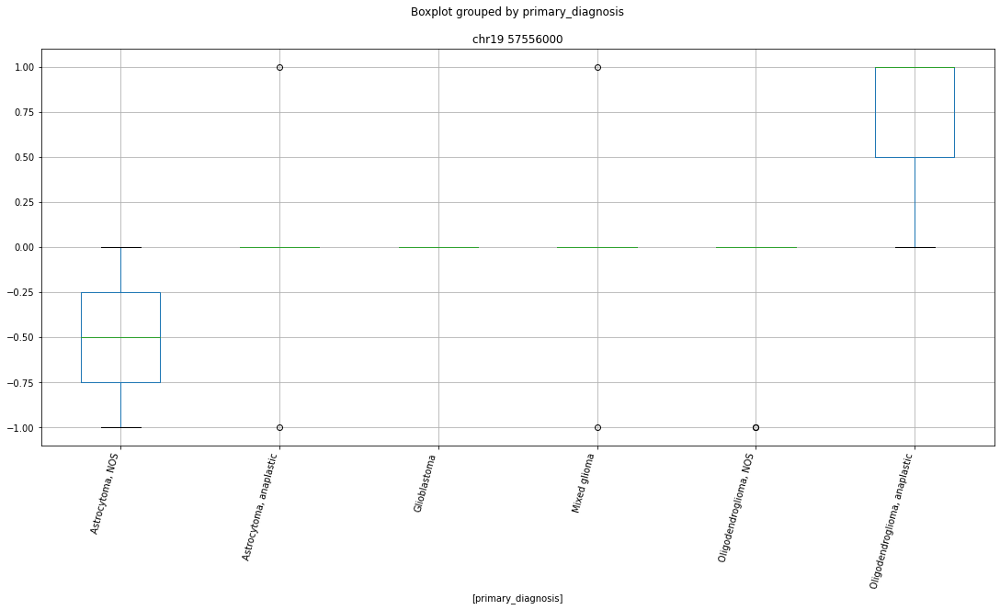

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr19 51906000


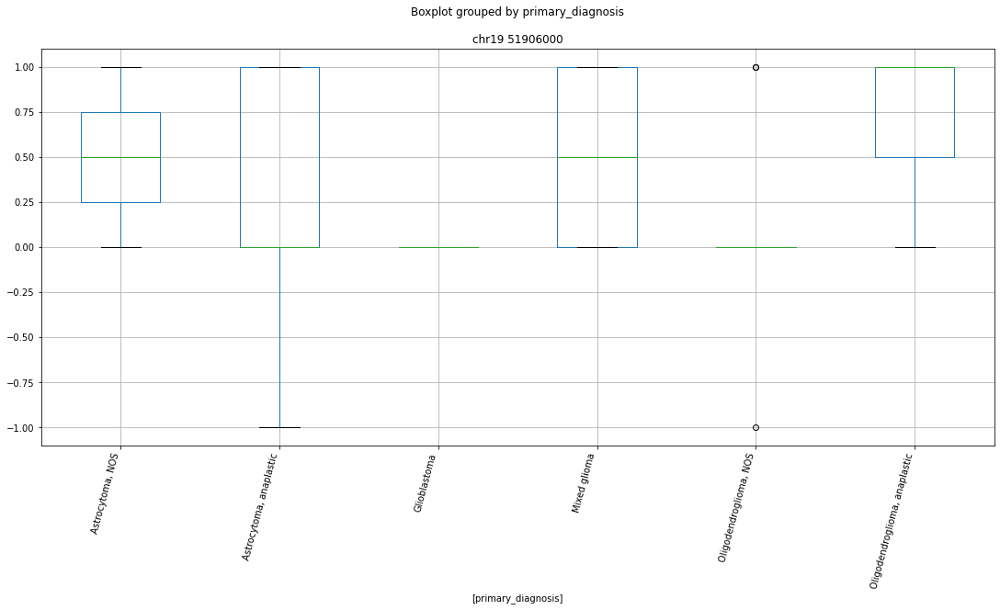

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr19 21776000


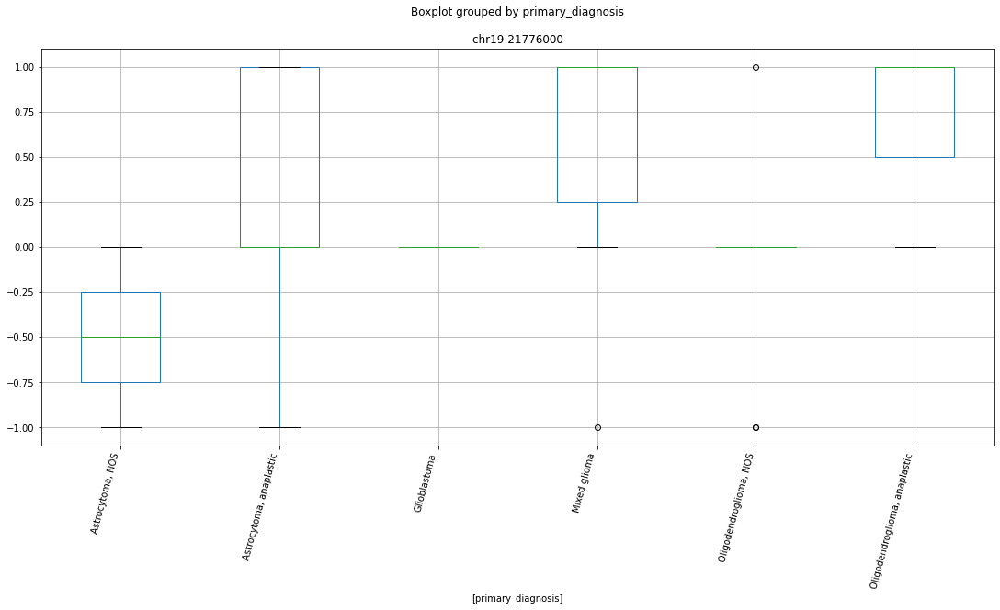

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr19 19961000


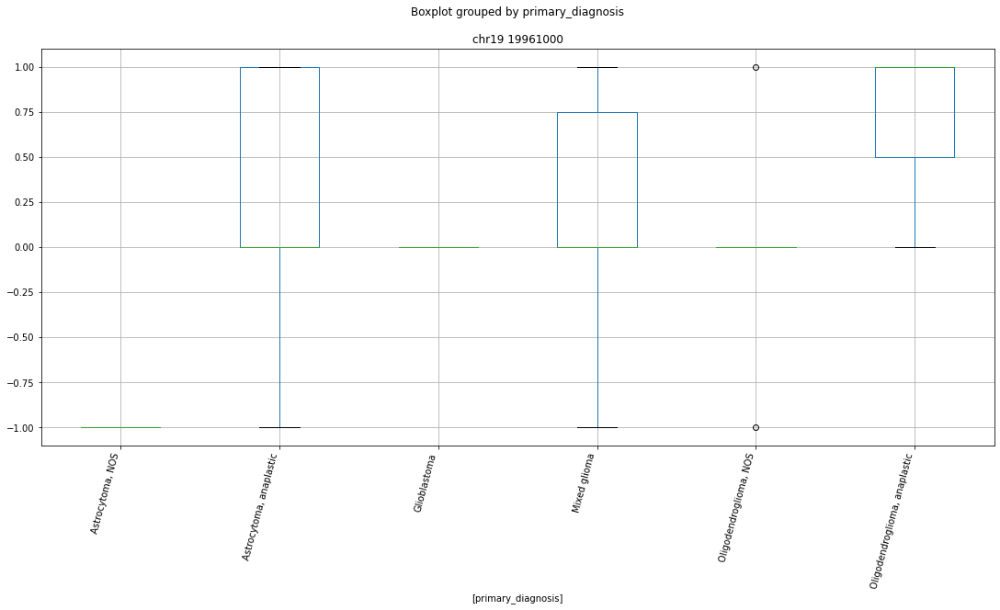

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr19 37502000


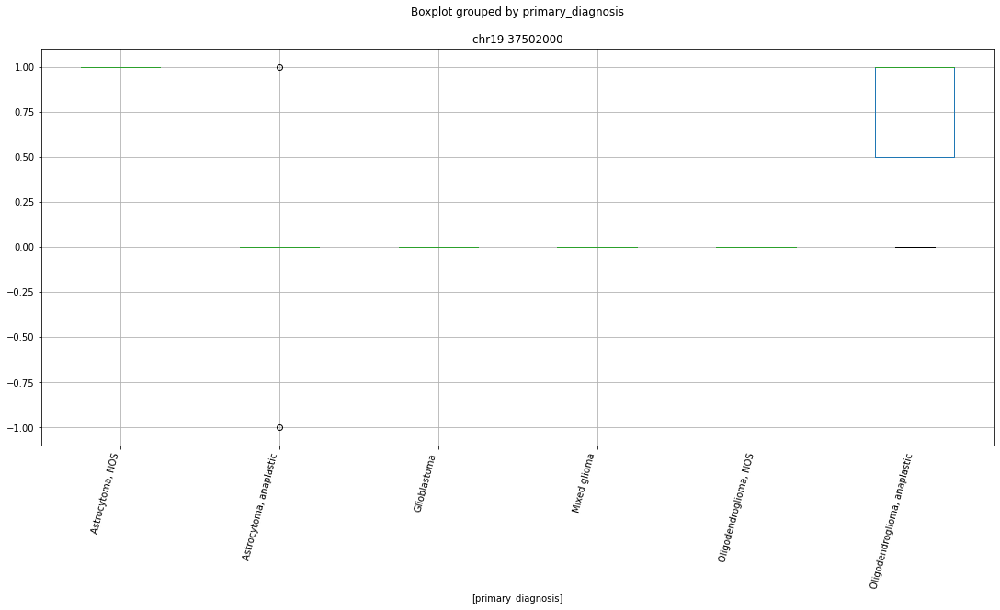

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr19 8315000


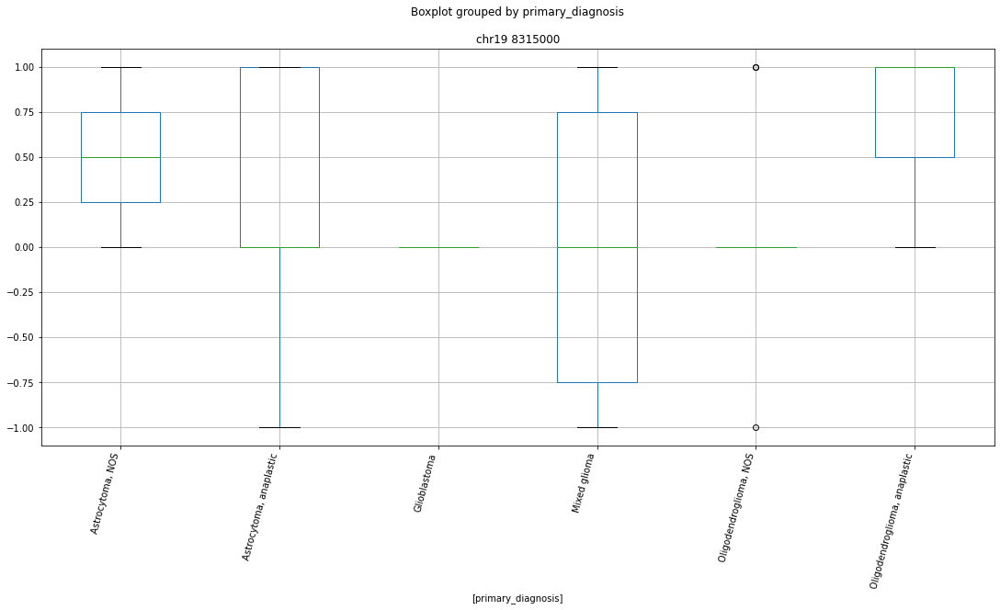

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr19 51957000


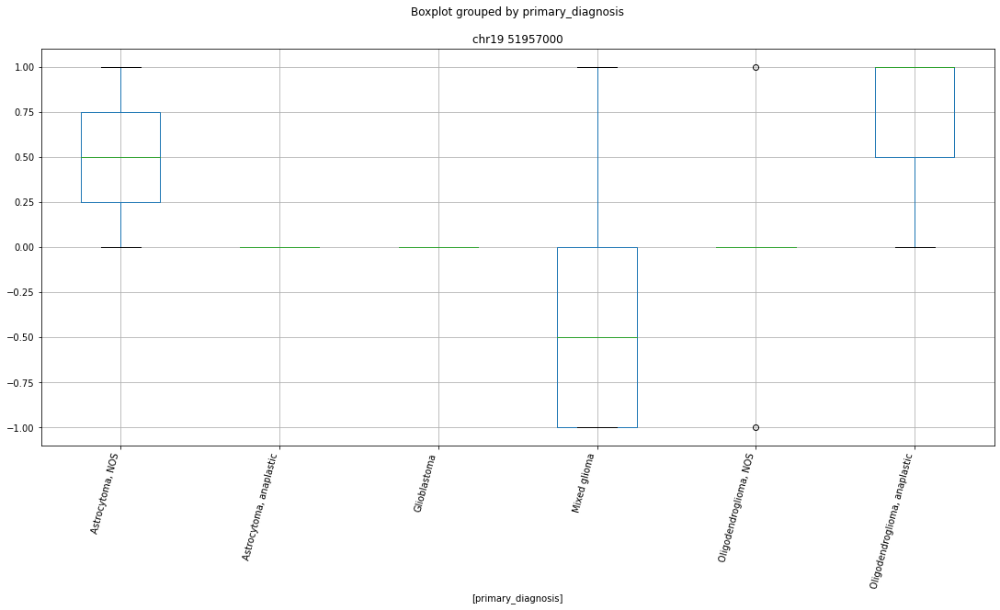

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr19 21606000


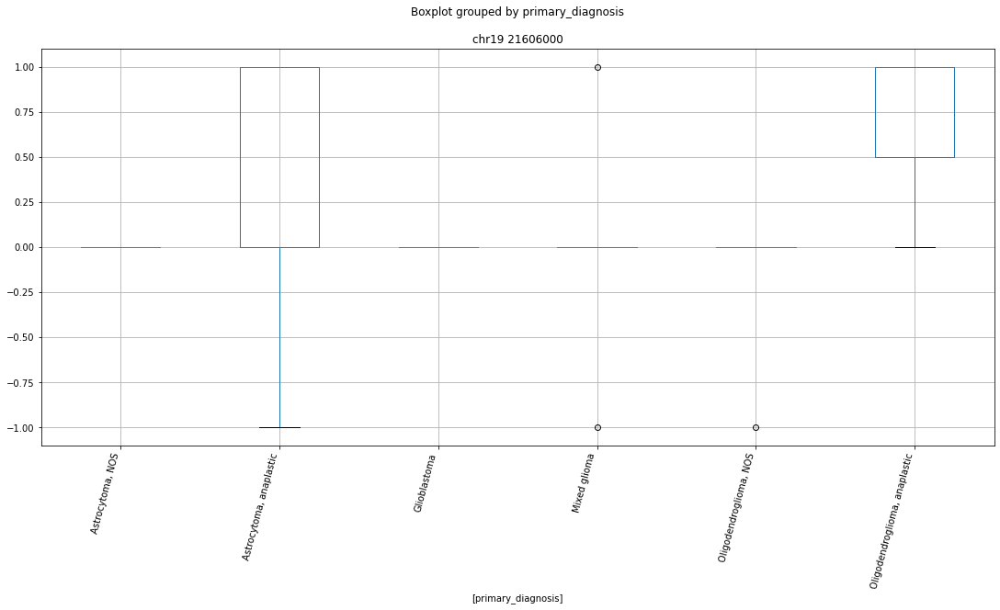

 p : 3.4049793131136327e-09  ( t : 7.895146188218008 ) :  chr19 53269000


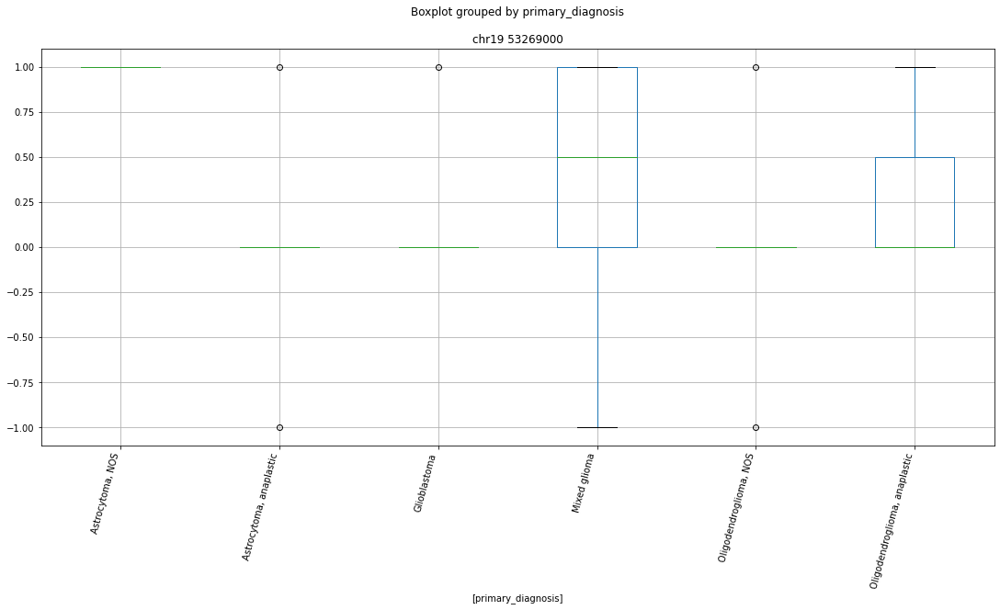

 p : 1.0281248528555288e-08  ( t : 8.514898502242788 ) :  chr19 20152000


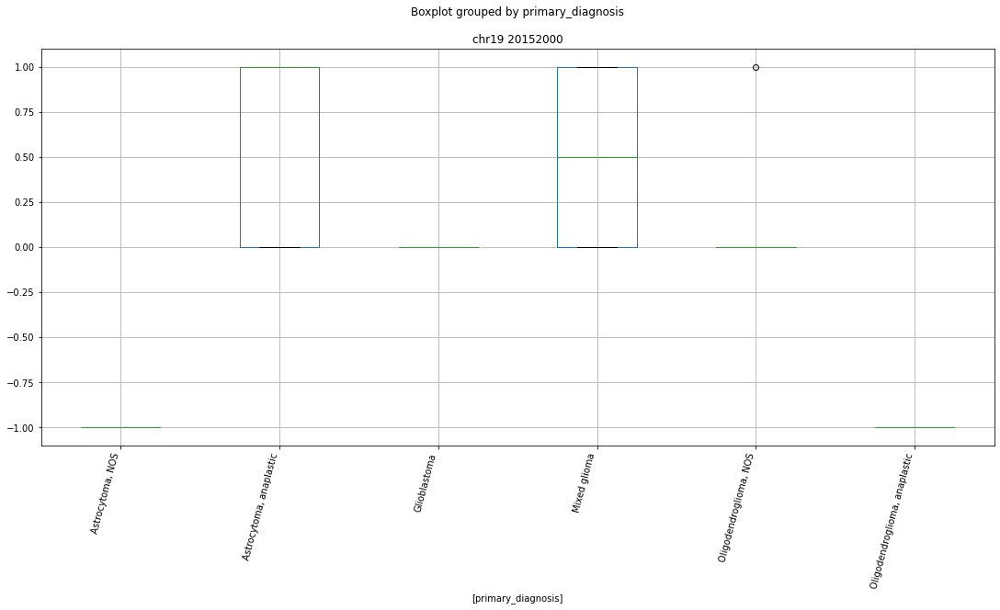

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr19 20152000


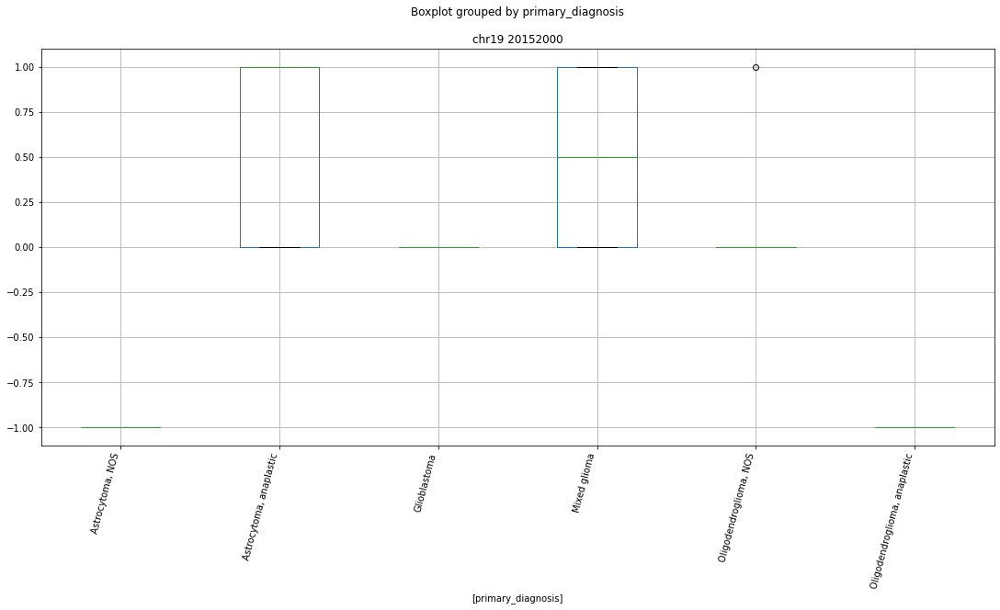

 p : 4.8673695437126455e-08  ( t : 7.805323627055891 ) :  chr19 57824000


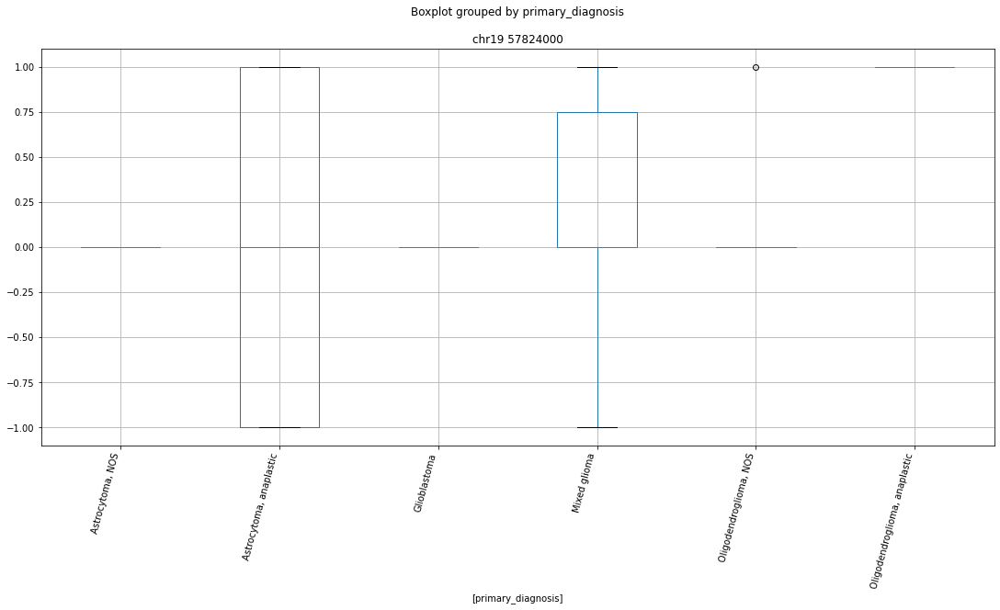

['chr19 11276000' 'chr19 11303000' 'chr19 11323000' 'chr19 11890000'
 'chr19 12231000' 'chr19 12362000' 'chr19 1288000' 'chr19 15363000'
 'chr19 17919000' 'chr19 18005000' 'chr19 19961000' 'chr19 19962000'
 'chr19 20082000' 'chr19 20083000' 'chr19 20138000' 'chr19 20152000'
 'chr19 20156000' 'chr19 20175000' 'chr19 20214000' 'chr19 20276000'
 'chr19 20286000' 'chr19 20296000' 'chr19 20466000' 'chr19 20467000'
 'chr19 20952000' 'chr19 21048000' 'chr19 21486000' 'chr19 21511000'
 'chr19 21551000' 'chr19 21568000' 'chr19 21606000' 'chr19 21722000'
 'chr19 21776000' 'chr19 22105000' 'chr19 22283000' 'chr19 22284000'
 'chr19 22568000' 'chr19 22871000' 'chr19 23077000' 'chr19 23078000'
 'chr19 23173000' 'chr19 23278000' 'chr19 23289000' 'chr19 23366000'
 'chr19 23419000' 'chr19 23724000' 'chr19 23936000' 'chr19 262000'
 'chr19 27637000' 'chr19 27678000' 'chr19 27814000' 'chr19 27815000'
 'chr19 28690000' 'chr19 29364000' 'chr19 29948000' 'chr19 34133000'
 'chr19 34920000' 'chr19 35129000' 'c

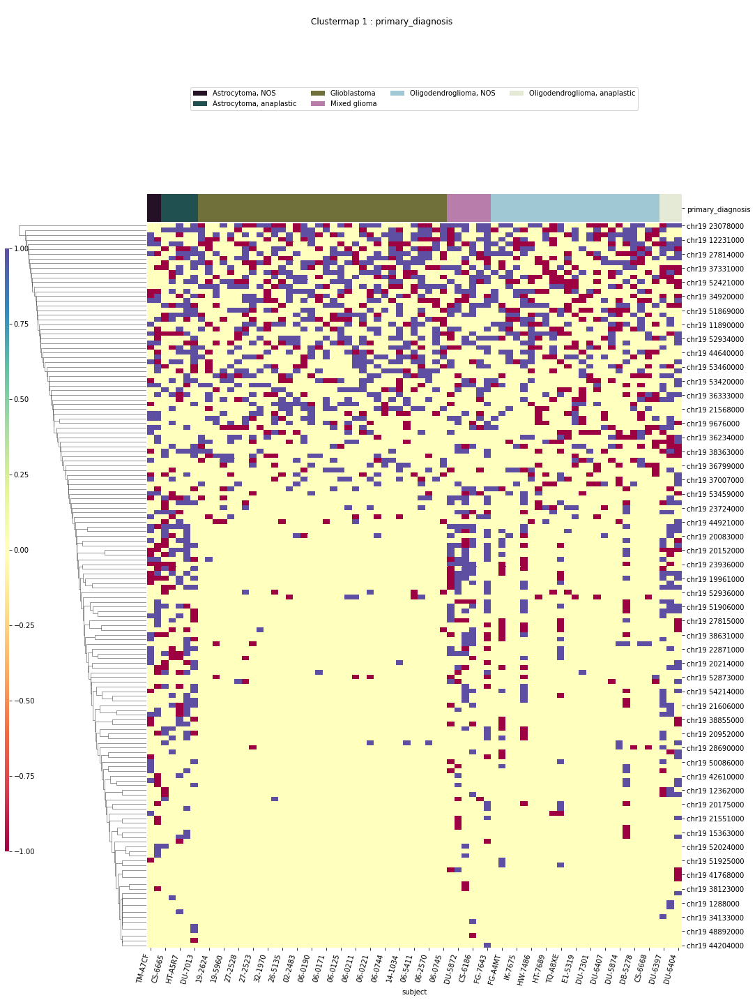

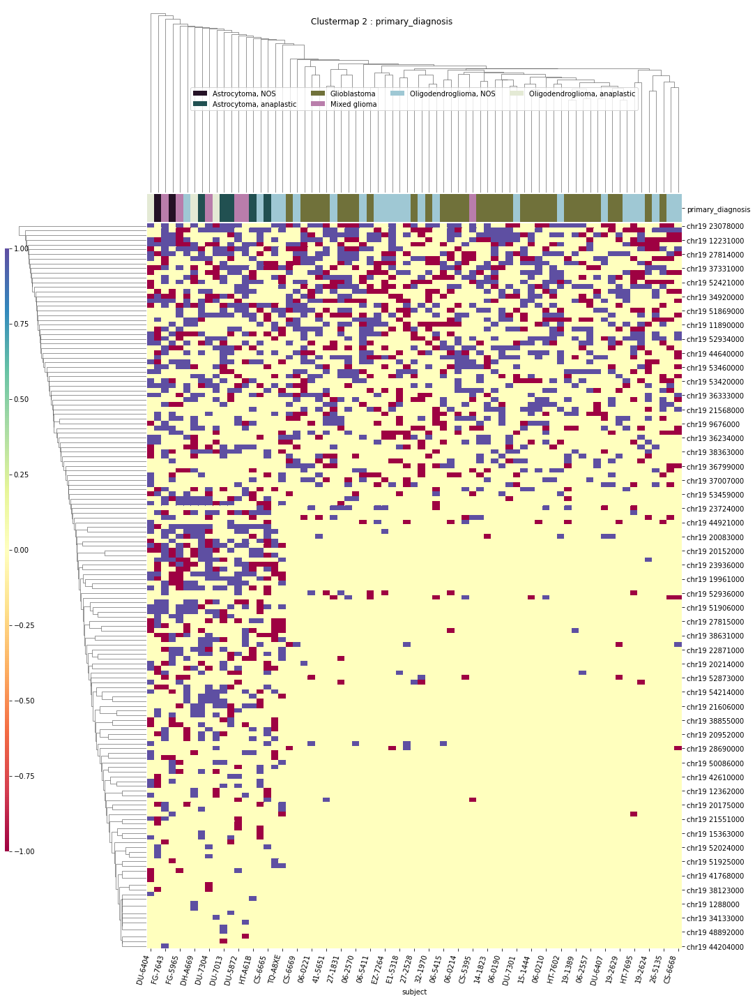

IDH
['IDH' 'chr19 11276000' 'chr19 20466000' 'chr19 21551000' 'chr19 21568000'
 'chr19 22284000' 'chr19 23936000' 'chr19 27814000' 'chr19 29364000'
 'chr19 36234000' 'chr19 36799000' 'chr19 37116000' 'chr19 37252000'
 'chr19 37867000' 'chr19 387000' 'chr19 39479000' 'chr19 39688000'
 'chr19 39689000' 'chr19 42676000' 'chr19 44595000' 'chr19 44639000'
 'chr19 51869000' 'chr19 52024000' 'chr19 52338000' 'chr19 52420000'
 'chr19 52421000' 'chr19 57556000' 'chr19 8315000' 'subject']


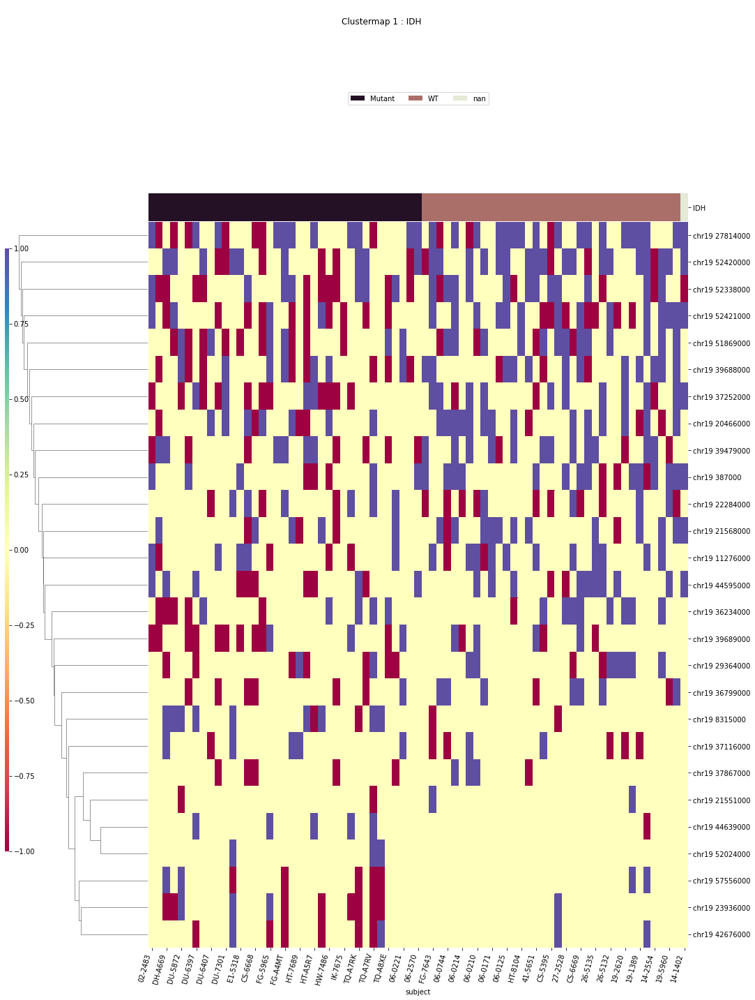

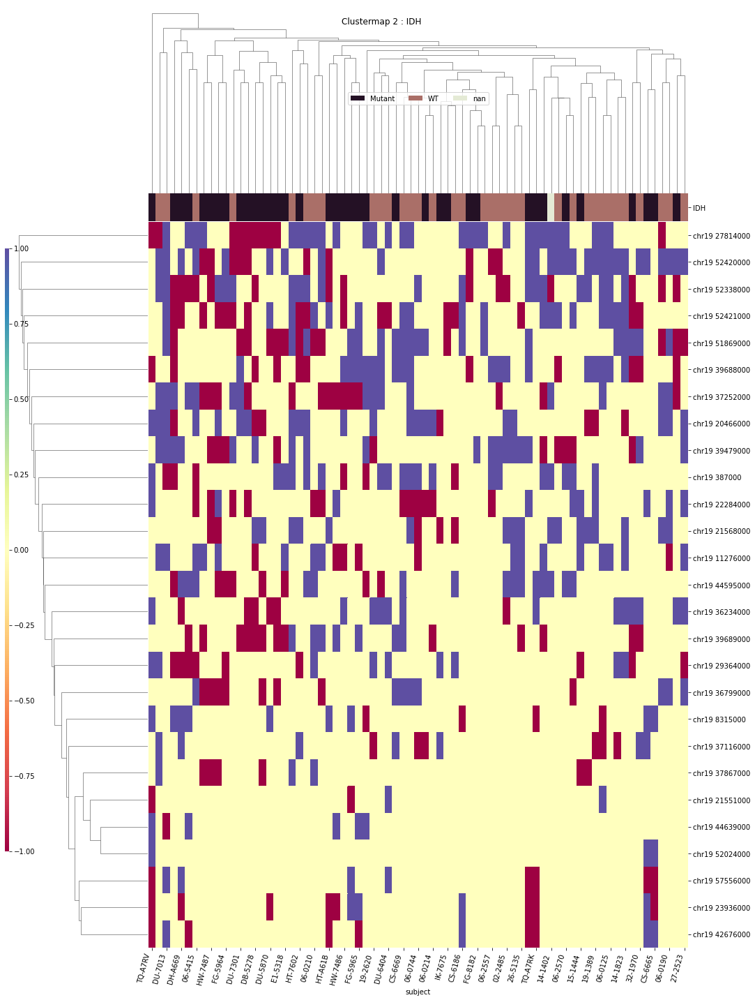

x1p19q
['chr19 1288000' 'chr19 15363000' 'chr19 20082000' 'chr19 20961000'
 'chr19 21708000' 'chr19 23289000' 'chr19 23723000' 'chr19 27814000'
 'chr19 28130000' 'chr19 29364000' 'chr19 34133000' 'chr19 36234000'
 'chr19 36247000' 'chr19 36799000' 'chr19 37630000' 'chr19 37866000'
 'chr19 37867000' 'chr19 39480000' 'chr19 39688000' 'chr19 39689000'
 'chr19 41036000' 'chr19 41545000' 'chr19 43548000' 'chr19 44595000'
 'chr19 48890000' 'chr19 48933000' 'chr19 48934000' 'chr19 51869000'
 'chr19 51905000' 'chr19 52338000' 'chr19 52421000' 'chr19 52483000'
 'chr19 52873000' 'chr19 52944000' 'chr19 55717000' 'chr19 8315000'
 'subject' 'x1p19q']


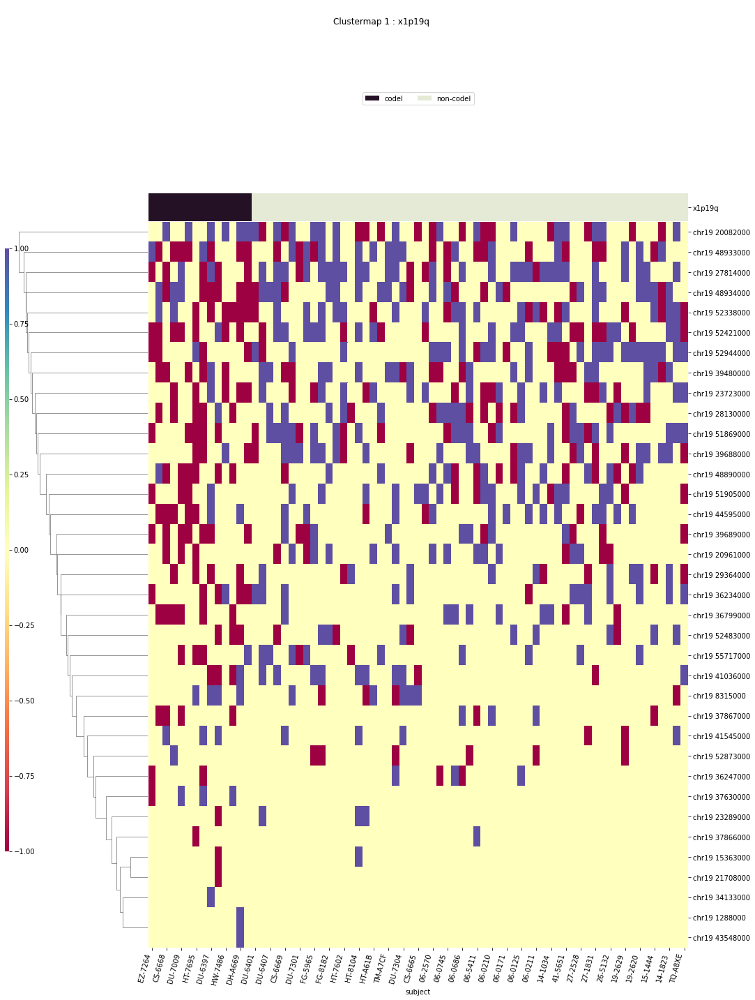

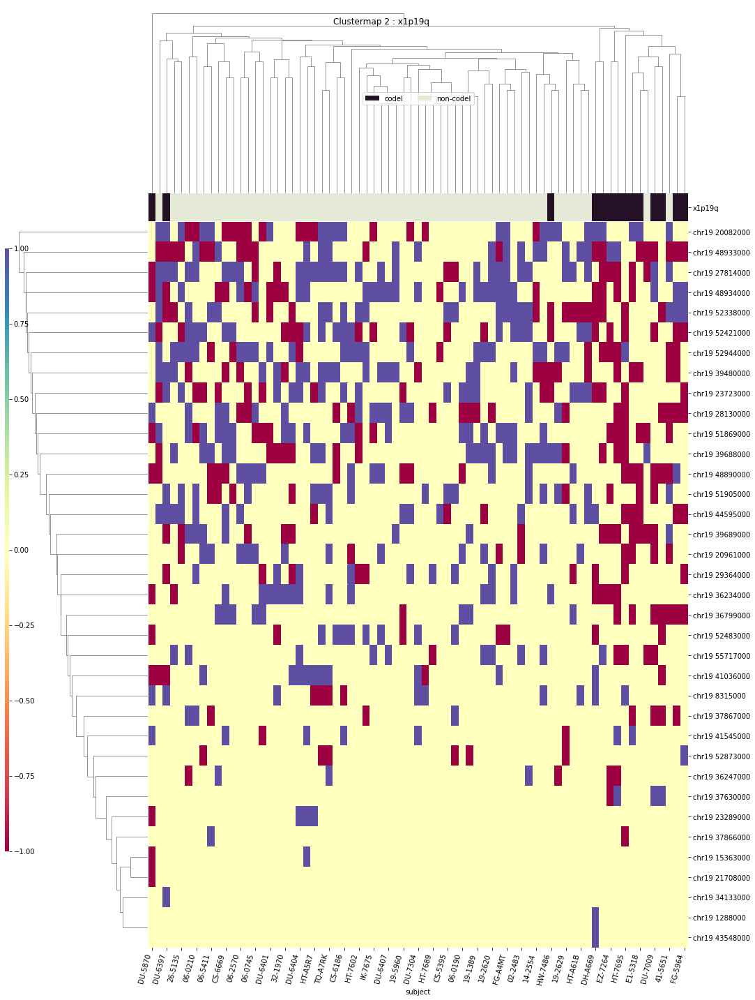

TERT
['TERT' 'chr19 11276000' 'chr19 11890000' 'chr19 20156000'
 'chr19 20961000' 'chr19 21486000' 'chr19 22568000' 'chr19 23173000'
 'chr19 23419000' 'chr19 36233000' 'chr19 37252000' 'chr19 37320000'
 'chr19 38123000' 'chr19 40823000' 'chr19 41036000' 'chr19 44639000'
 'chr19 51906000' 'chr19 52024000' 'chr19 52593000' 'chr19 52698000'
 'chr19 52740000' 'chr19 52742000' 'chr19 52750000' 'chr19 52873000'
 'chr19 57556000' 'subject']


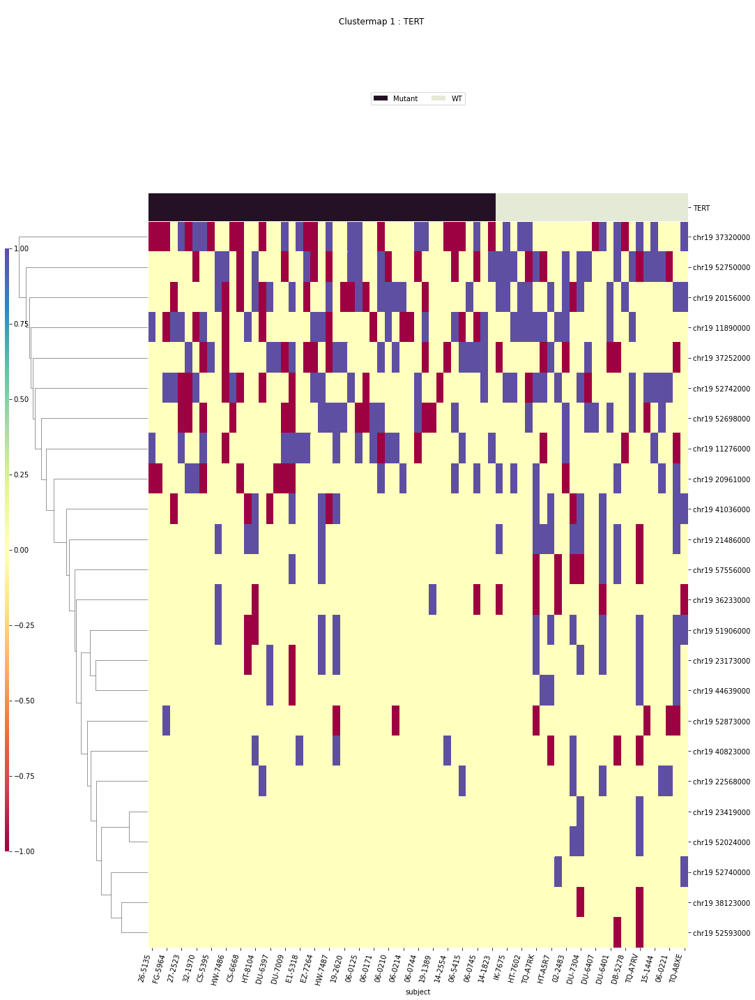

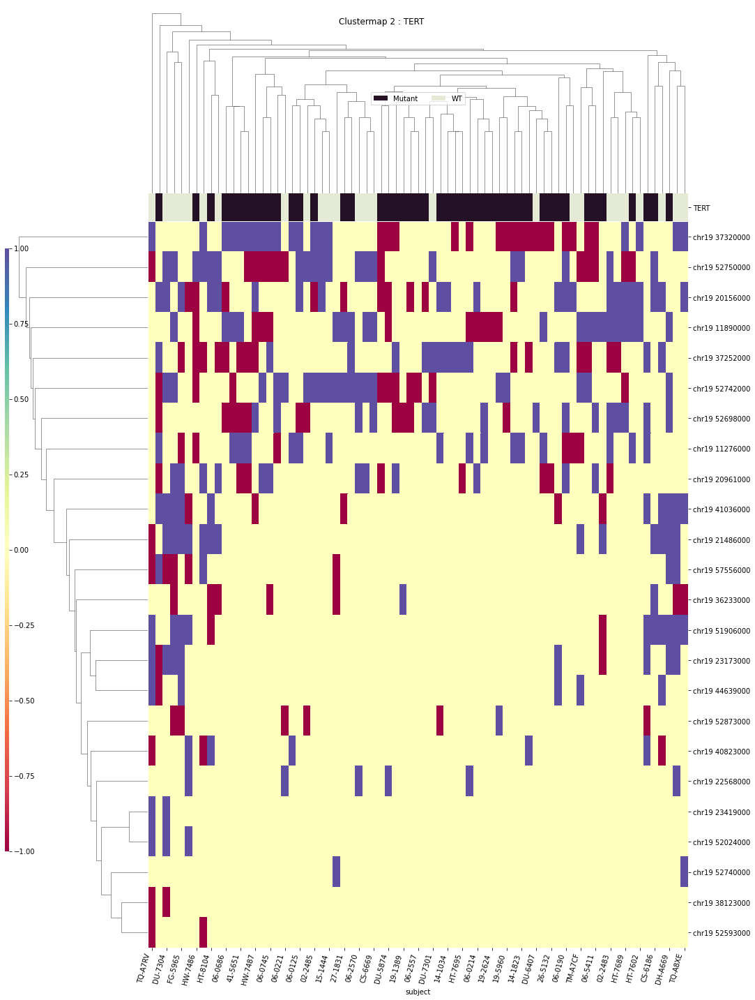

disease_type
['chr19 11276000' 'chr19 20467000' 'chr19 21486000' 'chr19 21568000'
 'chr19 22283000' 'chr19 23173000' 'chr19 27678000' 'chr19 36799000'
 'chr19 37629000' 'chr19 387000' 'chr19 41036000' 'chr19 41545000'
 'chr19 44280000' 'chr19 44595000' 'chr19 51906000' 'chr19 52420000'
 'chr19 52944000' 'chr19 53444000' 'disease_type' 'subject']


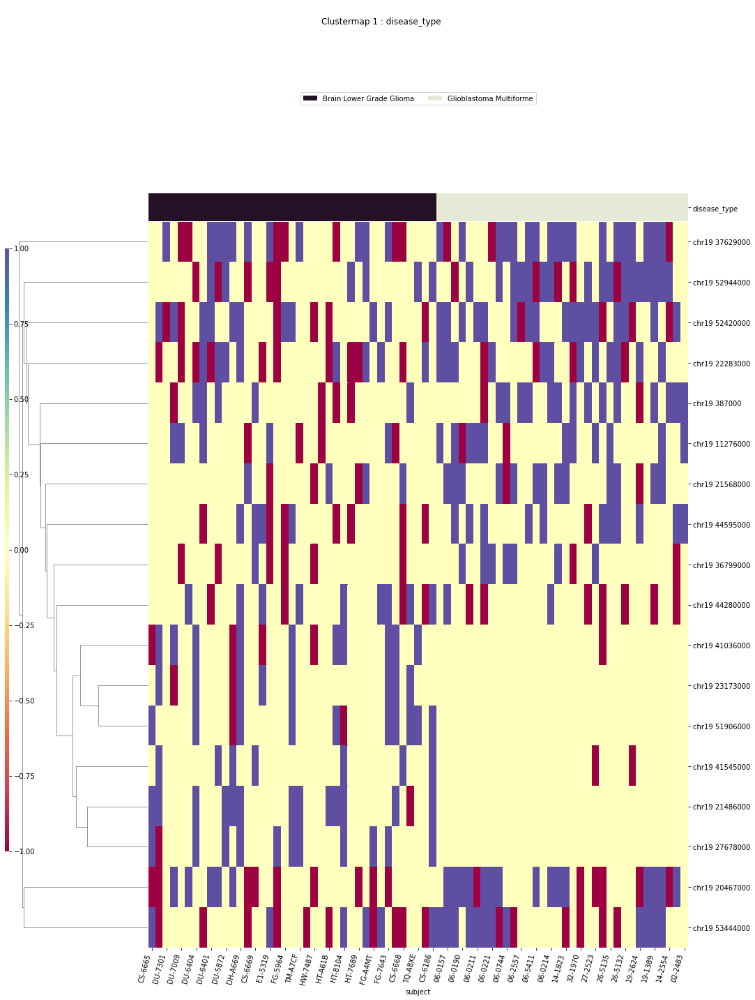

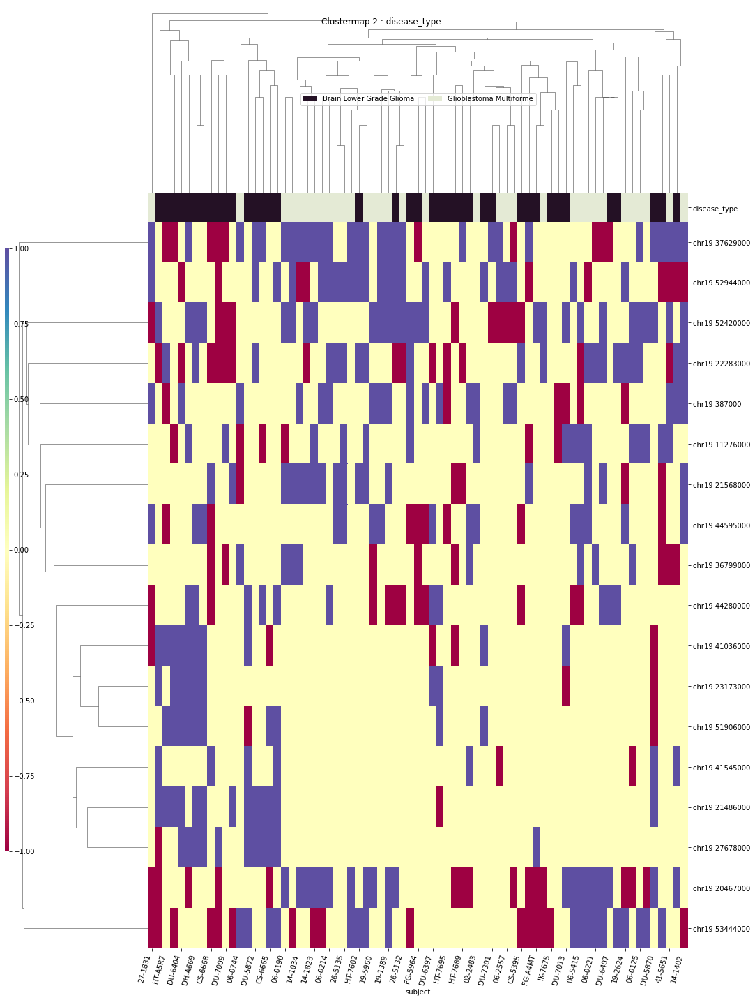

chr1_KI270709v1_random
HERVK113
primary_diagnosis
['primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chr2
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr2 94745000


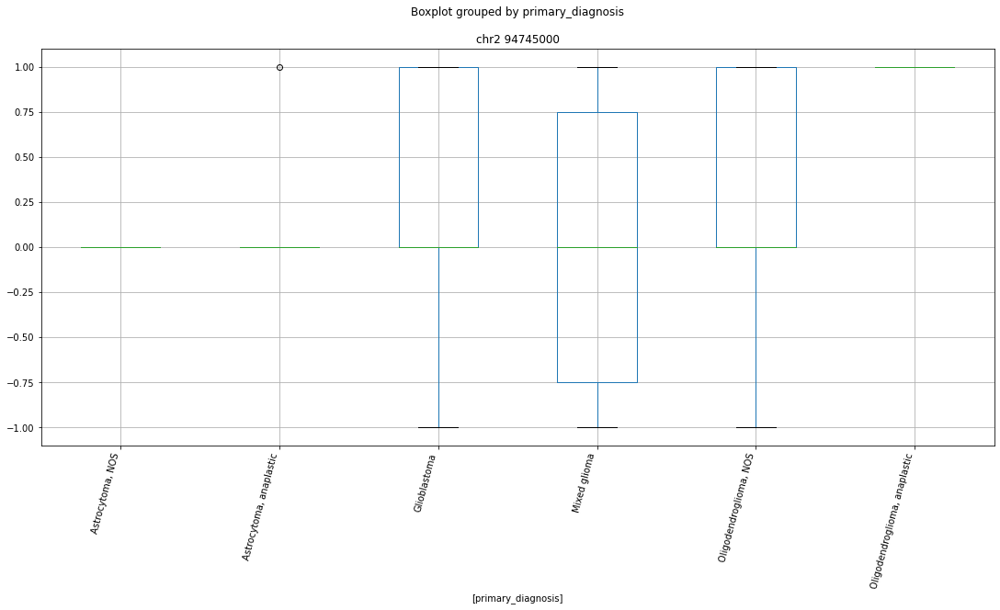

 p : 0.0  ( t : inf ) :  chr2 232906000


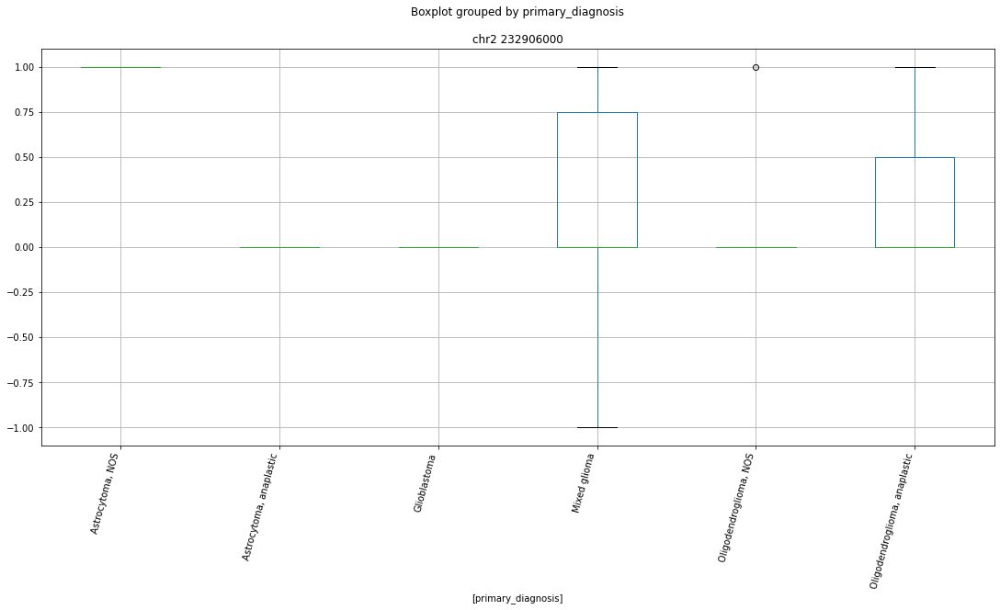

 p : 0.0  ( t : inf ) :  chr2 36180000


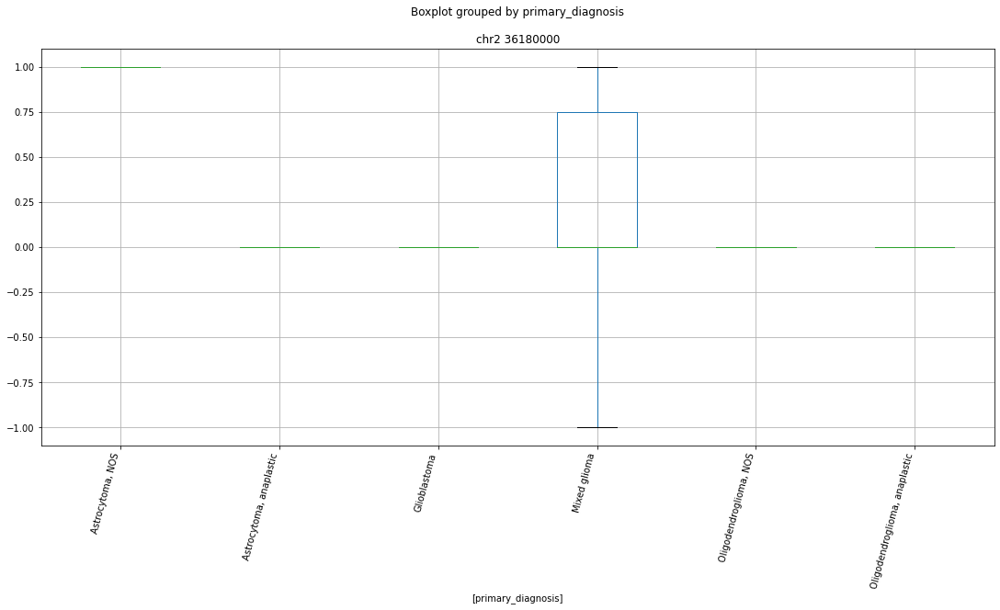

 p : 0.0  ( t : inf ) :  chr2 3568000


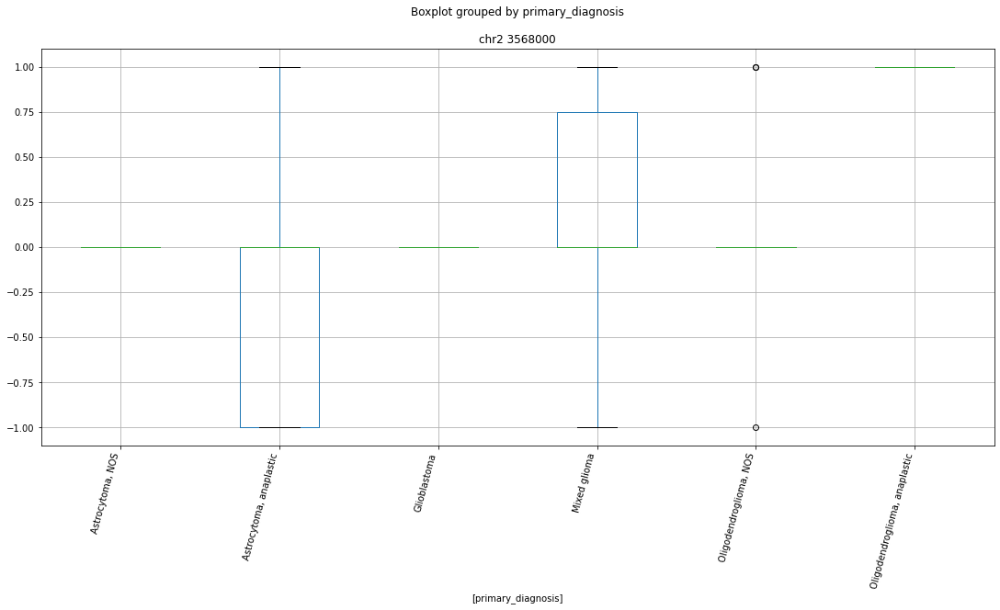

 p : 2.948014870353662e-15  ( t : 12.708265027138834 ) :  chr2 71542000


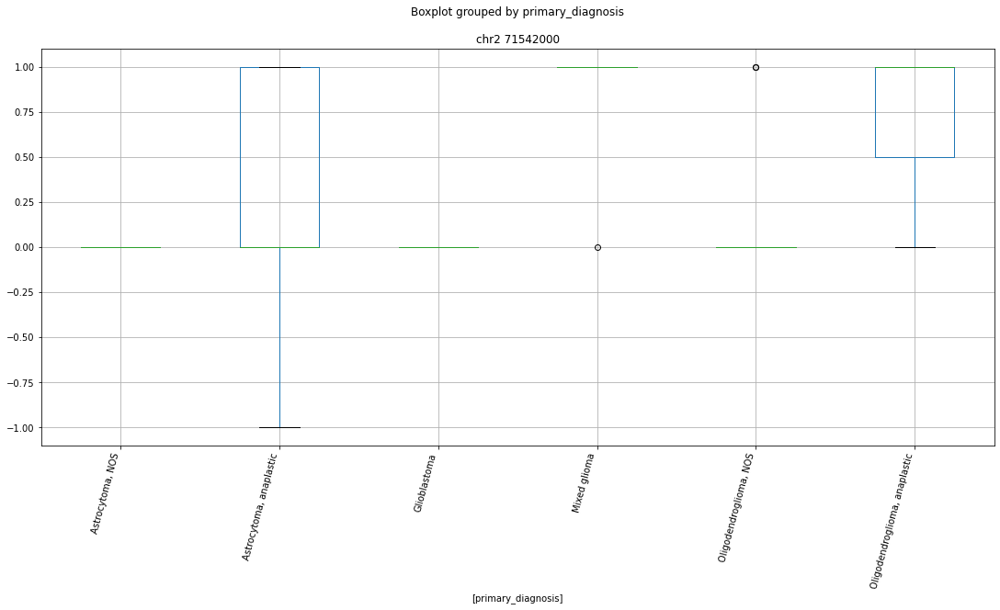

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr2 143992000


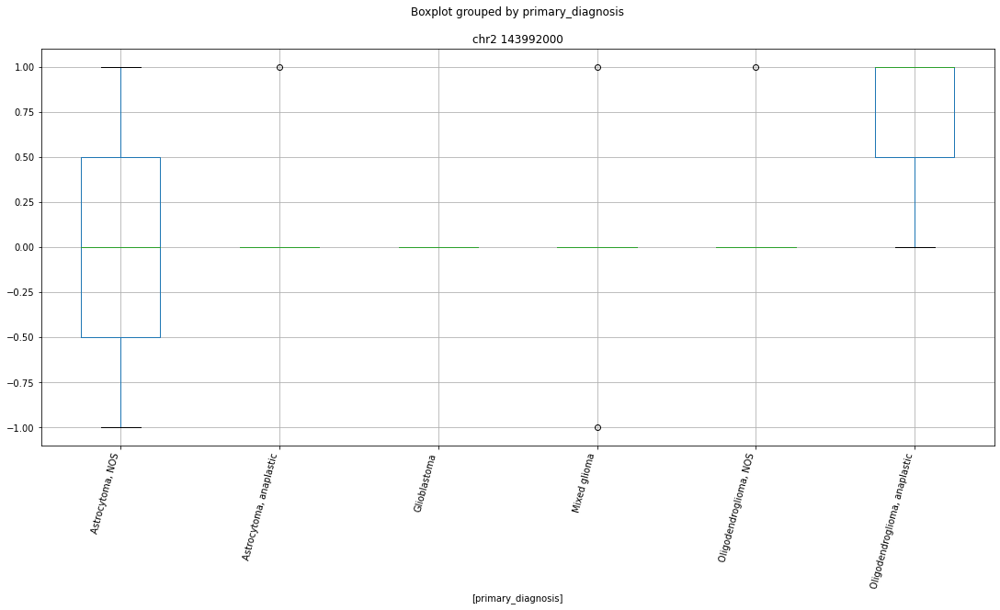

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr2 134968000


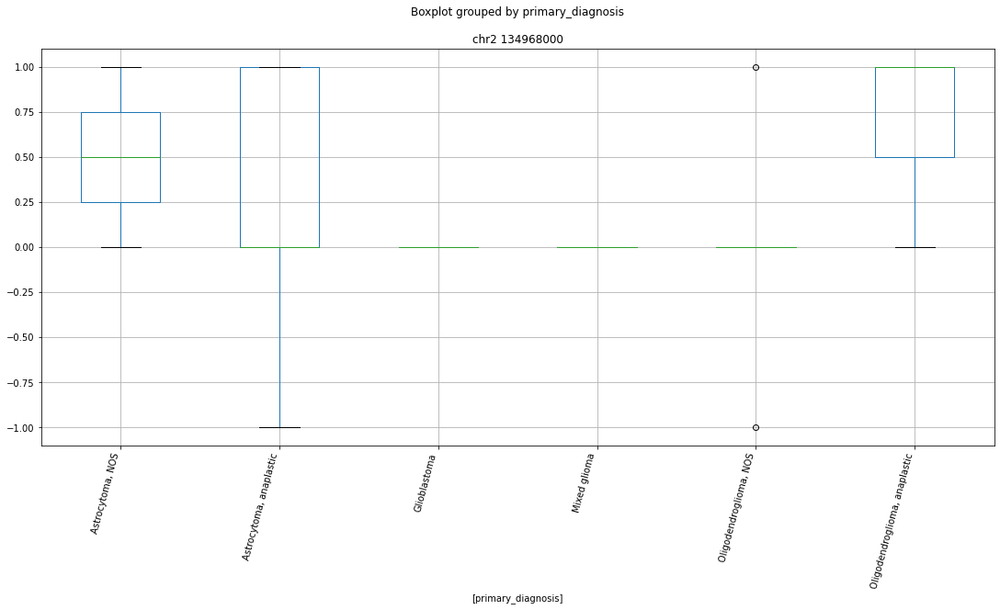

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr2 95243000


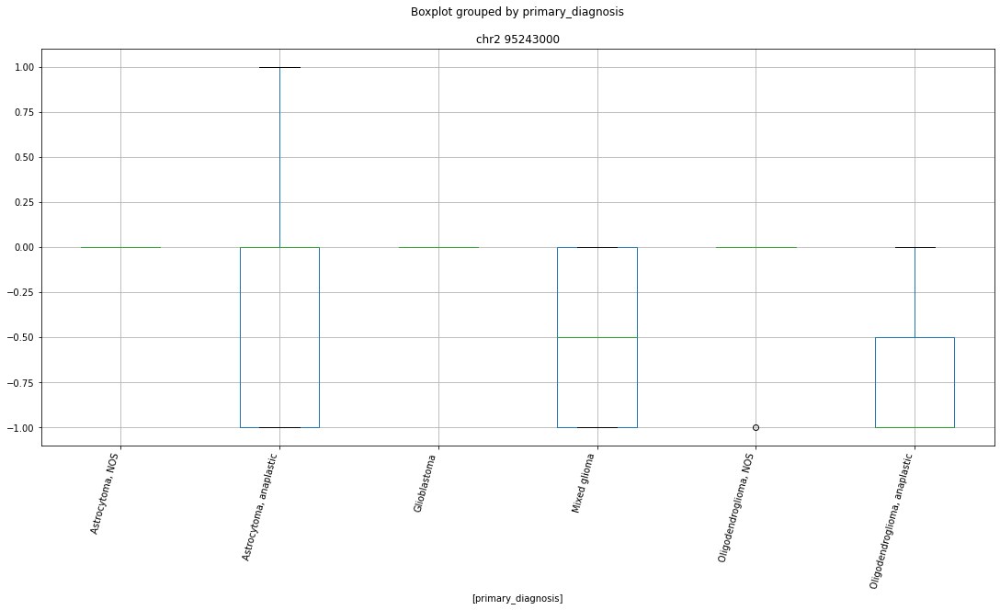

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr2 201239000


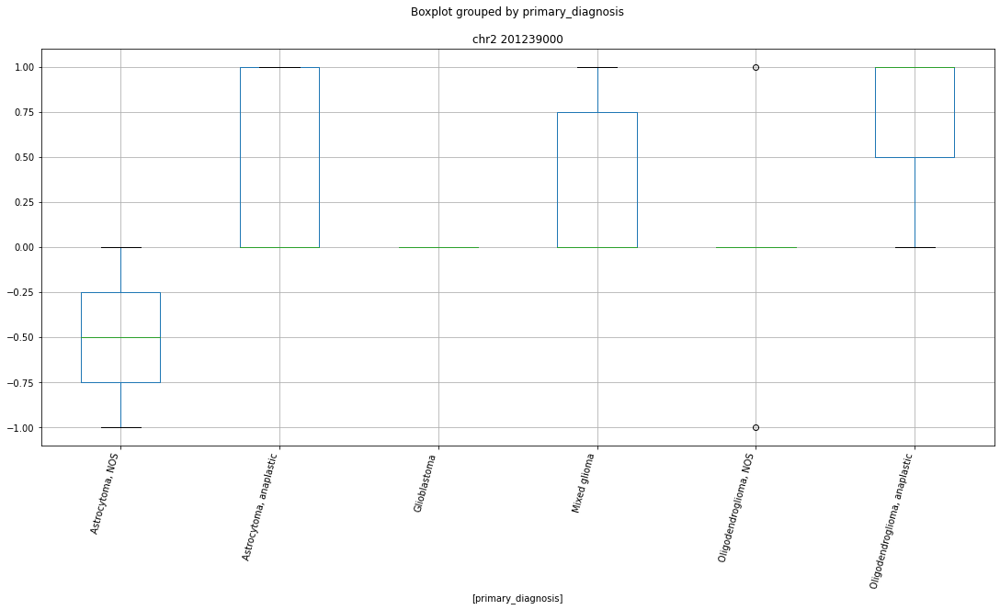

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr2 75725000


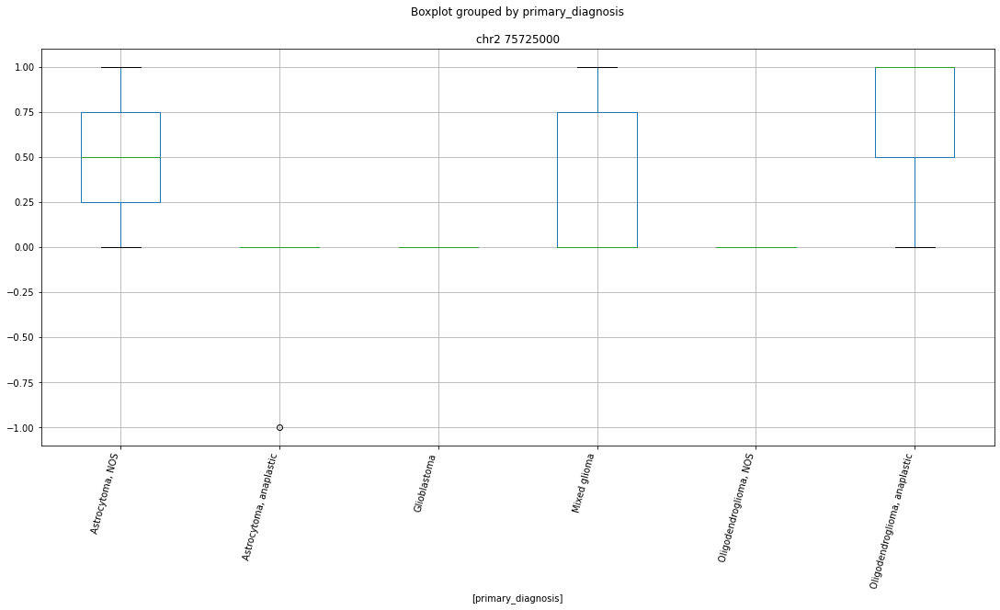

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr2 182386000


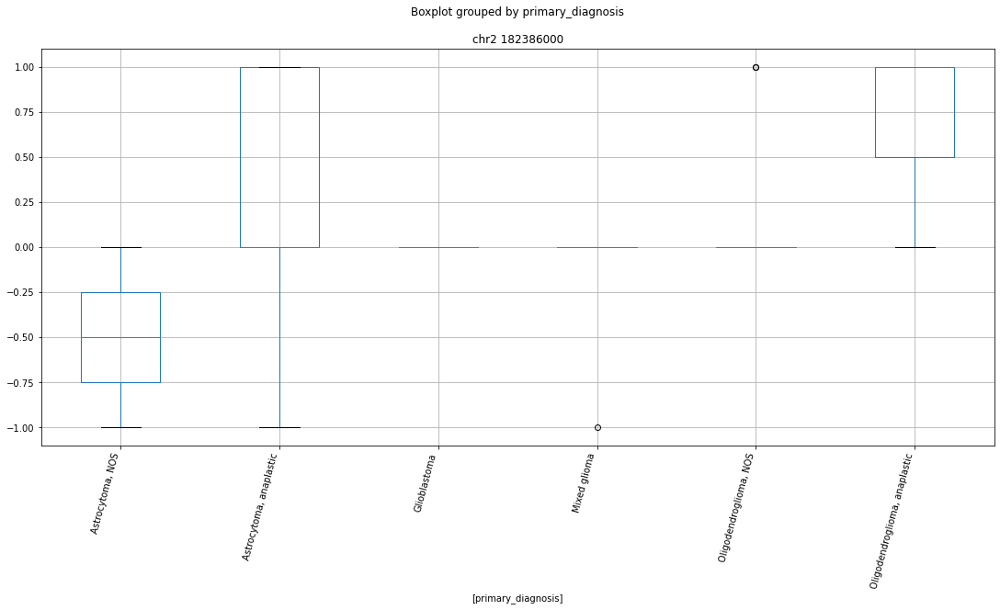

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr2 55651000


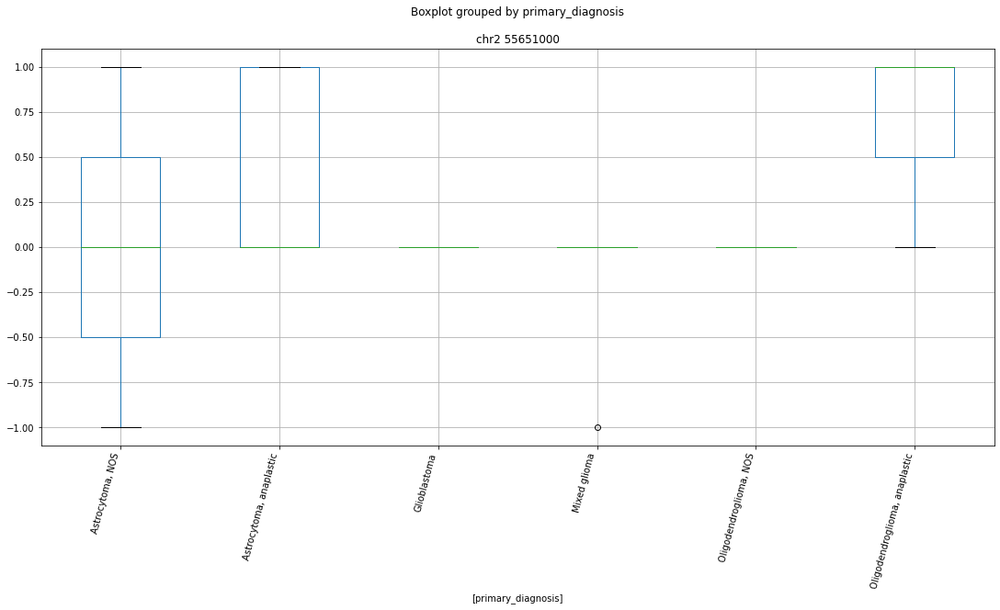

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr2 71542000


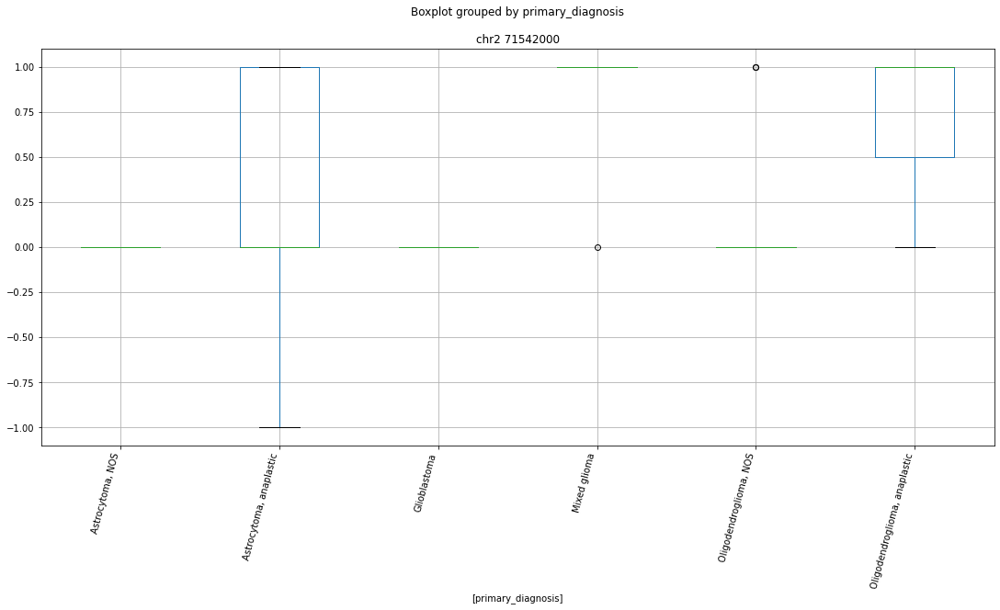

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr2 65600000


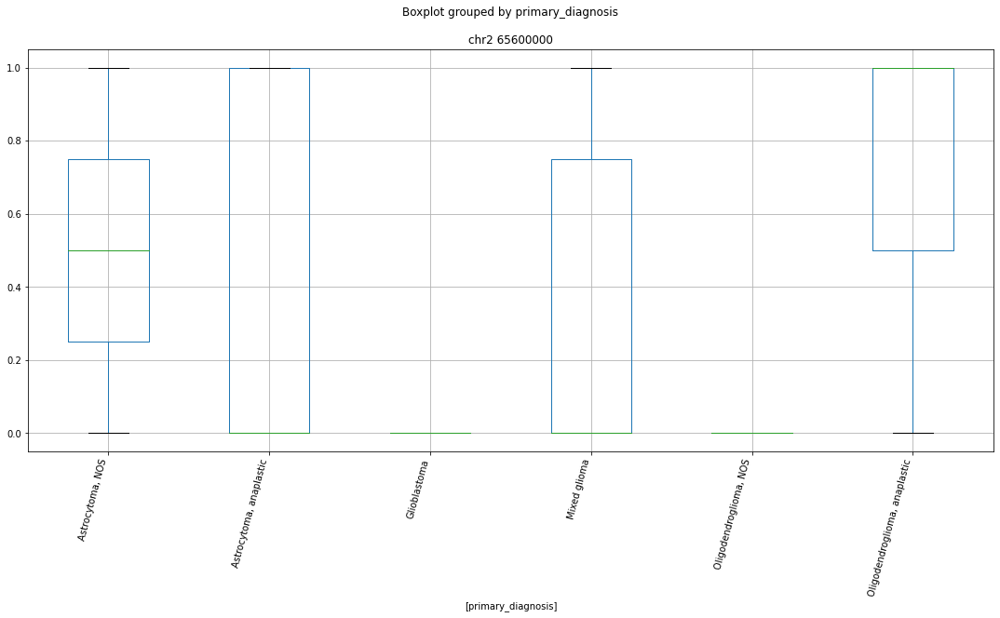

['chr2 100270000' 'chr2 100684000' 'chr2 100685000' 'chr2 105210000'
 'chr2 105251000' 'chr2 105426000' 'chr2 109636000' 'chr2 112934000'
 'chr2 115057000' 'chr2 125277000' 'chr2 127000' 'chr2 127542000'
 'chr2 127543000' 'chr2 127787000' 'chr2 134064000' 'chr2 134968000'
 'chr2 135706000' 'chr2 138872000' 'chr2 142696000' 'chr2 142702000'
 'chr2 143921000' 'chr2 143992000' 'chr2 152161000' 'chr2 15219000'
 'chr2 15611000' 'chr2 156451000' 'chr2 15679000' 'chr2 159634000'
 'chr2 160438000' 'chr2 162470000' 'chr2 170150000' 'chr2 171900000'
 'chr2 177844000' 'chr2 179319000' 'chr2 182386000' 'chr2 183479000'
 'chr2 186153000' 'chr2 186473000' 'chr2 190430000' 'chr2 191742000'
 'chr2 192541000' 'chr2 192542000' 'chr2 193142000' 'chr2 193143000'
 'chr2 198584000' 'chr2 200683000' 'chr2 201166000' 'chr2 201239000'
 'chr2 201282000' 'chr2 203207000' 'chr2 206171000' 'chr2 206355000'
 'chr2 207037000' 'chr2 20778000' 'chr2 211223000' 'chr2 214802000'
 'chr2 215163000' 'chr2 218312000' 'chr2 

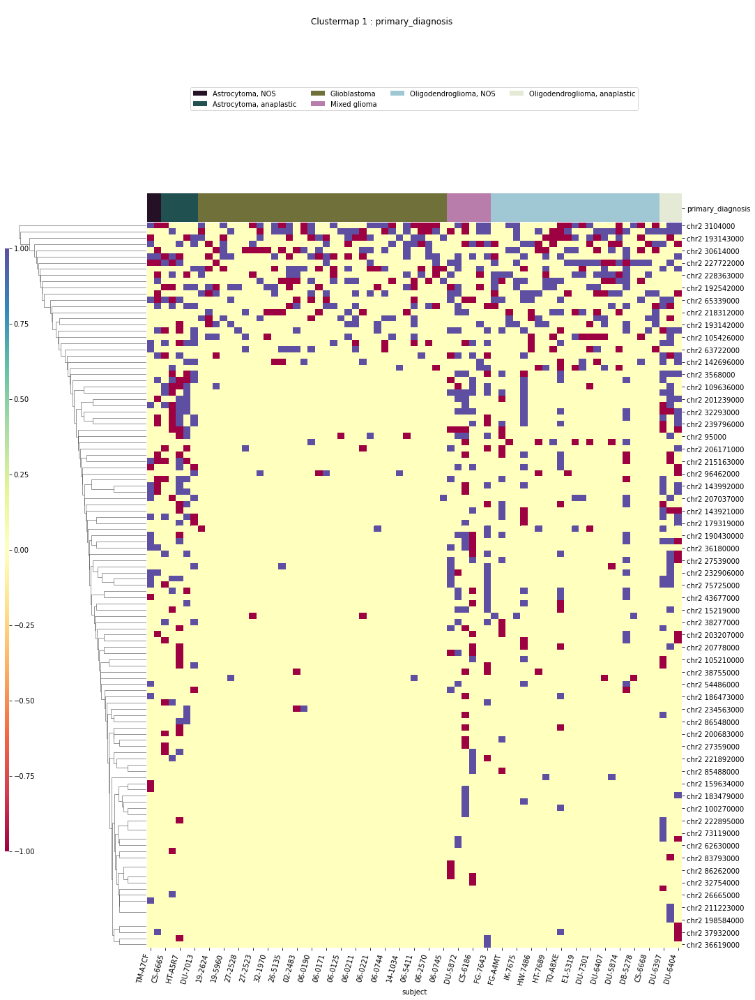

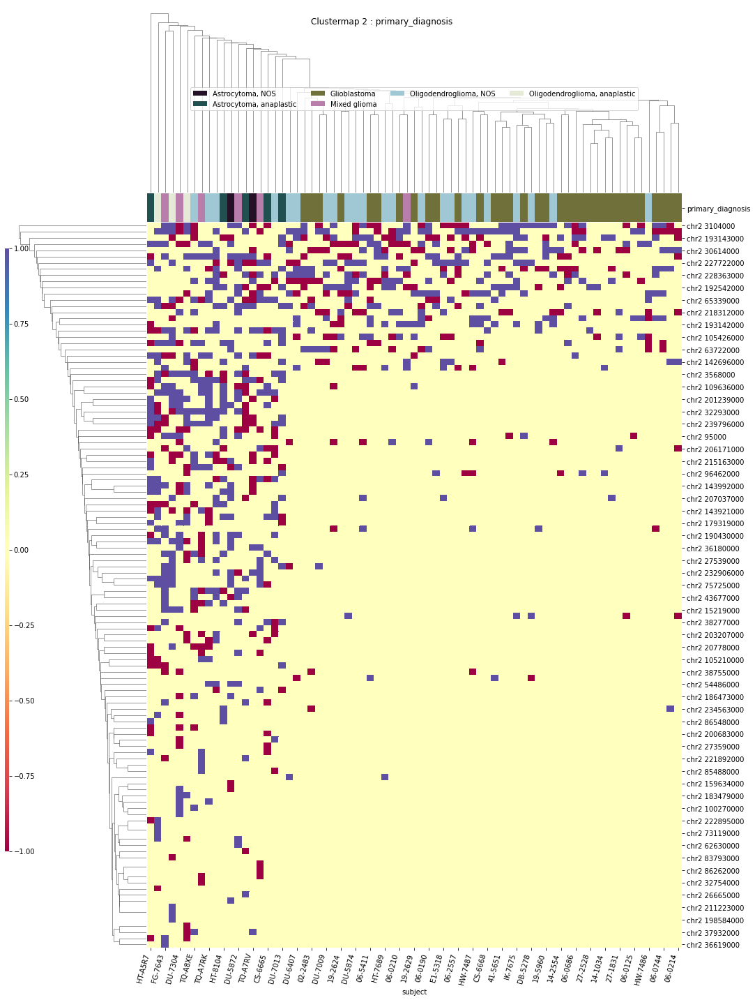

IDH
['IDH' 'chr2 125277000' 'chr2 127000' 'chr2 201282000' 'chr2 228363000'
 'chr2 231576000' 'chr2 234563000' 'chr2 32276000' 'chr2 32870000'
 'chr2 33761000' 'chr2 36180000' 'chr2 37932000' 'chr2 54486000'
 'chr2 65339000' 'chr2 65600000' 'chr2 95243000' 'subject']


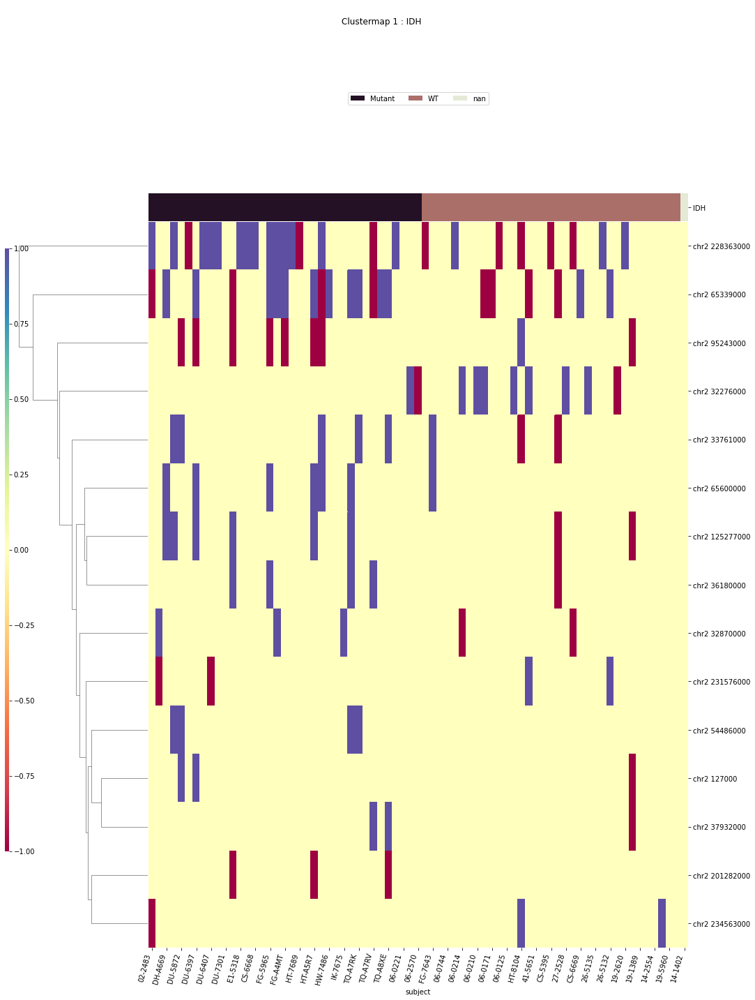

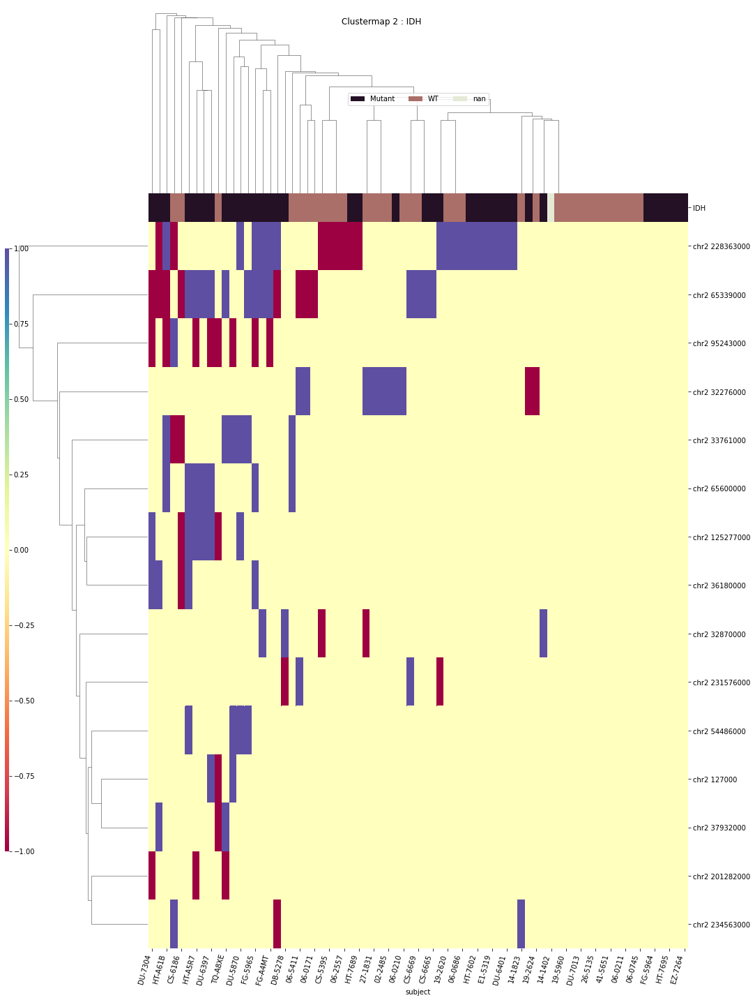

x1p19q
['chr2 112934000' 'chr2 125277000' 'chr2 127542000' 'chr2 129702000'
 'chr2 169855000' 'chr2 189654000' 'chr2 194505000' 'chr2 198584000'
 'chr2 203207000' 'chr2 206355000' 'chr2 207037000' 'chr2 20778000'
 'chr2 211223000' 'chr2 214802000' 'chr2 216118000' 'chr2 222895000'
 'chr2 227722000' 'chr2 27459000' 'chr2 63722000' 'chr2 71161000'
 'chr2 73119000' 'chr2 83793000' 'chr2 8568000' 'chr2 96462000' 'subject'
 'x1p19q']


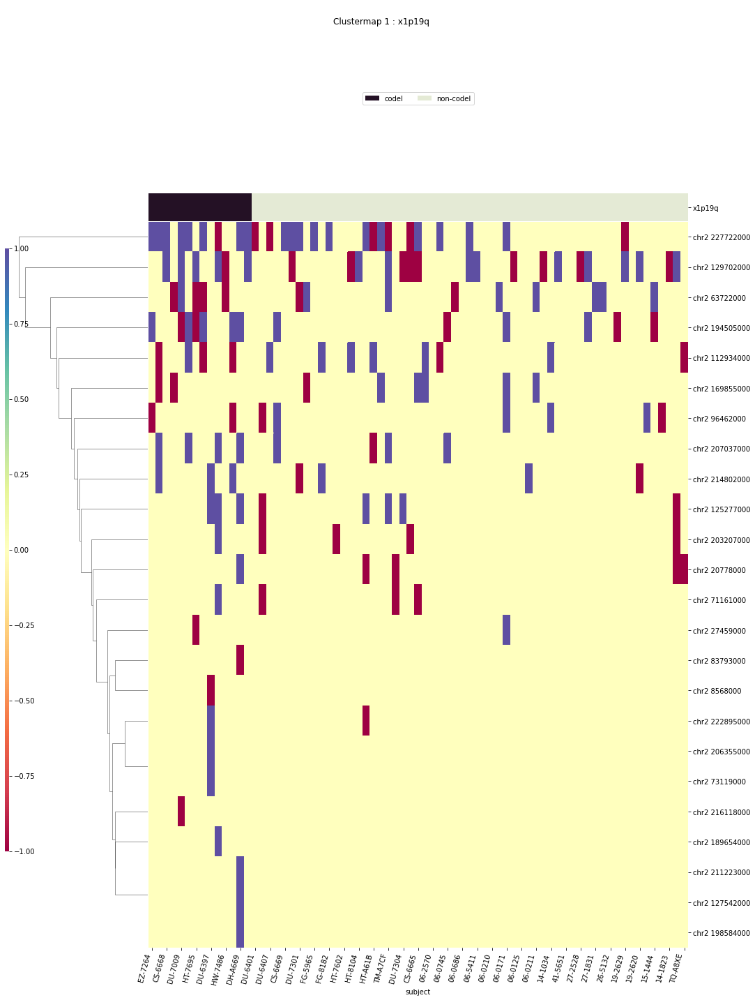

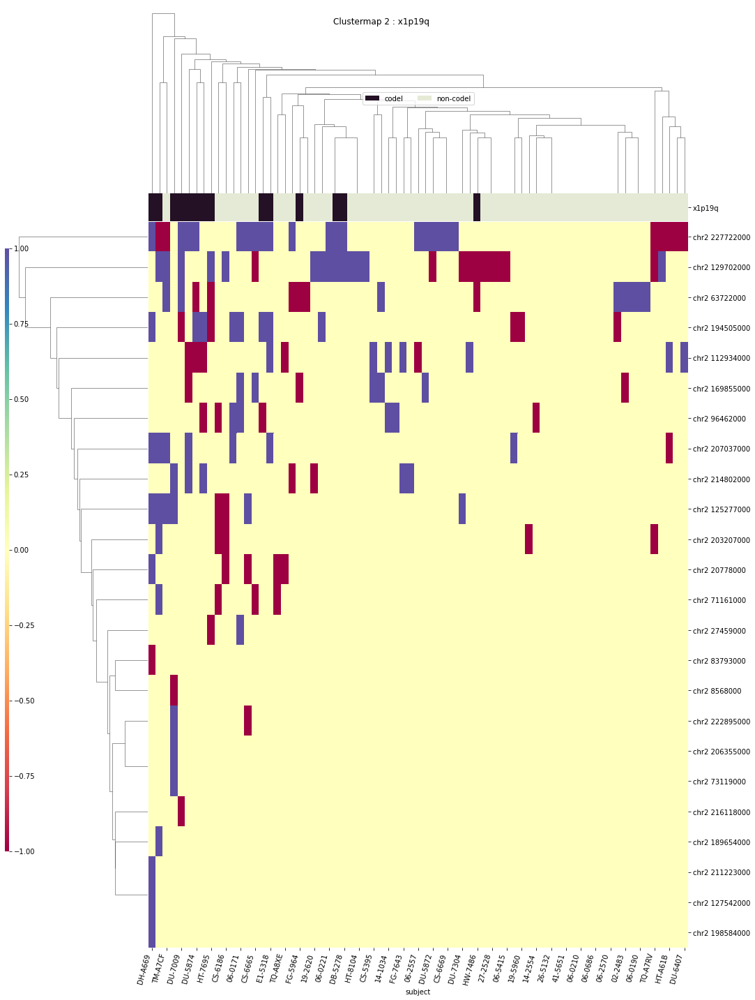

TERT
['TERT' 'chr2 100270000' 'chr2 108727000' 'chr2 160438000'
 'chr2 183479000' 'chr2 186153000' 'chr2 191742000' 'chr2 200683000'
 'chr2 201282000' 'chr2 203207000' 'chr2 20778000' 'chr2 231576000'
 'chr2 234169000' 'chr2 27359000' 'chr2 32293000' 'chr2 32870000'
 'chr2 33761000' 'chr2 36180000' 'chr2 44589000' 'chr2 54486000'
 'chr2 71161000' 'chr2 95243000' 'subject']


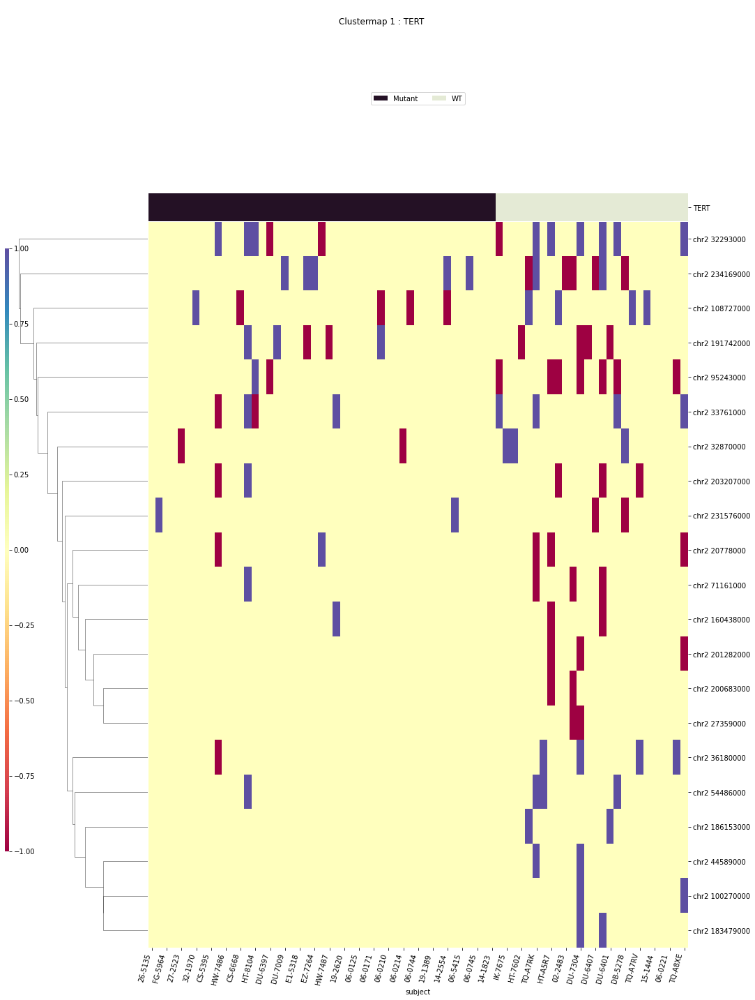

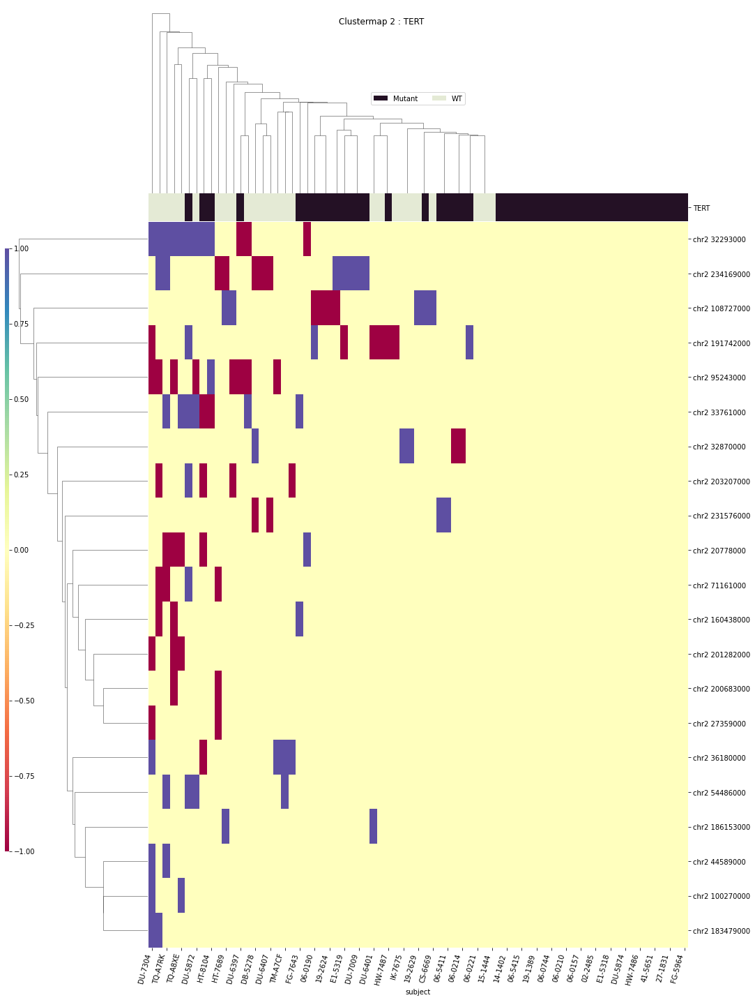

disease_type
['chr2 100685000' 'chr2 105426000' 'chr2 228364000' 'chr2 231576000'
 'chr2 231577000' 'chr2 232906000' 'chr2 32276000' 'chr2 32870000'
 'chr2 39321000' 'chr2 54486000' 'chr2 63722000' 'chr2 65339000'
 'chr2 65600000' 'chr2 71542000' 'chr2 95243000' 'disease_type' 'subject']


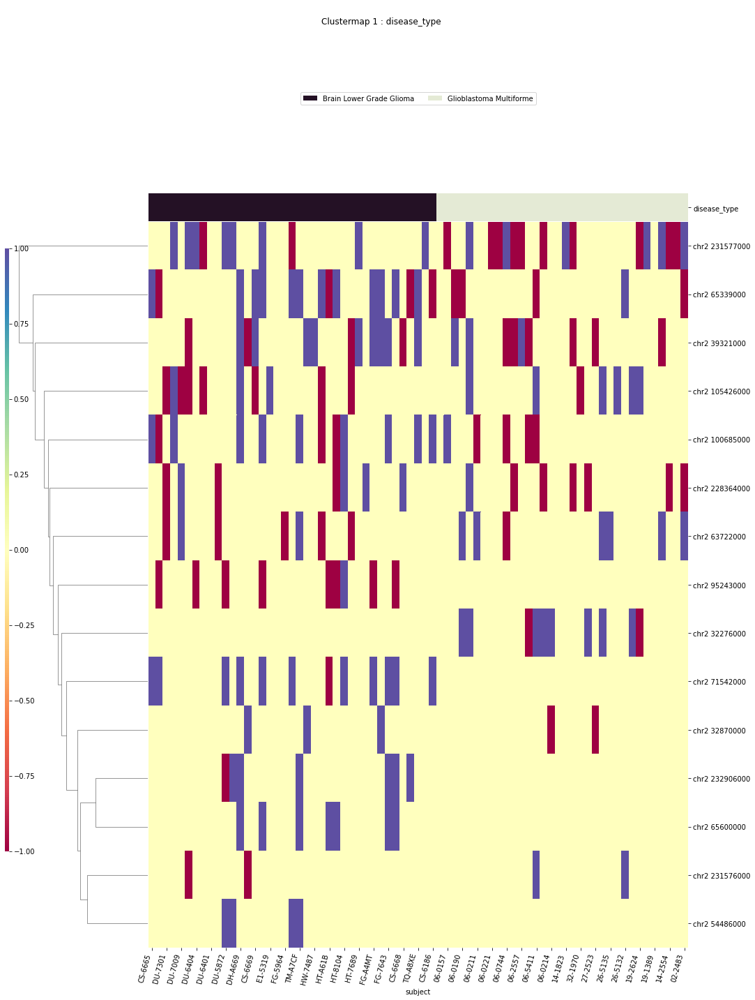

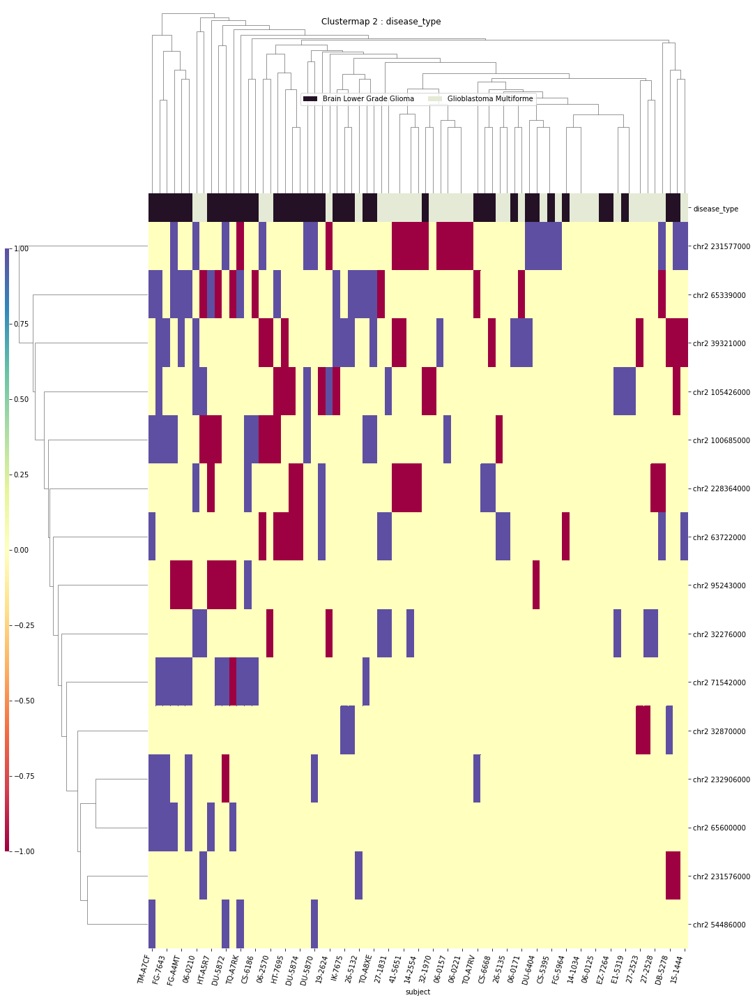

chr20
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr20 25550000


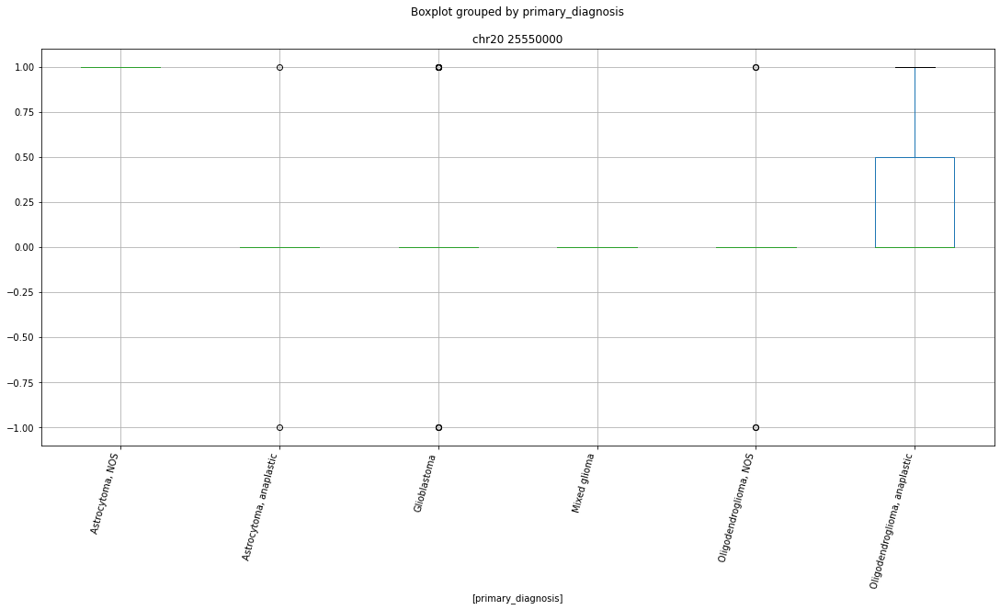

 p : 0.0  ( t : inf ) :  chr20 30406000


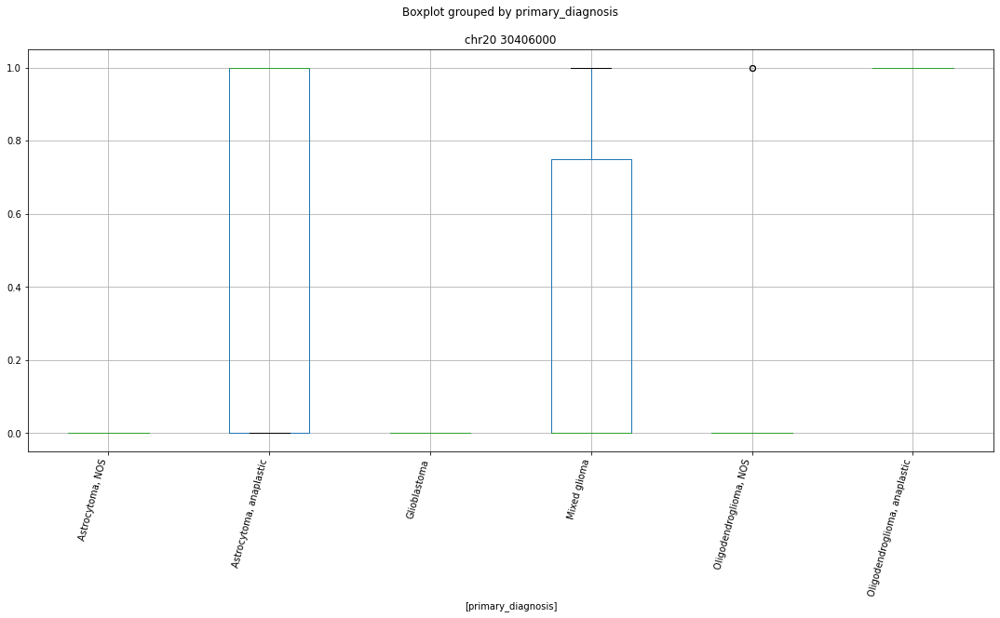

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr20 25551000


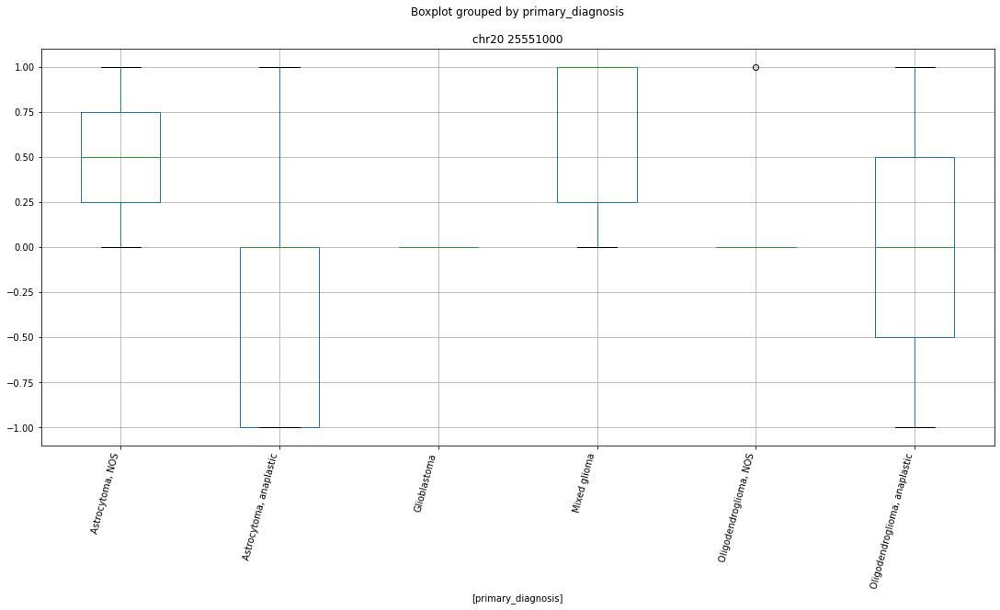

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr20 38407000


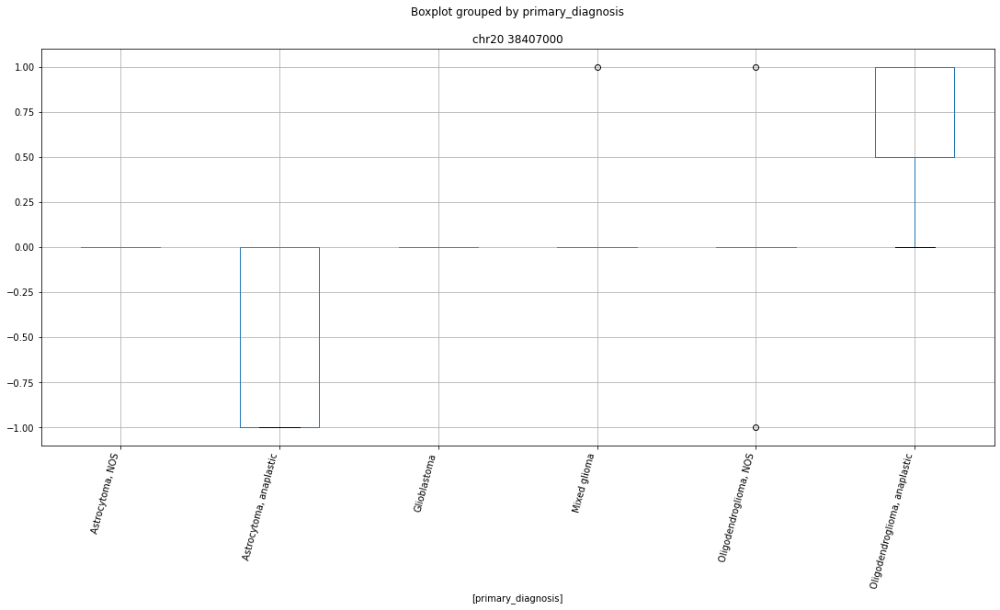

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr20 43677000


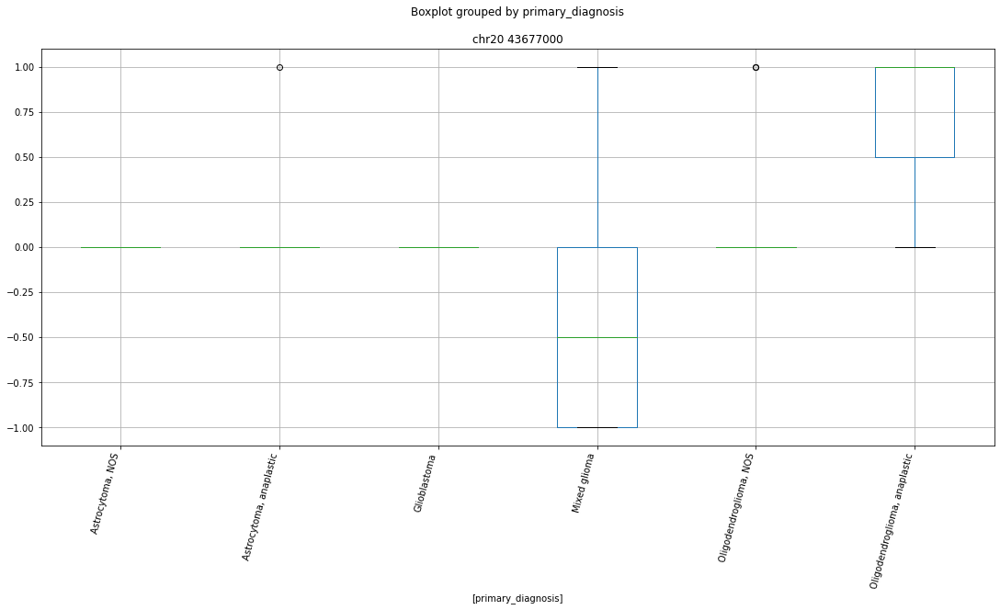

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr20 30850000


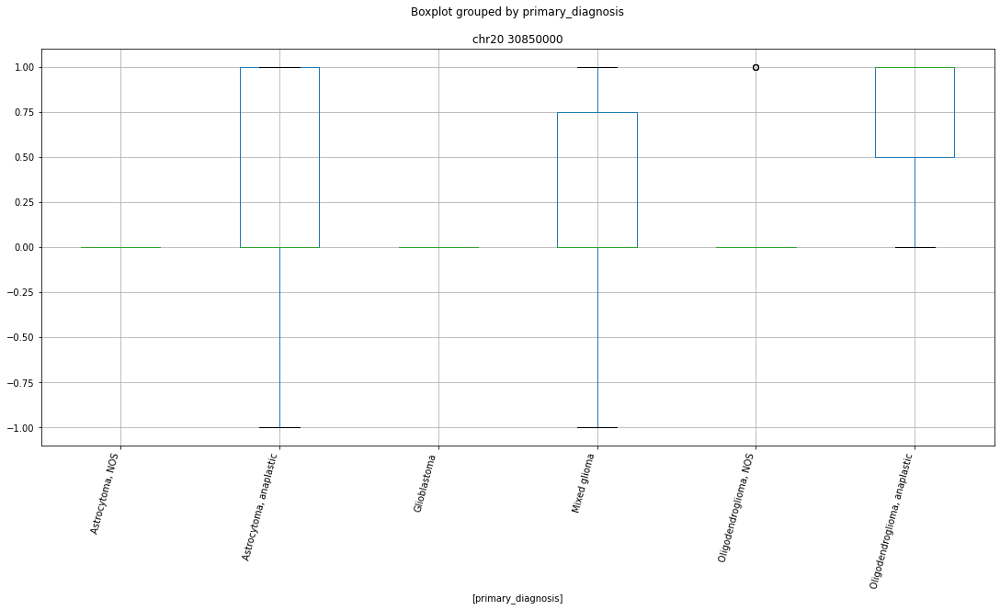

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr20 49922000


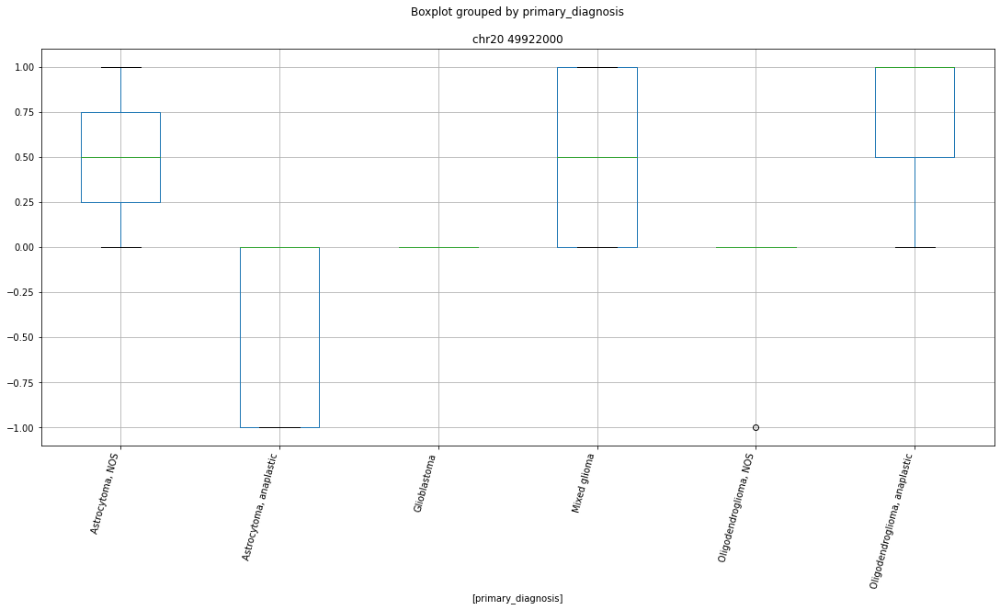

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr20 37001000


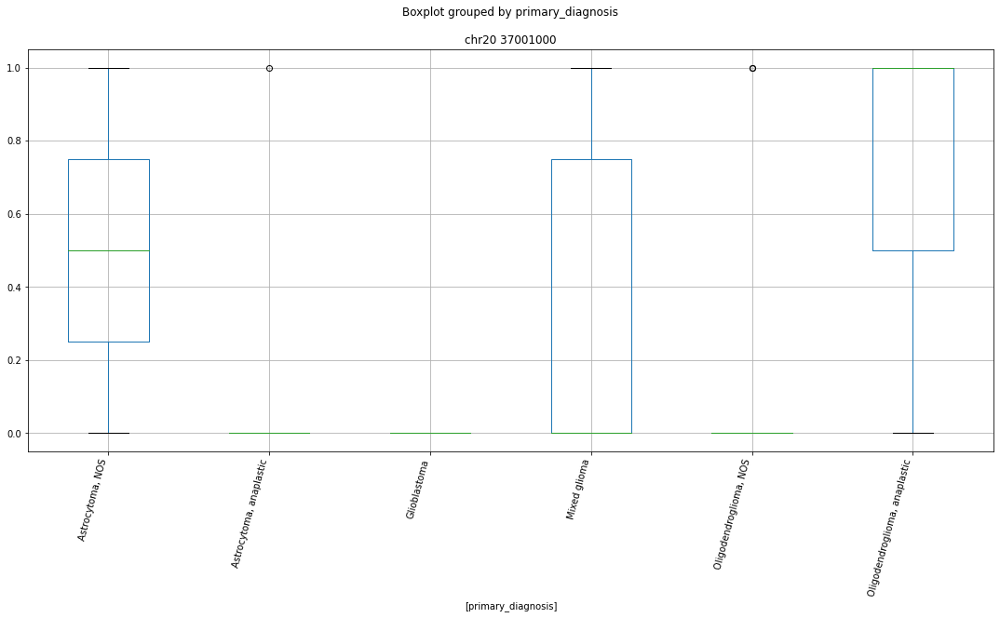

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr20 30406000


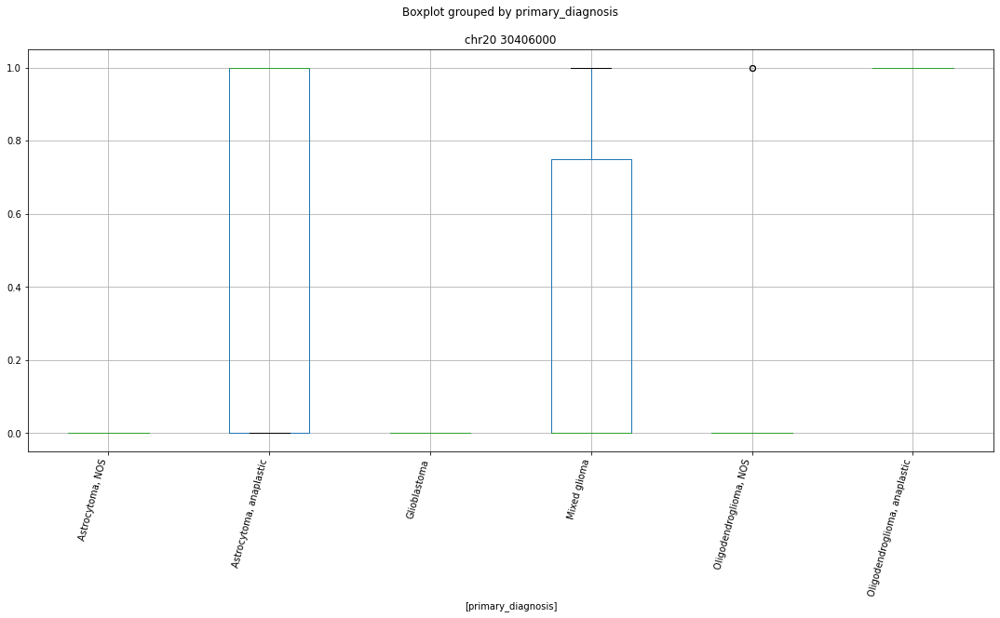

['chr20 10394000' 'chr20 15800000' 'chr20 15946000' 'chr20 18194000'
 'chr20 18375000' 'chr20 18495000' 'chr20 23695000' 'chr20 23757000'
 'chr20 23829000' 'chr20 23860000' 'chr20 25233000' 'chr20 25241000'
 'chr20 25550000' 'chr20 25551000' 'chr20 29316000' 'chr20 29440000'
 'chr20 29441000' 'chr20 29758000' 'chr20 29804000' 'chr20 3022000'
 'chr20 3023000' 'chr20 30406000' 'chr20 30846000' 'chr20 30849000'
 'chr20 30850000' 'chr20 30903000' 'chr20 33700000' 'chr20 34252000'
 'chr20 36968000' 'chr20 36976000' 'chr20 37001000' 'chr20 37126000'
 'chr20 38407000' 'chr20 41971000' 'chr20 43677000' 'chr20 45645000'
 'chr20 47525000' 'chr20 48935000' 'chr20 49922000' 'chr20 5028000'
 'chr20 53854000' 'chr20 54250000' 'chr20 56211000' 'chr20 5702000'
 'chr20 60042000' 'chr20 61653000' 'chr20 7956000' 'chr20 812000'
 'chr20 8644000' 'primary_diagnosis' 'subject']


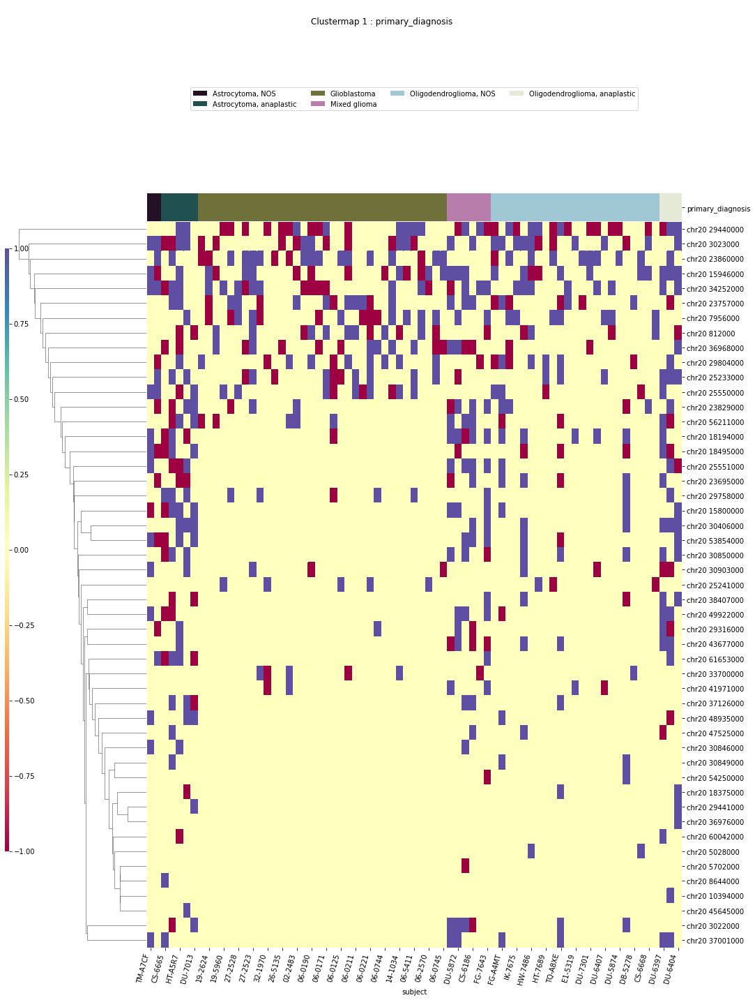

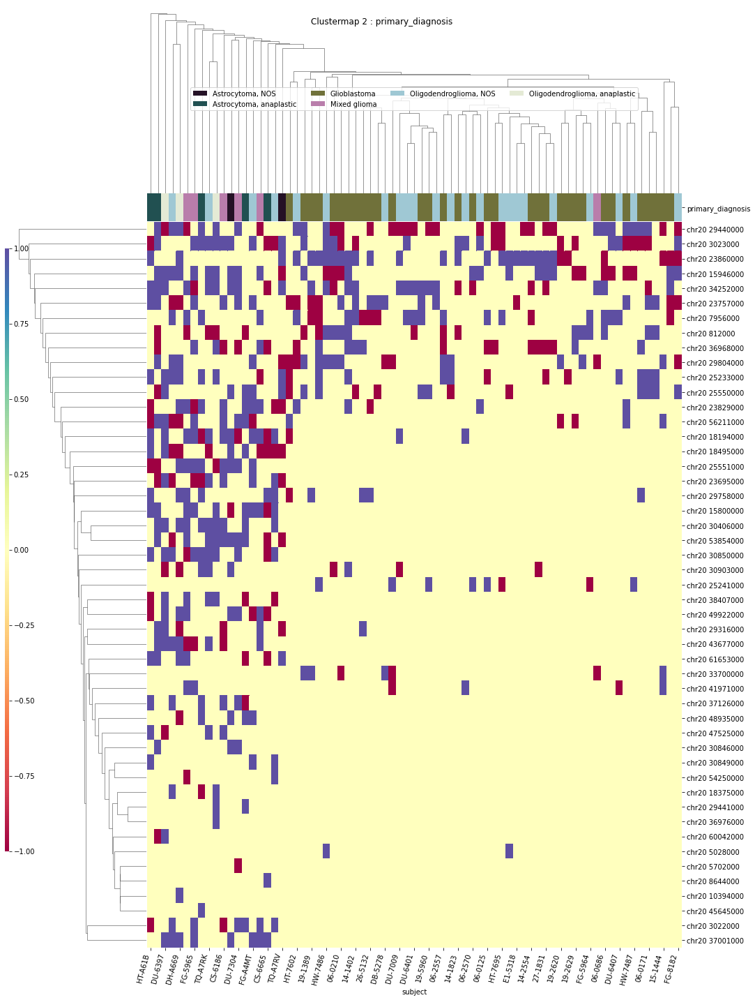

IDH
['IDH' 'chr20 18194000' 'chr20 30846000' 'chr20 30849000' 'chr20 34223000'
 'chr20 37001000' 'chr20 37070000' 'chr20 43677000' 'subject']


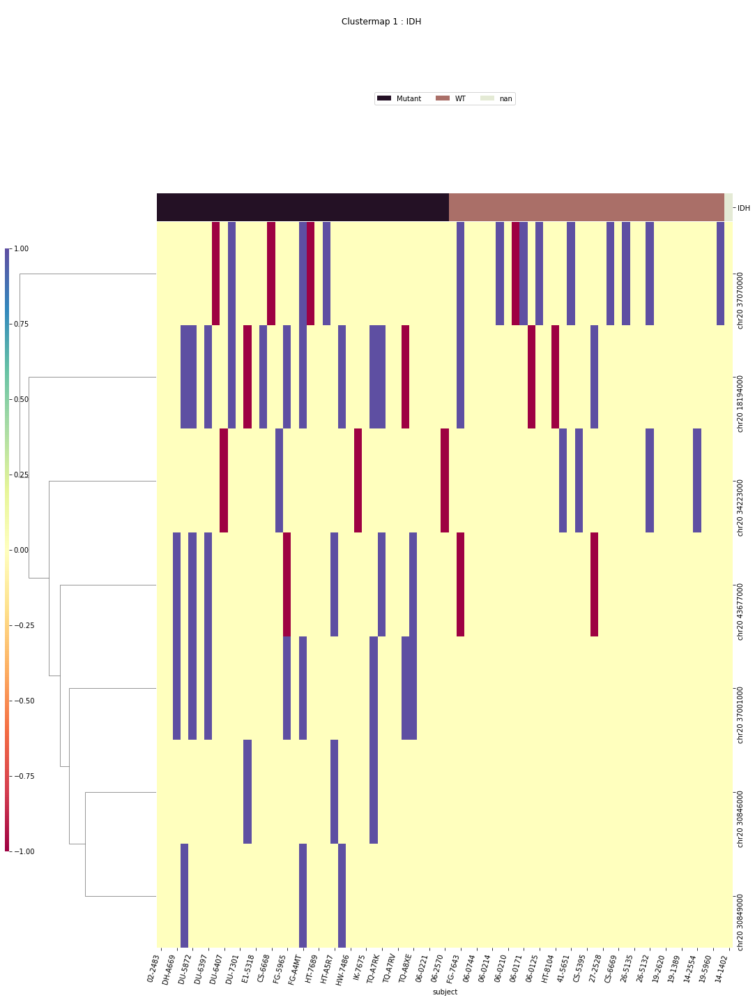

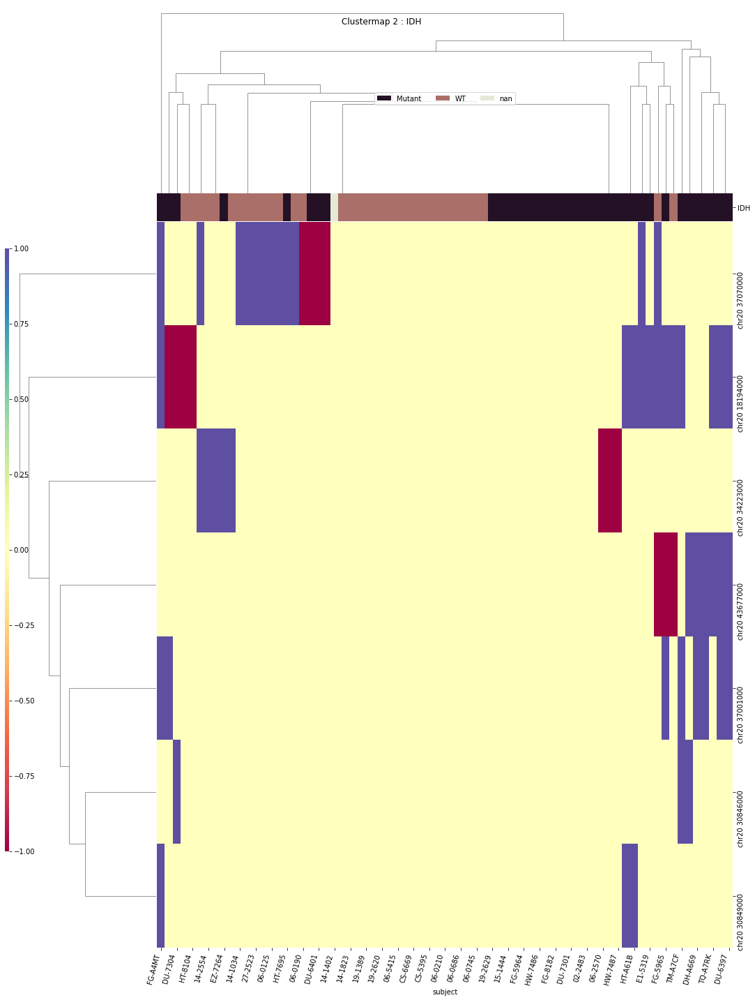

x1p19q
['chr20 10394000' 'chr20 29883000' 'chr20 30903000' 'chr20 47525000'
 'chr20 48935000' 'chr20 54250000' 'chr20 60042000' 'subject' 'x1p19q']


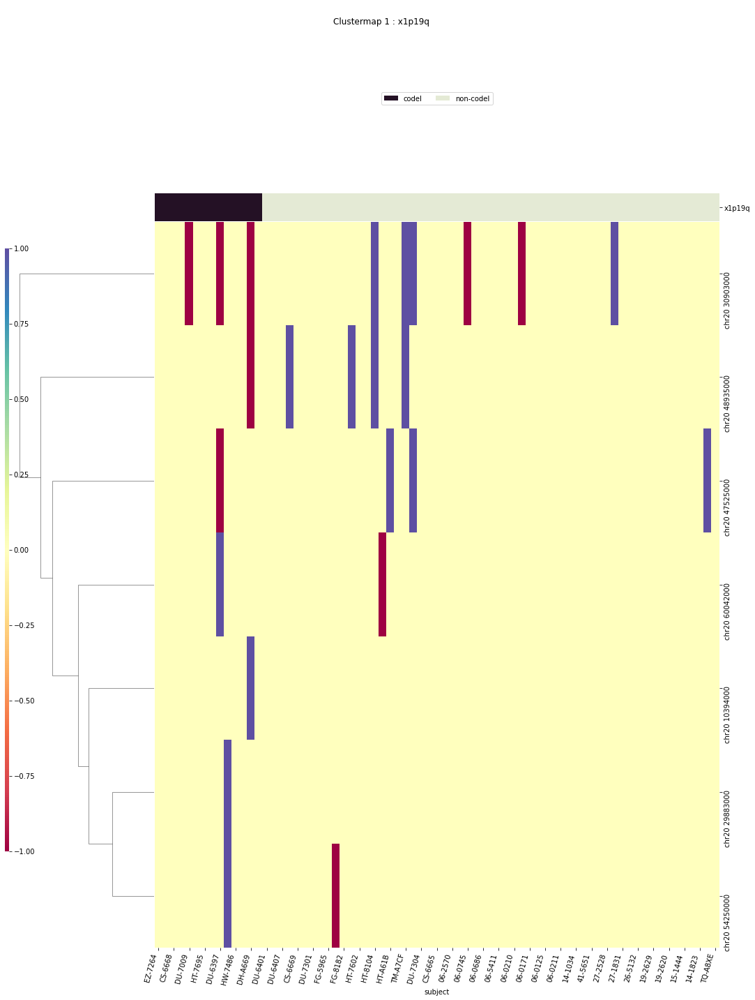

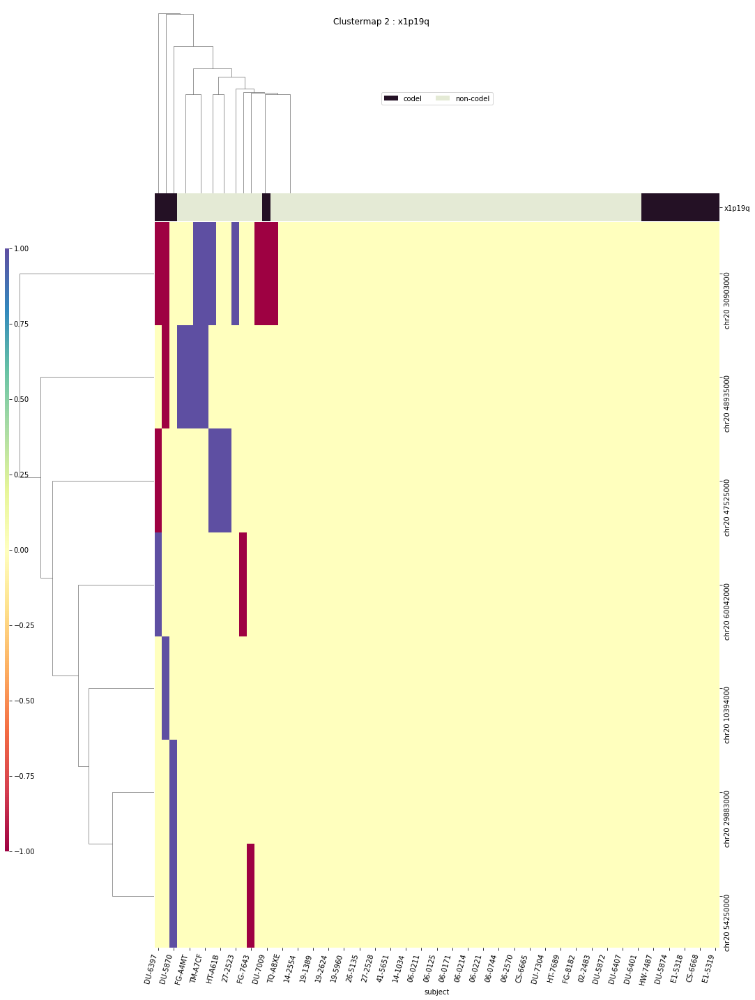

TERT
['TERT' 'chr20 15946000' 'chr20 18375000' 'chr20 30846000'
 'chr20 34223000' 'chr20 37001000' 'chr20 37070000' 'chr20 812000'
 'subject']


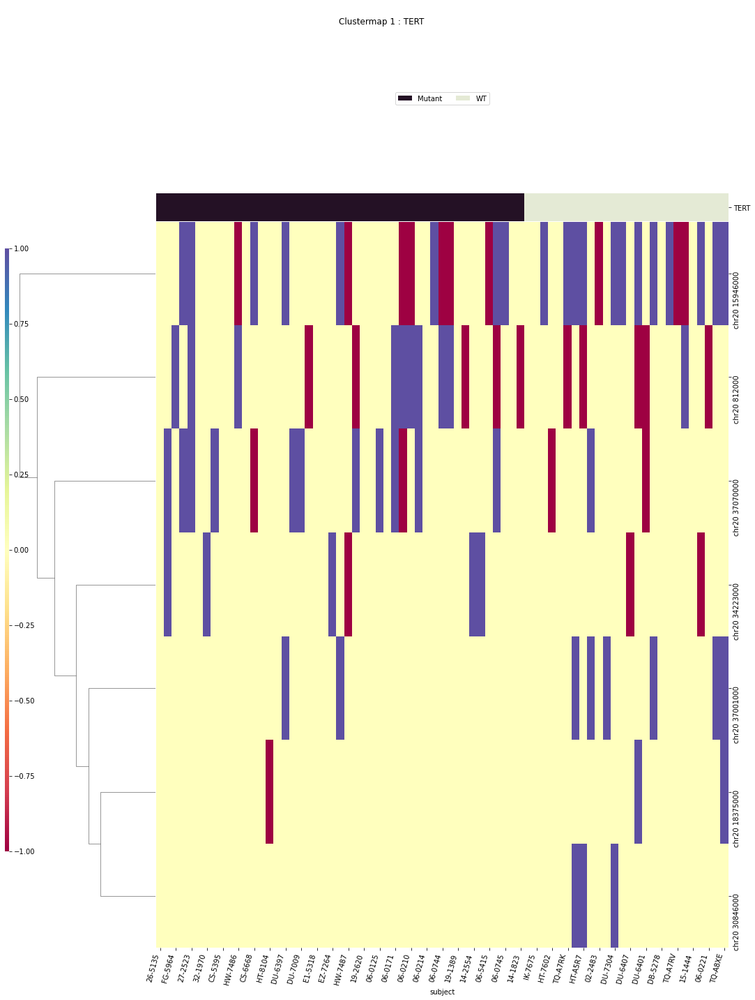

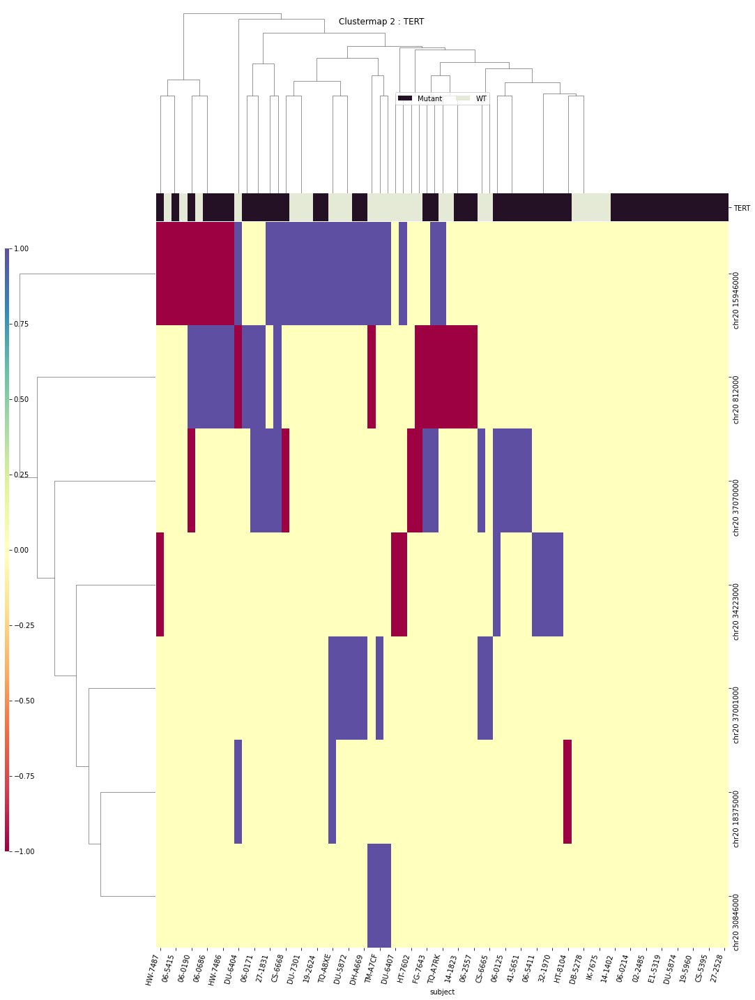

disease_type
['chr20 15800000' 'chr20 15946000' 'chr20 18194000' 'chr20 25241000'
 'chr20 3023000' 'chr20 30406000' 'chr20 30850000' 'chr20 34252000'
 'chr20 37001000' 'chr20 37070000' 'chr20 7956000' 'chr20 812000'
 'disease_type' 'subject']


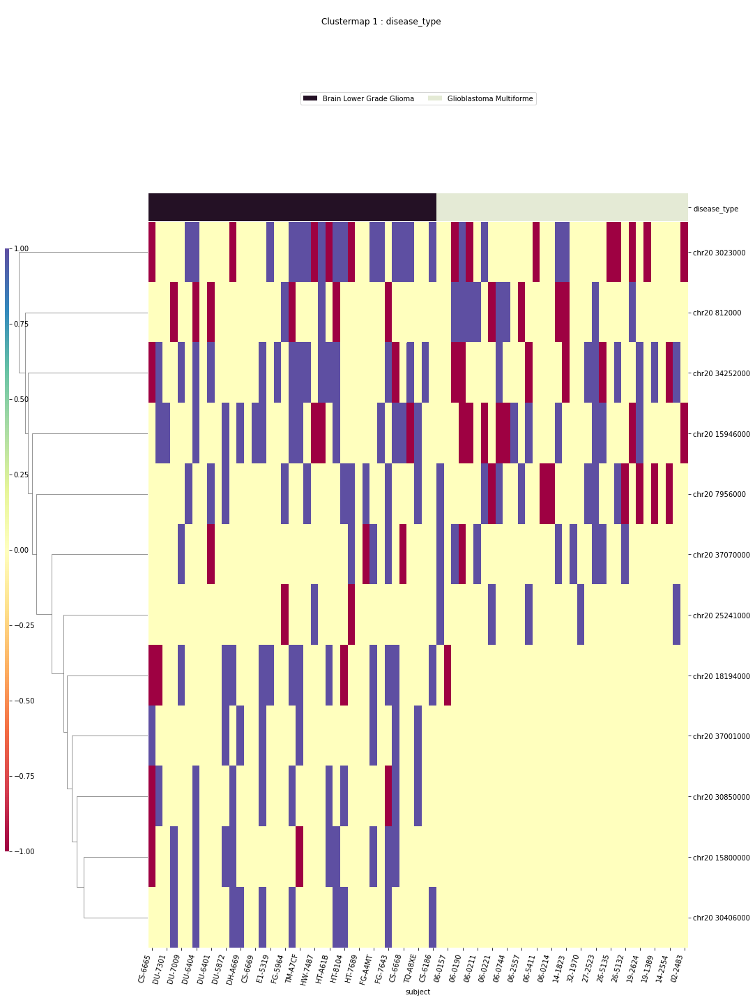

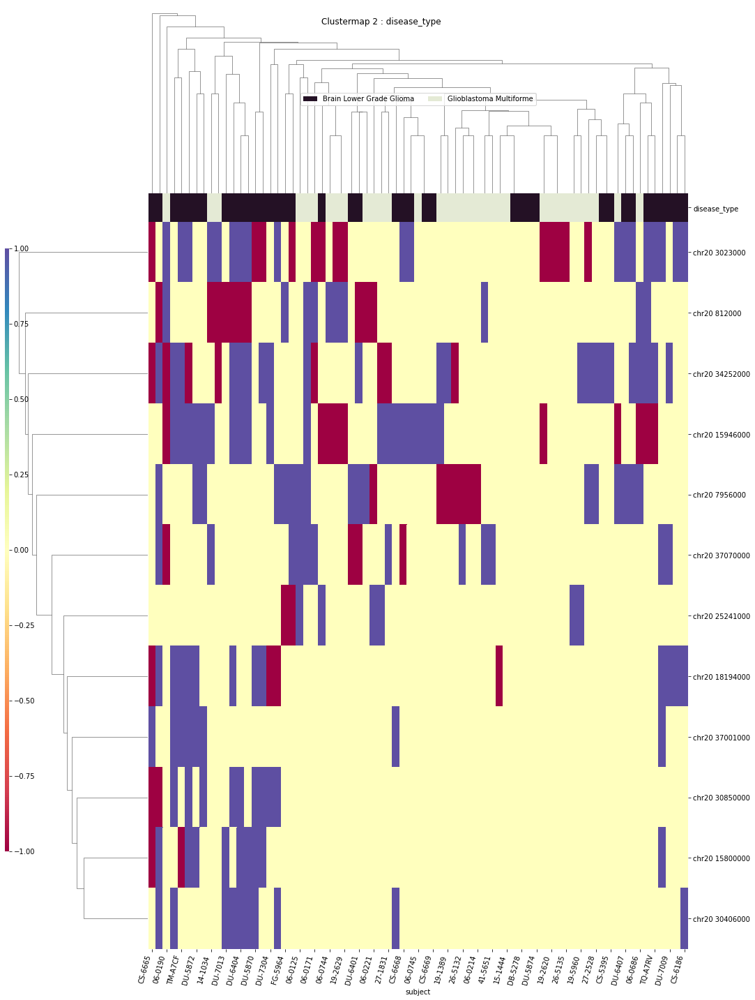

chr21
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr21 29012000


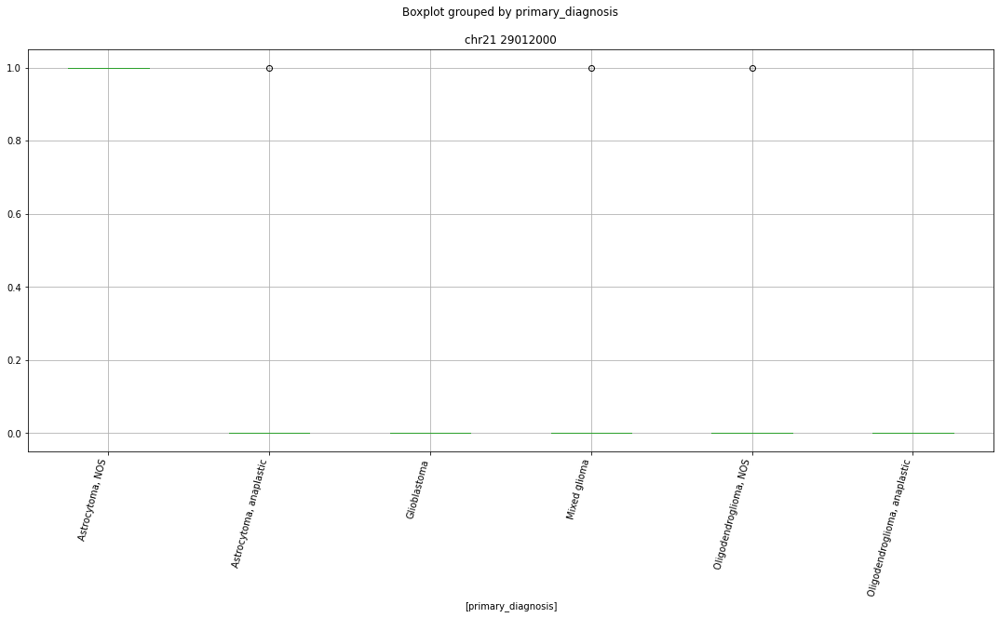

 p : 0.0  ( t : inf ) :  chr21 19104000


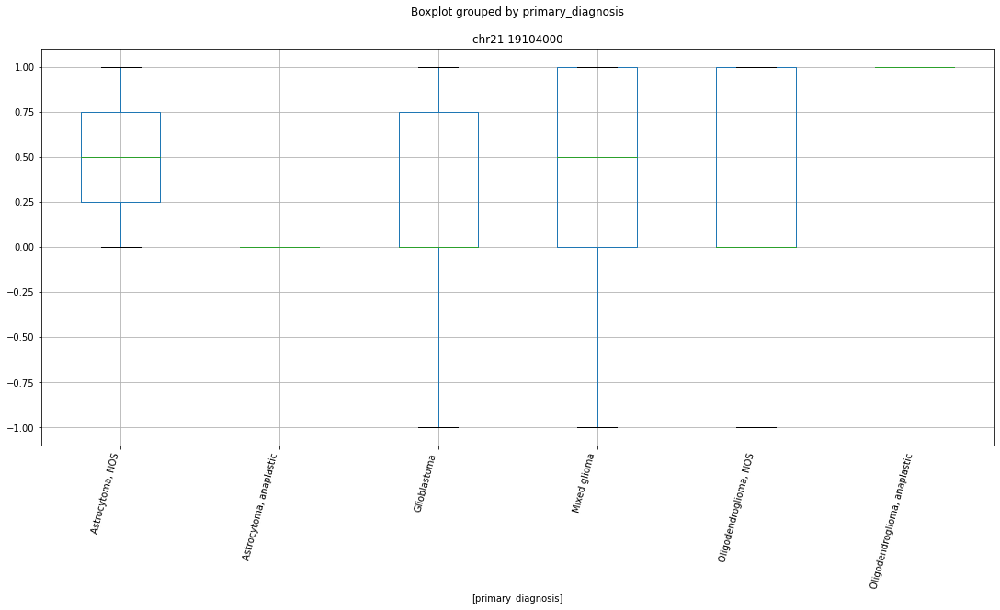

['chr21 13820000' 'chr21 14280000' 'chr21 17694000' 'chr21 18560000'
 'chr21 19104000' 'chr21 20822000' 'chr21 25695000' 'chr21 29012000'
 'chr21 31584000' 'chr21 32997000' 'chr21 35898000' 'chr21 36392000'
 'chr21 39157000' 'chr21 42778000' 'chr21 44282000' 'chr21 45785000'
 'chr21 9593000' 'primary_diagnosis' 'subject']


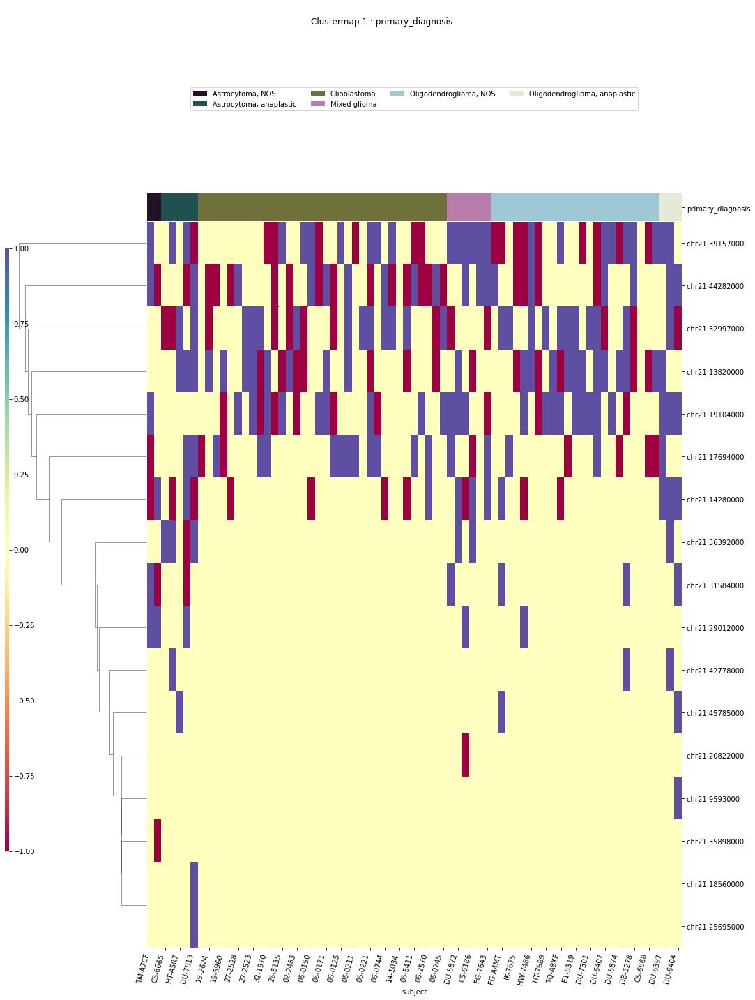

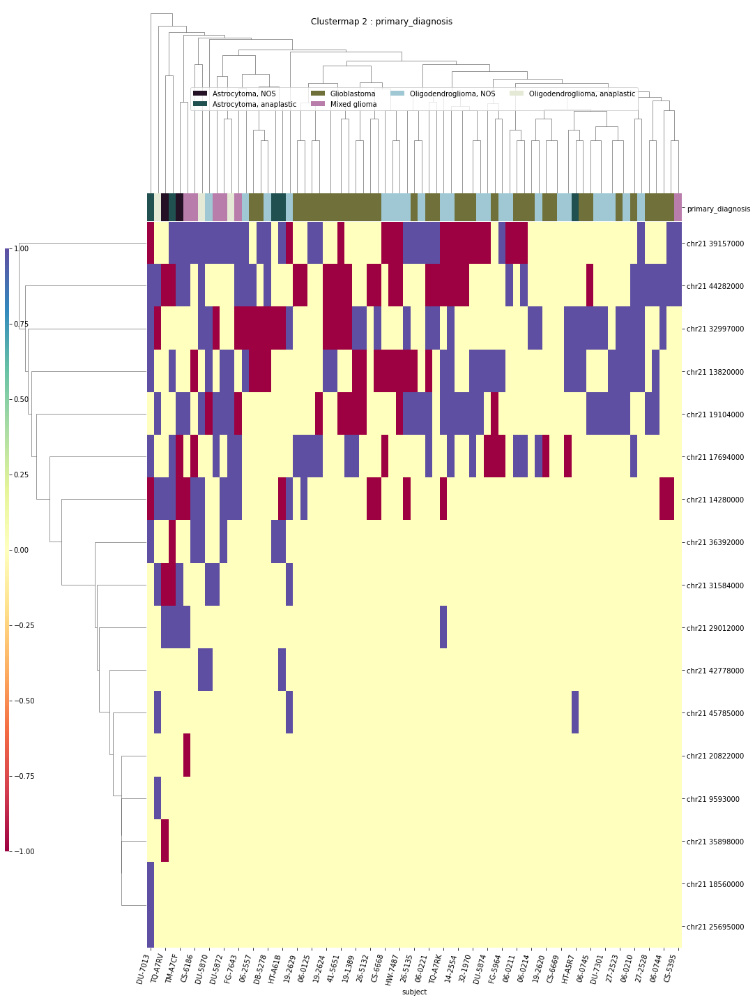

IDH
['IDH' 'chr21 19104000' 'chr21 42778000' 'subject']


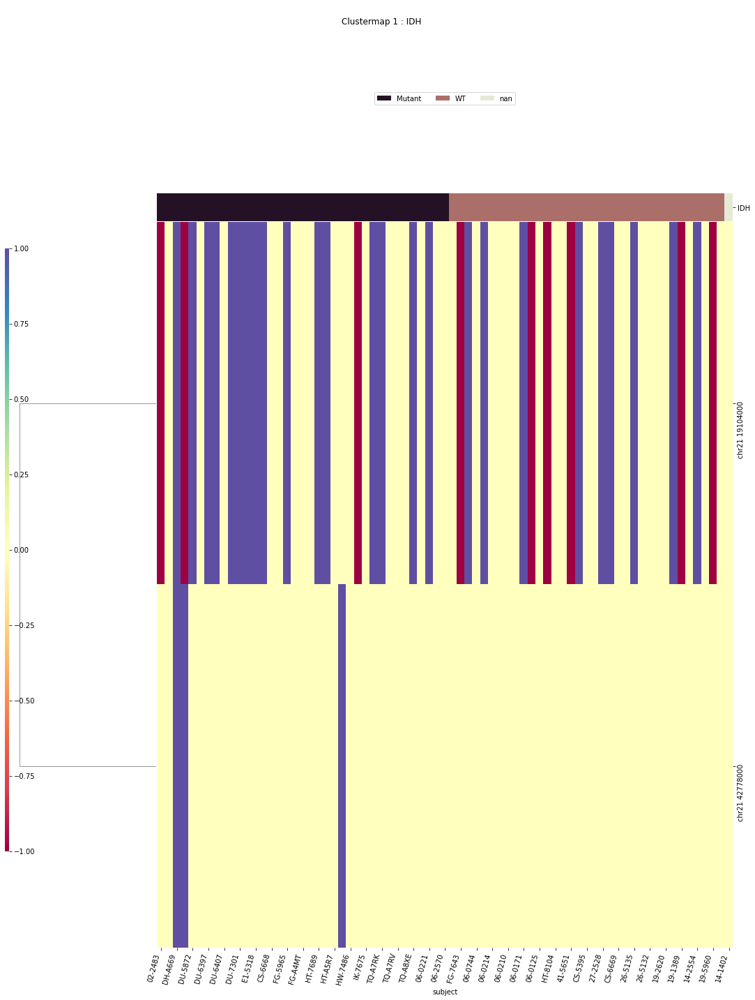

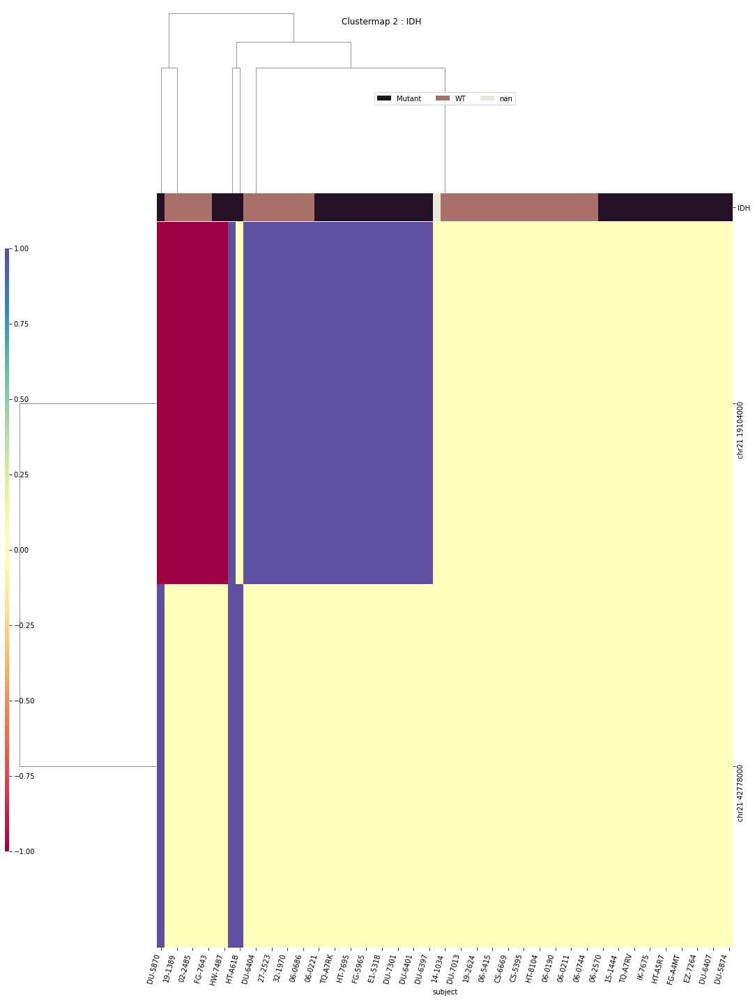

x1p19q
['chr21 13820000' 'chr21 17694000' 'chr21 17719000' 'chr21 41421000'
 'chr21 42778000' 'subject' 'x1p19q']


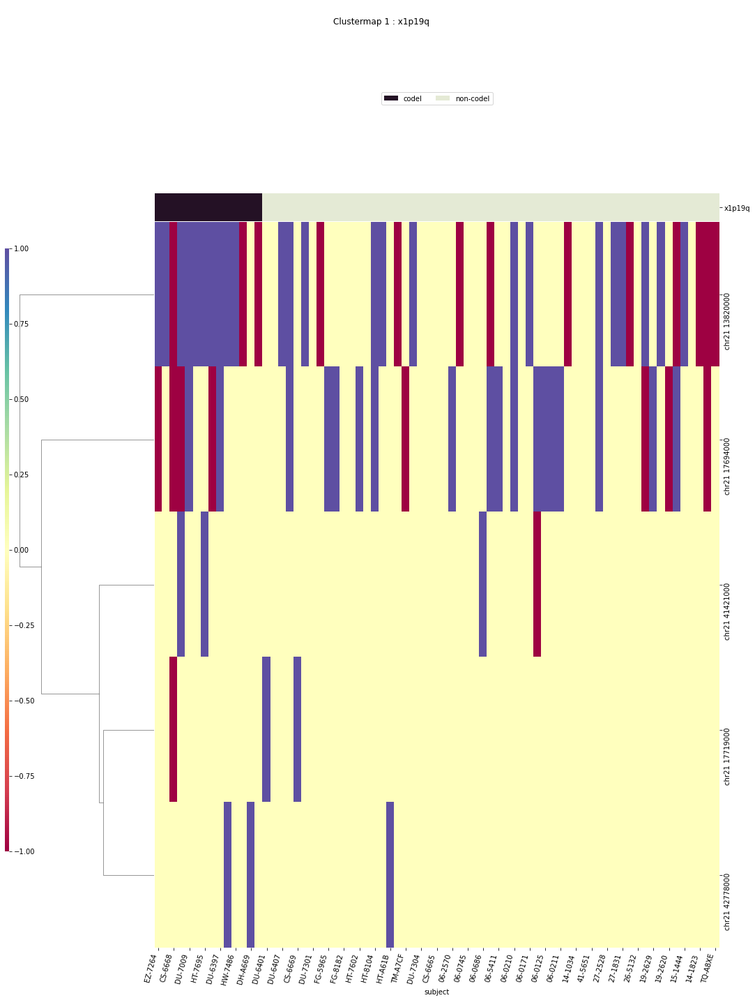

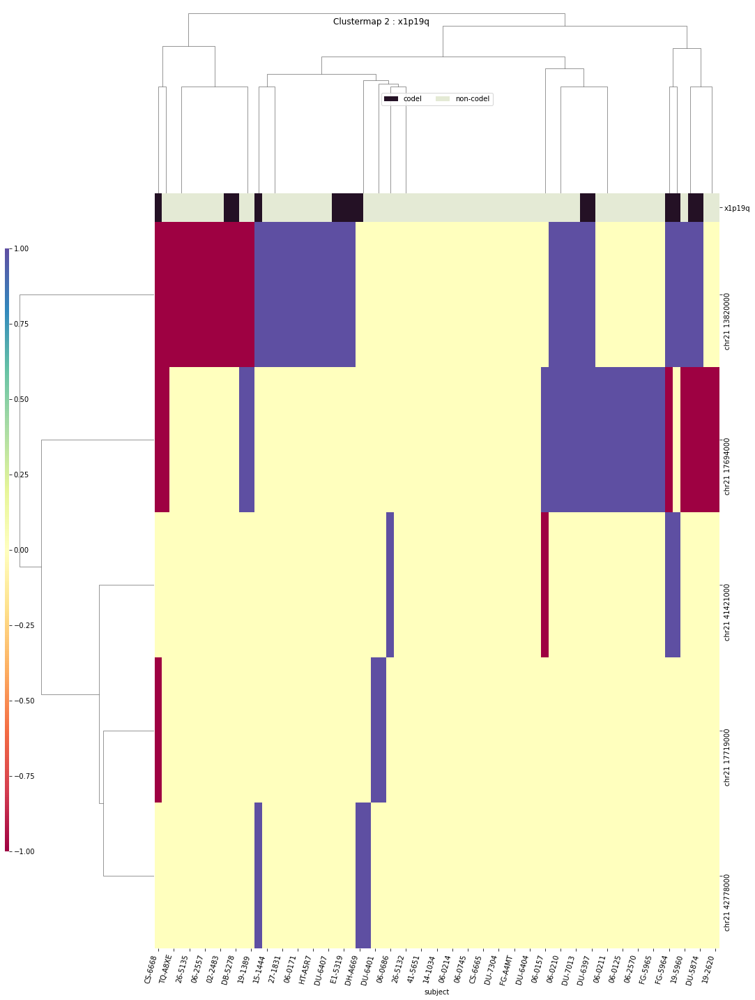

TERT
['TERT' 'chr21 17719000' 'chr21 29012000' 'chr21 45785000' 'subject']


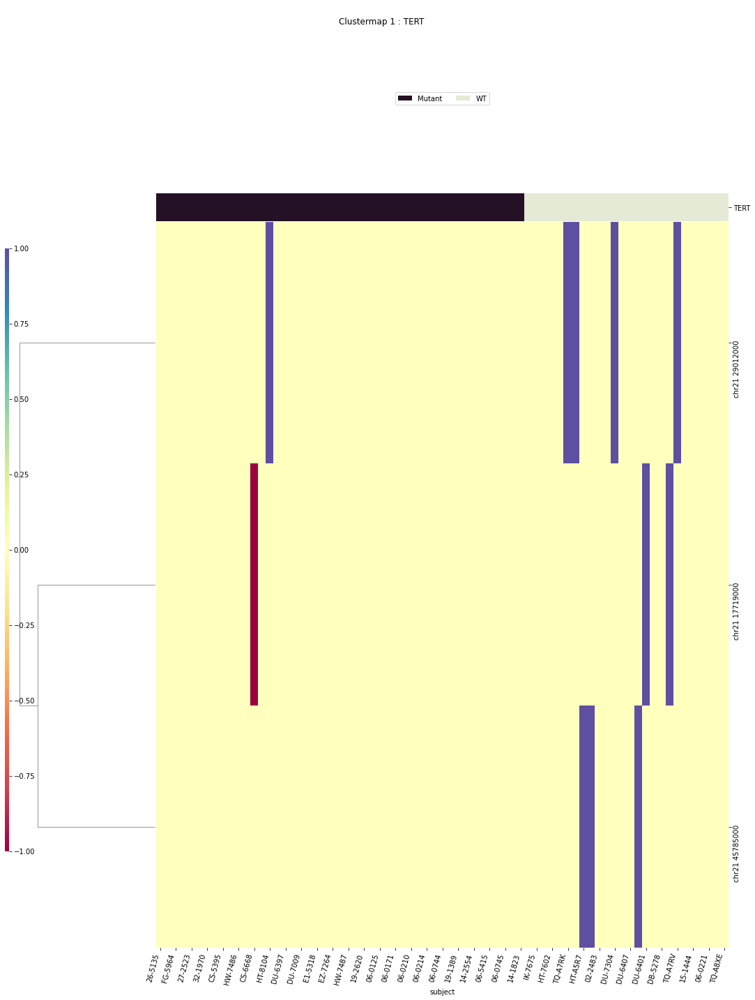

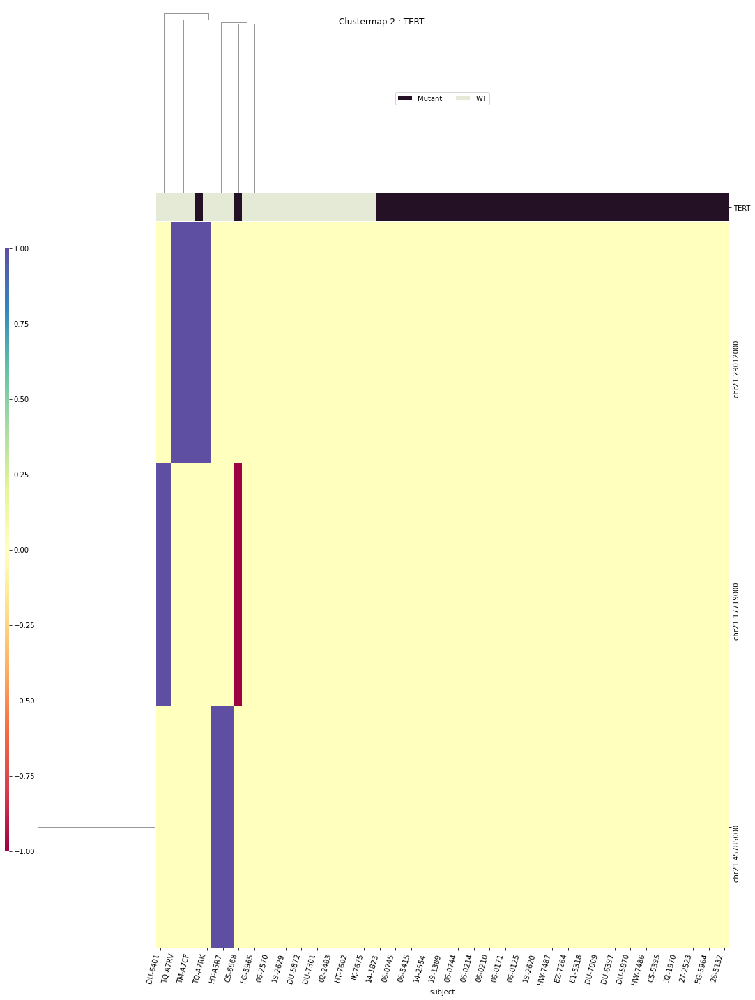

disease_type
['chr21 17694000' 'chr21 29012000' 'chr21 36392000' 'chr21 44282000'
 'disease_type' 'subject']


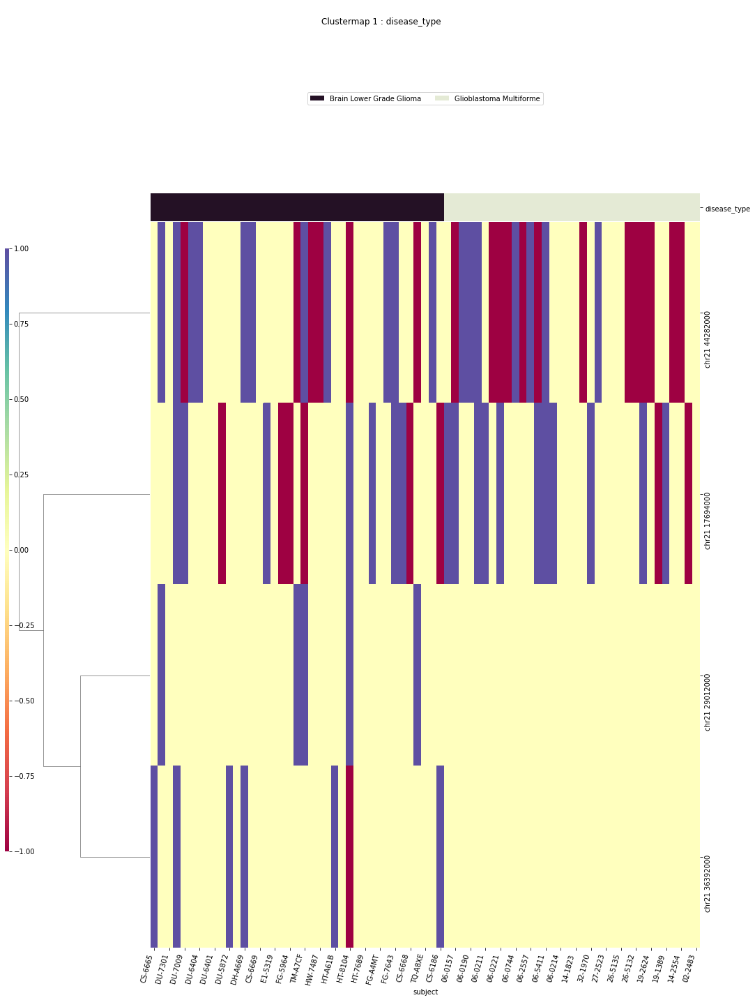

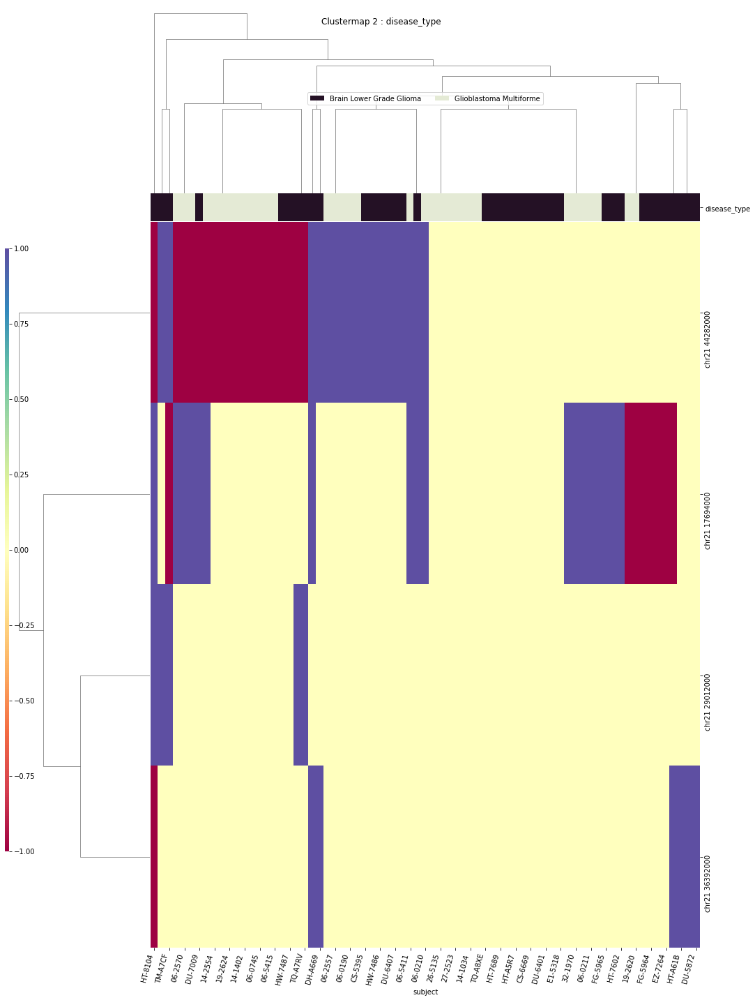

chr22
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr22 42750000


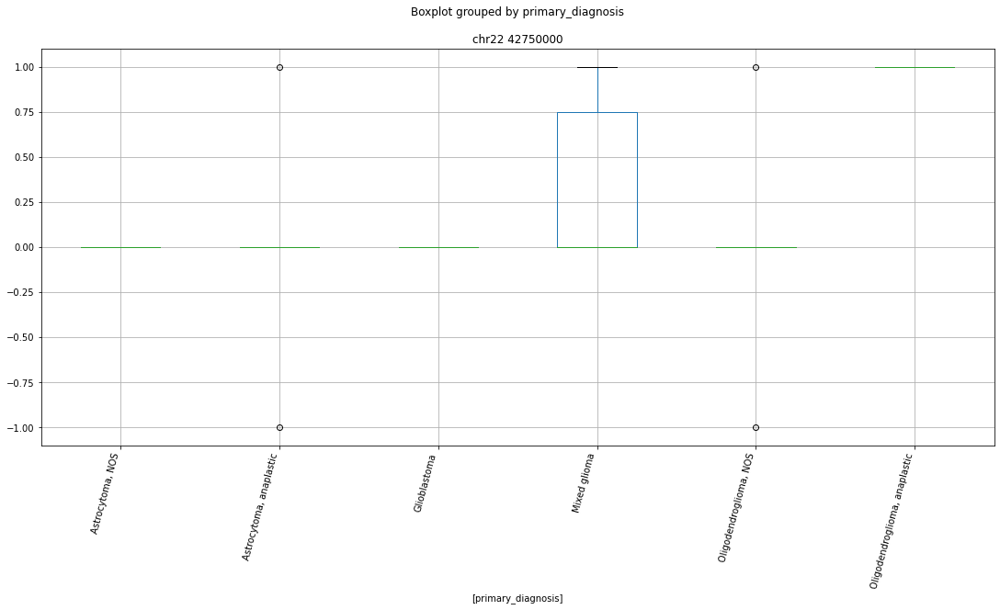

 p : 0.0  ( t : inf ) :  chr22 23536000


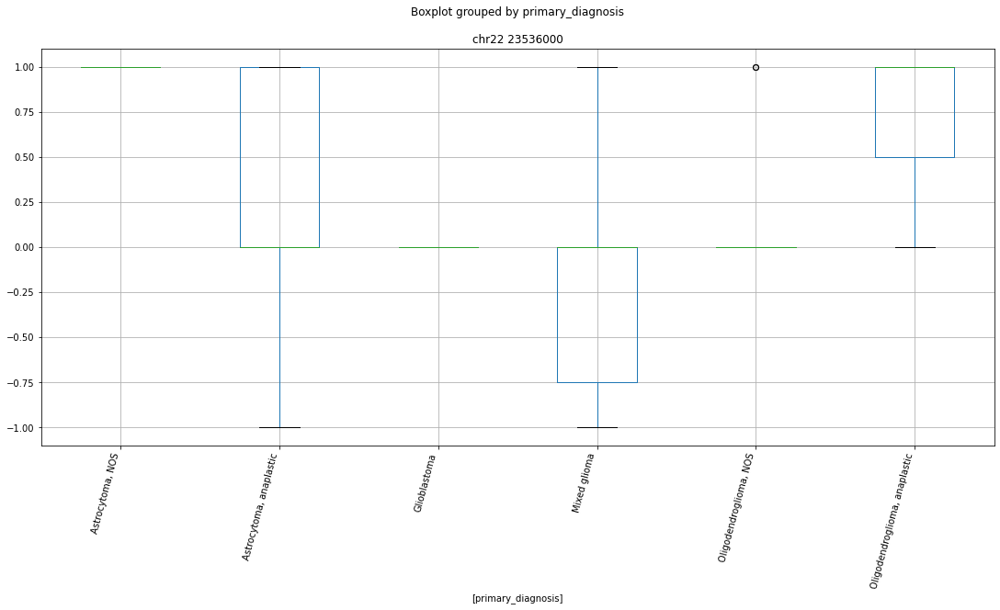

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr22 23536000


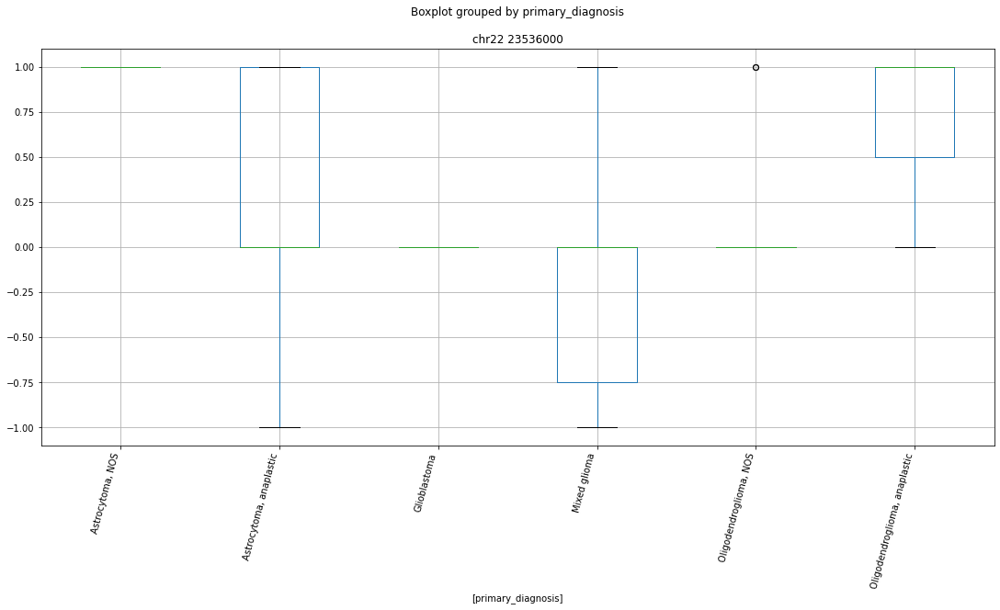

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr22 28553000


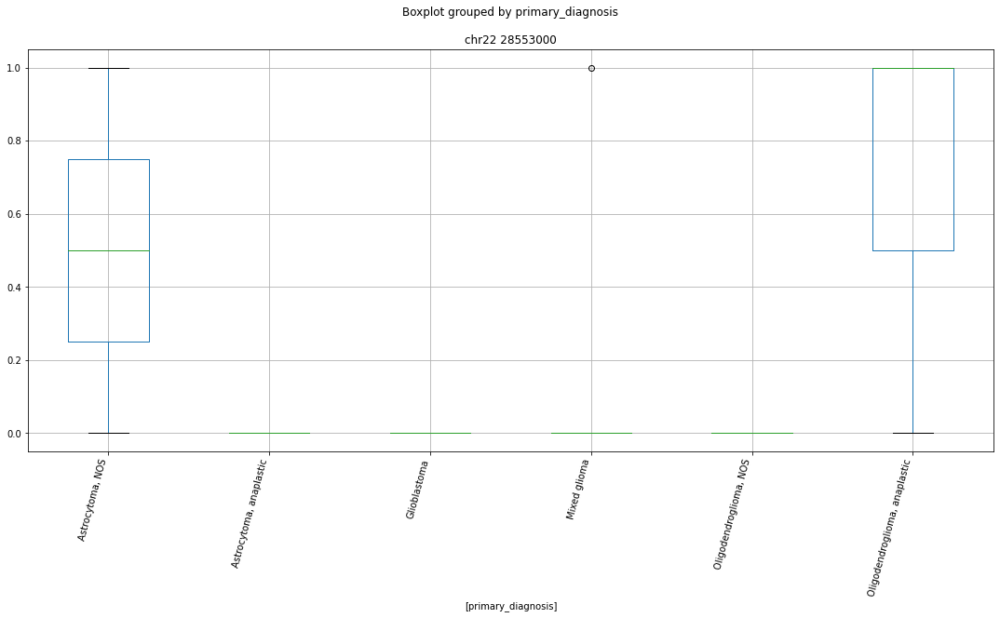

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr22 31027000


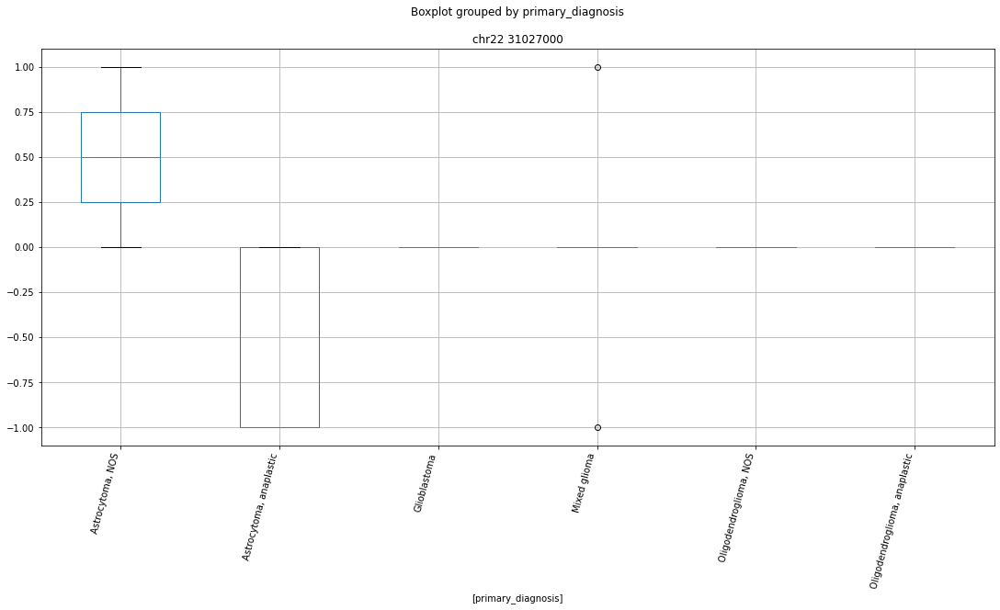

['chr22 11549000' 'chr22 11609000' 'chr22 18947000' 'chr22 19084000'
 'chr22 21094000' 'chr22 21676000' 'chr22 21883000' 'chr22 22442000'
 'chr22 22649000' 'chr22 23536000' 'chr22 23538000' 'chr22 23548000'
 'chr22 23560000' 'chr22 23855000' 'chr22 24064000' 'chr22 24211000'
 'chr22 24316000' 'chr22 24630000' 'chr22 24631000' 'chr22 25277000'
 'chr22 28553000' 'chr22 29643000' 'chr22 30631000' 'chr22 31027000'
 'chr22 34625000' 'chr22 36813000' 'chr22 39011000' 'chr22 40500000'
 'chr22 41295000' 'chr22 41630000' 'chr22 42750000' 'primary_diagnosis'
 'subject']


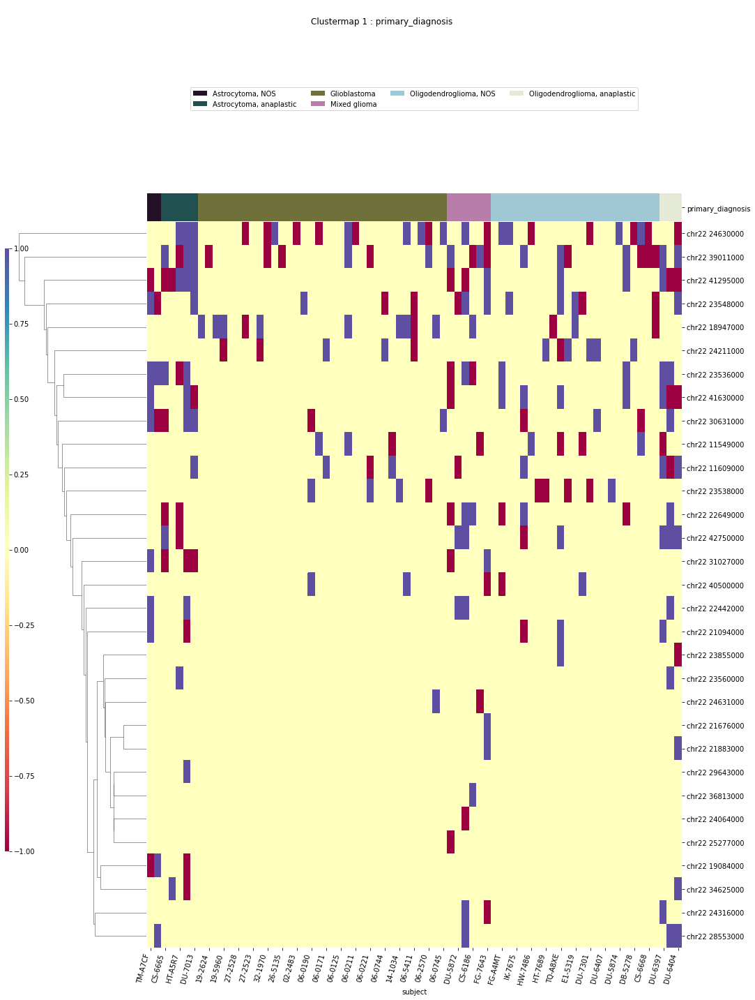

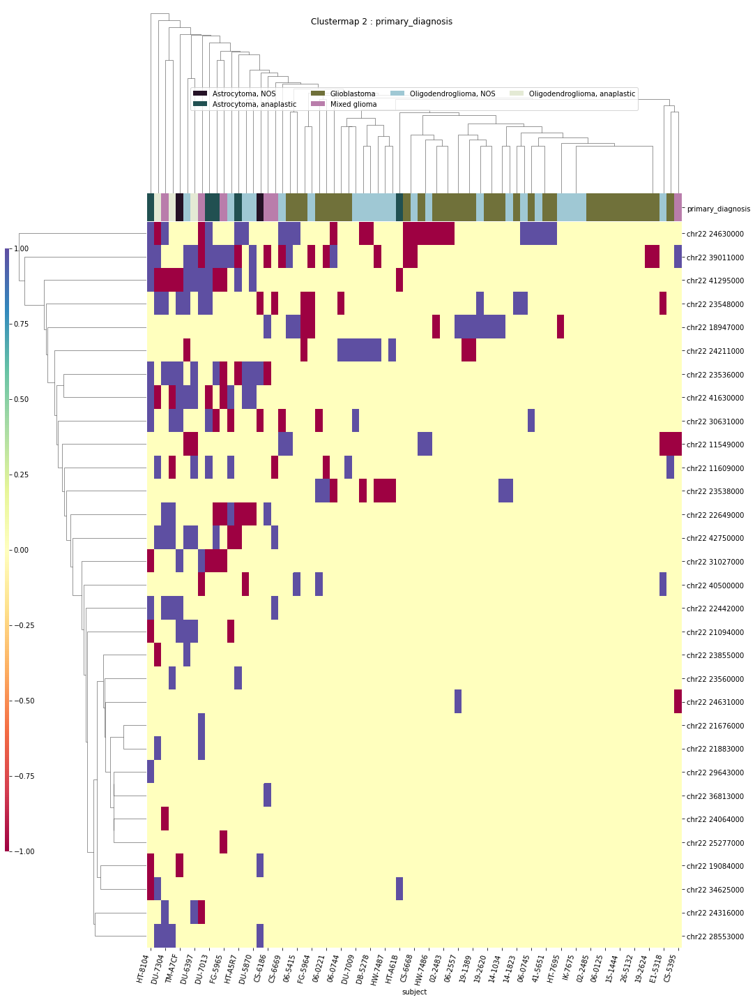

IDH
['IDH' 'chr22 18947000' 'chr22 23536000' 'chr22 23538000' 'chr22 24316000'
 'subject']


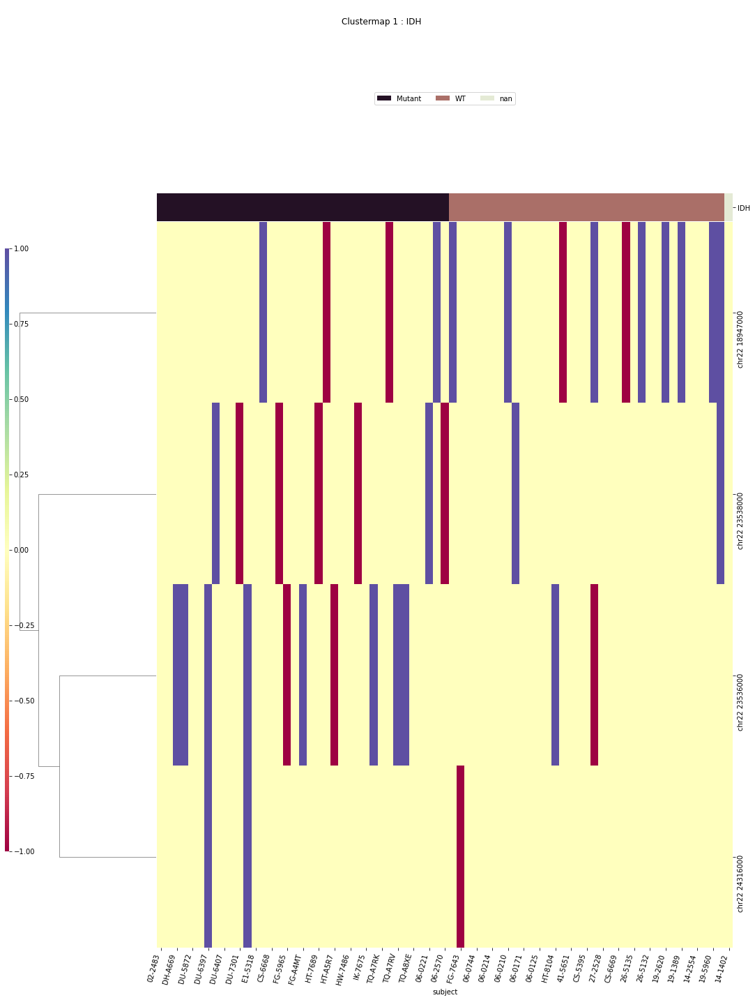

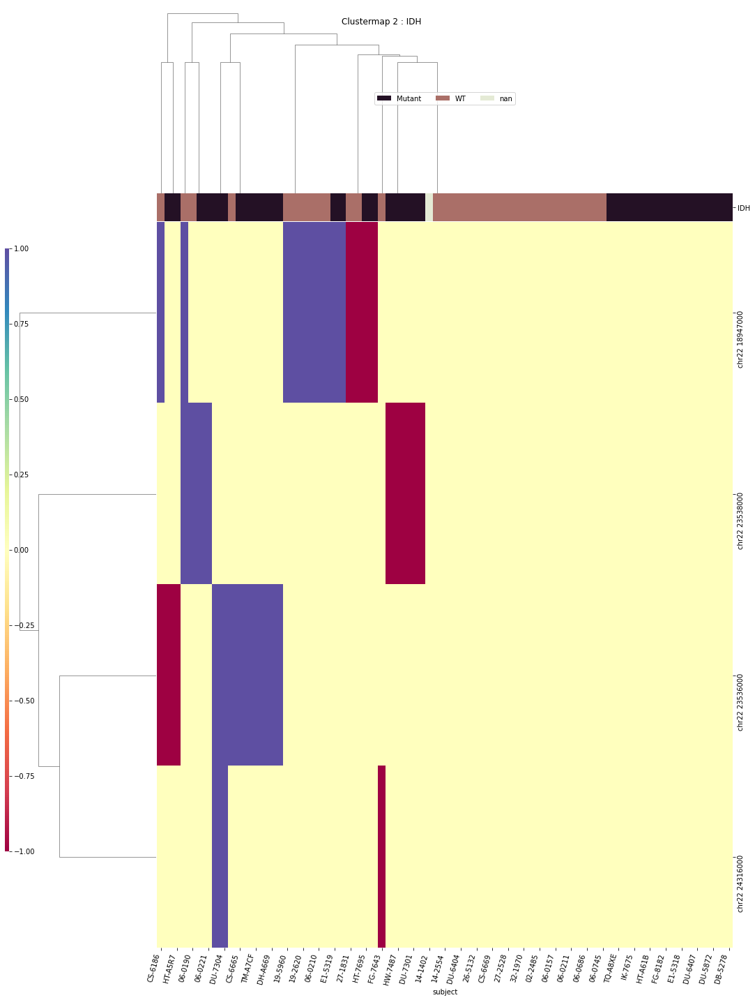

x1p19q
['chr22 24211000' 'subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'chr22 28553000' 'chr22 30631000' 'chr22 34625000'
 'chr22 41295000' 'subject']


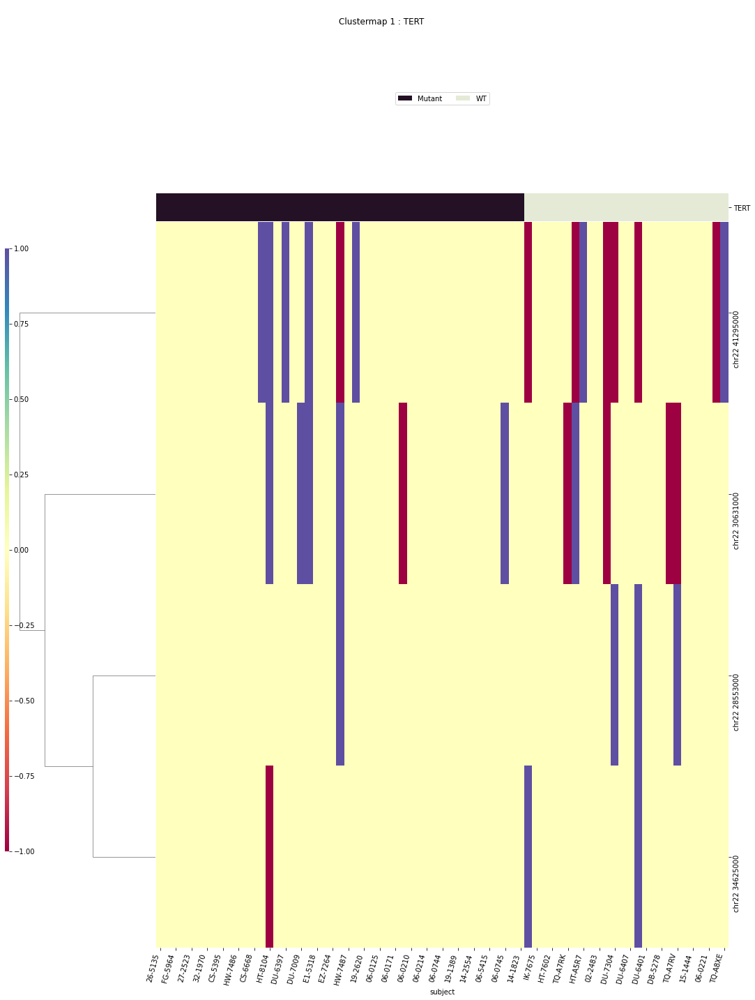

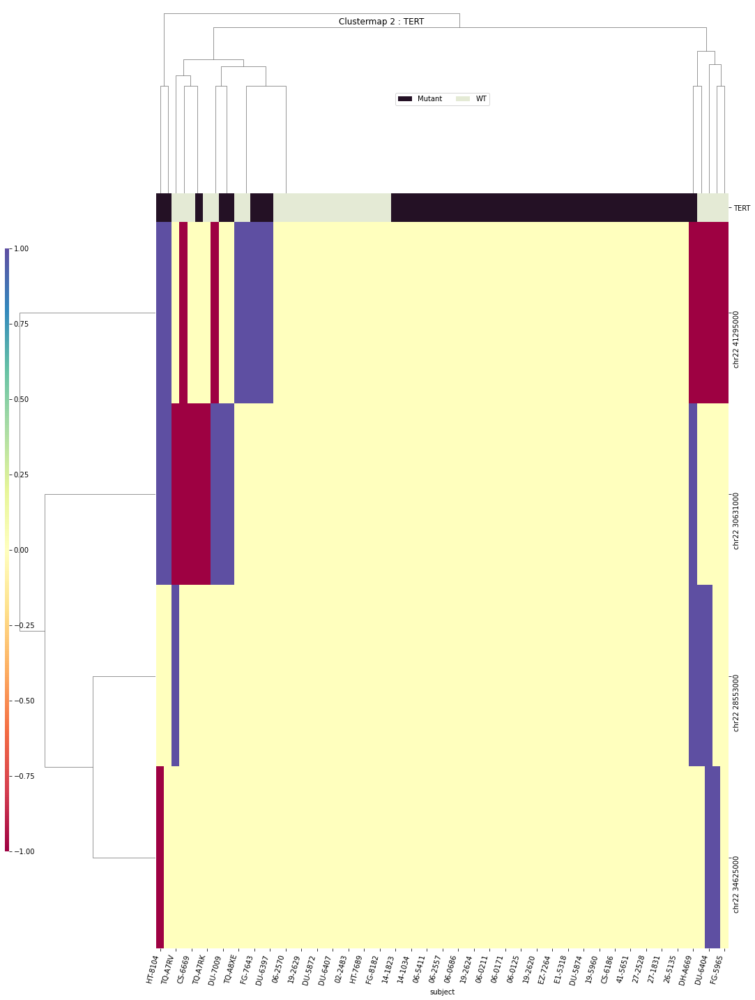

disease_type
['chr22 18947000' 'chr22 22442000' 'chr22 28553000' 'disease_type'
 'subject']


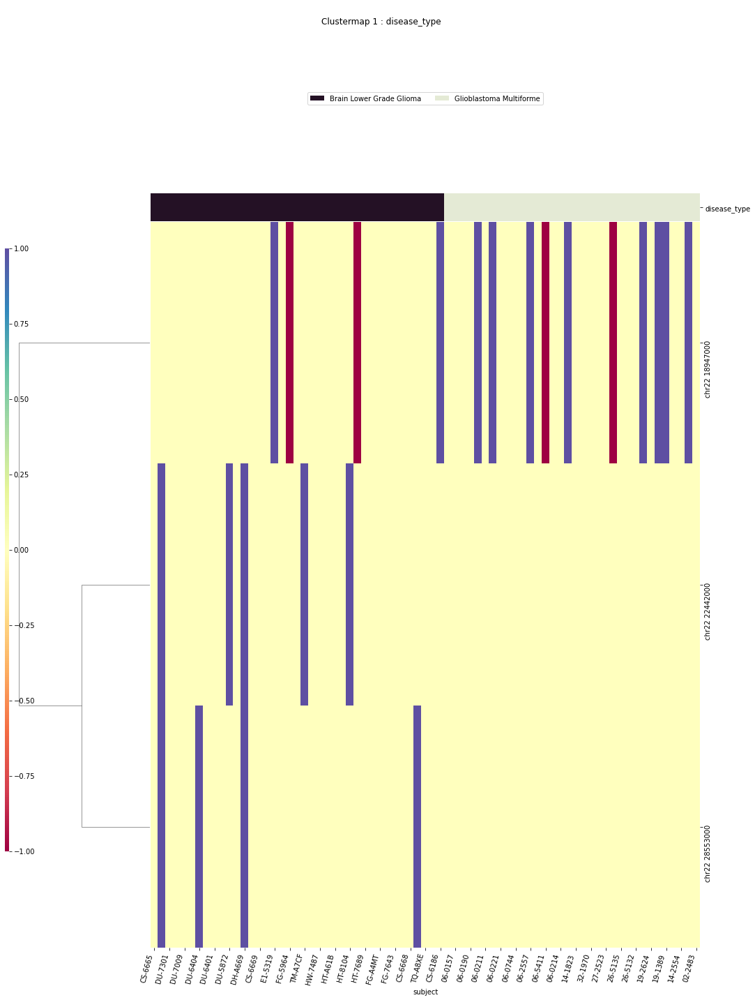

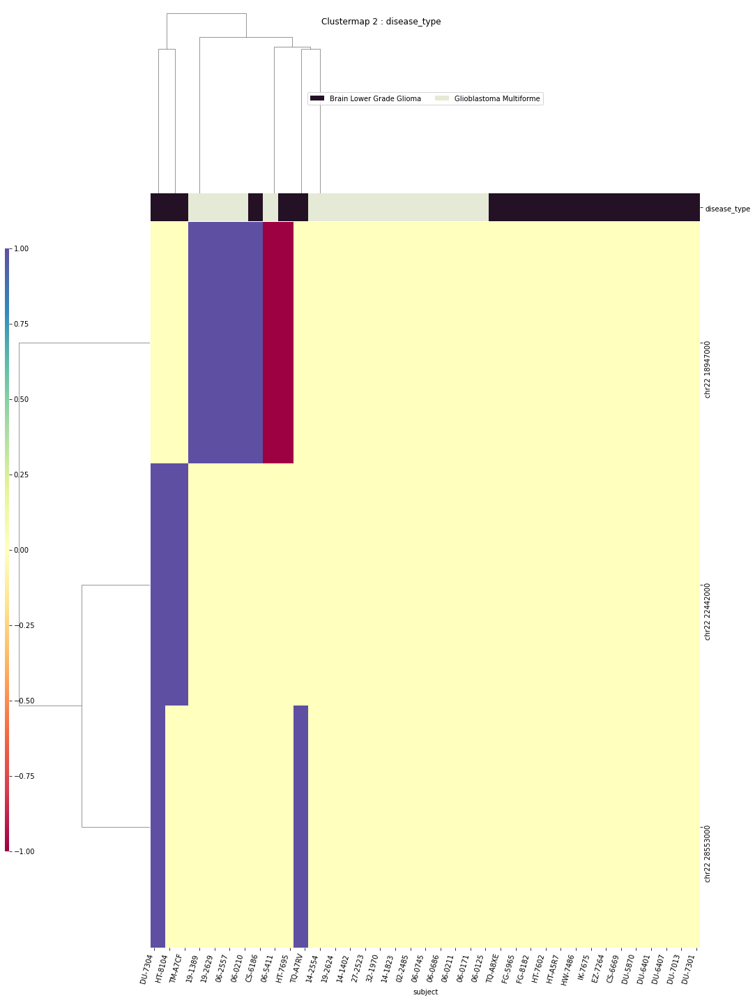

chr22_KI270733v1_random
HERVK113
primary_diagnosis
['chr22_KI270733v1_random 84000' 'primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'chr22_KI270733v1_random 84000' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chr22_KI270734v1_random
HERVK113
primary_diagnosis
['chr22_KI270734v1_random 125000' 'primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chr22_KI270736v1_random
HERVK113
primary_diagnosis
['chr22_KI270736v1_random 22000' 'chr22_KI270736v1_random 

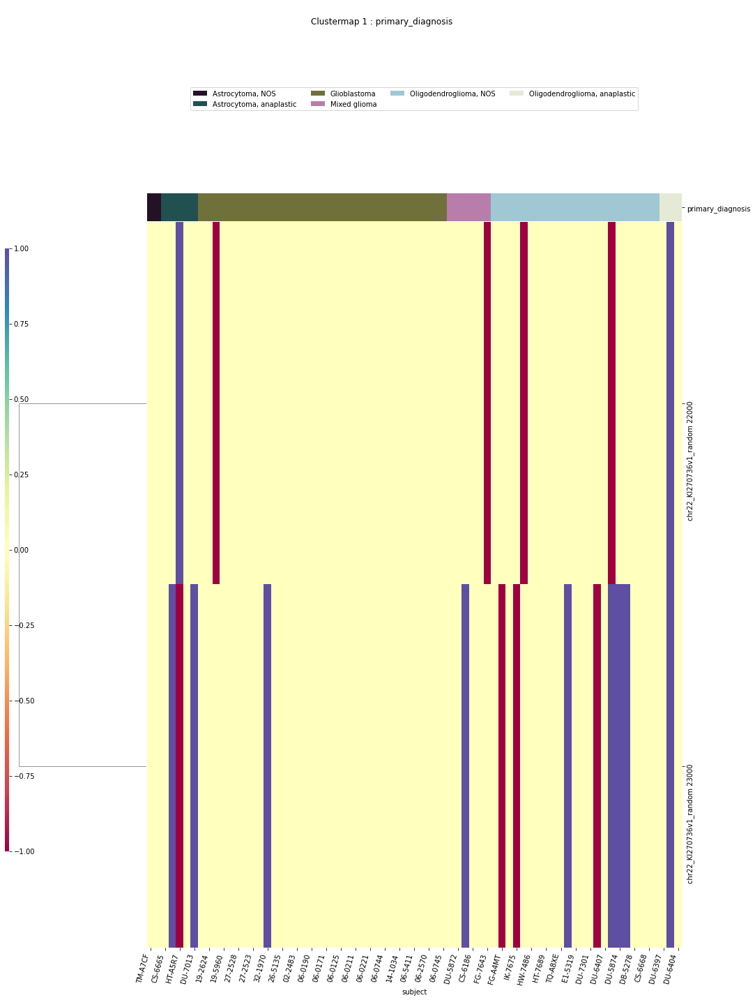

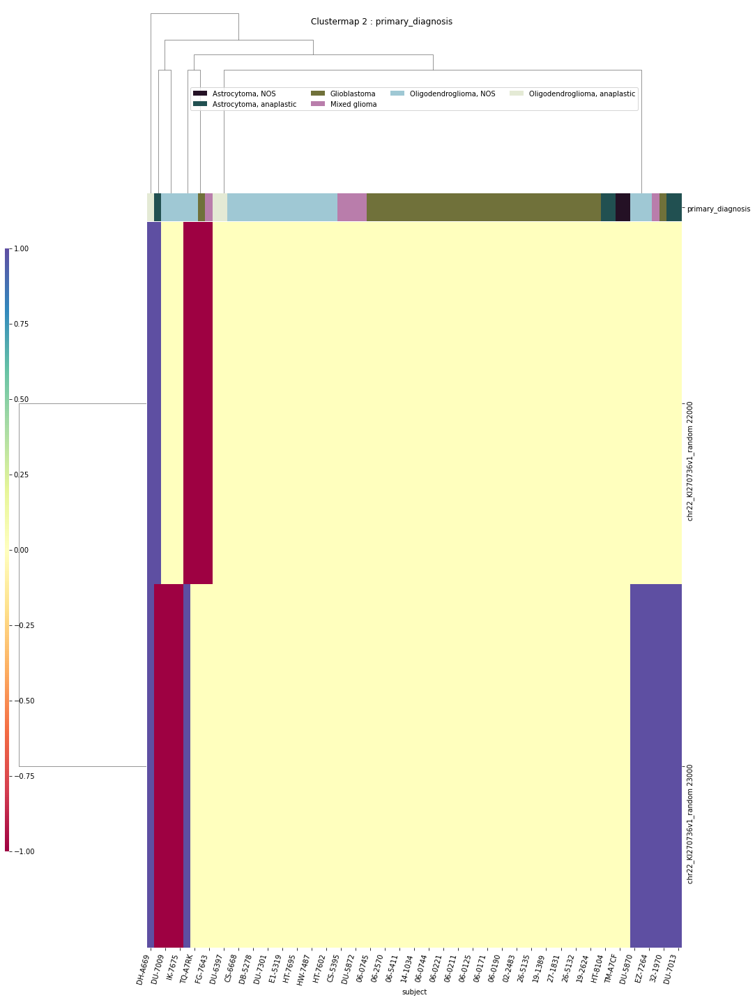

IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chr22_KI270738v1_random
HERVK113
primary_diagnosis
['primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chr3
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr3 57344000


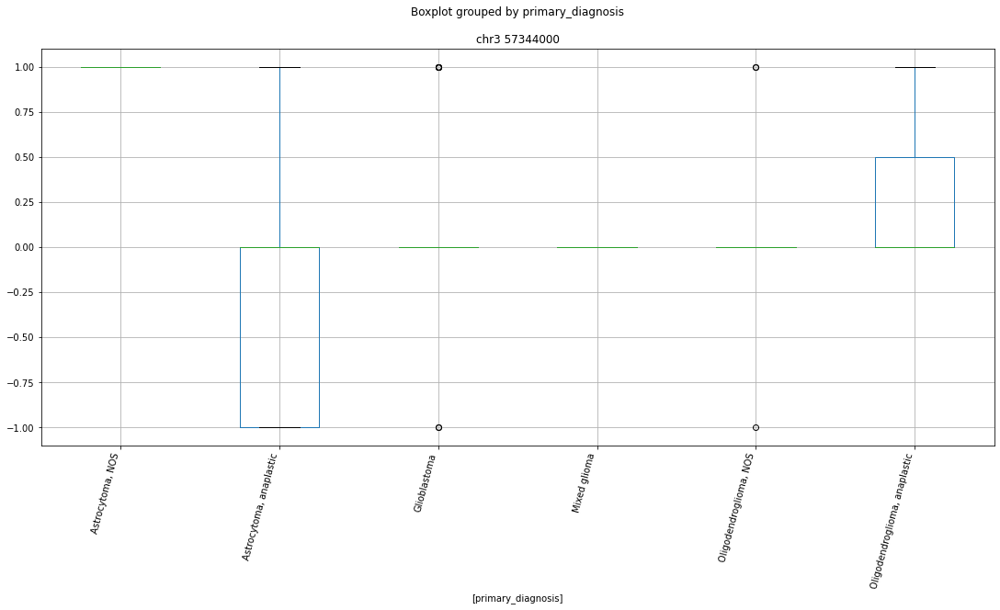

 p : 0.0  ( t : inf ) :  chr3 146097000


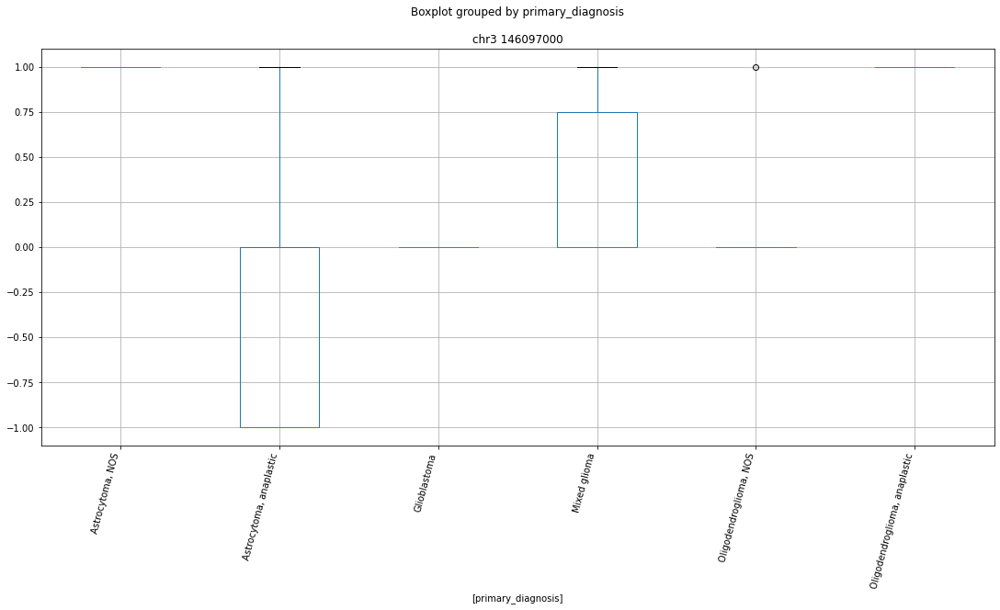

 p : 0.0  ( t : inf ) :  chr3 186874000


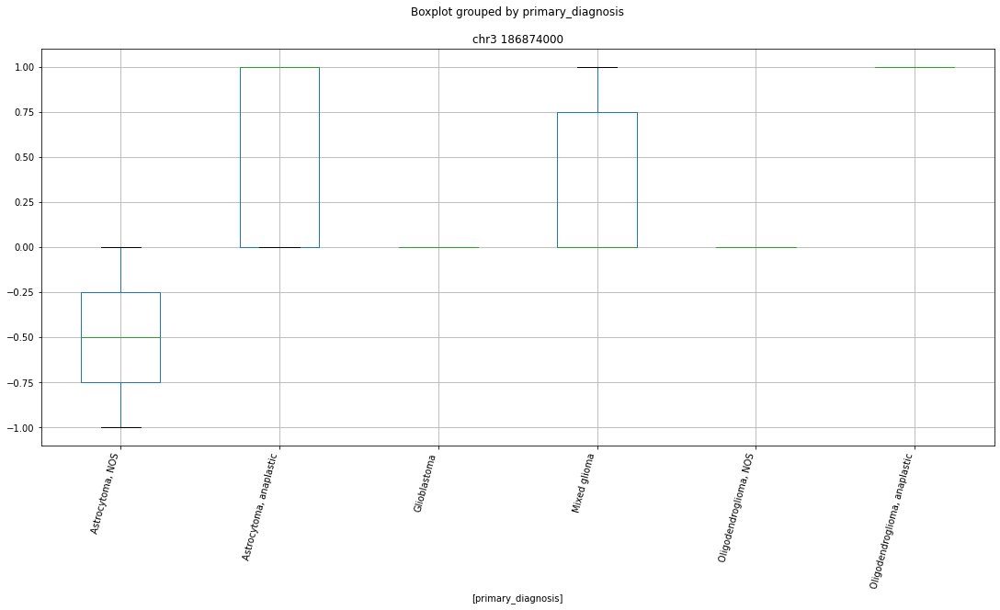

 p : 0.0  ( t : inf ) :  chr3 118718000


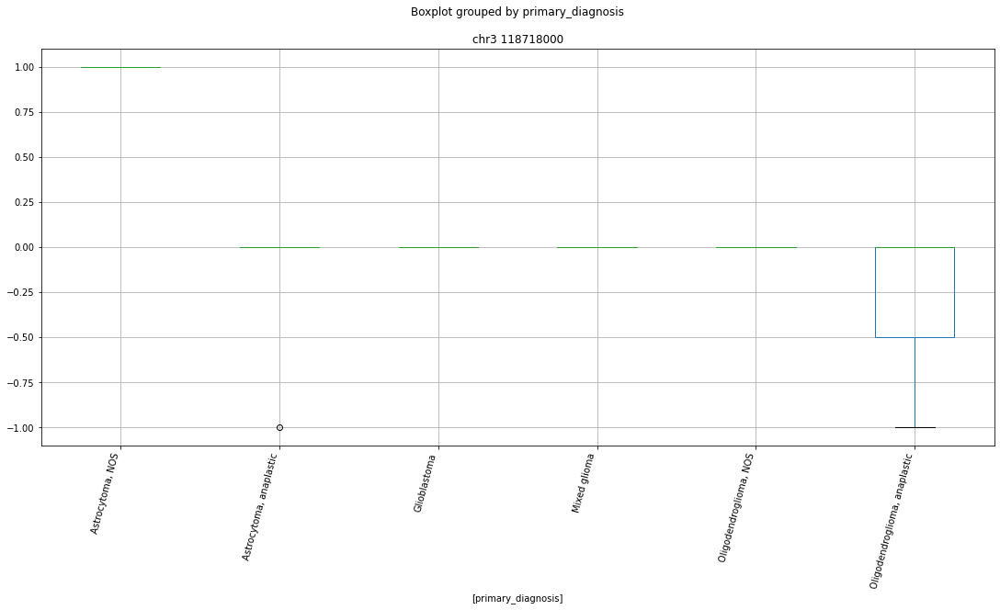

 p : 0.0  ( t : inf ) :  chr3 145710000


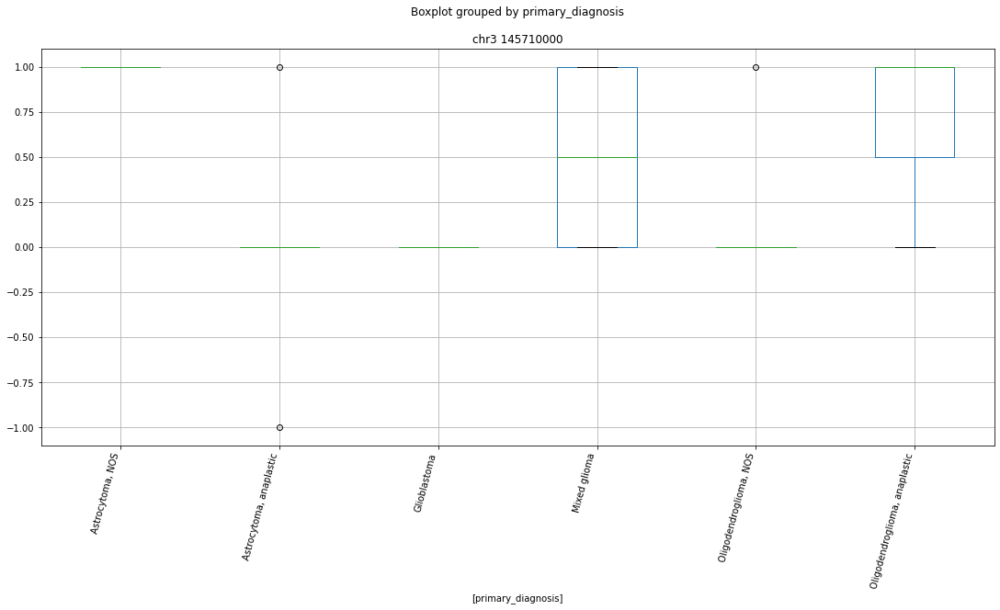

 p : 0.0  ( t : inf ) :  chr3 103531000


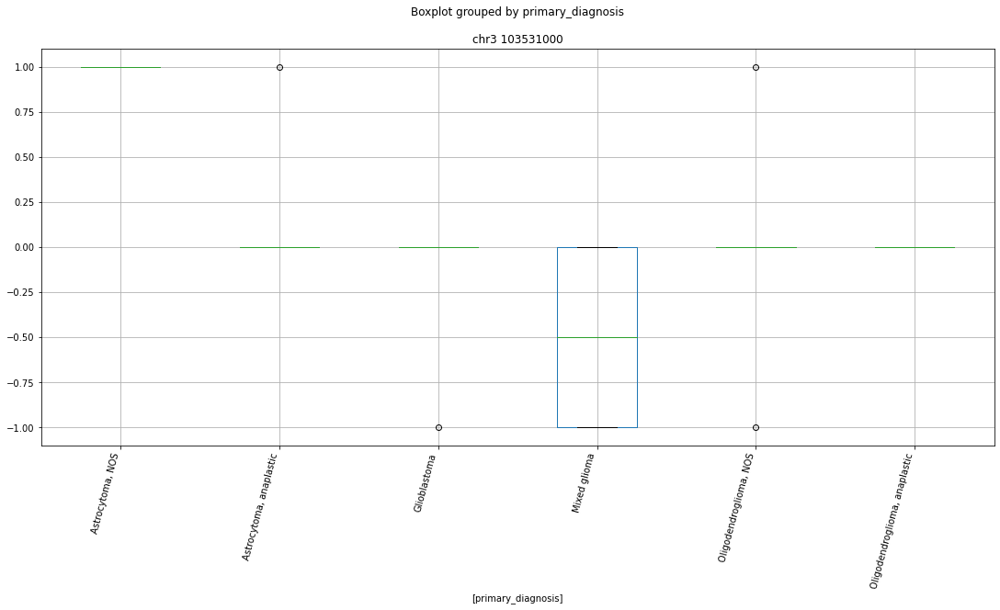

 p : 1.2735213637763693e-13  ( t : 11.358945418727965 ) :  chr3 16979000


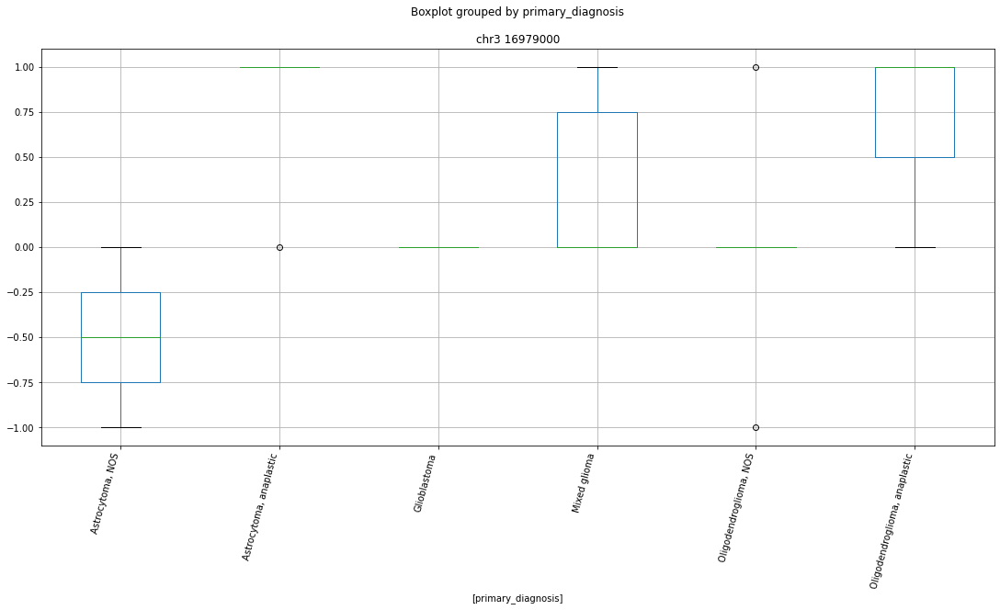

 p : 1.2735213637763693e-13  ( t : 11.358945418727965 ) :  chr3 9592000


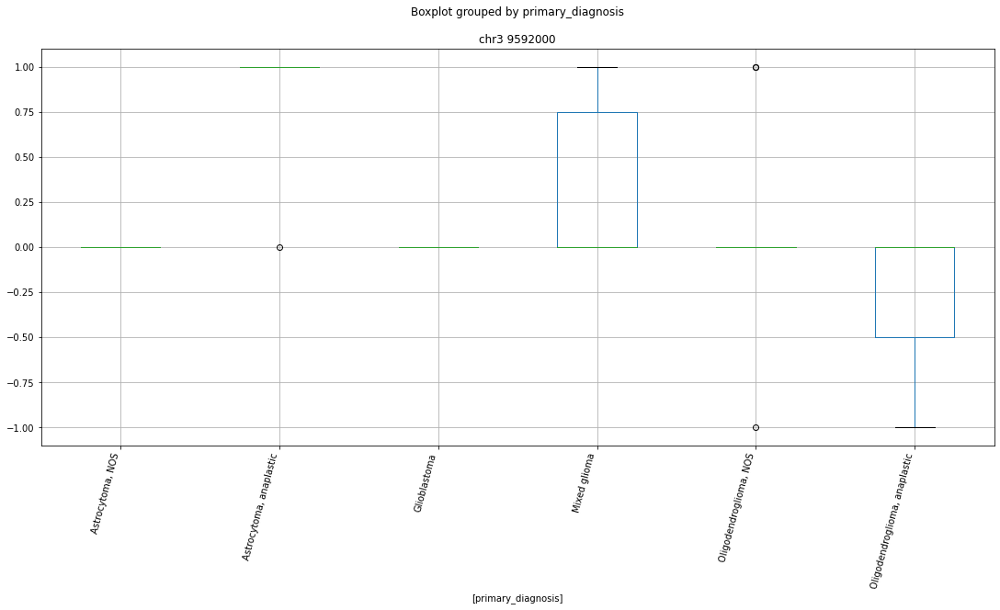

 p : 1.2735213637763693e-13  ( t : 11.358945418727965 ) :  chr3 197602000


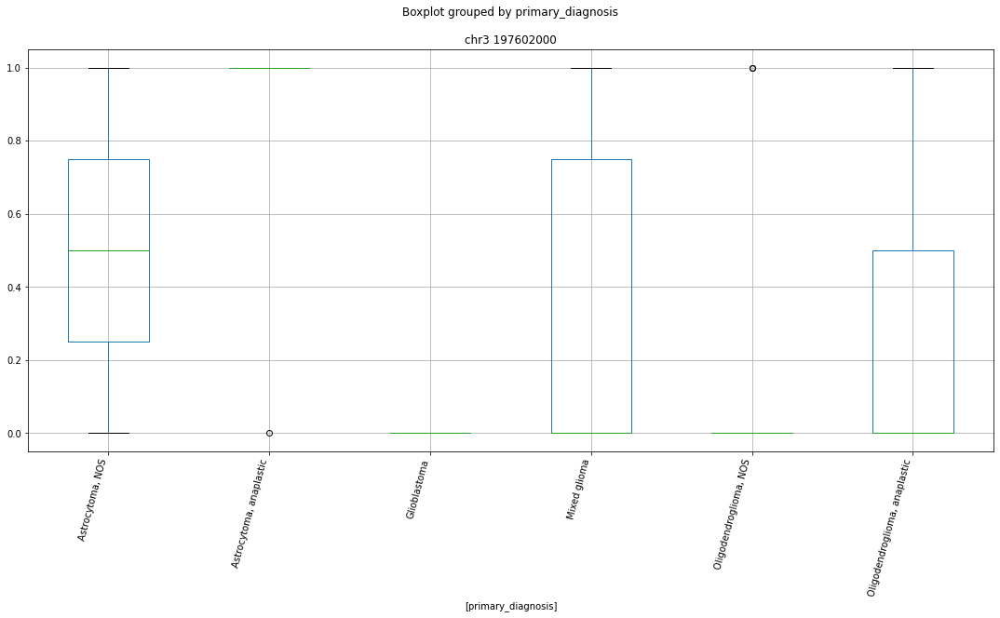

 p : 8.92060821762298e-10  ( t : 8.373639896594856 ) :  chr3 103531000


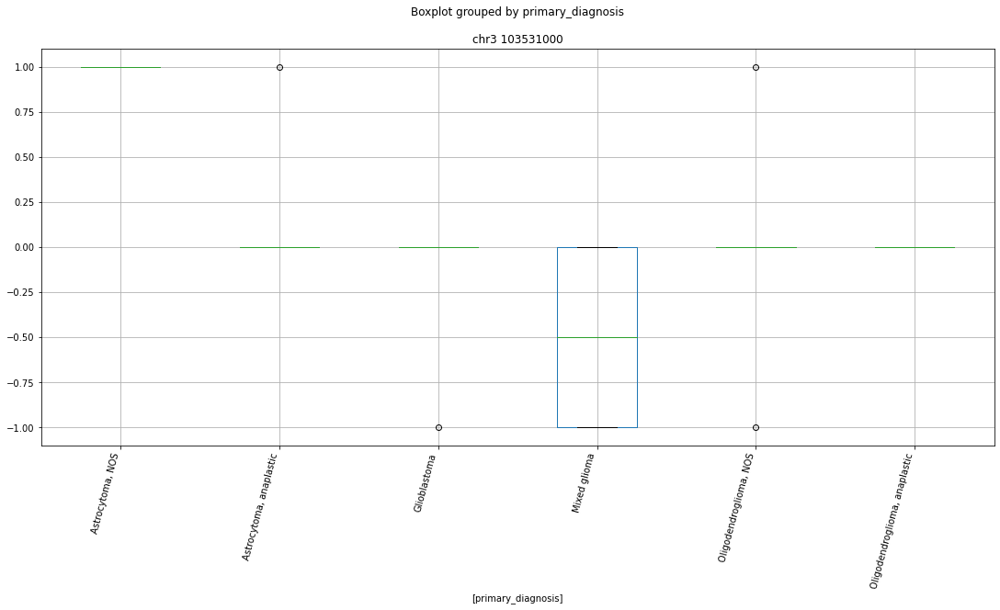

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr3 8440000


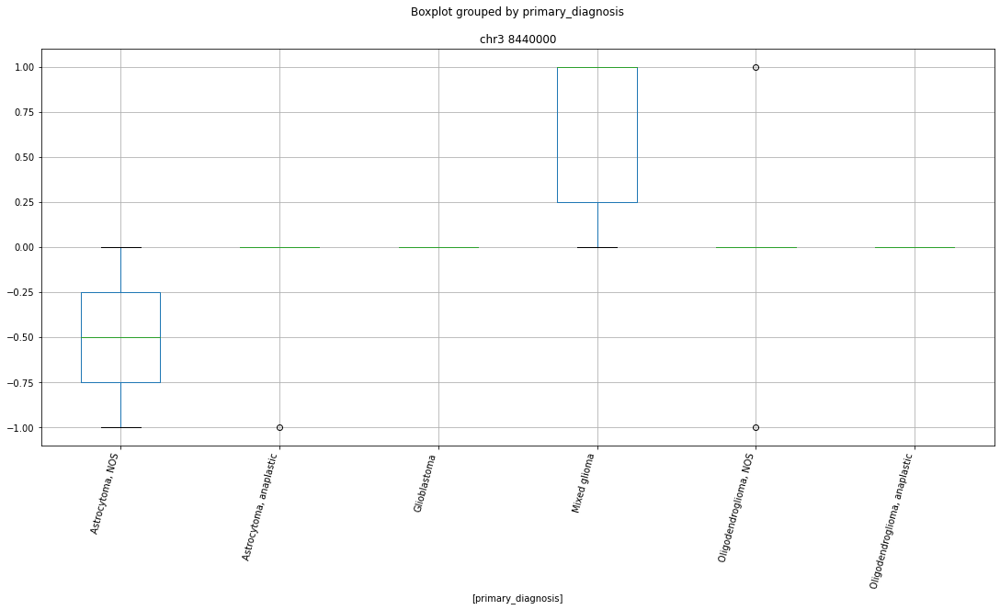

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr3 145710000


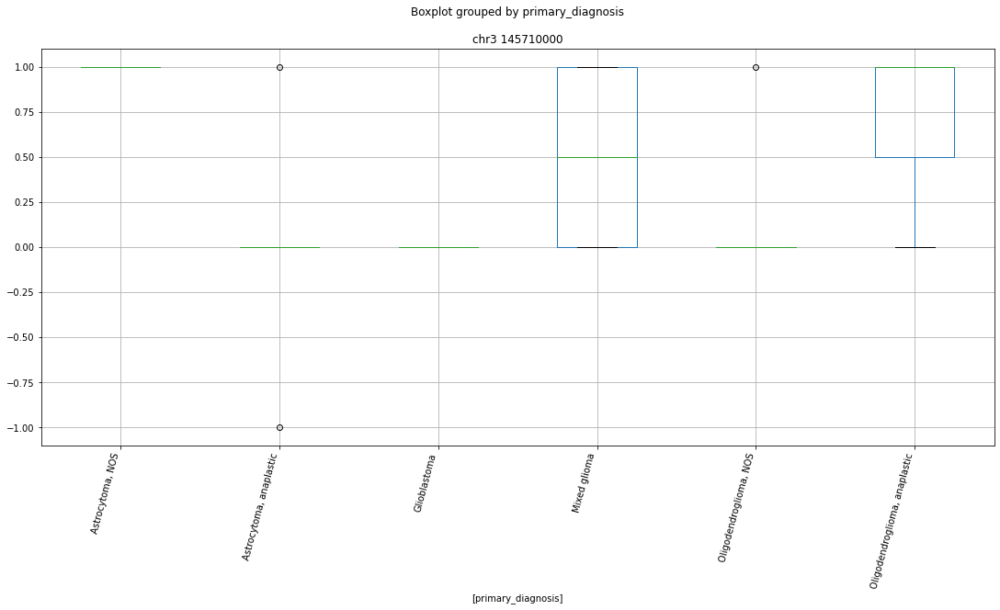

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr3 50823000


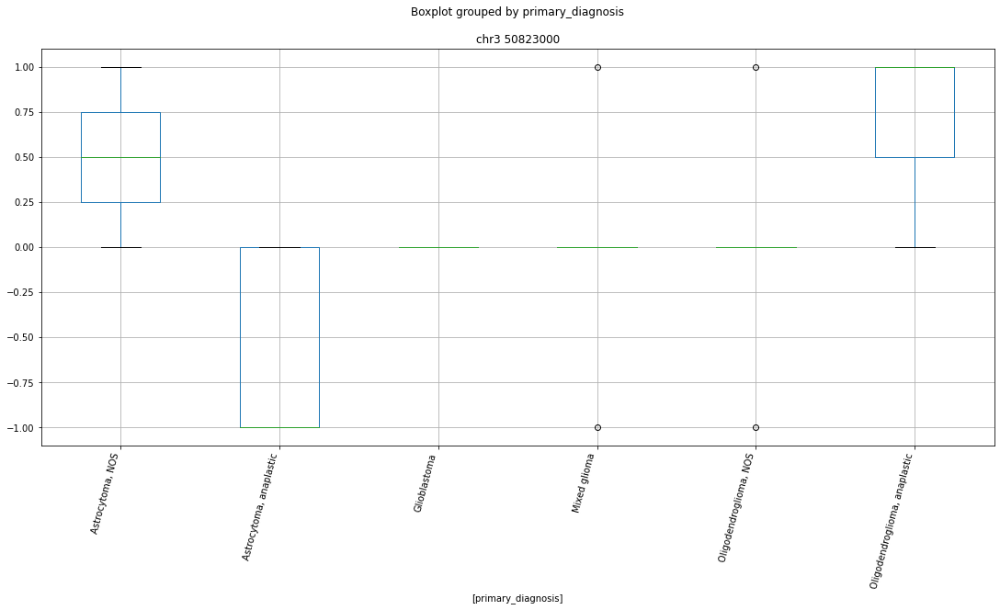

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr3 190473000


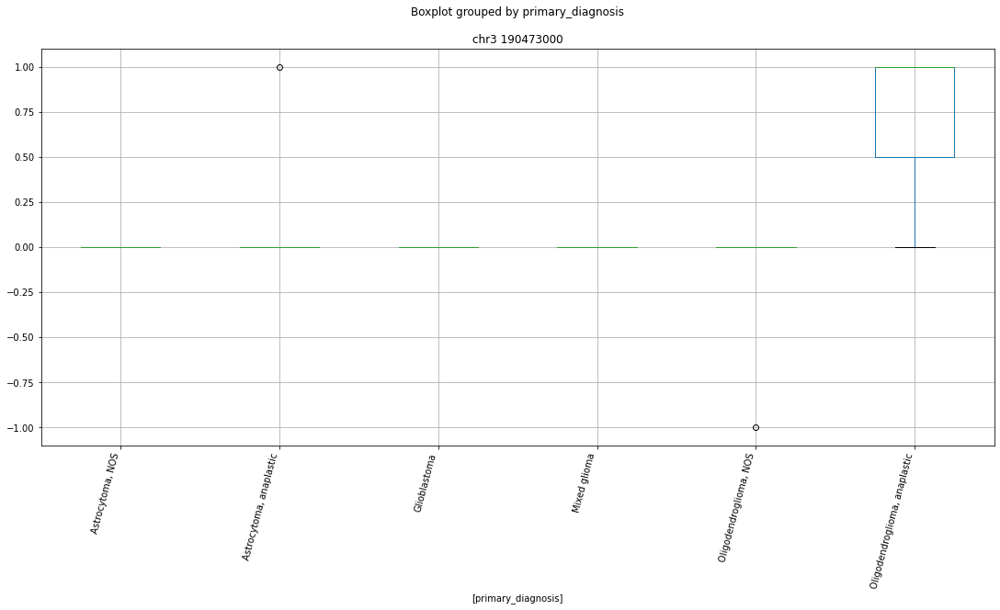

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr3 16979000


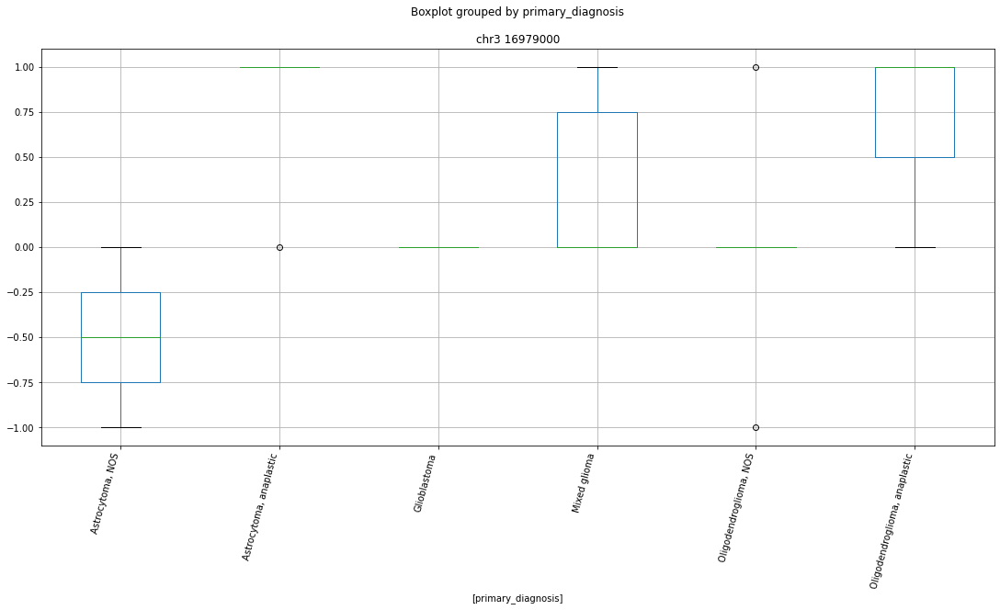

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr3 48062000


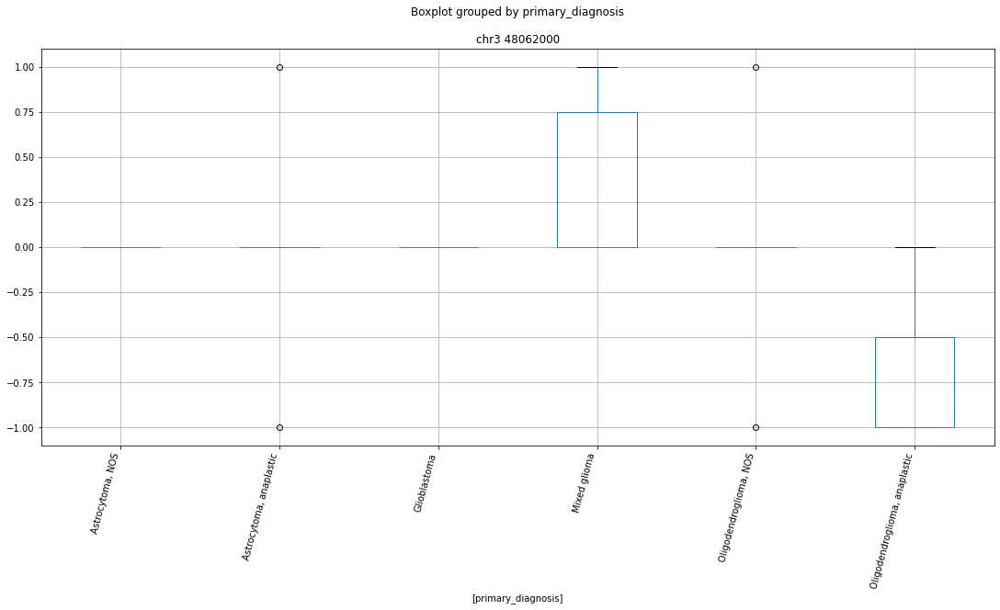

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr3 124749000


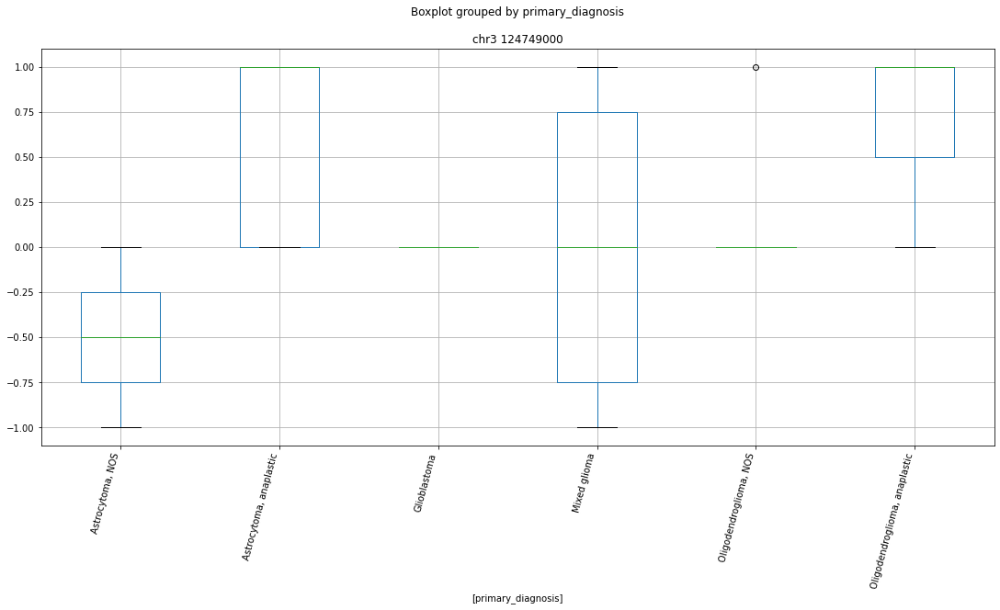

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr3 15062000


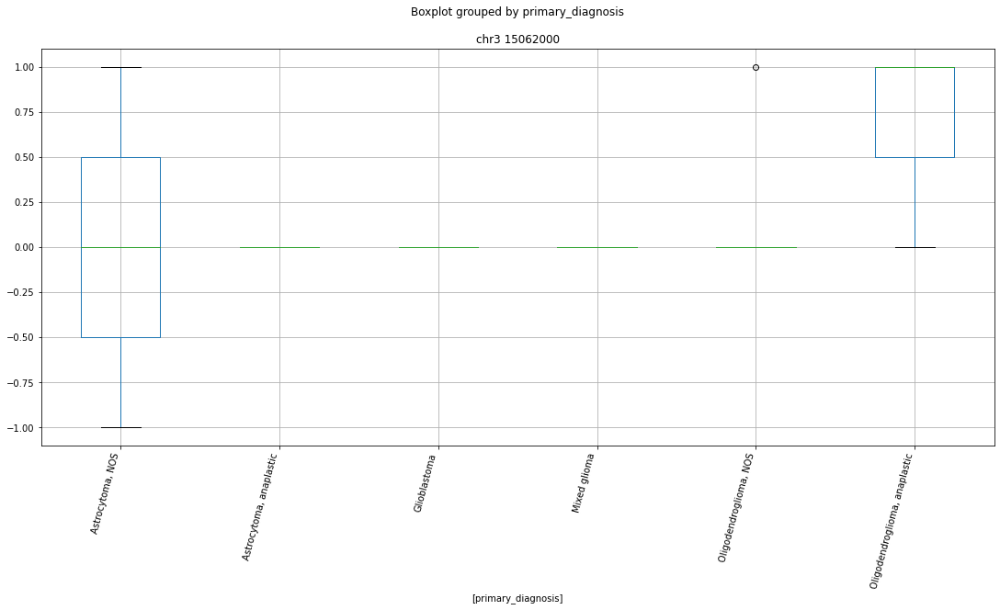

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr3 8326000


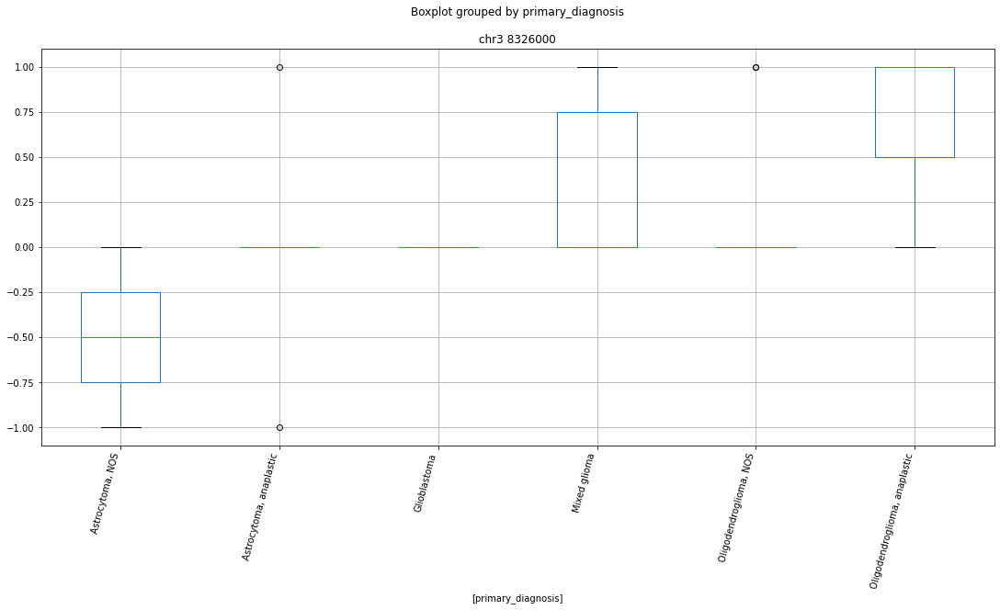

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr3 186874000


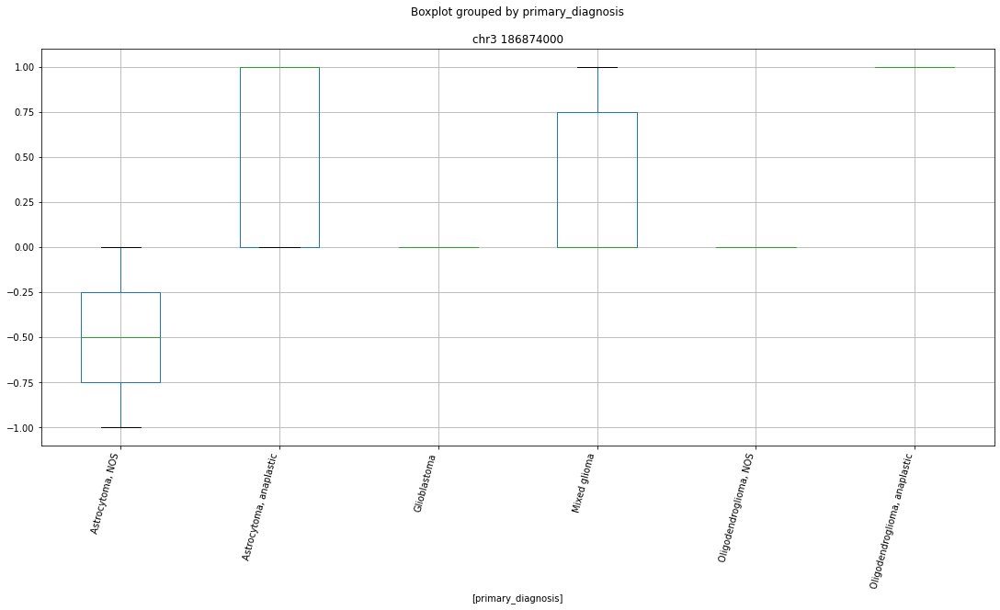

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr3 124749000


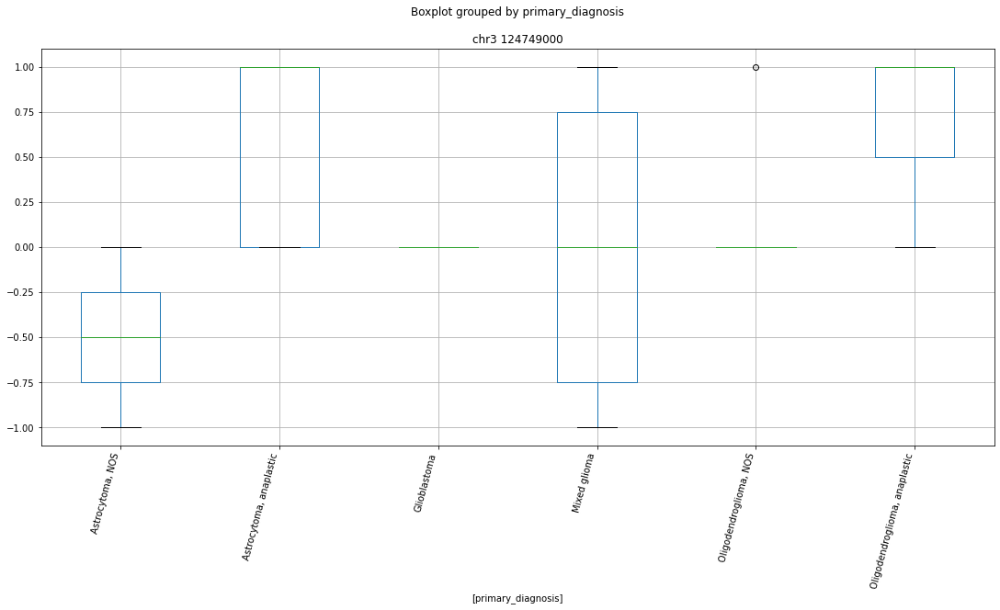

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr3 50823000


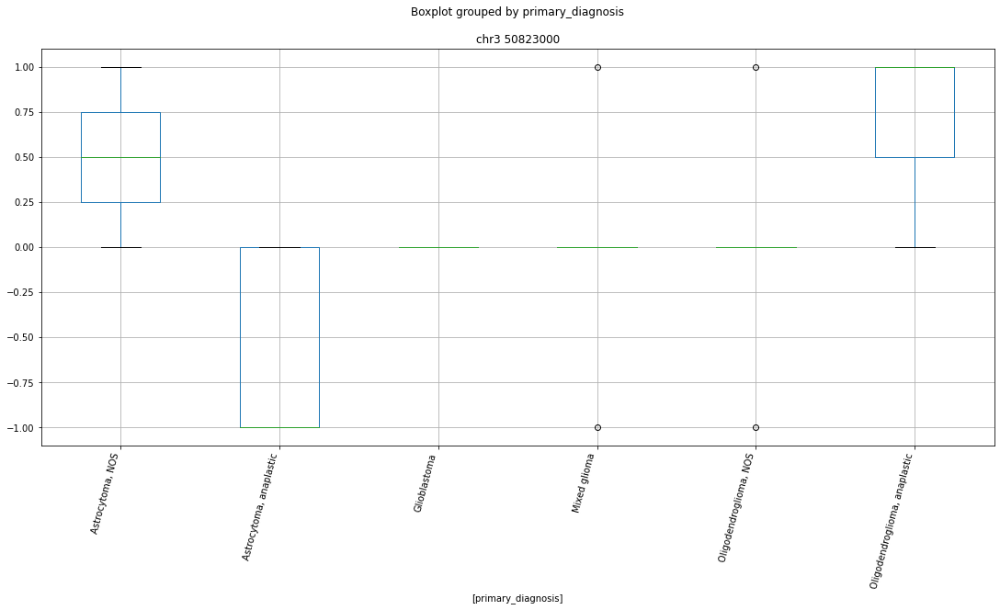

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr3 112153000


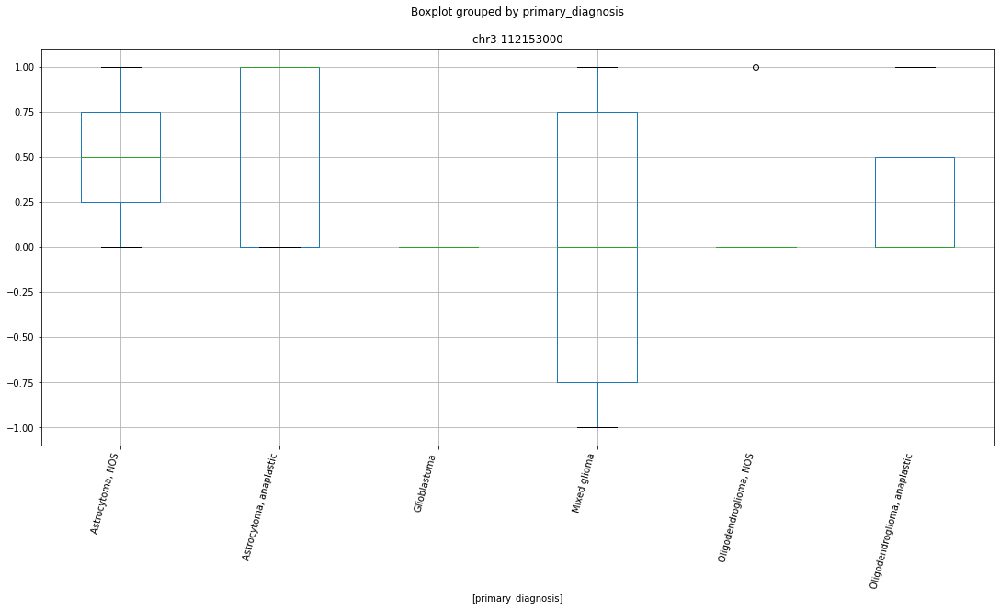

 p : 4.867369543712655e-08  ( t : 7.80532362705589 ) :  chr3 146097000


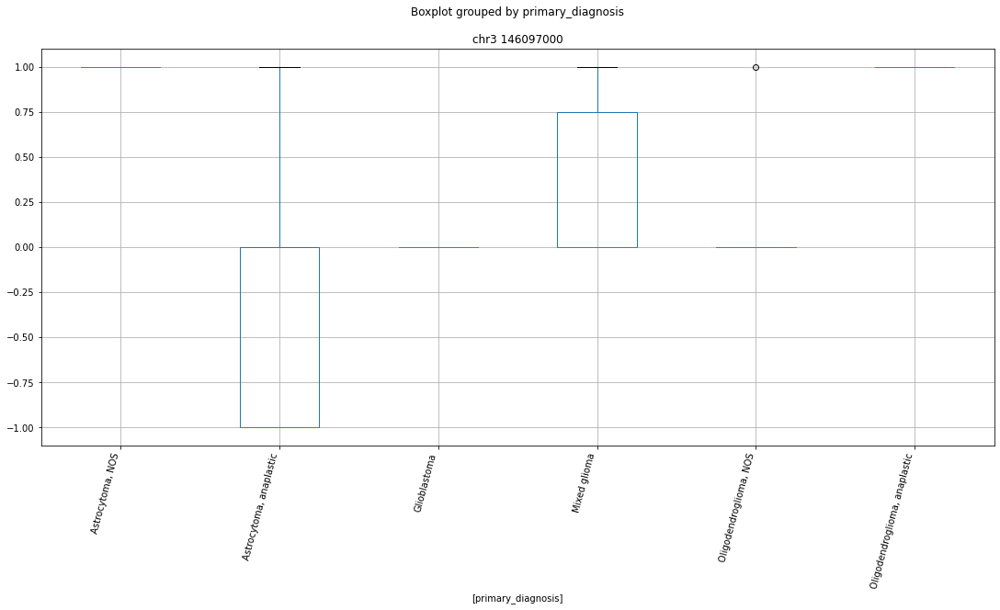

['chr3 100272000' 'chr3 100273000' 'chr3 100336000' 'chr3 100477000'
 'chr3 101703000' 'chr3 103254000' 'chr3 103531000' 'chr3 112153000'
 'chr3 112556000' 'chr3 112564000' 'chr3 112565000' 'chr3 113024000'
 'chr3 113046000' 'chr3 113849000' 'chr3 118718000' 'chr3 121611000'
 'chr3 122407000' 'chr3 122747000' 'chr3 122779000' 'chr3 124749000'
 'chr3 125731000' 'chr3 125890000' 'chr3 12674000' 'chr3 127412000'
 'chr3 12849000' 'chr3 130038000' 'chr3 132649000' 'chr3 14272000'
 'chr3 142752000' 'chr3 145710000' 'chr3 146097000' 'chr3 149380000'
 'chr3 15062000' 'chr3 150819000' 'chr3 15742000' 'chr3 16979000'
 'chr3 175905000' 'chr3 179290000' 'chr3 179316000' 'chr3 179727000'
 'chr3 181925000' 'chr3 183171000' 'chr3 183520000' 'chr3 183609000'
 'chr3 186811000' 'chr3 186866000' 'chr3 186874000' 'chr3 186894000'
 'chr3 190473000' 'chr3 191124000' 'chr3 194400000' 'chr3 195728000'
 'chr3 195927000' 'chr3 195928000' 'chr3 196543000' 'chr3 196761000'
 'chr3 196944000' 'chr3 196962000' 'chr3

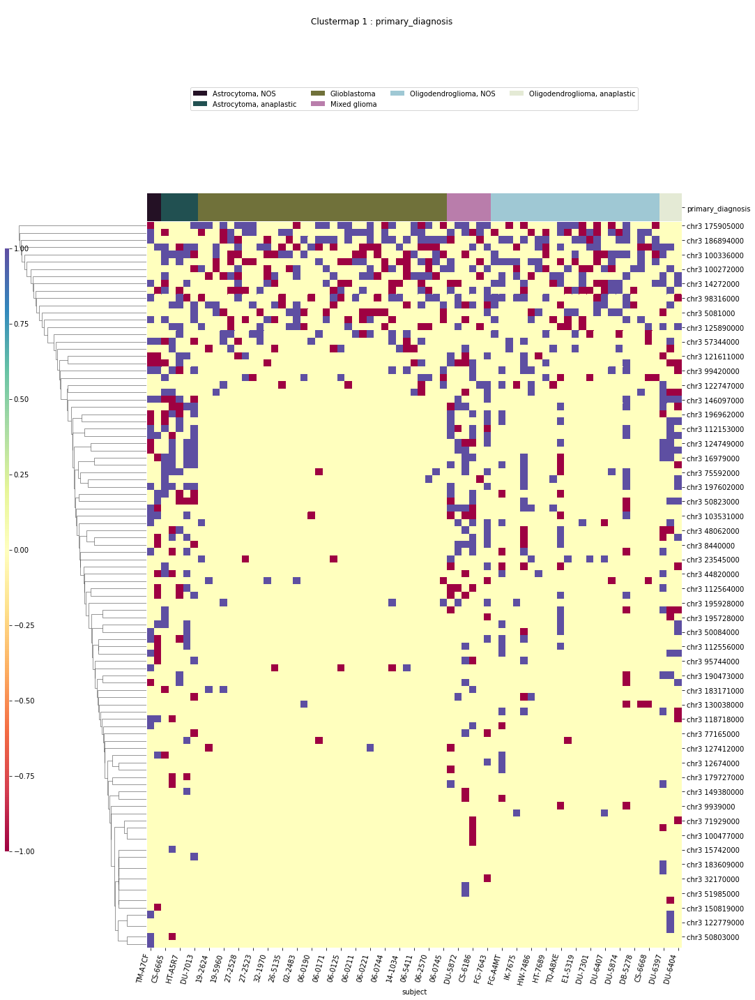

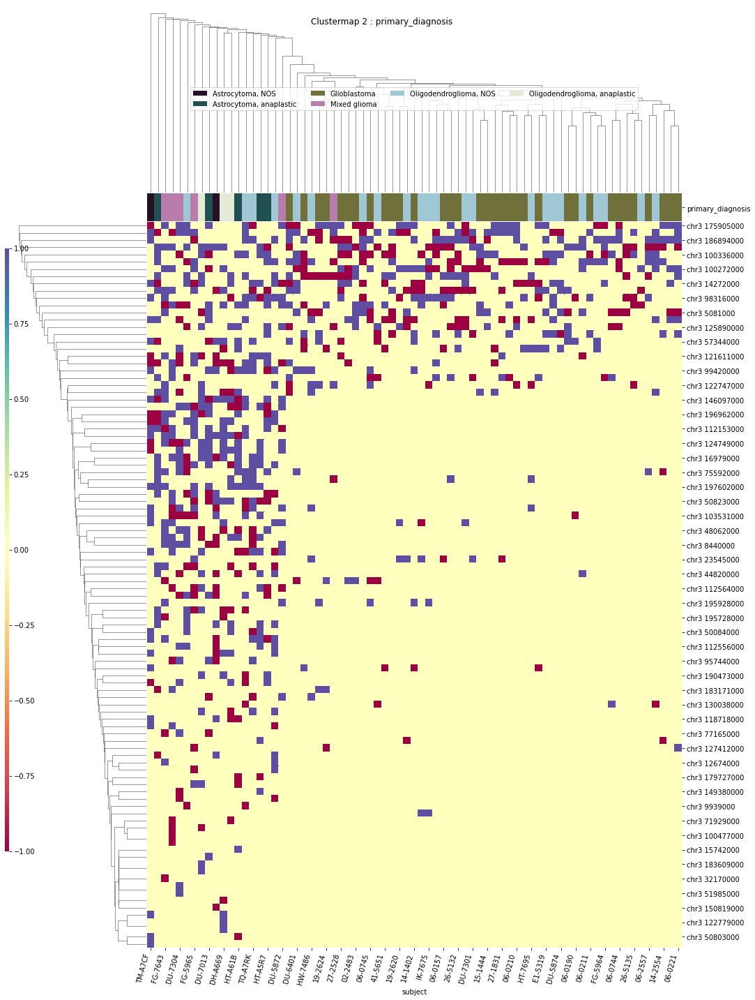

IDH
['IDH' 'chr3 100336000' 'chr3 113024000' 'chr3 113849000' 'chr3 175905000'
 'chr3 183171000' 'chr3 23544000' 'chr3 23545000' 'chr3 27532000'
 'chr3 38135000' 'chr3 5081000' 'chr3 5082000' 'chr3 77165000'
 'chr3 82585000' 'chr3 98316000' 'subject']


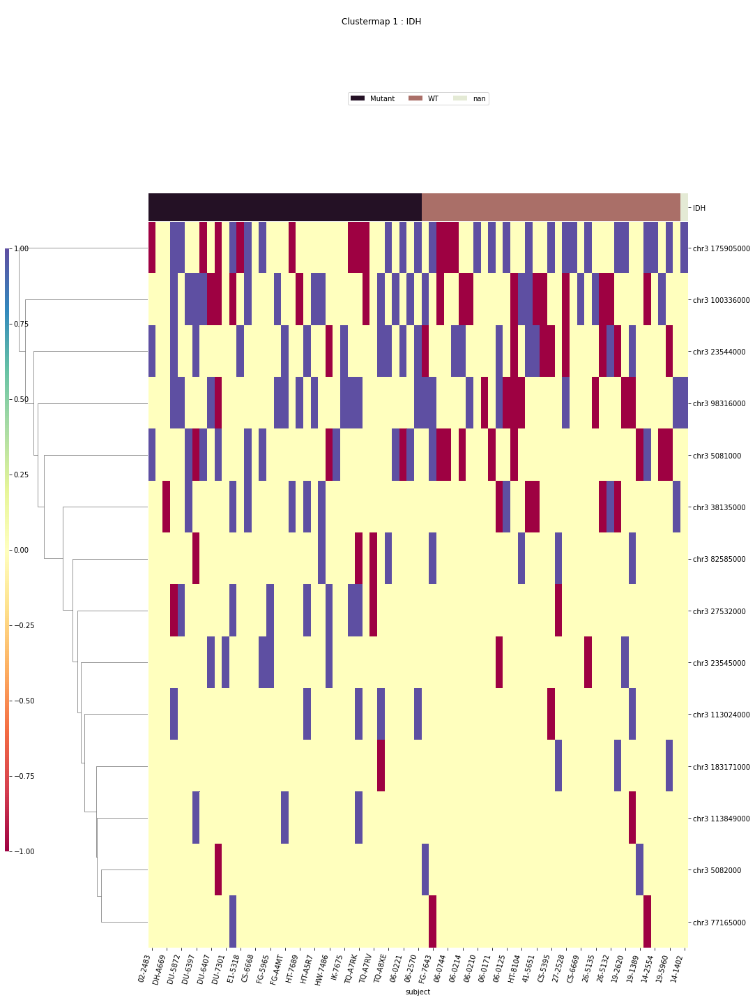

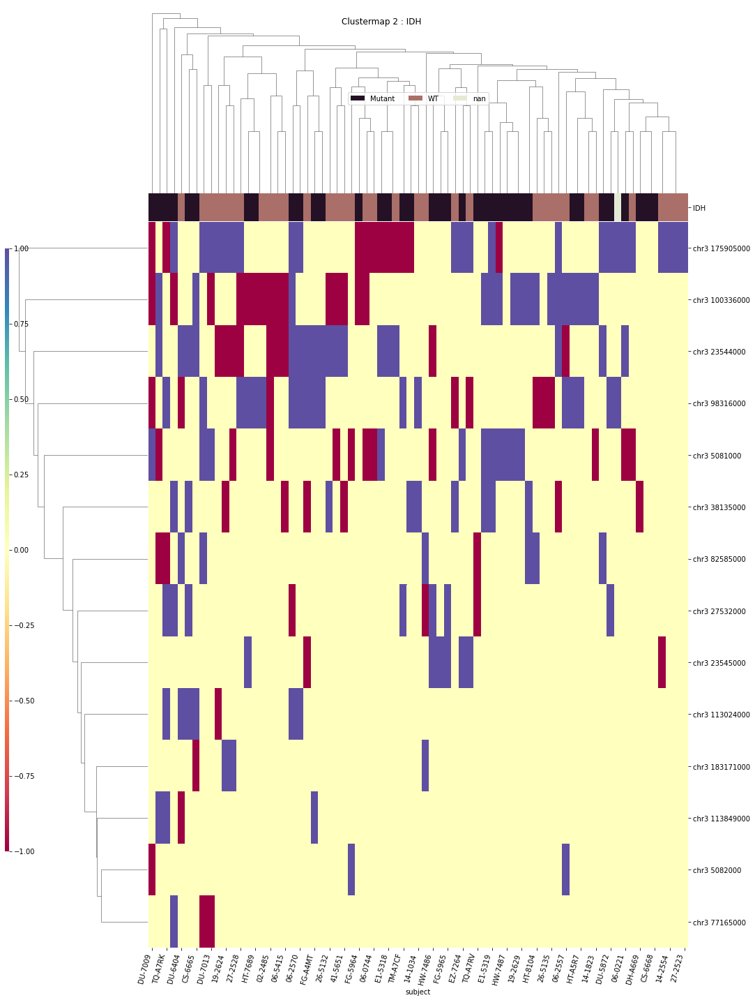

x1p19q
['chr3 101703000' 'chr3 122407000' 'chr3 122779000' 'chr3 130038000'
 'chr3 146522000' 'chr3 175906000' 'chr3 177412000' 'chr3 181925000'
 'chr3 183609000' 'chr3 48062000' 'chr3 48212000' 'chr3 50311000'
 'chr3 5082000' 'chr3 75394000' 'subject' 'x1p19q']


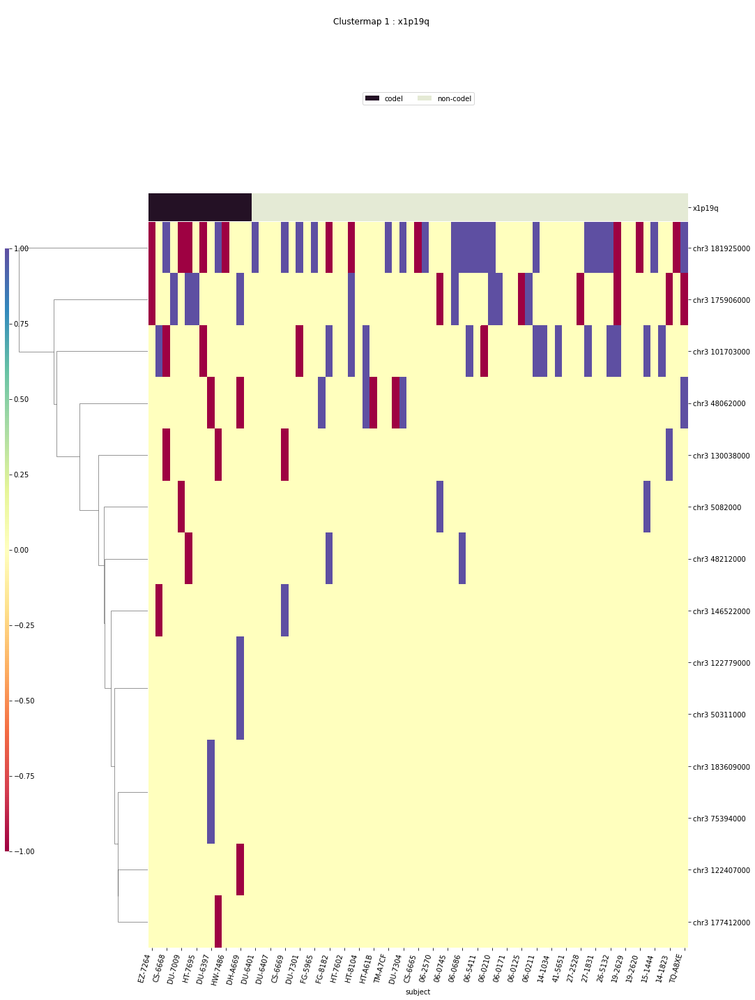

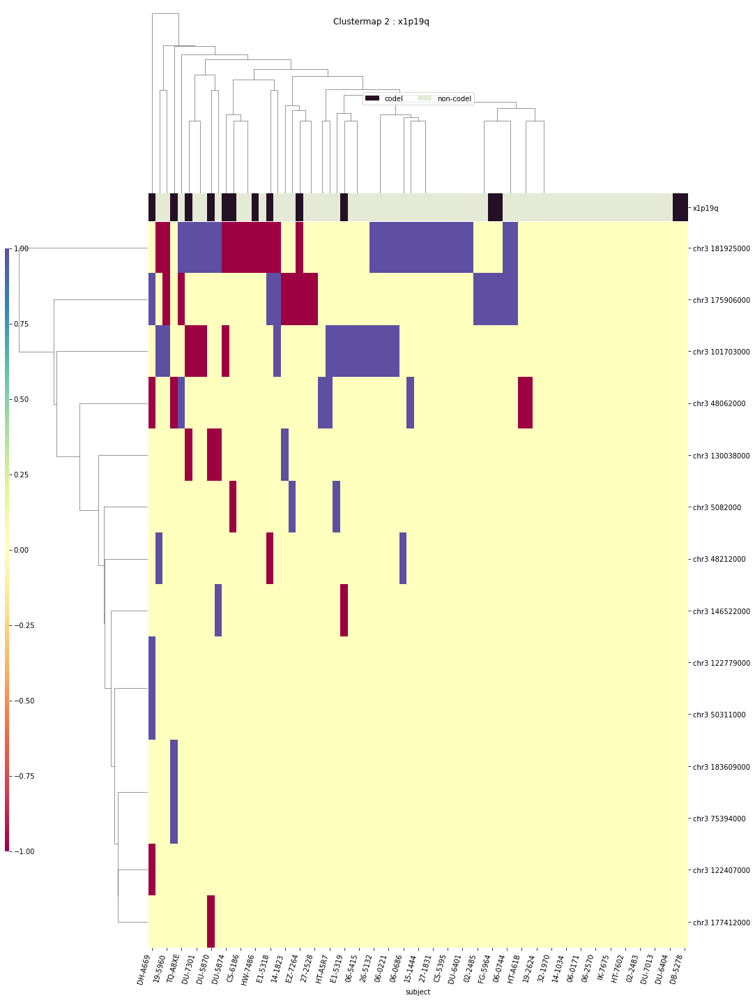

TERT
['TERT' 'chr3 103254000' 'chr3 110368000' 'chr3 112564000'
 'chr3 113024000' 'chr3 12849000' 'chr3 132649000' 'chr3 183171000'
 'chr3 186866000' 'chr3 186886000' 'chr3 195728000' 'chr3 196543000'
 'chr3 197602000' 'chr3 23544000' 'chr3 27532000' 'chr3 51859000'
 'chr3 5283000' 'chr3 75393000' 'chr3 98316000' 'subject']


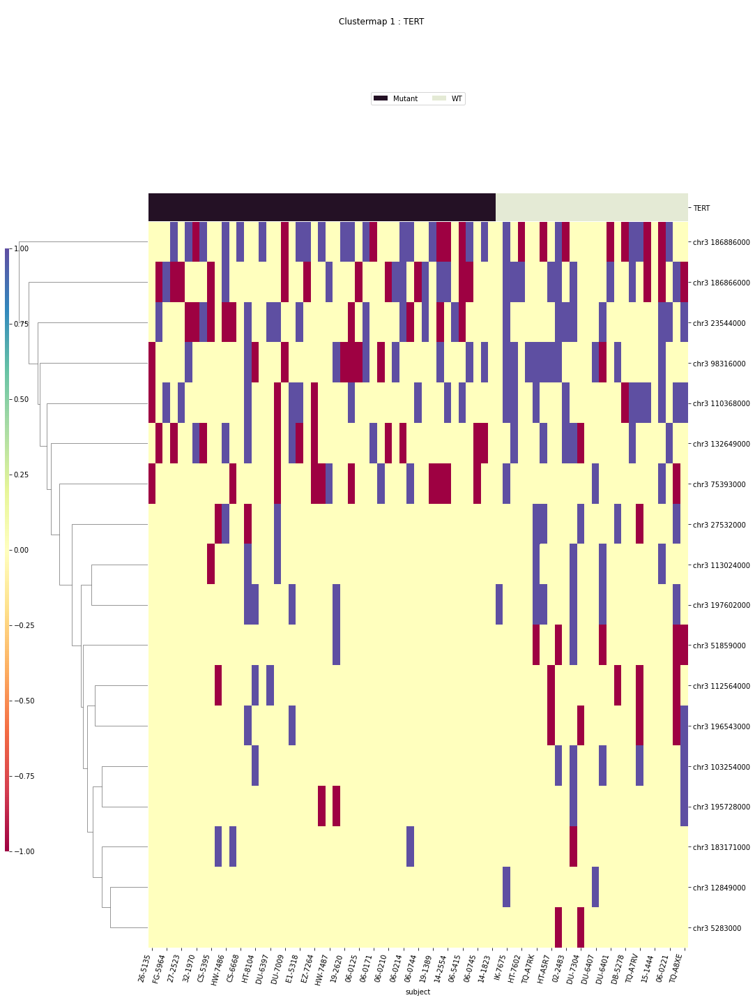

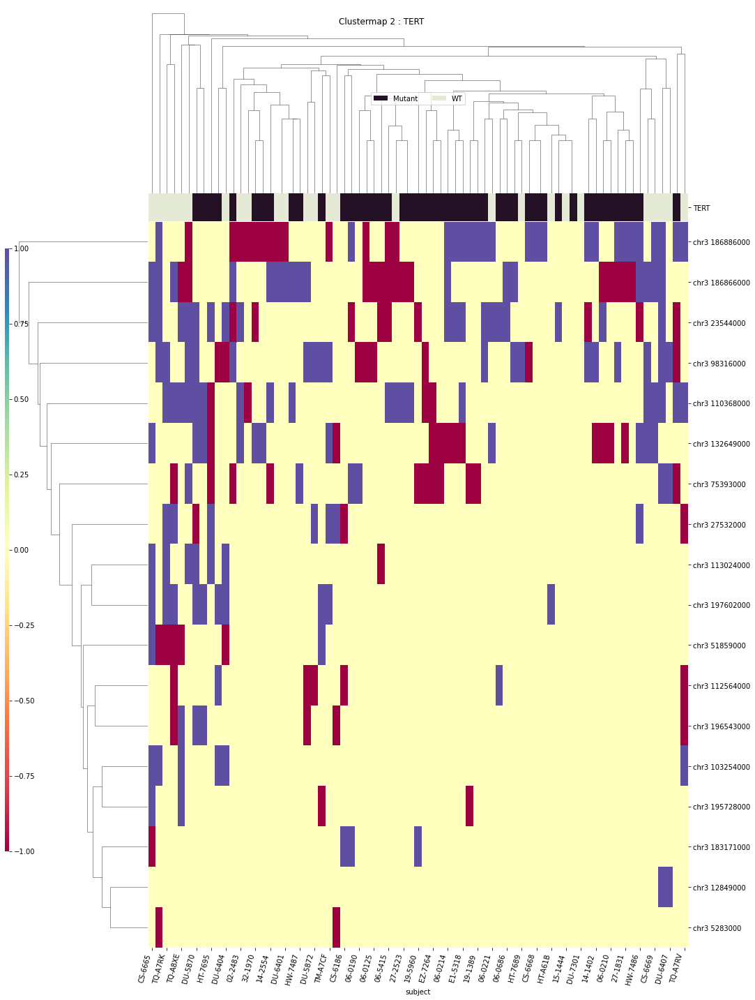

disease_type
['chr3 100273000' 'chr3 101703000' 'chr3 103254000' 'chr3 112153000'
 'chr3 130038000' 'chr3 14272000' 'chr3 145710000' 'chr3 16979000'
 'chr3 181925000' 'chr3 186866000' 'chr3 186874000' 'chr3 197602000'
 'chr3 23545000' 'chr3 38135000' 'chr3 38136000' 'chr3 5081000'
 'chr3 5082000' 'chr3 75592000' 'chr3 9592000' 'disease_type' 'subject']


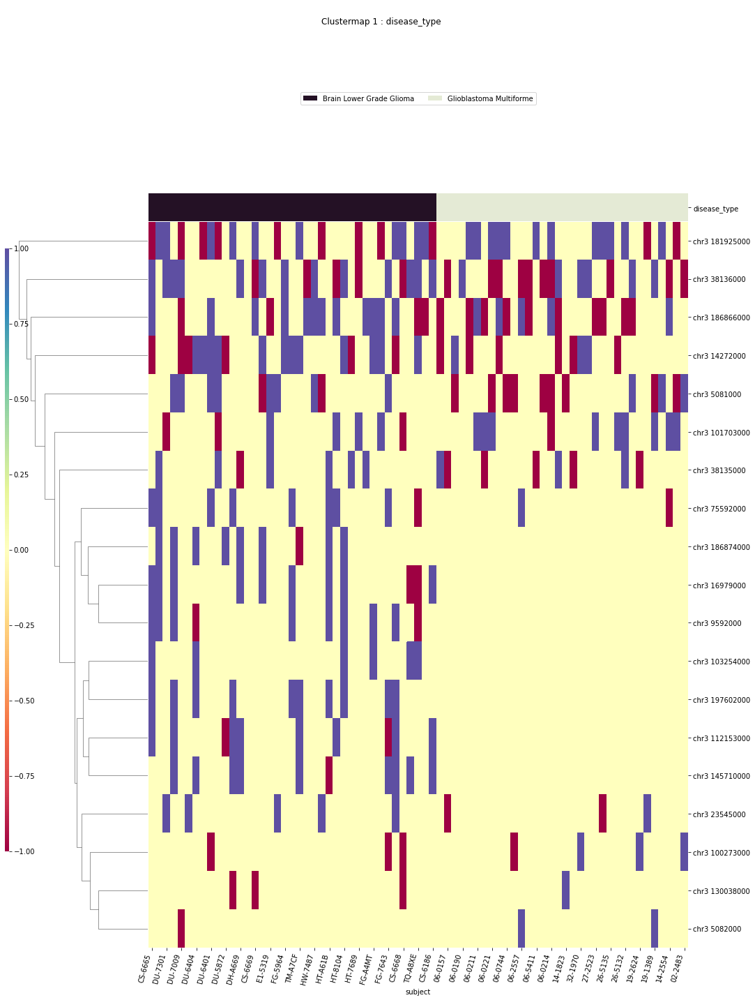

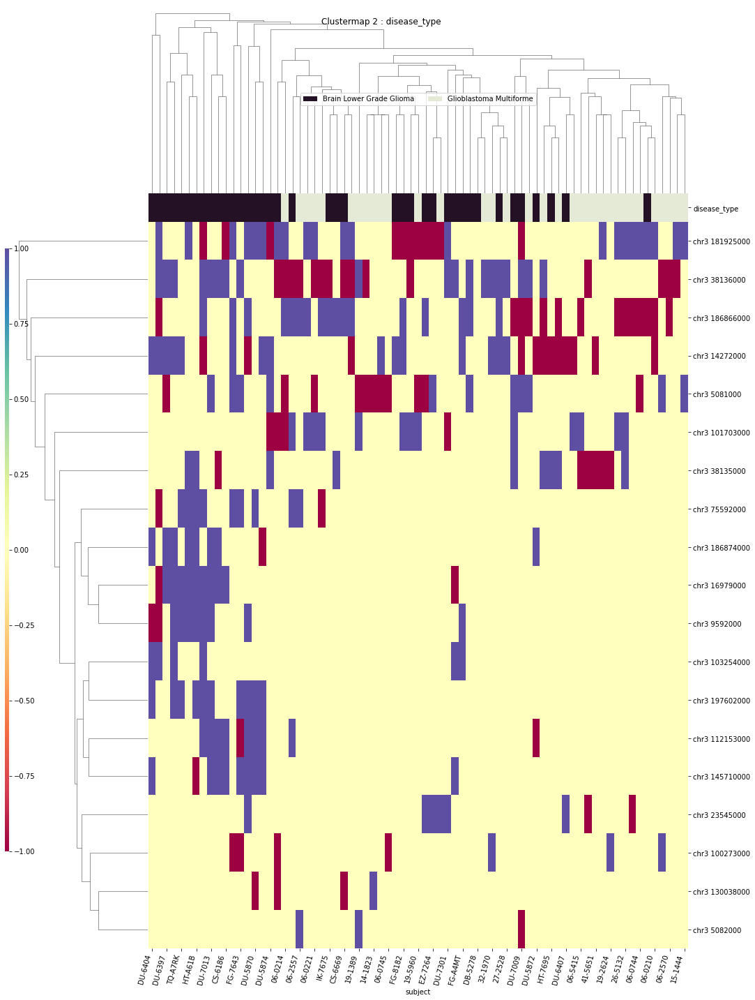

chr3_GL000221v1_random
HERVK113
primary_diagnosis
['primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chr4
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr4 592000


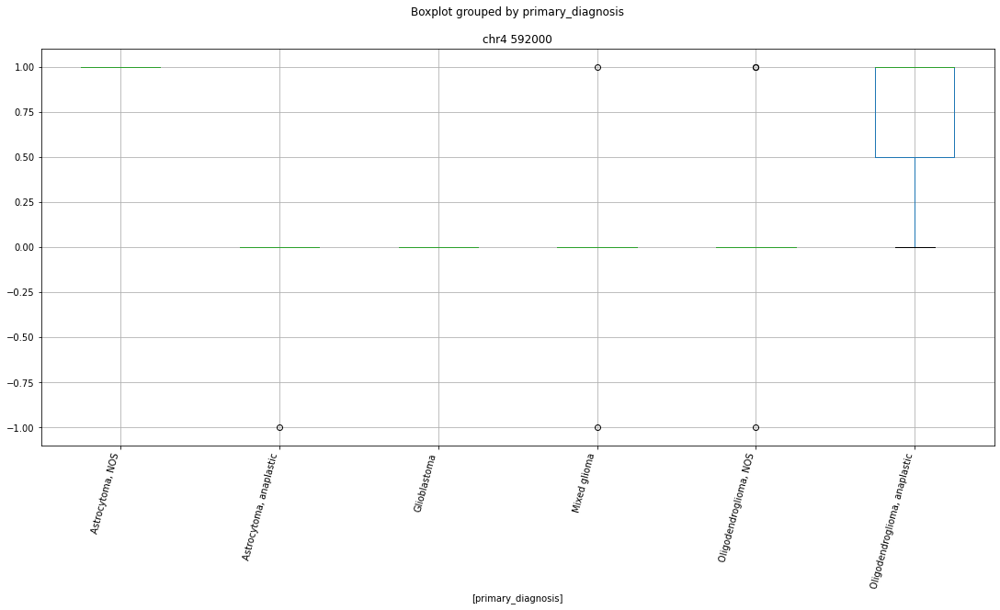

 p : 0.0  ( t : inf ) :  chr4 46378000


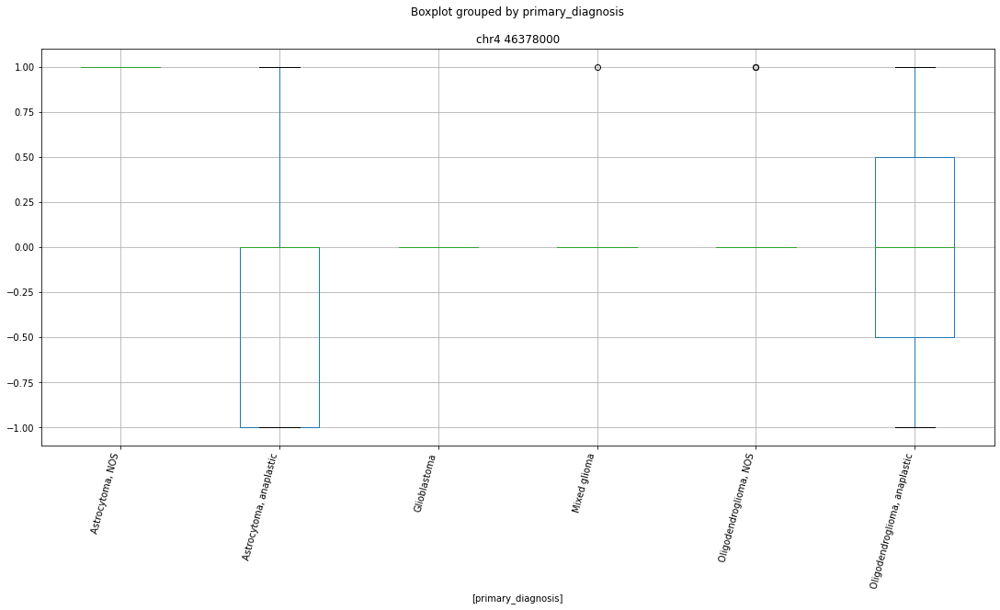

 p : 0.0  ( t : inf ) :  chr4 76423000


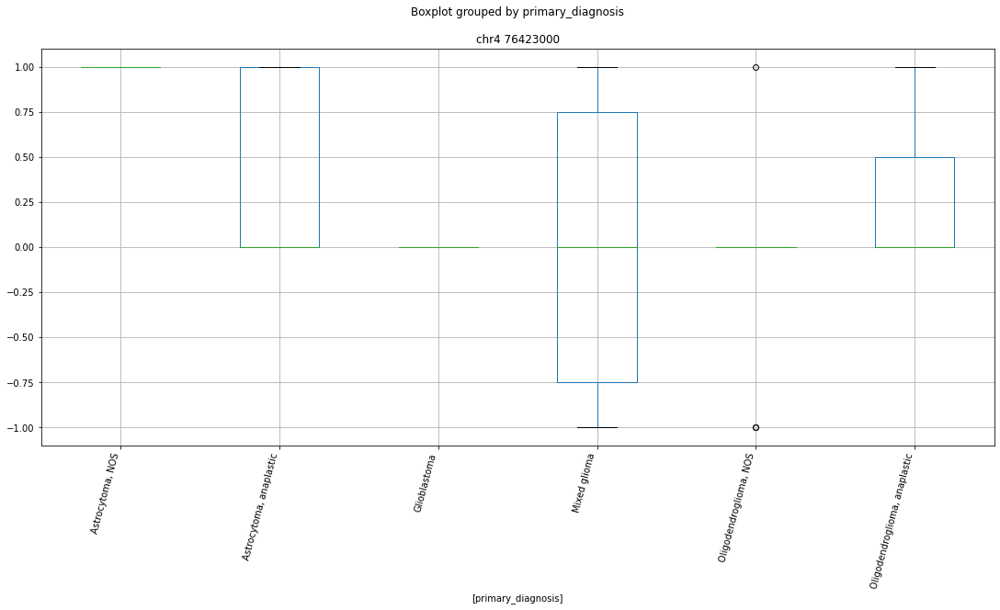

 p : 0.0  ( t : inf ) :  chr4 159976000


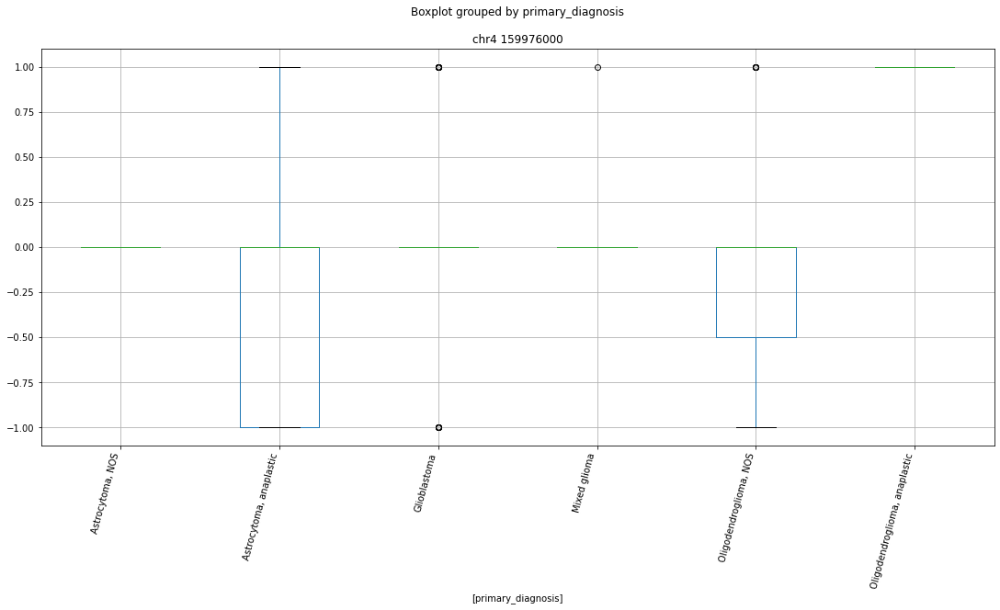

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr4 64900000


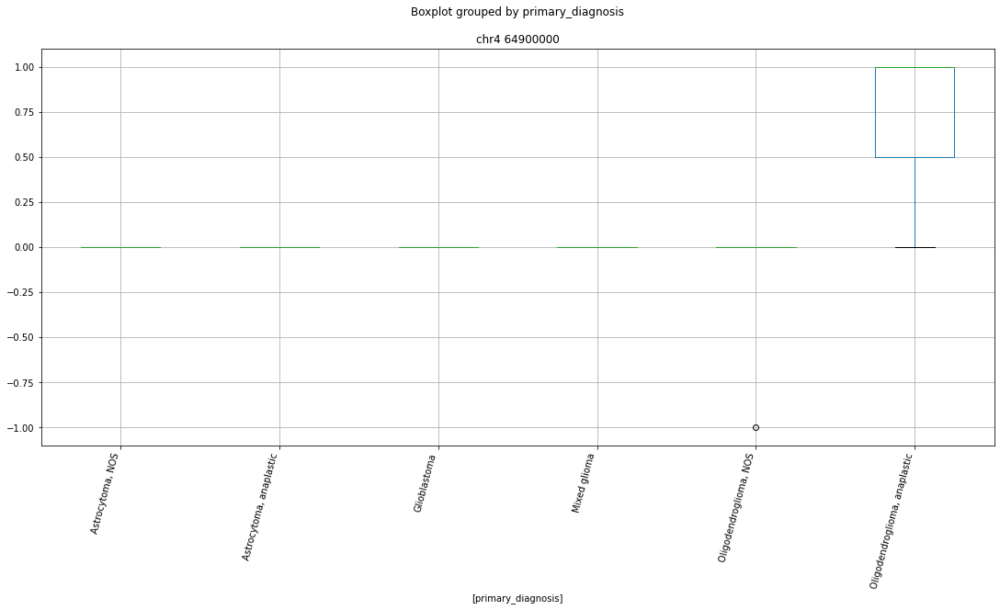

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr4 41049000


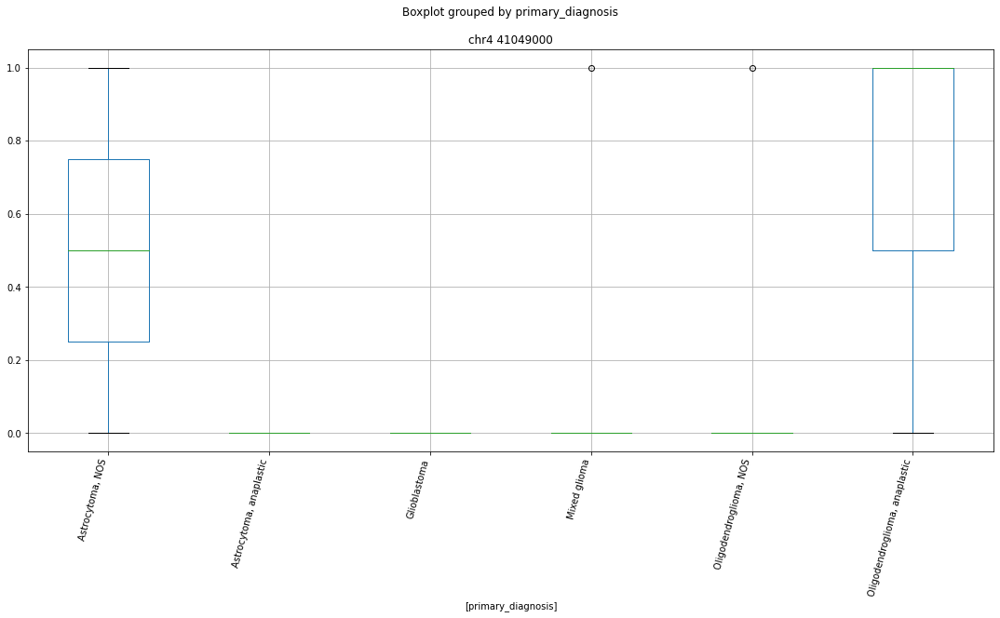

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr4 592000


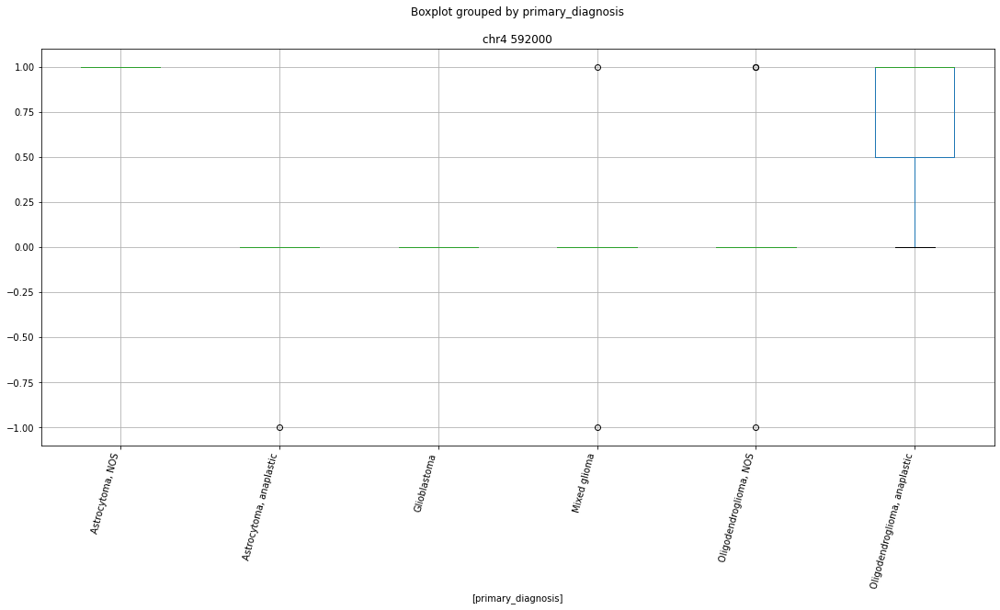

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr4 83943000


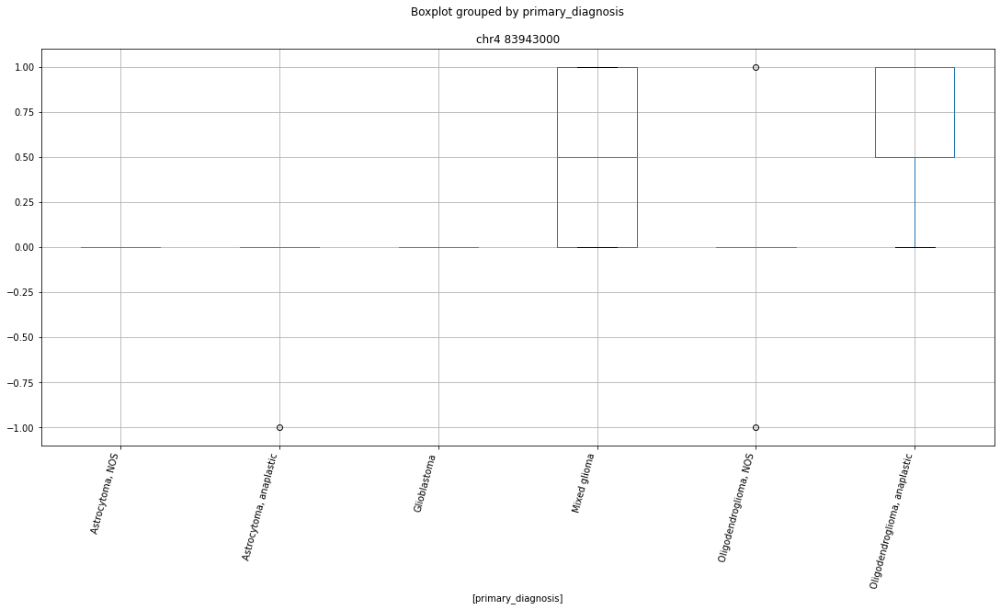

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr4 13760000


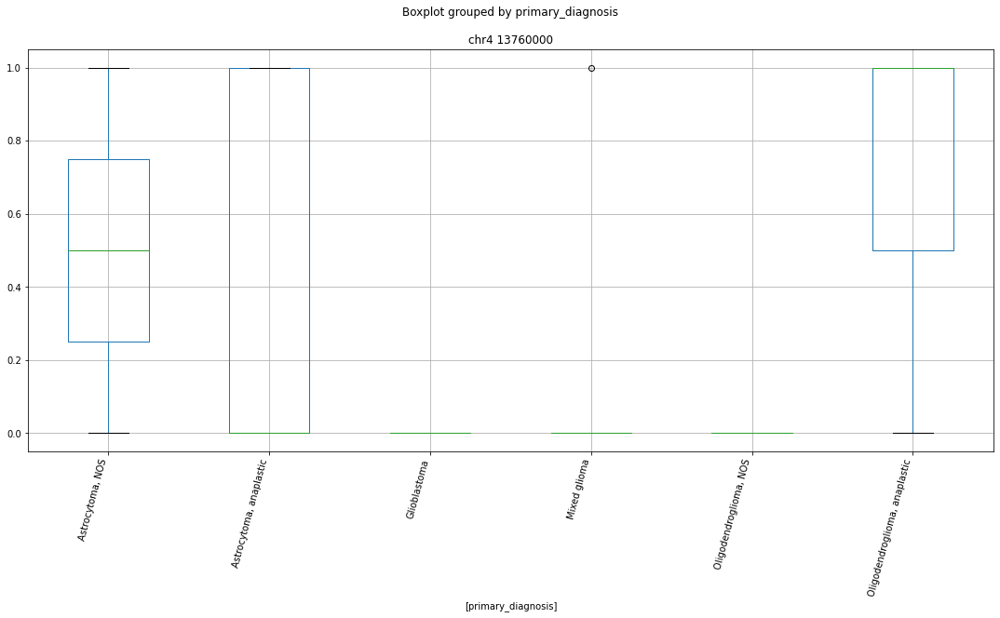

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr4 78548000


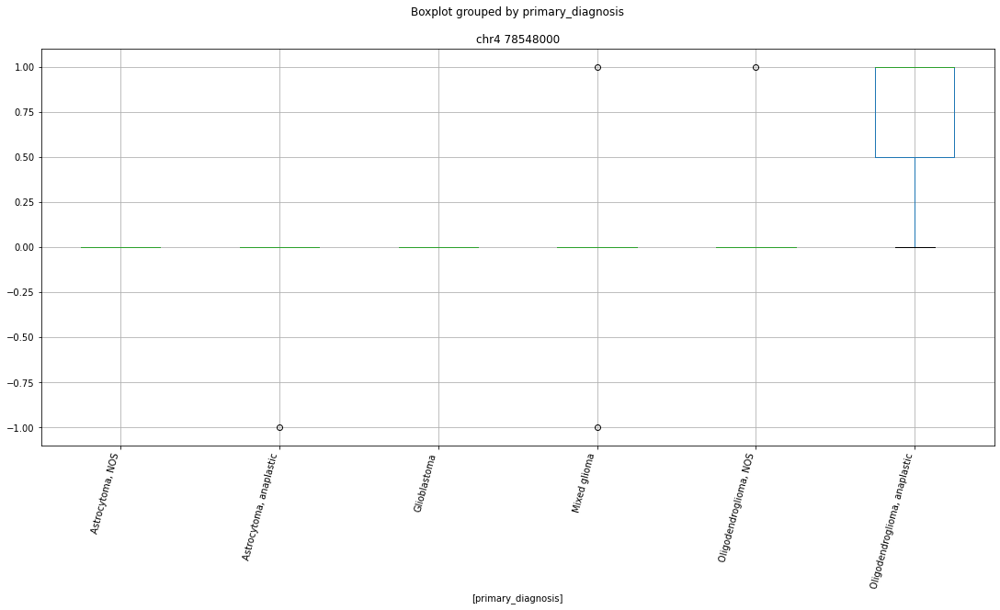

['chr4 10127000' 'chr4 103723000' 'chr4 104171000' 'chr4 108410000'
 'chr4 109597000' 'chr4 110275000' 'chr4 112957000' 'chr4 114516000'
 'chr4 117183000' 'chr4 118535000' 'chr4 119343000' 'chr4 119396000'
 'chr4 121397000' 'chr4 122017000' 'chr4 122812000' 'chr4 134045000'
 'chr4 135538000' 'chr4 135539000' 'chr4 135641000' 'chr4 13760000'
 'chr4 138854000' 'chr4 145226000' 'chr4 150660000' 'chr4 151391000'
 'chr4 152000' 'chr4 155424000' 'chr4 15791000' 'chr4 158746000'
 'chr4 15879000' 'chr4 158882000' 'chr4 159976000' 'chr4 159977000'
 'chr4 160658000' 'chr4 160661000' 'chr4 162419000' 'chr4 16392000'
 'chr4 164906000' 'chr4 165002000' 'chr4 165073000' 'chr4 165074000'
 'chr4 170047000' 'chr4 174294000' 'chr4 174380000' 'chr4 174383000'
 'chr4 174400000' 'chr4 174692000' 'chr4 179554000' 'chr4 183040000'
 'chr4 183637000' 'chr4 183735000' 'chr4 185240000' 'chr4 186051000'
 'chr4 188068000' 'chr4 2021000' 'chr4 208000' 'chr4 22597000'
 'chr4 30927000' 'chr4 3538000' 'chr4 38808000' 

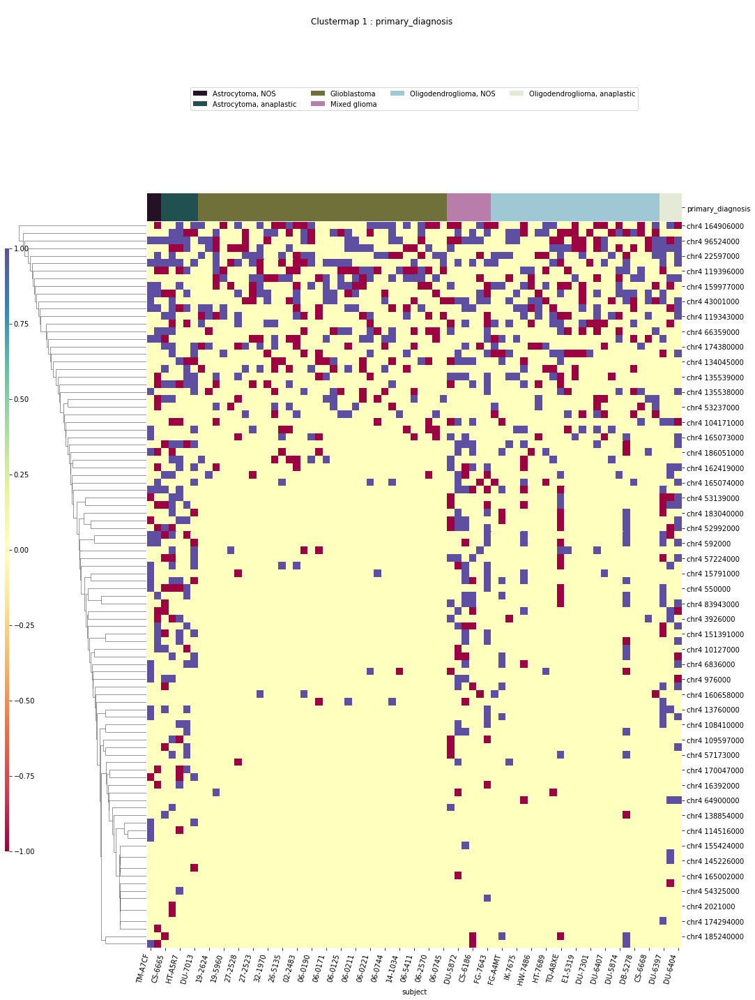

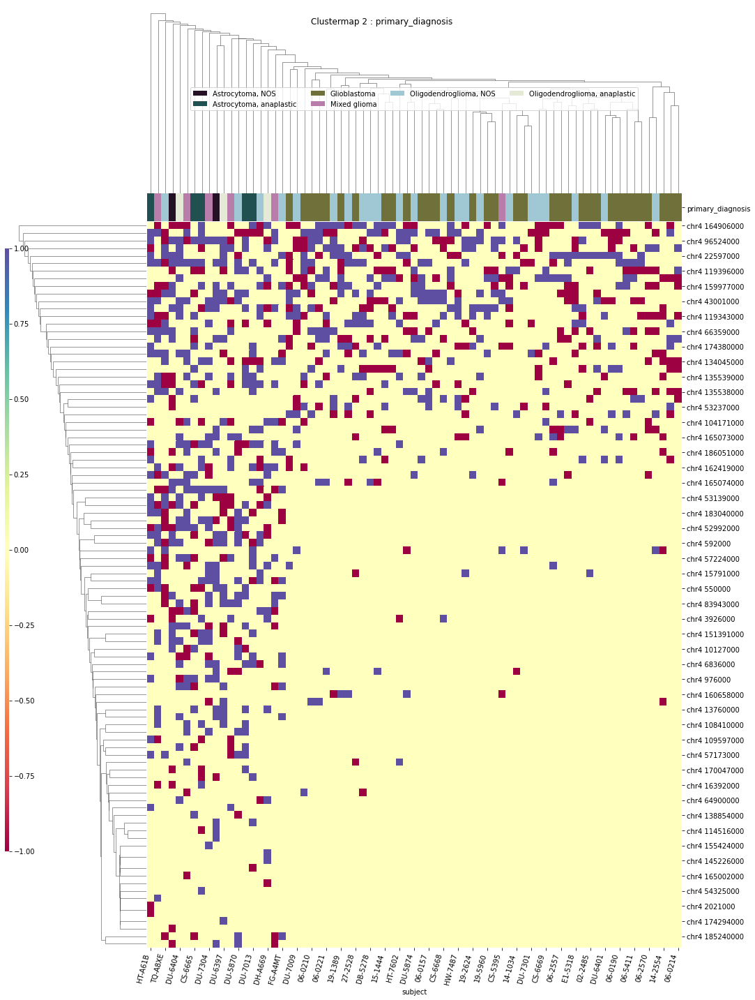

IDH
['IDH' 'chr4 162419000' 'chr4 170047000' 'chr4 38808000' 'chr4 3883000'
 'chr4 396000' 'chr4 48292000' 'chr4 57224000' 'chr4 76423000'
 'chr4 976000' 'subject']


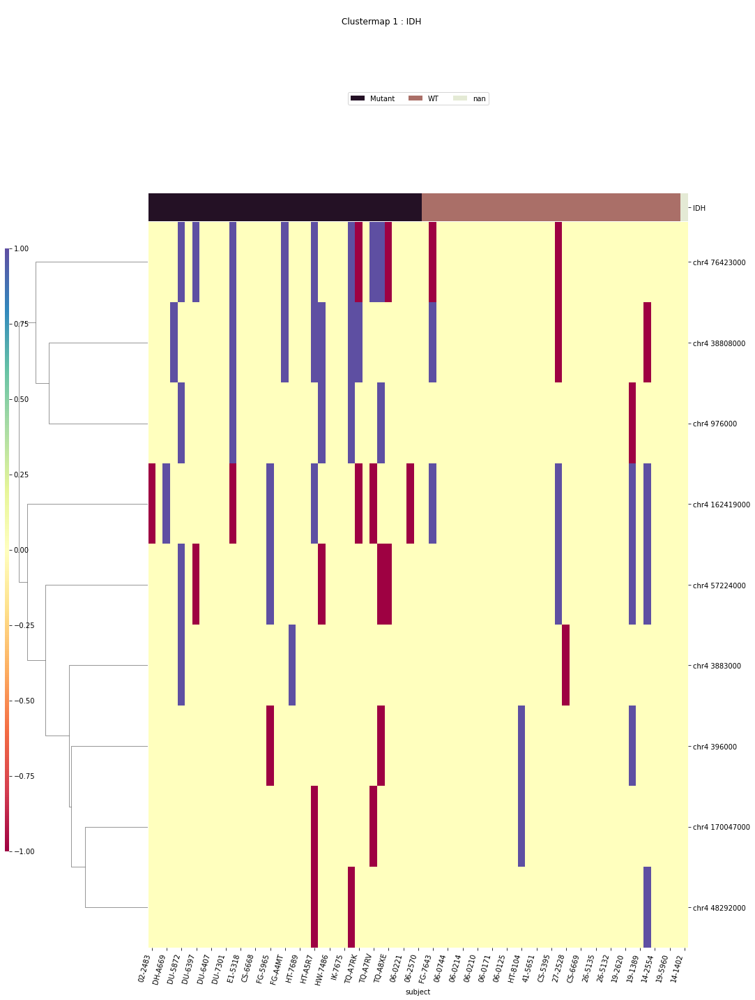

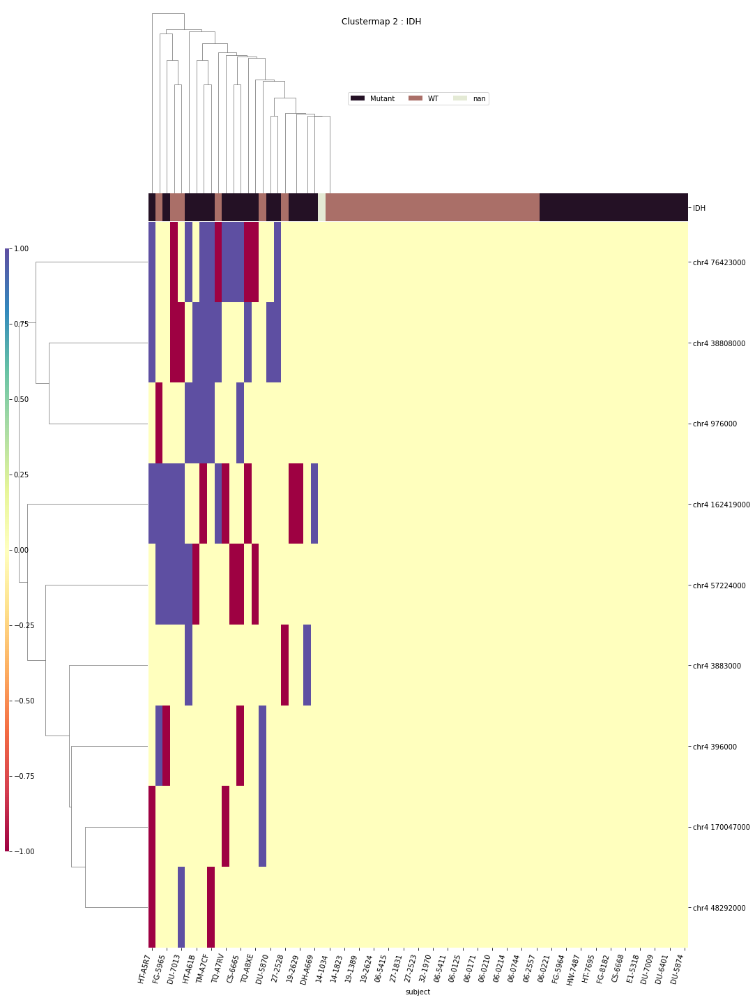

x1p19q
['chr4 104171000' 'chr4 108435000' 'chr4 110275000' 'chr4 138854000'
 'chr4 145226000' 'chr4 159977000' 'chr4 174294000' 'chr4 186050000'
 'chr4 3926000' 'chr4 4120000' 'chr4 53139000' 'chr4 56693000'
 'chr4 68282000' 'chr4 69762000' 'chr4 9601000' 'chr4 96524000' 'subject'
 'x1p19q']


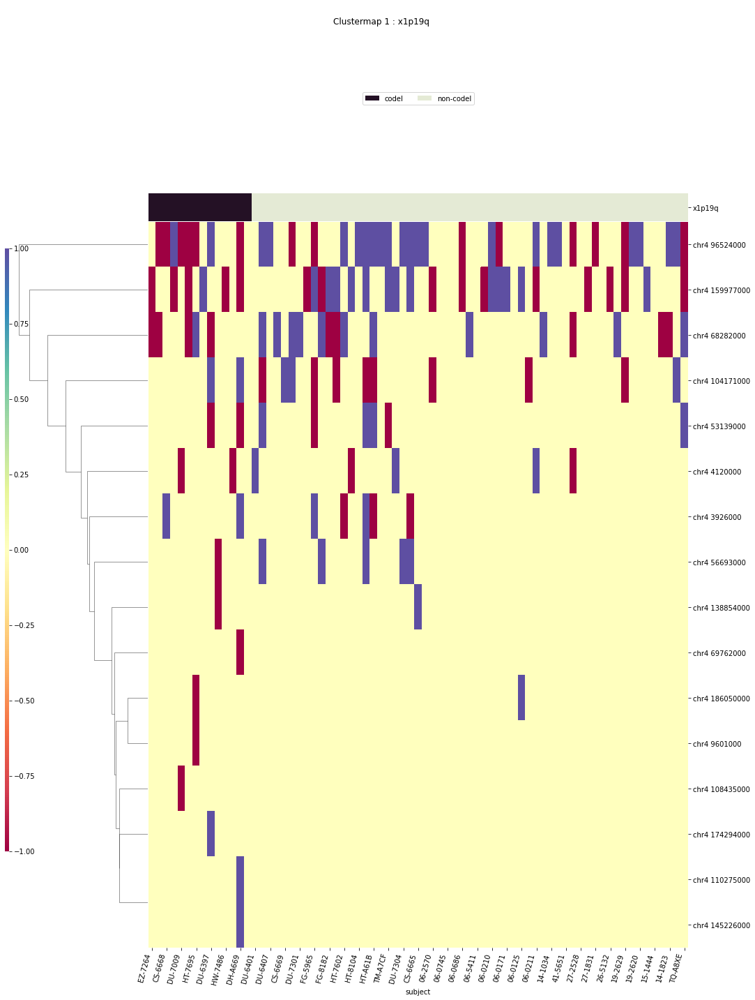

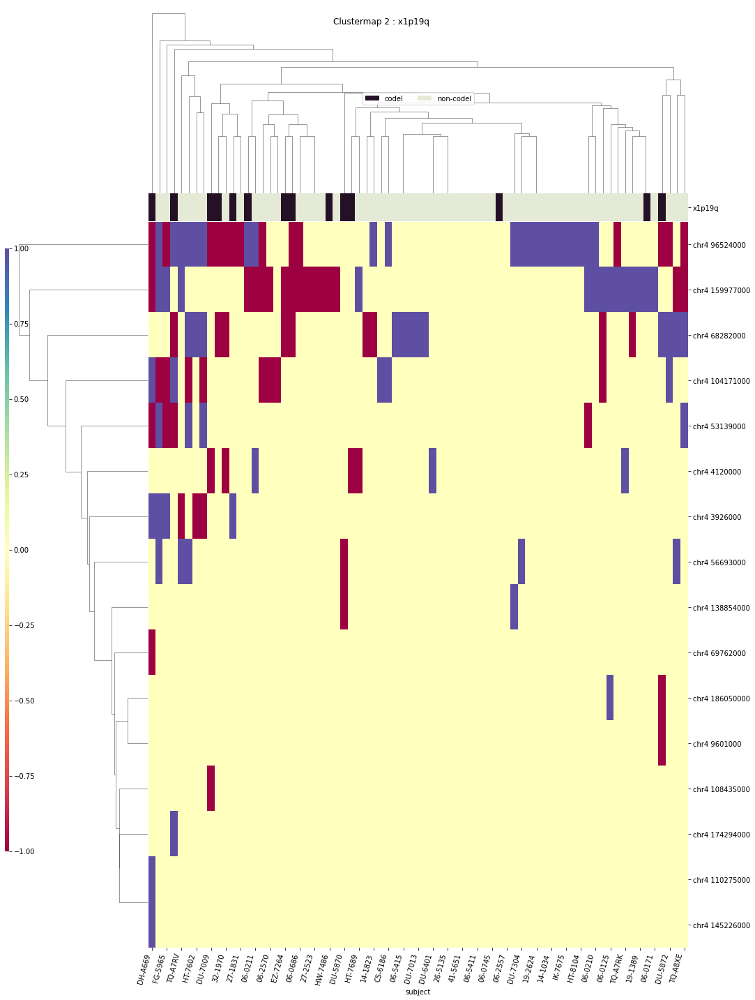

TERT
['TERT' 'chr4 104171000' 'chr4 112957000' 'chr4 15791000' 'chr4 158746000'
 'chr4 159977000' 'chr4 164906000' 'chr4 170047000' 'chr4 174380000'
 'chr4 179553000' 'chr4 188068000' 'chr4 22598000' 'chr4 38808000'
 'chr4 3883000' 'chr4 48292000' 'chr4 550000' 'chr4 56693000'
 'chr4 62940000' 'chr4 66359000' 'chr4 68282000' 'chr4 76423000'
 'chr4 976000' 'subject']


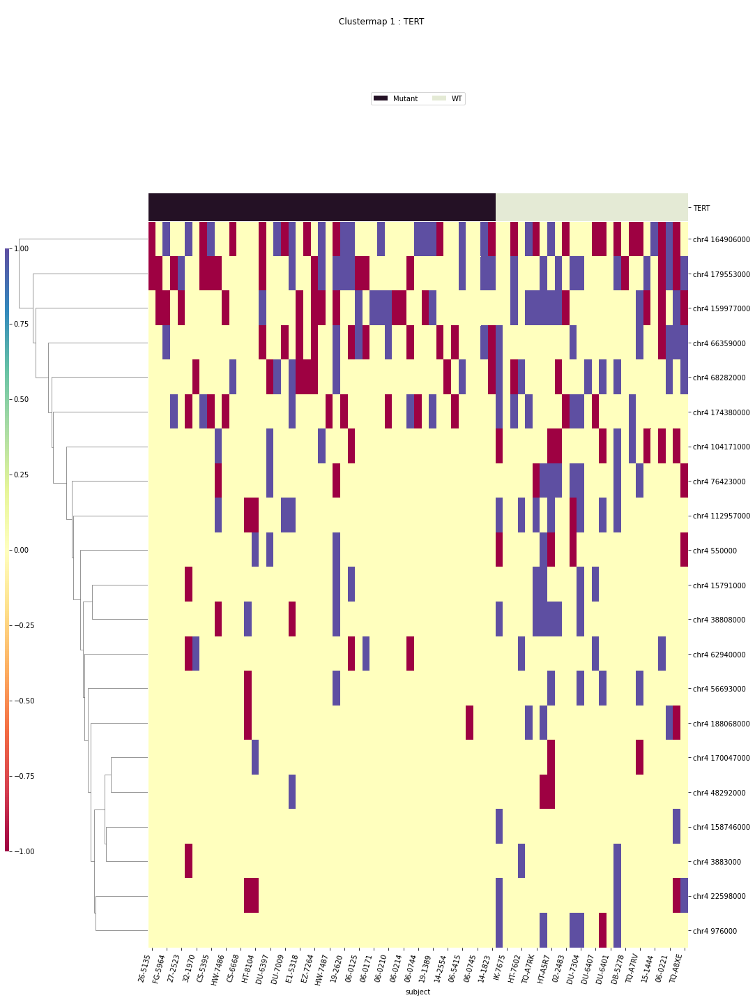

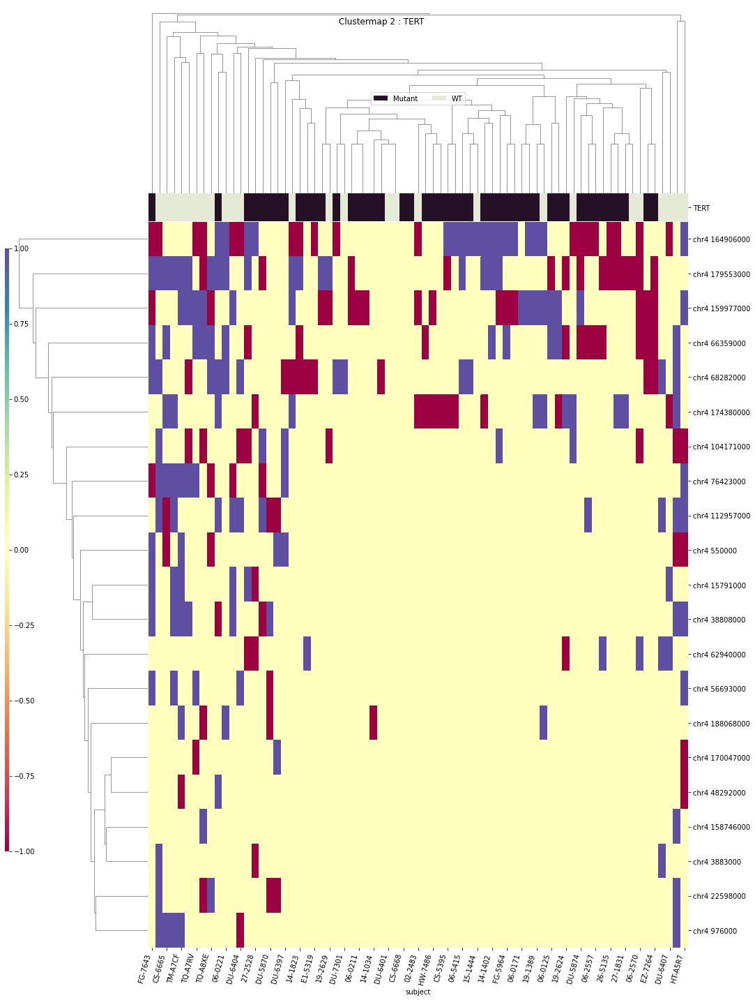

disease_type
['chr4 108410000' 'chr4 112957000' 'chr4 118535000' 'chr4 134045000'
 'chr4 135538000' 'chr4 13760000' 'chr4 150660000' 'chr4 15791000'
 'chr4 160661000' 'chr4 162419000' 'chr4 174383000' 'chr4 174400000'
 'chr4 174692000' 'chr4 38808000' 'chr4 3883000' 'chr4 41049000'
 'chr4 6836000' 'chr4 72129000' 'disease_type' 'subject']


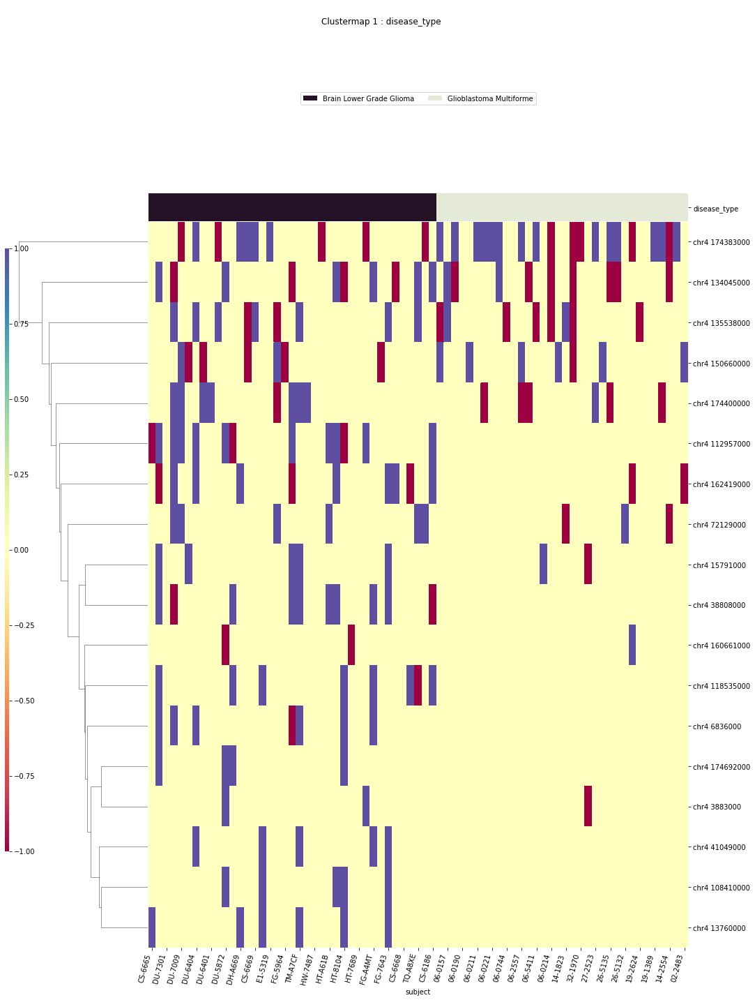

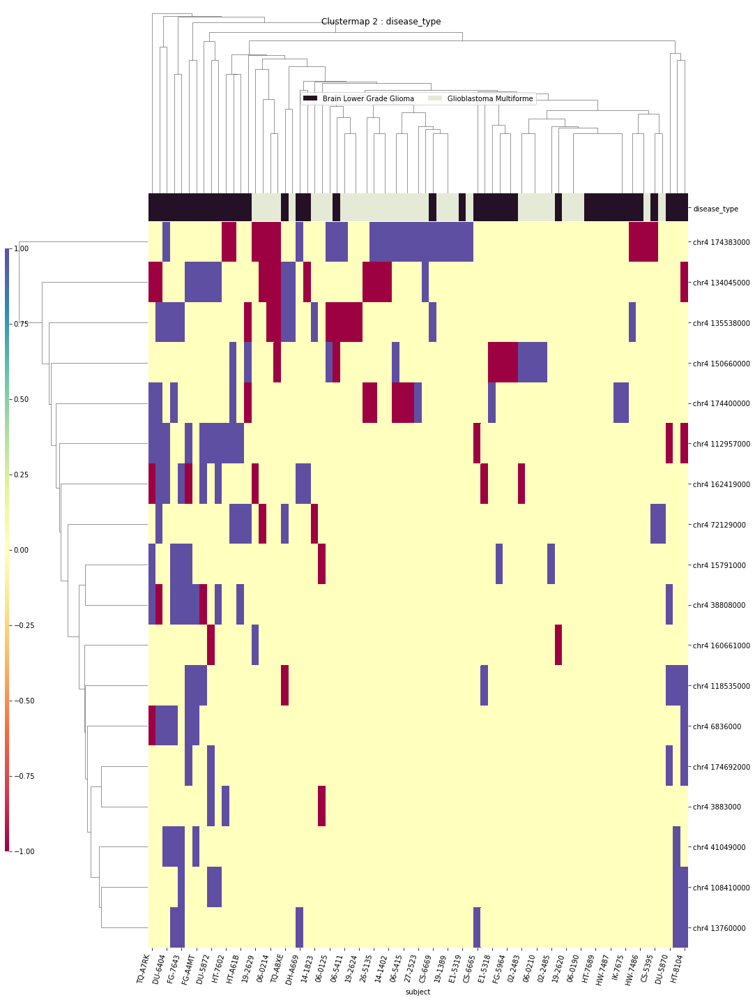

chr4_GL000008v2_random
HERVK113
primary_diagnosis
['primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chr5
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr5 80943000


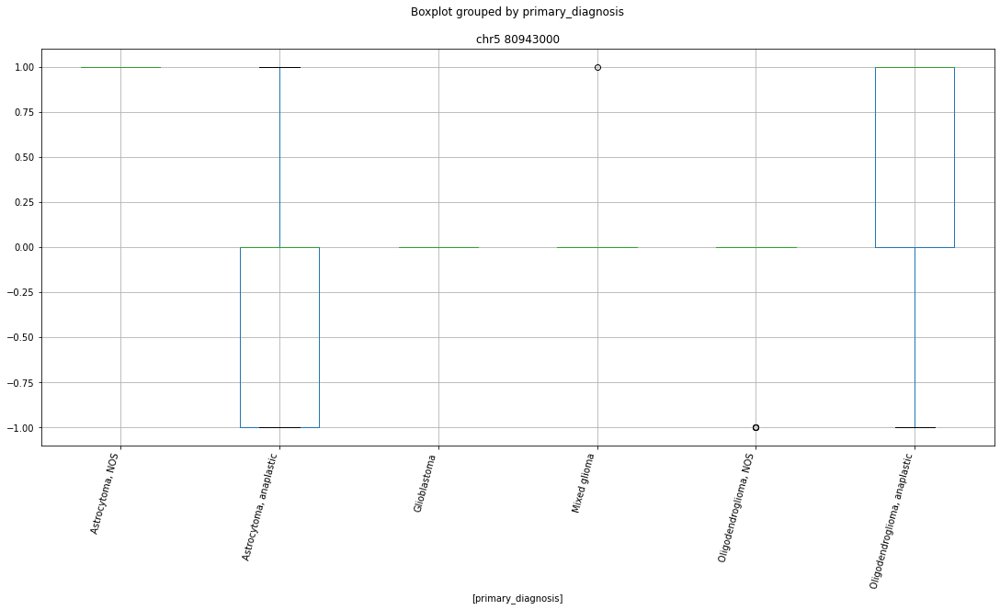

 p : 0.0  ( t : inf ) :  chr5 46009000


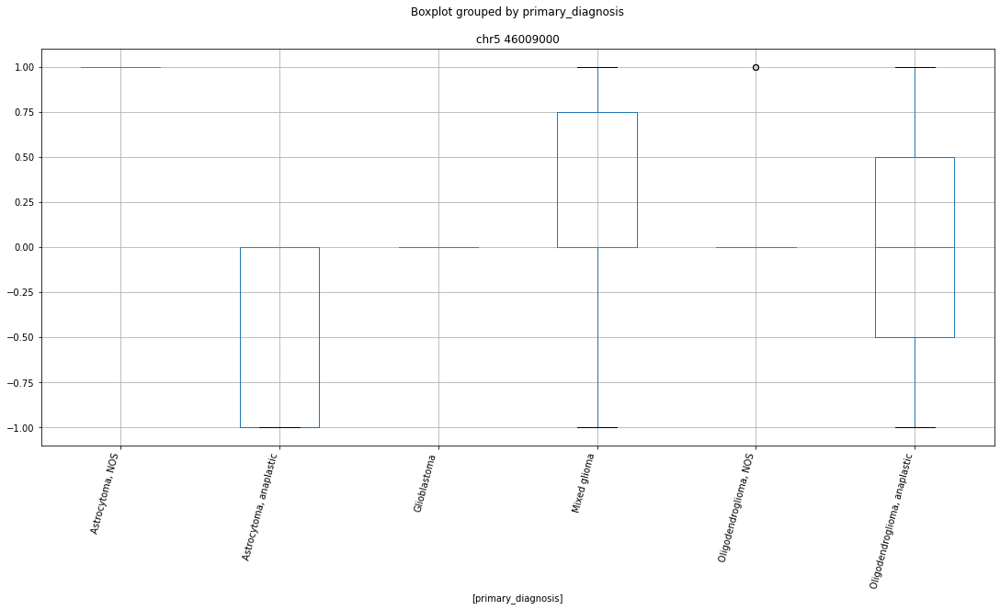

 p : 0.0  ( t : inf ) :  chr5 151427000


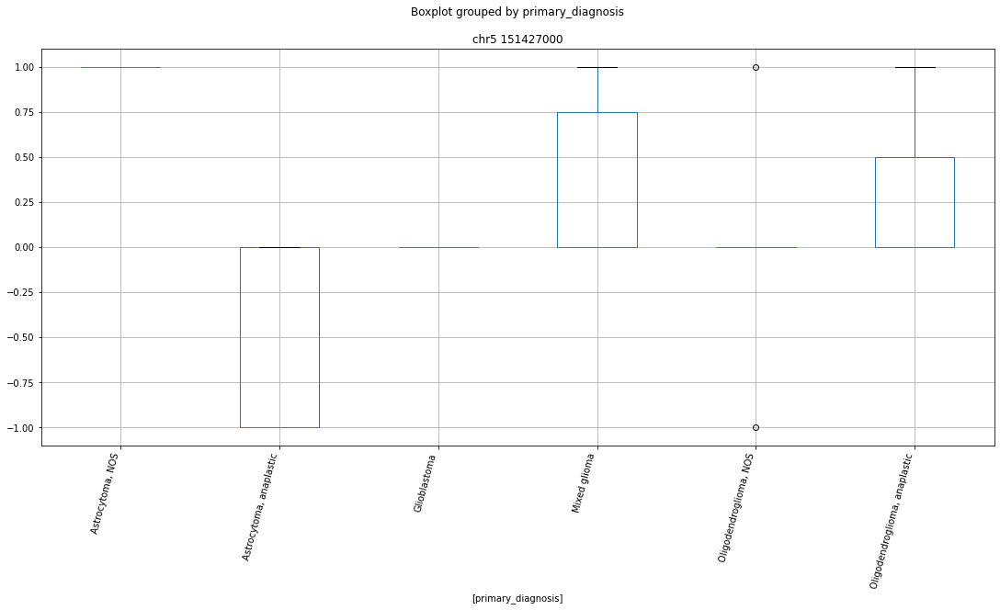

 p : 0.0  ( t : inf ) :  chr5 39273000


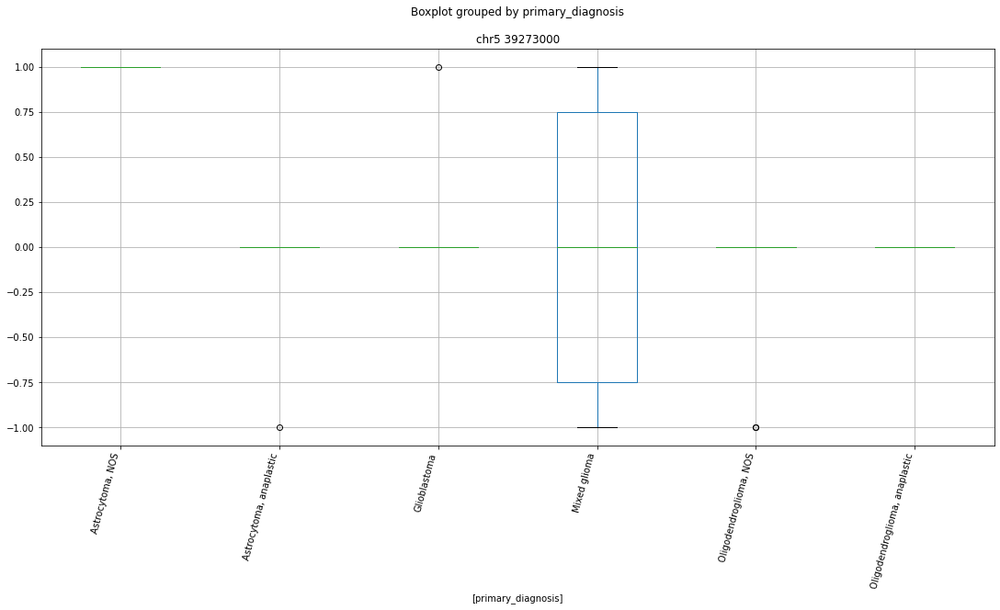

 p : 0.0  ( t : inf ) :  chr5 75271000


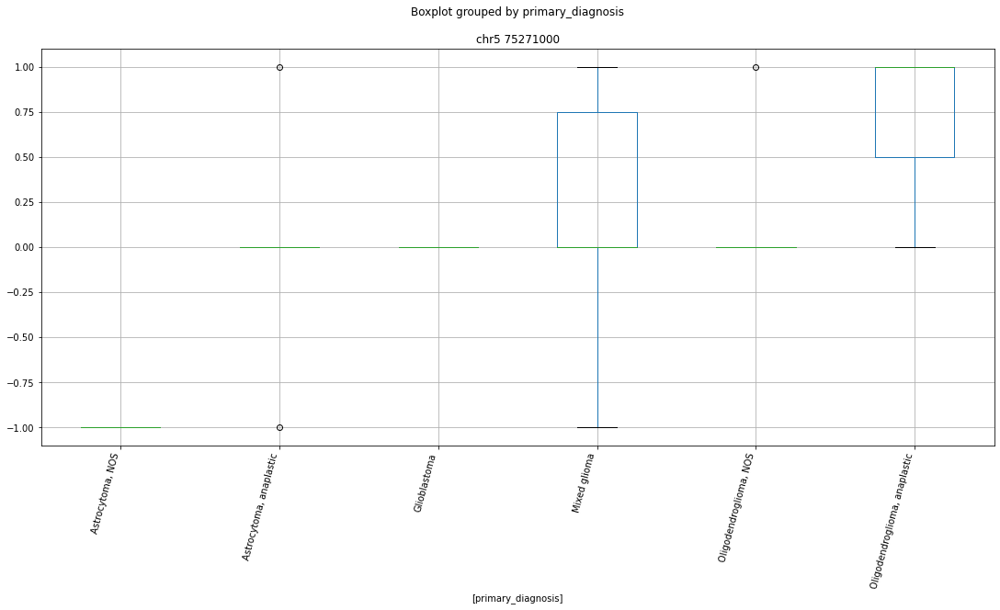

 p : 0.0  ( t : inf ) :  chr5 60430000


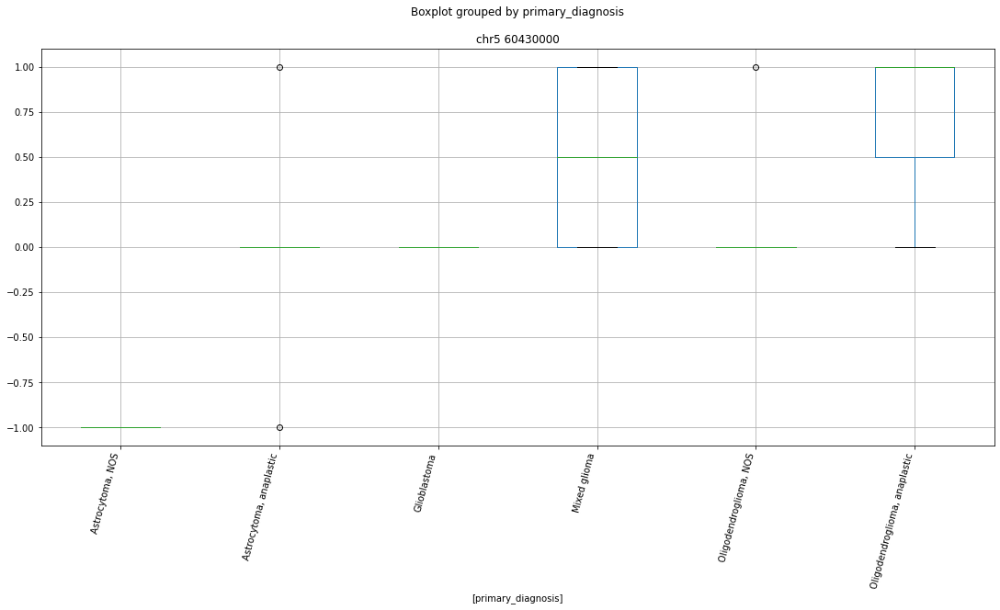

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr5 179650000


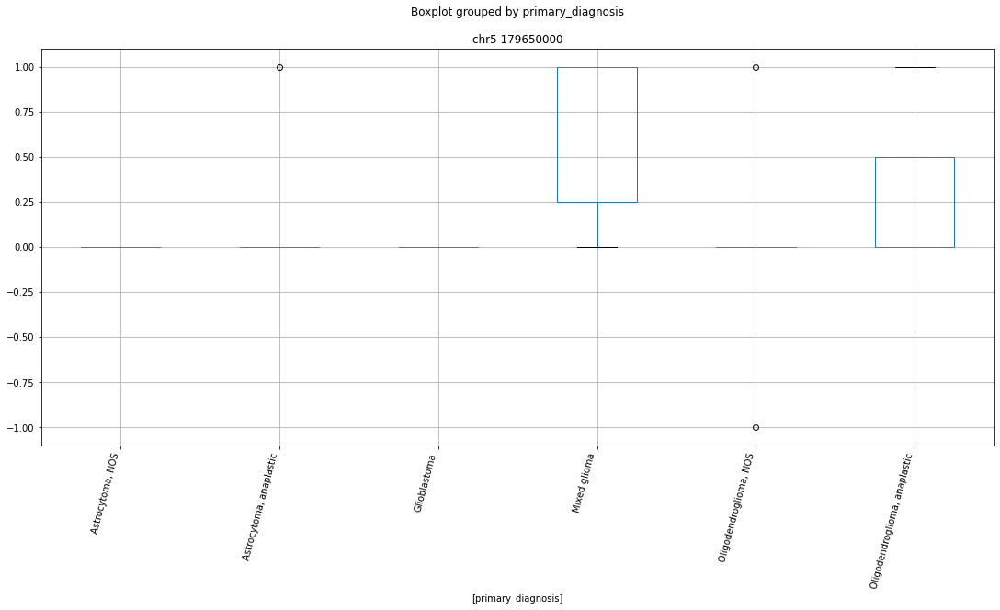

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr5 37012000


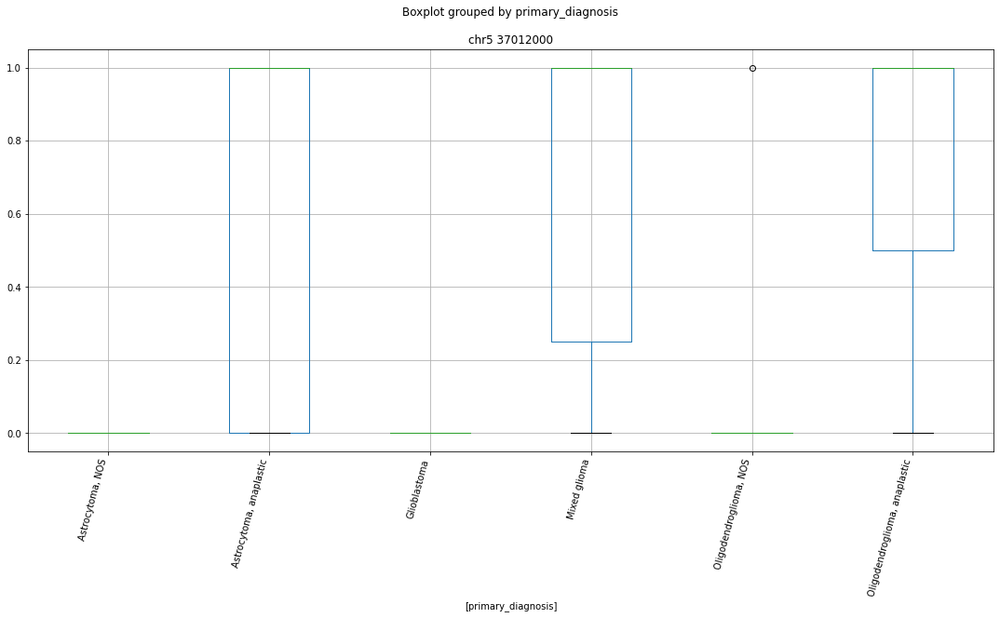

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr5 149669000


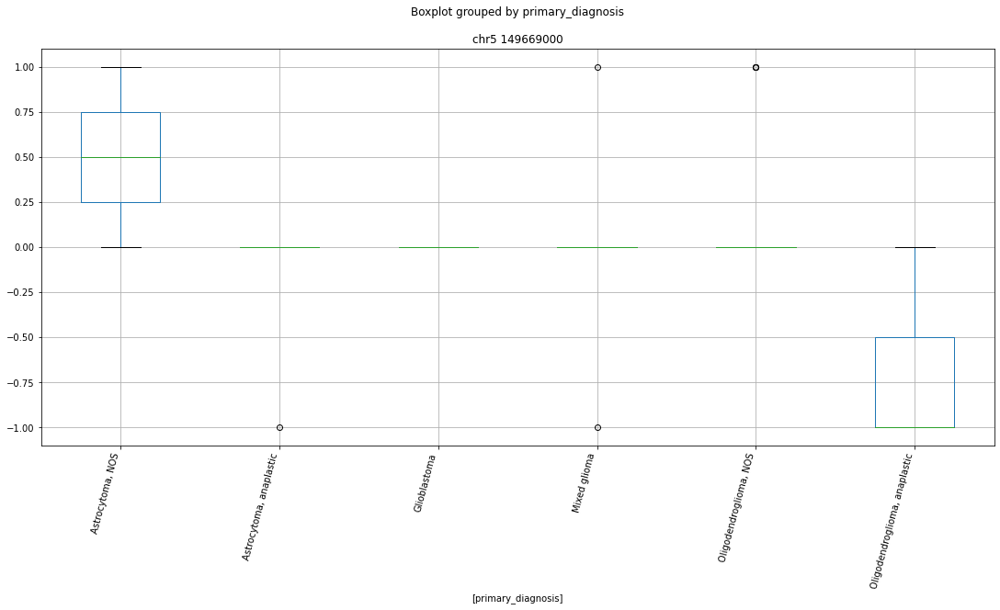

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr5 132982000


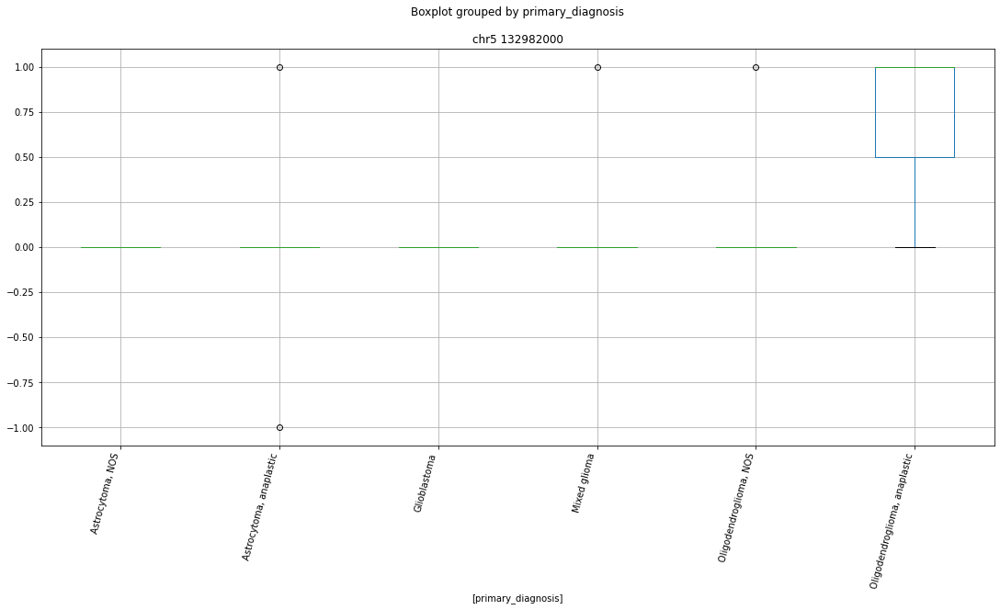

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr5 138070000


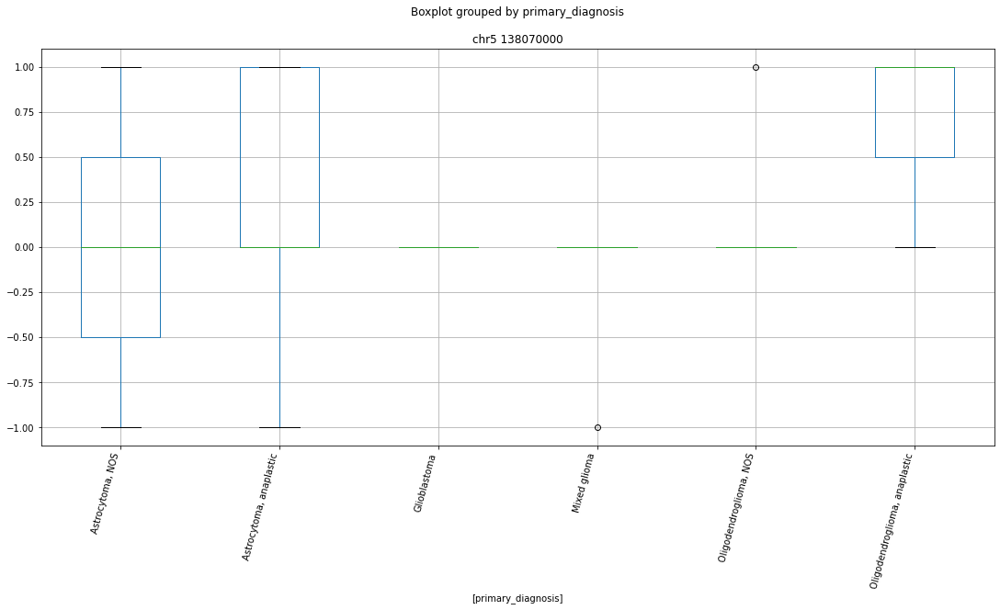

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr5 106260000


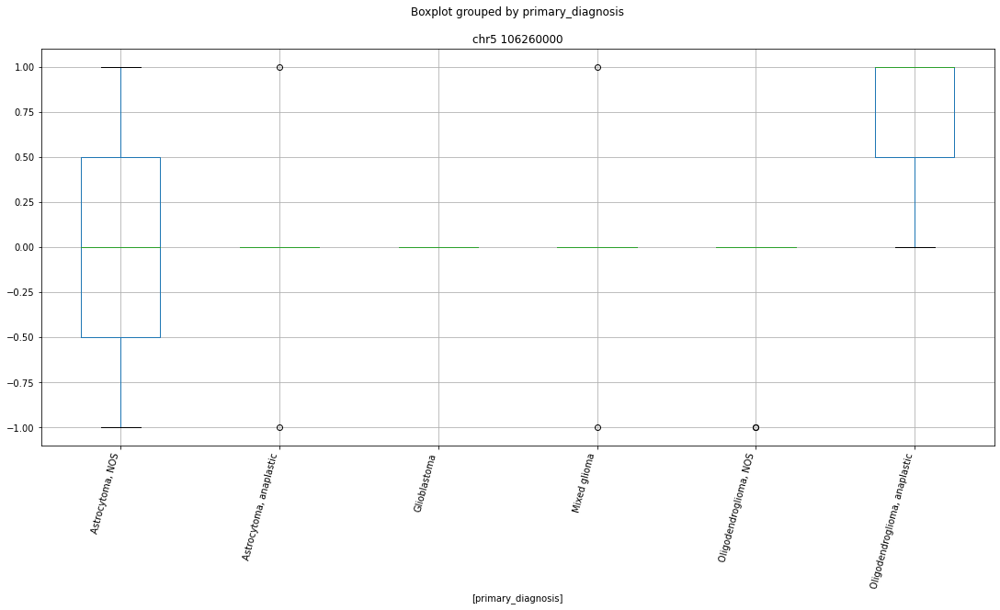

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr5 56373000


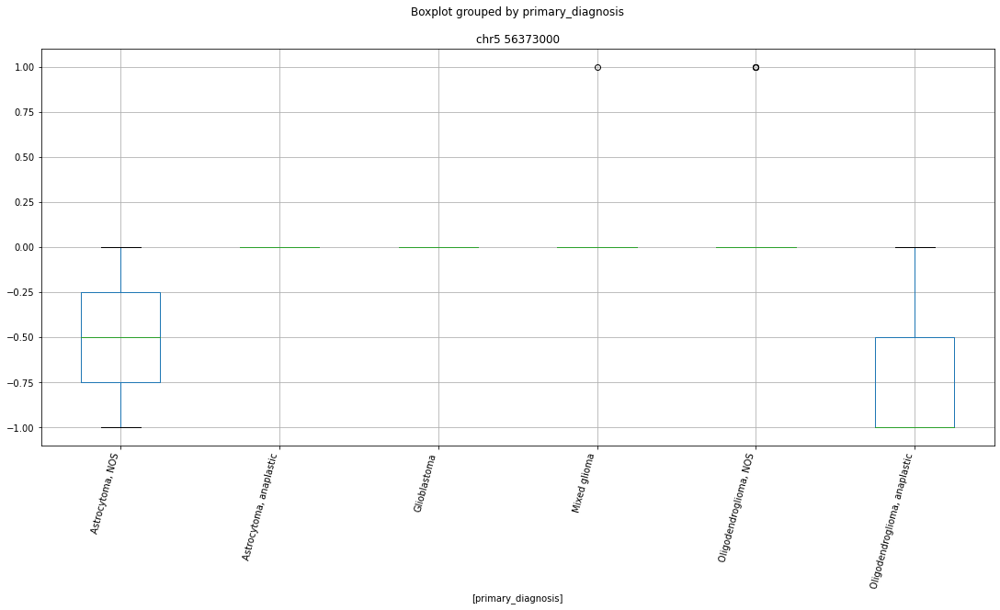

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr5 65976000


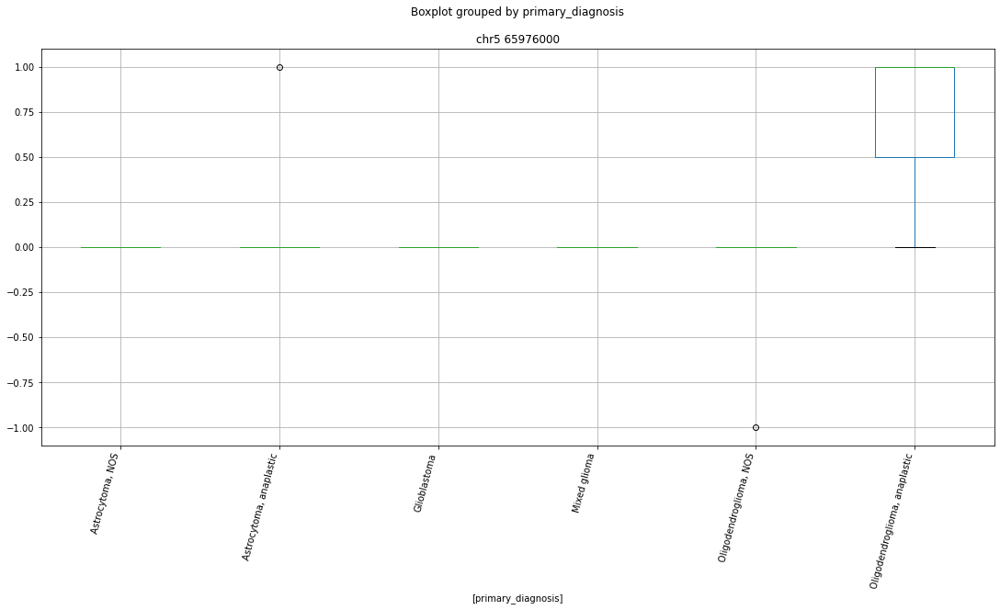

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr5 75271000


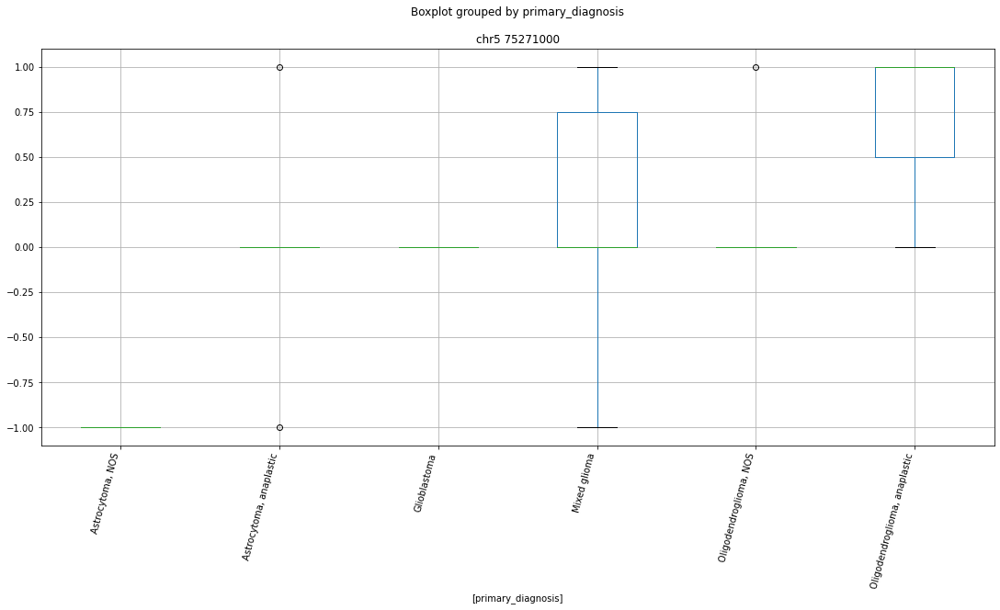

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr5 68323000


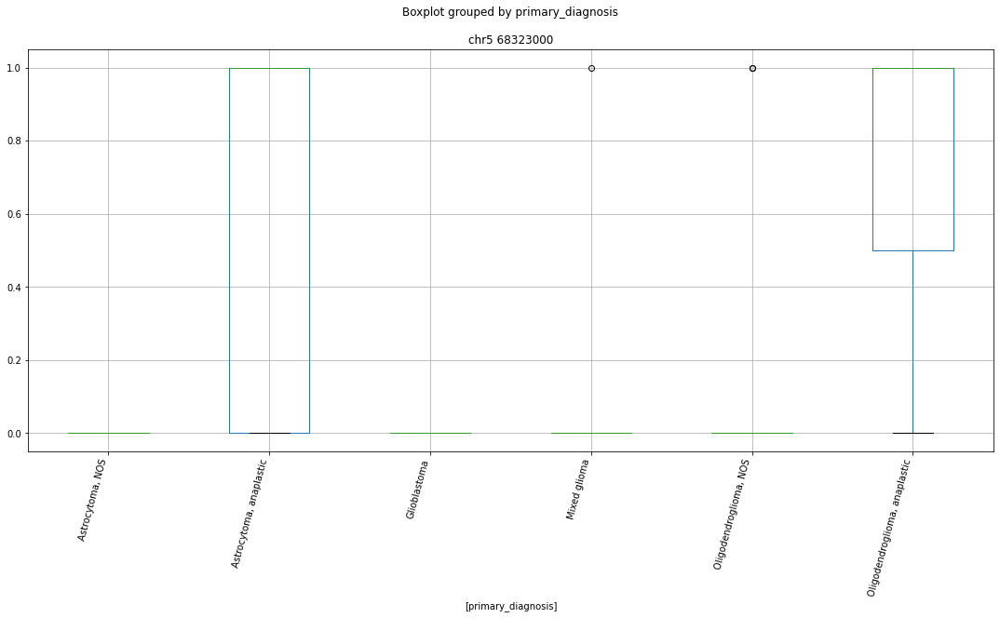

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr5 60430000


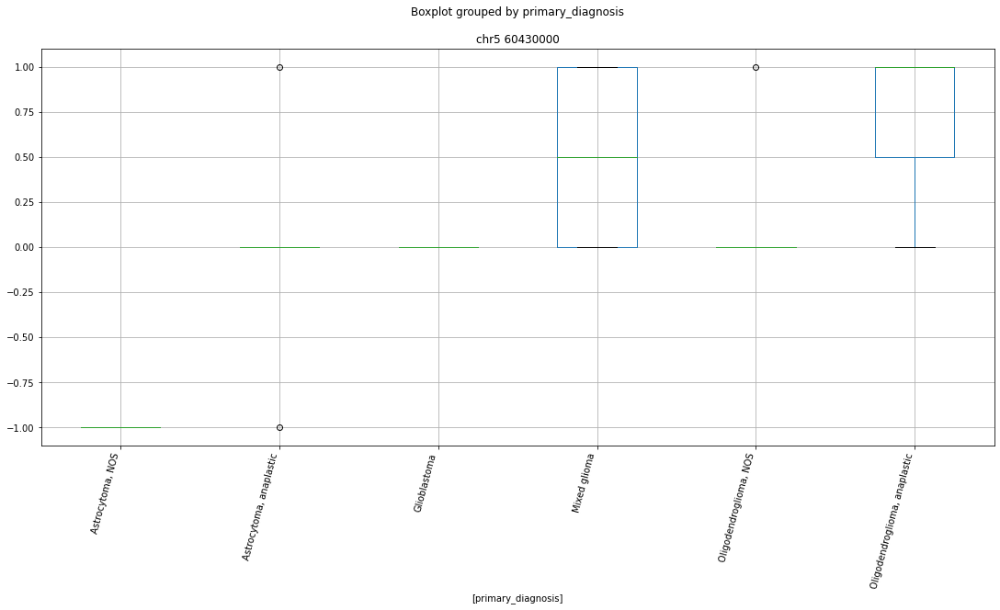

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr5 56156000


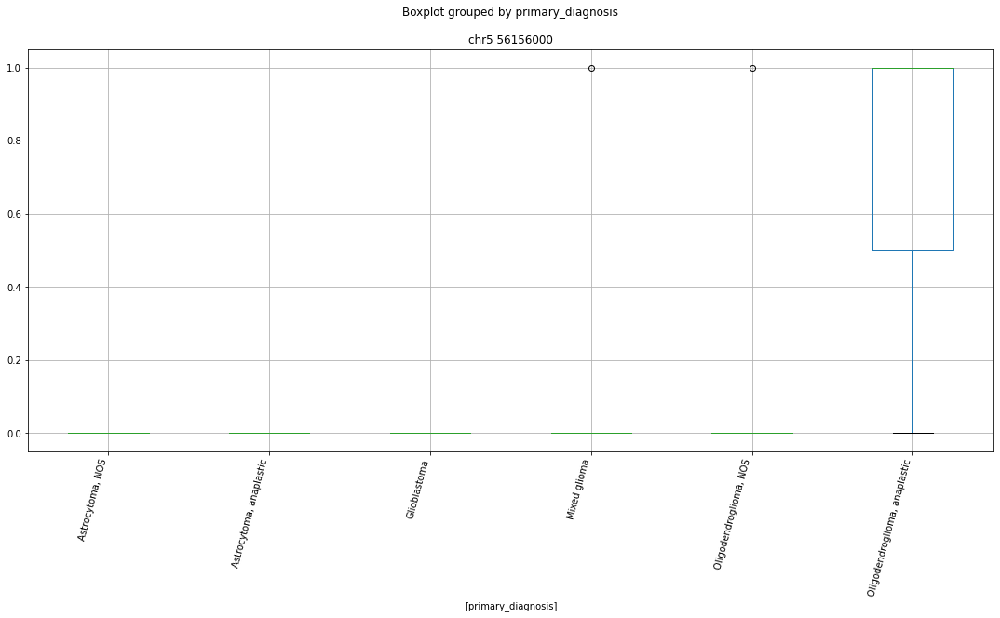

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr5 43058000


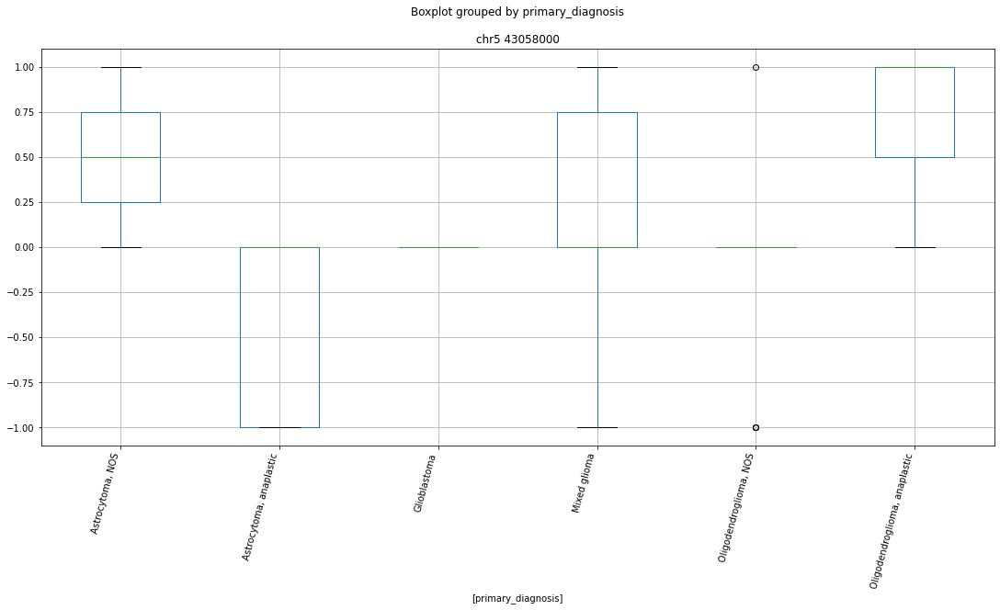

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr5 37012000


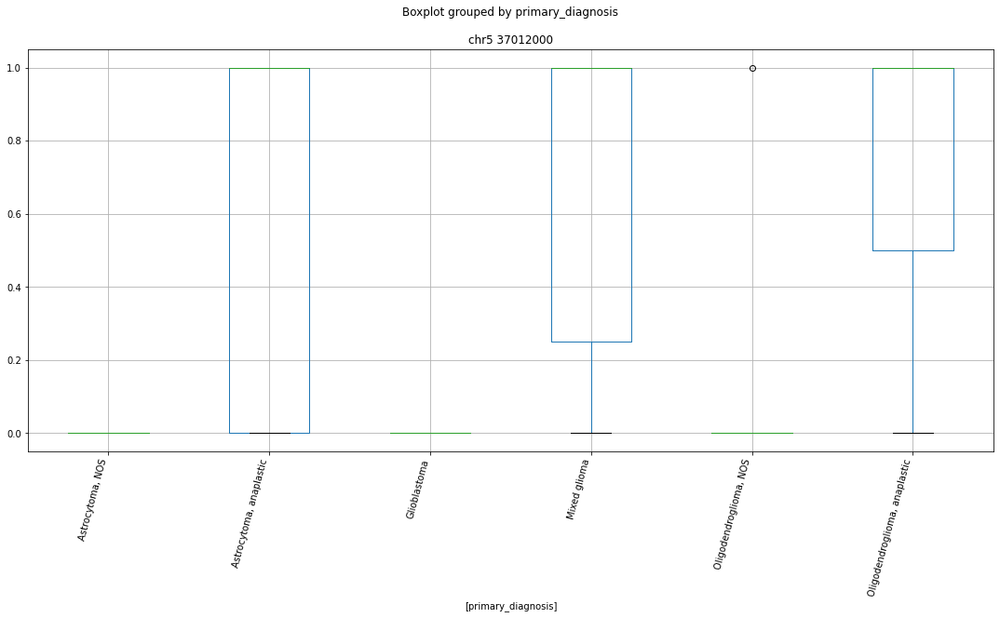

 p : 3.4049793131136327e-09  ( t : 7.895146188218008 ) :  chr5 39273000


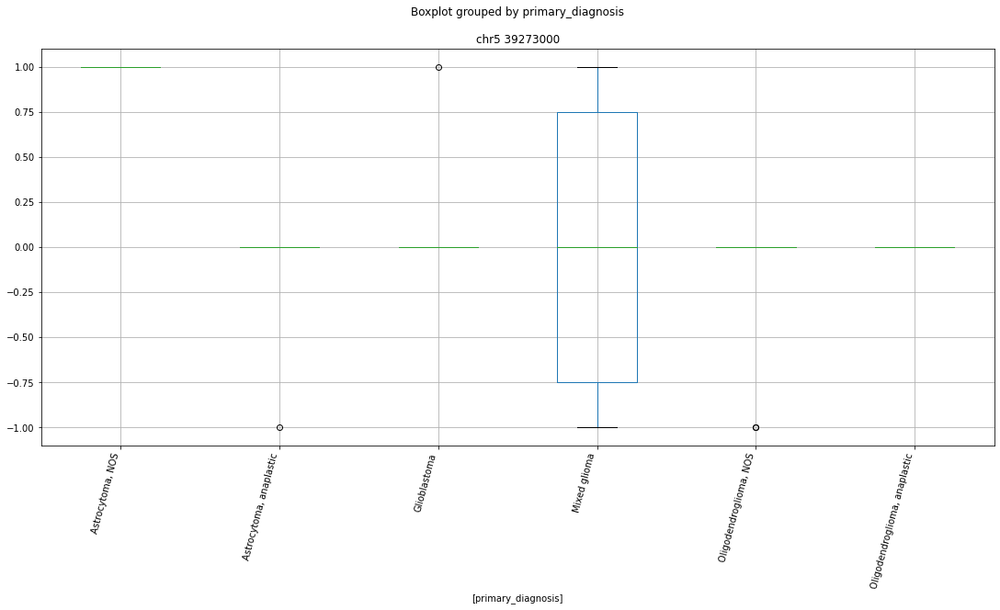

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr5 108558000


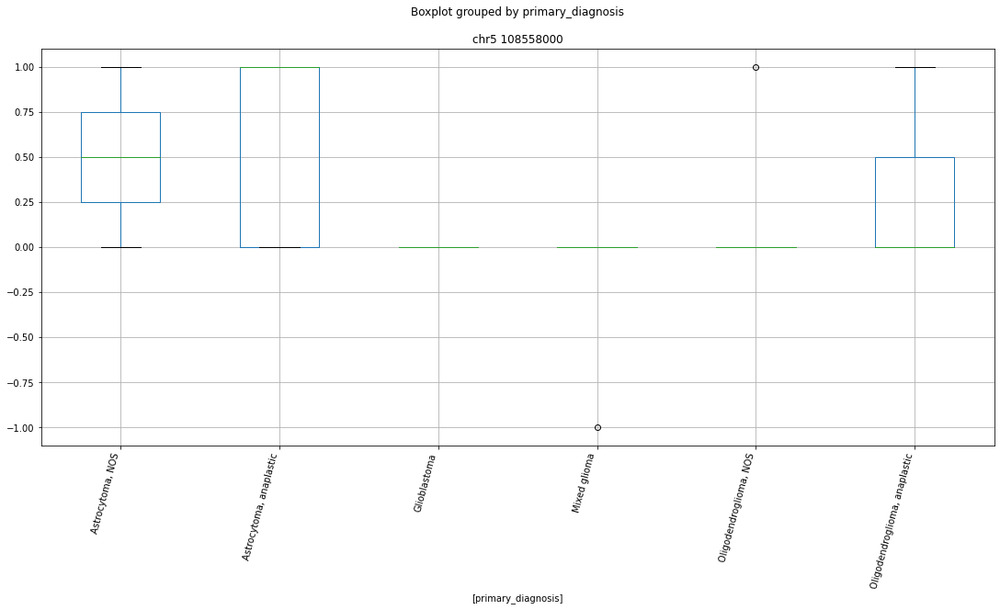

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr5 151427000


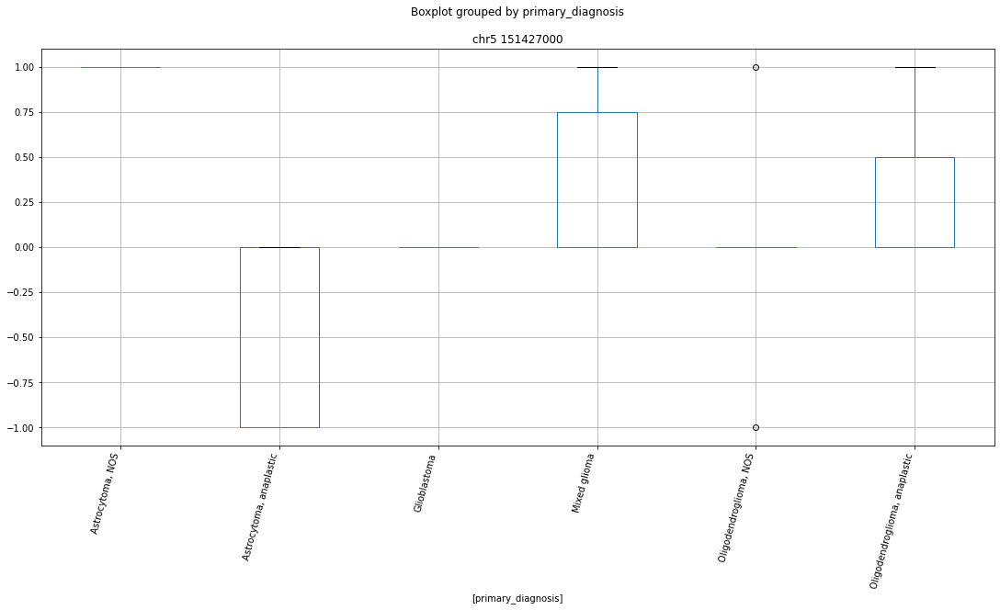

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr5 37012000


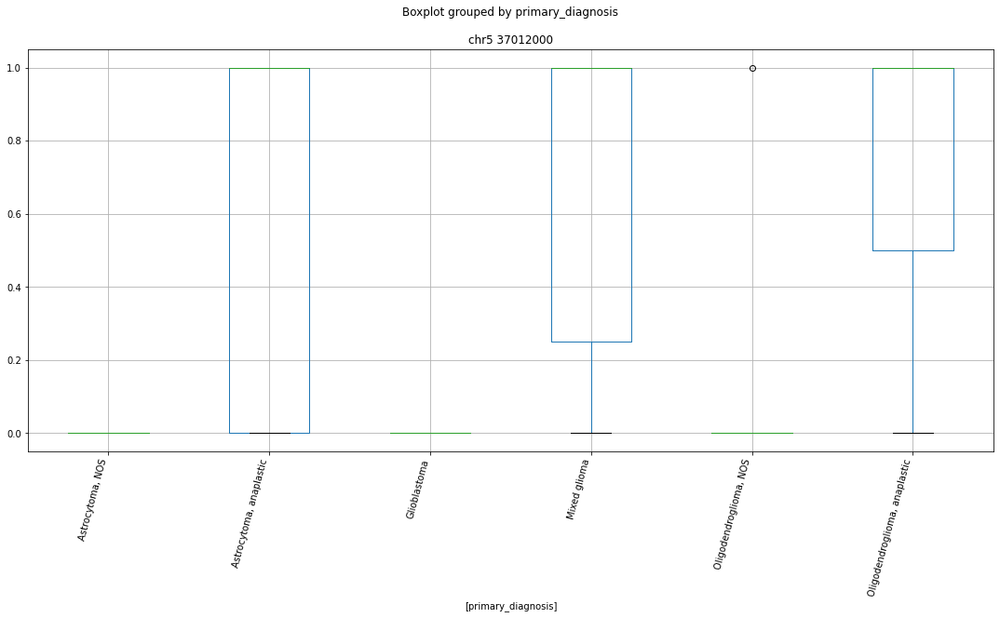

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr5 68323000


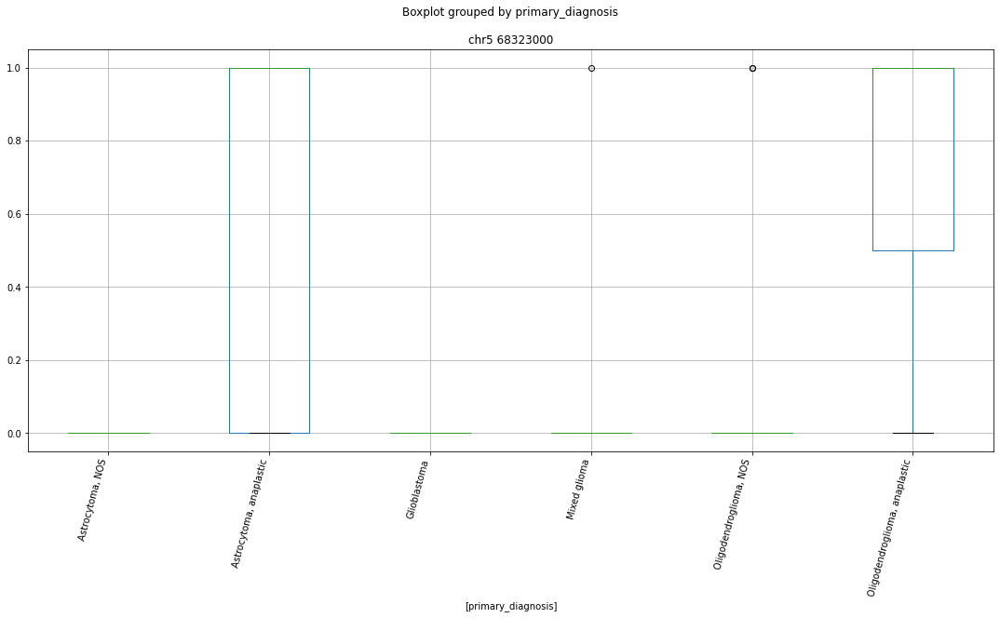

['chr5 100607000' 'chr5 101006000' 'chr5 106260000' 'chr5 108558000'
 'chr5 112361000' 'chr5 115449000' 'chr5 115690000' 'chr5 117002000'
 'chr5 119121000' 'chr5 120195000' 'chr5 122913000' 'chr5 132982000'
 'chr5 134881000' 'chr5 137537000' 'chr5 138070000' 'chr5 138810000'
 'chr5 139056000' 'chr5 149669000' 'chr5 150991000' 'chr5 151427000'
 'chr5 153296000' 'chr5 1567000' 'chr5 157034000' 'chr5 158036000'
 'chr5 162371000' 'chr5 169997000' 'chr5 171403000' 'chr5 176252000'
 'chr5 177559000' 'chr5 178798000' 'chr5 178799000' 'chr5 179650000'
 'chr5 180771000' 'chr5 180827000' 'chr5 18579000' 'chr5 196000'
 'chr5 24466000' 'chr5 37012000' 'chr5 37296000' 'chr5 37415000'
 'chr5 37483000' 'chr5 37562000' 'chr5 39273000' 'chr5 39334000'
 'chr5 40723000' 'chr5 40801000' 'chr5 42980000' 'chr5 43058000'
 'chr5 43059000' 'chr5 43078000' 'chr5 43581000' 'chr5 44730000'
 'chr5 46000000' 'chr5 46001000' 'chr5 46009000' 'chr5 4925000'
 'chr5 54381000' 'chr5 56038000' 'chr5 56156000' 'chr5 561570

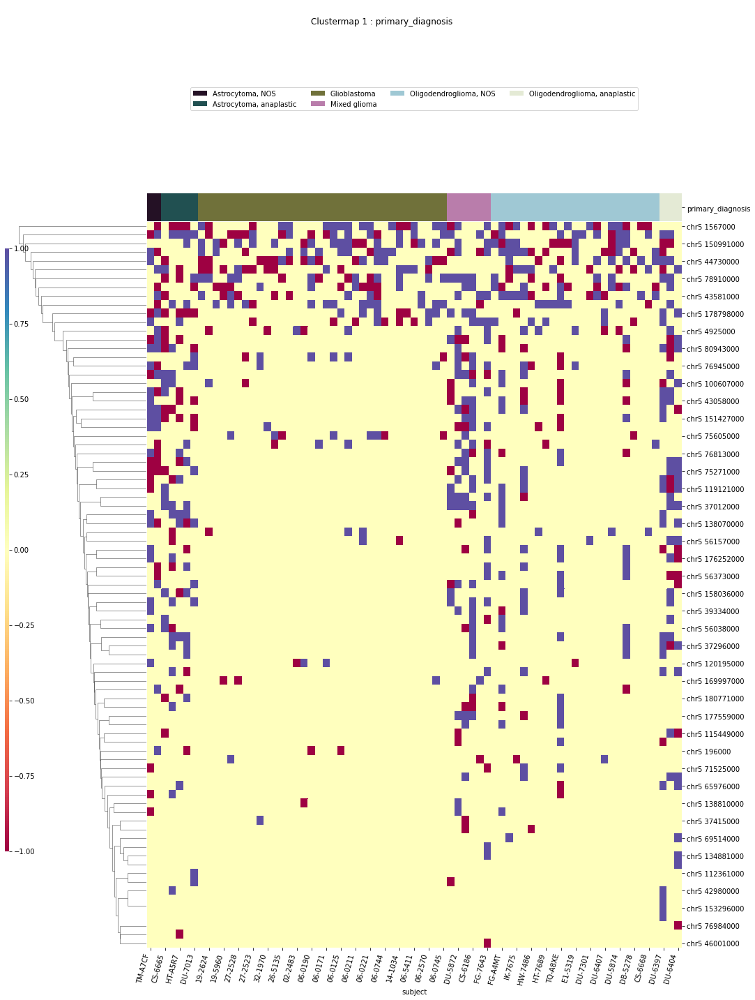

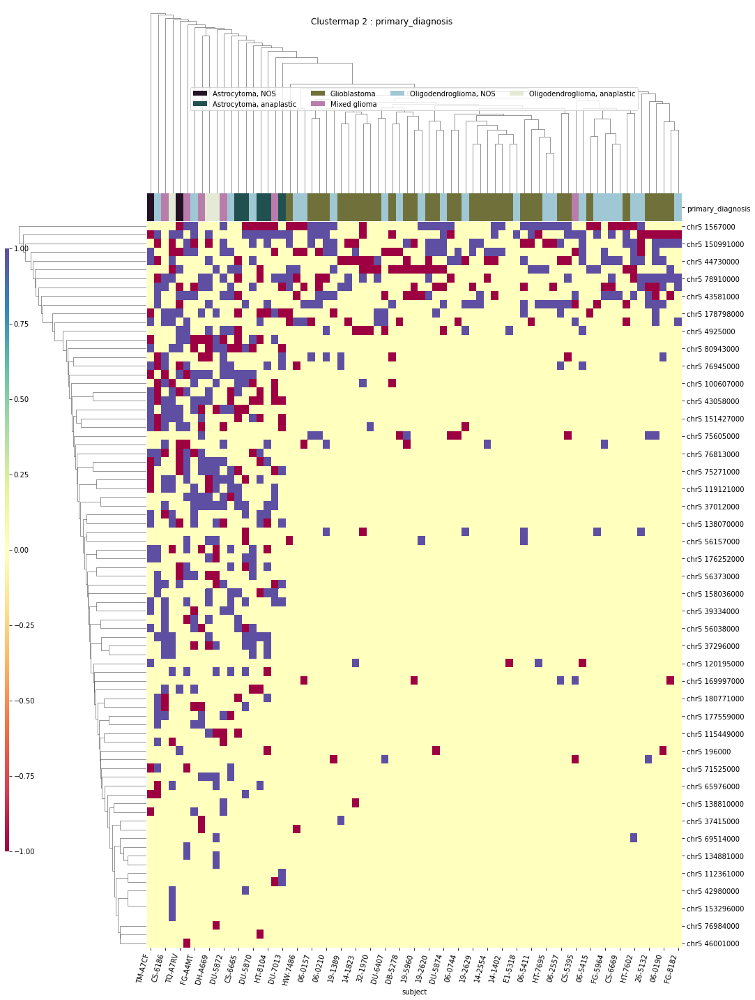

IDH
['IDH' 'chr5 108558000' 'chr5 109832000' 'chr5 176252000' 'chr5 196000'
 'chr5 24466000' 'chr5 43059000' 'chr5 44730000' 'chr5 62513000'
 'chr5 65957000' 'chr5 69062000' 'chr5 75819000' 'chr5 8938000' 'subject']


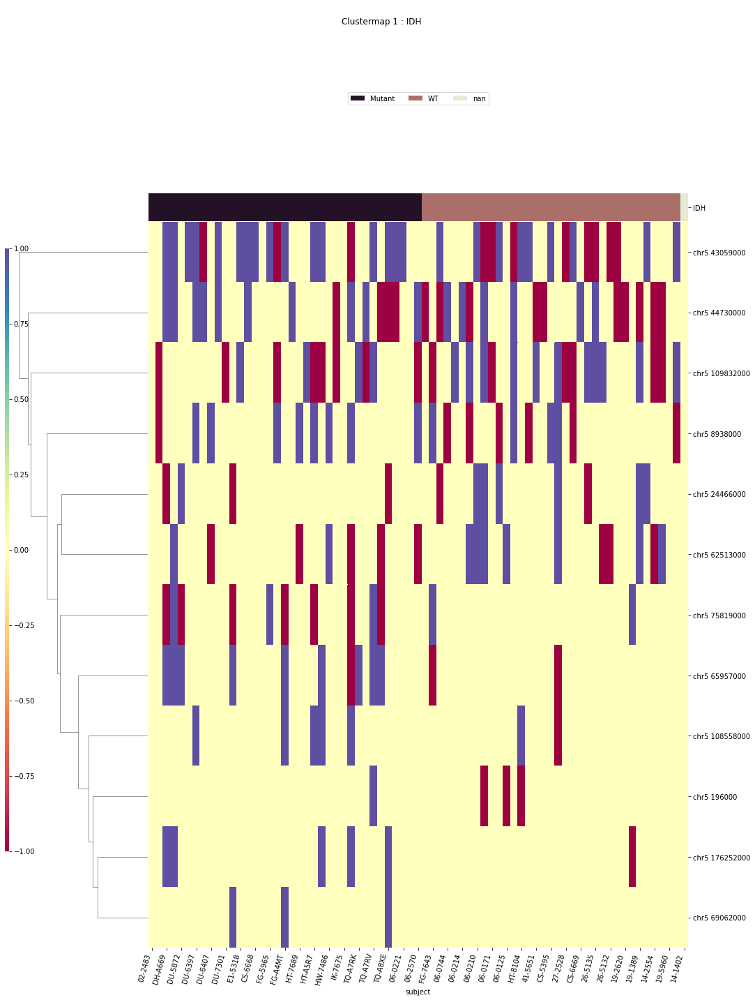

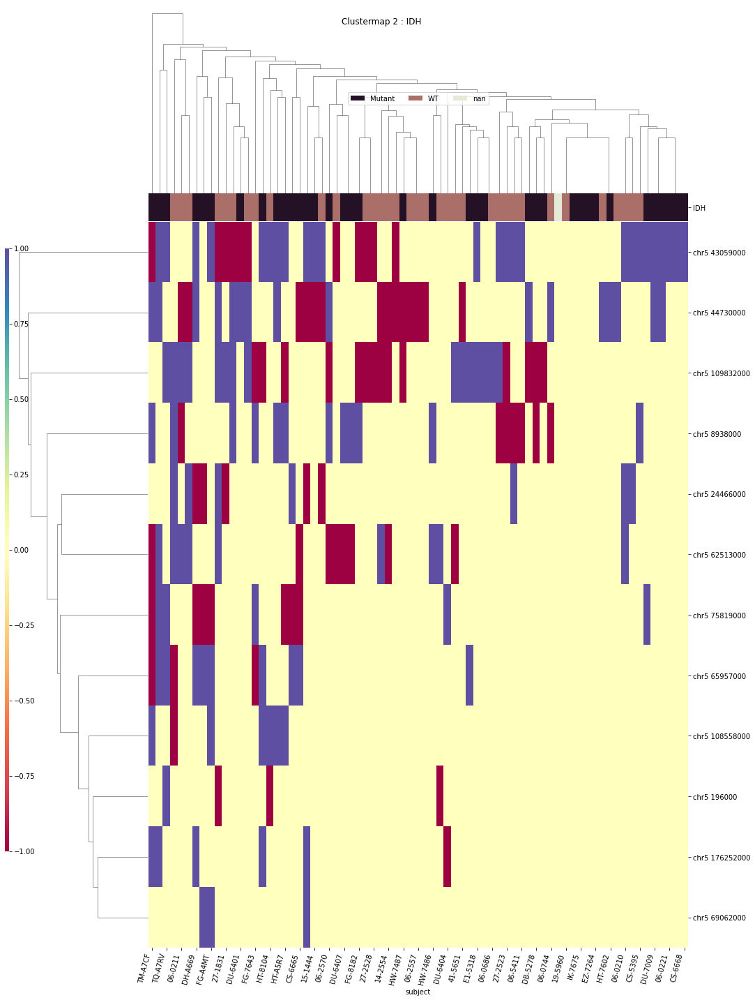

x1p19q
['chr5 100607000' 'chr5 115449000' 'chr5 153296000' 'chr5 176962000'
 'chr5 178057000' 'chr5 28168000' 'chr5 40723000' 'chr5 43059000'
 'chr5 43635000' 'chr5 44730000' 'chr5 76304000' 'subject' 'x1p19q']


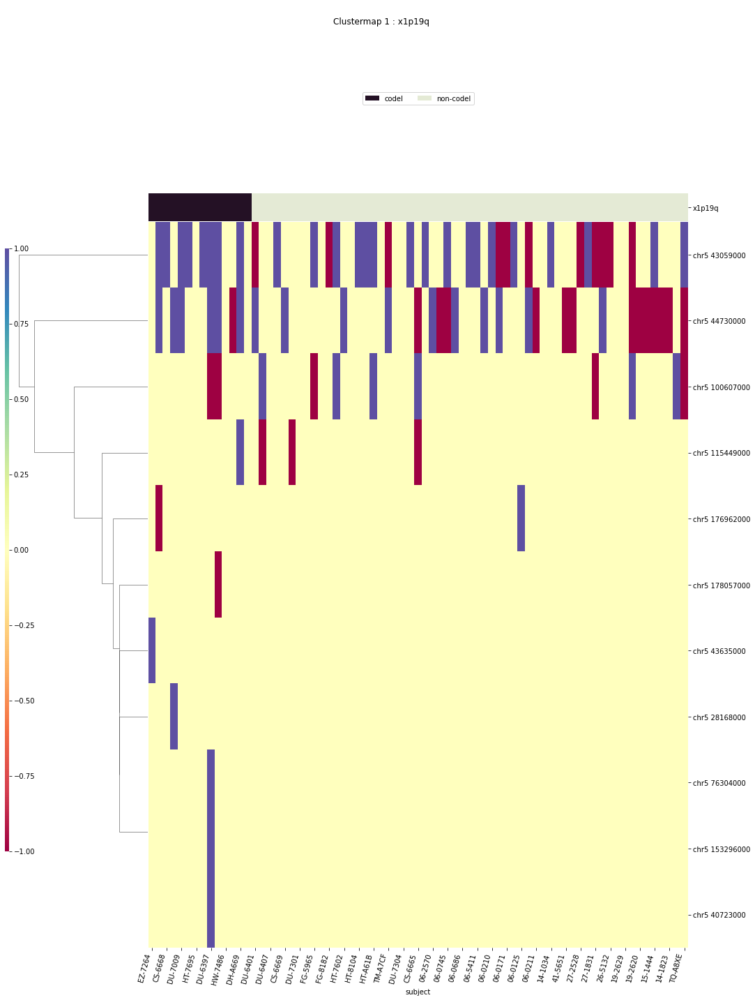

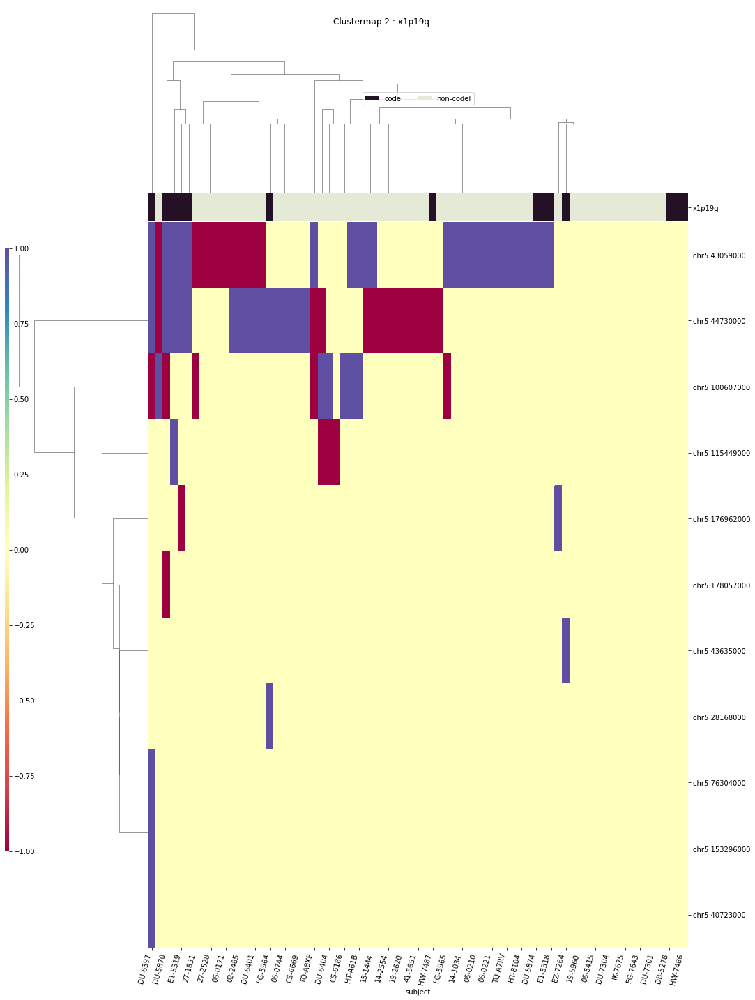

TERT
['TERT' 'chr5 100983000' 'chr5 106260000' 'chr5 108558000'
 'chr5 109832000' 'chr5 115347000' 'chr5 115449000' 'chr5 116821000'
 'chr5 151426000' 'chr5 156666000' 'chr5 196000' 'chr5 37012000'
 'chr5 43580000' 'chr5 56156000' 'chr5 62513000' 'chr5 65957000'
 'chr5 69062000' 'chr5 69514000' 'subject']


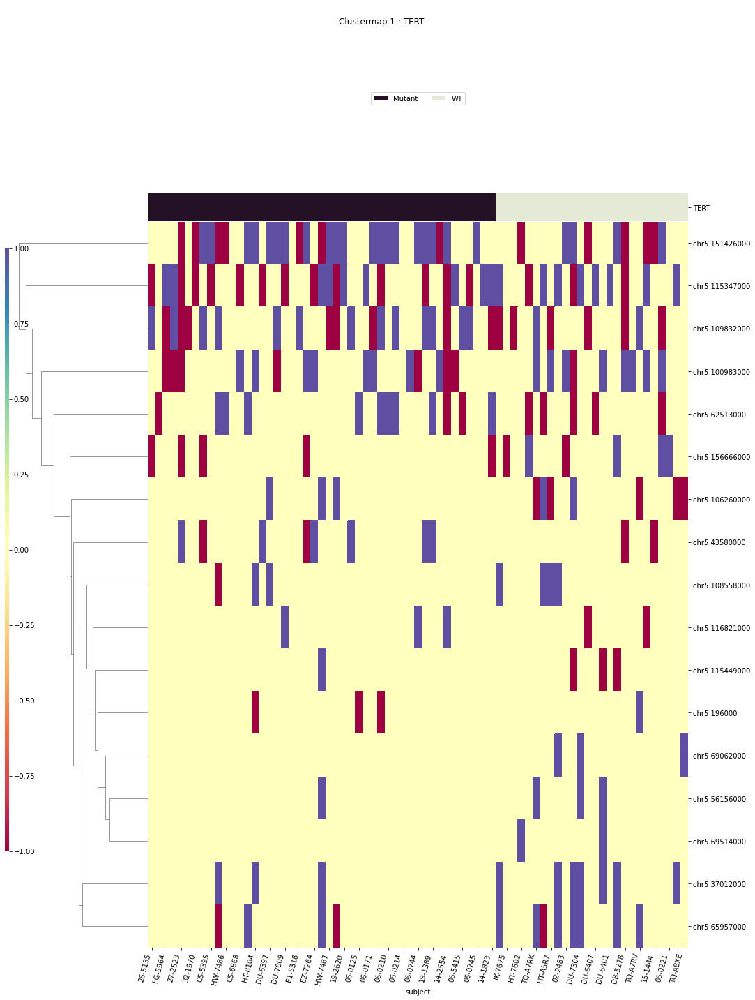

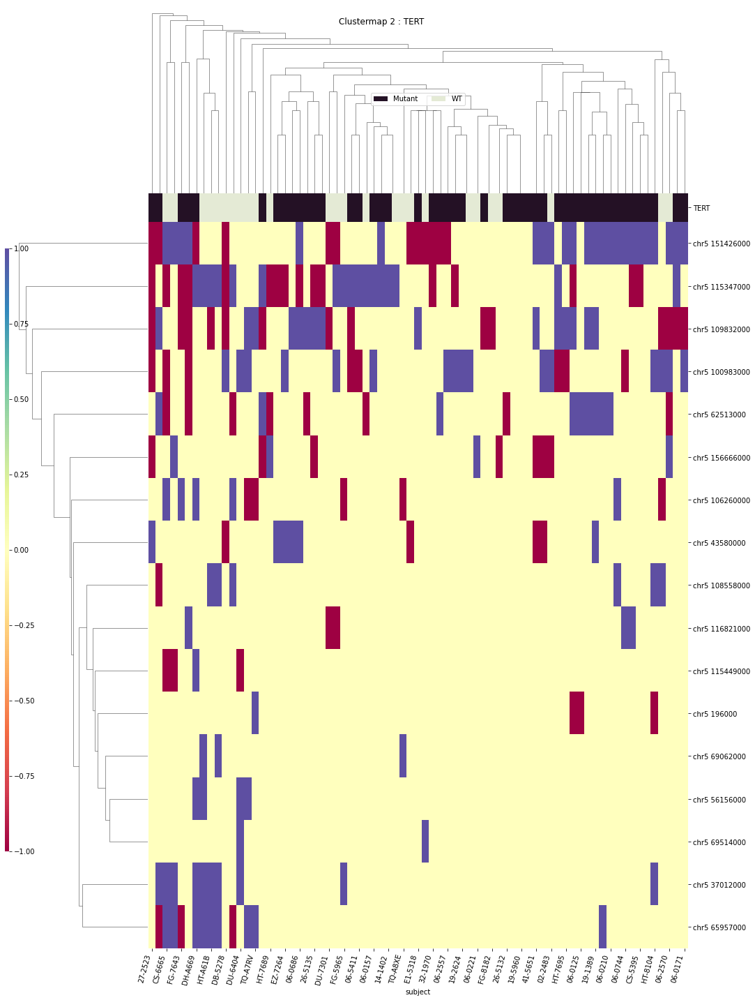

disease_type
['chr5 100984000' 'chr5 108558000' 'chr5 122913000' 'chr5 1567000'
 'chr5 158036000' 'chr5 179650000' 'chr5 37012000' 'chr5 40801000'
 'chr5 43059000' 'chr5 44730000' 'chr5 56156000' 'chr5 68323000'
 'chr5 8938000' 'disease_type' 'subject']


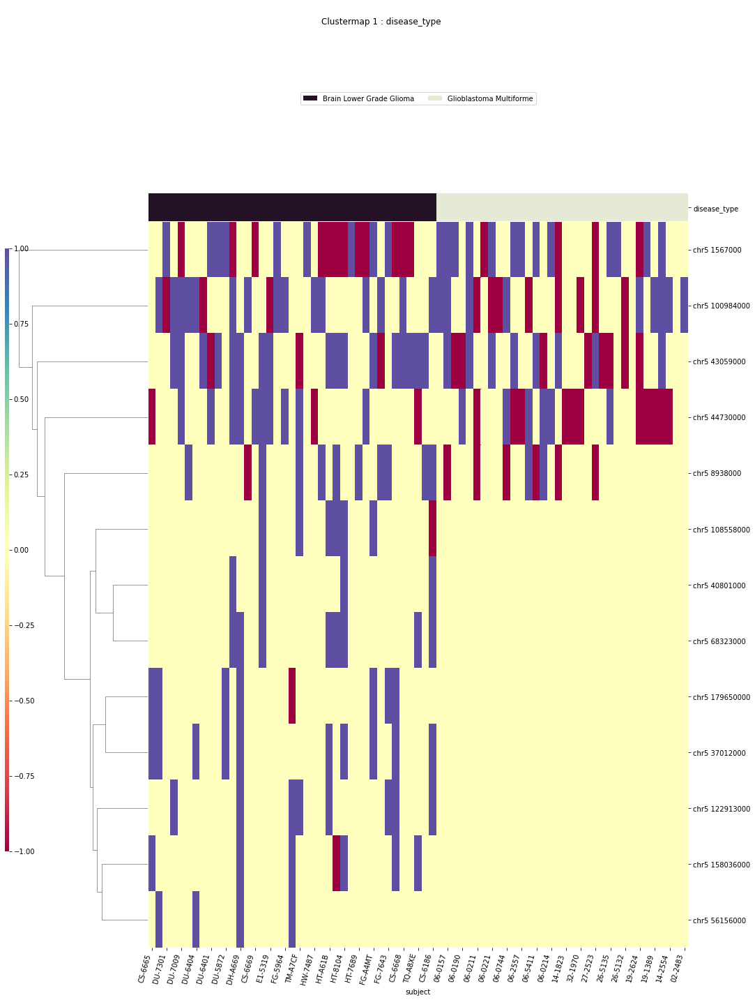

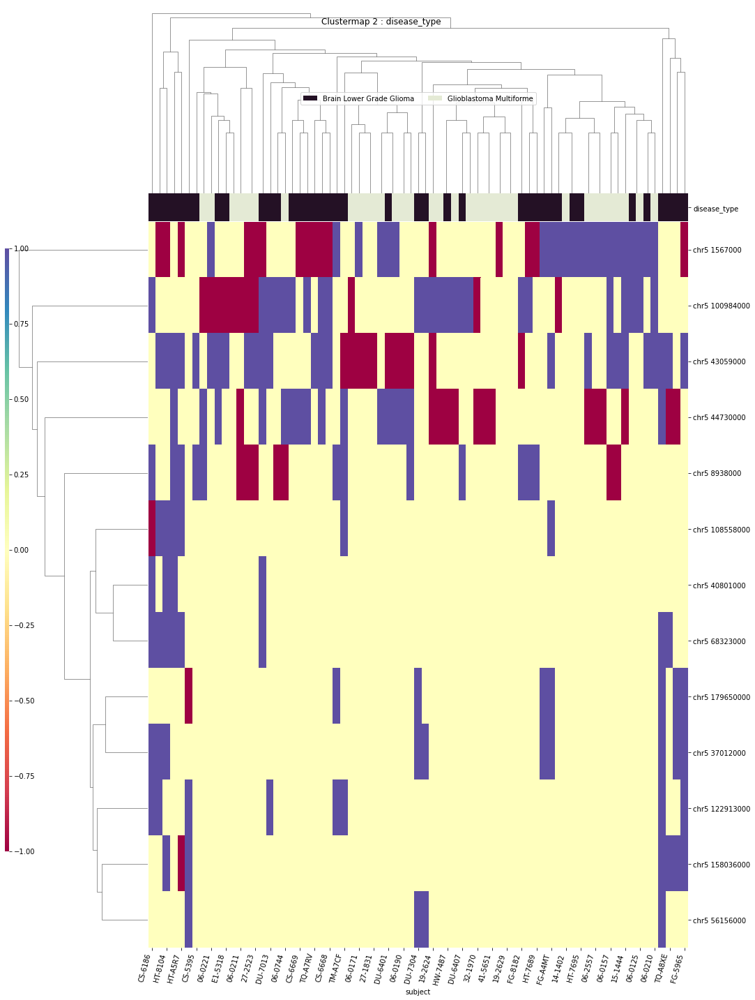

chr6
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr6 99142000


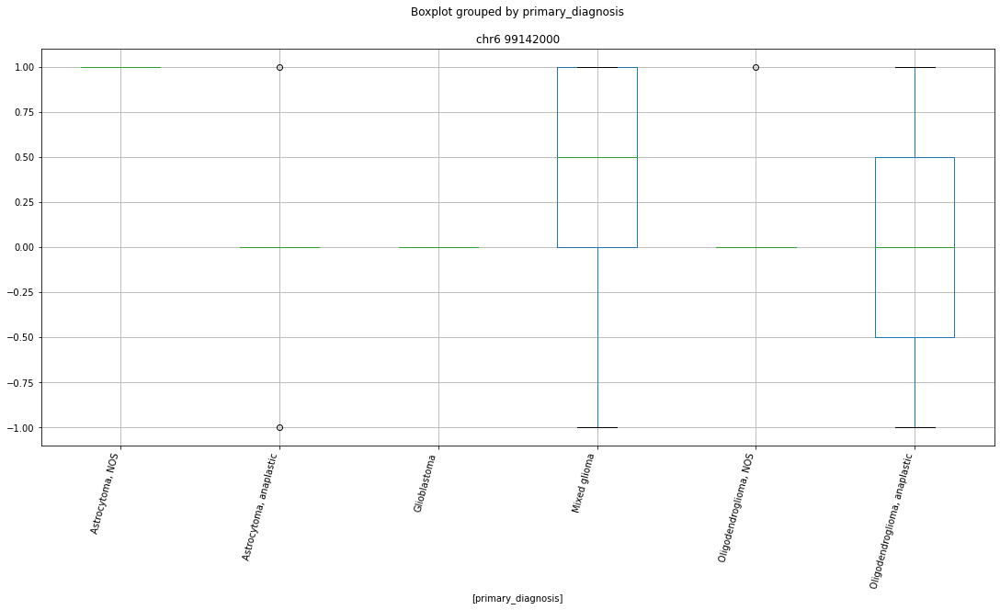

 p : 0.0  ( t : inf ) :  chr6 131144000


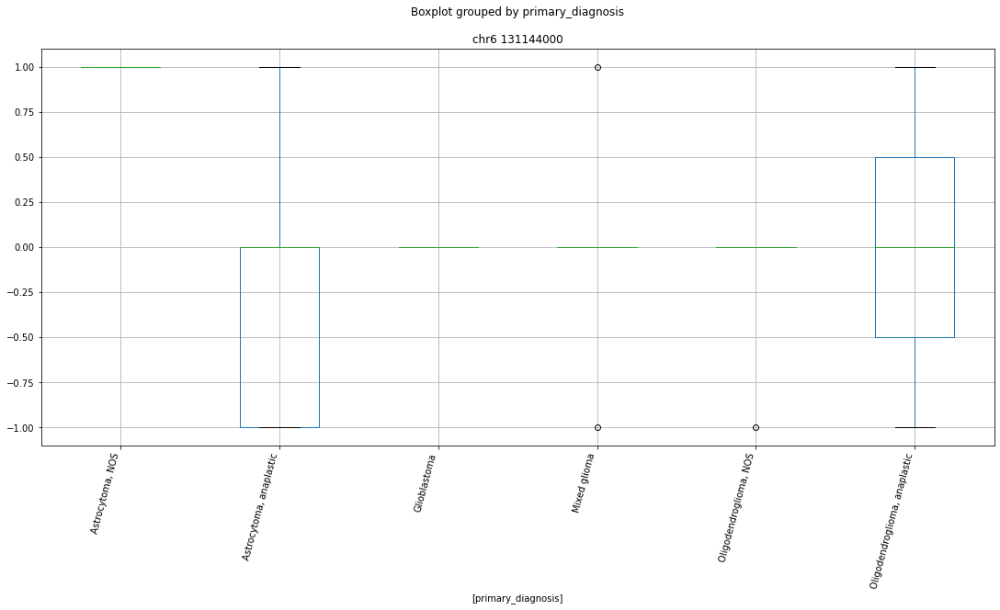

 p : 0.0  ( t : inf ) :  chr6 132720000


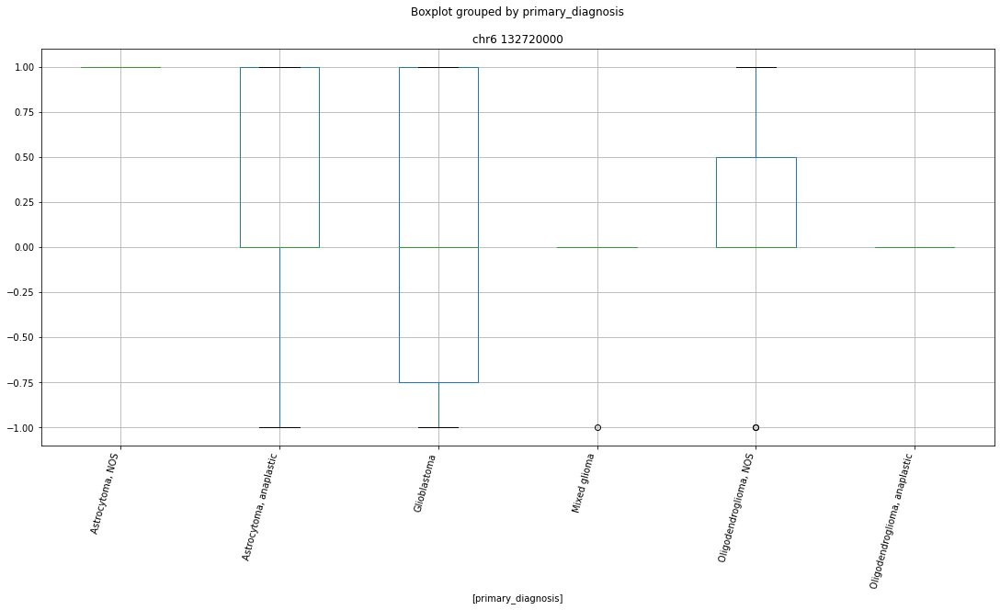

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr6 95561000


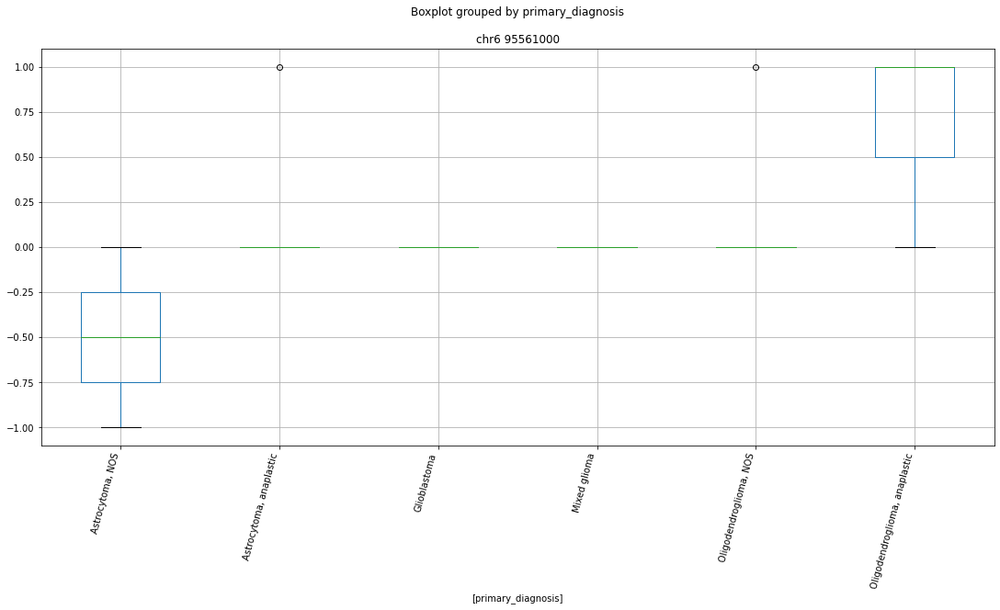

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr6 30475000


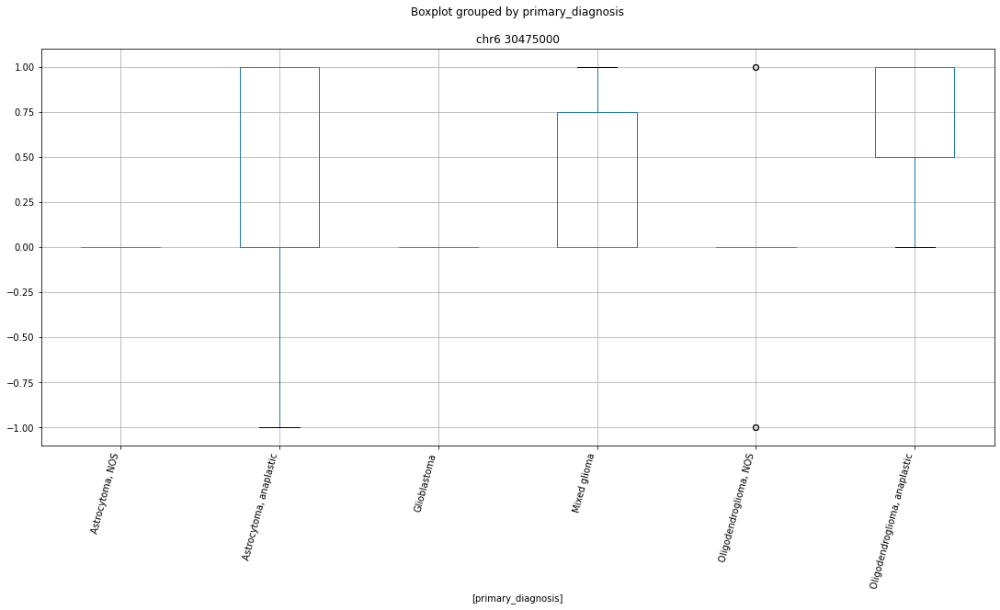

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr6 156670000


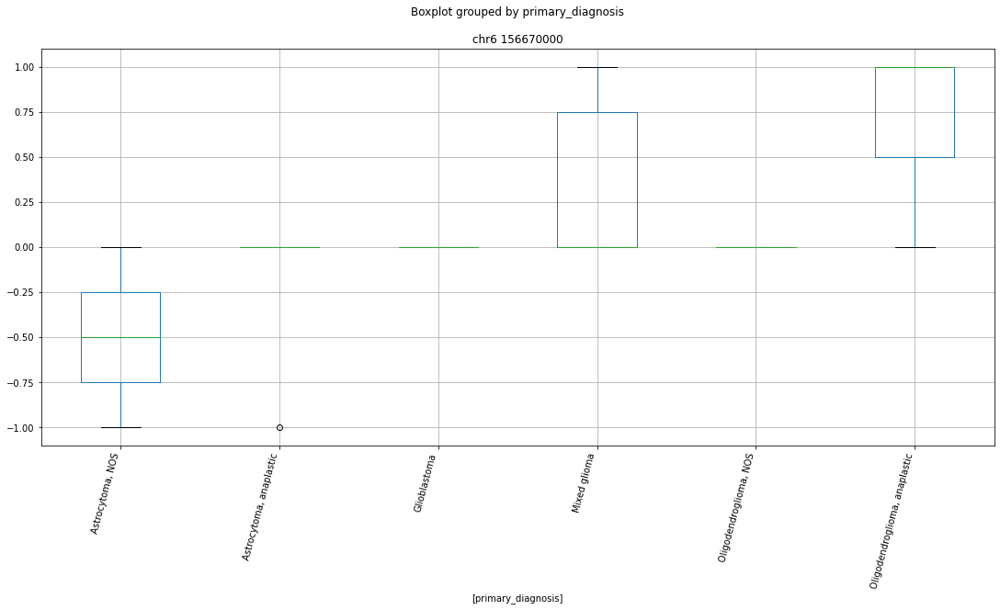

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr6 30993000


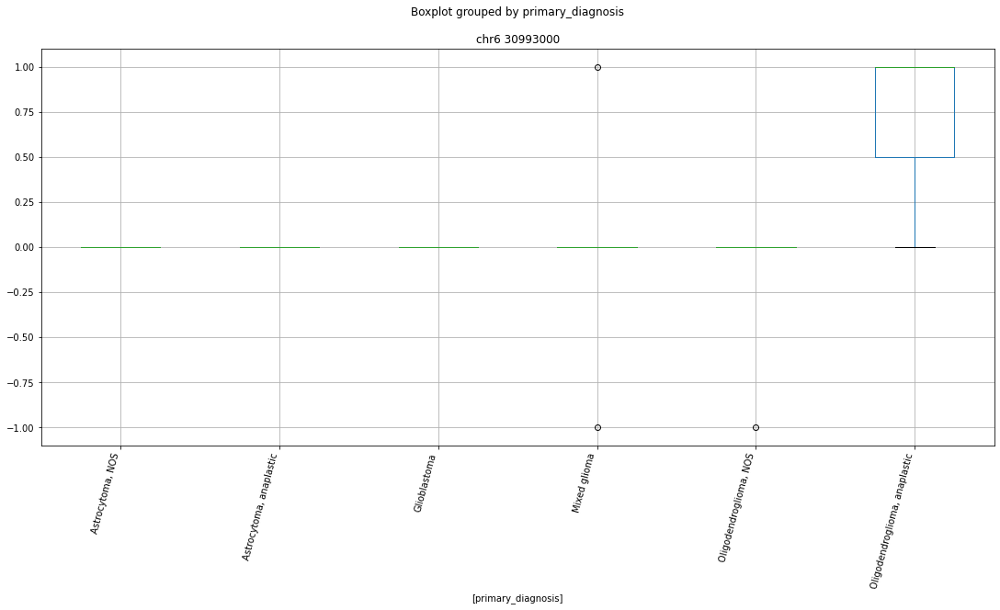

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr6 31067000


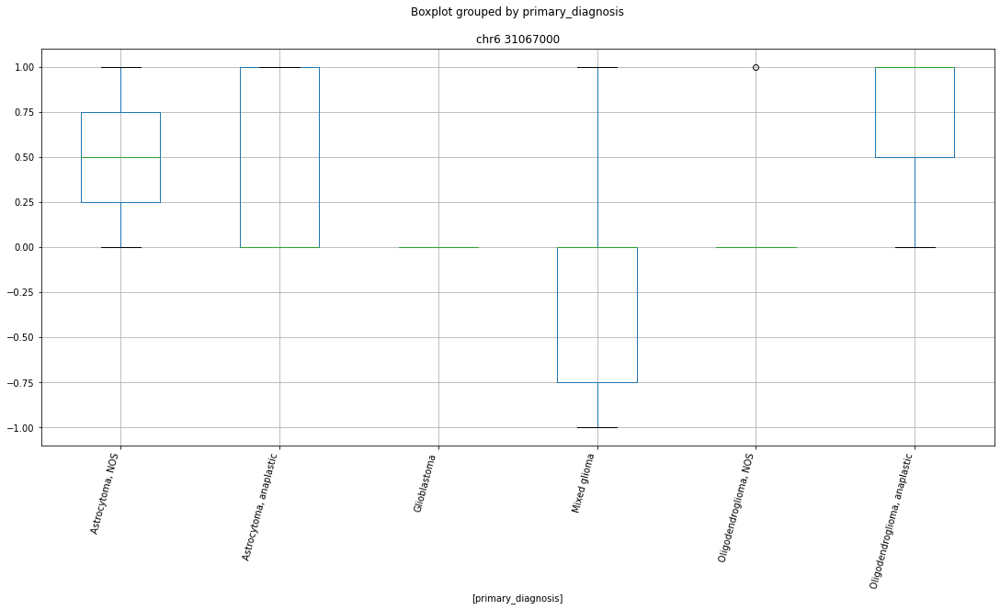

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr6 131478000


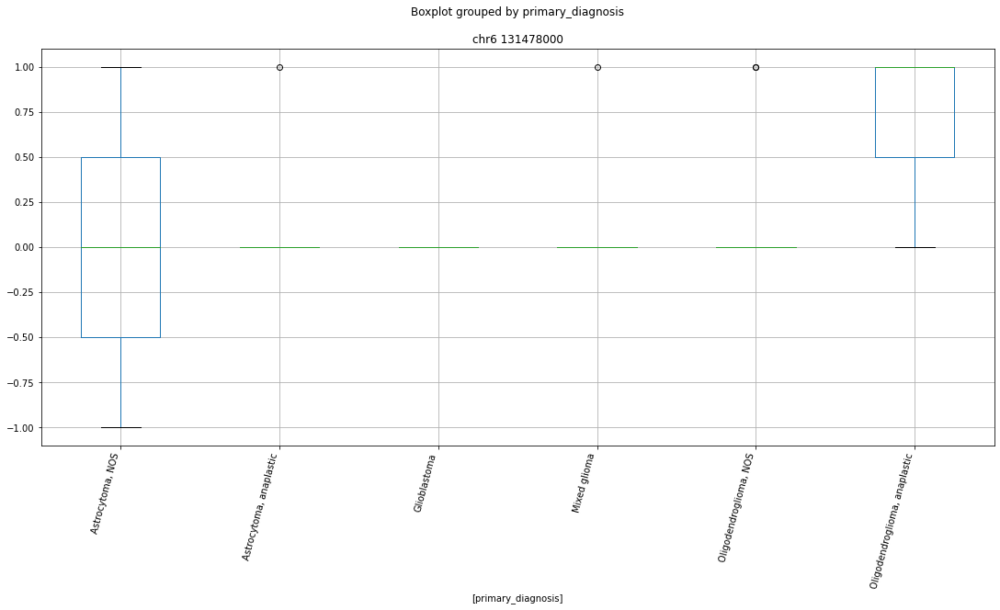

['chr6 10584000' 'chr6 107803000' 'chr6 107935000' 'chr6 108270000'
 'chr6 112047000' 'chr6 112508000' 'chr6 120932000' 'chr6 121729000'
 'chr6 125776000' 'chr6 130802000' 'chr6 131144000' 'chr6 13134000'
 'chr6 131478000' 'chr6 132720000' 'chr6 132721000' 'chr6 134659000'
 'chr6 135363000' 'chr6 137845000' 'chr6 144433000' 'chr6 151450000'
 'chr6 151455000' 'chr6 151898000' 'chr6 154687000' 'chr6 156670000'
 'chr6 15726000' 'chr6 157752000' 'chr6 157753000' 'chr6 159795000'
 'chr6 160082000' 'chr6 169856000' 'chr6 18227000' 'chr6 19940000'
 'chr6 21851000' 'chr6 22837000' 'chr6 24400000' 'chr6 24661000'
 'chr6 25748000' 'chr6 26000000' 'chr6 26745000' 'chr6 27529000'
 'chr6 27596000' 'chr6 28688000' 'chr6 29719000' 'chr6 29895000'
 'chr6 30475000' 'chr6 30993000' 'chr6 31067000' 'chr6 31853000'
 'chr6 31931000' 'chr6 32675000' 'chr6 33059000' 'chr6 33121000'
 'chr6 33122000' 'chr6 33485000' 'chr6 33809000' 'chr6 42893000'
 'chr6 44328000' 'chr6 51982000' 'chr6 52761000' 'chr6 52762000

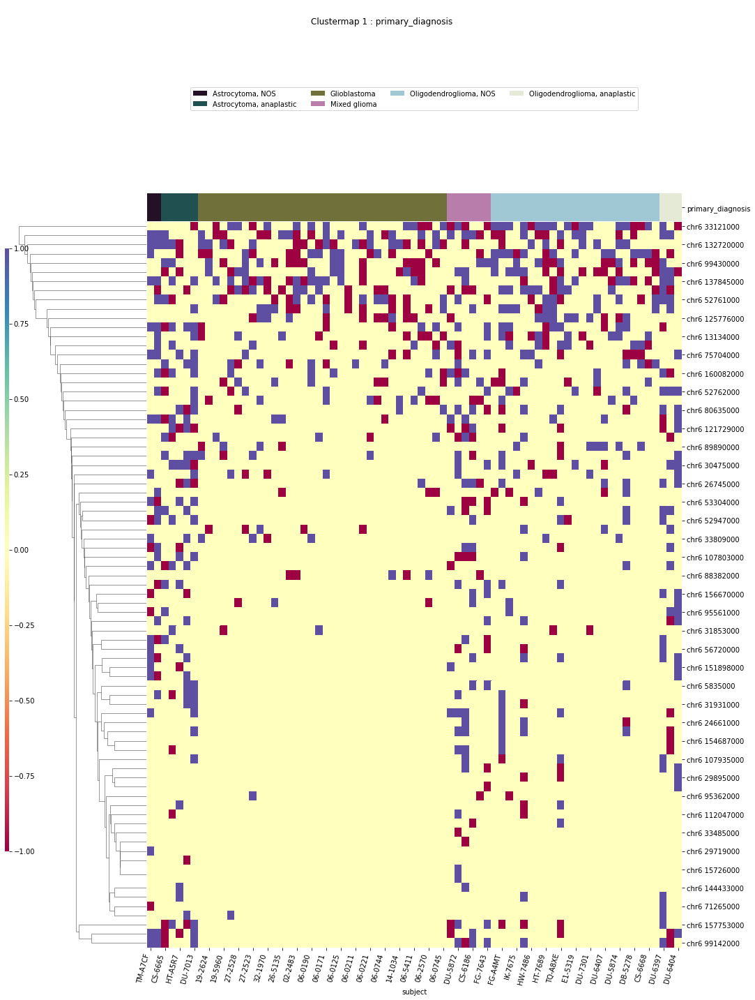

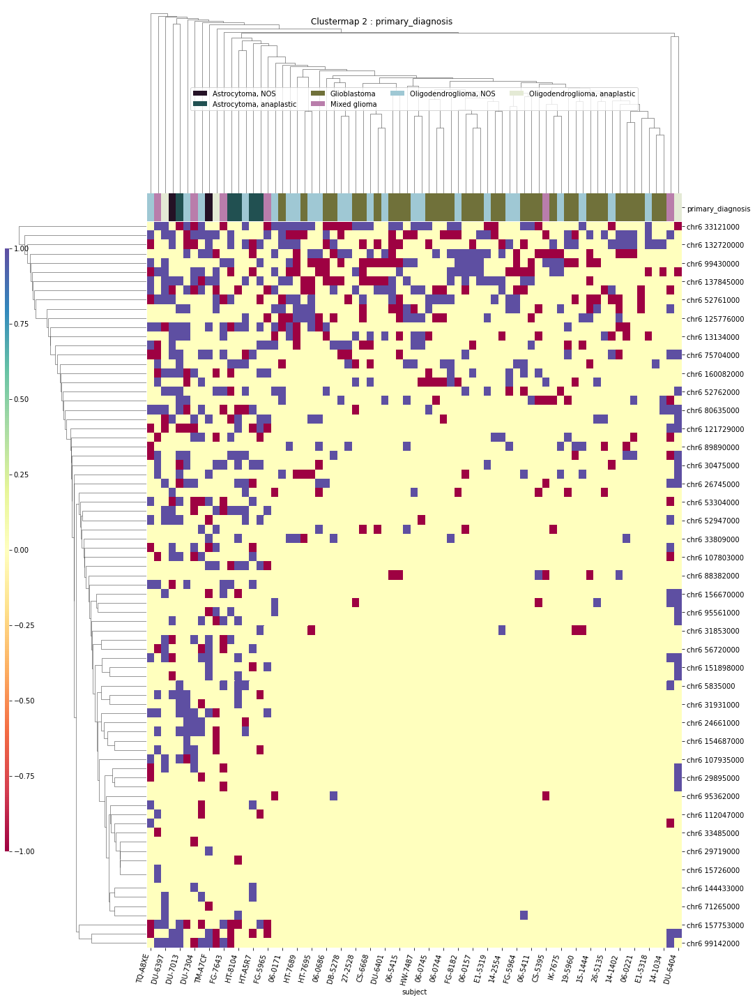

IDH
['IDH' 'chr6 121729000' 'chr6 125776000' 'chr6 131144000' 'chr6 149785000'
 'chr6 22837000' 'chr6 26000000' 'chr6 29895000' 'chr6 44329000'
 'chr6 52748000' 'chr6 52761000' 'chr6 93173000' 'subject']


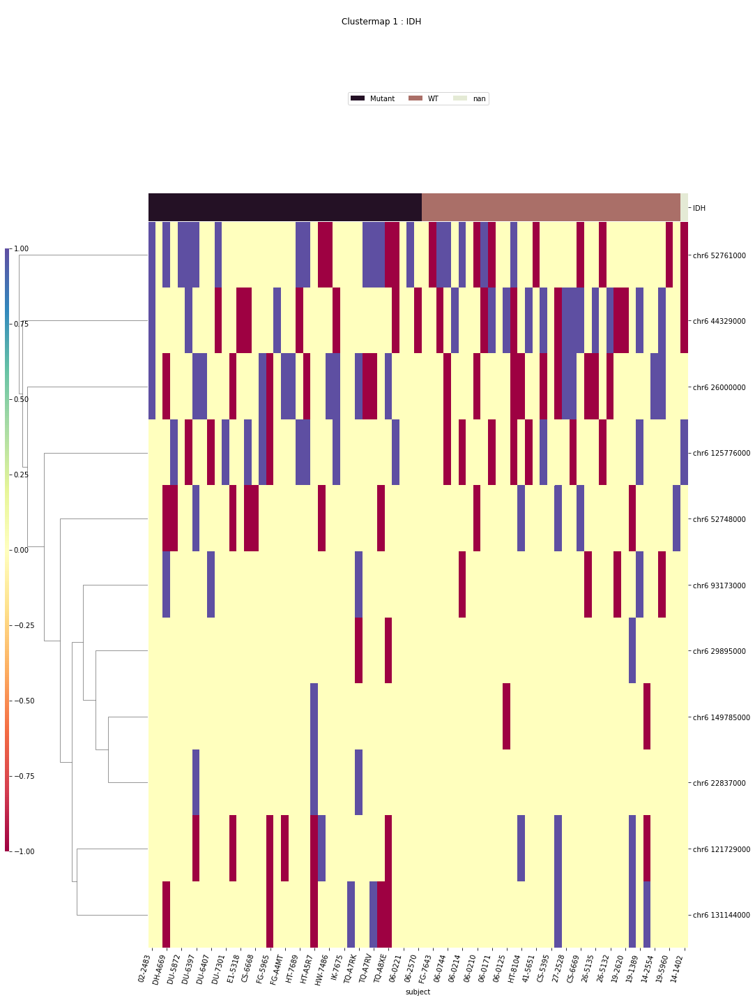

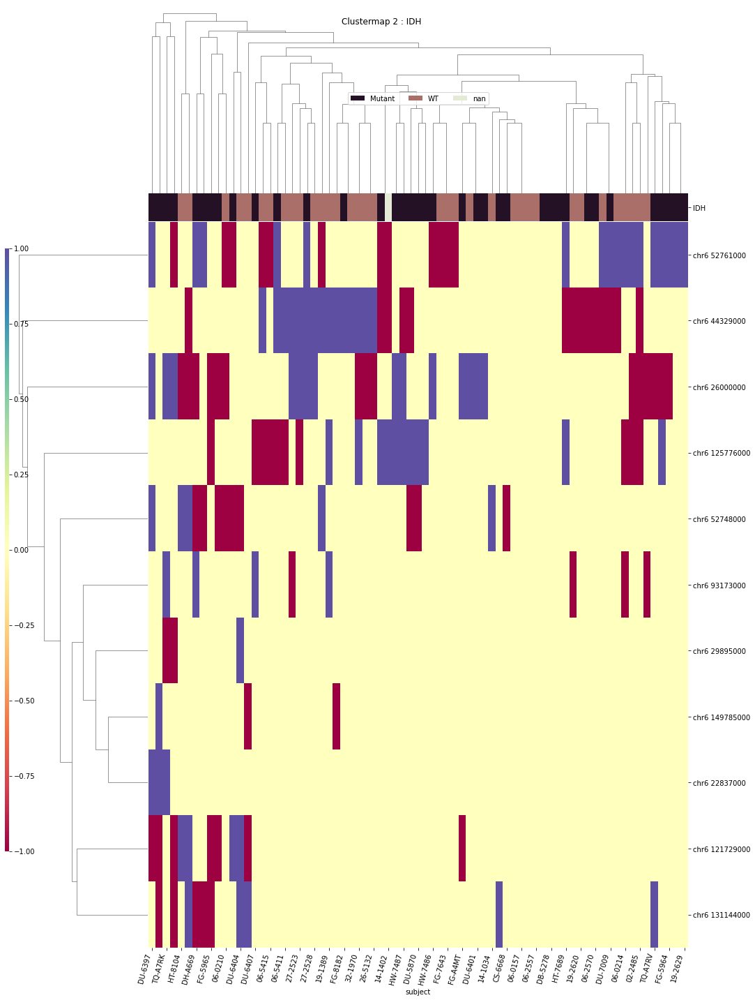

x1p19q
['chr6 112508000' 'chr6 125775000' 'chr6 125776000' 'chr6 130802000'
 'chr6 154687000' 'chr6 24661000' 'chr6 27774000' 'chr6 31067000'
 'chr6 33059000' 'chr6 33525000' 'chr6 52761000' 'chr6 71265000'
 'chr6 93174000' 'subject' 'x1p19q']


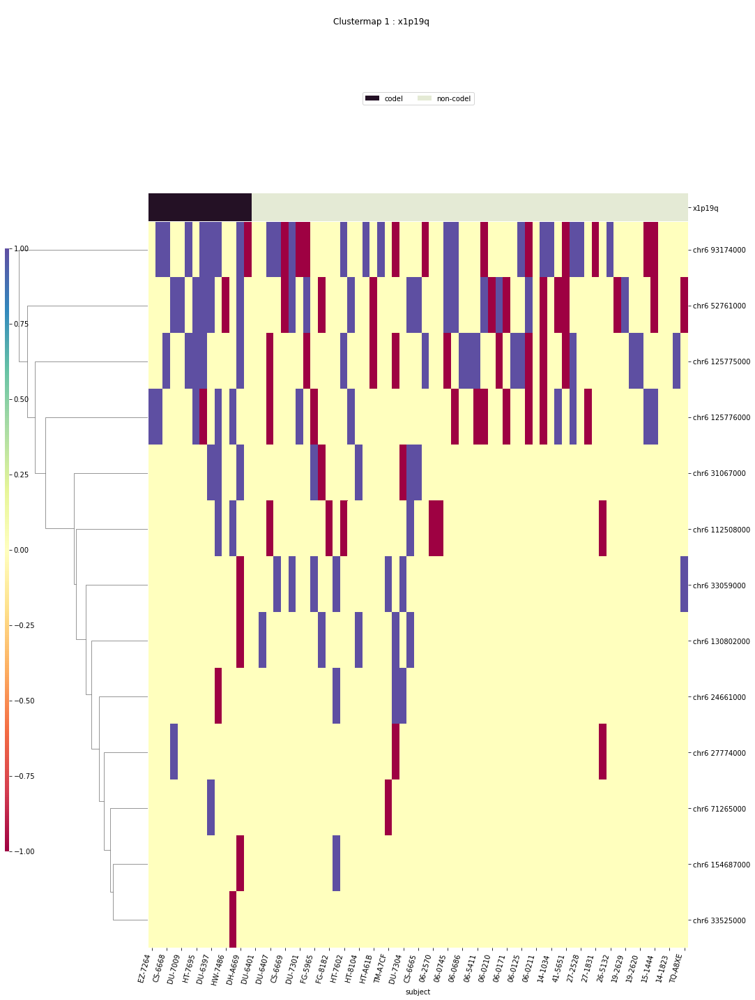

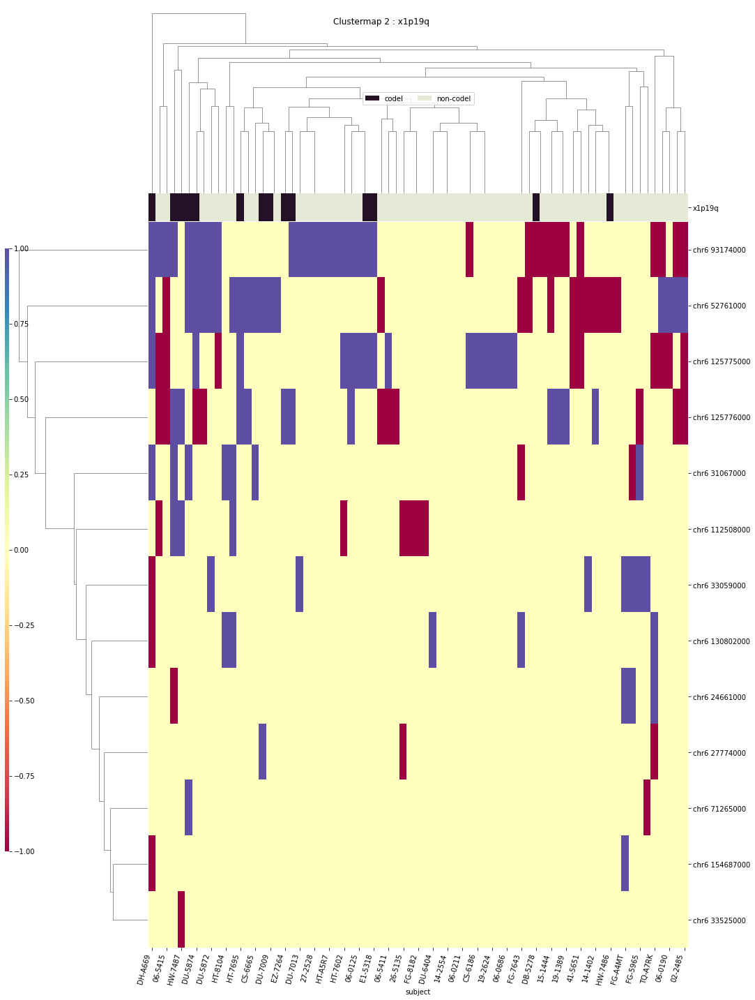

TERT
['TERT' 'chr6 125775000' 'chr6 135363000' 'chr6 144433000'
 'chr6 151456000' 'chr6 157753000' 'chr6 18227000' 'chr6 24661000'
 'chr6 27596000' 'chr6 33059000' 'chr6 5835000' 'subject']


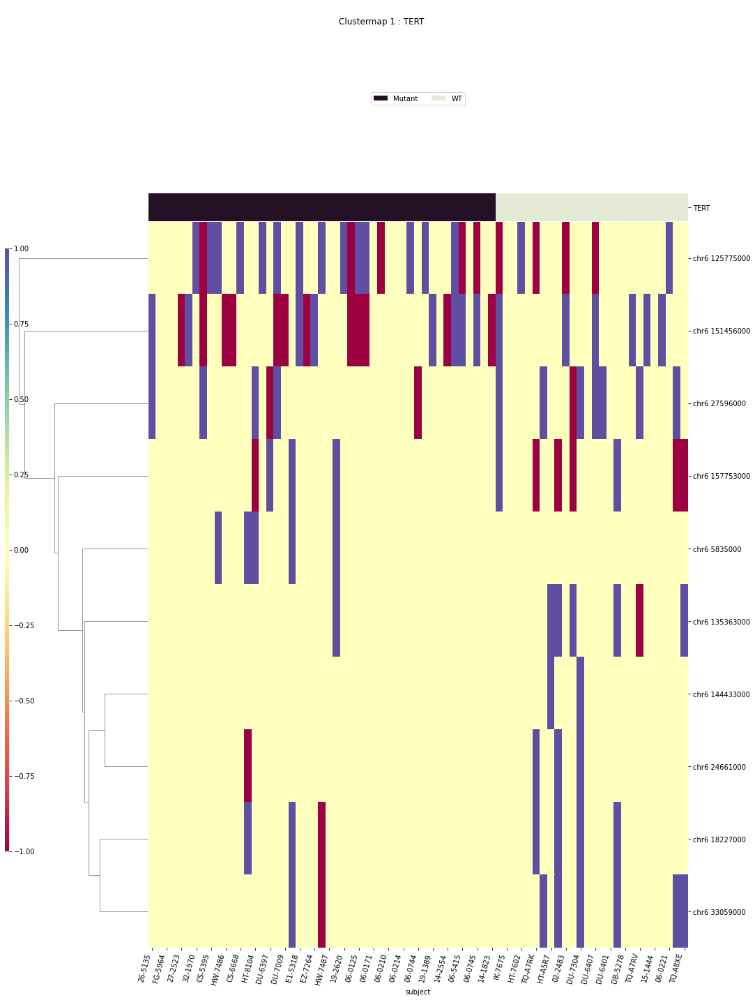

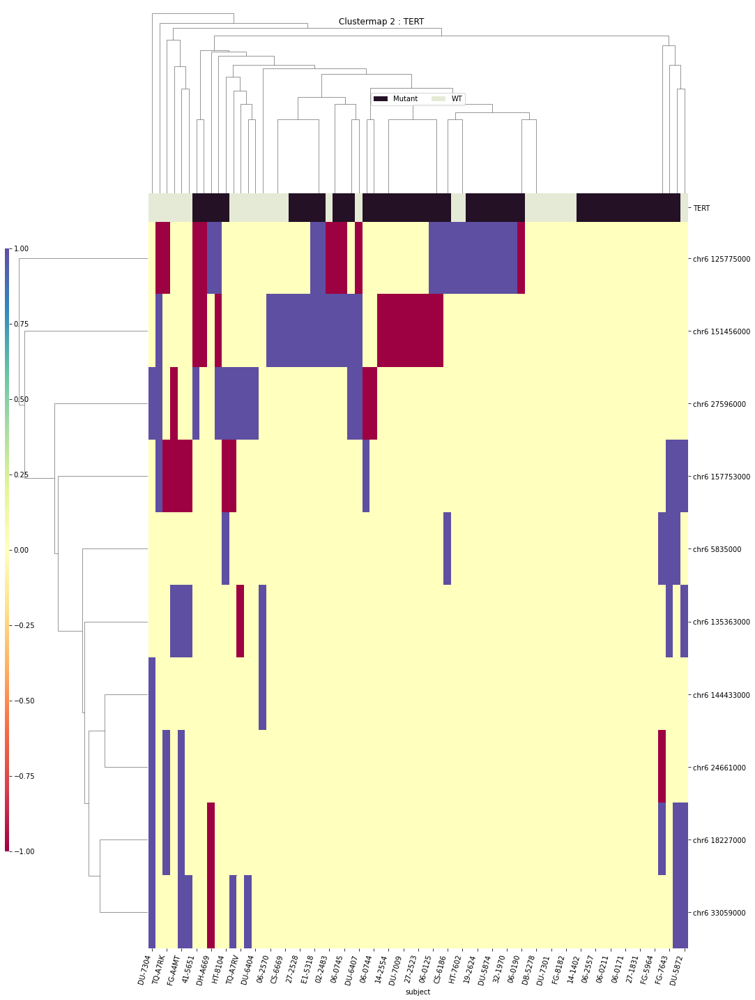

disease_type
['chr6 13134000' 'chr6 131478000' 'chr6 134659000' 'chr6 135363000'
 'chr6 18227000' 'chr6 28688000' 'chr6 33059000' 'chr6 5835000'
 'chr6 93173000' 'chr6 95362000' 'disease_type' 'subject']


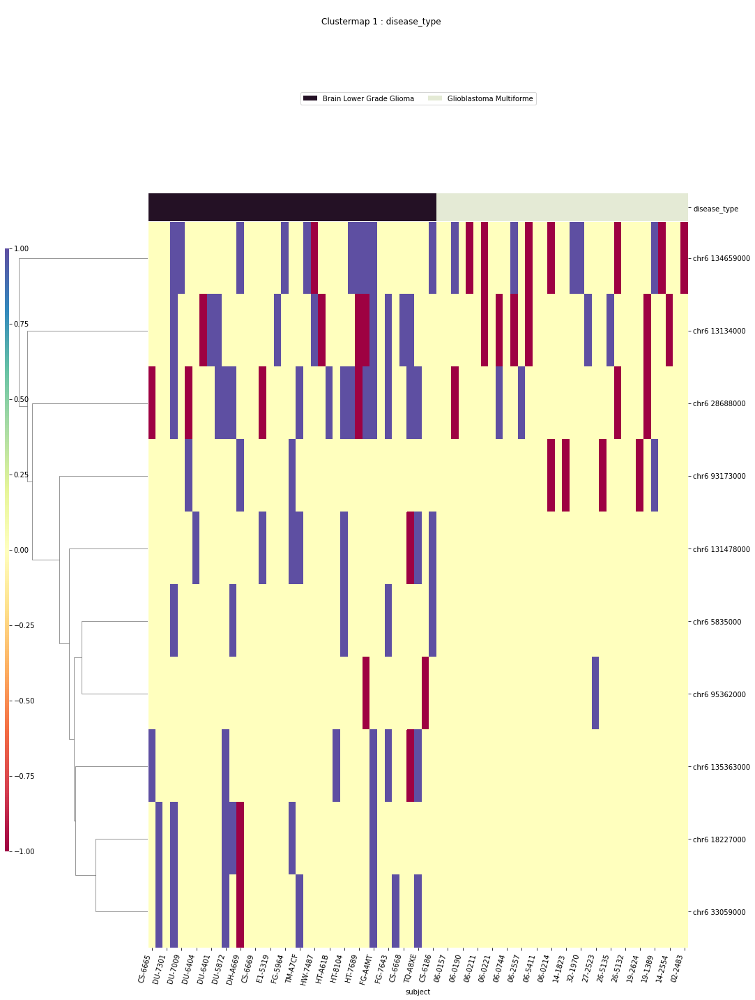

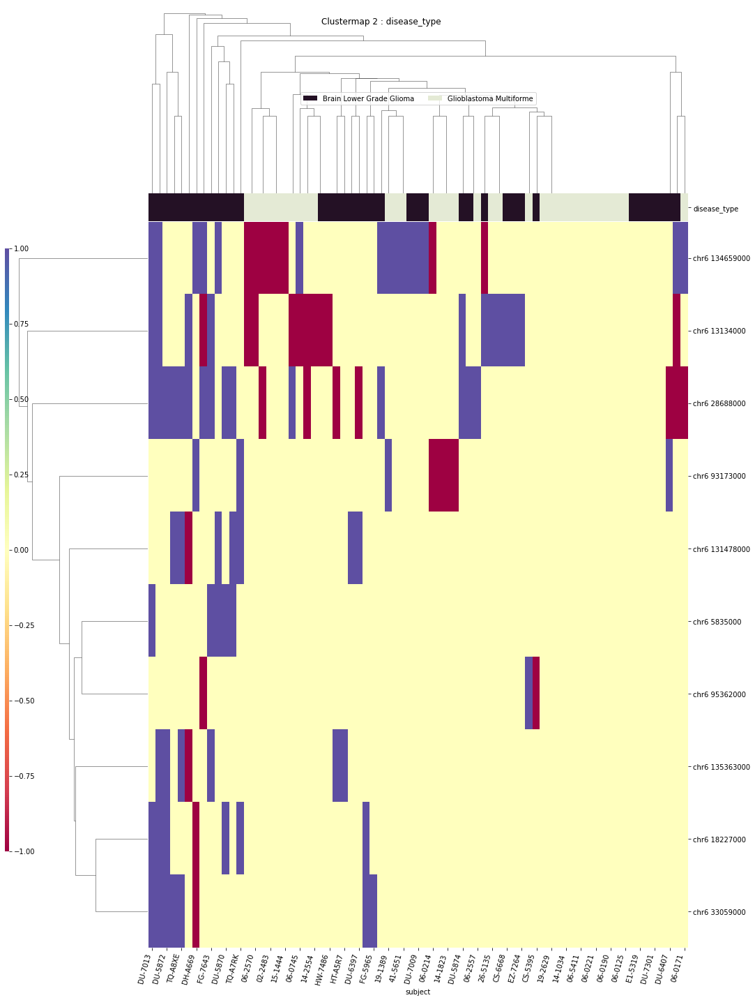

chr7
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr7 66877000


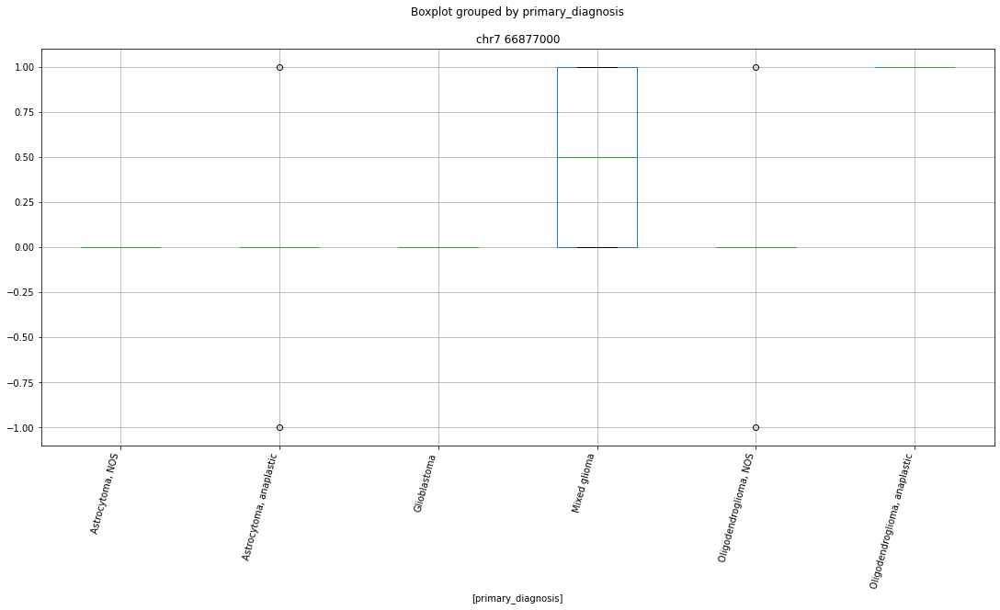

 p : 0.0  ( t : inf ) :  chr7 132985000


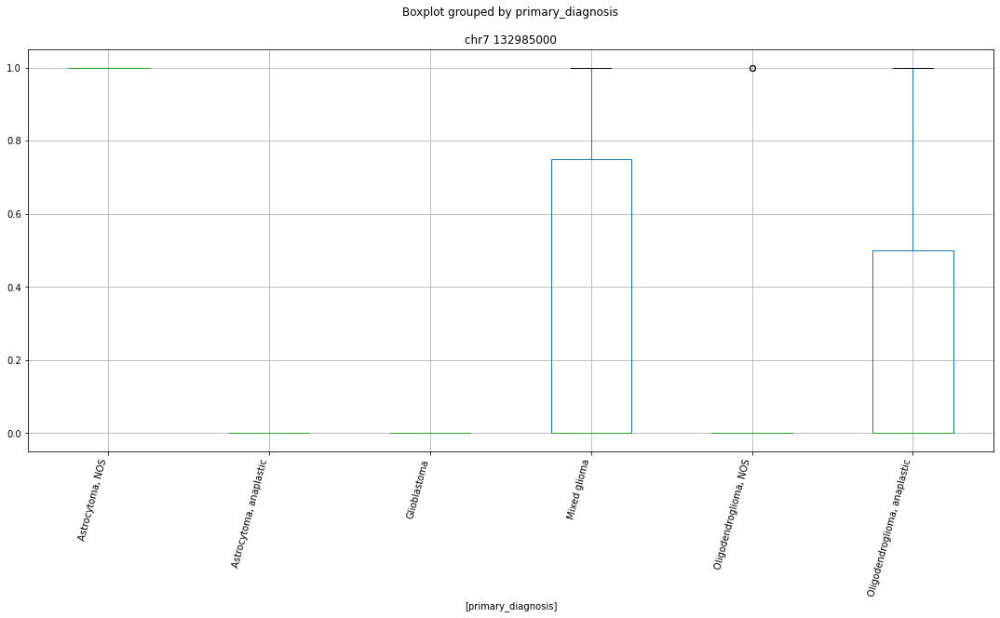

 p : 0.0  ( t : inf ) :  chr7 23638000


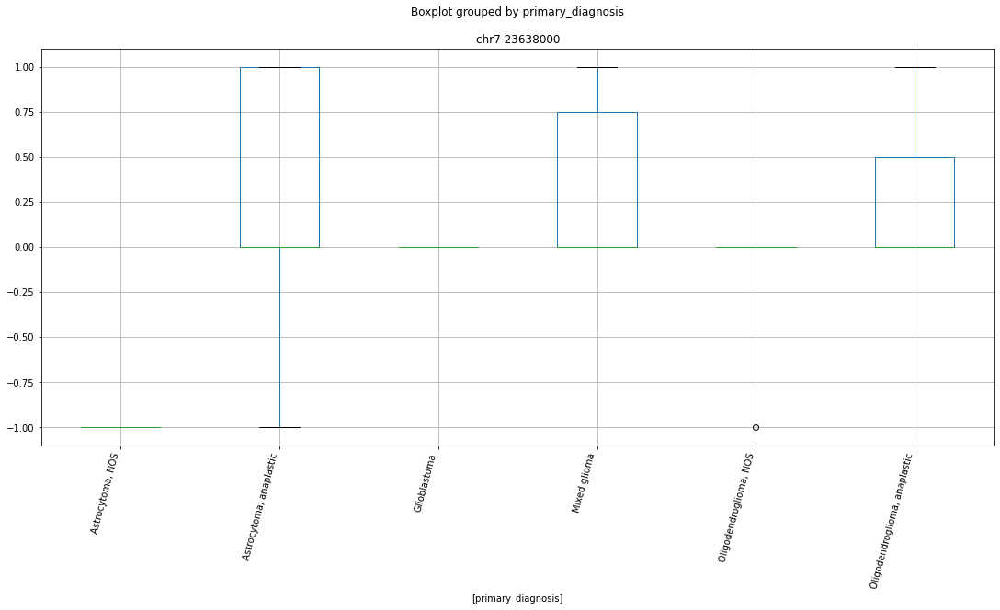

 p : 0.0  ( t : inf ) :  chr7 90744000


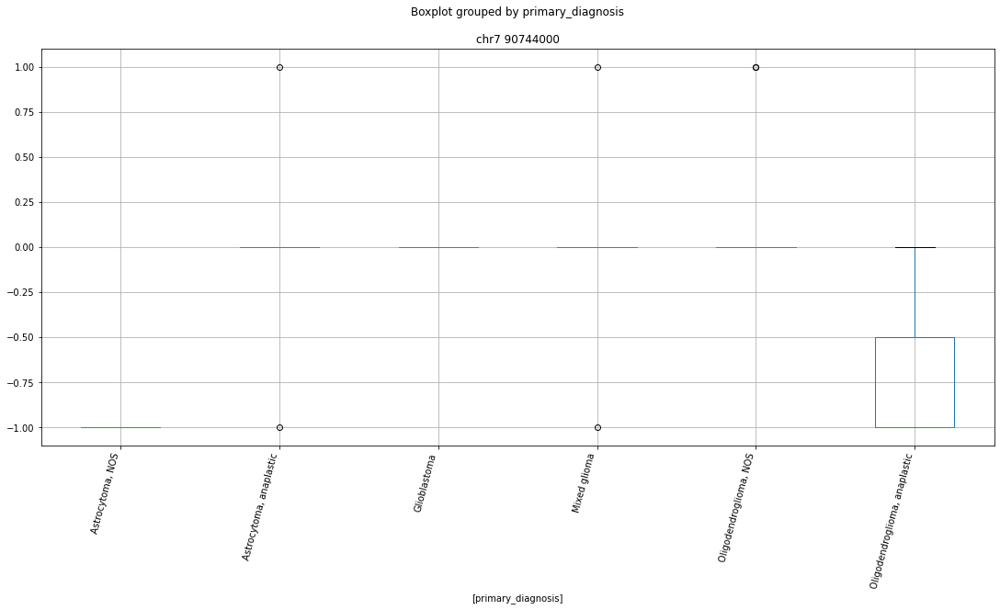

 p : 2.948014870353662e-15  ( t : 12.708265027138834 ) :  chr7 113341000


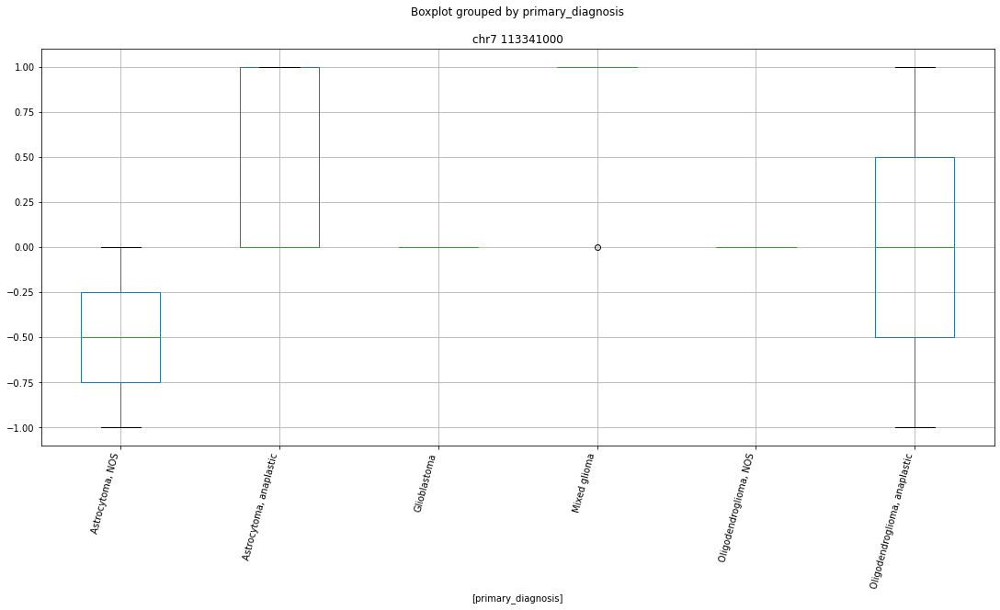

 p : 1.2735213637763693e-13  ( t : 11.358945418727965 ) :  chr7 150506000


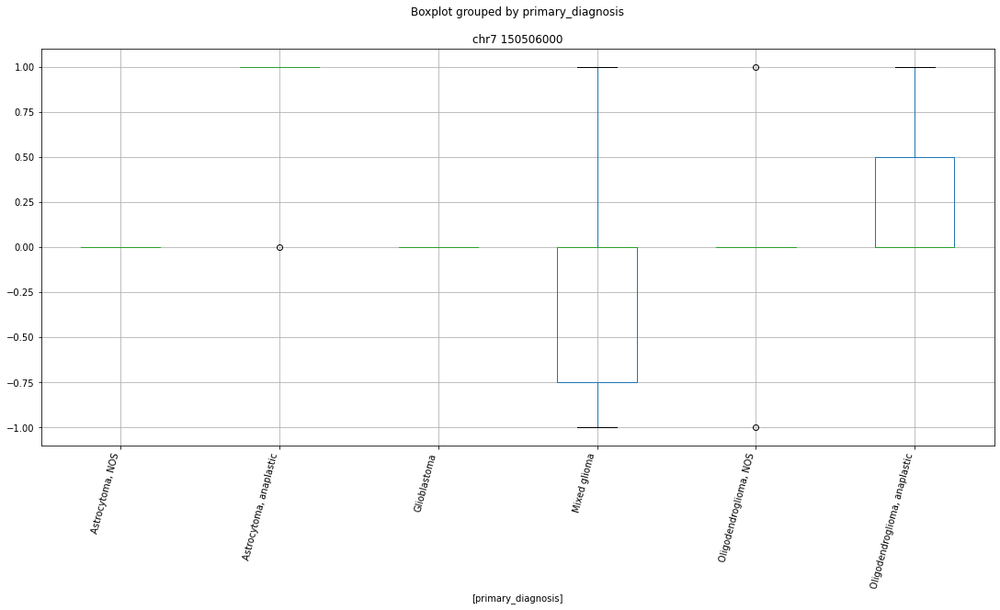

 p : 6.789629778491773e-11  ( t : 10.34741346990838 ) :  chr7 113341000


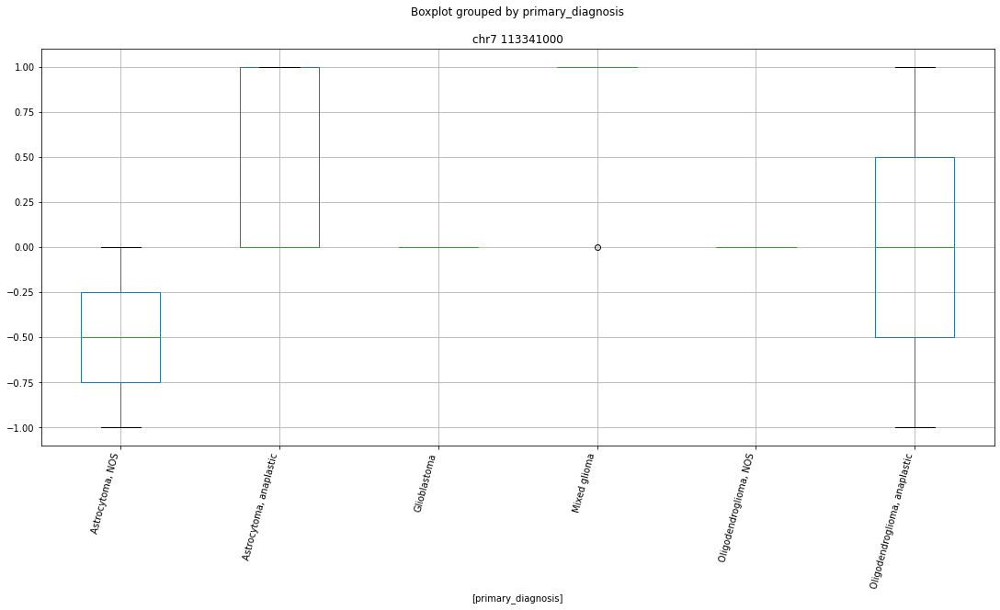

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr7 90744000


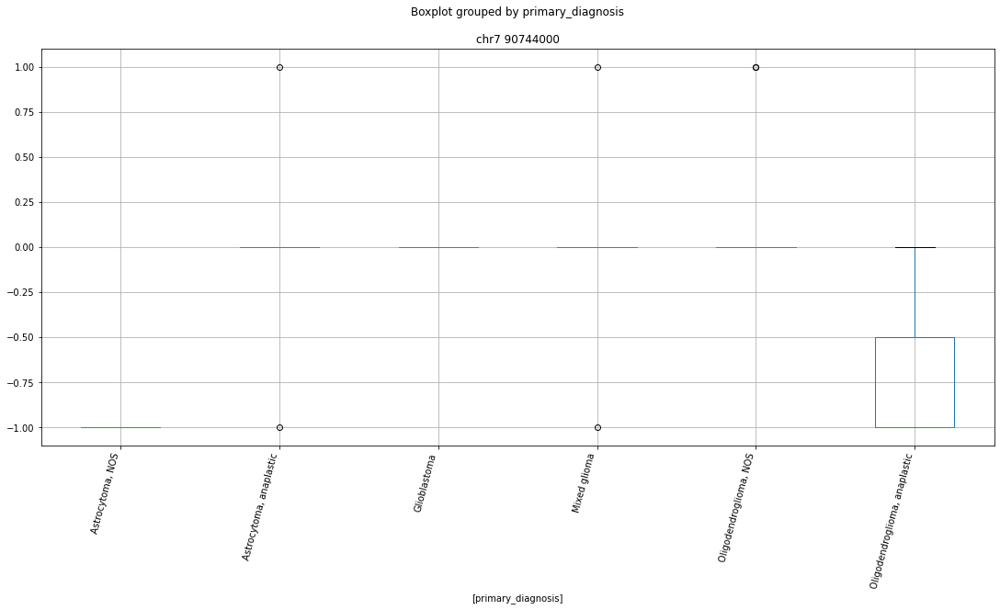

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr7 28839000


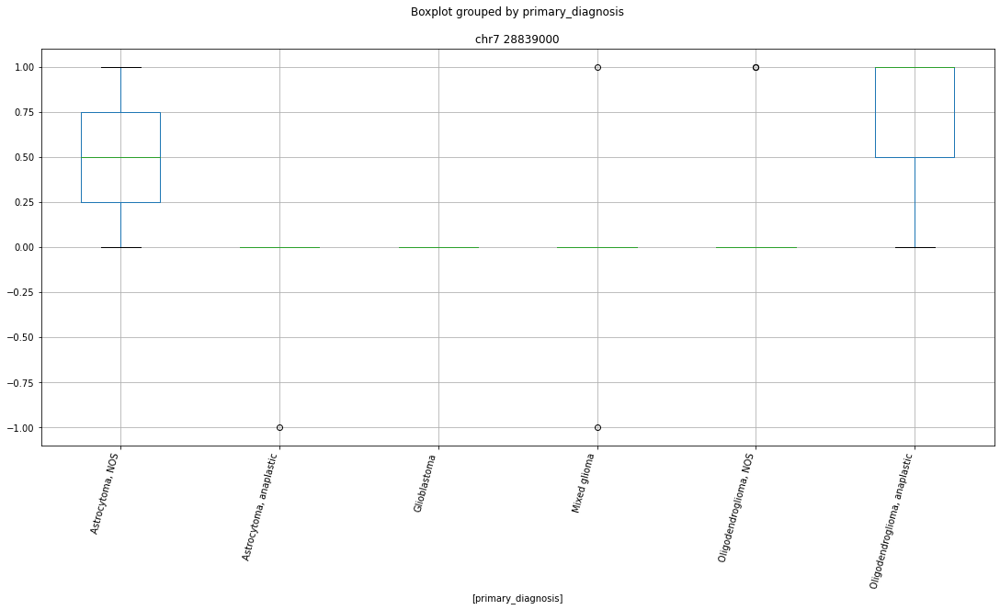

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr7 4624000


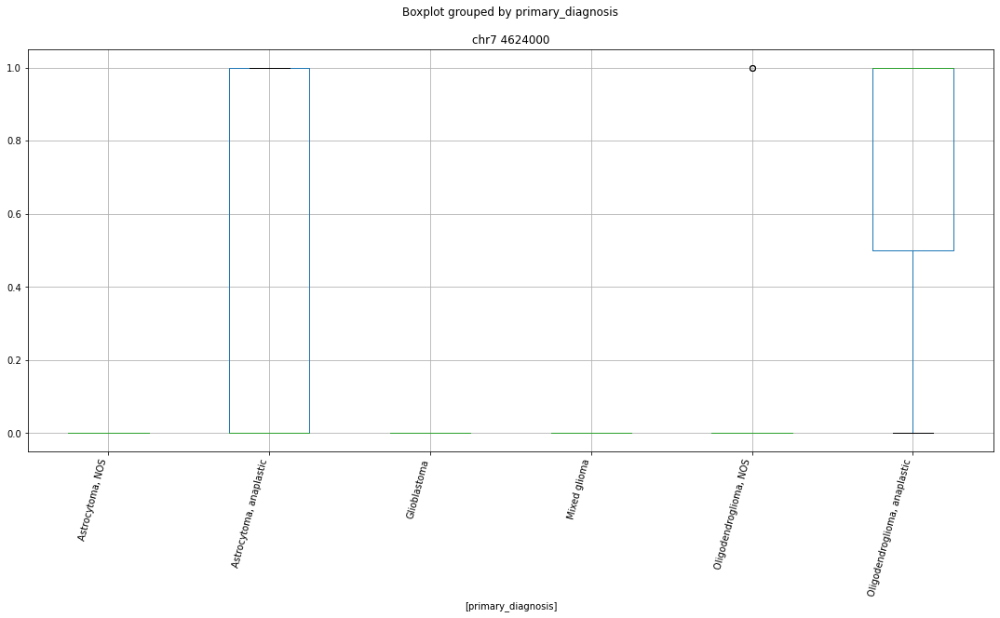

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr7 23045000


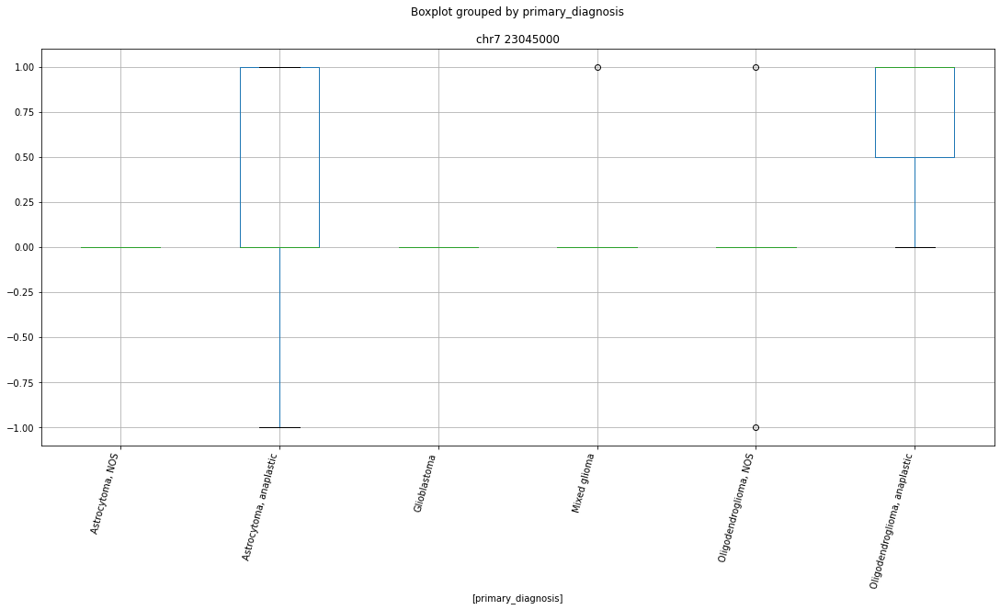

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr7 26148000


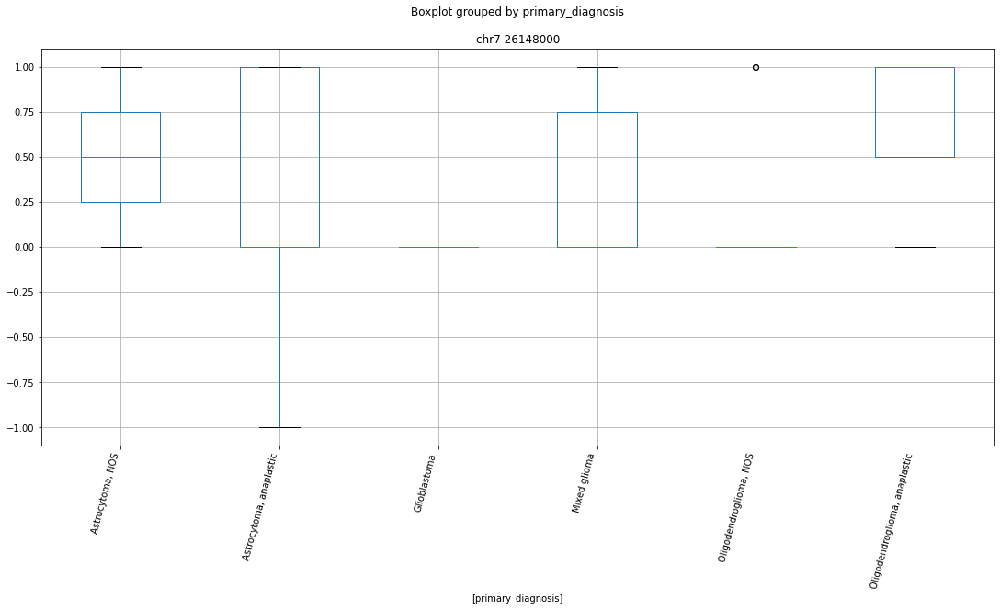

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr7 32754000


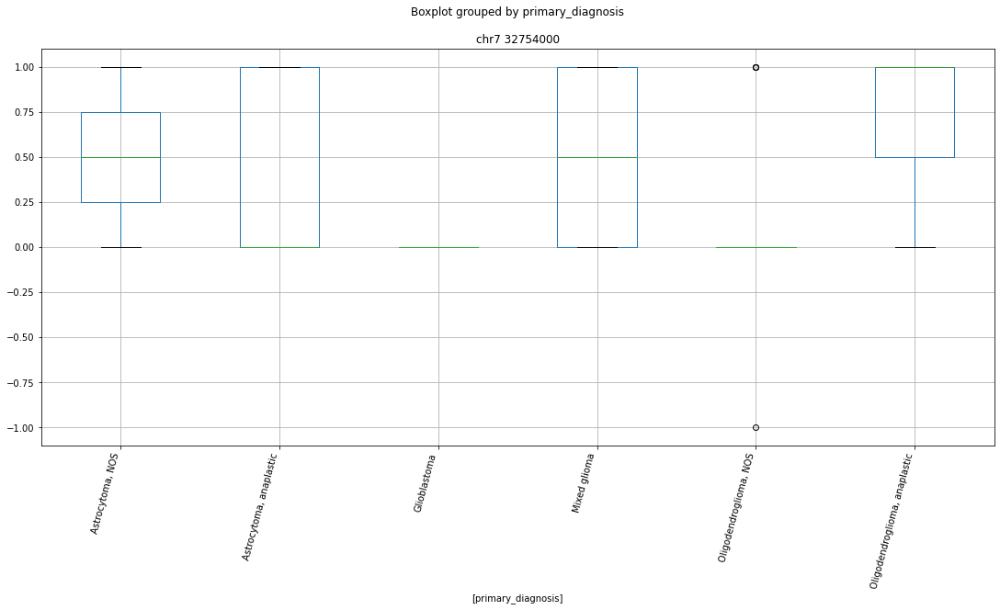

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr7 37293000


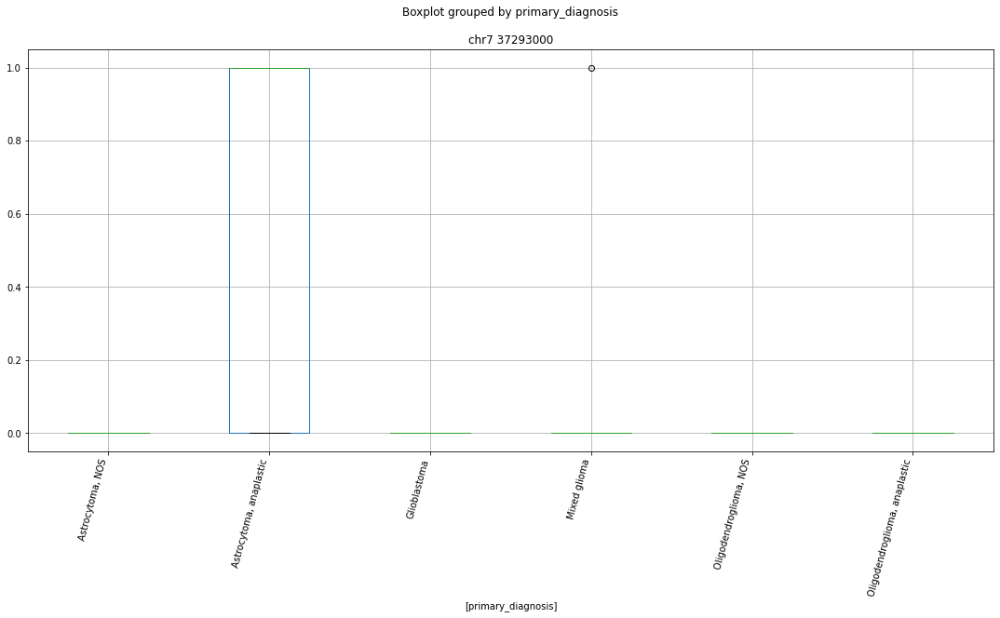

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr7 153314000


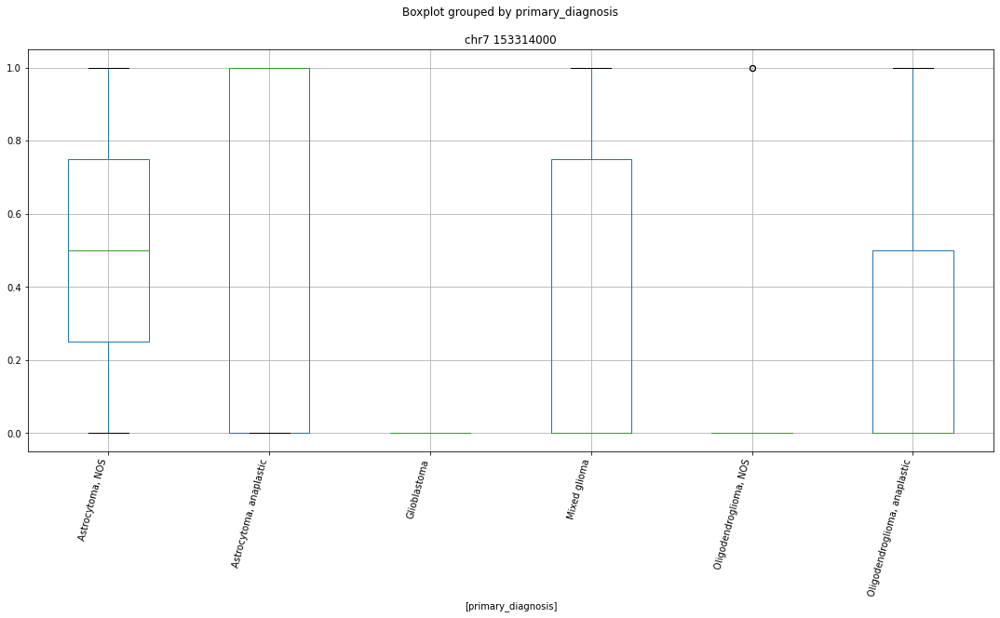

['chr7 101092000' 'chr7 102839000' 'chr7 104747000' 'chr7 105149000'
 'chr7 107848000' 'chr7 108671000' 'chr7 112552000' 'chr7 112697000'
 'chr7 112923000' 'chr7 113341000' 'chr7 119100000' 'chr7 125221000'
 'chr7 126168000' 'chr7 126169000' 'chr7 13103000' 'chr7 132985000'
 'chr7 140363000' 'chr7 140431000' 'chr7 140552000' 'chr7 140763000'
 'chr7 150506000' 'chr7 152585000' 'chr7 153314000' 'chr7 155034000'
 'chr7 155366000' 'chr7 158657000' 'chr7 16197000' 'chr7 20669000'
 'chr7 22801000' 'chr7 23039000' 'chr7 23040000' 'chr7 23045000'
 'chr7 23638000' 'chr7 2389000' 'chr7 2390000' 'chr7 2533000'
 'chr7 26148000' 'chr7 27741000' 'chr7 28839000' 'chr7 30718000'
 'chr7 32387000' 'chr7 32754000' 'chr7 36197000' 'chr7 37293000'
 'chr7 38230000' 'chr7 4390000' 'chr7 44992000' 'chr7 4600000'
 'chr7 4624000' 'chr7 47989000' 'chr7 50460000' 'chr7 51208000'
 'chr7 51302000' 'chr7 54675000' 'chr7 55401000' 'chr7 55942000'
 'chr7 62599000' 'chr7 64718000' 'chr7 64967000' 'chr7 65033000'
 'chr7

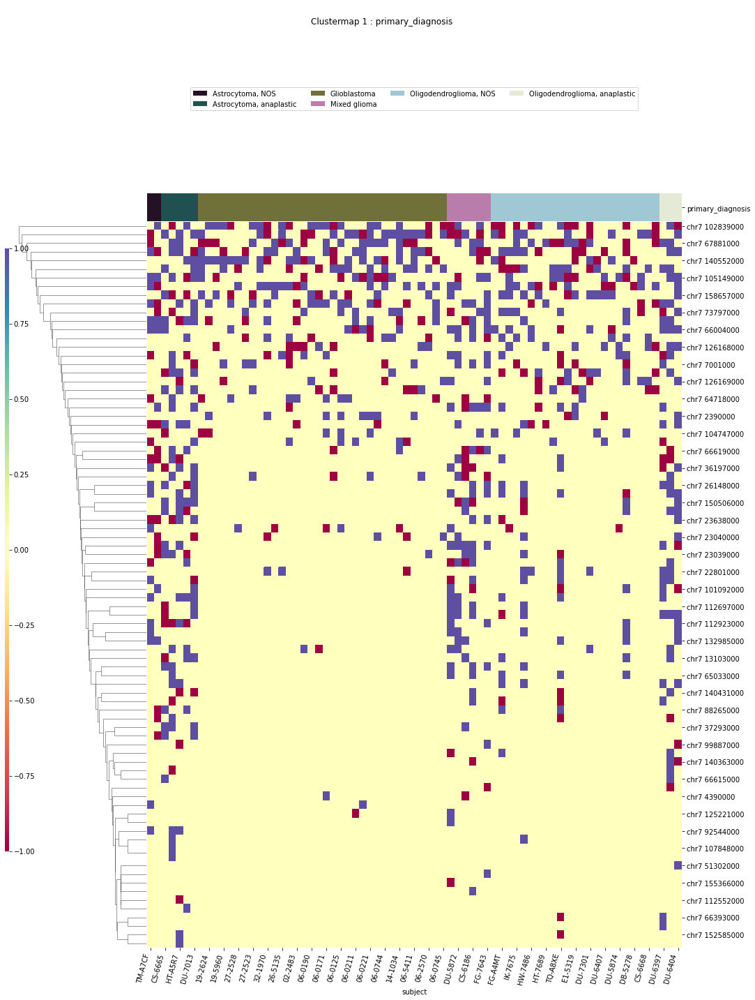

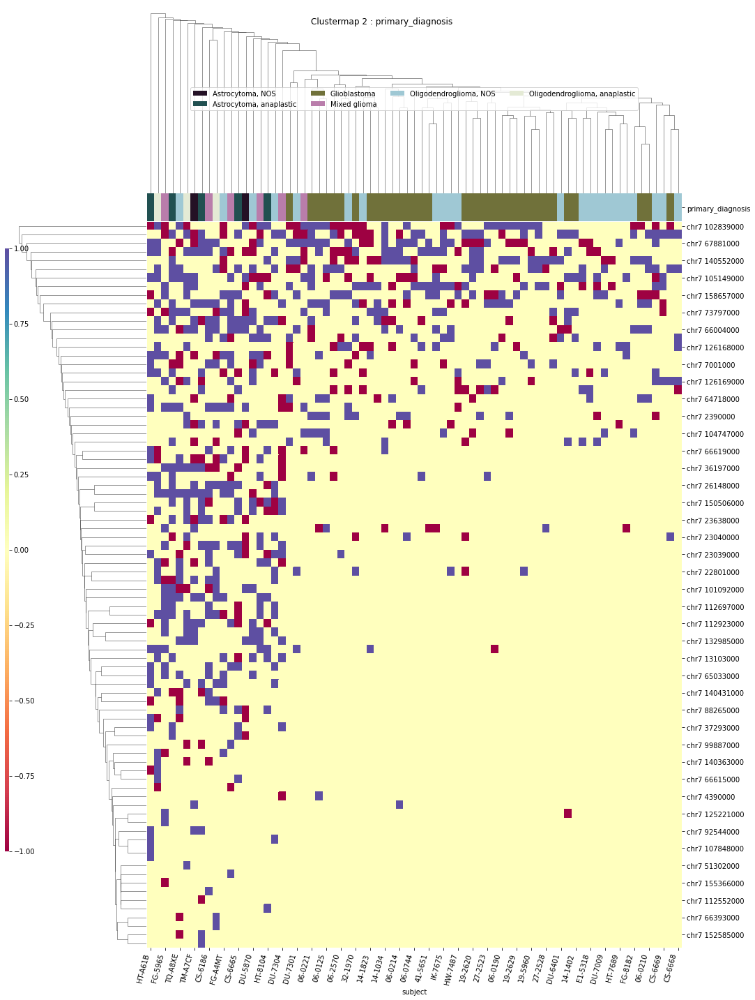

IDH
['IDH' 'chr7 102839000' 'chr7 132985000' 'chr7 140363000' 'chr7 151027000'
 'chr7 153314000' 'chr7 158657000' 'chr7 22801000' 'chr7 23638000'
 'chr7 2390000' 'chr7 4582000' 'chr7 6901000' 'chr7 73797000'
 'chr7 92544000' 'subject']


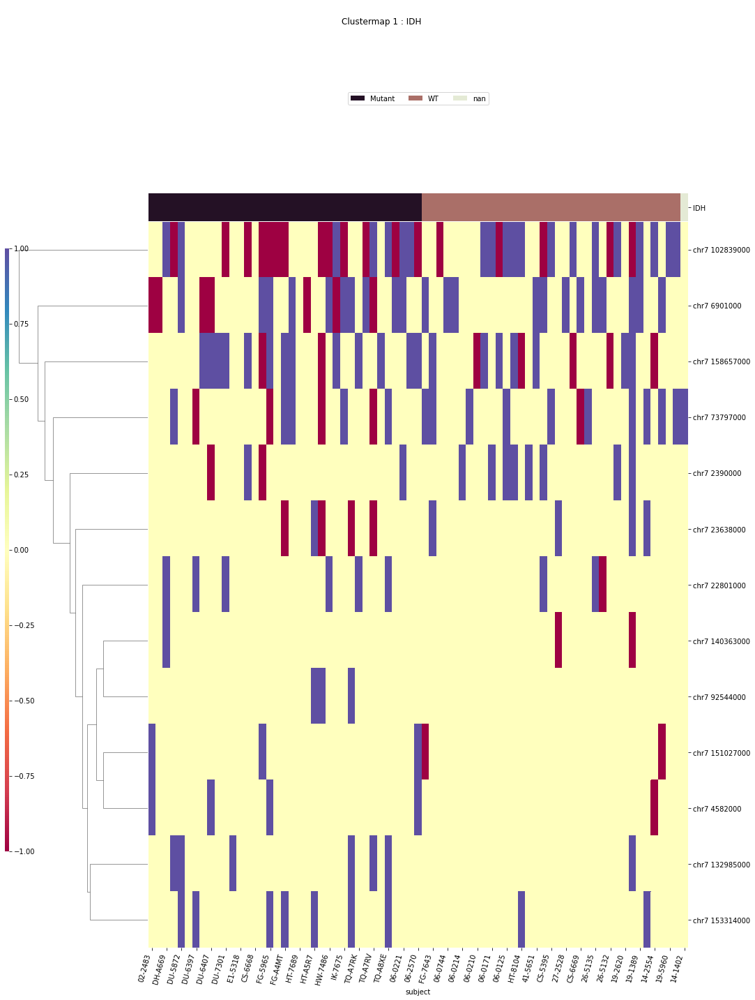

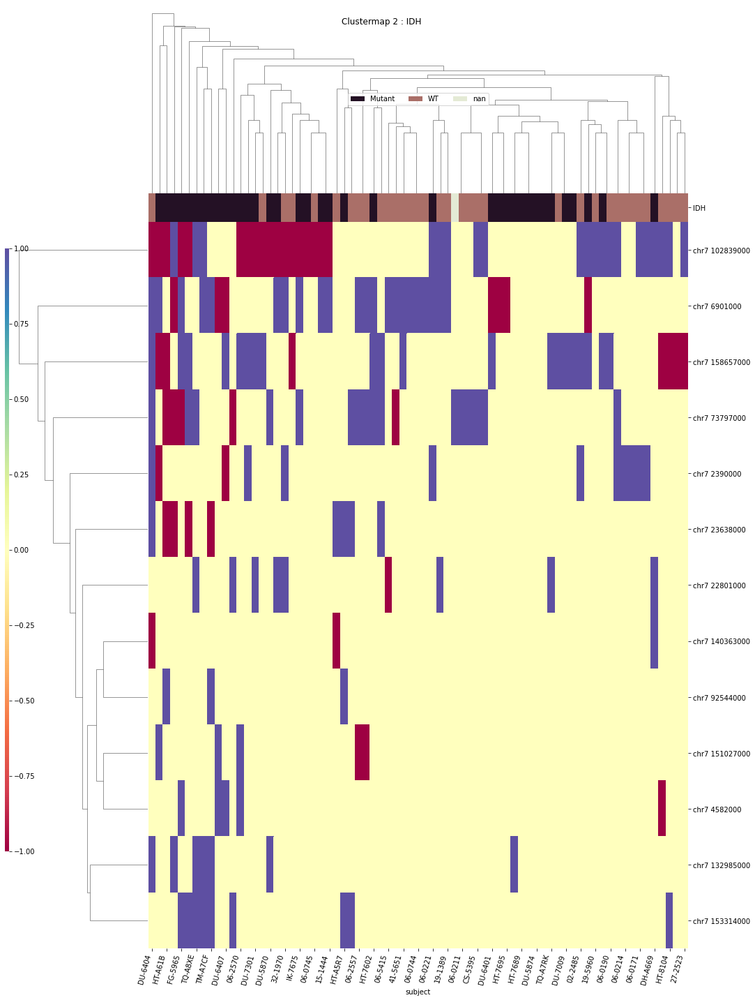

x1p19q
['chr7 101149000' 'chr7 10465000' 'chr7 140363000' 'chr7 140552000'
 'chr7 147801000' 'chr7 158237000' 'chr7 2389000' 'chr7 27742000'
 'chr7 27987000' 'chr7 51208000' 'chr7 54675000' 'chr7 66393000'
 'chr7 68083000' 'chr7 75275000' 'chr7 77510000' 'chr7 99427000' 'subject'
 'x1p19q']


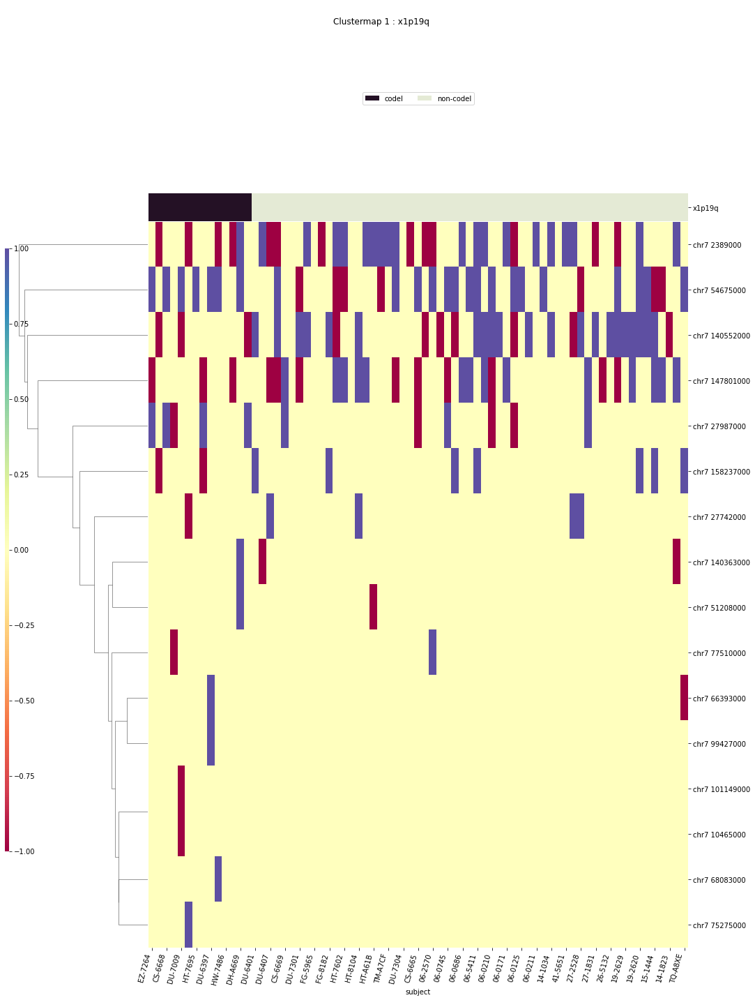

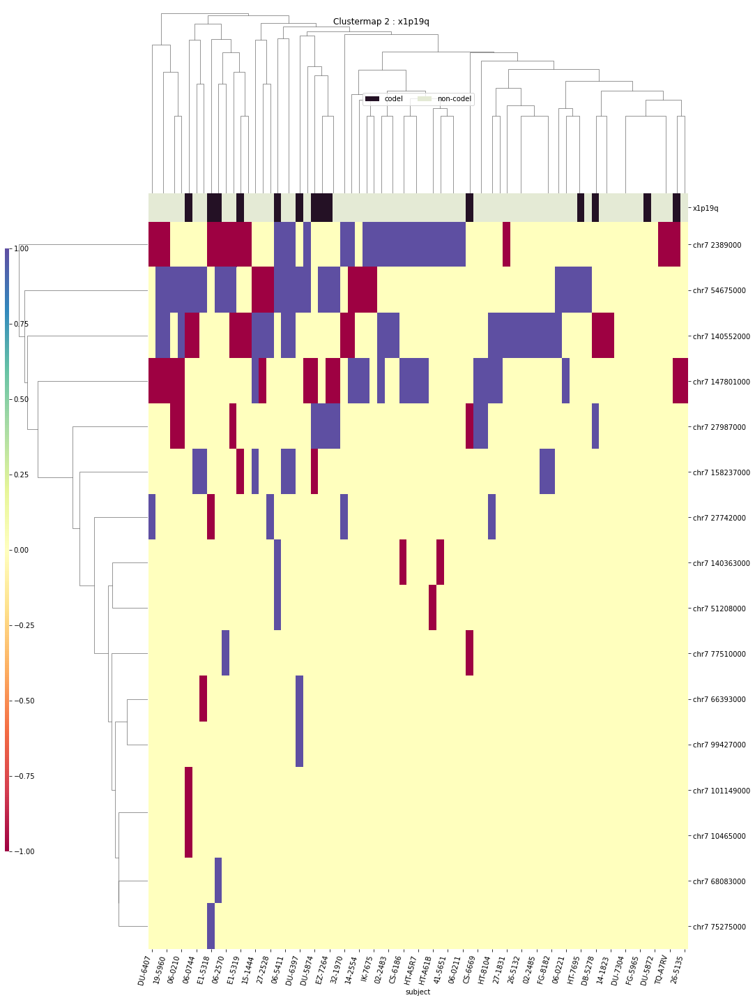

TERT
['TERT' 'chr7 105149000' 'chr7 108671000' 'chr7 123781000'
 'chr7 132985000' 'chr7 153314000' 'chr7 158657000' 'chr7 2533000'
 'chr7 32754000' 'chr7 37293000' 'chr7 4582000' 'chr7 4624000'
 'chr7 47989000' 'chr7 54675000' 'chr7 65033000' 'chr7 73836000'
 'chr7 92544000' 'chr7 99887000' 'subject']


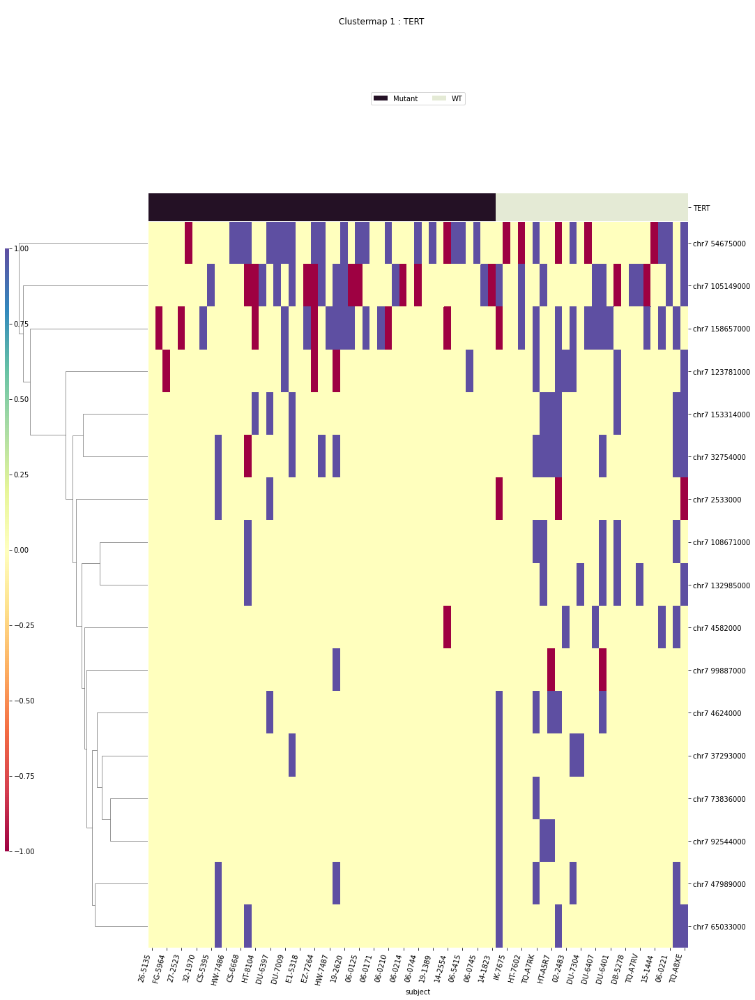

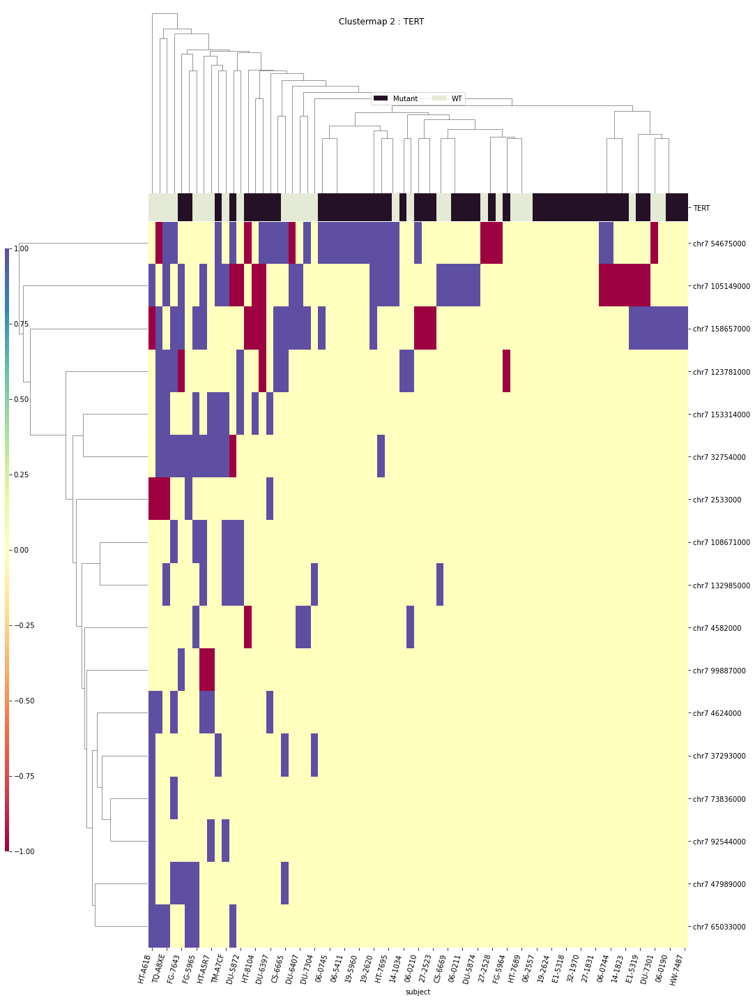

disease_type
['chr7 102839000' 'chr7 105149000' 'chr7 108671000' 'chr7 113341000'
 'chr7 119100000' 'chr7 126168000' 'chr7 13103000' 'chr7 132985000'
 'chr7 140552000' 'chr7 153314000' 'chr7 2390000' 'chr7 26148000'
 'chr7 32754000' 'chr7 37293000' 'chr7 4624000' 'chr7 47989000'
 'chr7 55942000' 'chr7 65033000' 'chr7 65243000' 'chr7 66004000'
 'chr7 66877000' 'chr7 79750000' 'disease_type' 'subject']


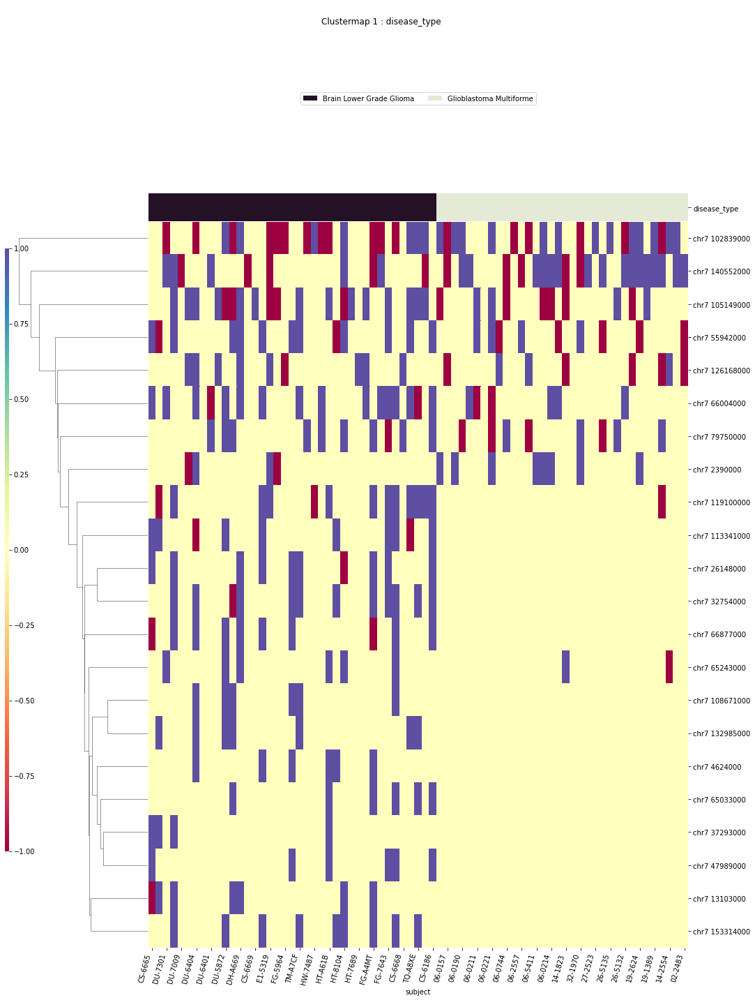

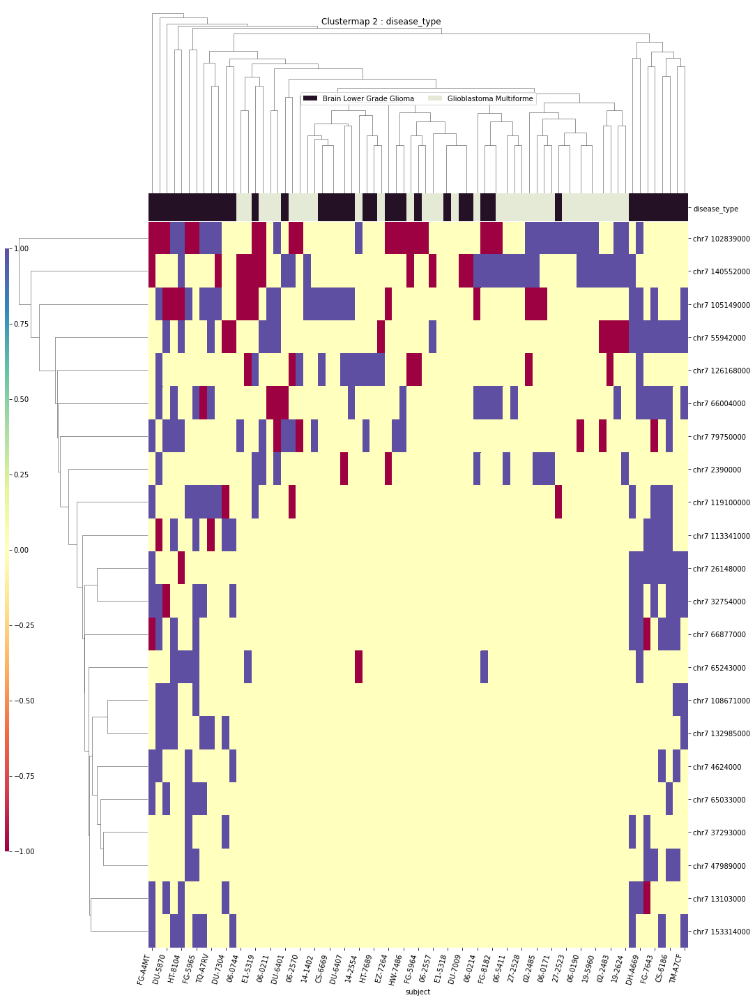

chr8
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr8 39650000


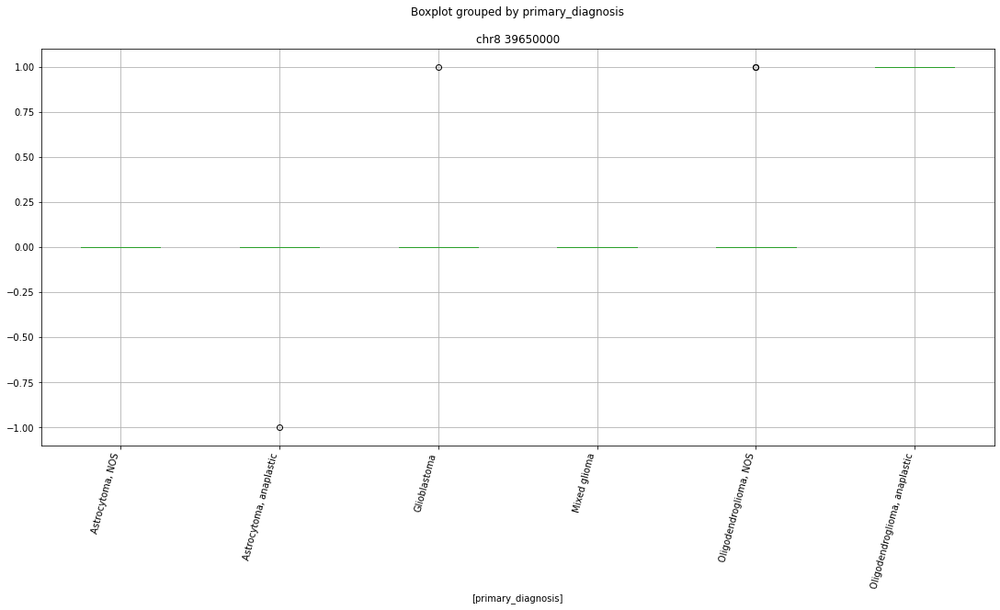

 p : 0.0  ( t : inf ) :  chr8 127630000


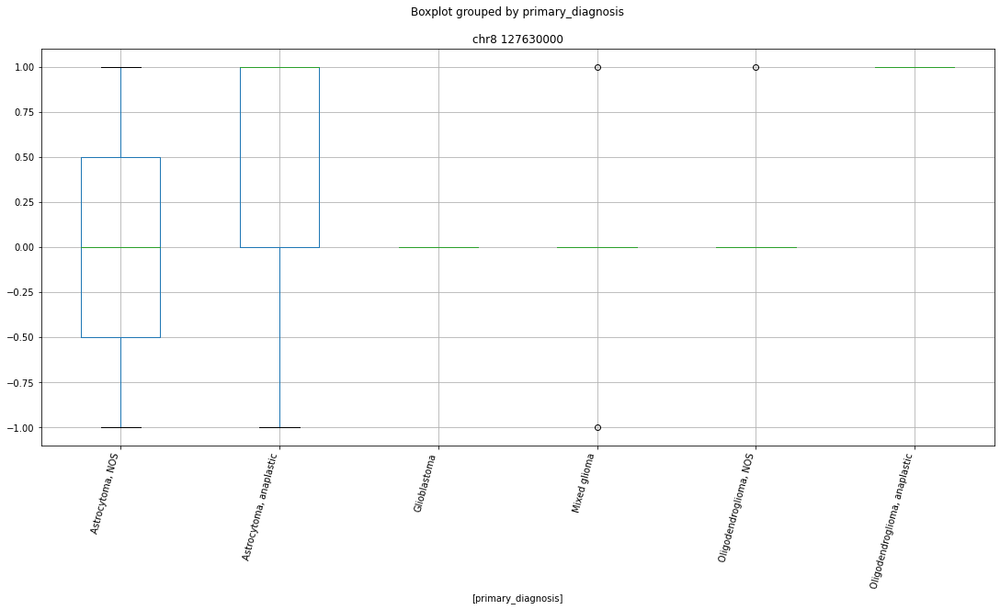

 p : 0.0  ( t : inf ) :  chr8 57071000


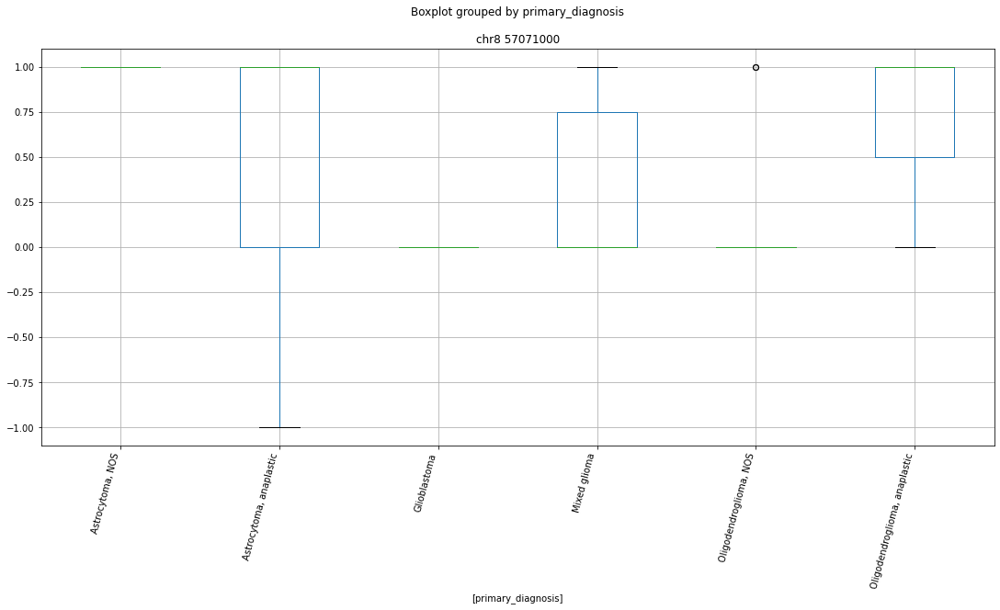

 p : 0.0  ( t : inf ) :  chr8 5725000


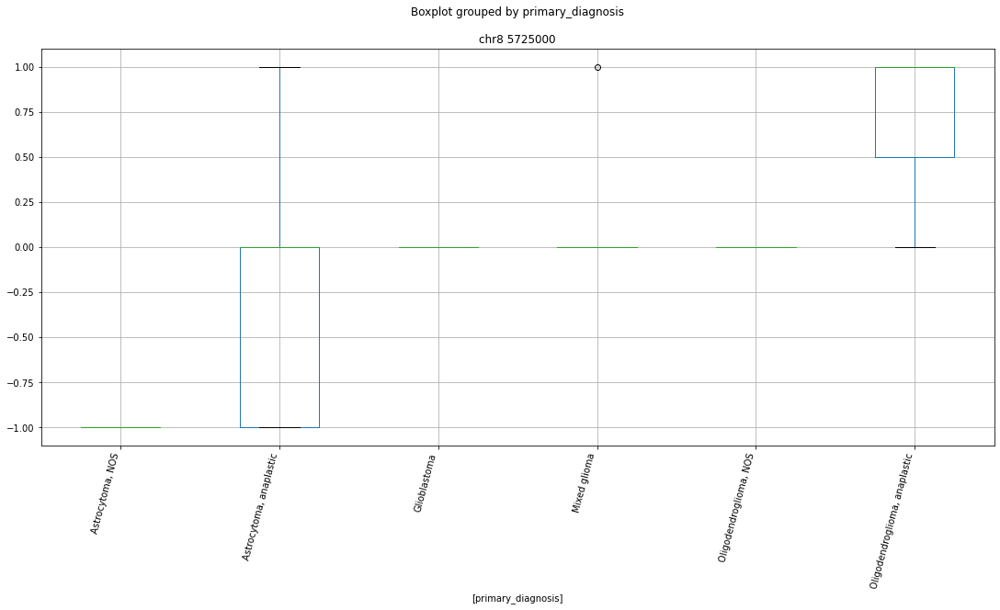

 p : 0.0  ( t : inf ) :  chr8 39651000


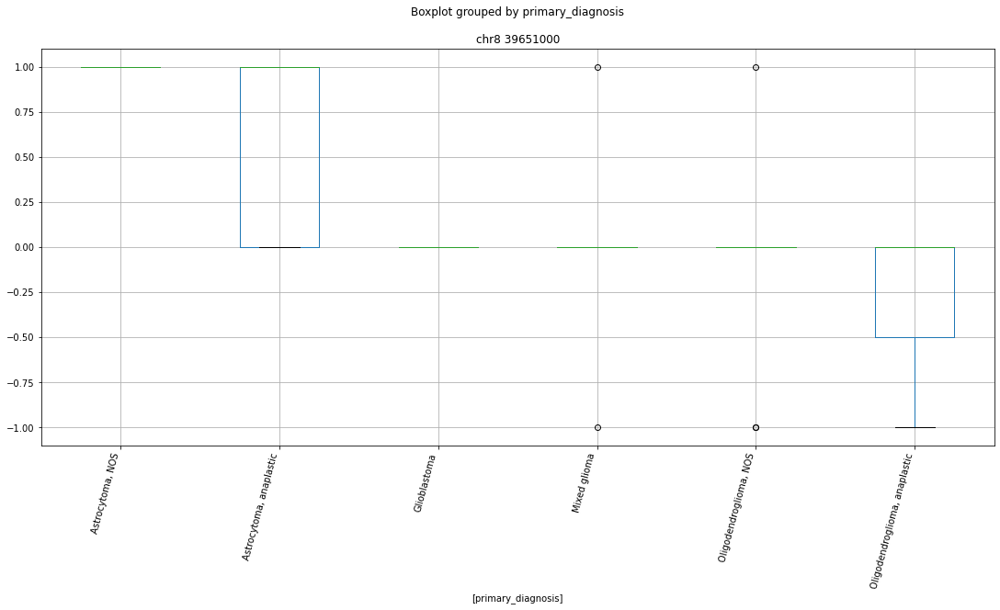

 p : 0.0  ( t : inf ) :  chr8 143068000


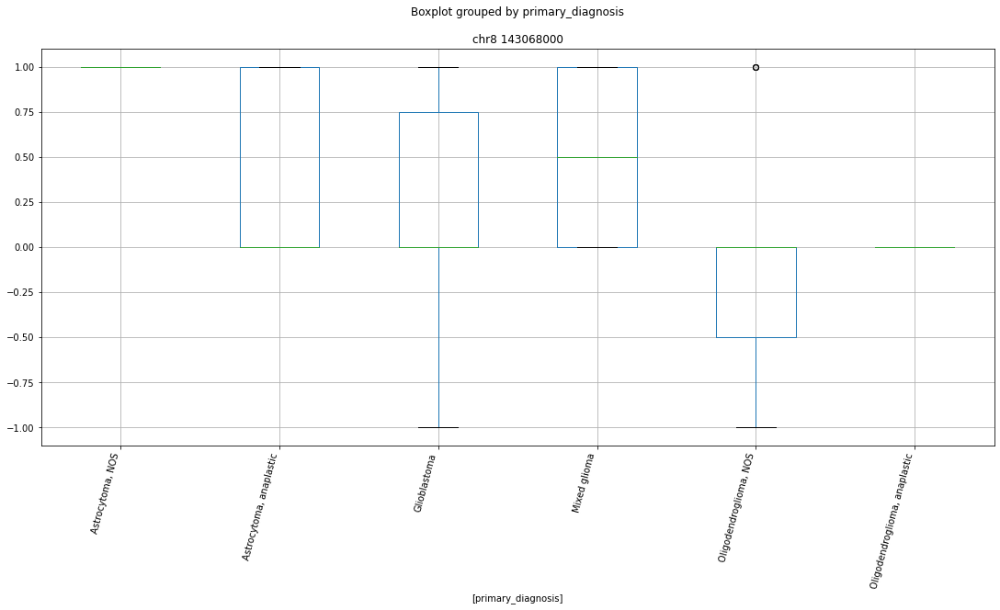

 p : 0.0  ( t : inf ) :  chr8 143287000


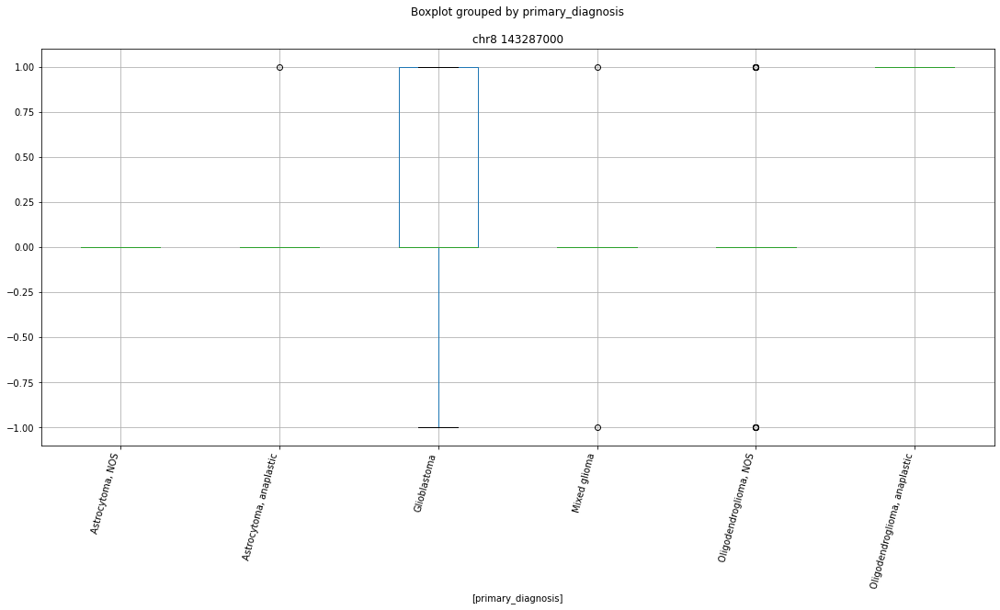

 p : 1.9864071913231304e-11  ( t : 9.677223188944682 ) :  chr8 39650000


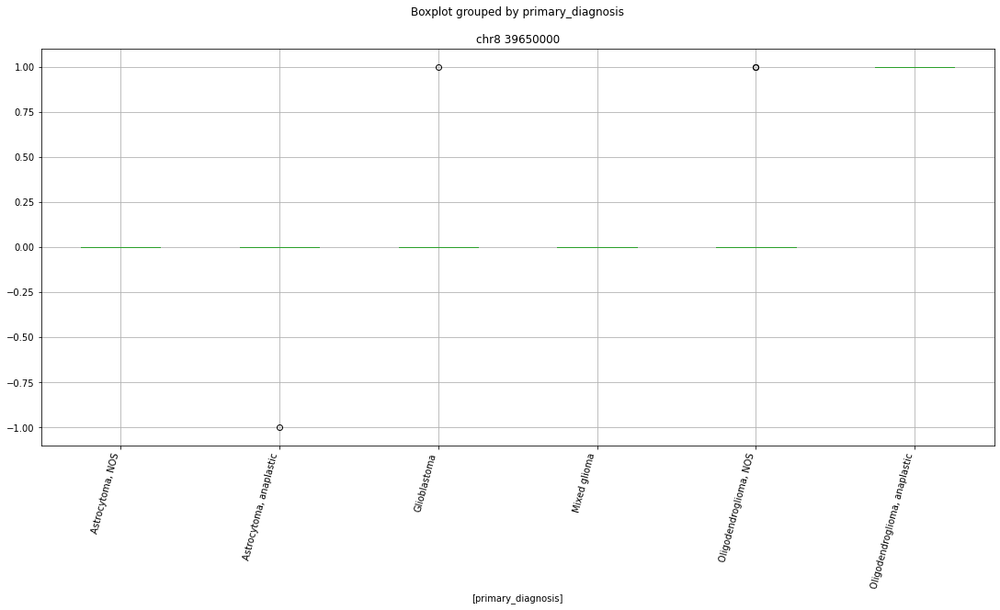

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr8 37928000


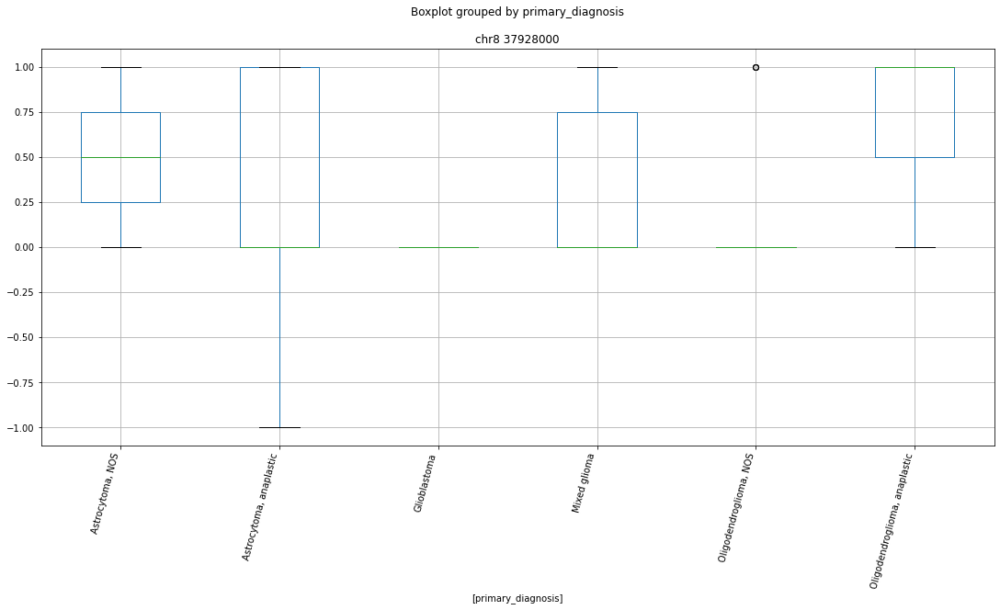

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr8 128118000


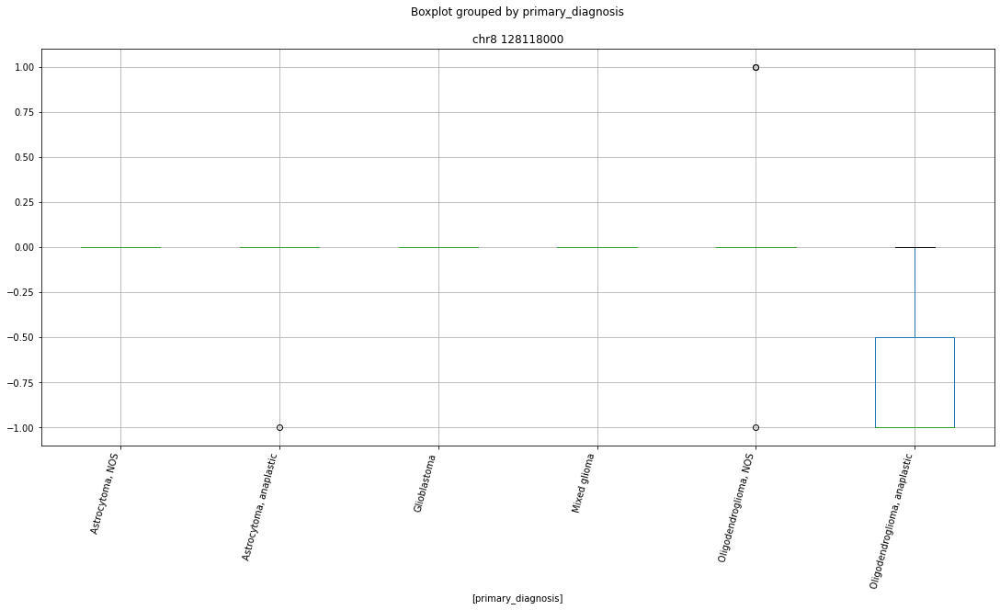

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr8 42939000


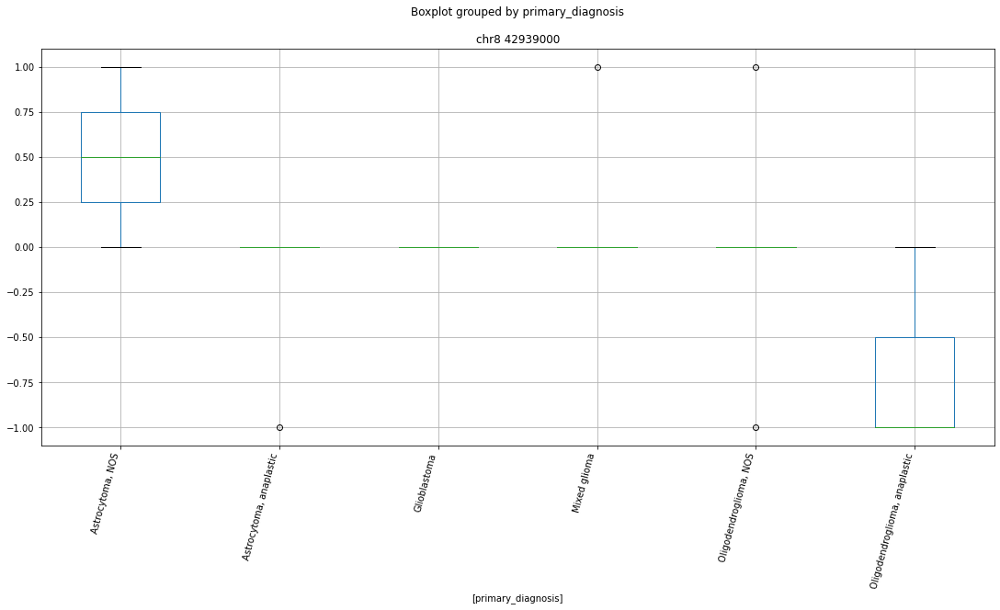

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr8 57071000


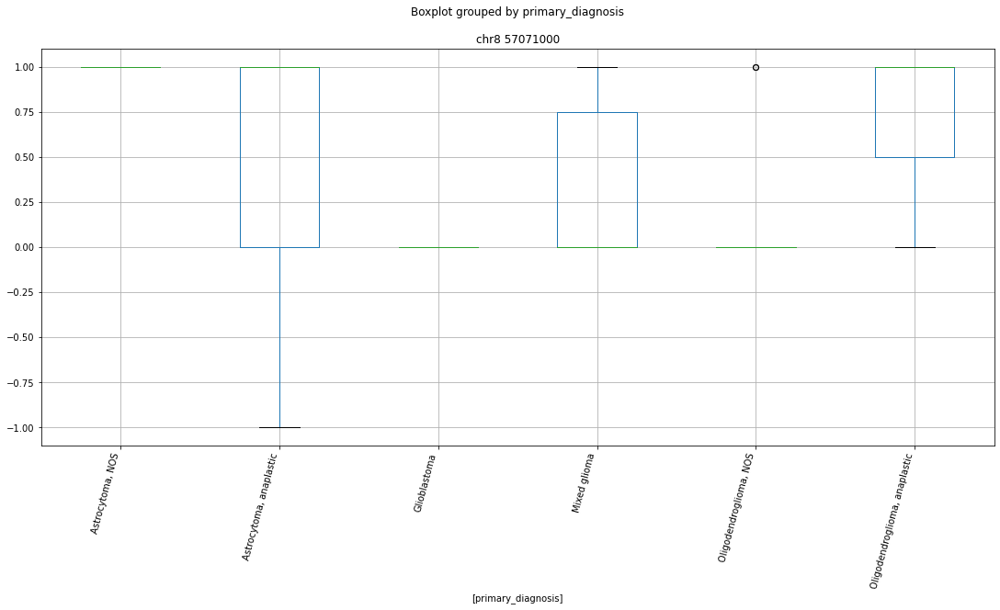

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr8 58676000


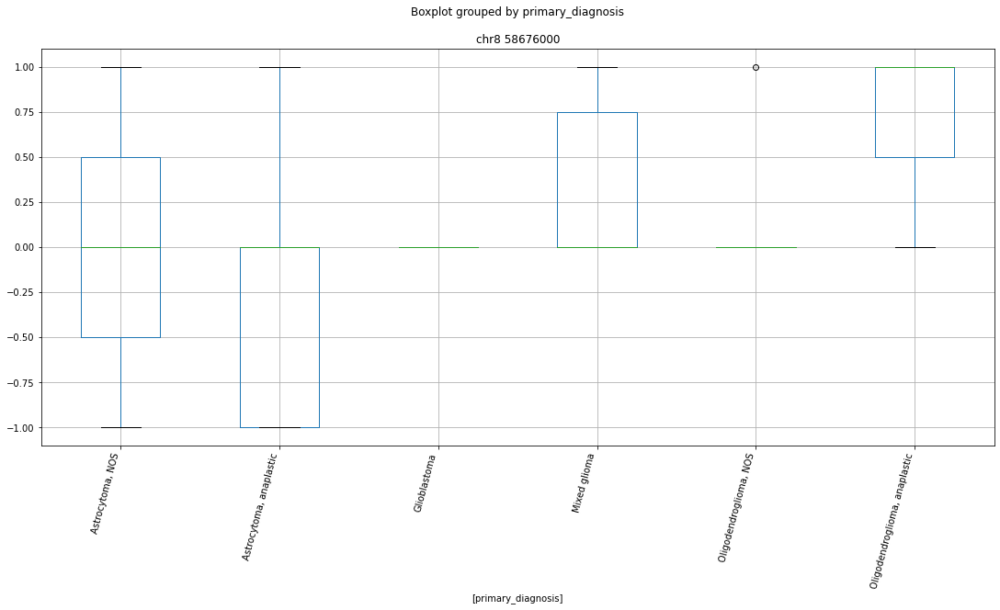

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr8 5725000


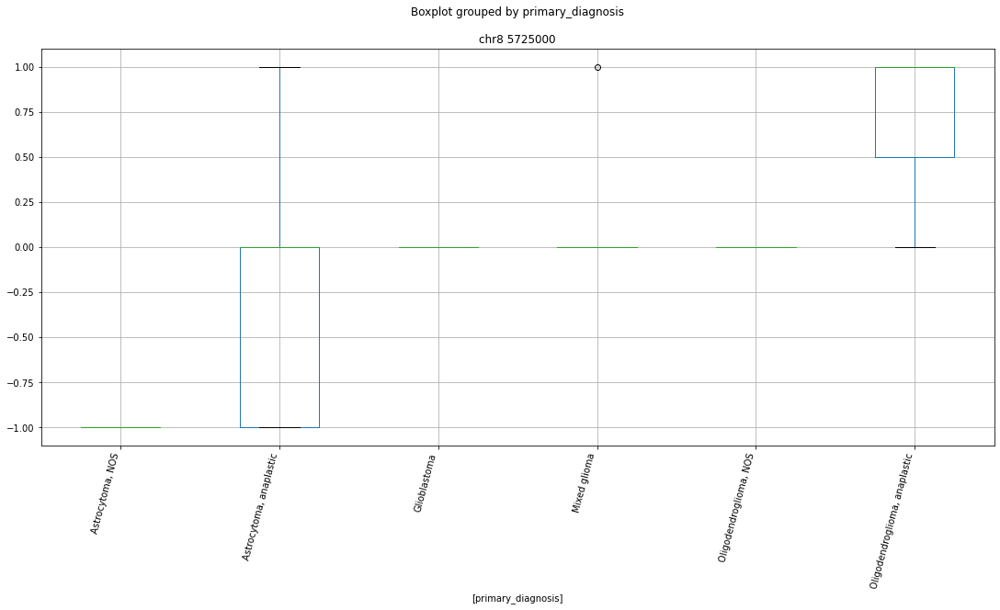

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr8 39651000


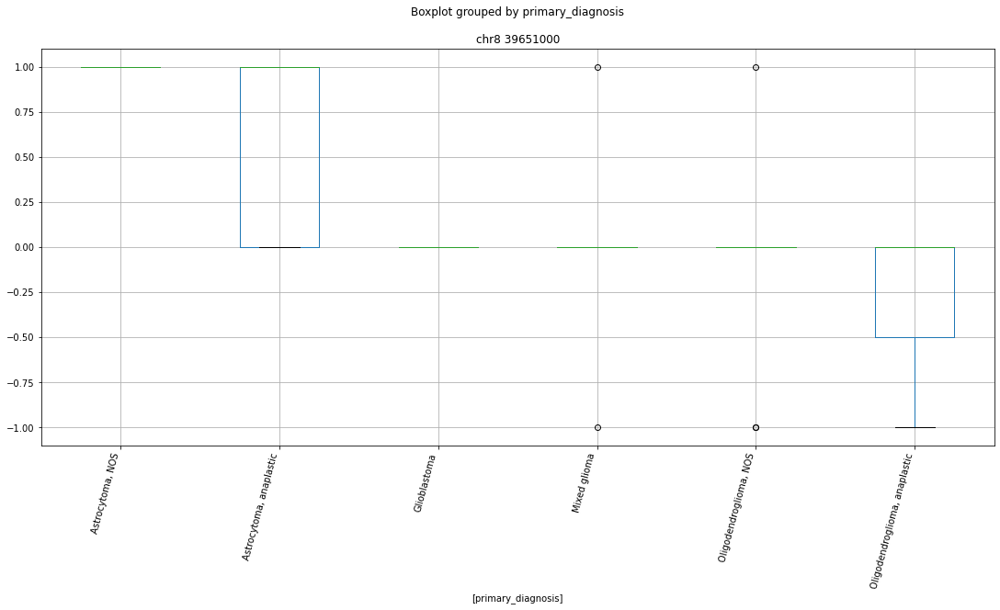

 p : 4.8673695437126455e-08  ( t : 7.805323627055891 ) :  chr8 127630000


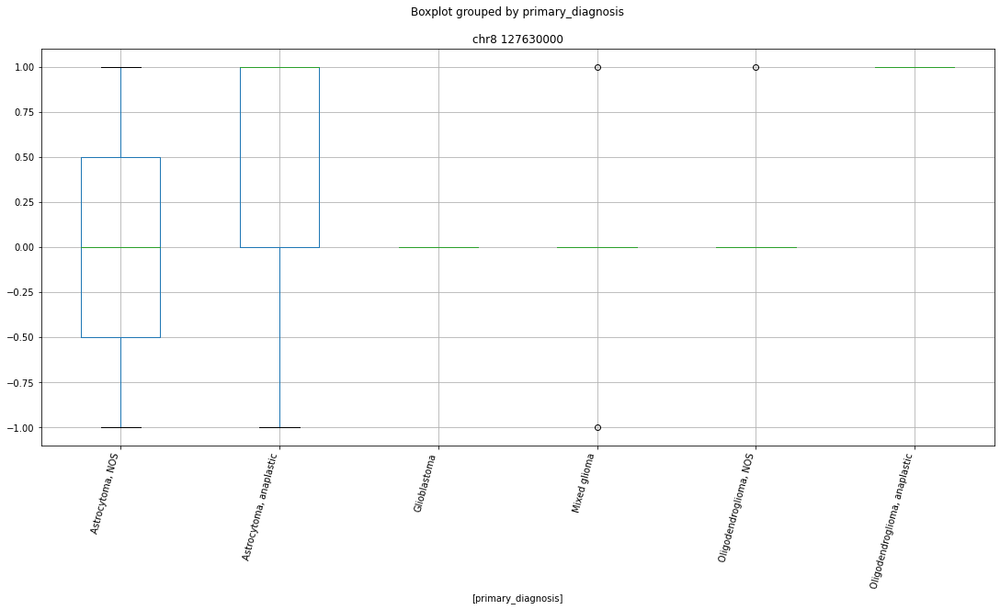

['chr8 100351000' 'chr8 100891000' 'chr8 112772000' 'chr8 119917000'
 'chr8 12027000' 'chr8 121656000' 'chr8 123316000' 'chr8 124431000'
 'chr8 12567000' 'chr8 127630000' 'chr8 128118000' 'chr8 129541000'
 'chr8 130922000' 'chr8 141201000' 'chr8 142829000' 'chr8 143001000'
 'chr8 143067000' 'chr8 143068000' 'chr8 143287000' 'chr8 143849000'
 'chr8 144146000' 'chr8 144231000' 'chr8 144410000' 'chr8 253000'
 'chr8 30118000' 'chr8 30246000' 'chr8 33657000' 'chr8 34895000'
 'chr8 35433000' 'chr8 37193000' 'chr8 37928000' 'chr8 38133000'
 'chr8 39646000' 'chr8 39650000' 'chr8 39651000' 'chr8 41014000'
 'chr8 41626000' 'chr8 42939000' 'chr8 43032000' 'chr8 43179000'
 'chr8 43419000' 'chr8 46430000' 'chr8 46439000' 'chr8 51159000'
 'chr8 51535000' 'chr8 52572000' 'chr8 54031000' 'chr8 56104000'
 'chr8 56271000' 'chr8 57022000' 'chr8 57071000' 'chr8 57200000'
 'chr8 5725000' 'chr8 58676000' 'chr8 58776000' 'chr8 60547000'
 'chr8 63179000' 'chr8 65663000' 'chr8 66233000' 'chr8 66313000'
 'chr8 

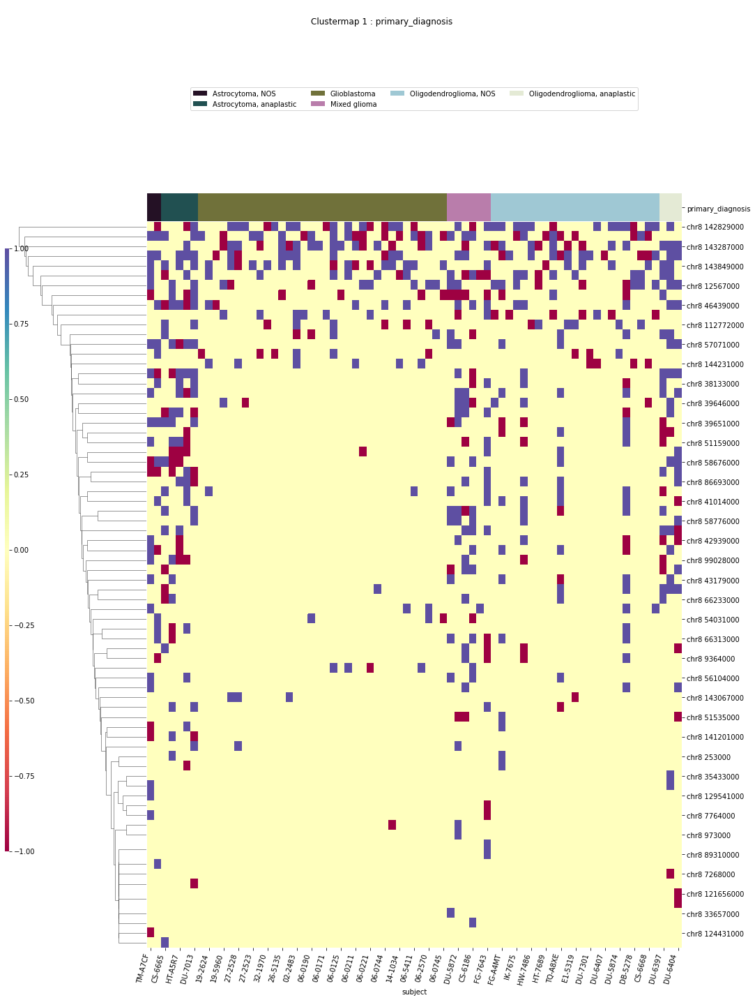

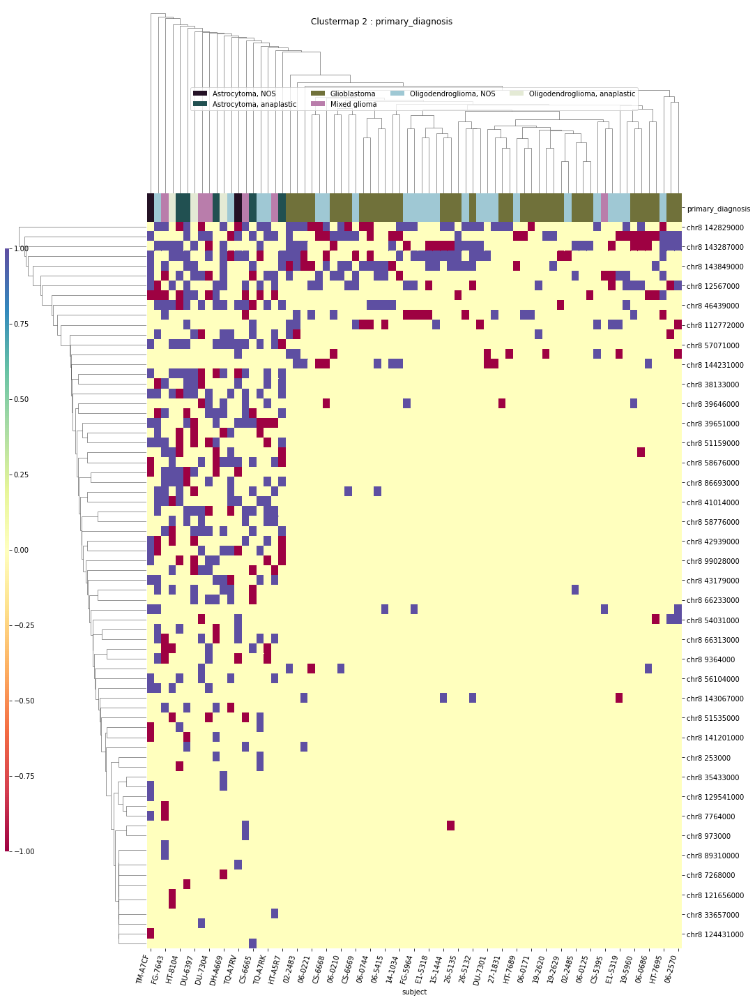

IDH
['IDH' 'chr8 143288000' 'chr8 143850000' 'chr8 144231000' 'chr8 30118000'
 'chr8 37928000' 'chr8 43179000' 'chr8 54126000' 'chr8 7507000' 'subject']


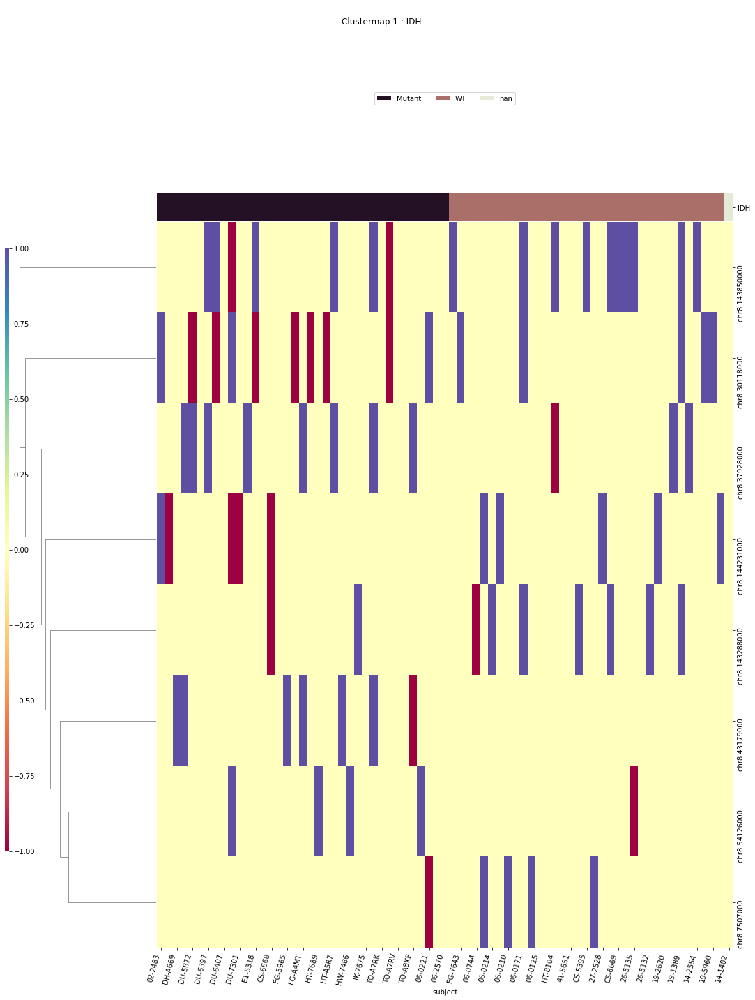

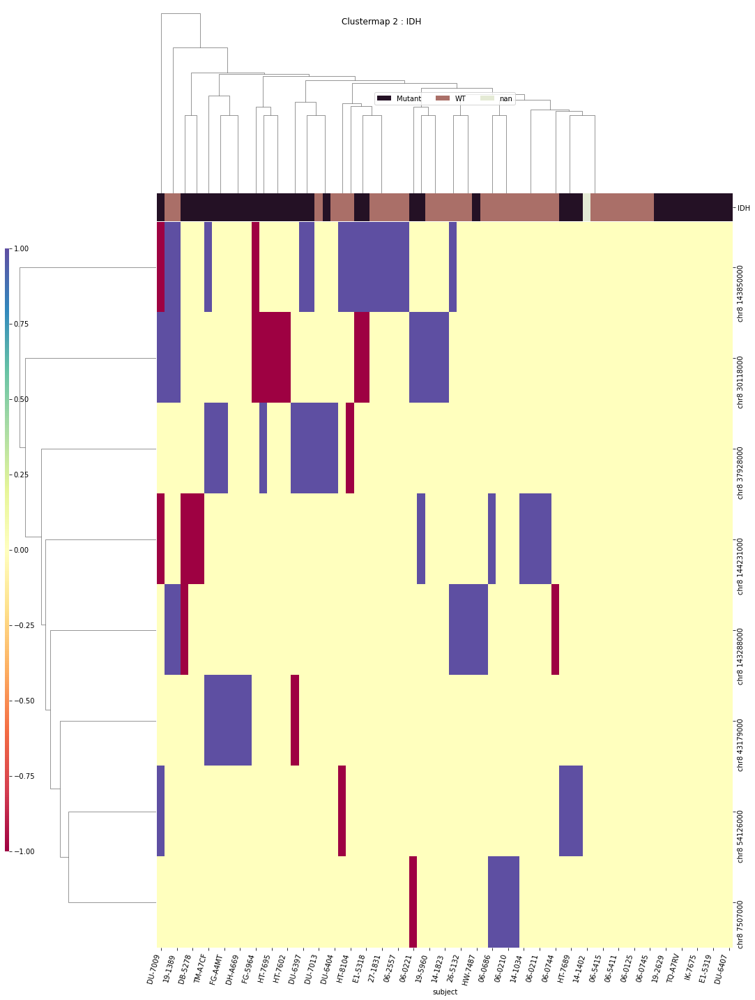

x1p19q
['chr8 143067000' 'chr8 144231000' 'chr8 144795000' 'chr8 149000'
 'chr8 35433000' 'chr8 39650000' 'chr8 42939000' 'chr8 7268000'
 'chr8 9657000' 'subject' 'x1p19q']


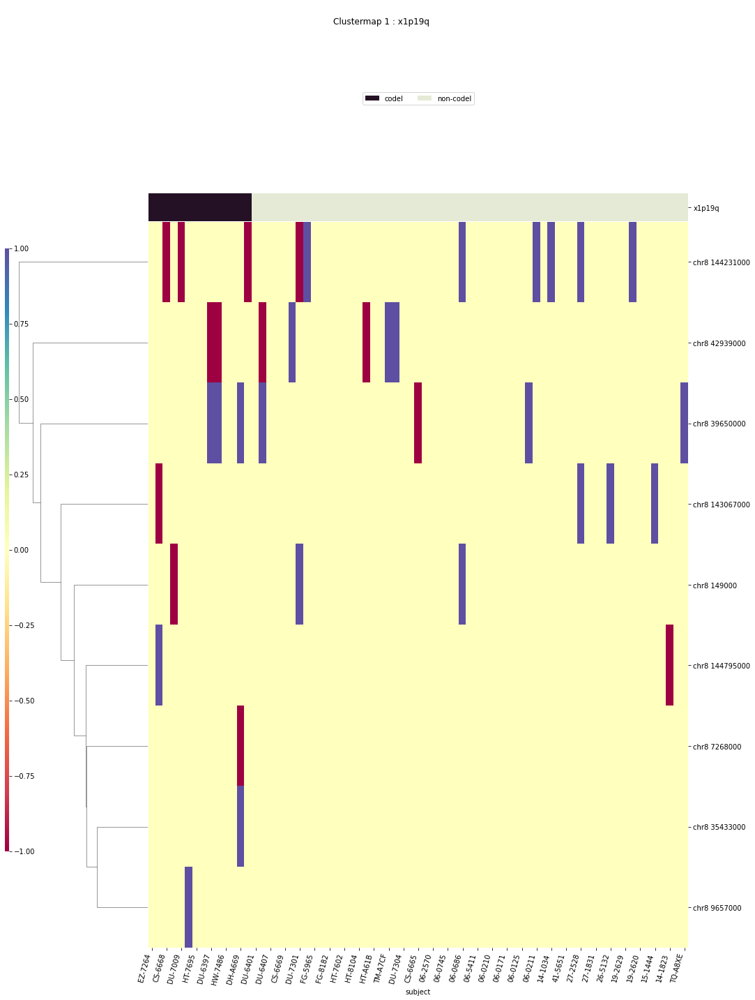

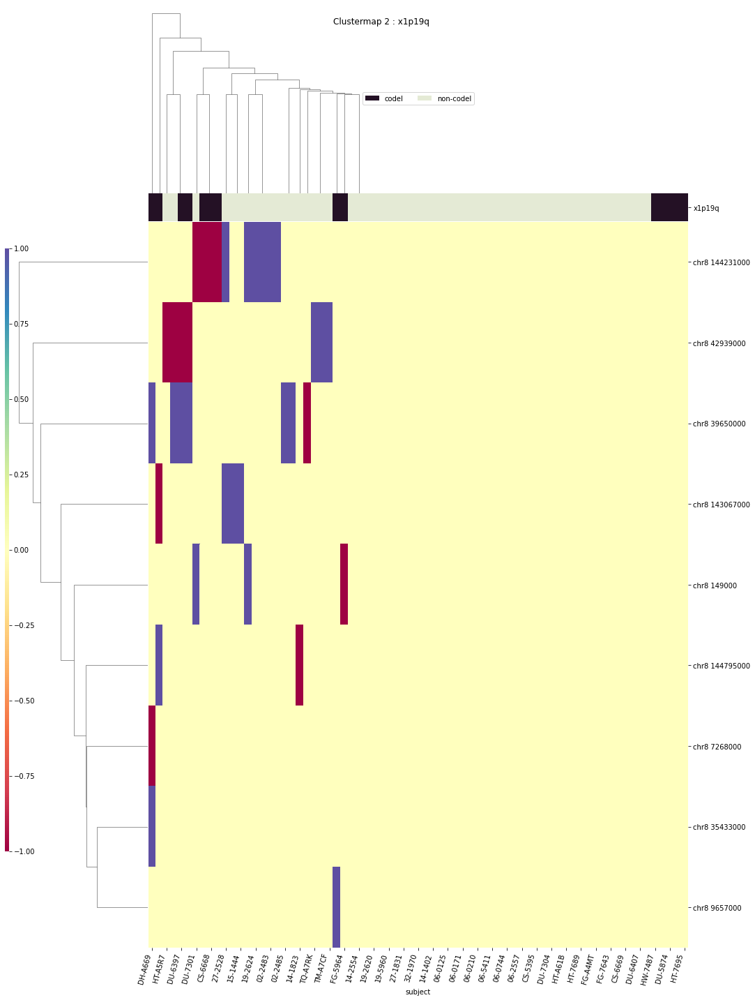

TERT
['TERT' 'chr8 12567000' 'chr8 253000' 'chr8 37928000' 'chr8 39646000'
 'chr8 57071000' 'chr8 57199000' 'chr8 58776000' 'chr8 65663000'
 'chr8 7507000' 'chr8 86693000' 'subject']


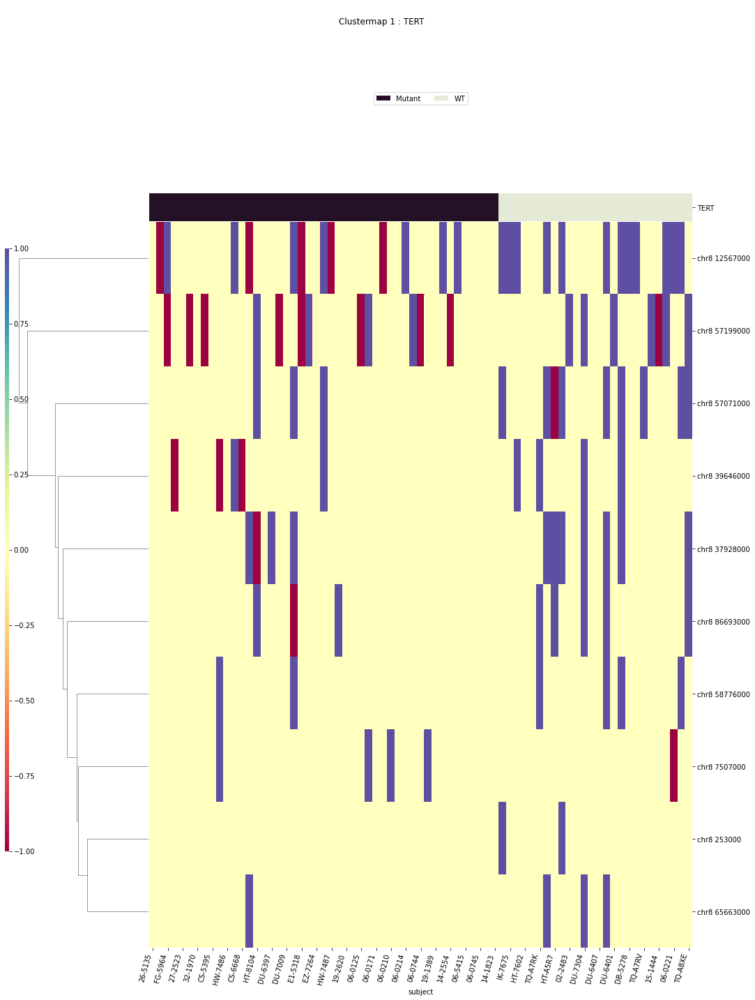

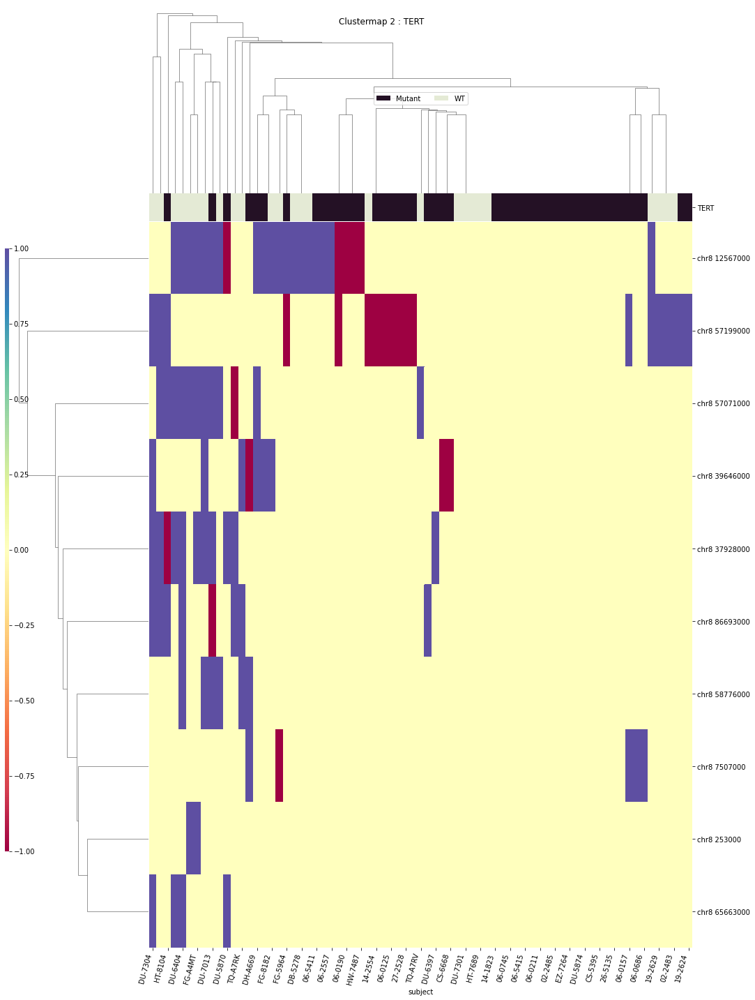

disease_type
['chr8 112772000' 'chr8 143067000' 'chr8 143288000' 'chr8 144231000'
 'chr8 18793000' 'chr8 30118000' 'chr8 37928000' 'chr8 41014000'
 'chr8 43179000' 'chr8 56104000' 'chr8 56271000' 'chr8 57071000'
 'chr8 58776000' 'chr8 60547000' 'chr8 65663000' 'chr8 86693000'
 'disease_type' 'subject']


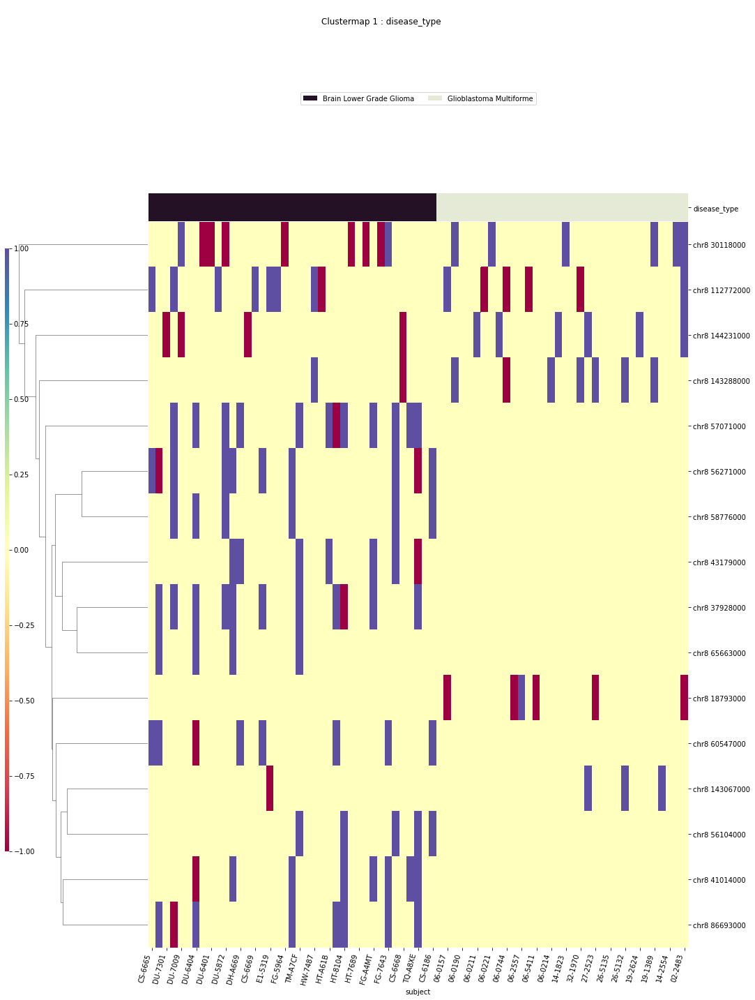

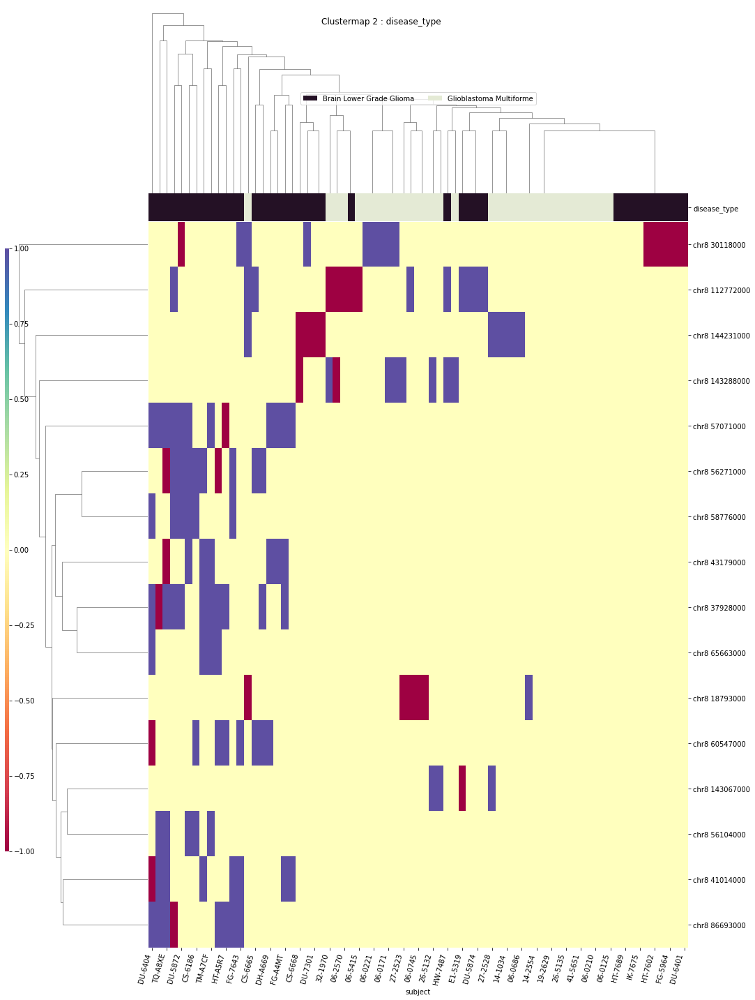

chr9
HERVK113
primary_diagnosis
 p : 0.0  ( t : inf ) :  chr9 34138000


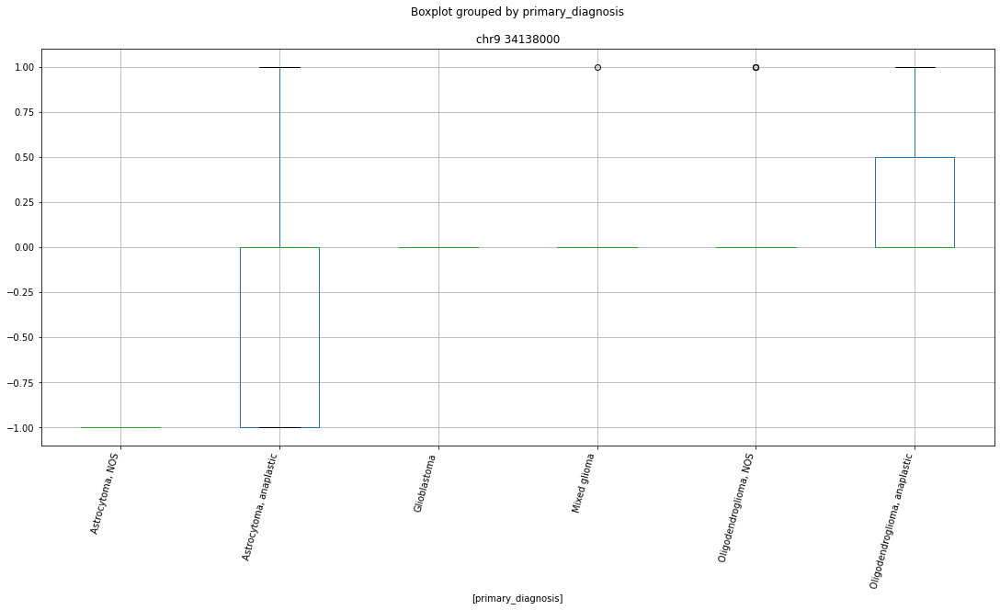

 p : 0.0  ( t : inf ) :  chr9 97232000


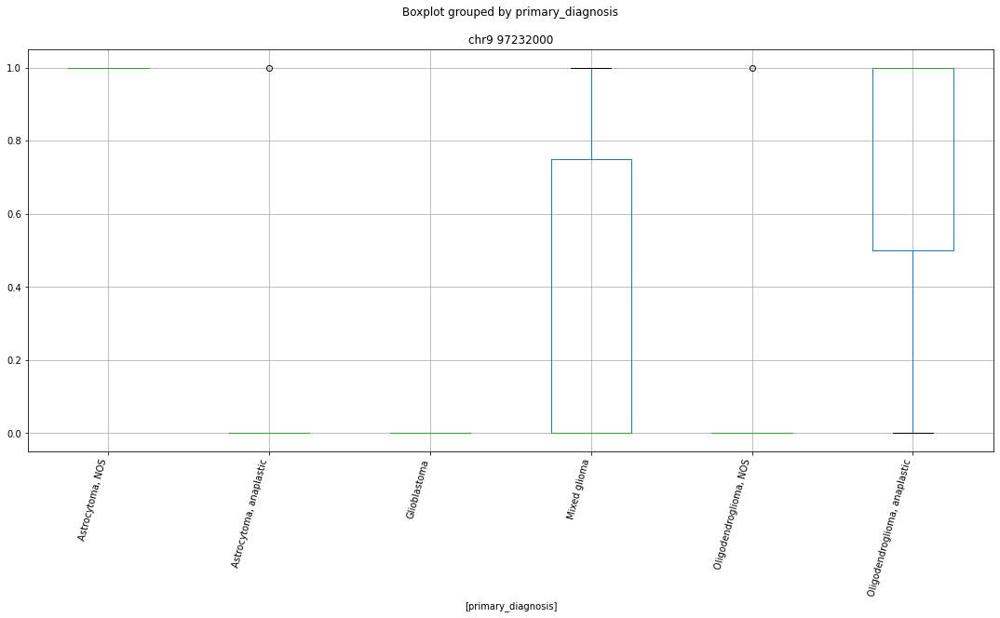

 p : 0.0  ( t : inf ) :  chr9 84367000


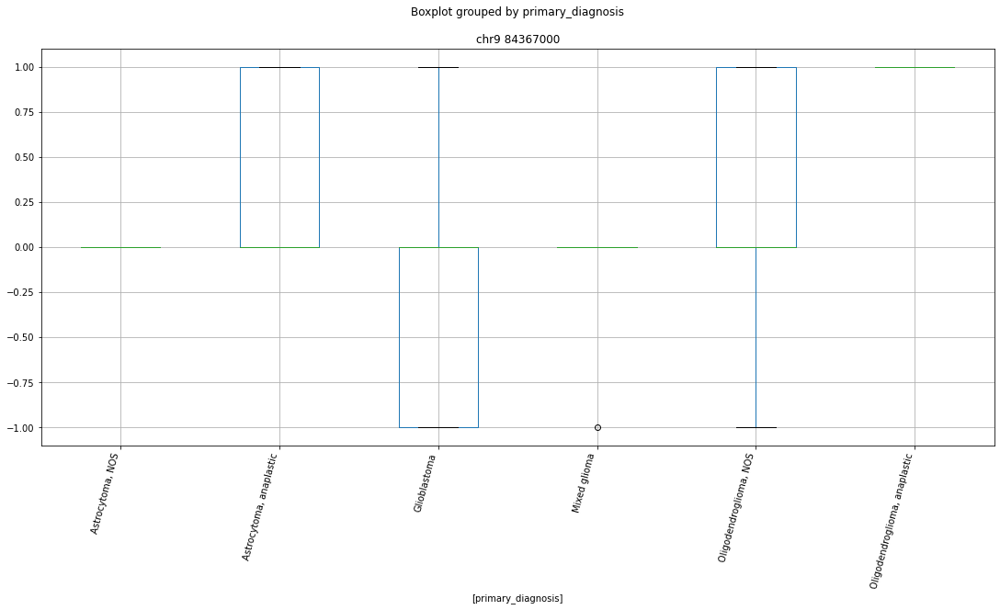

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chr9 29188000


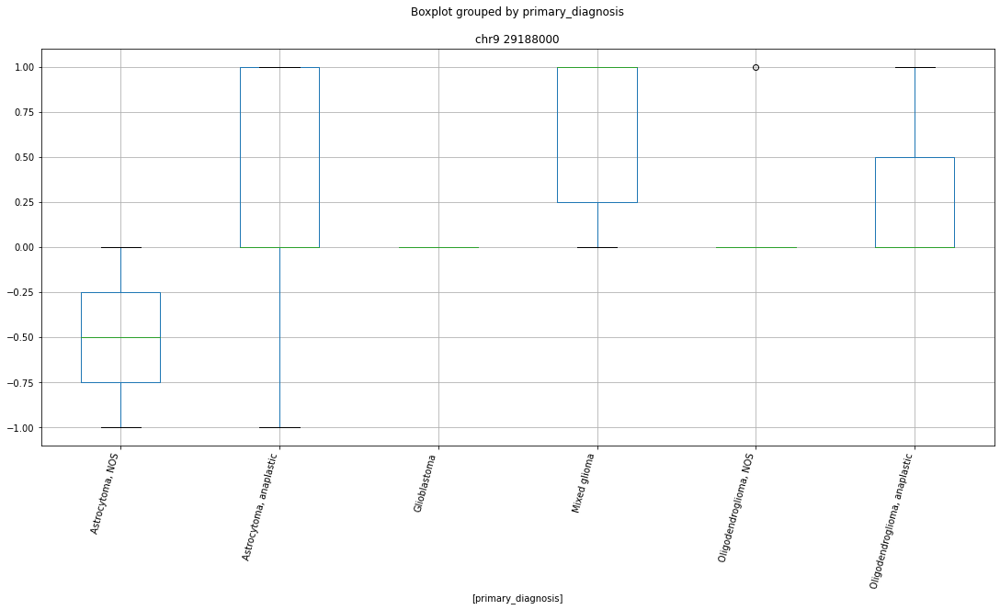

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr9 83000


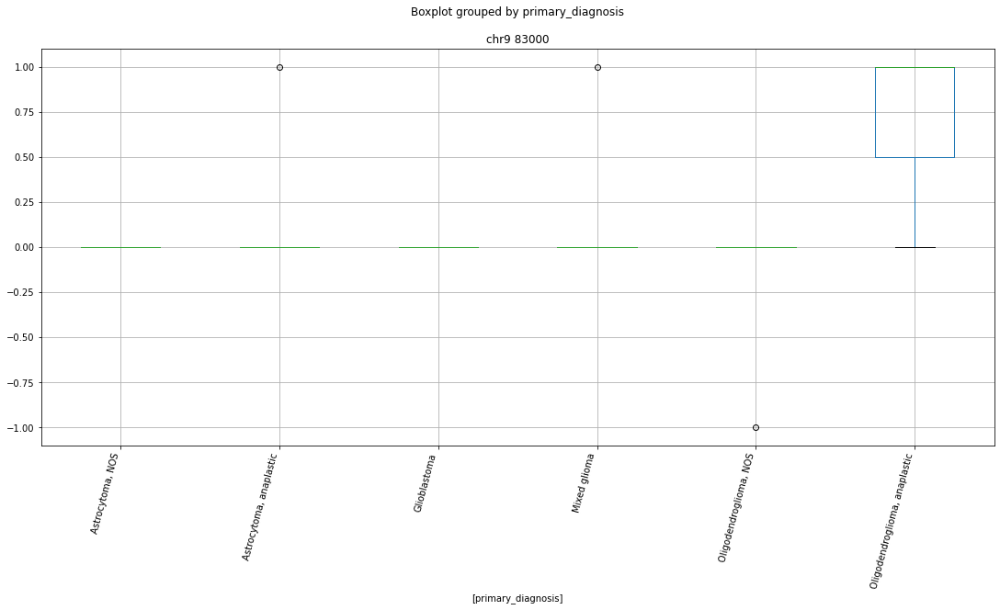

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr9 87758000


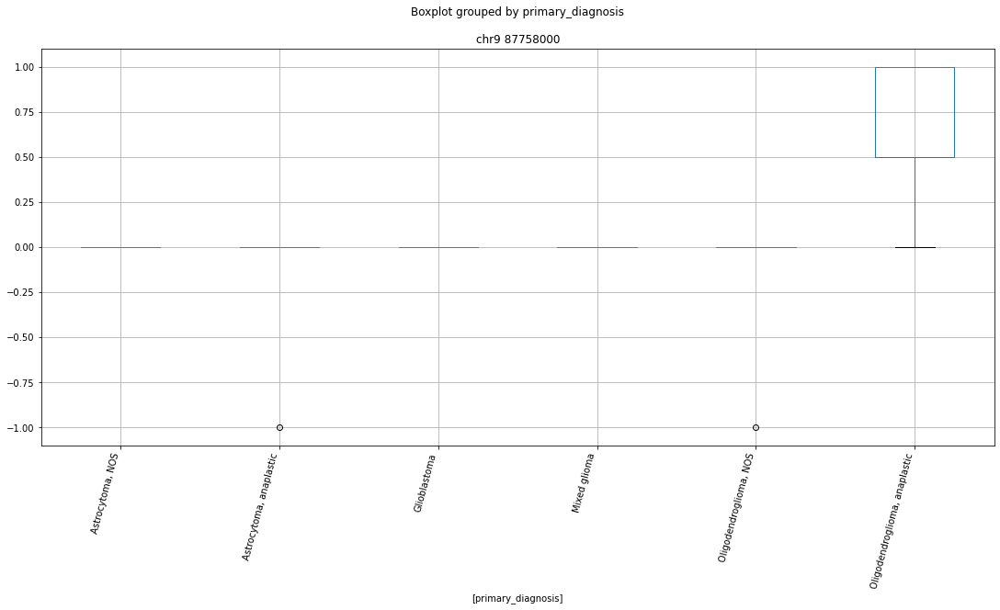

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr9 76955000


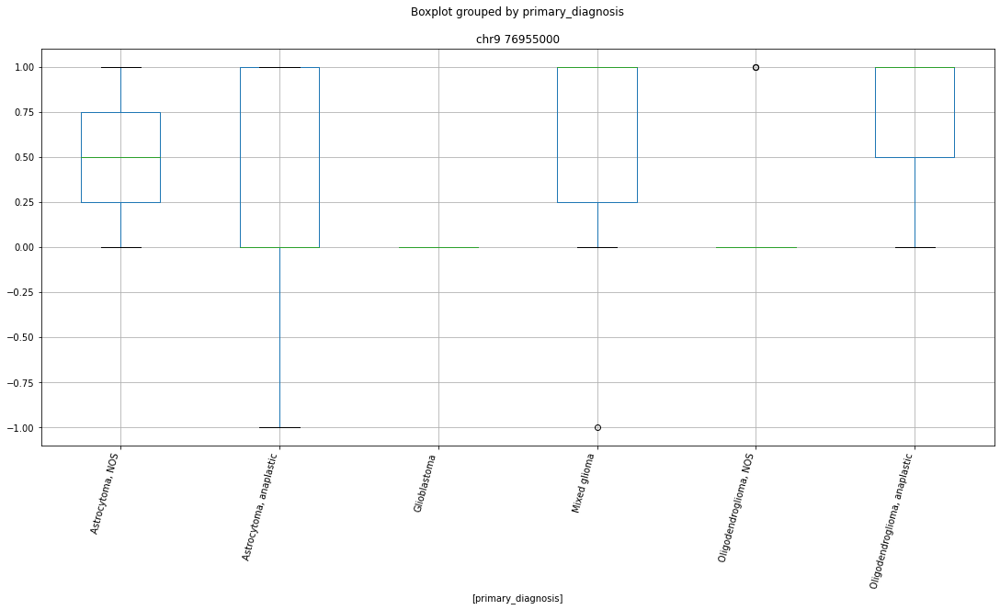

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr9 19433000


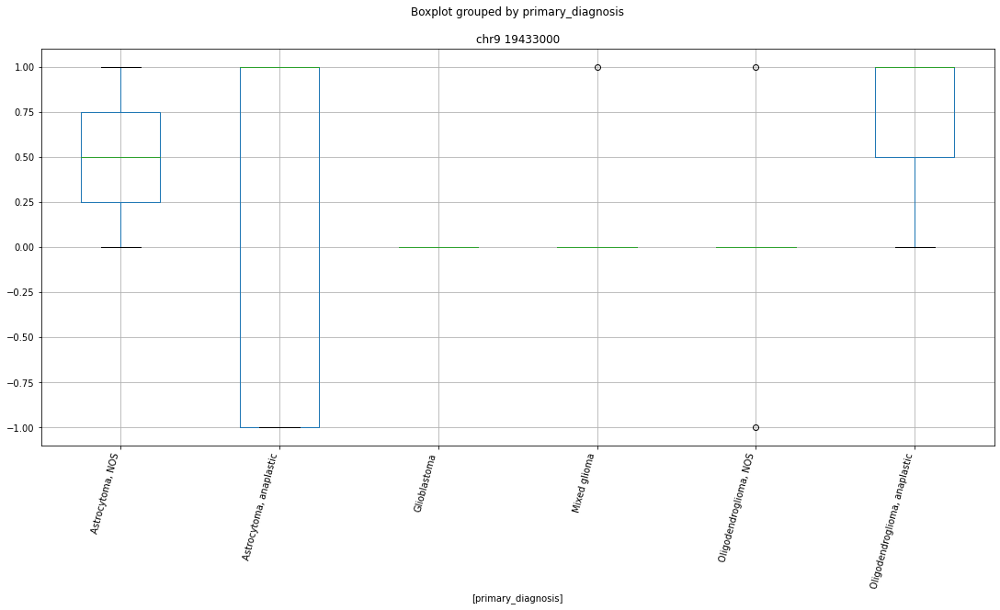

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chr9 97232000


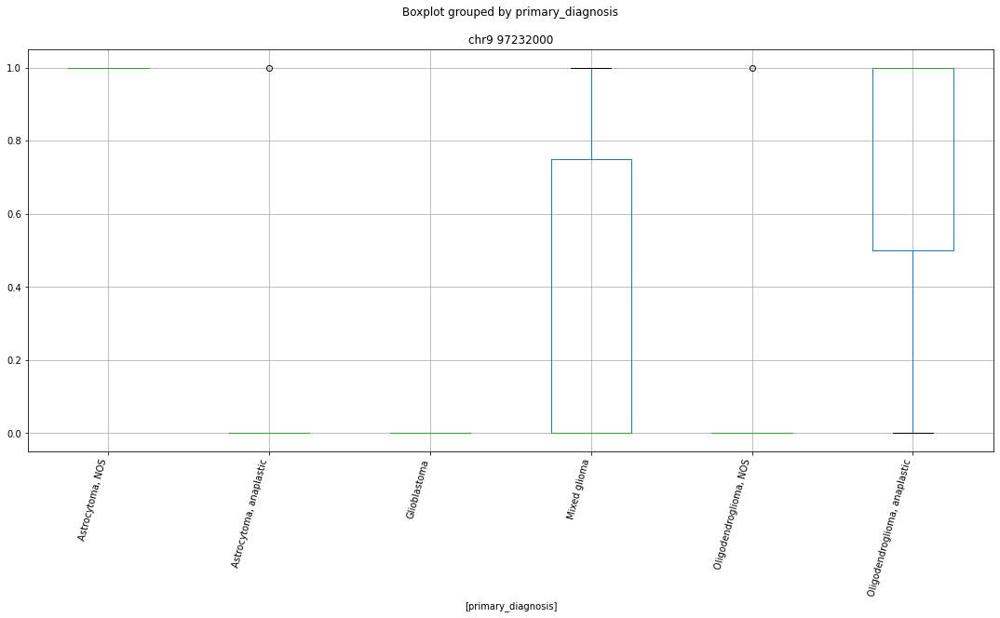

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr9 128780000


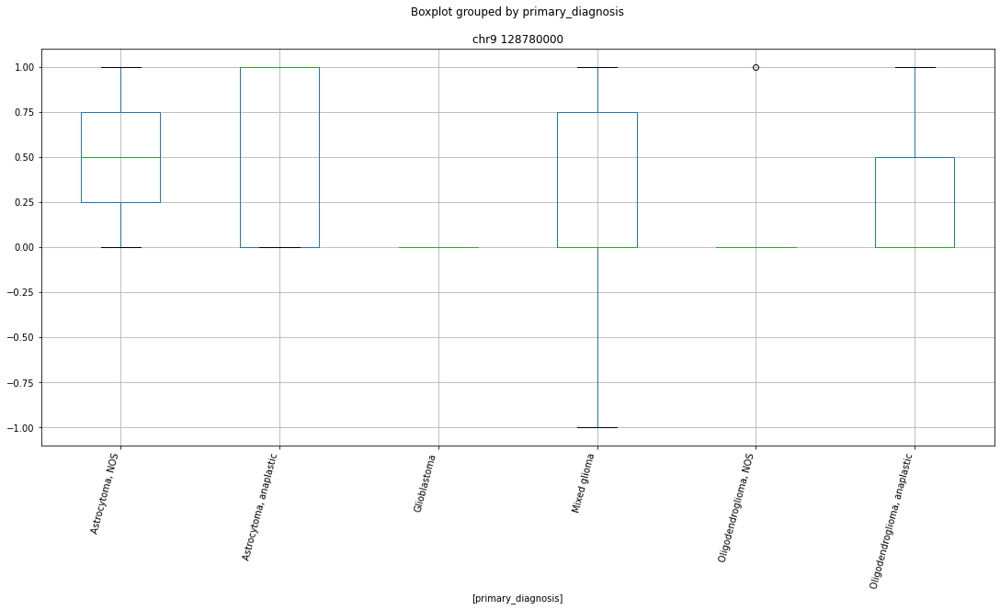

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chr9 77303000


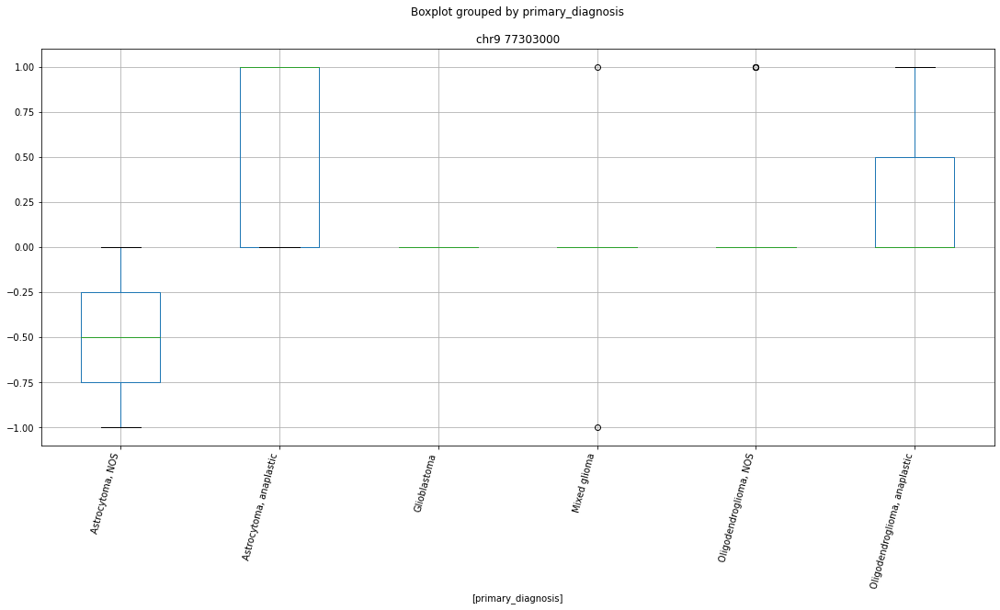

['chr9 100068000' 'chr9 107272000' 'chr9 108594000' 'chr9 110097000'
 'chr9 111875000' 'chr9 111876000' 'chr9 121430000' 'chr9 122868000'
 'chr9 123056000' 'chr9 125578000' 'chr9 128780000' 'chr9 131357000'
 'chr9 133283000' 'chr9 133300000' 'chr9 133745000' 'chr9 133958000'
 'chr9 134093000' 'chr9 134715000' 'chr9 136789000' 'chr9 138132000'
 'chr9 15234000' 'chr9 15407000' 'chr9 17446000' 'chr9 19433000'
 'chr9 26493000' 'chr9 29188000' 'chr9 31632000' 'chr9 31633000'
 'chr9 32950000' 'chr9 33423000' 'chr9 33601000' 'chr9 34138000'
 'chr9 38325000' 'chr9 5082000' 'chr9 63681000' 'chr9 63682000'
 'chr9 64478000' 'chr9 6623000' 'chr9 6798000' 'chr9 69104000'
 'chr9 69763000' 'chr9 73087000' 'chr9 73088000' 'chr9 74198000'
 'chr9 76955000' 'chr9 77060000' 'chr9 77303000' 'chr9 83000'
 'chr9 83948000' 'chr9 84367000' 'chr9 85574000' 'chr9 86312000'
 'chr9 87758000' 'chr9 87784000' 'chr9 87785000' 'chr9 88626000'
 'chr9 92227000' 'chr9 92830000' 'chr9 94710000' 'chr9 95269000'
 'chr9 9723

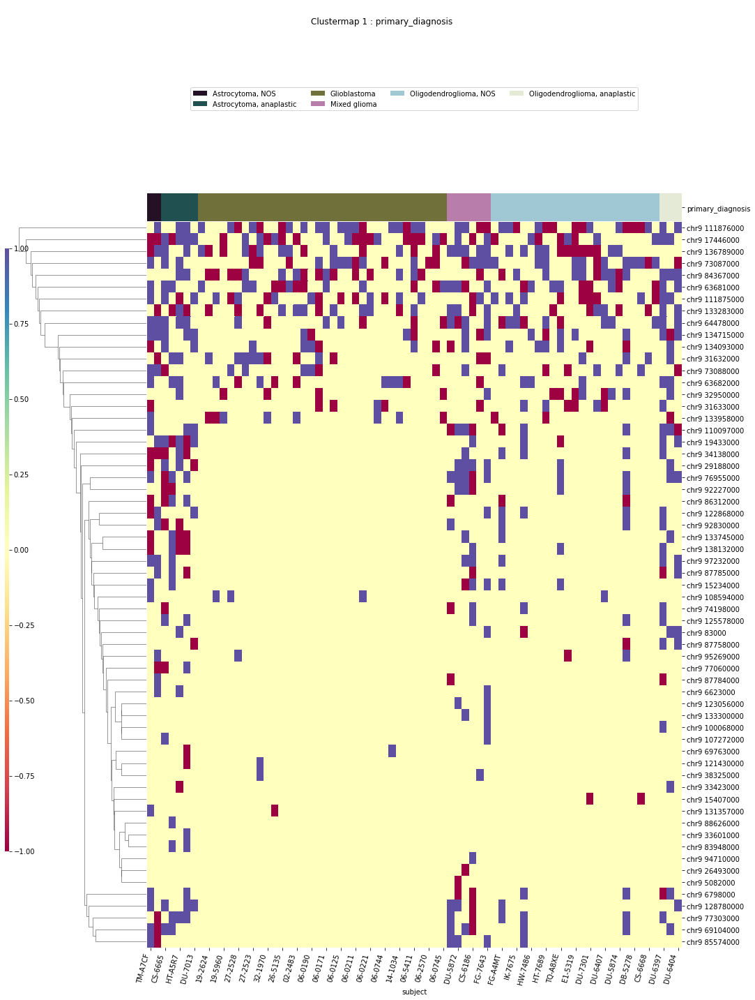

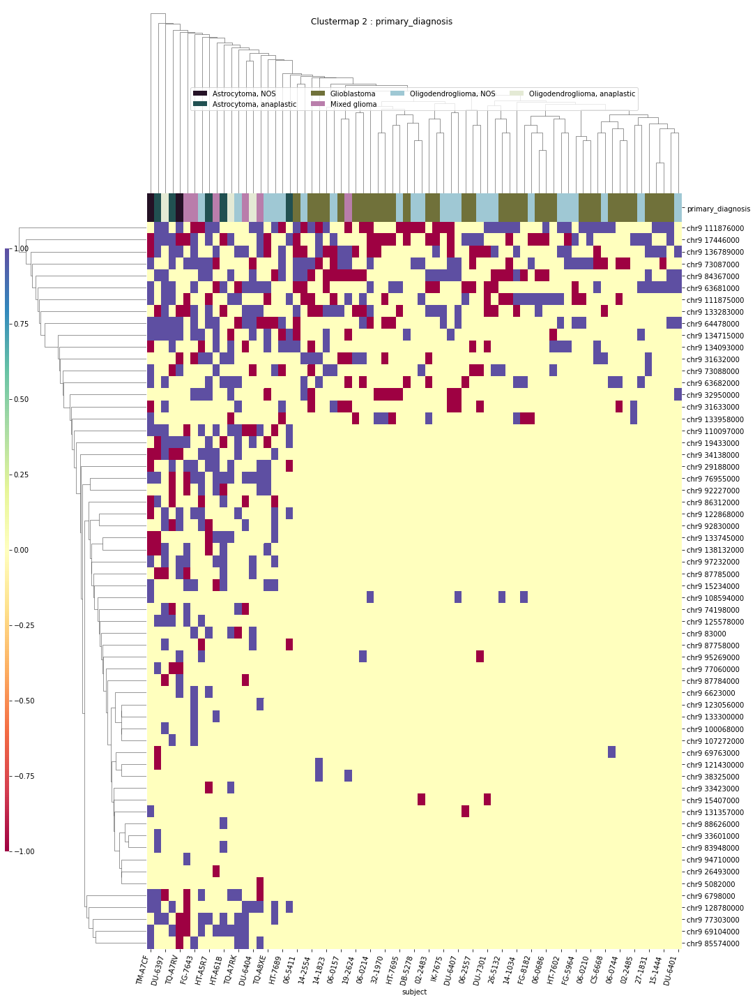

IDH
['IDH' 'chr9 121971000' 'chr9 42965000' 'chr9 63682000' 'chr9 69104000'
 'chr9 77060000' 'chr9 77303000' 'chr9 86312000' 'subject']


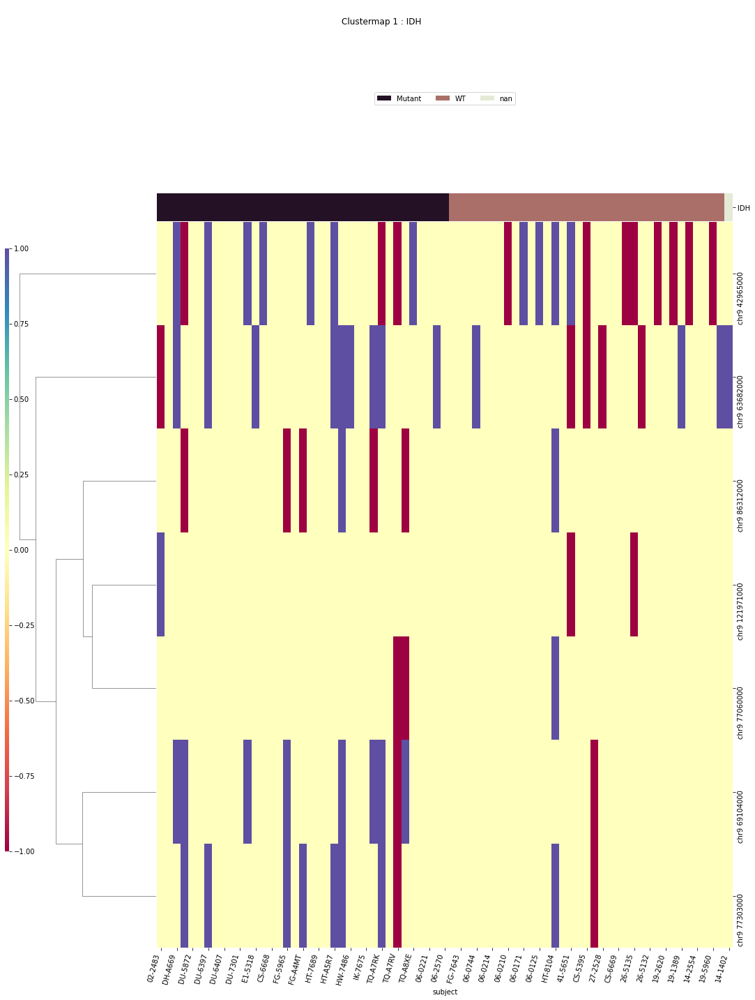

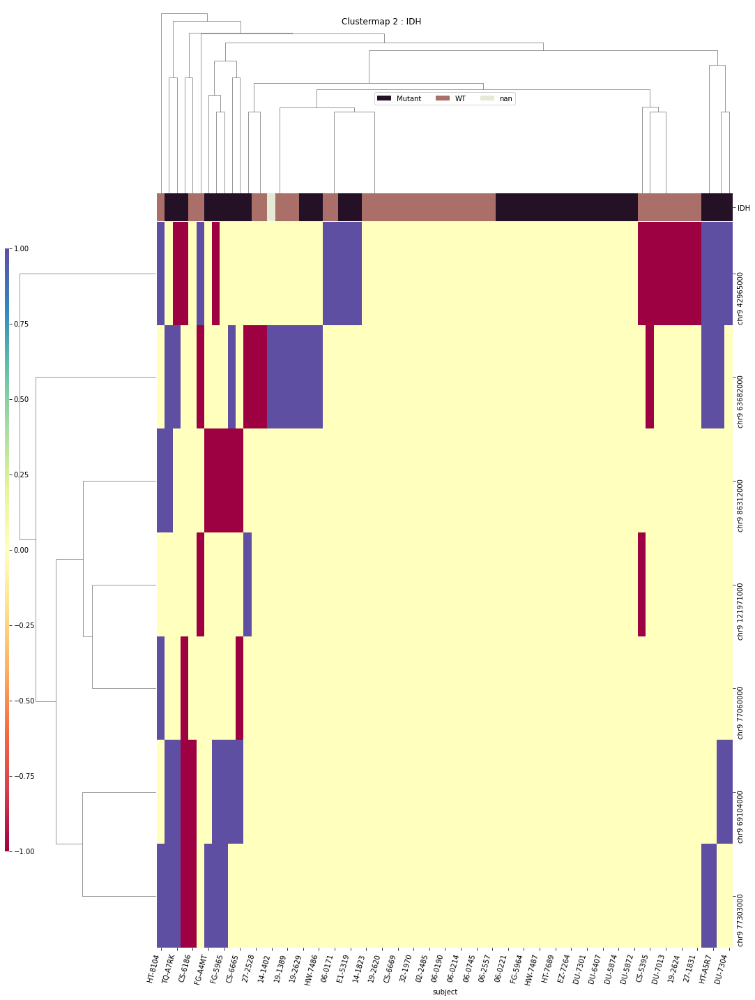

x1p19q
['chr9 112515000' 'chr9 125328000' 'chr9 137117000' 'chr9 31632000'
 'chr9 33423000' 'chr9 33514000' 'chr9 98890000' 'subject' 'x1p19q']


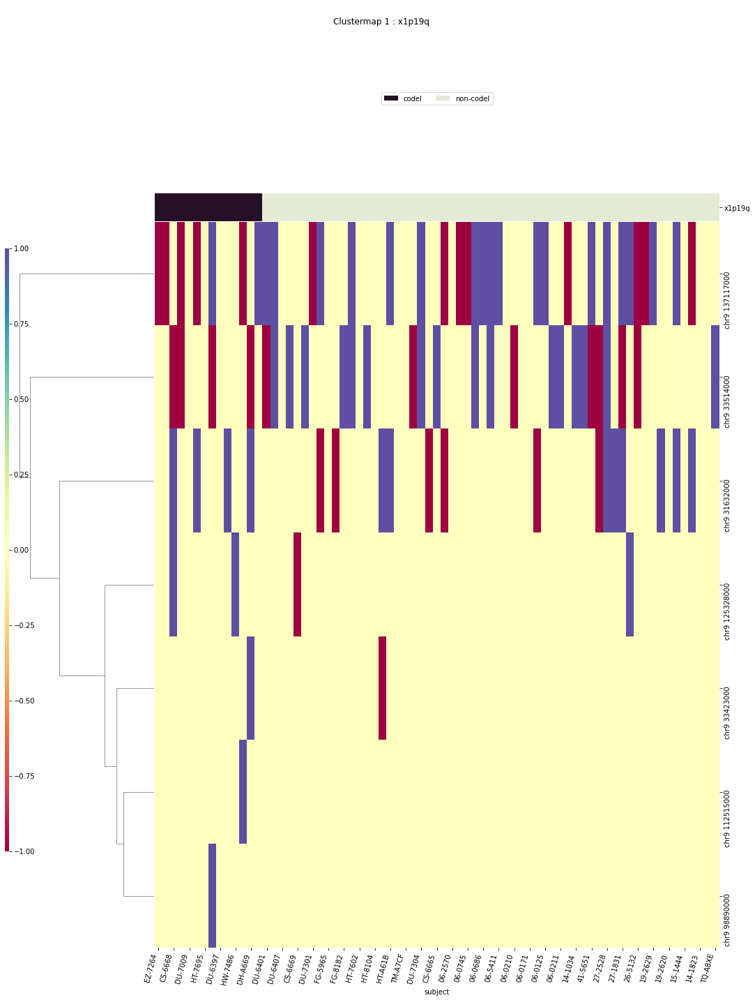

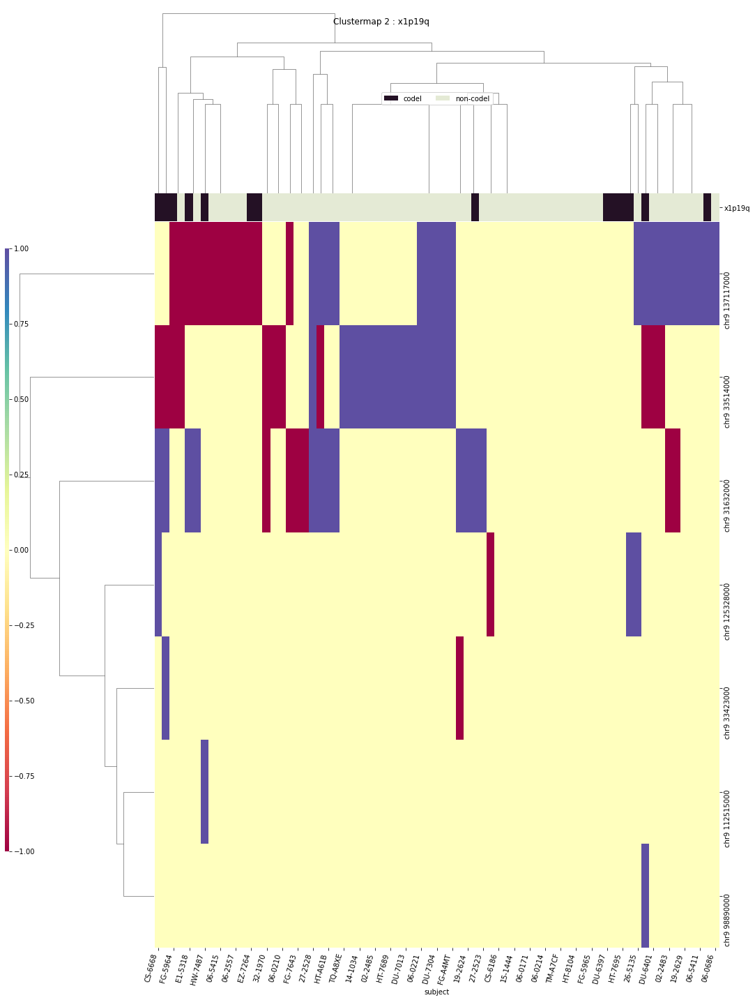

TERT
['TERT' 'chr9 125328000' 'chr9 128780000' 'chr9 137117000' 'chr9 15407000'
 'chr9 16977000' 'chr9 33514000' 'chr9 64478000' 'chr9 69104000'
 'chr9 76955000' 'chr9 77060000' 'chr9 87785000' 'chr9 97232000' 'subject']


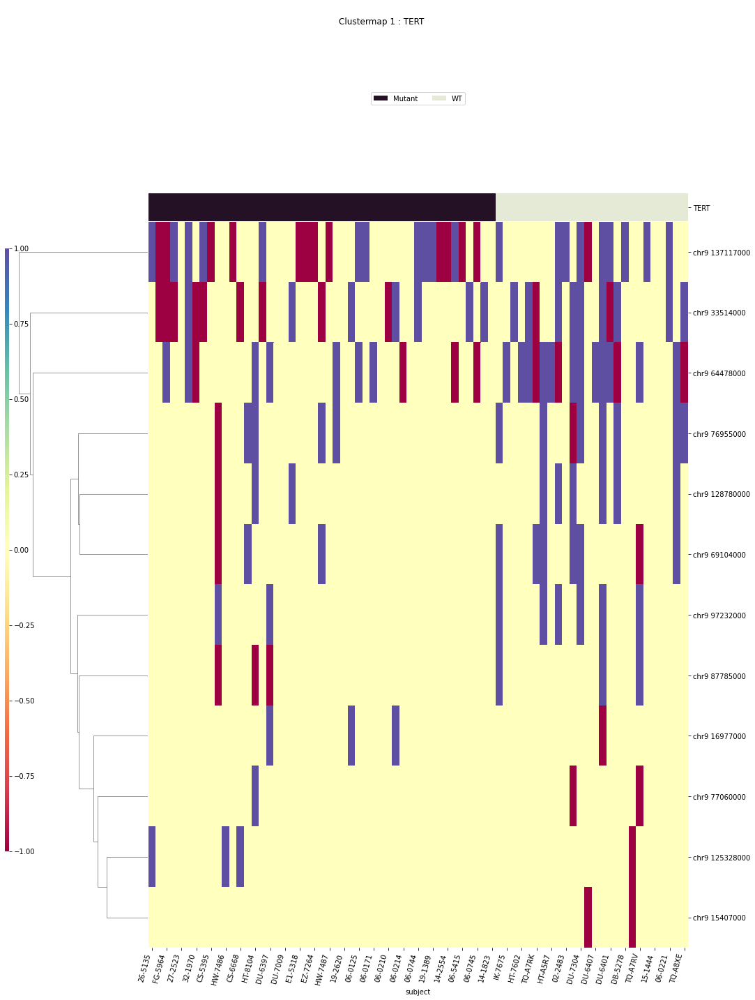

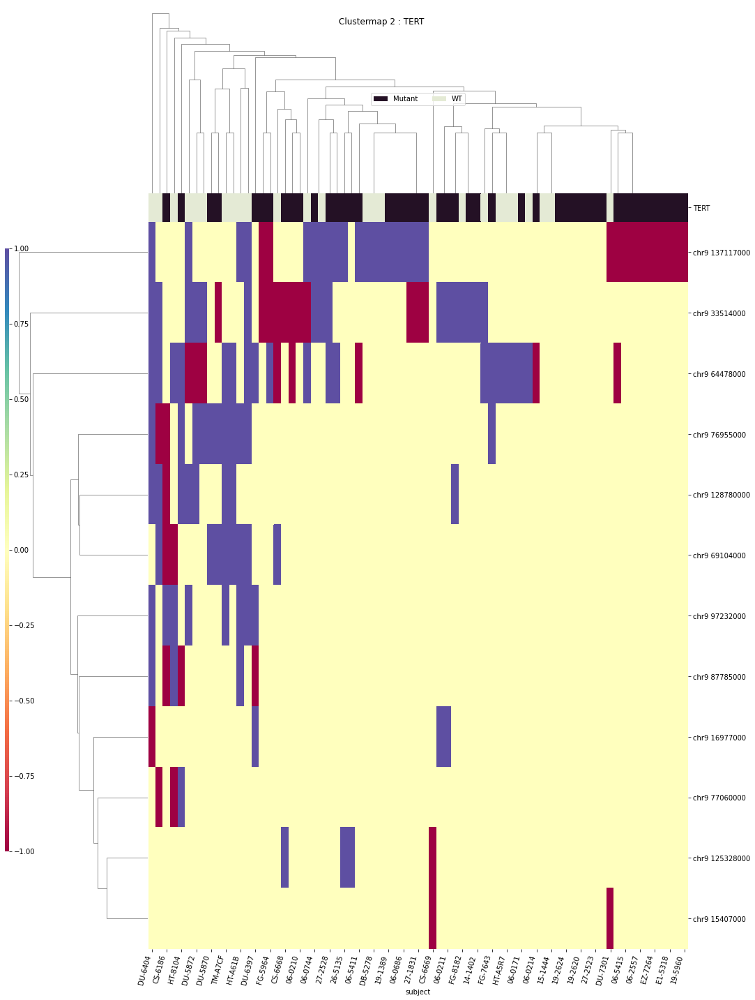

disease_type
['chr9 113033000' 'chr9 122868000' 'chr9 125578000' 'chr9 128780000'
 'chr9 134715000' 'chr9 15234000' 'chr9 29188000' 'chr9 64478000'
 'chr9 69104000' 'chr9 73087000' 'chr9 76955000' 'chr9 77303000'
 'chr9 84367000' 'chr9 97232000' 'disease_type' 'subject']


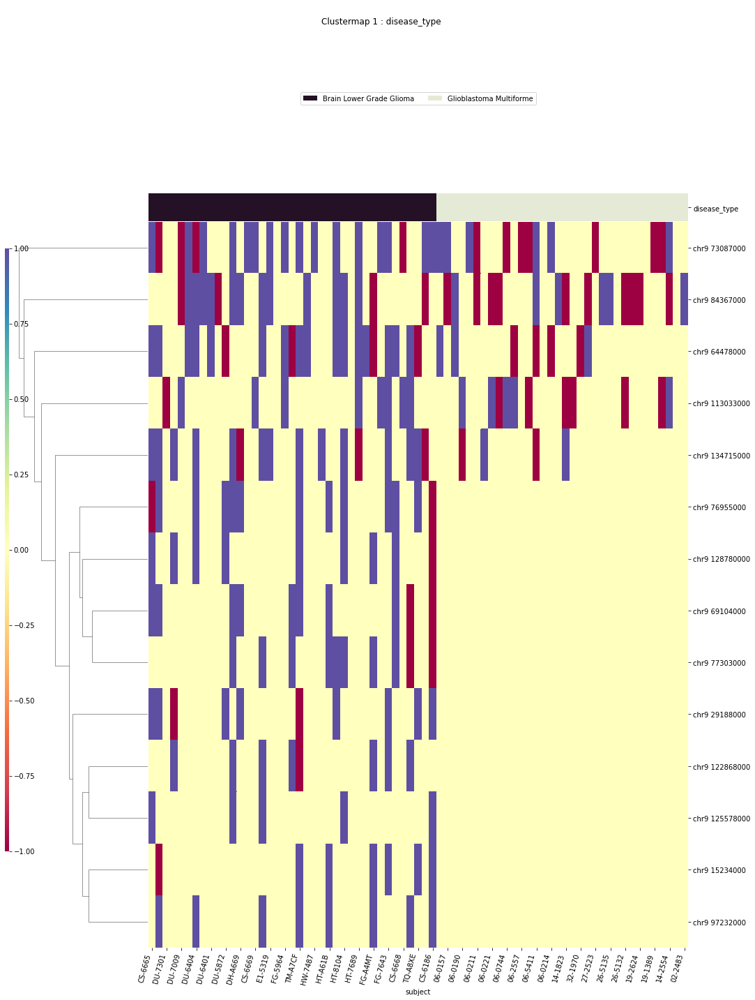

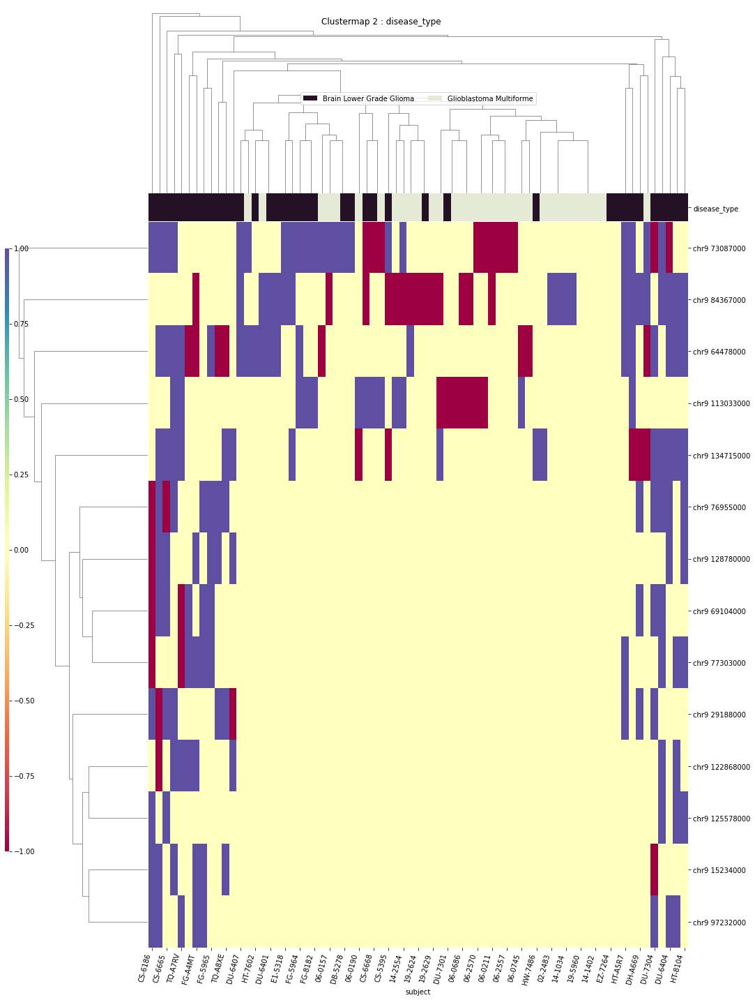

chrM
HERVK113
primary_diagnosis
['primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chrUn_GL000218v1
HERVK113
primary_diagnosis
['primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chrUn_GL000219v1
HERVK113
primary_diagnosis
['chrUn_GL000219v1 178000' 'primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']


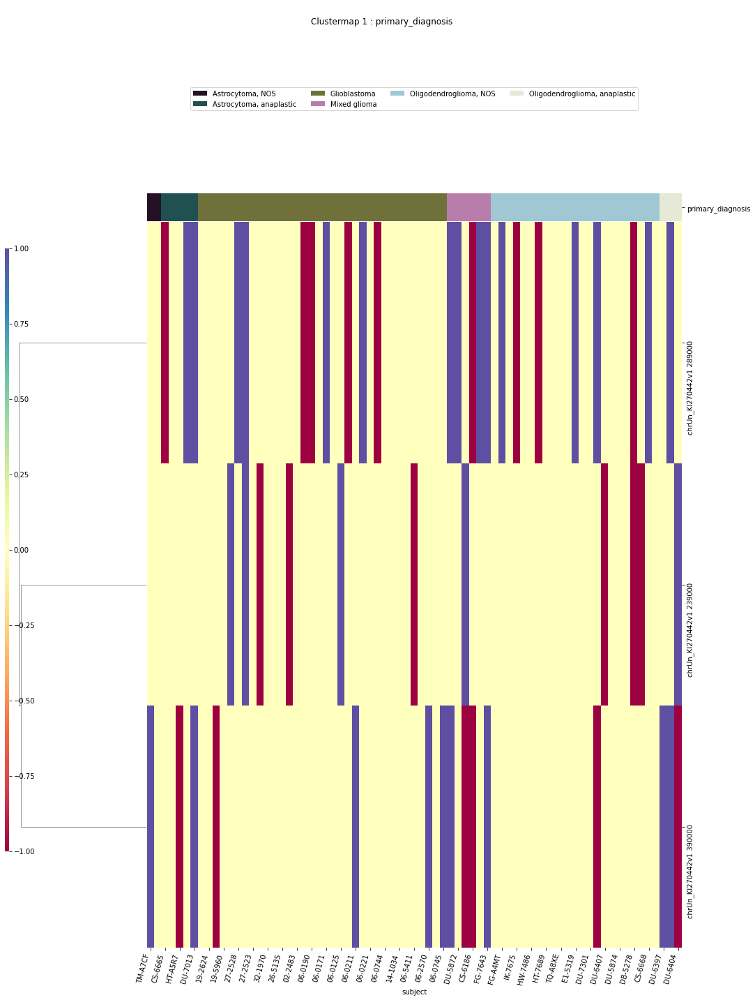

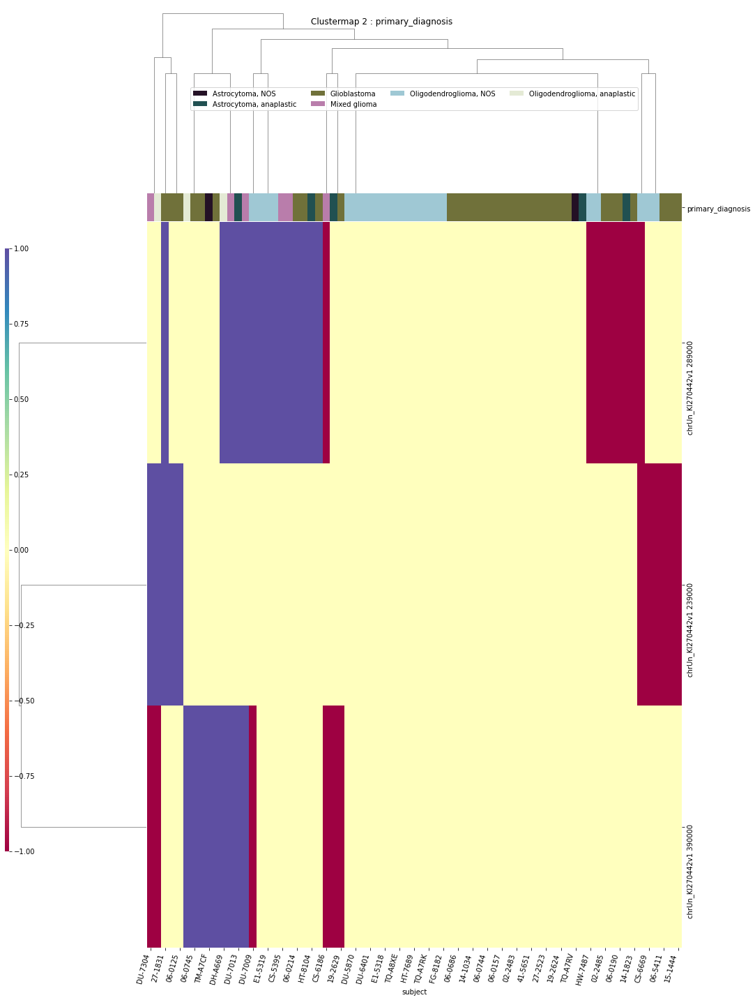

IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chrUn_KI270742v1
HERVK113
primary_diagnosis
['primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'subject']
Not enough data to produce cluster maps
disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps
chrUn_KI270744v1
HERVK113
primary_diagnosis
['chrUn_KI270744v1 71000' 'primary_diagnosis' 'subject']
Not enough data to produce cluster maps
IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['subject' 'x1p19q']
Not enough data to produce cluster maps
TERT
['TERT' 'chrUn_KI270744v1 71000' 'subject']
Not enough data 

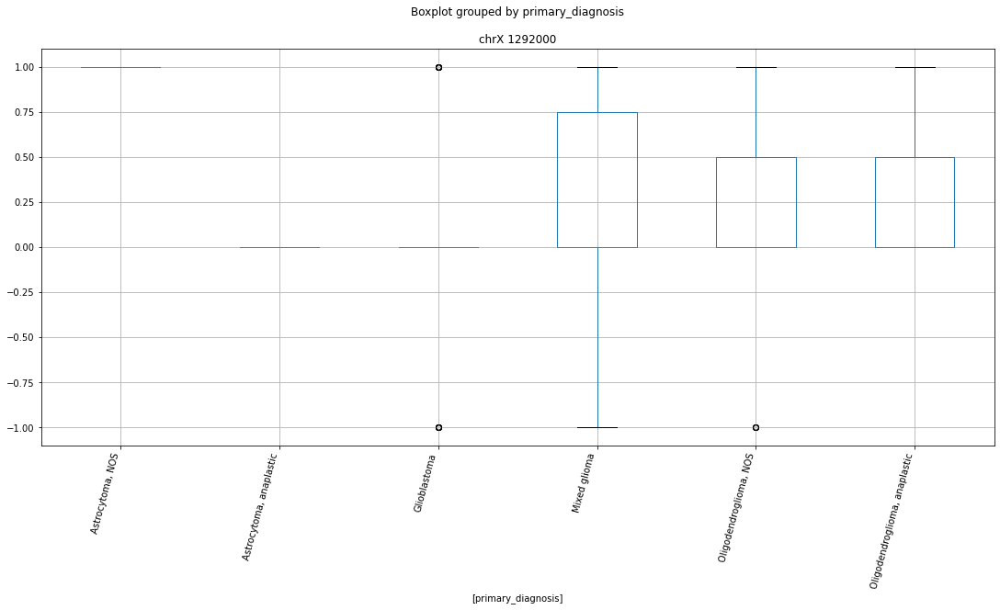

 p : 0.0  ( t : inf ) :  chrX 57335000


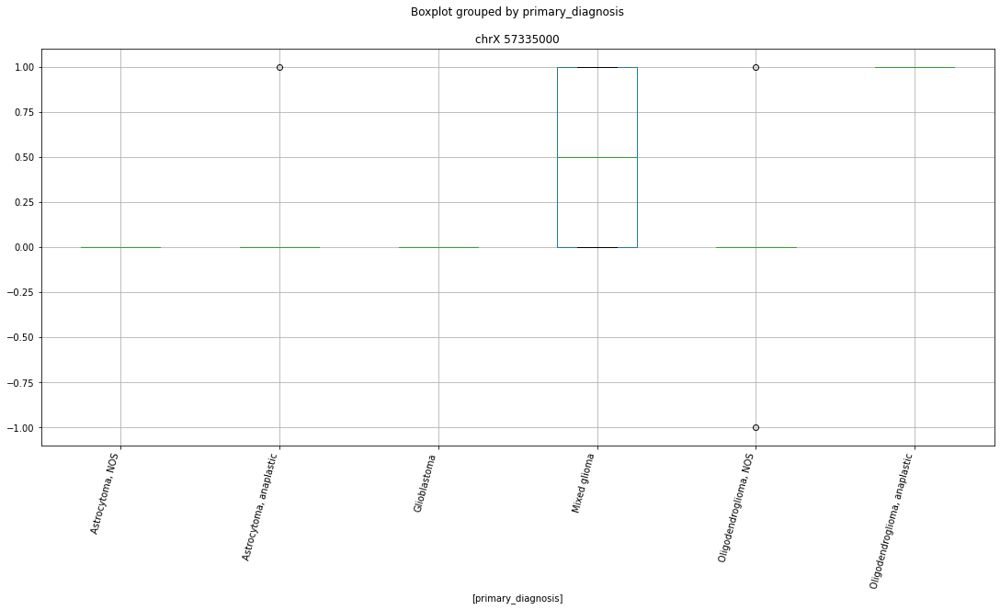

 p : 0.0  ( t : inf ) :  chrX 58066000


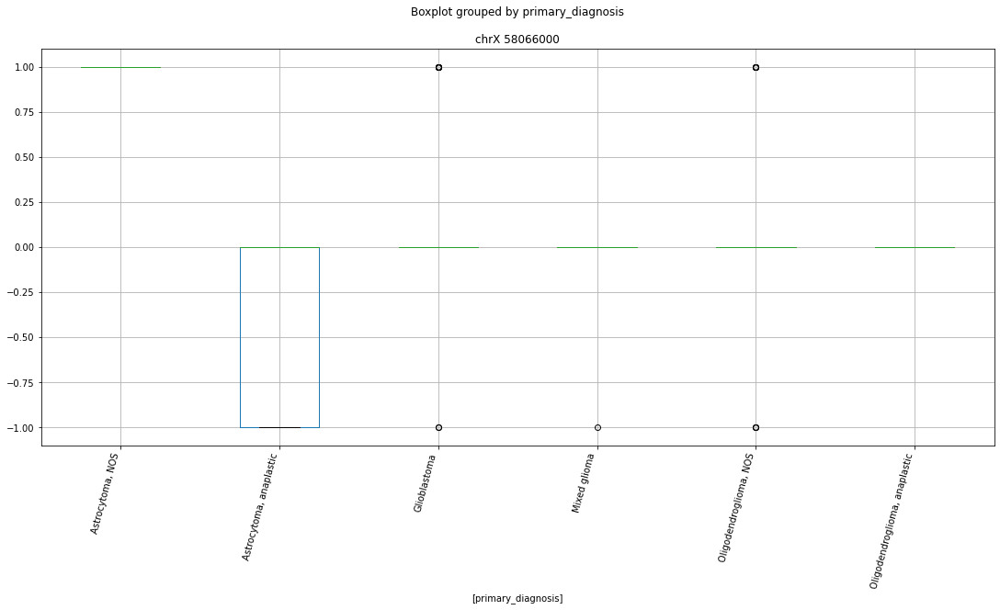

 p : 0.0  ( t : inf ) :  chrX 1899000


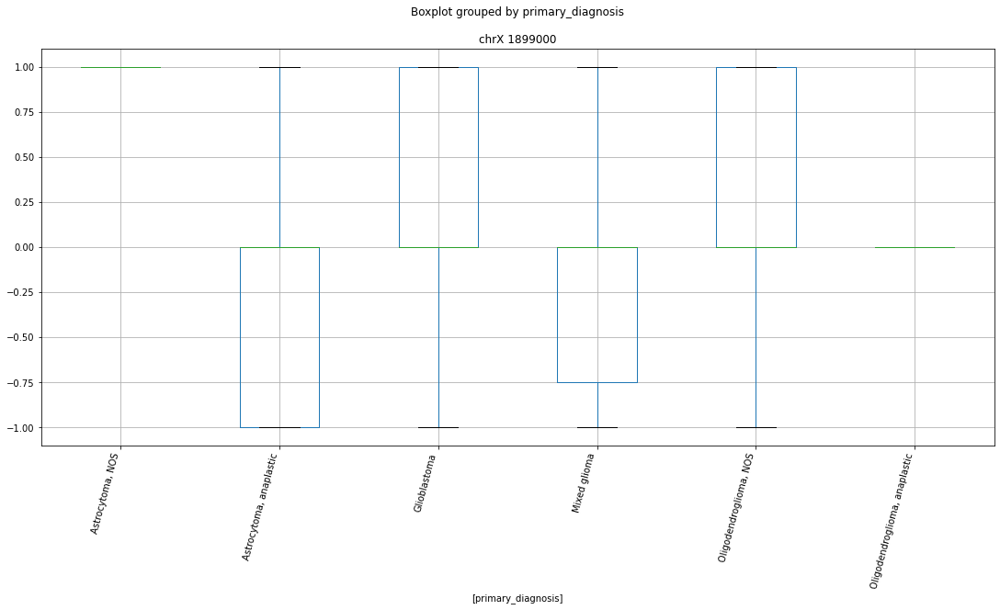

 p : 0.0  ( t : inf ) :  chrX 145721000


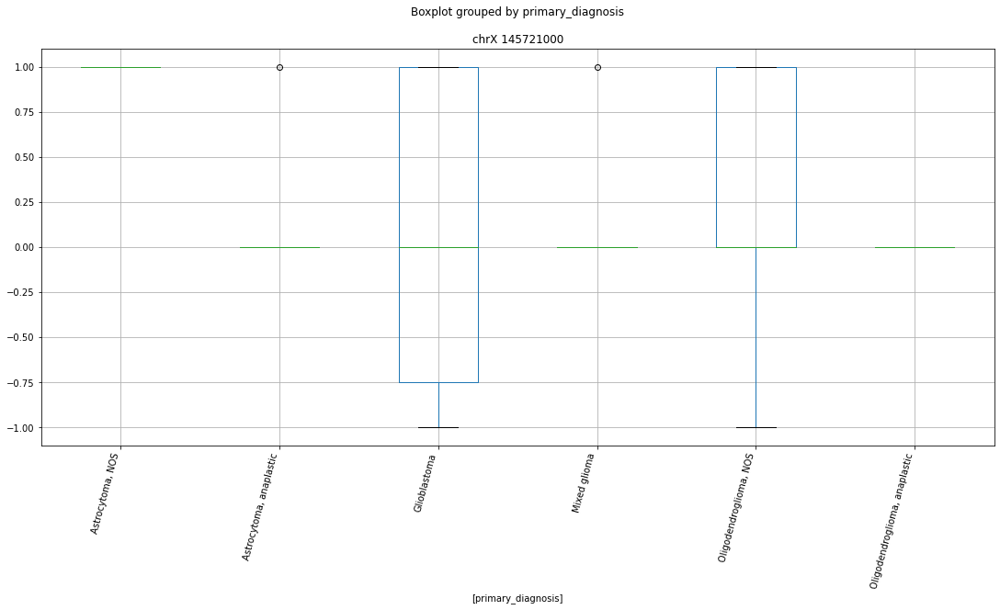

 p : 0.0  ( t : inf ) :  chrX 72560000


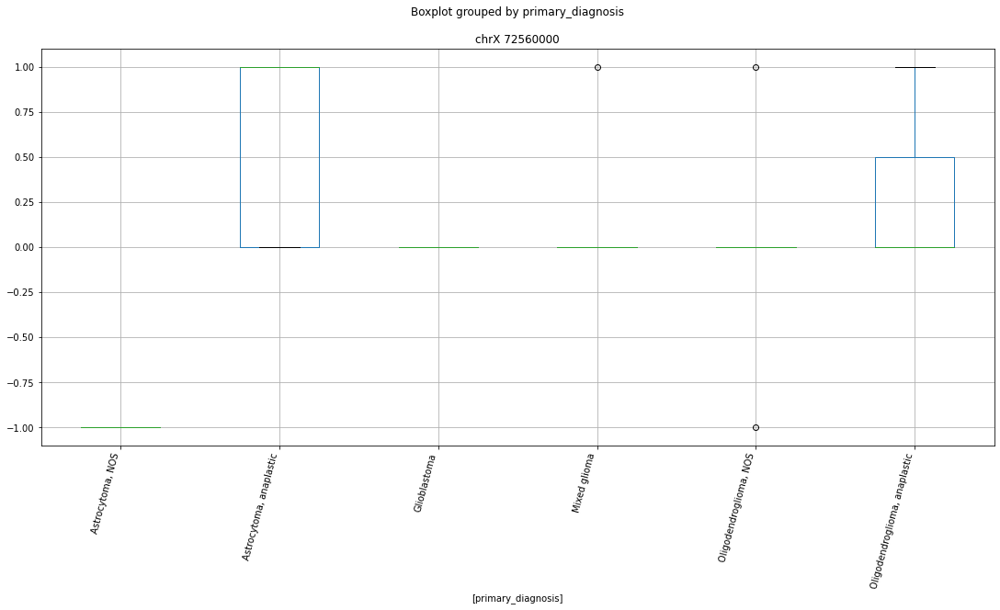

 p : 0.0  ( t : inf ) :  chrX 55749000


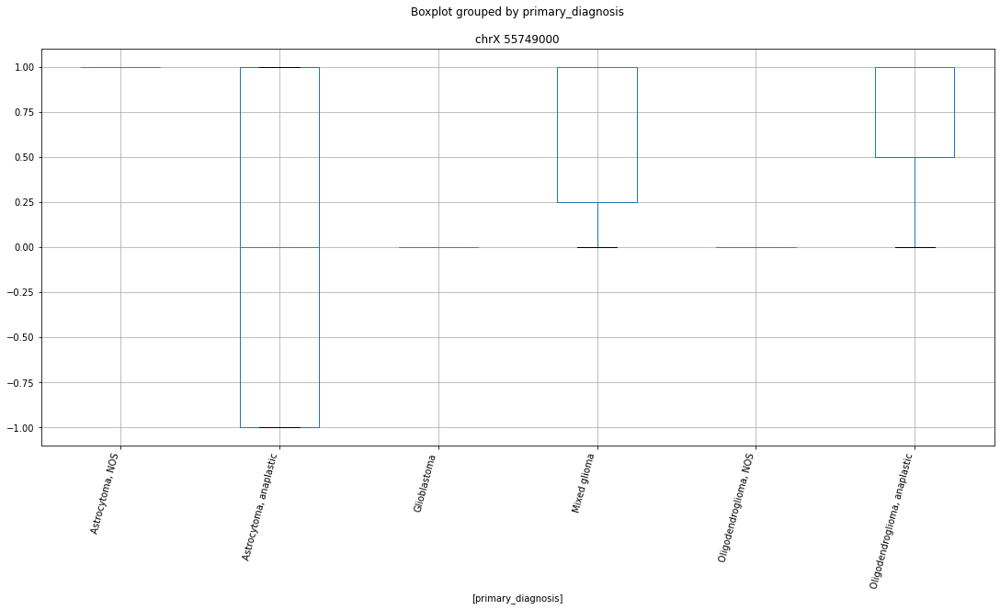

 p : 0.0  ( t : inf ) :  chrX 155907000


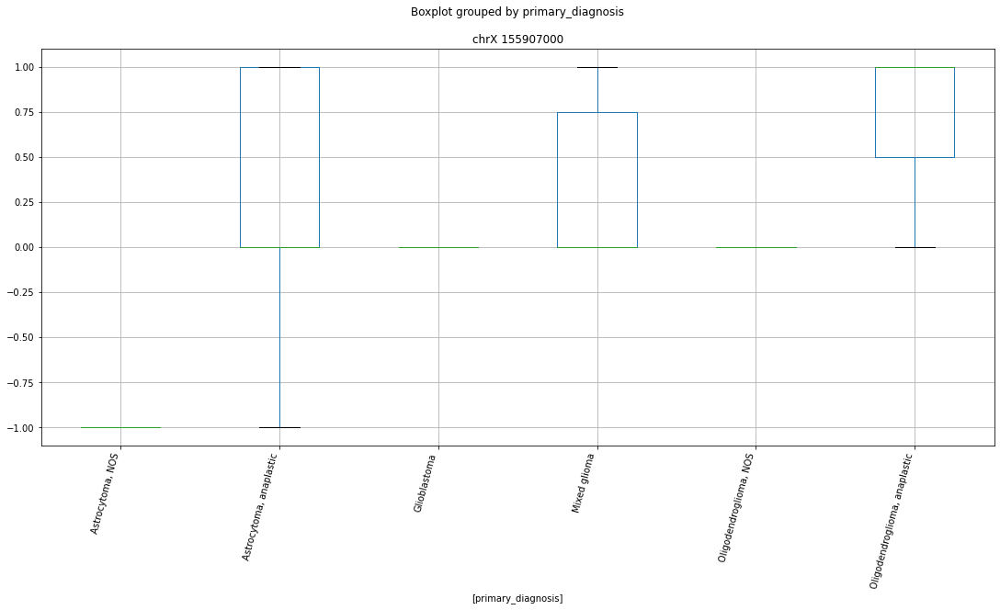

 p : 0.0  ( t : inf ) :  chrX 74412000


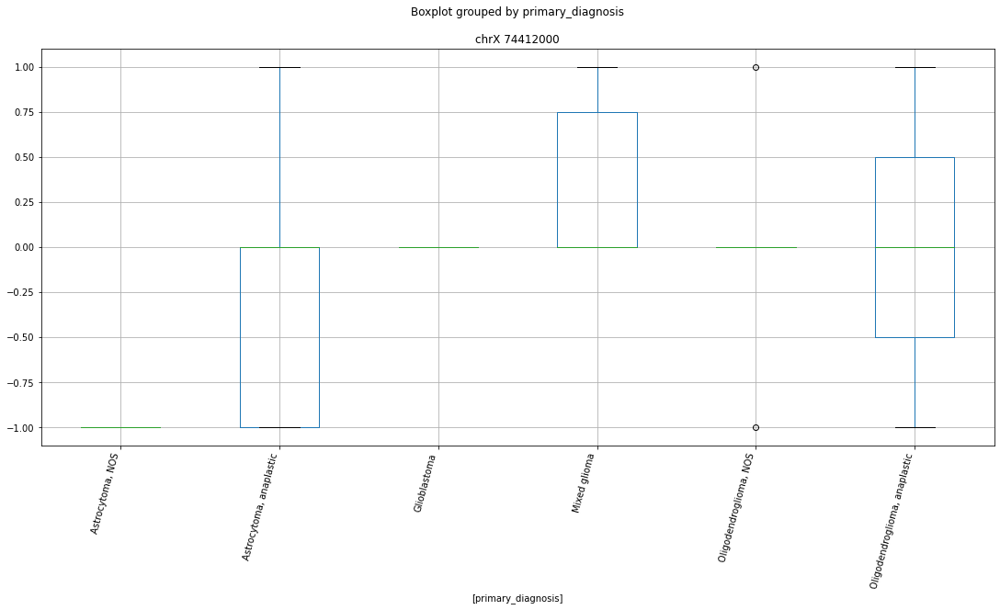

 p : 1.0175569557093286e-09  ( t : 8.037412518964047 ) :  chrX 55749000


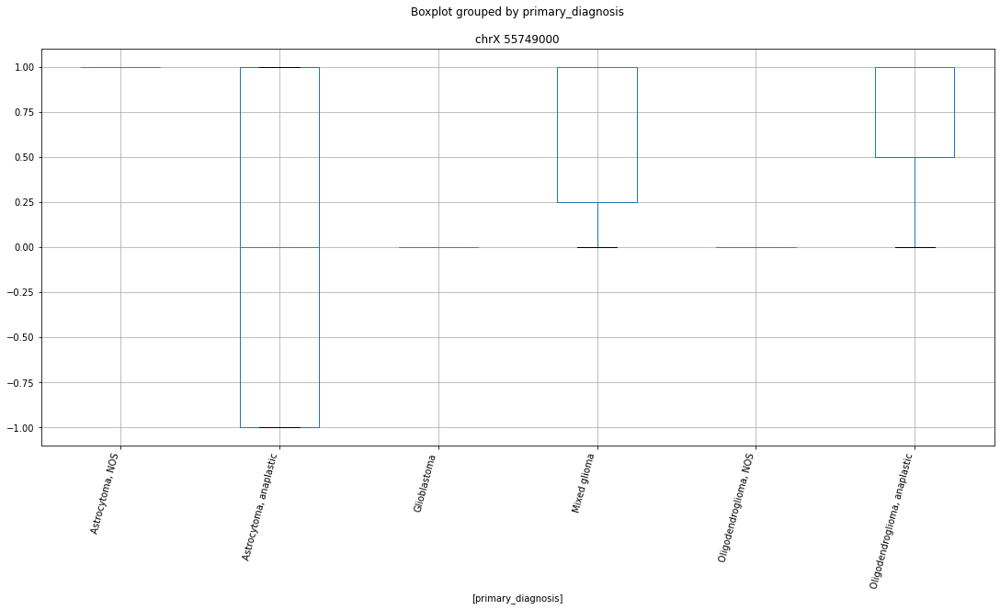

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chrX 74098000


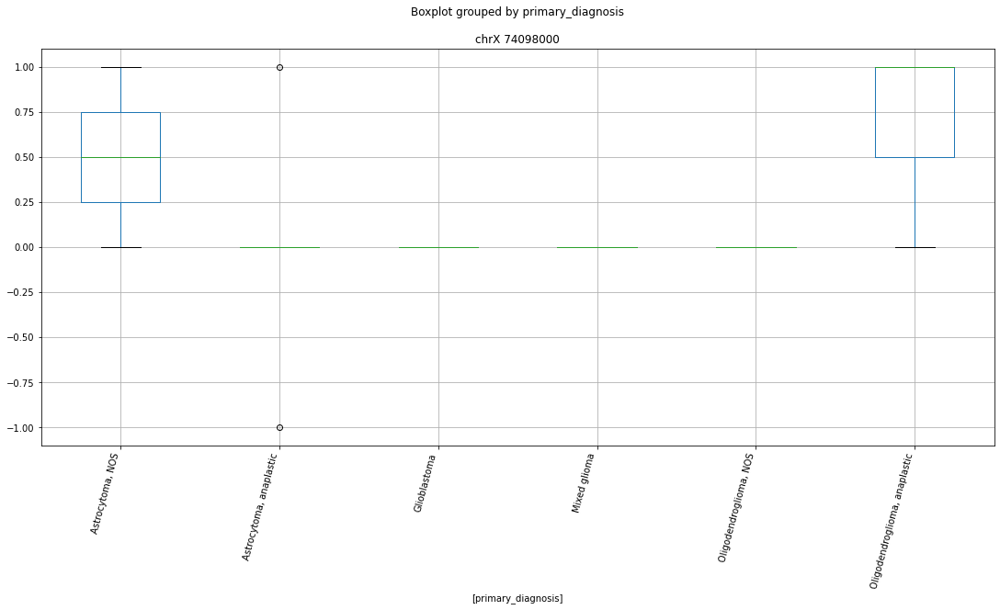

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chrX 16968000


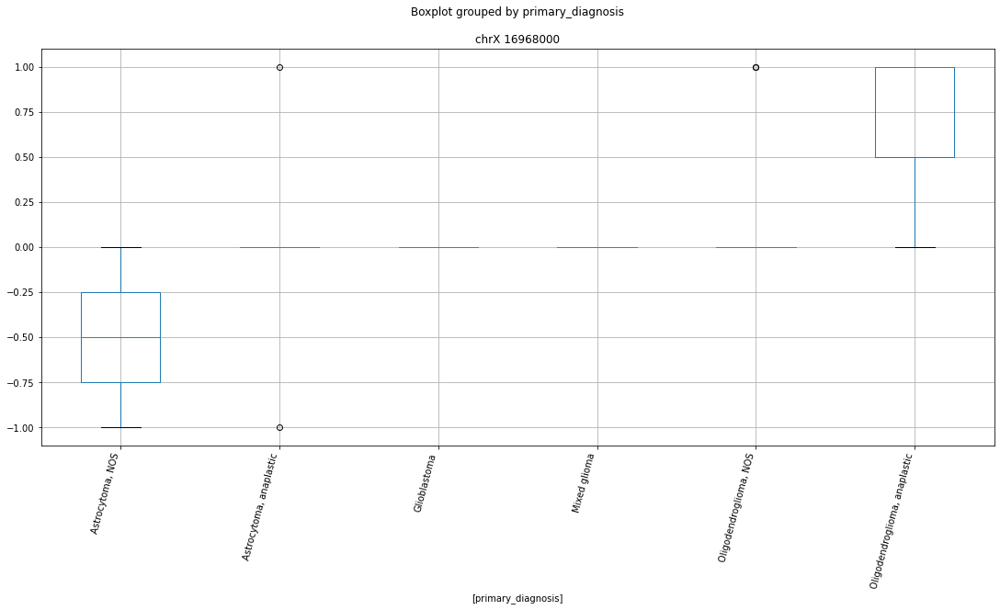

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chrX 155907000


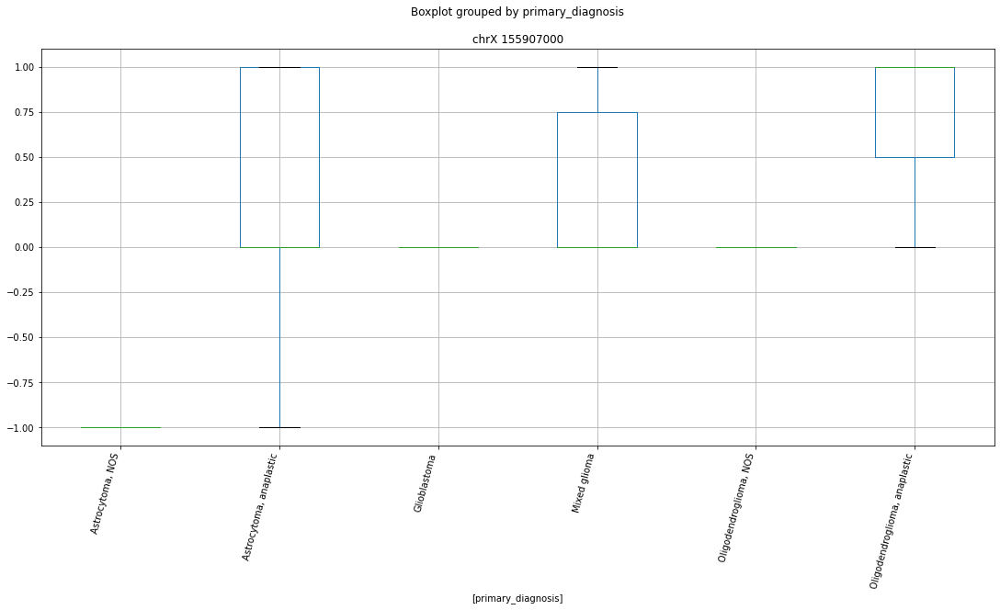

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chrX 74568000


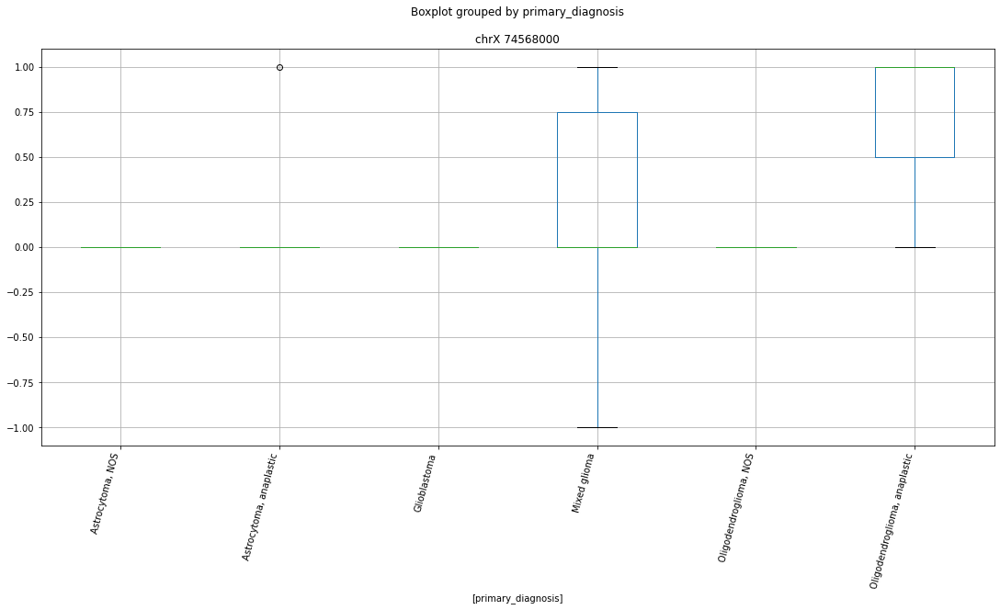

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chrX 55749000


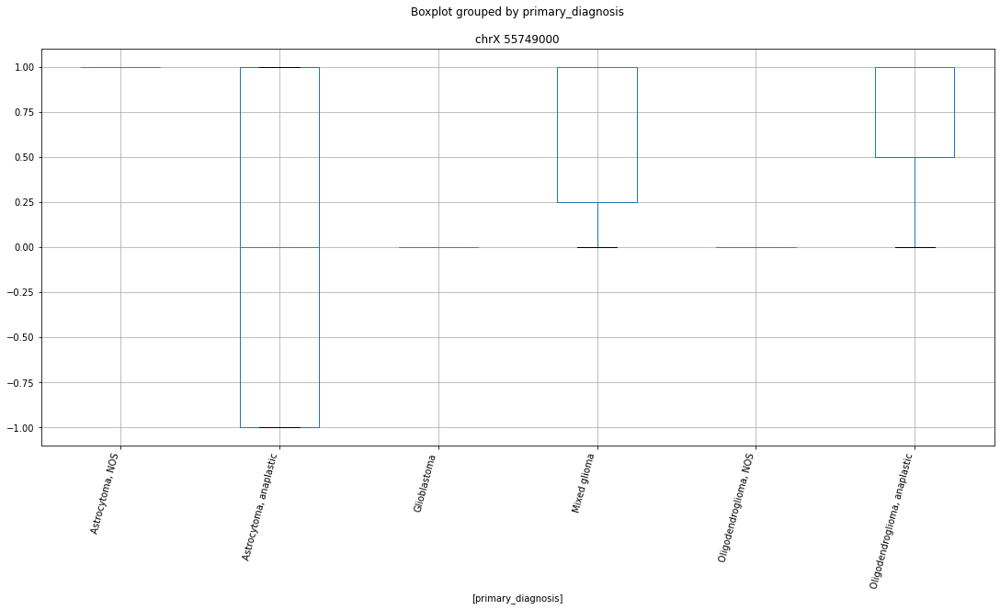

 p : 1.9394676807116956e-09  ( t : 8.020244654892037 ) :  chrX 145436000


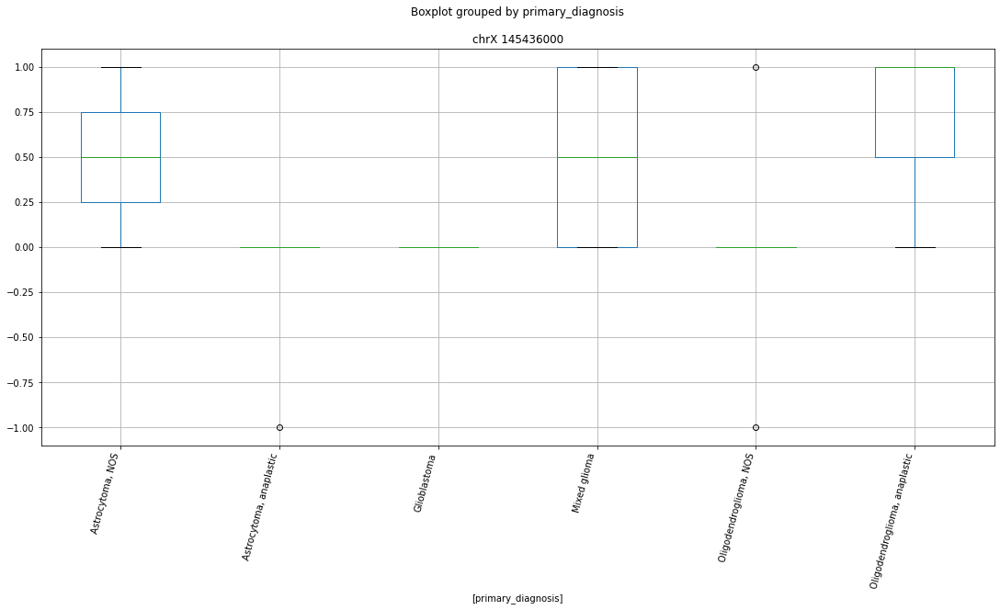

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chrX 72560000


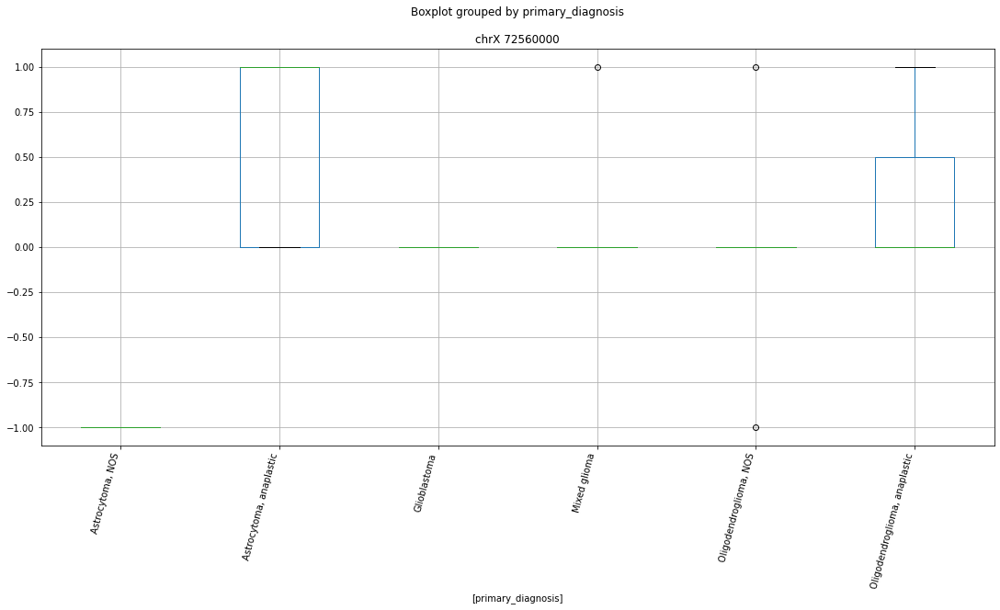

 p : 3.245614956133183e-08  ( t : 6.955905073002031 ) :  chrX 80591000


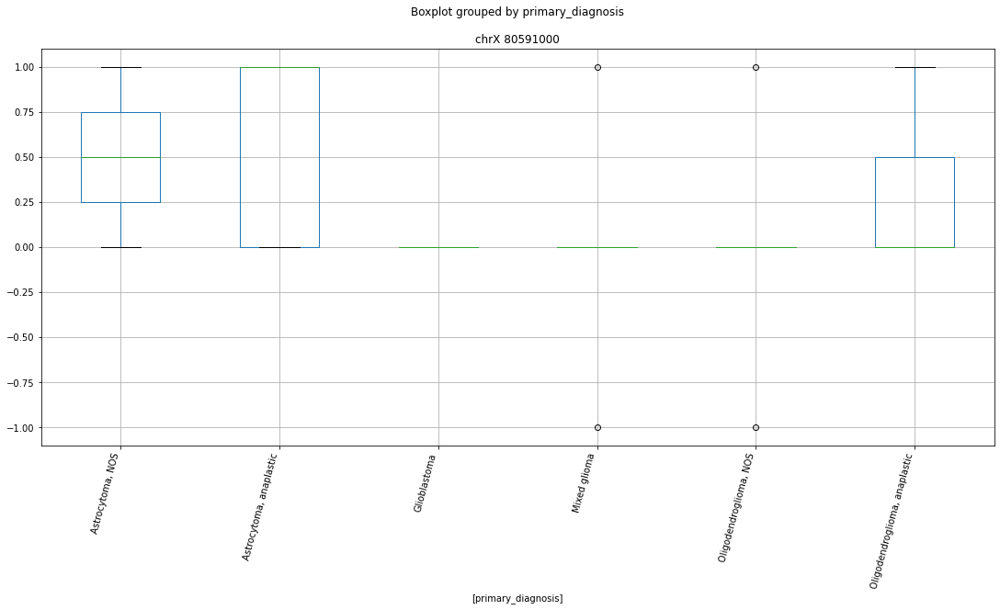

['chrX 100556000' 'chrX 100724000' 'chrX 109671000' 'chrX 113991000'
 'chrX 1171000' 'chrX 119362000' 'chrX 1236000' 'chrX 123680000'
 'chrX 123734000' 'chrX 125779000' 'chrX 1292000' 'chrX 134960000'
 'chrX 135302000' 'chrX 135303000' 'chrX 135406000' 'chrX 139341000'
 'chrX 142323000' 'chrX 145436000' 'chrX 145721000' 'chrX 149627000'
 'chrX 154909000' 'chrX 155907000' 'chrX 16964000' 'chrX 16968000'
 'chrX 18846000' 'chrX 1899000' 'chrX 23659000' 'chrX 23660000'
 'chrX 29333000' 'chrX 30603000' 'chrX 30753000' 'chrX 36261000'
 'chrX 39278000' 'chrX 41212000' 'chrX 44962000' 'chrX 45039000'
 'chrX 46276000' 'chrX 48139000' 'chrX 48222000' 'chrX 48659000'
 'chrX 53722000' 'chrX 53967000' 'chrX 55749000' 'chrX 55835000'
 'chrX 55998000' 'chrX 57335000' 'chrX 58065000' 'chrX 58066000'
 'chrX 63189000' 'chrX 63393000' 'chrX 70601000' 'chrX 71341000'
 'chrX 71451000' 'chrX 72179000' 'chrX 72560000' 'chrX 72734000'
 'chrX 74098000' 'chrX 74412000' 'chrX 74568000' 'chrX 7608000'
 'chrX 7727

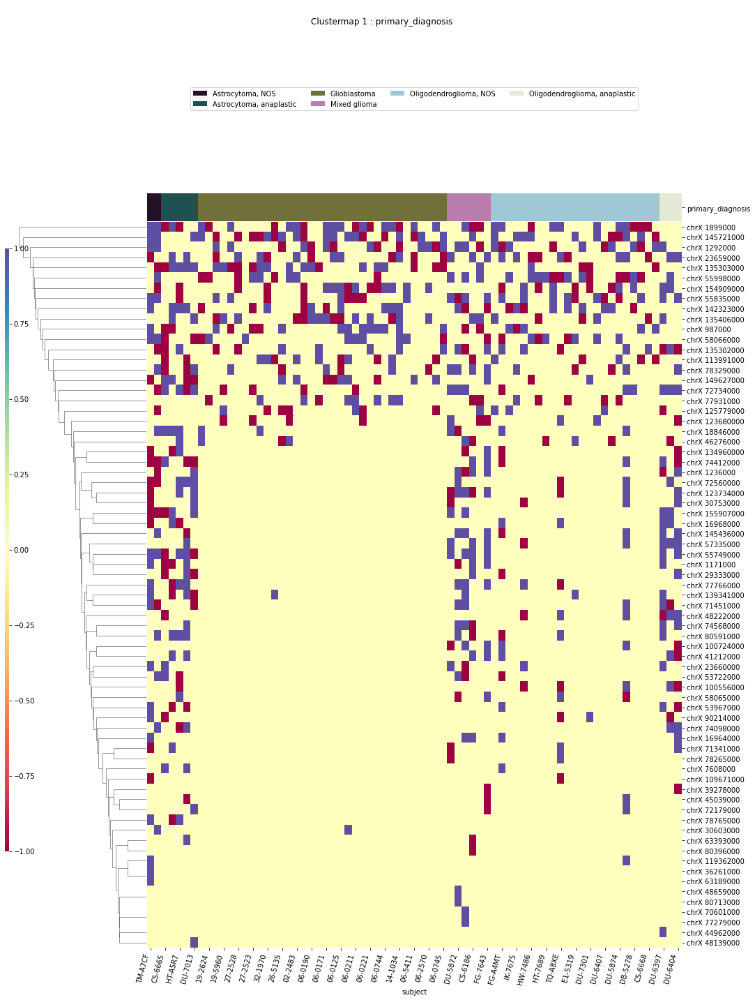

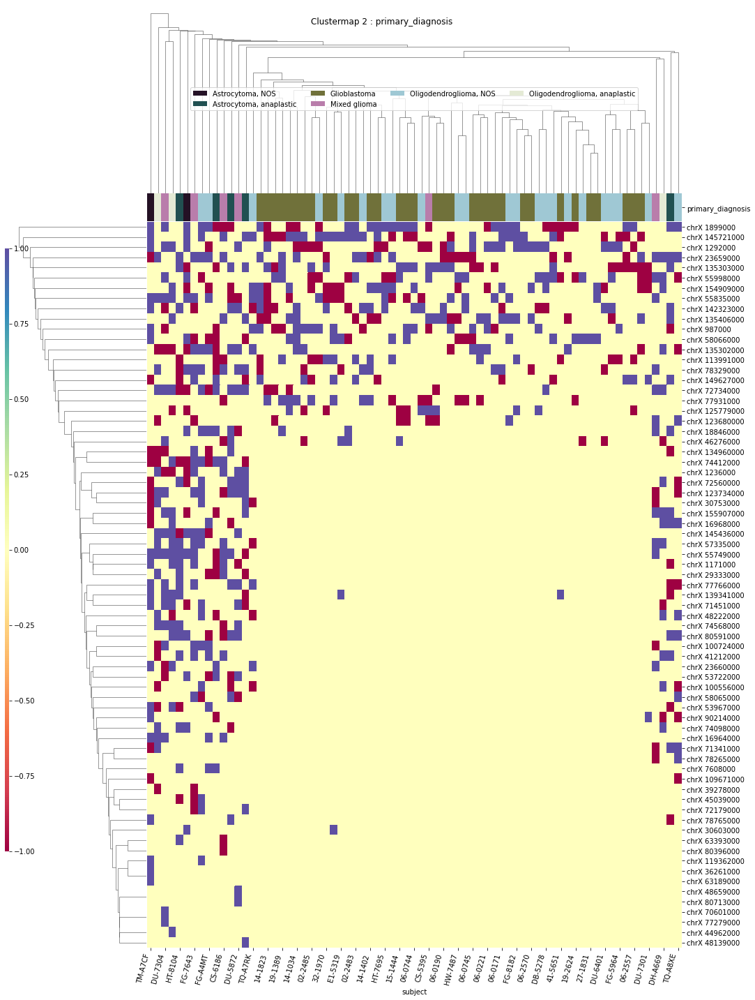

IDH
['IDH' 'chrX 1236000' 'chrX 123680000' 'chrX 1292000' 'chrX 139342000'
 'chrX 45039000' 'chrX 55998000' 'chrX 72734000' 'subject']


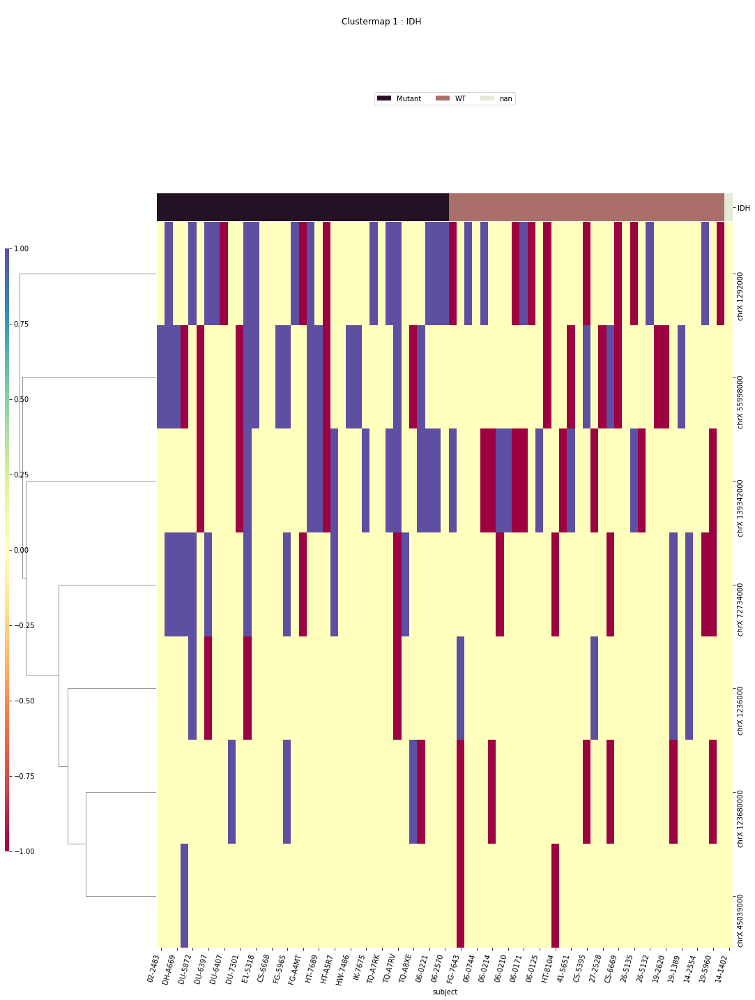

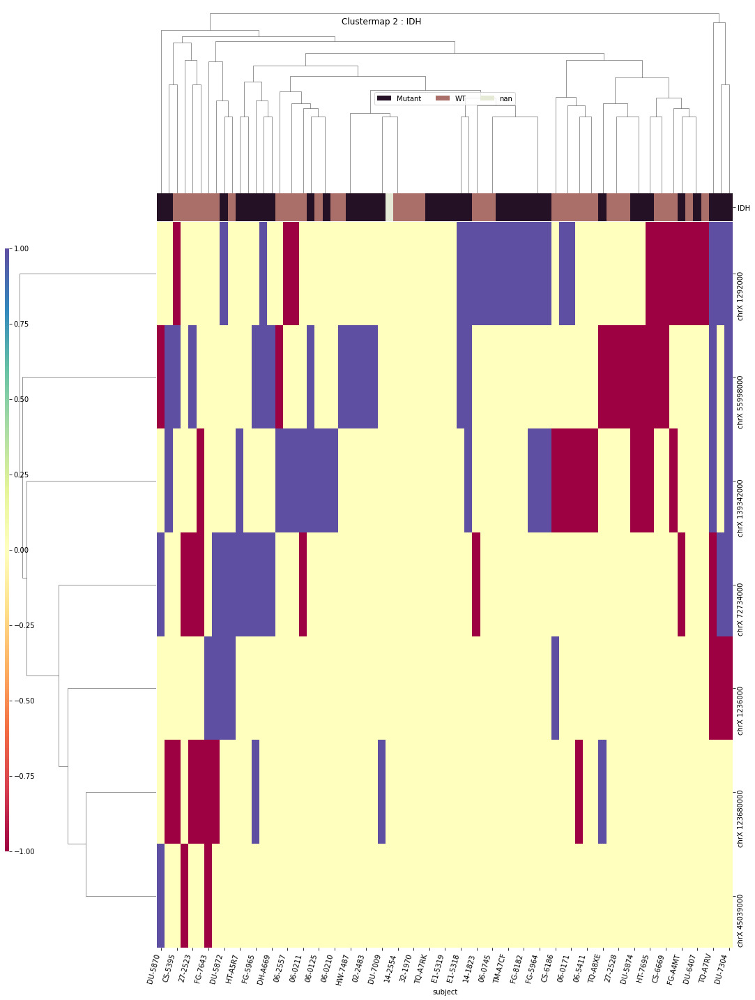

x1p19q
['chrX 100556000' 'chrX 129851000' 'chrX 138295000' 'chrX 149421000'
 'chrX 152129000' 'chrX 152130000' 'chrX 26525000' 'chrX 44962000'
 'chrX 45039000' 'chrX 52826000' 'chrX 70680000' 'chrX 72734000'
 'chrX 74412000' 'chrX 77931000' 'subject' 'x1p19q']


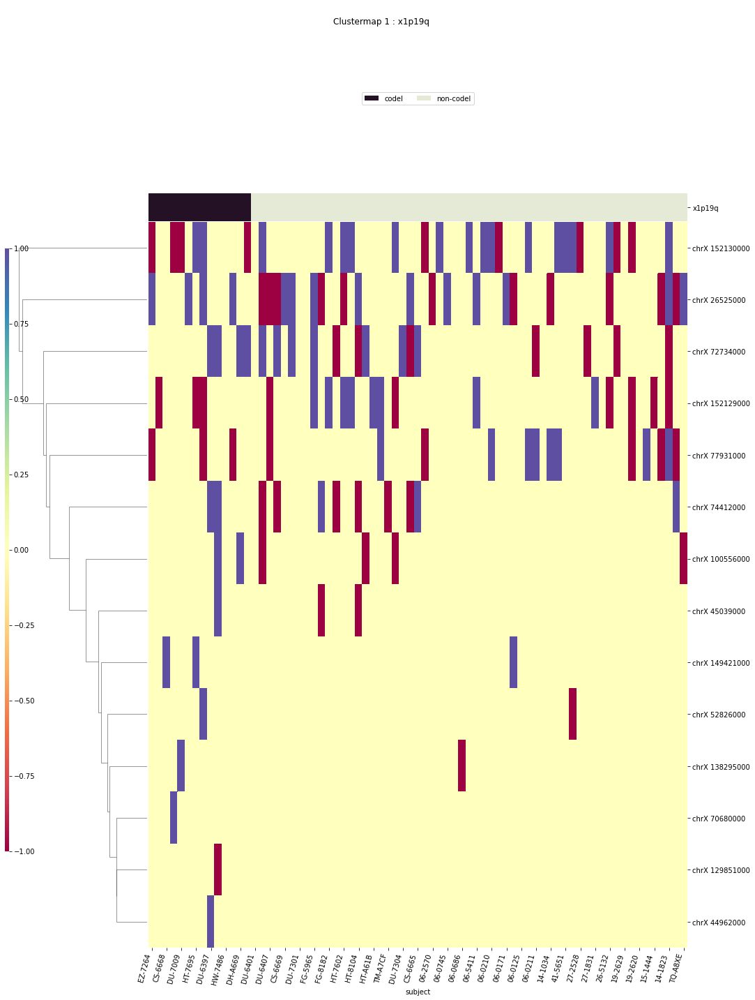

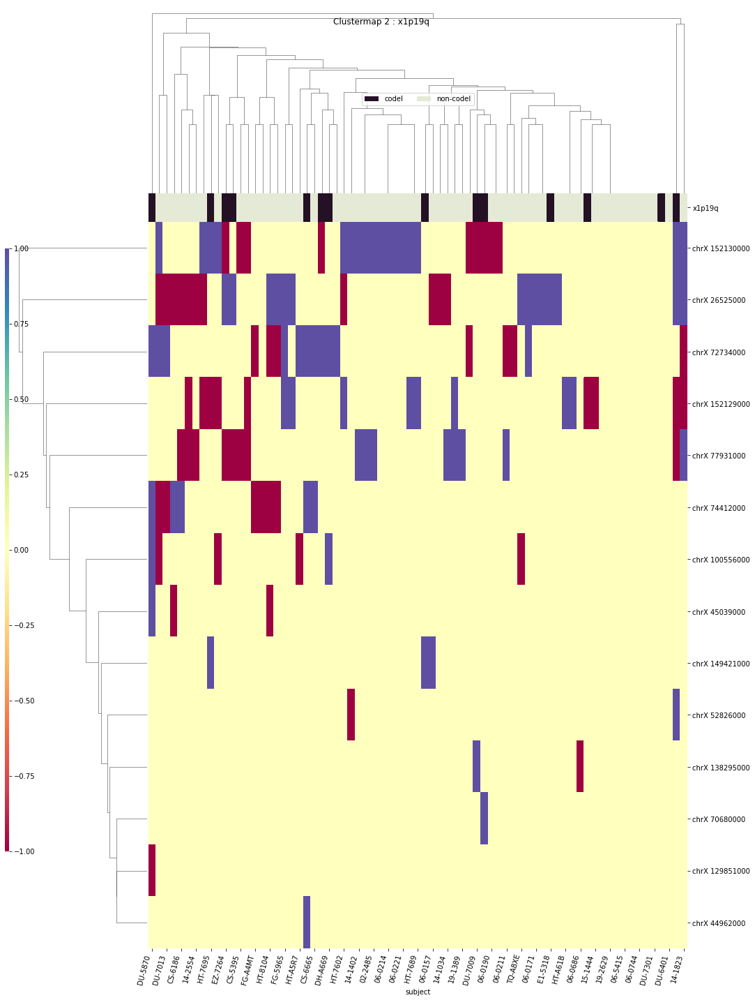

TERT
['TERT' 'chrX 100556000' 'chrX 109671000' 'chrX 1171000' 'chrX 1292000'
 'chrX 134960000' 'chrX 139342000' 'chrX 152129000' 'chrX 16964000'
 'chrX 30753000' 'chrX 72734000' 'chrX 74412000' 'subject']


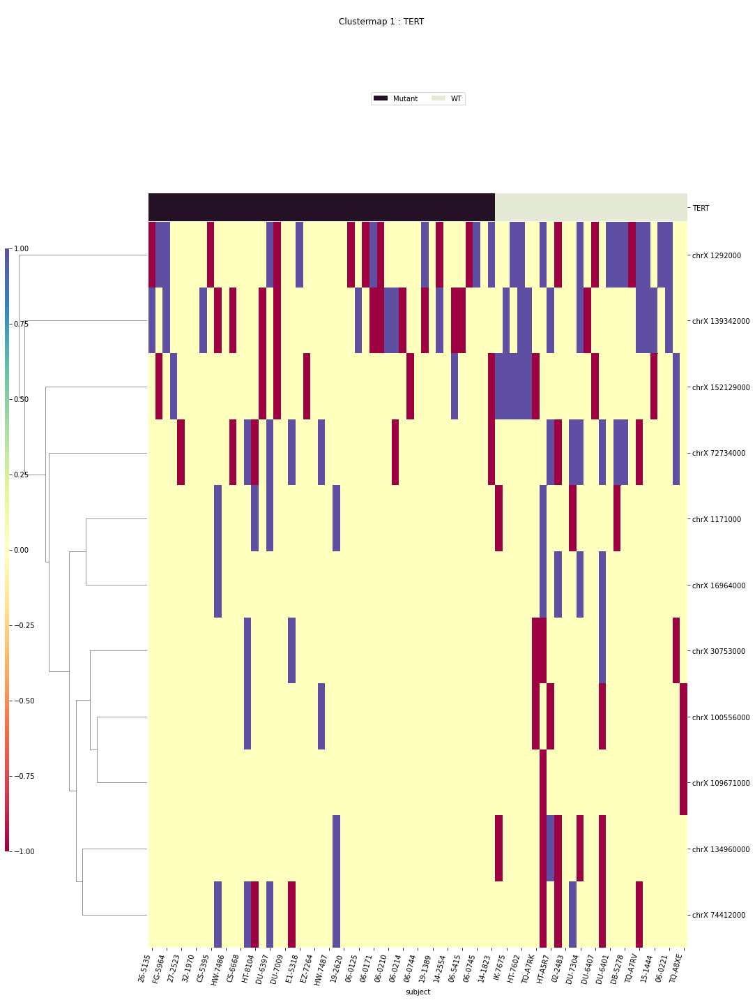

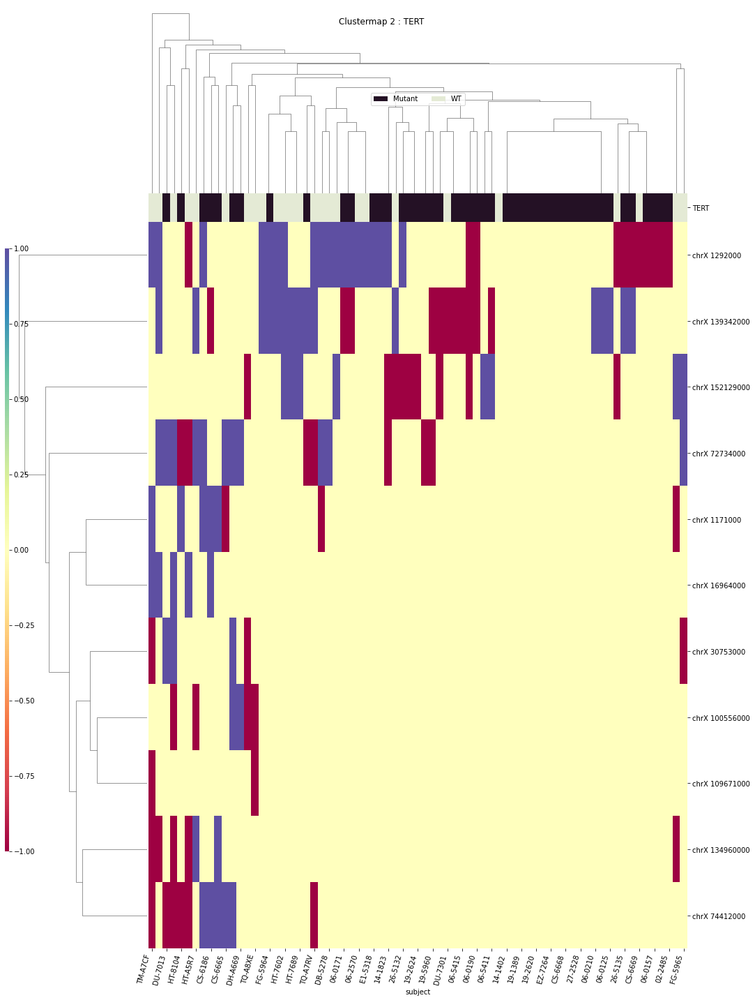

disease_type
['chrX 125780000' 'chrX 138296000' 'chrX 16964000' 'chrX 41212000'
 'chrX 55749000' 'chrX 55835000' 'chrX 57335000' 'chrX 72734000'
 'chrX 77931000' 'disease_type' 'subject']


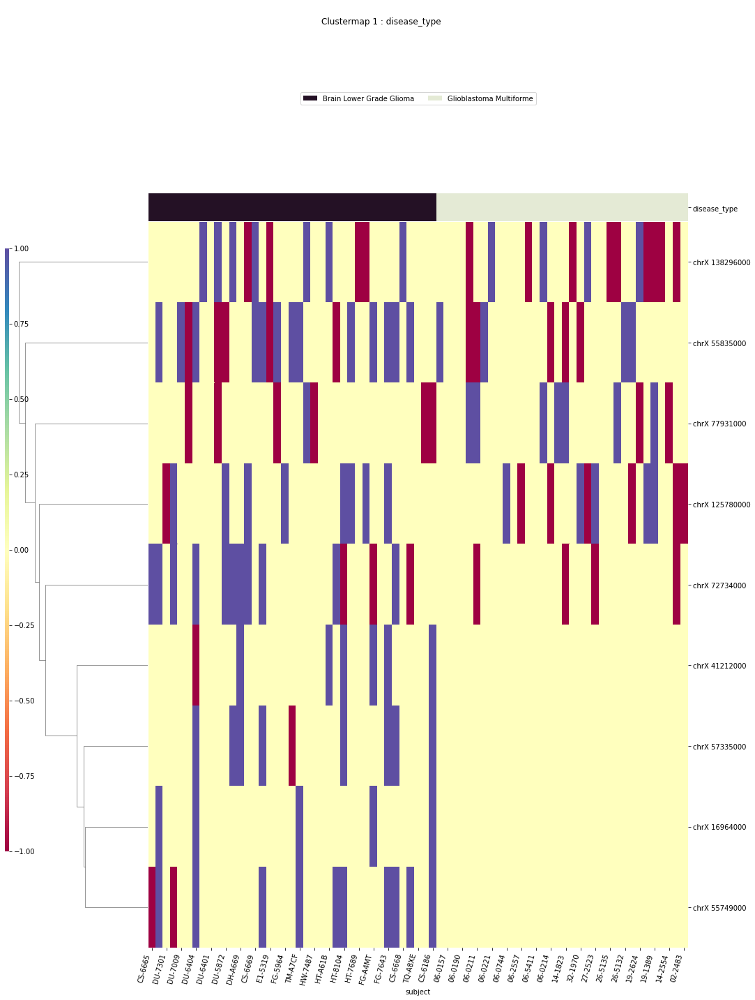

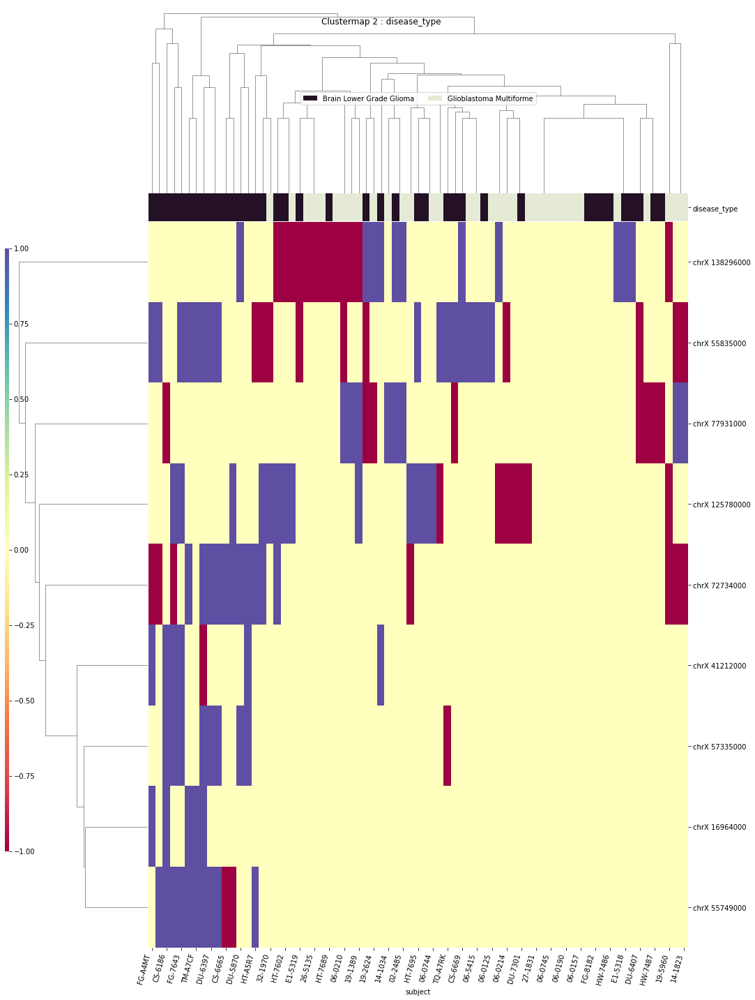

chrY
HERVK113
primary_diagnosis
['chrY 12352000' 'chrY 12462000' 'chrY 12879000' 'chrY 15774000'
 'chrY 20552000' 'chrY 3782000' 'chrY 3783000' 'chrY 6749000'
 'chrY 7179000' 'chrY 7180000' 'chrY 7711000' 'primary_diagnosis'
 'subject']


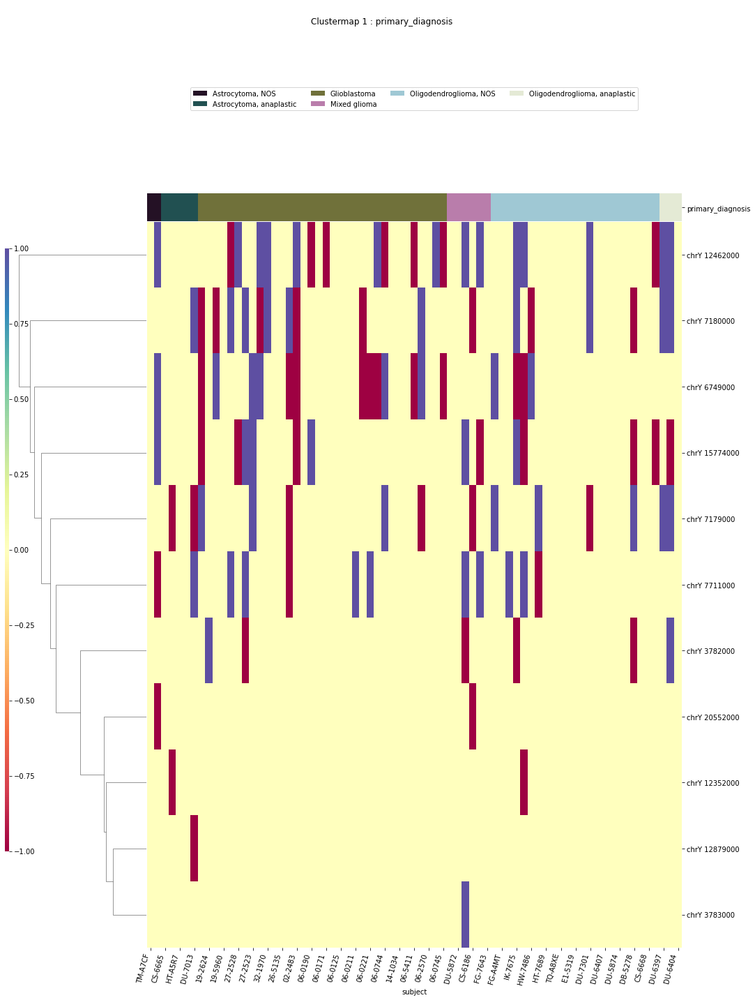

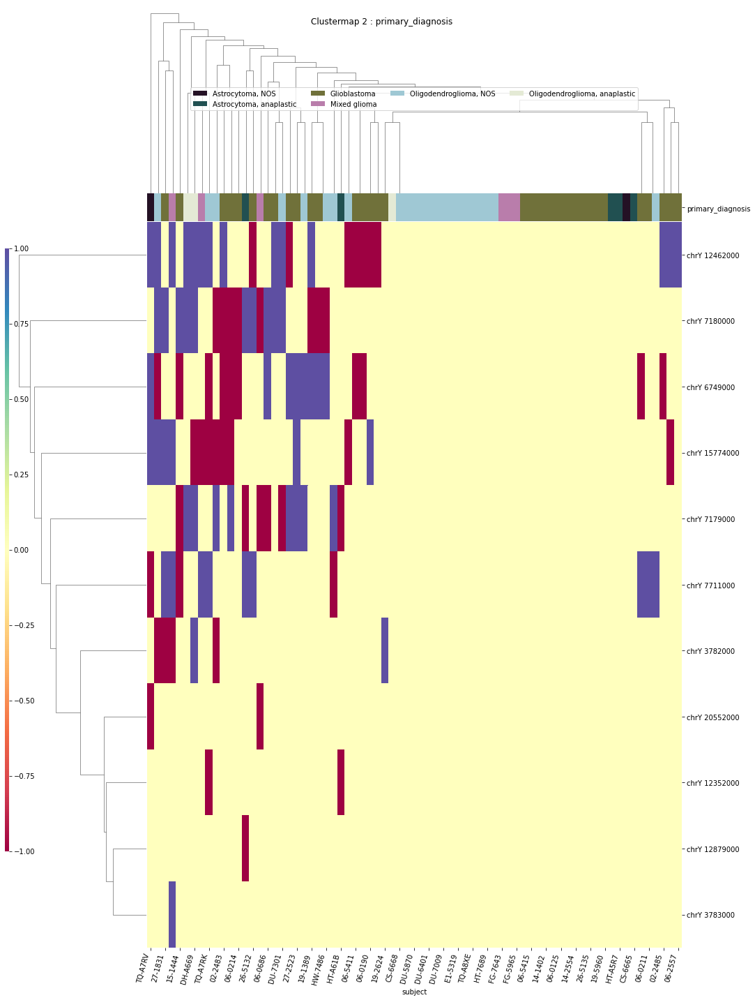

IDH
['IDH' 'subject']
Not enough data to produce cluster maps
x1p19q
['chrY 15774000' 'chrY 7179000' 'subject' 'x1p19q']


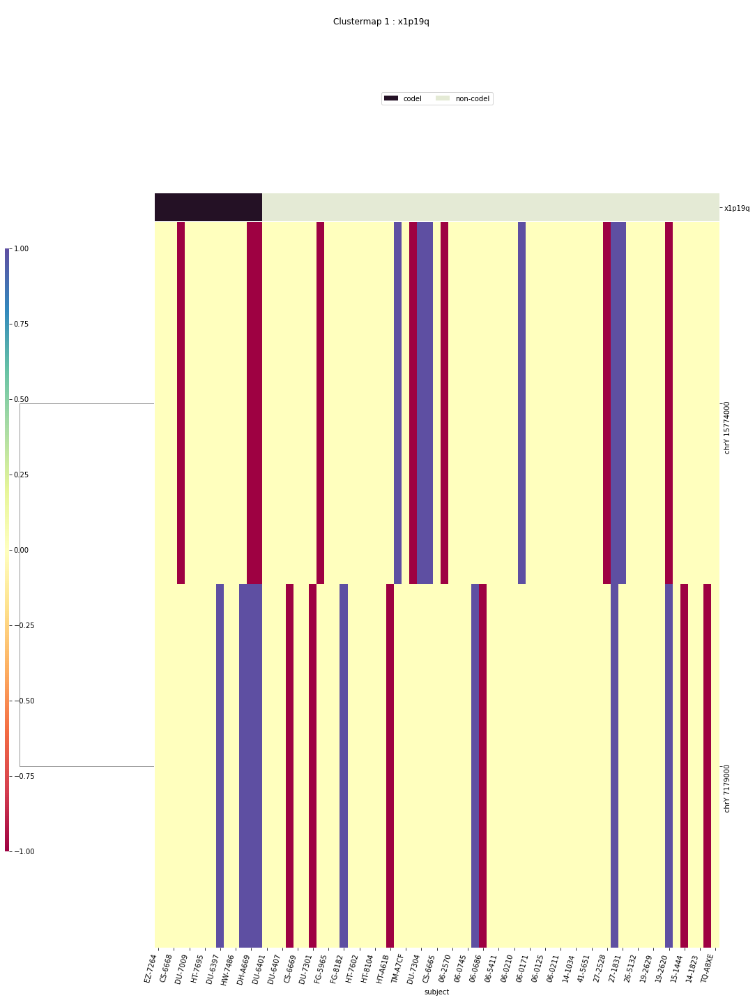

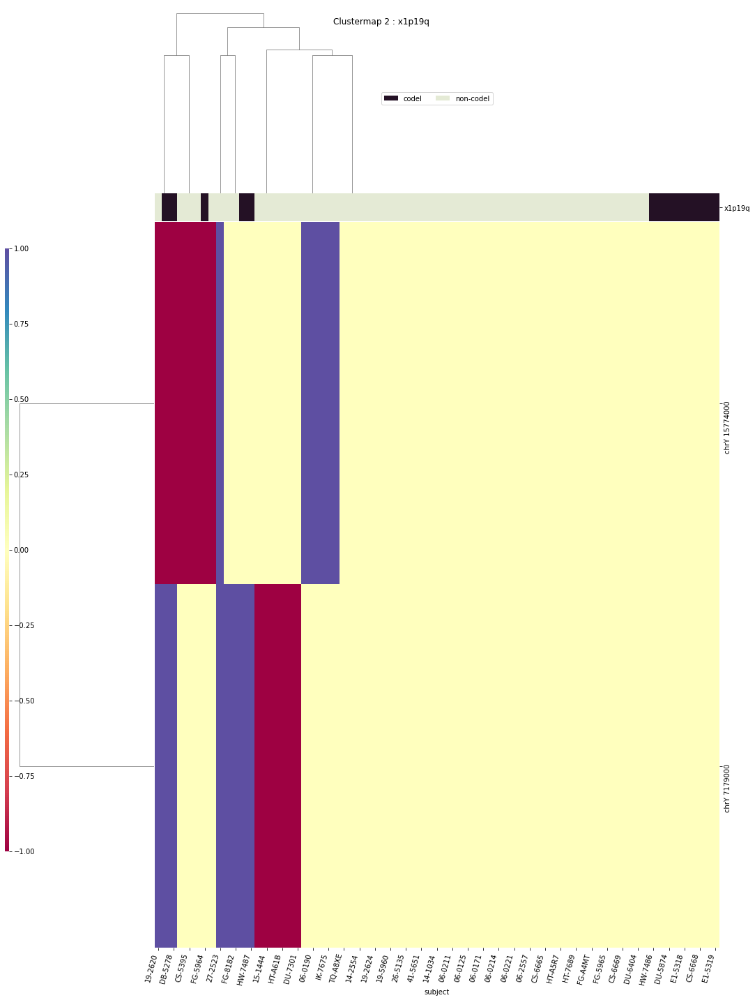

TERT
['TERT' 'chrY 12352000' 'chrY 3782000' 'subject']


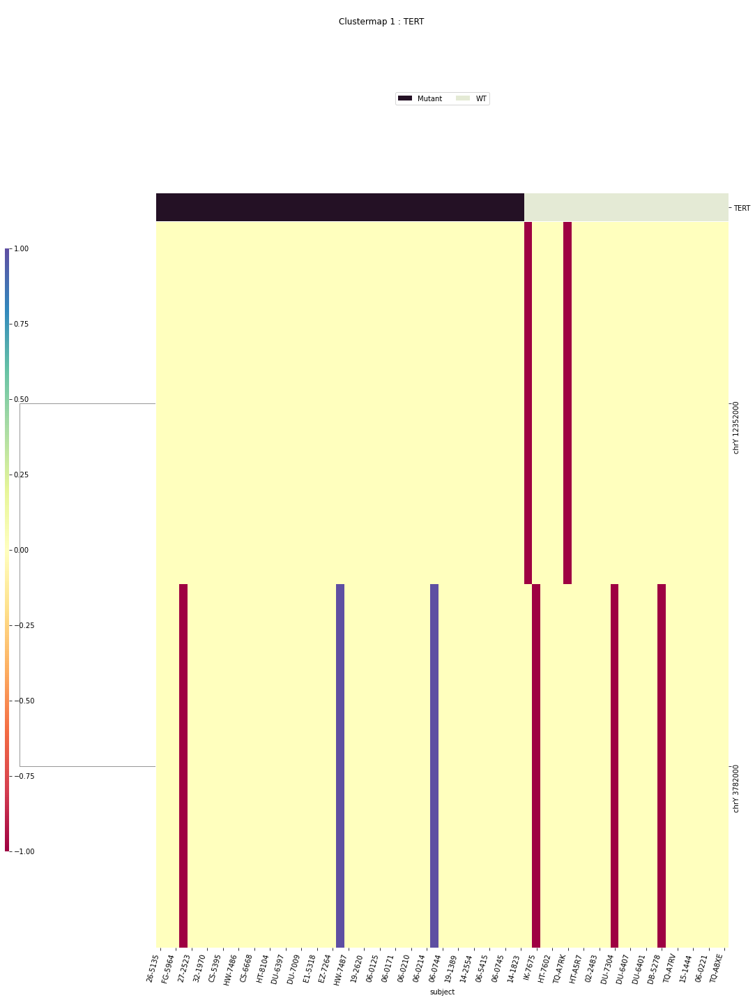

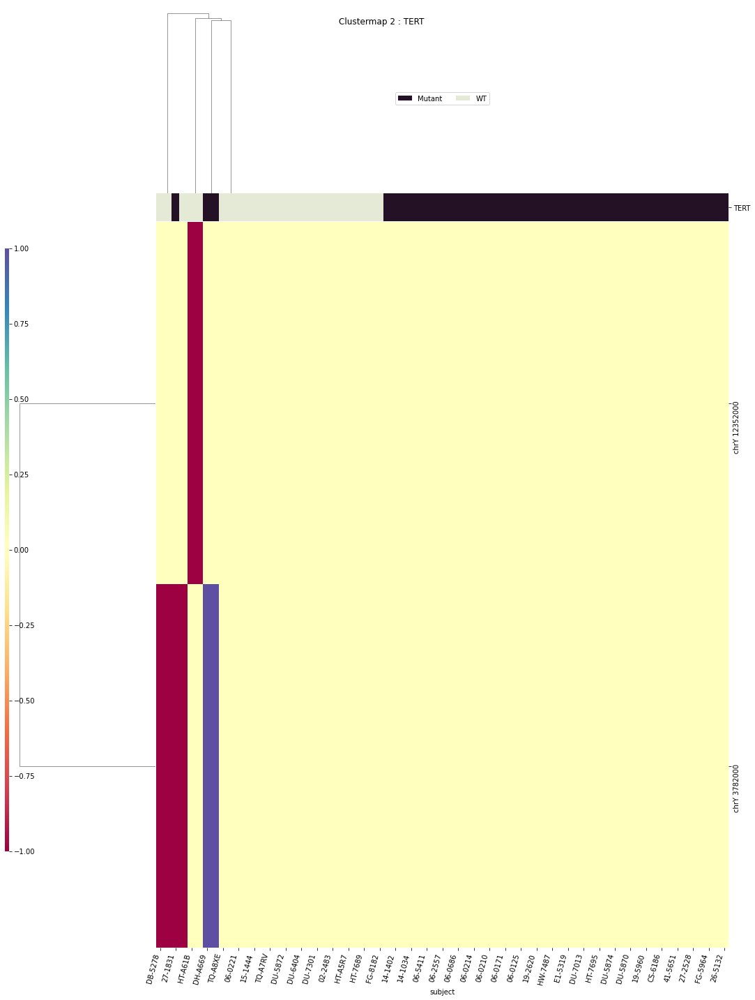

disease_type
['disease_type' 'subject']
Not enough data to produce cluster maps


In [124]:
#for chromosome in 'chr1','chr2','chr3','chr4','chr5','chr6','chr7','chr8','chr9','chr10',
#    'chr11','chr12','chr13','chr14','chr15','chr16','chr17','chr18','chr19','chr20','chr21','chr22','chrX'
for chromosome in sorted(
    df.columns[df.columns.get_level_values(
        'chromosome').str.contains("^chr")].get_level_values('chromosome').unique()):
    print(chromosome)
    for hkle in ['HERVK113']: #sorted(df.index.get_level_values('hkle').unique()):
        print(hkle)
#        Index(['project_id', 'primary_diagnosis', 'race', 'ethnicity', 'gender2',
#       'RE_names', 'IDH', 'x1p19q', 'TERT', 'IDH_1p19q_status', 'WHO_groups',
#       'Triple_group', 'Tissue_sample_location', 'MGMT', 'Age',
#       'Survival_months', 'Vital_status', 'subject', 'days_to_death',
#       'gender1', 'disease_type', 'center_name'],
        for column in 'primary_diagnosis','IDH','x1p19q','TERT','disease_type':
            print(column)
            ttests_boxplots_and_heatmaps(compdf[compdf['hkle']==hkle],
                compdf.columns[compdf.columns.str.contains("^"+chromosome+" ")],column,box_p=0.0000001,heat_p=0.1)

In [116]:
datetime.now().strftime("%Y%m%d %H:%M:%S")

'20210524 07:46:39'

In [117]:
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [118]:
pd.set_option('display.max_columns', default_max_columns)

In [119]:
pd.set_option('display.max_rows',default_max_rows)

In [120]:
pd.set_option('display.precision', default_precision)